In [38]:
import os
import math
import collections
datasetPath = '/content/drive/MyDrive/gendata/'
totalDatasets = list(os.listdir(datasetPath))
totalDatasets.sort()
totalDatasets[:25]

['SS-A.csv_100_11514.csv',
 'SS-A.csv_100_19953.csv',
 'SS-A.csv_100_3545.csv',
 'SS-A.csv_100_39658.csv',
 'SS-A.csv_100_40749.csv',
 'SS-A.csv_100_44845.csv',
 'SS-A.csv_100_51176.csv',
 'SS-A.csv_100_58612.csv',
 'SS-A.csv_100_61367.csv',
 'SS-A.csv_100_65388.csv',
 'SS-A.csv_100_65444.csv',
 'SS-A.csv_100_66946.csv',
 'SS-A.csv_100_69024.csv',
 'SS-A.csv_100_70006.csv',
 'SS-A.csv_100_70292.csv',
 'SS-A.csv_100_77340.csv',
 'SS-A.csv_100_77845.csv',
 'SS-A.csv_100_83686.csv',
 'SS-A.csv_100_84967.csv',
 'SS-A.csv_100_86331.csv',
 'SS-A.csv_10_11514.csv',
 'SS-A.csv_10_19953.csv',
 'SS-A.csv_10_3545.csv',
 'SS-A.csv_10_39658.csv',
 'SS-A.csv_10_40749.csv']

In [39]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.metrics import silhouette_score

In [3]:
df = pd.DataFrame
features = []
xColumns = []
# Define a range of k values to test
k_range = range(2, 12)
# Initialize an empty list to store silhouette scores
inertia_values = []
optimal_k = 0
cluster_centroids = []

In [4]:
def load_dataset(csv_file):
  global df
  df = pd.read_csv(csv_file)
  print(df.head())
  # Load features
  for column in df.columns:
    if any([column.endswith("!"),column.endswith("+"),column.endswith("-")]):
      features.append(column)
    else:
      xColumns.append(column)

In [5]:
def clean_undefined_values():
  global df
  # Convert '?' to NaN and then calculate the mean for each column
  for column in df.columns:
      df[column] = pd.to_numeric(df[column], errors='coerce')
  df = df.dropna()

In [6]:
def fit_kmeans_for_range_of_k():
  global df
  for k in k_range:
    # Initialize KMeans model
    kmeans = KMeans(n_clusters=k, random_state=0, n_init=10)
    # Fit the model to the data
    kmeans.fit(df[xColumns])
    # Calculate silhouette score
    inertia_values.append(kmeans.inertia_)

In [17]:
def plot_and_find_optimal_k(imageName='elbow_method_plot.png'):
  global df, optimal_k
  plt.figure(figsize=(10, 6))
  plt.plot(k_range, inertia_values, marker='o')
  plt.xlabel('Number of clusters (K)')
  plt.ylabel('Inertia')
  plt.title('Elbow Method for Optimal K')
  plt.xticks(k_range)
  plt.grid(True)
  plt.show()
  # Save the plot as an image file
  print('./elbow_test_export/'+imageName)
  plt.savefig('./elbow_test_export/'+imageName)
  # Calculate the line connecting the first and last points
  line_slope = (inertia_values[-1] - inertia_values[0]) / (k_range[-1] - k_range[0])
  line_intercept = inertia_values[0] - line_slope * k_range[0]

  # Calculate distances of points from the line
  distances = [abs(inertia - (line_slope * k + line_intercept)) / np.sqrt(line_slope**2 + 1) for k, inertia in zip(k_range, inertia_values)]

  # Find the optimal k value as the index corresponding to the maximum distance
  optimal_k_index = np.argmax(distances)

  # Optimal k value
  optimal_k = k_range[optimal_k_index]

  print("Optimal k value:", optimal_k)

In [9]:
def perform_optimal_kmeans(k_Value):
  global df
  # Perform clustering using the optimal k
  kmeans = KMeans(n_clusters=k_Value, random_state=0, n_init=10, init = 'k-means++')
  kmeans.fit_predict(df[xColumns])
  # Add cluster labels to the dataframe
  df['cluster'] = kmeans.labels_
  # Print the data with cluster labels
  print(df)

In [10]:
def get_mean_of_clusters_export_to_csv(filename='output.csv'):
  global df
  # Assuming your DataFrame is named 'df'
  cluster_means = df.groupby('cluster').mean()
  cluster_means.to_csv('./means_export_kmeans/'+filename)

In [11]:
def normalize_values(min, max, value):
  return (value-min) / (max-min)

In [22]:
def calculate_d2h_for_each_cluster_centroid():
  global df
  # Get centroids of each cluster
  for i in range(optimal_k+1):
    cluster_data_indices = df[df['cluster'] == i]
    cluster_centroids.append(cluster_data_indices.mean())
  # Normalize the values of each cluster
  maxValues = df.max()
  minValues = df.min()
  d2h = []
  for centroid in cluster_centroids:
    d = 0
    for column in features:
      if column.endswith("+"):
        d += (abs(1 - normalize_values(minValues[column], maxValues[column], centroid[column])))**2
      else:
        d += (abs(0 - normalize_values(minValues[column], maxValues[column], centroid[column])))**2
    d2h.append((d/len(features))**(1/2))
  print(d2h)
  return d2h

   Spout_wait  Spliters  Counters  Throughput+  Latency-
0          10         5         5      16406.0    195.69
1           4         4        14      18605.0    180.45
2         100         6        18      20398.0    177.98
3        1000         6        14       3250.2    773.71
4           6         3         6      16480.0    214.24
SS-A_csv_100_11514_elbow_test.png


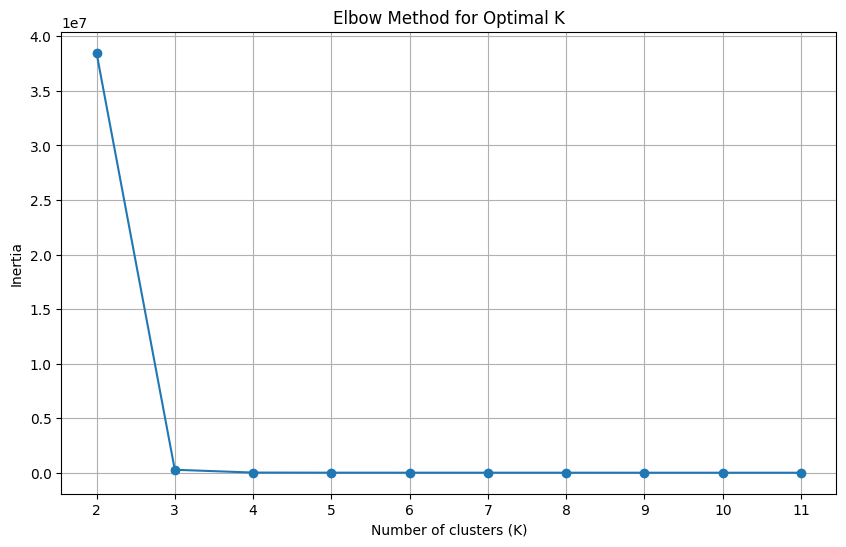

./elbow_test_export/SS-A_csv_100_11514_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            10         5         5      16406.0    195.69        0
1             4         4        14      18605.0    180.45        0
2           100         6        18      20398.0    177.98        0
3          1000         6        14       3250.2    773.71        2
4             6         3         6      16480.0    214.24        0
..          ...       ...       ...          ...       ...      ...
495           4         6         4      15648.0    212.93        0
496           2         6        16      19422.0    180.35        0
497          10         3        11      19468.0    179.44        0
498           5         3        15      20419.0    169.51        0
499           5         4         7      17128.0    209.43        0

[500 rows x 6 columns]
[0.18249729617535856, 0.8745978416128234, 0.6224136793262561, nan]
[0.18249729617535856

<Figure size 640x480 with 0 Axes>

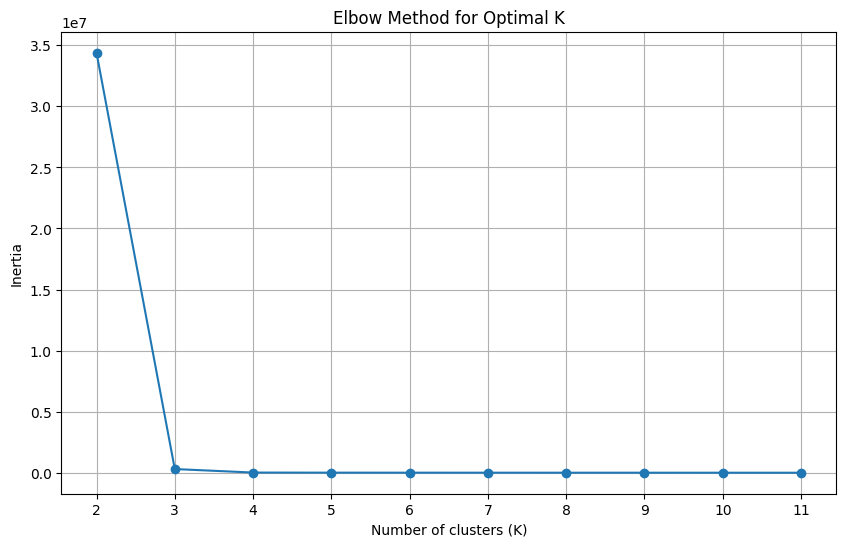

./elbow_test_export/SS-A_csv_100_19953_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4         9      17595.0    192.87        0
1             5         2         7      16747.0    198.78        0
2             8         4         3      15841.0    219.31        0
3             8         1        10      15131.0    222.82        0
4             2         1        17      16256.0    194.45        0
..          ...       ...       ...          ...       ...      ...
495           2         6        16      19422.0    180.35        0
496           2         1         3      12804.0    250.71        0
497           4         3         3      14984.0    212.78        0
498         100         1        10      14659.0    207.97        0
499         100         4        17      20325.0    150.78        0

[500 rows x 6 columns]
[0.19432346009171683, 0.8773967084105334, 0.622250424071657, nan]
[0.19432346009171683,

<Figure size 640x480 with 0 Axes>

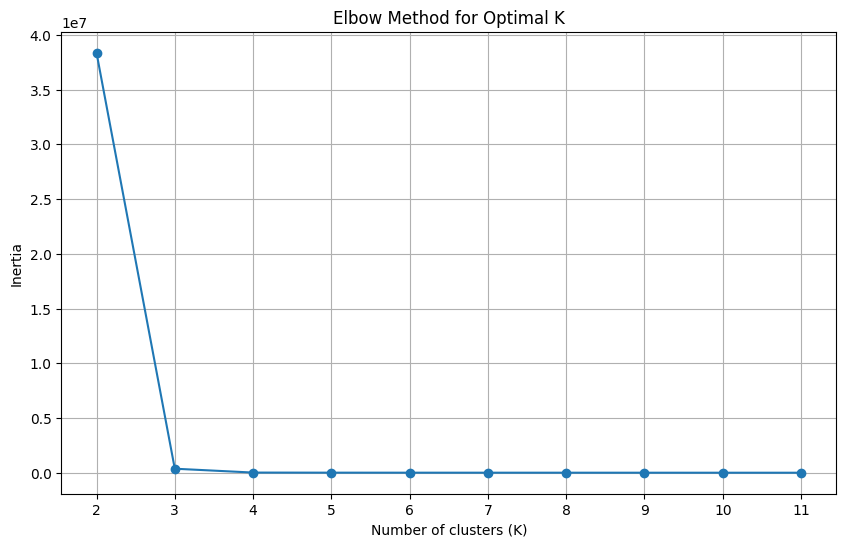

./elbow_test_export/SS-A_csv_100_3545_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         2        16      18510.0    181.30        0
1             7         1        16      14295.0    229.42        0
2             9         1         2      12958.0    257.84        0
3             4         4         4      15290.0    222.45        0
4             8         6        14      19744.0    205.88        0
..          ...       ...       ...          ...       ...      ...
495           5         3        10      18616.0    190.96        0
496        1000         2         9       3056.3    857.09        2
497        1000         2         5       2934.9    837.33        2
498          10         4        12      19995.0    187.02        0
499           7         6        12      20069.0    186.99        0

[500 rows x 6 columns]
[0.18284689927181352, 0.8863188856801065, 0.6222430322225364, nan]
[0.18284689927181352,

<Figure size 640x480 with 0 Axes>

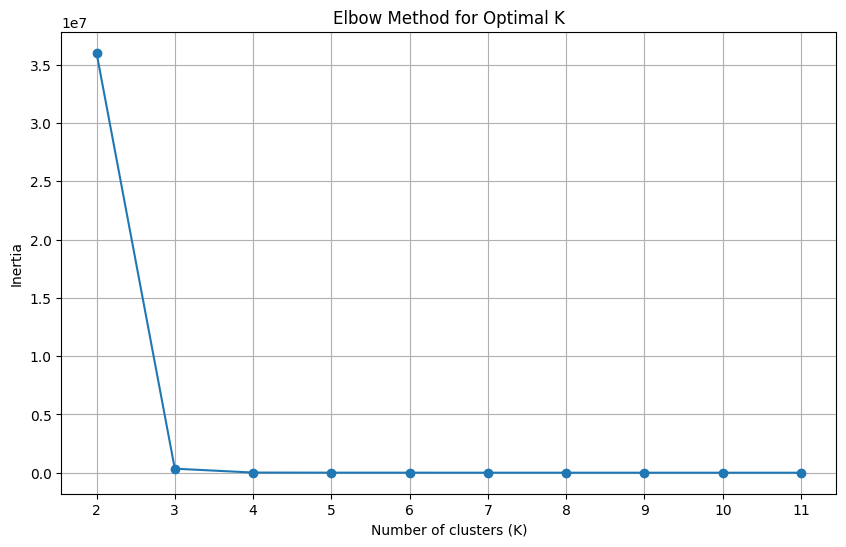

./elbow_test_export/SS-A_csv_100_39658_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             3         2         6      15182.0    225.96        0
1             4         5        16      18676.0    189.39        0
2             9         1        15      15548.0    213.08        0
3             5         1        16      14622.0    220.23        0
4          1000         2        11       3027.8    832.18        2
..          ...       ...       ...          ...       ...      ...
495          10         5         1       9671.6    353.56        0
496           1         4        14      17538.0    188.25        0
497           6         6         2      13653.0    232.69        0
498         100         1        15      15287.0    213.80        0
499           7         3         3      15295.0    212.99        0

[500 rows x 6 columns]
[0.18913544901108675, 0.8657605539613576, 0.6214110759461168, nan]
[0.18913544901108675

<Figure size 640x480 with 0 Axes>

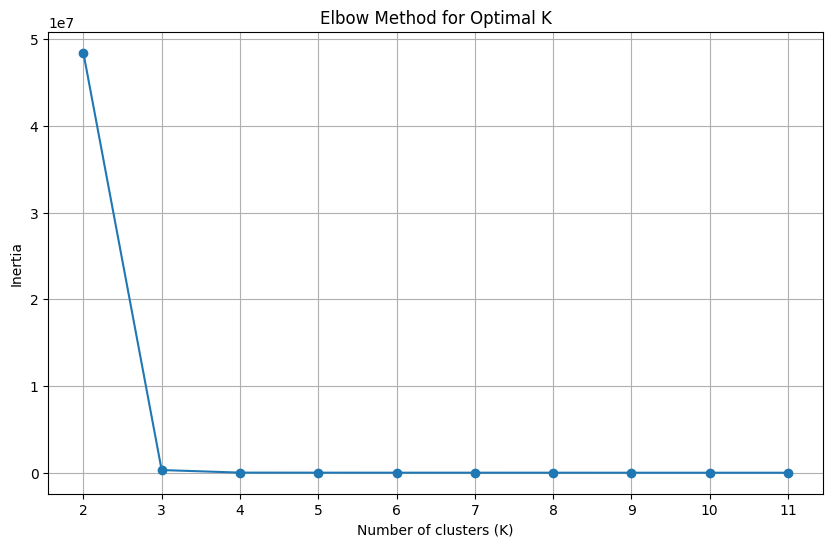

./elbow_test_export/SS-A_csv_100_40749_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             9         4         3      15361.0    212.77        0
1             8         2         4      15248.0    215.14        0
2             5         4         6      16490.0    203.50        0
3          1000         1         4       2954.8    948.42        2
4             8         3         9      18424.0    184.65        0
..          ...       ...       ...          ...       ...      ...
495           3         2        10      17240.0    186.49        0
496           9         1        18      15193.0    225.42        0
497          10         2        13      19489.0    180.86        0
498        1000         1         7       3058.1    941.23        2
499           7         2         4      15370.0    217.43        0

[500 rows x 6 columns]
[0.18830388894860695, 0.8904884088554335, 0.6216179629551336, nan]
[0.18830388894860695

<Figure size 640x480 with 0 Axes>

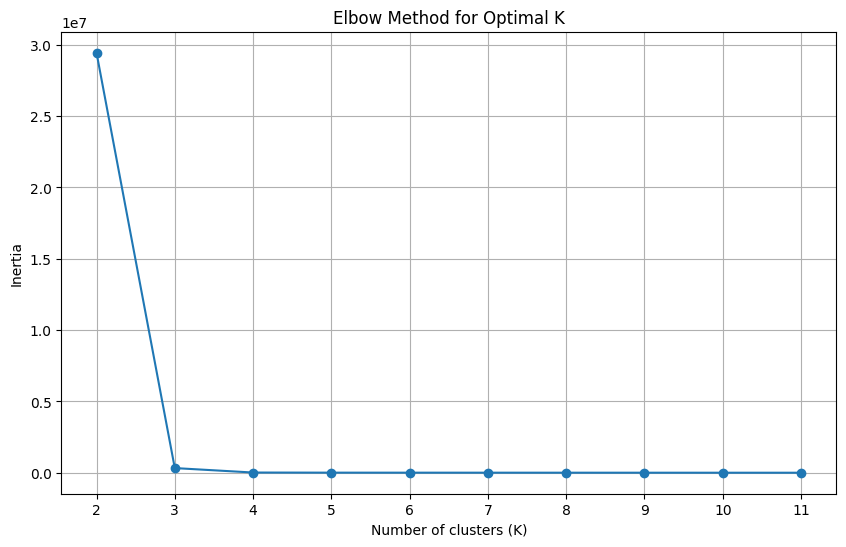

./elbow_test_export/SS-A_csv_100_44845_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             6         4        18      20106.0    174.80        0
1             6         2        15      18242.0    192.63        0
2             4         4        11      19209.0    184.26        0
3           100         2        12      17963.0    178.49        0
4             1         4         3      13958.0    241.05        0
..          ...       ...       ...          ...       ...      ...
495          10         1        11      16423.0    190.95        0
496          10         6         9      19412.0    171.73        0
497           8         6        10      18971.0    168.22        0
498           1         1         9      12168.0    268.84        0
499           7         6        18      21098.0    166.01        0

[500 rows x 6 columns]
[0.19642705470132446, 0.8898362211482974, 0.6216258403226265, nan]
[0.19642705470132446

<Figure size 640x480 with 0 Axes>

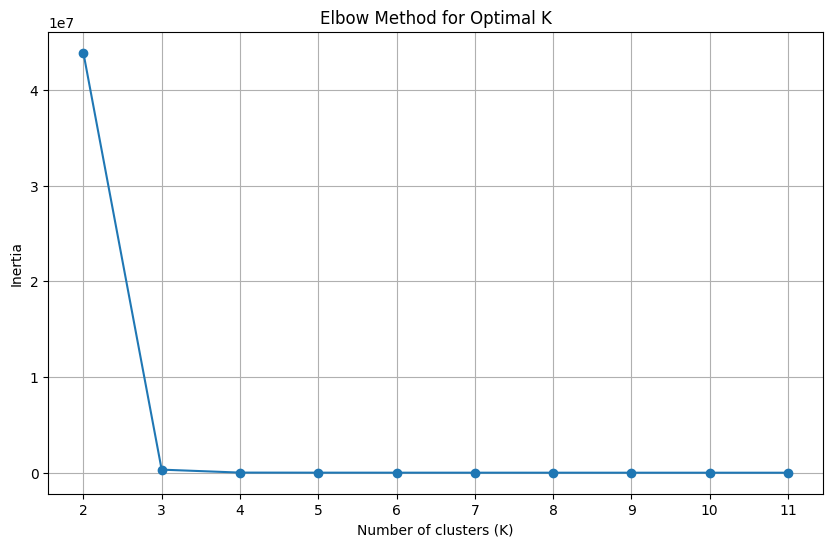

./elbow_test_export/SS-A_csv_100_51176_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4        15      20288.0    160.60        0
1            10         1         5      14497.0    222.50        0
2             2         5        13      18751.0    193.39        0
3            10         2        10      18941.0    178.26        0
4             7         3        12      19484.0    174.59        0
..          ...       ...       ...          ...       ...      ...
495           6         3         2      12609.0    275.32        0
496          10         3        17      21811.0    153.72        0
497           1         4         9      15607.0    205.96        0
498           2         5         1       8853.8    354.76        0
499           4         1         8      14252.0    206.88        0

[500 rows x 6 columns]
[0.18317008187987213, 0.8698982875841915, 0.6198965925917111, nan]
[0.18317008187987213

<Figure size 640x480 with 0 Axes>

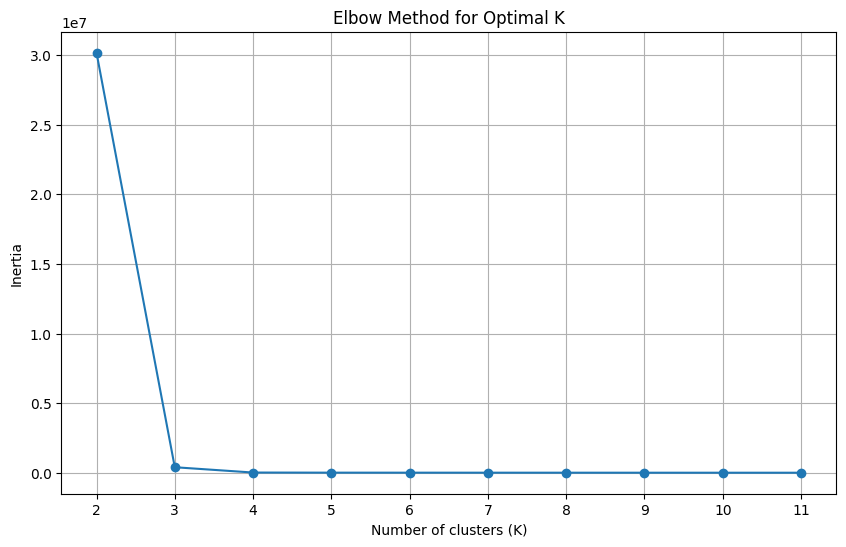

./elbow_test_export/SS-A_csv_100_58612_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             4         4         2      12203.0    248.93        0
1          1000         4         1       3008.9    955.96        2
2             1         5        11      17640.0    200.79        0
3             4         4         8      17659.0    184.96        0
4             2         1         7      12766.0    255.09        0
..          ...       ...       ...          ...       ...      ...
495        1000         2         2       2917.5    911.22        2
496          10         4        10      19437.0    177.05        0
497           3         3        17      20360.0    174.83        0
498           5         4        10      18996.0    175.97        0
499           9         6         7      17840.0    183.29        0

[500 rows x 6 columns]
[0.1899286419015877, 0.8562242324511474, 0.6224088079847611, nan]
[0.1899286419015877, 

<Figure size 640x480 with 0 Axes>

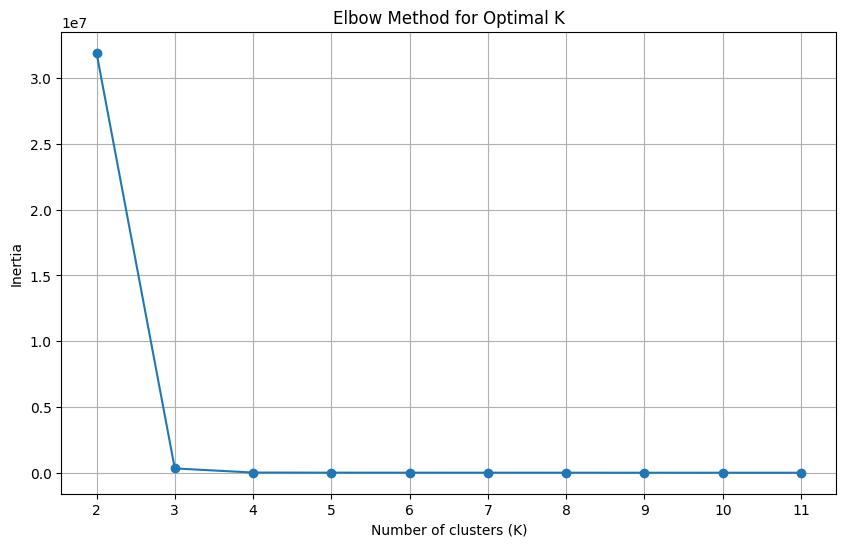

./elbow_test_export/SS-A_csv_100_61367_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4        15      20288.0    160.60        0
1             9         1        17      18035.0    183.24        0
2             6         5        12      19148.0    171.10        0
3             3         5         3      14910.0    229.53        0
4             6         2         6      14991.0    214.92        0
..          ...       ...       ...          ...       ...      ...
495           6         4        11      18674.0    187.41        0
496        1000         5         1       3146.1    926.97        2
497        1000         6        16       3304.3    741.87        2
498           7         1         2      12715.0    254.45        0
499           5         6         5      16610.0    217.29        0

[500 rows x 6 columns]
[0.19685677604868093, 0.8652906840282026, 0.6216116841352501, nan]
[0.19685677604868093

<Figure size 640x480 with 0 Axes>

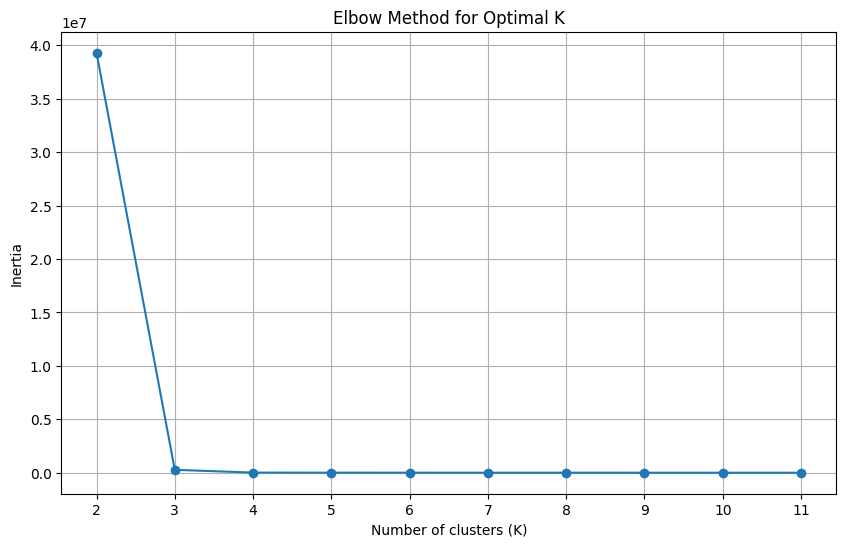

./elbow_test_export/SS-A_csv_100_65388_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         6         3      14421.0    224.68        0
1          1000         3         4       3174.3    802.50        2
2             5         5        15      20974.0    175.37        0
3          1000         5         6       3393.4    781.84        2
4          1000         4         7       3122.1    801.62        2
..          ...       ...       ...          ...       ...      ...
495           5         4         2      12743.0    251.42        0
496        1000         2         1       2958.2    963.07        2
497           9         3        13      19623.0    176.51        0
498        1000         6        16       3304.3    741.87        2
499          10         1         5      14497.0    222.50        0

[500 rows x 6 columns]
[0.18728792631525154, 0.8767172215592053, 0.6191952505214363, nan]
[0.18728792631525154

<Figure size 640x480 with 0 Axes>

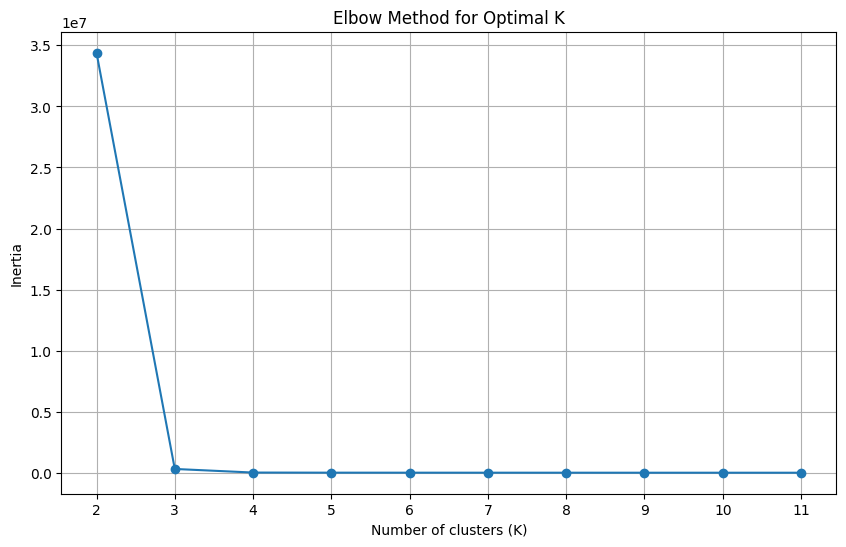

./elbow_test_export/SS-A_csv_100_65444_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             8         4         8     17532.00    199.11        0
1            10         1         1      8904.20    342.47        0
2             1         3        12     18268.00    200.34        0
3           100         2         7     17395.00    189.31        0
4             5         4         8     17993.00    197.27        0
..          ...       ...       ...          ...       ...      ...
495       10000         3         7       607.29   6151.00        1
496        1000         4         6      3077.60    805.80        2
497           1         6         4     14036.00    236.23        0
498           9         6         6     17239.00    185.27        0
499           8         3        11     19251.00    178.05        0

[500 rows x 6 columns]
[0.1925141771308982, 0.8912584869462449, 0.6239847623292987, nan]
[0.1925141771308982, 

<Figure size 640x480 with 0 Axes>

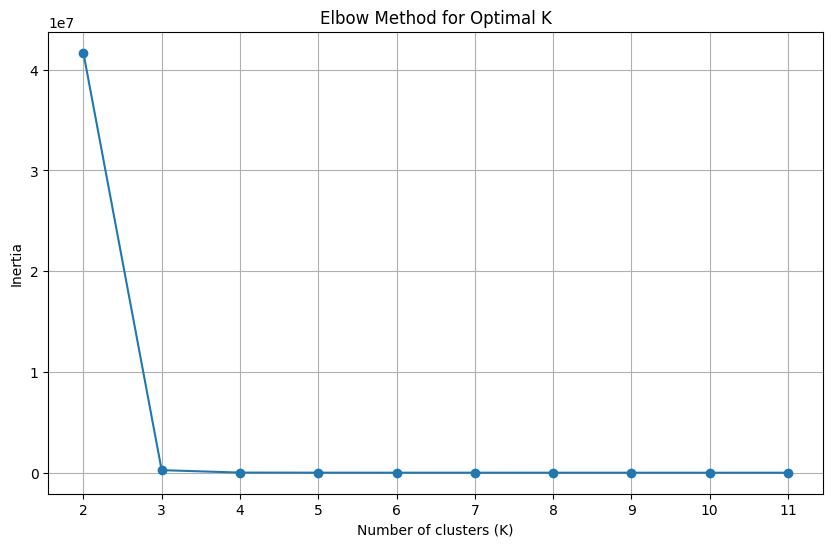

./elbow_test_export/SS-A_csv_100_66946_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         4         9      17995.0    217.53        0
1             1         5        14      17701.0    193.79        0
2             2         5         9      17453.0    193.94        0
3             7         2        15      18042.0    199.53        0
4             4         4         3      15042.0    210.11        0
..          ...       ...       ...          ...       ...      ...
495        1000         1        12       2890.0    962.59        2
496           8         6         5      16973.0    205.63        0
497        1000         2        14       3067.6    826.82        2
498           7         4         2      13336.0    241.62        0
499           8         4        14      19128.0    185.12        0

[500 rows x 6 columns]
[0.19571602660530704, 0.8880868591872692, 0.6240218038076931, nan]
[0.19571602660530704

<Figure size 640x480 with 0 Axes>

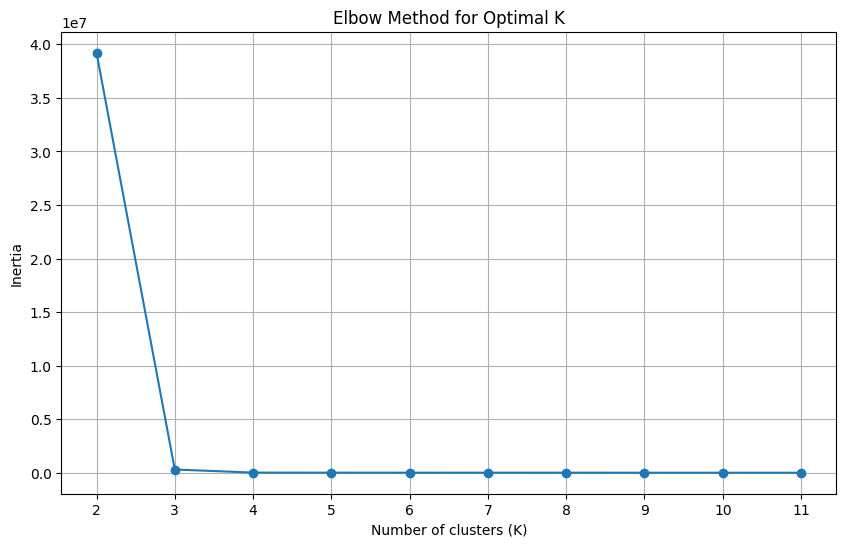

./elbow_test_export/SS-A_csv_100_69024_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         3         6     16835.00    192.88        0
1             6         6        10     19108.00    179.76        0
2             4         1         9     13562.00    241.96        0
3             3         1         4     12158.00    264.35        0
4             6         2        13     19408.00    170.62        0
..          ...       ...       ...          ...       ...      ...
495           8         1        17     19303.00    169.50        0
496           1         1         9     12168.00    268.84        0
497           2         3         5     15768.00    229.09        0
498       10000         1         3       420.81   6962.90        1
499           2         4        13     19090.00    179.29        0

[500 rows x 6 columns]
[0.1880665533225109, 0.8618808000986785, 0.62284103354736, nan]
[0.1880665533225109, 0.

<Figure size 640x480 with 0 Axes>

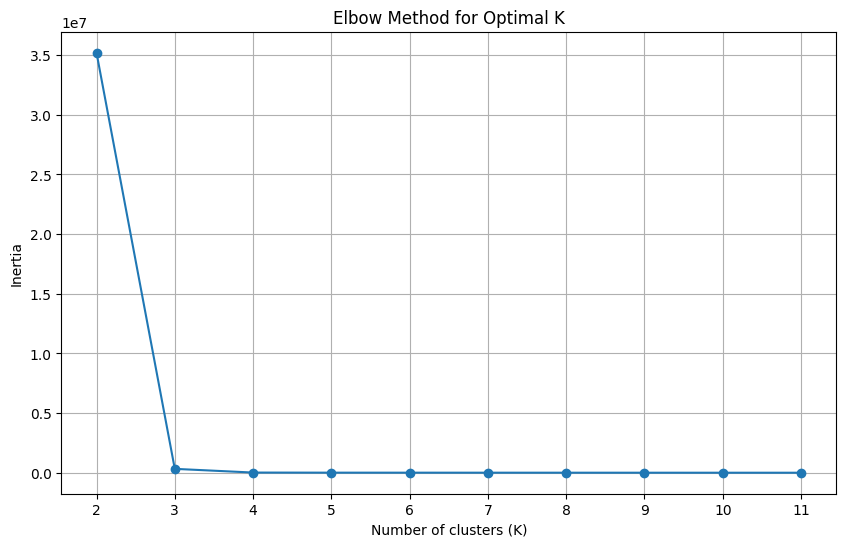

./elbow_test_export/SS-A_csv_100_70006_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             8         2         2      13030.0    260.79        0
1             3         4         3      14792.0    209.99        0
2             5         3        10      18616.0    190.96        0
3             3         1        12      13273.0    245.45        0
4             5         2        10      18282.0    181.31        0
..          ...       ...       ...          ...       ...      ...
495           4         3         9      18216.0    178.78        0
496           3         4        11      17715.0    201.36        0
497           1         1         5      12999.0    237.04        0
498           6         3         5      16033.0    225.89        0
499           9         3         7      17323.0    197.10        0

[500 rows x 6 columns]
[0.19122919377066586, 0.8817853783110721, 0.6231289150487211, nan]
[0.19122919377066586

<Figure size 640x480 with 0 Axes>

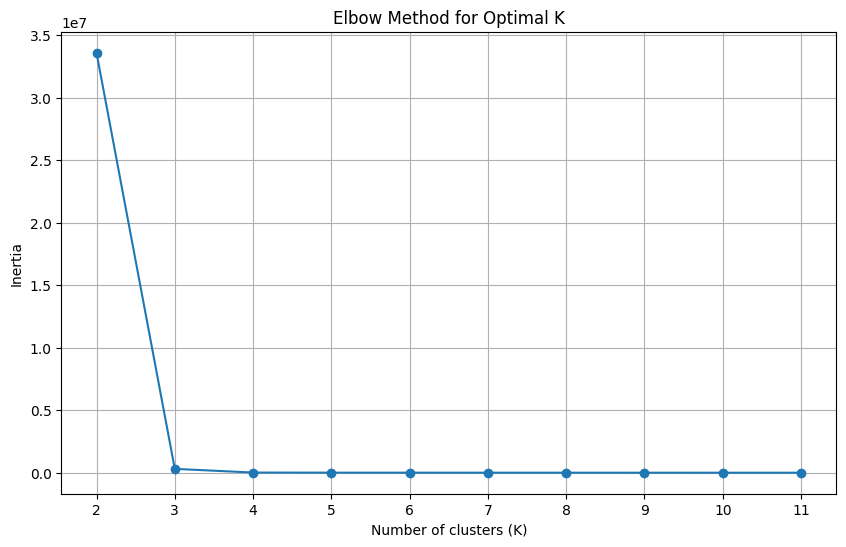

./elbow_test_export/SS-A_csv_100_70292_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             1         3         9     17202.00    205.13        0
1             5         5        11     19349.00    194.77        0
2             2         3         5     15768.00    229.09        0
3             1         3         4     14334.00    248.43        0
4             9         1        14     17554.00    185.15        0
..          ...       ...       ...          ...       ...      ...
495          10         3         8     17823.00    190.81        0
496           8         6        11     19933.00    180.42        0
497       10000         2        17       565.82   6729.50        1
498           7         2        15     18042.00    199.53        0
499       10000         2        12       582.82   6109.20        1

[500 rows x 6 columns]
[0.1931602359543664, 0.8796759185534272, 0.6214877061549976, nan]
[0.1931602359543664, 

<Figure size 640x480 with 0 Axes>

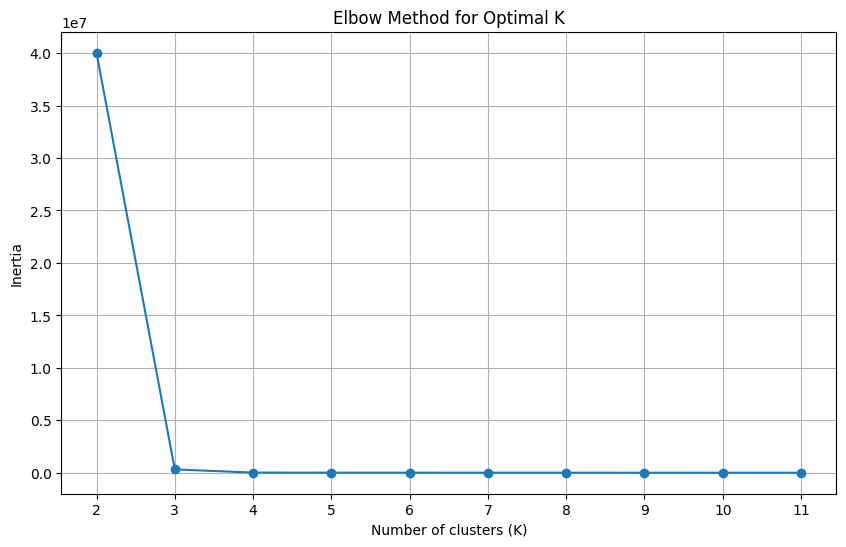

./elbow_test_export/SS-A_csv_100_77340_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             9         6         8     18180.00    199.41        0
1            10         4        11     18628.00    184.06        0
2         10000         3         6       586.88   6634.30        1
3            10         2         3     14577.00    228.04        0
4         10000         1         1       310.06   9421.00        1
..          ...       ...       ...          ...       ...      ...
495           7         4         6     17112.00    195.79        0
496           5         4         6     16490.00    203.50        0
497           3         6         3     14618.00    217.07        0
498        1000         5        14      3115.90    815.55        2
499        1000         6        11      3341.70    763.75        2

[500 rows x 6 columns]
[0.19806762120582905, 0.878130893114709, 0.6223970894968803, nan]
[0.19806762120582905,

<Figure size 640x480 with 0 Axes>

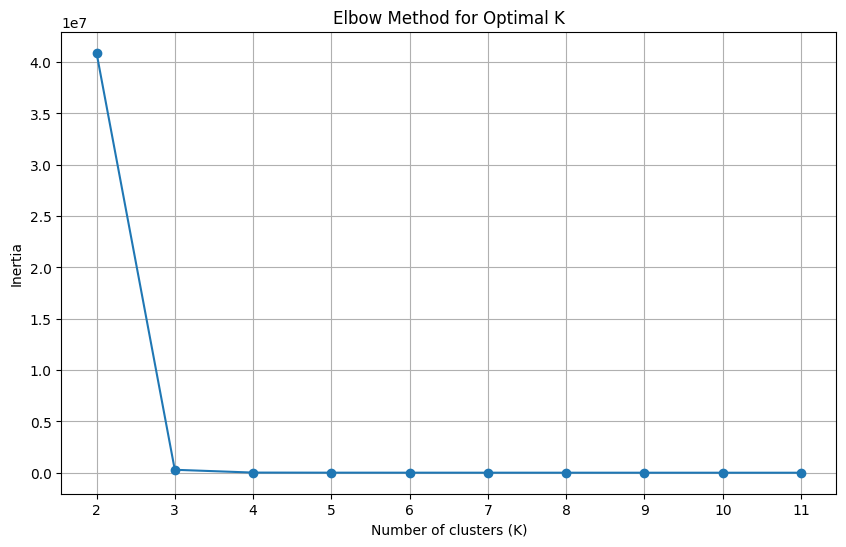

./elbow_test_export/SS-A_csv_100_77845_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             5         5         3      15595.0    212.96        0
1            10         5         7      17759.0    207.33        0
2             9         6        13      20492.0    165.89        0
3             5         1         1       8785.9    362.94        0
4          1000         3         2       3145.2    895.01        2
..          ...       ...       ...          ...       ...      ...
495           3         4         6      16214.0    210.27        0
496        1000         6        11       3341.7    763.75        2
497         100         1        11      18255.0    169.00        0
498           3         3         5      15029.0    225.43        0
499          10         1         9      13426.0    241.89        0

[500 rows x 6 columns]
[0.18573437167120313, 0.8817441305330054, 0.6233919050346148, nan]
[0.18573437167120313

<Figure size 640x480 with 0 Axes>

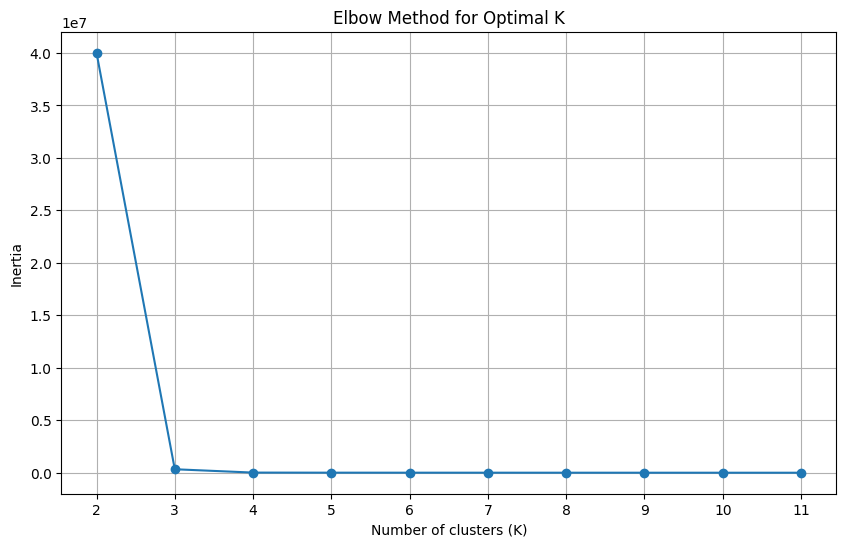

./elbow_test_export/SS-A_csv_100_83686_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             1         1        14      15891.0    198.18        0
1             8         5        15      20649.0    177.56        0
2           100         4         4      15496.0    208.09        0
3             9         1         8      16708.0    188.86        0
4             5         5        15      20974.0    175.37        0
..          ...       ...       ...          ...       ...      ...
495         100         1         8      16693.0    190.83        0
496           8         3         3      15210.0    201.94        0
497           1         2         9      15377.0    217.16        0
498           4         5         5      15577.0    216.81        0
499           1         1        15      13164.0    244.60        0

[500 rows x 6 columns]
[0.2003343881370838, 0.9050465501248214, 0.6245730825713972, nan]
[0.2003343881370838, 

<Figure size 640x480 with 0 Axes>

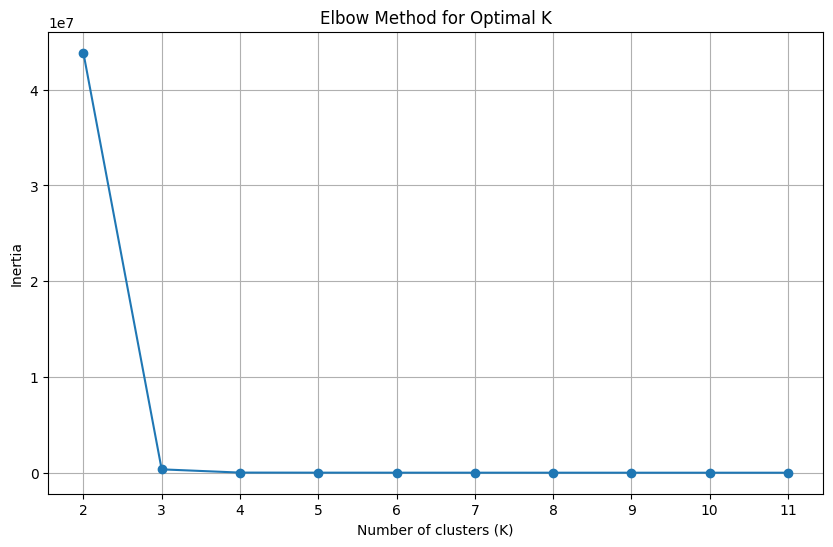

./elbow_test_export/SS-A_csv_100_84967_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             6         6         6      16882.0    195.61        0
1             5         1         8      15183.0    200.64        0
2             1         5        17      20391.0    176.12        0
3             7         4        13      20307.0    183.41        0
4             7         6        10      19514.0    161.74        0
..          ...       ...       ...          ...       ...      ...
495           7         3         7      17098.0    201.15        0
496        1000         4         2       2988.8    882.21        2
497           4         1        11      15581.0    185.58        0
498           3         6        12      20070.0    179.05        0
499           3         1         4      12158.0    264.35        0

[500 rows x 6 columns]
[0.1914937735719073, 0.8791142934904703, 0.62185845917227, nan]
[0.1914937735719073, 0.

<Figure size 640x480 with 0 Axes>

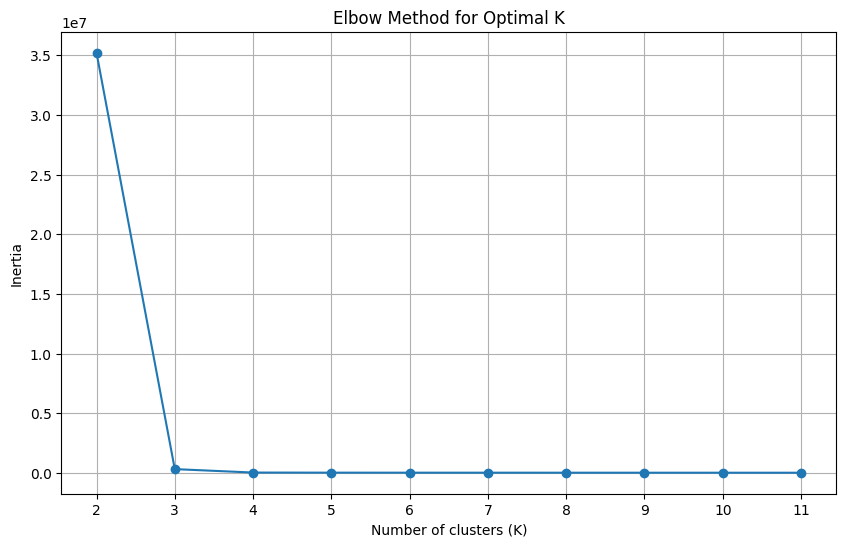

./elbow_test_export/SS-A_csv_100_86331_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0          1000         2         3       3014.6    859.05        2
1             3         6        15      19391.0    182.76        0
2          1000         3         2       3145.2    895.01        2
3            10         4        12      19995.0    187.02        0
4             9         6        18      22063.0    161.93        0
..          ...       ...       ...          ...       ...      ...
495           4         5        15      20916.0    204.49        0
496          10         6         4      16195.0    204.42        0
497           1         3         2      11995.0    284.51        0
498           6         1         5      14072.0    222.17        0
499           1         1         3      11601.0    286.42        0

[500 rows x 6 columns]
[0.18189789041559948, 0.8846644332069681, 0.6193883763141356, nan]
[0.18189789041559948

<Figure size 640x480 with 0 Axes>

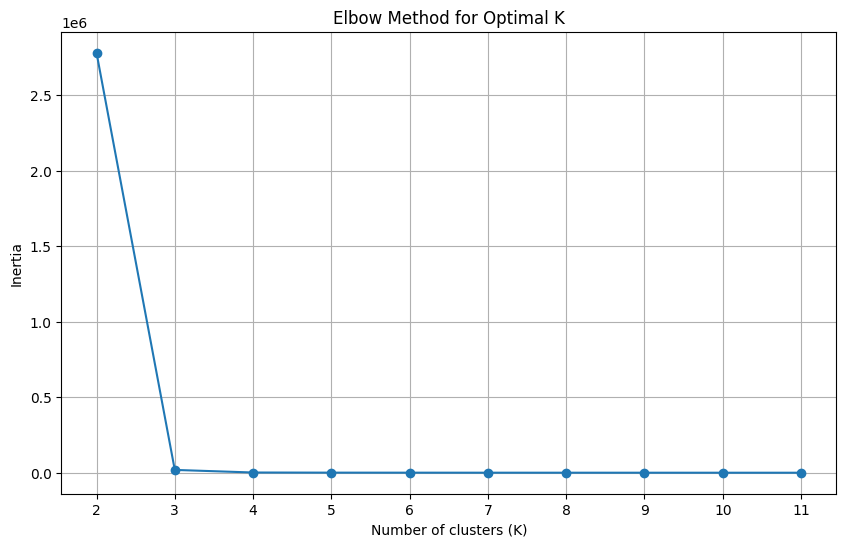

./elbow_test_export/SS-A_csv_10_11514_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0           10         5         5     16406.00    195.69        0
1            4         4        14     18605.00    180.45        0
2          100         6        18     20398.00    177.98        0
3         1000         6        14      3250.20    773.71        2
4            6         3         6     16480.00    214.24        0
5            6         5        11     19788.00    174.54        0
6         1000         1         7      3058.10    941.23        2
7            4         4        16     20060.00    174.71        0
8            9         5         5     16561.00    208.98        0
9            4         5         1      9560.10    368.29        0
10           8         6         8     17809.00    196.96        0
11           7         4         3     15573.00    219.55        0
12           6         4         4     15740.00    221.27

<Figure size 640x480 with 0 Axes>

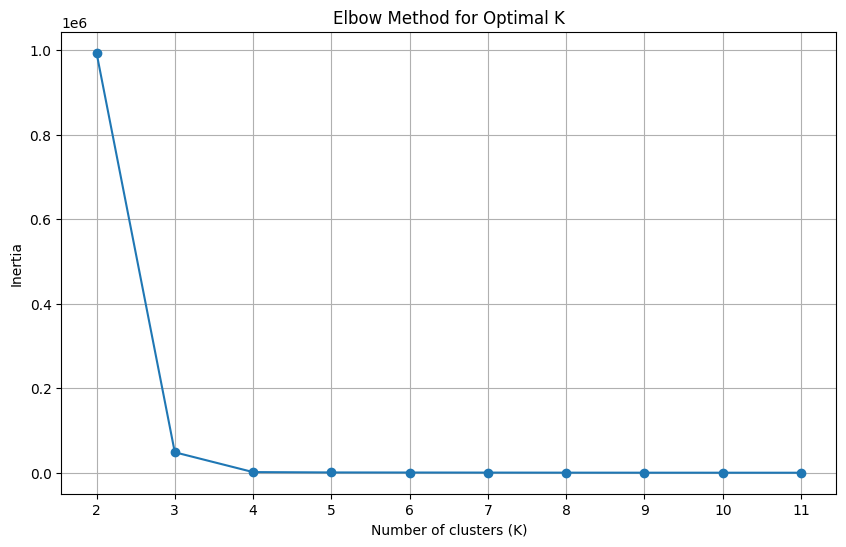

./elbow_test_export/SS-A_csv_10_19953_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            7         4         9     17595.00    192.87        0
1            5         2         7     16747.00    198.78        0
2            8         4         3     15841.00    219.31        0
3            8         1        10     15131.00    222.82        0
4            2         1        17     16256.00    194.45        0
5          100         3        15     20907.00    163.76        0
6            4         3        11     18561.00    201.79        0
7            1         5        18     19409.00    194.12        0
8            9         4         8     18238.00    190.93        0
9            3         1        16     12693.00    247.98        0
10           5         4        17     21595.00    165.35        0
11           3         6        16     19563.00    186.97        0
12           9         3         9     18594.00    175.62

<Figure size 640x480 with 0 Axes>

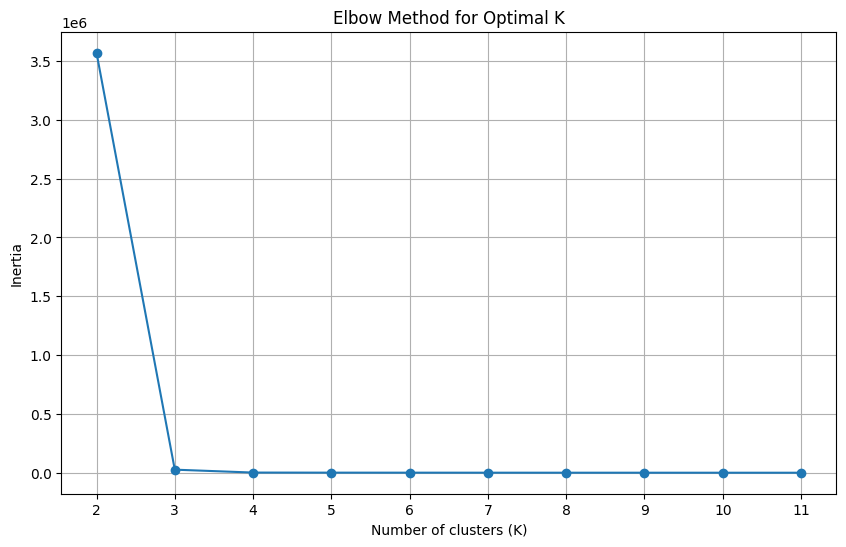

./elbow_test_export/SS-A_csv_10_3545_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            2         2        16     18510.00    181.30        2
1            7         1        16     14295.00    229.42        2
2            9         1         2     12958.00    257.84        2
3            4         4         4     15290.00    222.45        2
4            8         6        14     19744.00    205.88        2
5            4         3         9     18216.00    178.78        2
6            4         2         3     13479.00    243.11        2
7            1         2        15     16529.00    206.59        2
8          100         6         7     17561.00    192.48        2
9         1000         4        12      2892.10    784.93        0
10           3         5        14     19311.00    222.40        2
11           5         5         8     17449.00    189.07        2
12           9         4        16     20019.00    185.49 

<Figure size 640x480 with 0 Axes>

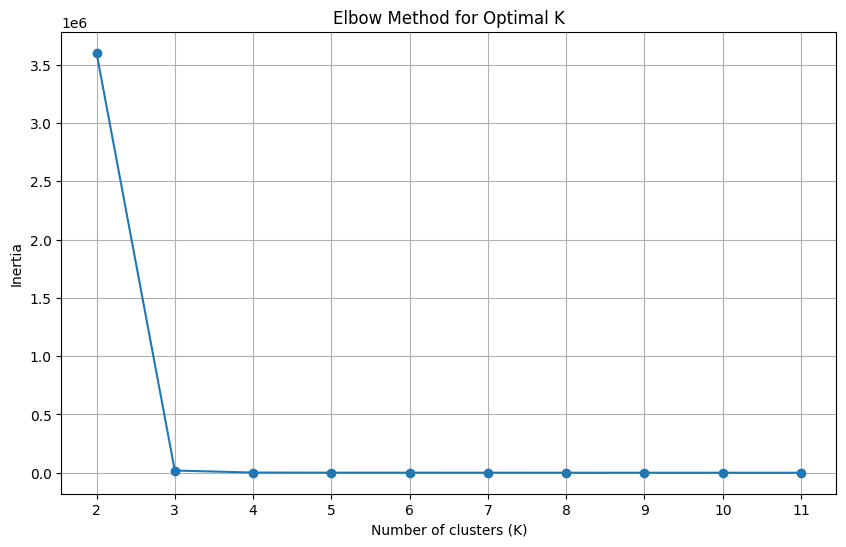

./elbow_test_export/SS-A_csv_10_39658_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            3         2         6     15182.00    225.96        0
1            4         5        16     18676.00    189.39        0
2            9         1        15     15548.00    213.08        0
3            5         1        16     14622.00    220.23        0
4         1000         2        11      3027.80    832.18        2
5           10         5         2     13170.00    246.10        0
6        10000         1        13       553.53   7139.40        1
7            6         6         9     17727.00    182.72        0
8            4         5         8     17204.00    204.36        0
9            3         6        16     19563.00    186.97        0
10          10         3        10     19847.00    178.65        0
11           1         1         3     11601.00    286.42        0
12           4         2         4     15091.00    228.56

<Figure size 640x480 with 0 Axes>

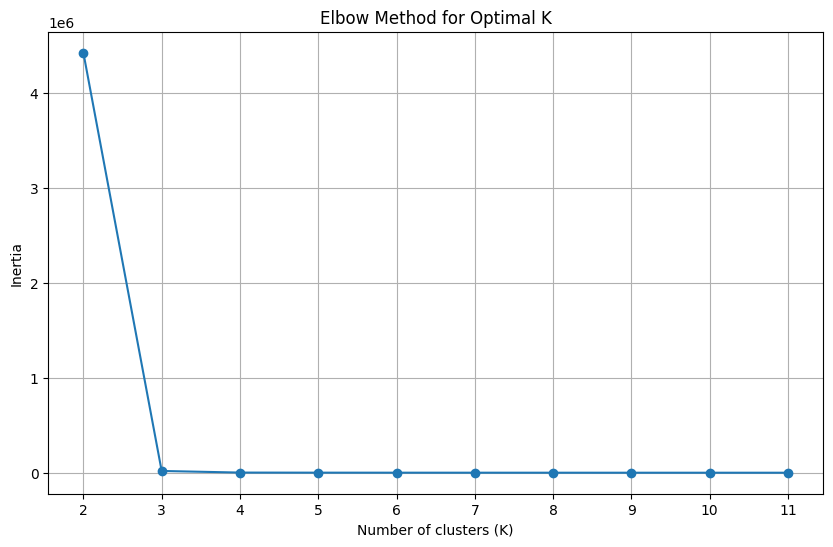

./elbow_test_export/SS-A_csv_10_40749_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            9         4         3     15361.00    212.77        1
1            8         2         4     15248.00    215.14        1
2            5         4         6     16490.00    203.50        1
3         1000         1         4      2954.80    948.42        2
4            8         3         9     18424.00    184.65        1
5            6         1         8     15459.00    211.54        1
6            9         6         3     15837.00    217.33        1
7            9         5         2     13537.00    243.27        1
8          100         6         5     16328.00    208.73        1
9         1000         6        16      3304.30    741.87        2
10           1         1         7     12032.00    275.01        1
11           1         5        11     17640.00    200.79        1
12           1         1         8     13630.00    228.60

<Figure size 640x480 with 0 Axes>

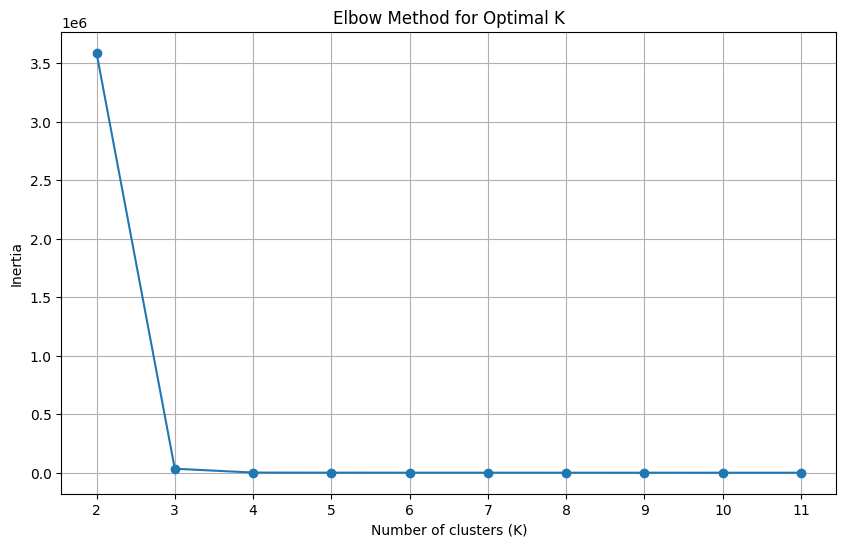

./elbow_test_export/SS-A_csv_10_44845_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            6         4        18     20106.00    174.80        0
1            6         2        15     18242.00    192.63        0
2            4         4        11     19209.00    184.26        0
3          100         2        12     17963.00    178.49        0
4            1         4         3     13958.00    241.05        0
5            9         4         6     17268.00    197.42        0
6            4         1        13     14385.00    228.00        0
7            8         6         1      9805.80    335.85        0
8            3         1        14     16371.00    201.80        0
9            1         5         9     17086.00    205.78        0
10           3         5         4     15312.00    217.38        0
11           3         5         7     16846.00    206.99        0
12         100         3         5     14891.00    196.59

<Figure size 640x480 with 0 Axes>

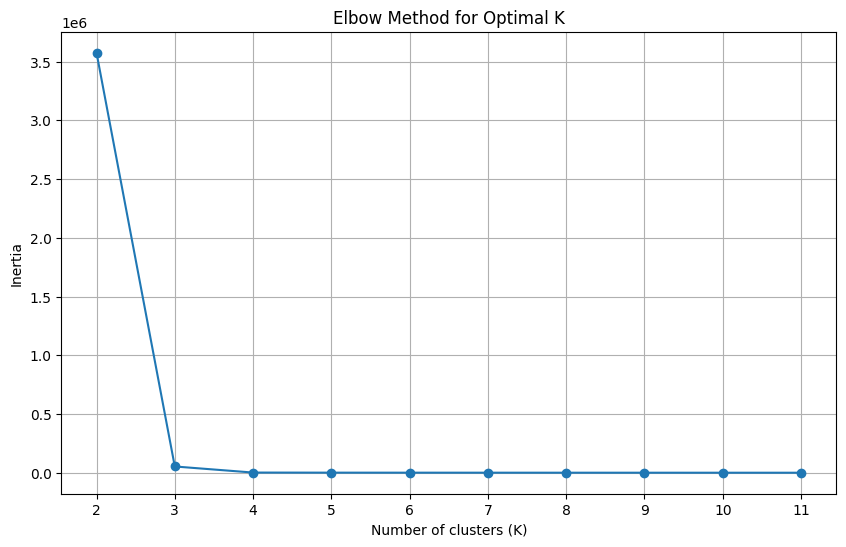

./elbow_test_export/SS-A_csv_10_51176_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            7         4        15     20288.00    160.60        0
1           10         1         5     14497.00    222.50        0
2            2         5        13     18751.00    193.39        0
3           10         2        10     18941.00    178.26        0
4            7         3        12     19484.00    174.59        0
5            6         1         2     11633.00    273.81        0
6            8         5         2     13363.00    237.30        0
7            6         6        16     21221.00    171.20        0
8           10         4         6     16733.00    210.48        0
9            1         4        16     17685.00    211.49        0
10         100         5        11     18847.00    186.86        0
11           5         5        10     20077.00    177.23        0
12           2         1         2     11726.00    287.88

<Figure size 640x480 with 0 Axes>

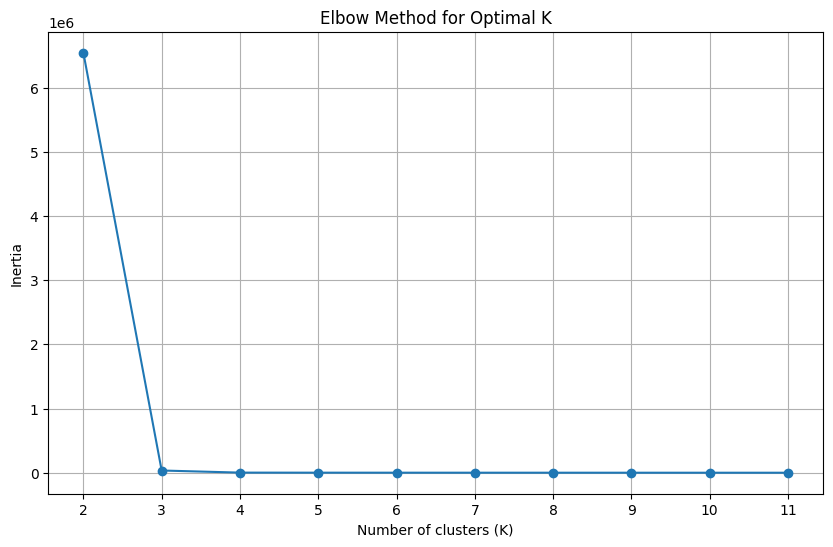

./elbow_test_export/SS-A_csv_10_58612_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            4         4         2     12203.00    248.93        0
1         1000         4         1      3008.90    955.96        2
2            1         5        11     17640.00    200.79        0
3            4         4         8     17659.00    184.96        0
4            2         1         7     12766.00    255.09        0
5            2         1        16     14072.00    225.86        0
6            1         4         4     14204.00    250.52        0
7            6         2        18     17707.00    202.68        0
8            1         4        12     18493.00    194.98        0
9        10000         2        13       561.06   6205.90        1
10         100         1        13     15583.00    223.30        0
11           9         6        18     22063.00    161.93        0
12        1000         3        17      3036.70    798.57

<Figure size 640x480 with 0 Axes>

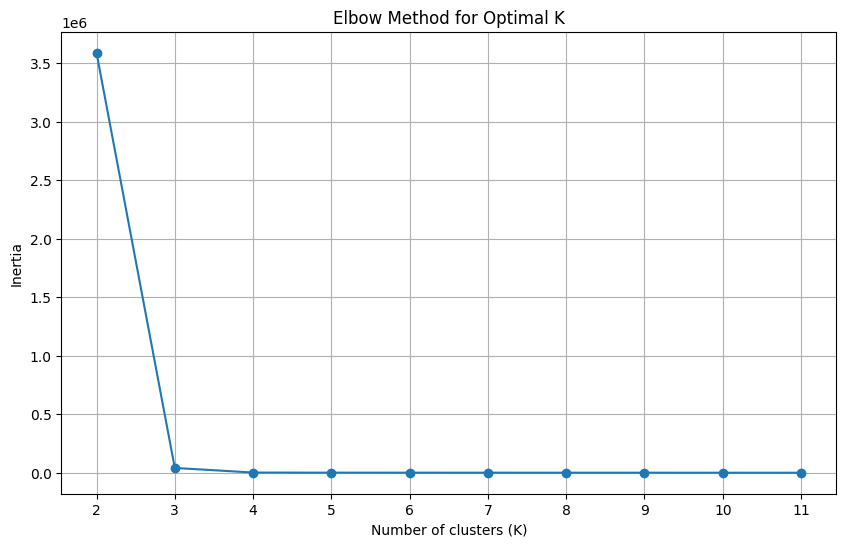

./elbow_test_export/SS-A_csv_10_61367_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            7         4        15     20288.00    160.60        0
1            9         1        17     18035.00    183.24        0
2            6         5        12     19148.00    171.10        0
3            3         5         3     14910.00    229.53        0
4            6         2         6     14991.00    214.92        0
5        10000         2        17       565.82   6729.50        1
6            3         6         4     15466.00    220.31        0
7            4         4        11     19209.00    184.26        0
8            2         3         7     15743.00    201.25        0
9          100         3        14     19574.00    186.71        0
10           7         1        16     14295.00    229.42        0
11           6         6        10     19108.00    179.76        0
12         100         6        18     20398.00    177.98

<Figure size 640x480 with 0 Axes>

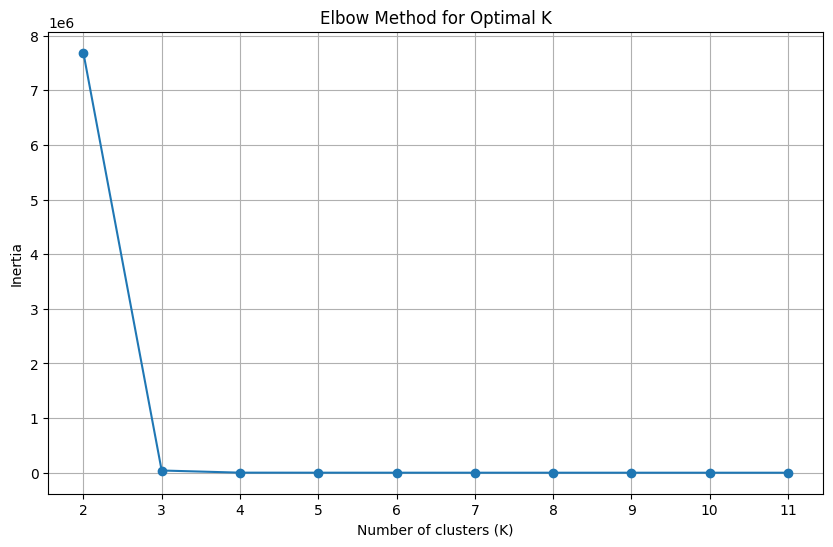

./elbow_test_export/SS-A_csv_10_65388_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            2         6         3     14421.00    224.68        0
1         1000         3         4      3174.30    802.50        2
2            5         5        15     20974.00    175.37        0
3         1000         5         6      3393.40    781.84        2
4         1000         4         7      3122.10    801.62        2
5            6         2        12     16895.00    181.01        0
6            5         1        15     14763.00    208.71        0
7            3         3        15     20971.00    165.65        0
8            4         4        16     20060.00    174.71        0
9            1         2         9     15377.00    217.16        0
10           3         1         9     13297.00    252.01        0
11           3         3        12     19040.00    187.35        0
12           4         5        14     19639.00    204.91

<Figure size 640x480 with 0 Axes>

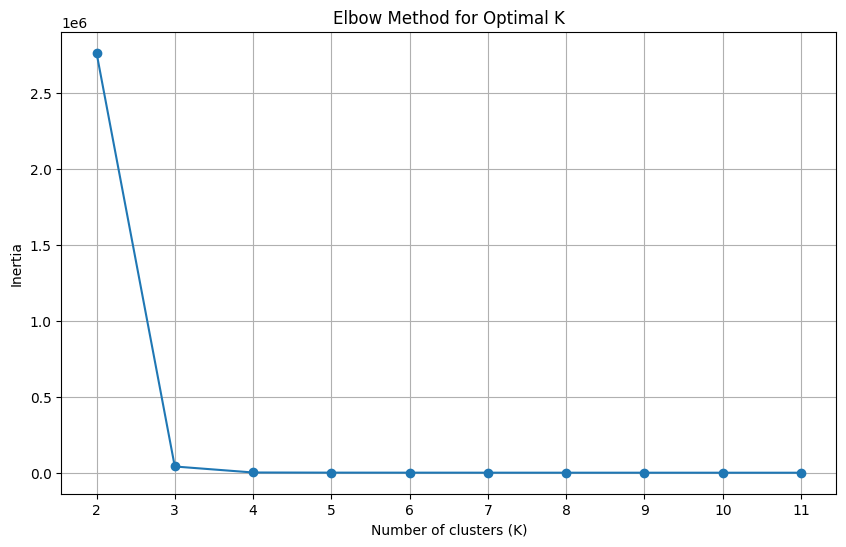

./elbow_test_export/SS-A_csv_10_65444_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            8         4         8     17532.00    199.11        0
1           10         1         1      8904.20    342.47        0
2            1         3        12     18268.00    200.34        0
3          100         2         7     17395.00    189.31        0
4            5         4         8     17993.00    197.27        0
5         1000         6         7      3115.50    816.13        2
6            2         2         5     14916.00    228.45        0
7            5         4         4     15607.00    224.25        0
8            8         4         7     17134.00    210.88        0
9          100         1         9     13056.00    239.95        0
10           5         5         2     12719.00    245.87        0
11         100         6        11     19693.00    161.26        0
12           1         3         3     13484.00    246.75

<Figure size 640x480 with 0 Axes>

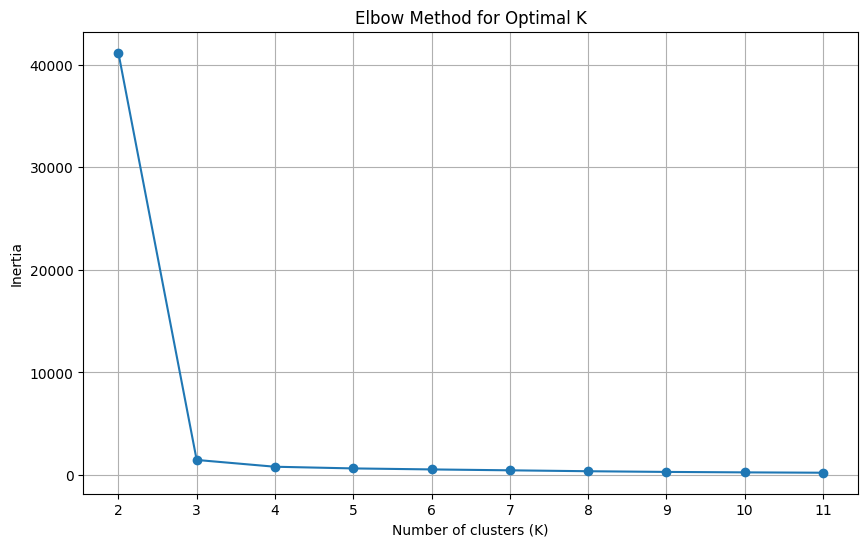

./elbow_test_export/SS-A_csv_10_66946_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            2         4         9      17995.0    217.53        2
1            1         5        14      17701.0    193.79        2
2            2         5         9      17453.0    193.94        2
3            7         2        15      18042.0    199.53        2
4            4         4         3      15042.0    210.11        2
5           10         6         8      18098.0    193.22        2
6          100         4         6      16985.0    185.27        0
7            5         4        15      20414.0    183.81        2
8            8         5        18      20587.0    168.90        2
9            8         3         2      13259.0    238.38        2
10           3         4        13      17653.0    194.27        2
11          10         1         8      15960.0    196.10        2
12           9         2        17      20515.0    169.13

<Figure size 640x480 with 0 Axes>

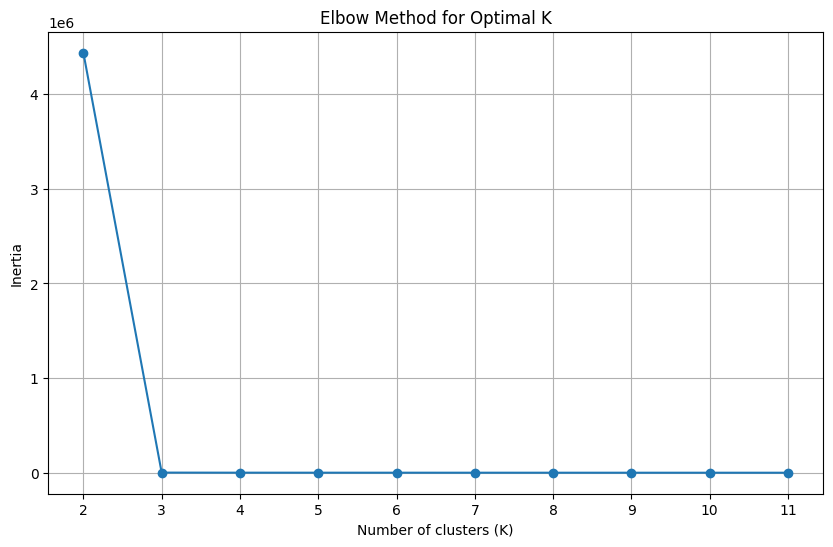

./elbow_test_export/SS-A_csv_10_69024_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            7         3         6     16835.00    192.88        2
1            6         6        10     19108.00    179.76        2
2            4         1         9     13562.00    241.96        2
3            3         1         4     12158.00    264.35        2
4            6         2        13     19408.00    170.62        2
5            2         5         7     16456.00    201.11        2
6            6         2        15     18242.00    192.63        2
7         1000         3         4      3174.30    802.50        0
8            5         1         3     13658.00    241.24        2
9            6         3         2     12609.00    275.32        2
10           8         4        10     19286.00    175.81        2
11           4         1         7     13781.00    247.06        2
12           7         4         3     15573.00    219.55

<Figure size 640x480 with 0 Axes>

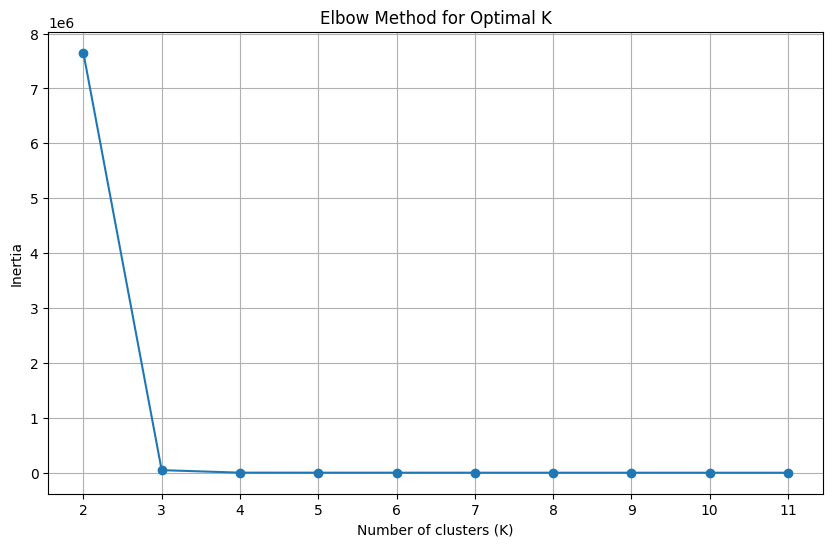

./elbow_test_export/SS-A_csv_10_70006_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            8         2         2     13030.00    260.79        0
1            3         4         3     14792.00    209.99        0
2            5         3        10     18616.00    190.96        0
3            3         1        12     13273.00    245.45        0
4            5         2        10     18282.00    181.31        0
5            7         3         7     17098.00    201.15        0
6           10         1        15     14279.00    222.97        0
7         1000         3        10      3074.80    789.44        2
8          100         4         4     15496.00    208.09        0
9            1         2        10     16738.00    221.13        0
10           2         1        10     13940.00    226.85        0
11        1000         6         6      3196.80    792.48        2
12       10000         1        10       460.81   8761.60

<Figure size 640x480 with 0 Axes>

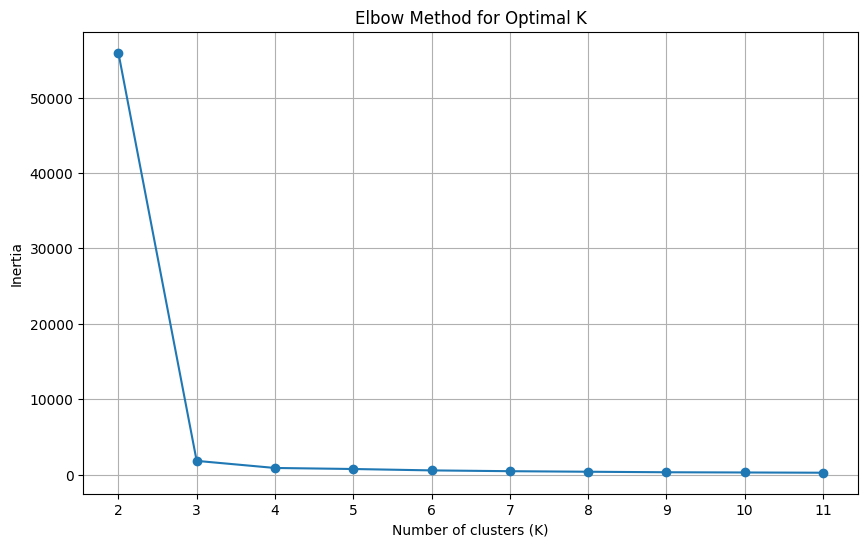

./elbow_test_export/SS-A_csv_10_70292_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            1         3         9      17202.0    205.13        0
1            5         5        11      19349.0    194.77        0
2            2         3         5      15768.0    229.09        0
3            1         3         4      14334.0    248.43        0
4            9         1        14      17554.0    185.15        0
5            2         6        12      19354.0    201.68        0
6         1000         5        16       3099.8    787.33        1
7          100         3         5      14891.0    196.59        2
8            1         1        16      12781.0    250.88        0
9            6         2        12      16895.0    181.01        0
10          10         4        18      21246.0    167.25        0
11           8         4        14      19128.0    185.12        0
12         100         4         2      13006.0    253.35

<Figure size 640x480 with 0 Axes>

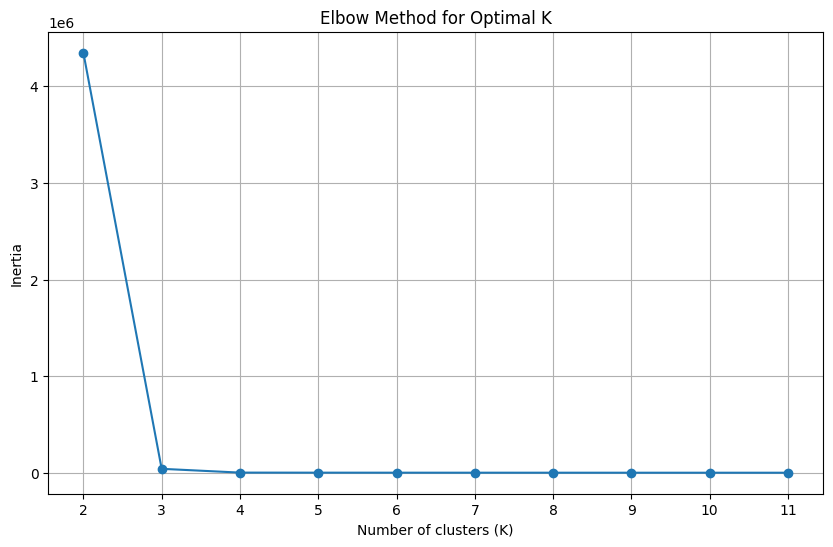

./elbow_test_export/SS-A_csv_10_77340_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            9         6         8     18180.00    199.41        0
1           10         4        11     18628.00    184.06        0
2        10000         3         6       586.88   6634.30        1
3           10         2         3     14577.00    228.04        0
4        10000         1         1       310.06   9421.00        1
5         1000         6         3      3173.70    874.34        2
6           10         3        15     20988.00    164.47        0
7            8         2         5     16060.00    226.78        0
8            7         1        12     13775.00    228.97        0
9            3         1        17     18214.00    179.54        0
10           1         2         4     14253.00    247.47        0
11           9         2         6     15580.00    212.94        0
12           5         6        17     21412.00    188.77

<Figure size 640x480 with 0 Axes>

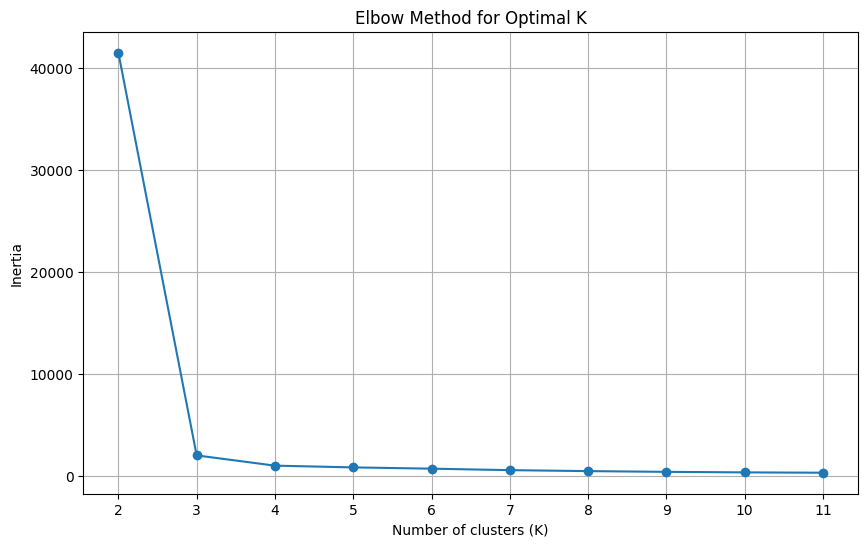

./elbow_test_export/SS-A_csv_10_77845_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            5         5         3      15595.0    212.96        0
1           10         5         7      17759.0    207.33        0
2            9         6        13      20492.0    165.89        0
3            5         1         1       8785.9    362.94        0
4         1000         3         2       3145.2    895.01        1
5           10         5        15      20678.0    193.39        0
6            6         5         8      17245.0    204.39        0
7           10         6         9      19412.0    171.73        0
8            4         2         9      16004.0    202.22        0
9           10         1        10      14225.0    221.94        0
10           4         3        14      18268.0    196.77        0
11           8         3         2      13259.0    238.38        0
12           1         4         4      14204.0    250.52

<Figure size 640x480 with 0 Axes>

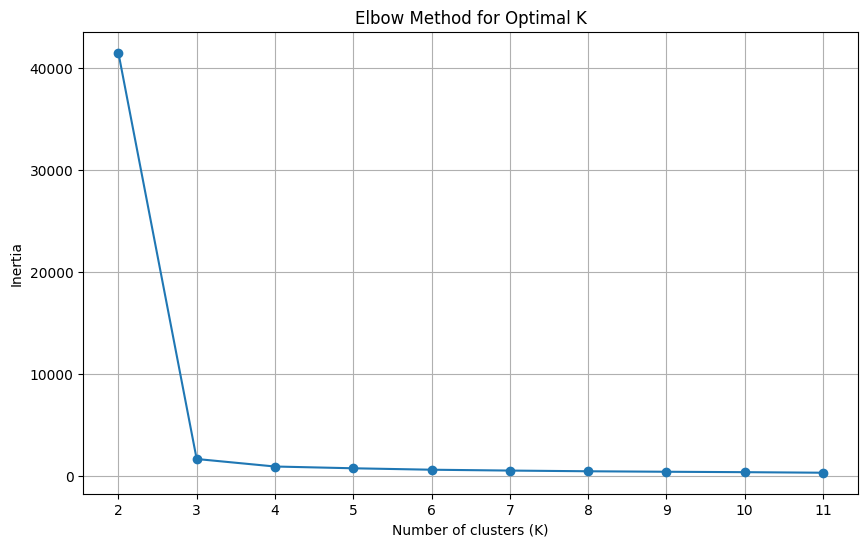

./elbow_test_export/SS-A_csv_10_83686_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            1         1        14      15891.0    198.18        0
1            8         5        15      20649.0    177.56        0
2          100         4         4      15496.0    208.09        2
3            9         1         8      16708.0    188.86        0
4            5         5        15      20974.0    175.37        0
5            6         5        14      19236.0    206.19        0
6            6         4        11      18674.0    187.41        0
7           10         5        12      20586.0    178.32        0
8            1         1        11      14500.0    229.24        0
9            4         1        14      16755.0    195.36        0
10         100         1        16      14937.0    231.47        2
11         100         5        11      18847.0    186.86        2
12           7         4         1       9806.9    318.21

<Figure size 640x480 with 0 Axes>

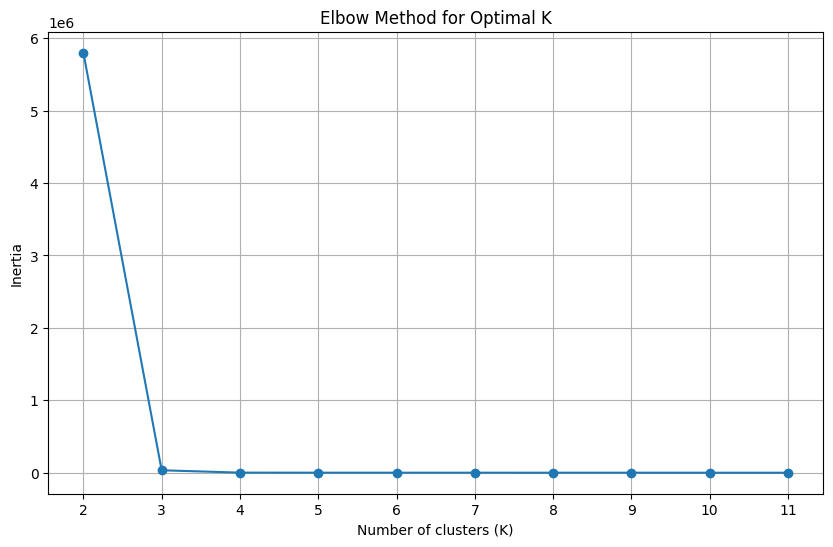

./elbow_test_export/SS-A_csv_10_84967_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            6         6         6     16882.00    195.61        2
1            5         1         8     15183.00    200.64        2
2            1         5        17     20391.00    176.12        2
3            7         4        13     20307.00    183.41        2
4            7         6        10     19514.00    161.74        2
5            7         5         4     15851.00    213.26        2
6          100         6         5     16328.00    208.73        2
7            6         2         2     12414.00    260.98        2
8            4         5        13     19578.00    194.42        2
9            5         2         9     16802.00    216.00        2
10           1         2        12     15830.00    208.02        2
11       10000         1        11       288.56   7908.90        1
12           9         6        13     20492.00    165.89

<Figure size 640x480 with 0 Axes>

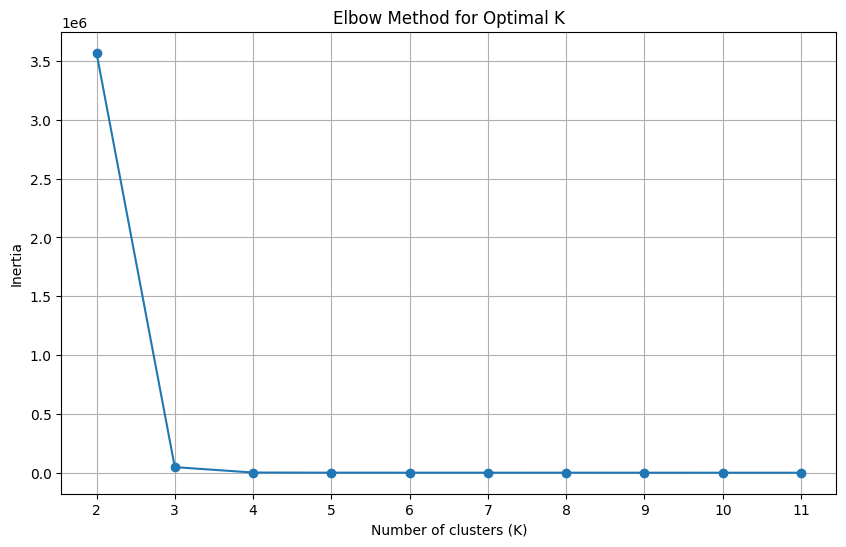

./elbow_test_export/SS-A_csv_10_86331_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0         1000         2         3      3014.60    859.05        2
1            3         6        15     19391.00    182.76        0
2         1000         3         2      3145.20    895.01        2
3           10         4        12     19995.00    187.02        0
4            9         6        18     22063.00    161.93        0
5            5         5         2     12719.00    245.87        0
6          100         4         8     16940.00    195.91        0
7        10000         3         3       392.71   8358.50        1
8            5         3        16     19893.00    175.26        0
9            4         2         3     13479.00    243.11        0
10       10000         2        16       628.94   5072.20        1
11           7         6         5     16080.00    222.37        0
12           7         4         8     17128.00    208.42

<Figure size 640x480 with 0 Axes>

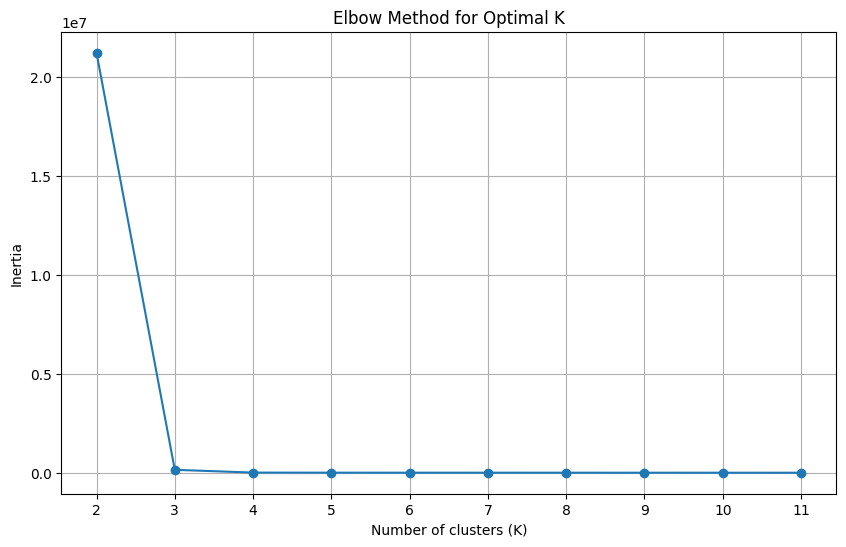

./elbow_test_export/SS-A_csv_50_11514_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            10         5         5      16406.0    195.69        0
1             4         4        14      18605.0    180.45        0
2           100         6        18      20398.0    177.98        0
3          1000         6        14       3250.2    773.71        2
4             6         3         6      16480.0    214.24        0
..          ...       ...       ...          ...       ...      ...
245        1000         6        15       3185.1    756.12        2
246           1         3        12      18268.0    200.34        0
247           7         3        12      19484.0    174.59        0
248        1000         6        10       3136.4    763.98        2
249           2         4        17      19333.0    176.63        0

[250 rows x 6 columns]
[0.1836227181171244, 0.8740209133388398, 0.6185054371413777, nan]
[0.1836227181171244, 0

<Figure size 640x480 with 0 Axes>

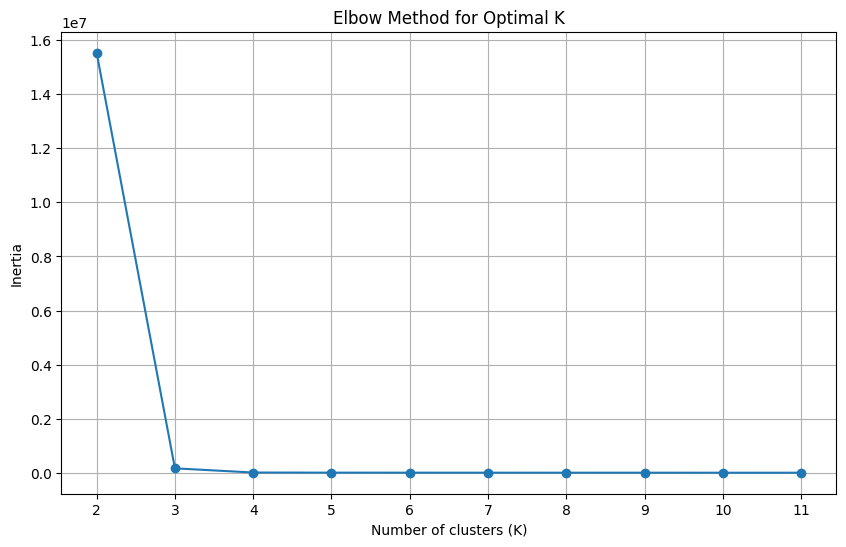

./elbow_test_export/SS-A_csv_50_19953_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4         9      17595.0    192.87        0
1             5         2         7      16747.0    198.78        0
2             8         4         3      15841.0    219.31        0
3             8         1        10      15131.0    222.82        0
4             2         1        17      16256.0    194.45        0
..          ...       ...       ...          ...       ...      ...
245           2         2        15      16557.0    202.01        0
246          10         3         9      19044.0    186.00        0
247           8         3         1       9996.4    359.59        0
248           3         4        12      19536.0    187.32        0
249           9         1        10      14253.0    225.36        0

[250 rows x 6 columns]
[0.19139672707472113, 0.8689230280085364, 0.6224129005875599, nan]
[0.19139672707472113,

<Figure size 640x480 with 0 Axes>

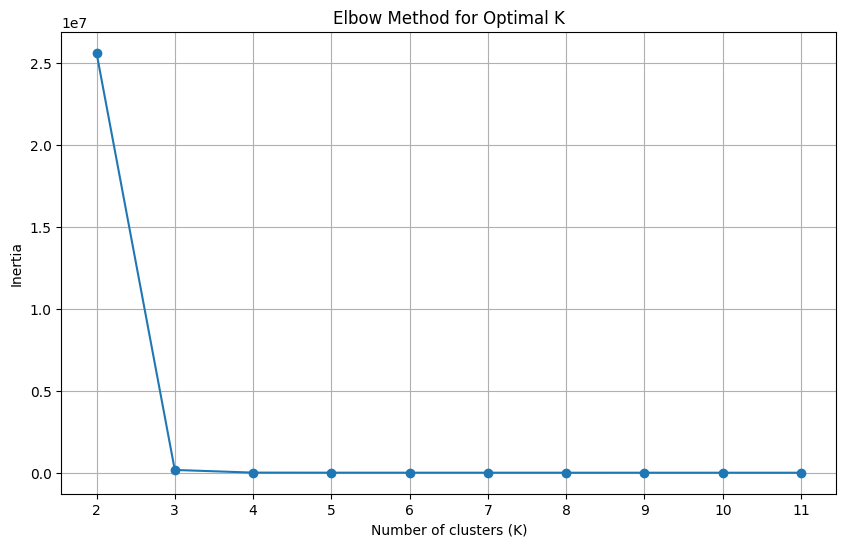

./elbow_test_export/SS-A_csv_50_3545_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         2        16      18510.0    181.30        0
1             7         1        16      14295.0    229.42        0
2             9         1         2      12958.0    257.84        0
3             4         4         4      15290.0    222.45        0
4             8         6        14      19744.0    205.88        0
..          ...       ...       ...          ...       ...      ...
245        1000         6        14       3250.2    773.71        2
246           2         2        17      19269.0    193.05        0
247           6         5        18      21684.0    175.82        0
248           5         3         3      15168.0    222.38        0
249           5         5        14      19144.0    192.49        0

[250 rows x 6 columns]
[0.18031439934419113, 0.8840537328356955, 0.6215183433370205, nan]
[0.18031439934419113, 

<Figure size 640x480 with 0 Axes>

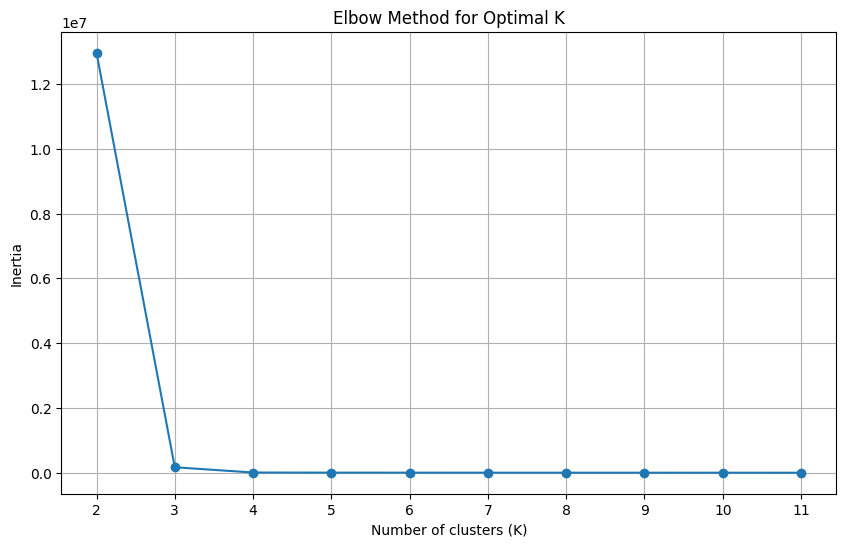

./elbow_test_export/SS-A_csv_50_39658_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             3         2         6      15182.0    225.96        0
1             4         5        16      18676.0    189.39        0
2             9         1        15      15548.0    213.08        0
3             5         1        16      14622.0    220.23        0
4          1000         2        11       3027.8    832.18        2
..          ...       ...       ...          ...       ...      ...
245          10         5         8      18144.0    183.74        0
246           9         4        18      21112.0    170.49        0
247           5         3         8      17673.0    205.44        0
248           3         3        12      19040.0    187.35        0
249           8         4        16      19698.0    177.73        0

[250 rows x 6 columns]
[0.17910837467838012, 0.8788655393372826, 0.622936008222214, nan]
[0.17910837467838012, 

<Figure size 640x480 with 0 Axes>

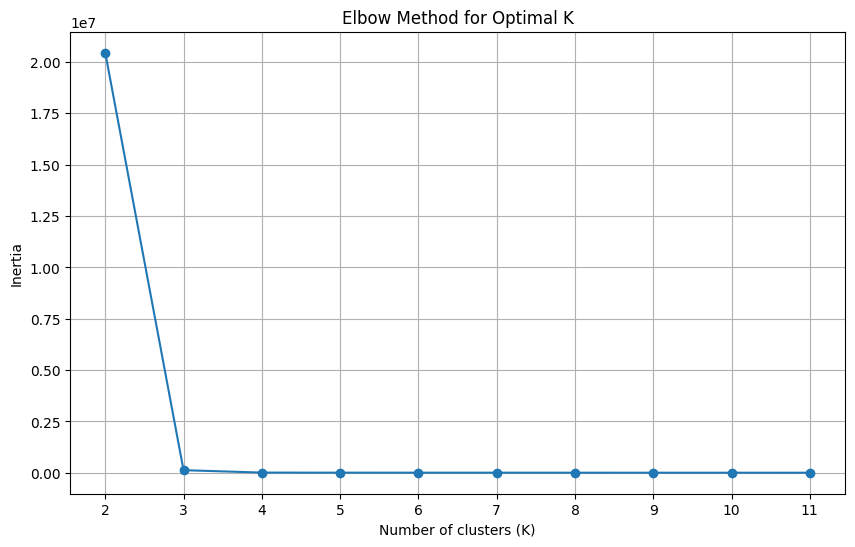

./elbow_test_export/SS-A_csv_50_40749_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             9         4         3      15361.0    212.77        0
1             8         2         4      15248.0    215.14        0
2             5         4         6      16490.0    203.50        0
3          1000         1         4       2954.8    948.42        2
4             8         3         9      18424.0    184.65        0
..          ...       ...       ...          ...       ...      ...
245           5         4        11      18231.0    196.10        0
246           9         6         8      18180.0    199.41        0
247           9         2        10      18028.0    179.13        0
248           2         2        16      18510.0    181.30        0
249           3         3        11      17772.0    190.27        0

[250 rows x 6 columns]
[0.18810200933982274, 0.8927869345174995, 0.6242996977804929, nan]
[0.18810200933982274,

<Figure size 640x480 with 0 Axes>

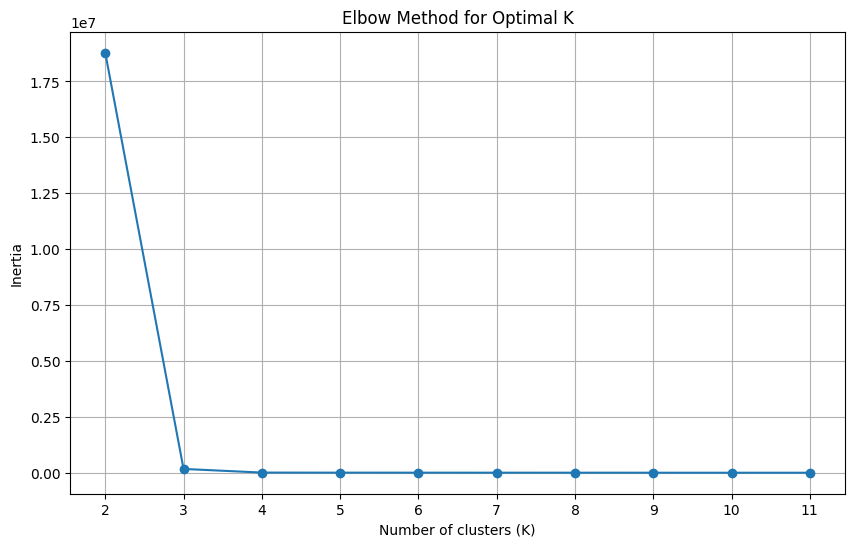

./elbow_test_export/SS-A_csv_50_44845_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             6         4        18      20106.0    174.80        0
1             6         2        15      18242.0    192.63        0
2             4         4        11      19209.0    184.26        0
3           100         2        12      17963.0    178.49        0
4             1         4         3      13958.0    241.05        0
..          ...       ...       ...          ...       ...      ...
245           7         2        13      19275.0    172.32        0
246           2         6         1       8800.9    360.35        0
247           7         3        10      18560.0    180.70        0
248           9         3         1       9865.6    339.19        0
249           1         6         4      14036.0    236.23        0

[250 rows x 6 columns]
[0.20230057772519583, 0.8793156256978101, 0.6219603745525959, nan]
[0.20230057772519583,

<Figure size 640x480 with 0 Axes>

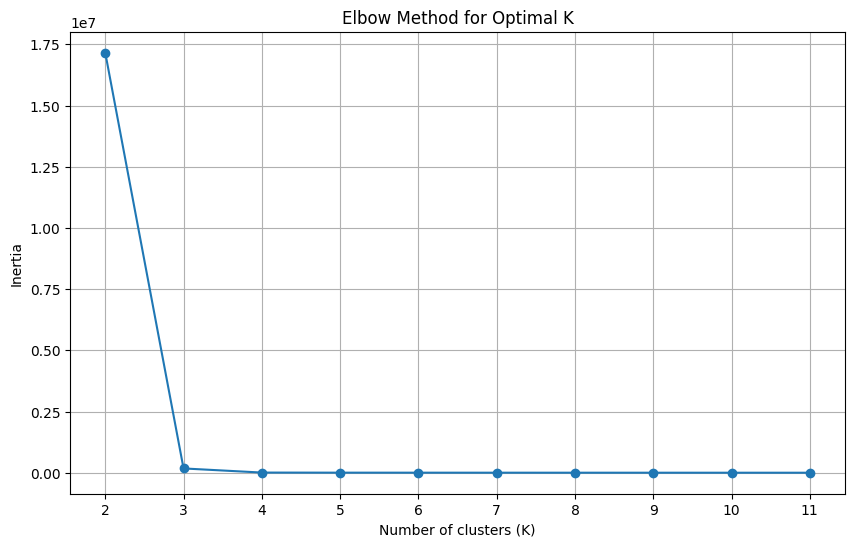

./elbow_test_export/SS-A_csv_50_51176_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4        15      20288.0    160.60        0
1            10         1         5      14497.0    222.50        0
2             2         5        13      18751.0    193.39        0
3            10         2        10      18941.0    178.26        0
4             7         3        12      19484.0    174.59        0
..          ...       ...       ...          ...       ...      ...
245           7         3         9      18581.0    183.62        0
246           2         2         1       9093.2    355.89        0
247           3         3        17      20360.0    174.83        0
248           1         6         2      11370.0    282.90        0
249           6         5        16      19668.0    167.11        0

[250 rows x 6 columns]
[0.16031760923445107, 0.8672403096142752, 0.6170757140279112, nan]
[0.16031760923445107,

<Figure size 640x480 with 0 Axes>

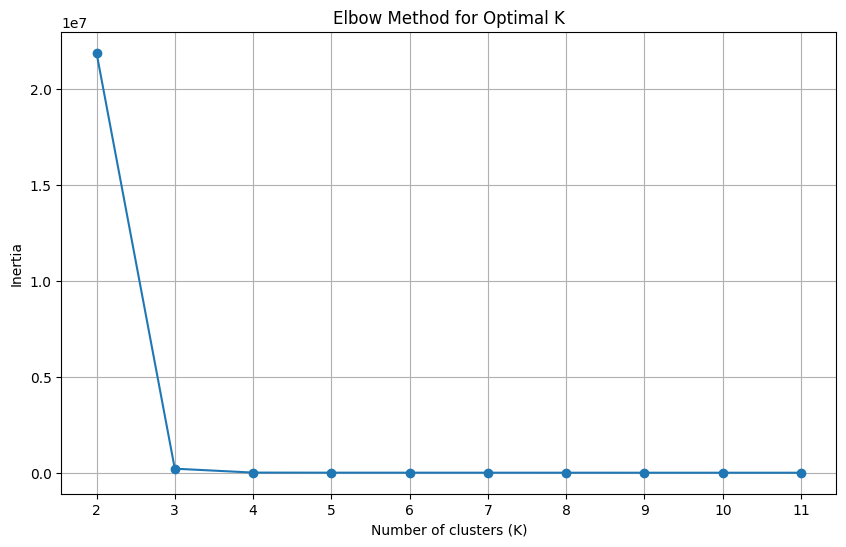

./elbow_test_export/SS-A_csv_50_58612_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             4         4         2      12203.0    248.93        0
1          1000         4         1       3008.9    955.96        2
2             1         5        11      17640.0    200.79        0
3             4         4         8      17659.0    184.96        0
4             2         1         7      12766.0    255.09        0
..          ...       ...       ...          ...       ...      ...
245           5         6         3      15180.0    200.20        0
246           5         2         4      14860.0    224.41        0
247           5         3        12      19289.0    176.63        0
248           5         4         5      15775.0    205.40        0
249         100         6        15      20247.0    165.53        0

[250 rows x 6 columns]
[0.1893924190687392, 0.8616616638999244, 0.6254854115983612, nan]
[0.1893924190687392, 0

<Figure size 640x480 with 0 Axes>

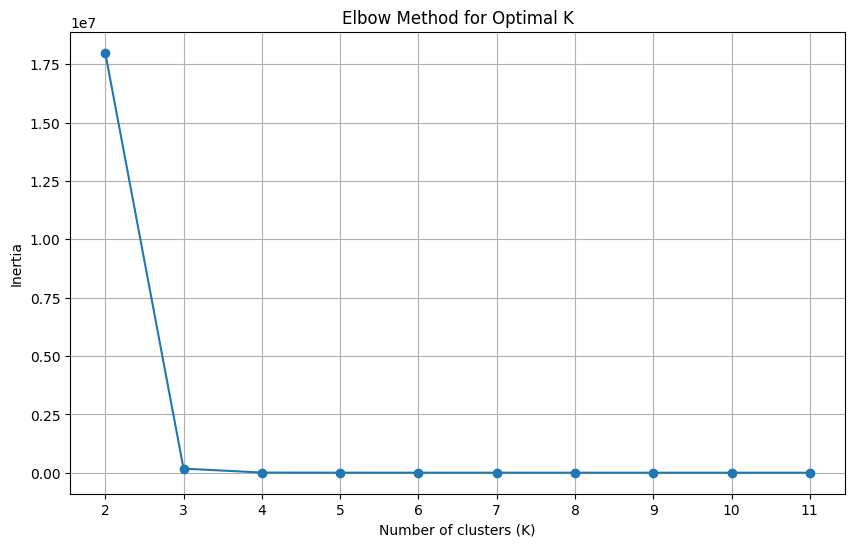

./elbow_test_export/SS-A_csv_50_61367_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4        15      20288.0    160.60        0
1             9         1        17      18035.0    183.24        0
2             6         5        12      19148.0    171.10        0
3             3         5         3      14910.0    229.53        0
4             6         2         6      14991.0    214.92        0
..          ...       ...       ...          ...       ...      ...
245           4         5         3      15110.0    230.85        0
246           2         3        17      19203.0    190.63        0
247           5         2         9      16802.0    216.00        0
248           6         4        14      18883.0    171.99        0
249        1000         4         5       3062.4    801.36        2

[250 rows x 6 columns]
[0.17852009658995824, 0.8953267561622422, 0.6194992897805174, nan]
[0.17852009658995824,

<Figure size 640x480 with 0 Axes>

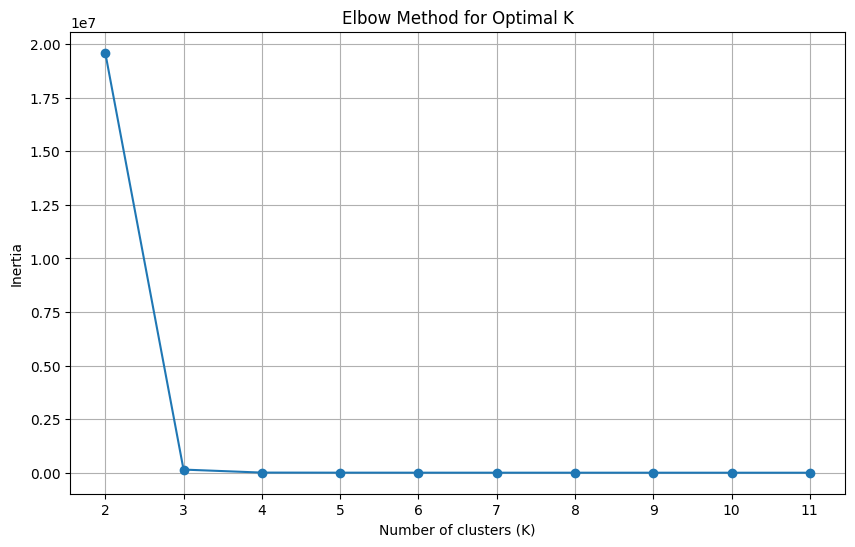

./elbow_test_export/SS-A_csv_50_65388_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         6         3     14421.00    224.68        0
1          1000         3         4      3174.30    802.50        2
2             5         5        15     20974.00    175.37        0
3          1000         5         6      3393.40    781.84        2
4          1000         4         7      3122.10    801.62        2
..          ...       ...       ...          ...       ...      ...
245           9         4         2     12555.00    258.72        0
246           8         3        16     19473.00    162.89        0
247       10000         1         4       365.31   7893.60        1
248           7         4        16     19656.00    172.61        0
249           9         3        12     20720.00    183.96        0

[250 rows x 6 columns]
[0.1804070149733212, 0.8935465589767663, 0.6212341900769629, nan]
[0.1804070149733212, 0

<Figure size 640x480 with 0 Axes>

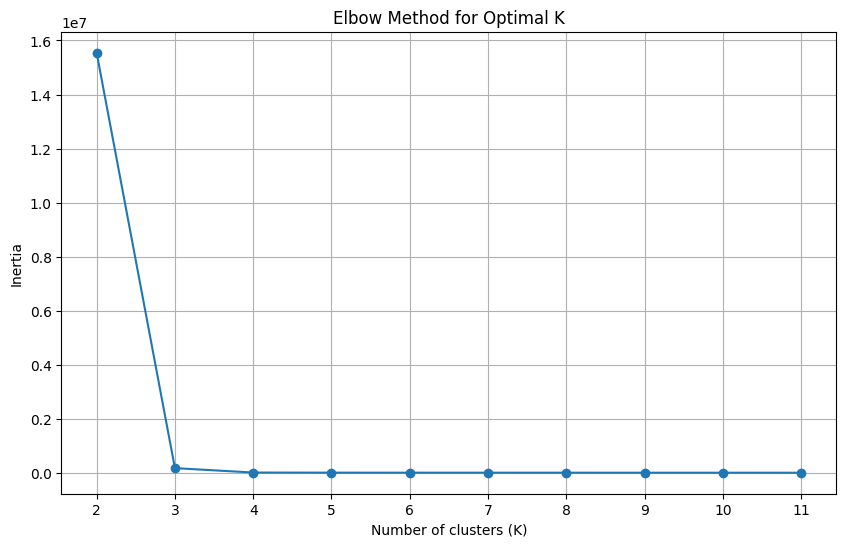

./elbow_test_export/SS-A_csv_50_65444_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             8         4         8     17532.00    199.11        0
1            10         1         1      8904.20    342.47        0
2             1         3        12     18268.00    200.34        0
3           100         2         7     17395.00    189.31        0
4             5         4         8     17993.00    197.27        0
..          ...       ...       ...          ...       ...      ...
245       10000         1         7       458.25   7869.60        1
246         100         4        10     18951.00    185.00        0
247           9         2         4     15208.00    213.92        0
248           5         1         2     12419.00    249.40        0
249           3         6        16     19563.00    186.97        0

[250 rows x 6 columns]
[0.19115578337879707, 0.9162879045316134, 0.6262882435732096, nan]
[0.19115578337879707,

<Figure size 640x480 with 0 Axes>

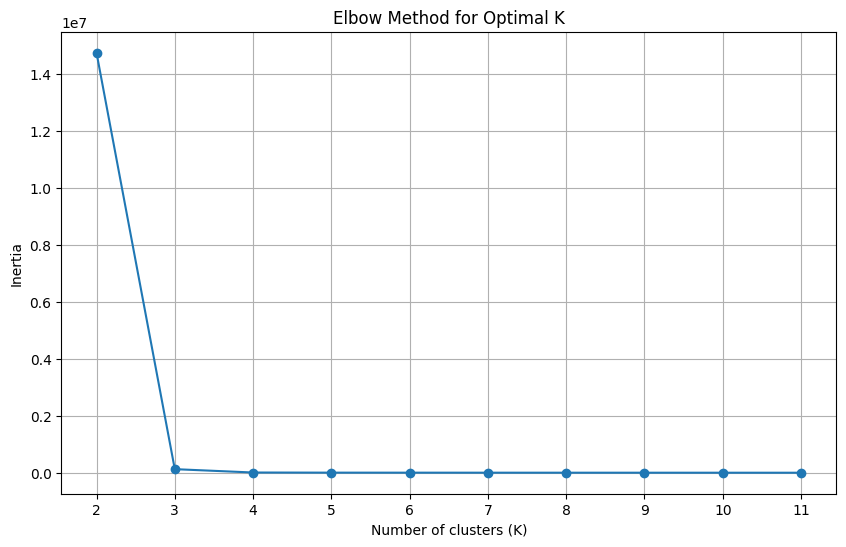

./elbow_test_export/SS-A_csv_50_66946_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         4         9      17995.0    217.53        0
1             1         5        14      17701.0    193.79        0
2             2         5         9      17453.0    193.94        0
3             7         2        15      18042.0    199.53        0
4             4         4         3      15042.0    210.11        0
..          ...       ...       ...          ...       ...      ...
245           3         1        13      13984.0    227.01        0
246          10         6        15      21456.0    162.78        0
247           1         4         4      14204.0    250.52        0
248           8         1        11      16861.0    189.71        0
249           2         1        13      13554.0    237.44        0

[250 rows x 6 columns]
[0.19585613308297112, 0.9425830541125412, 0.6261422117305918, nan]
[0.19585613308297112,

<Figure size 640x480 with 0 Axes>

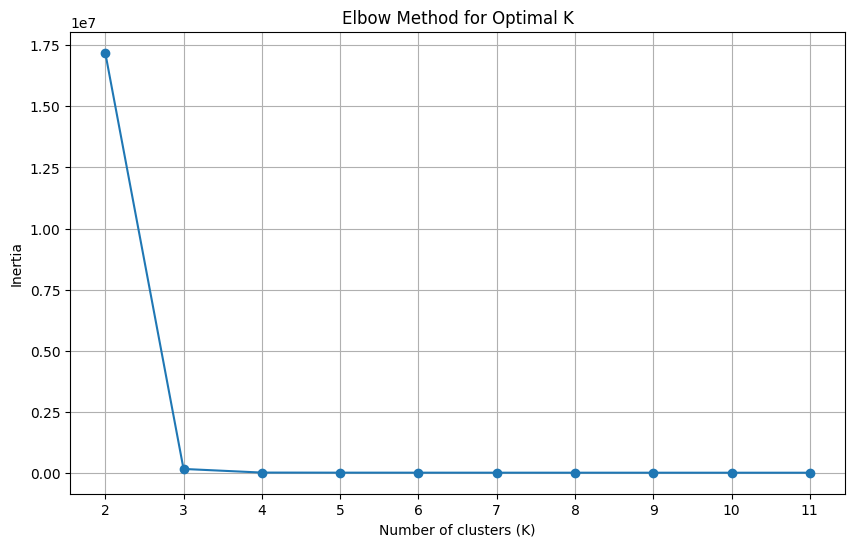

./elbow_test_export/SS-A_csv_50_69024_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         3         6      16835.0    192.88        0
1             6         6        10      19108.0    179.76        0
2             4         1         9      13562.0    241.96        0
3             3         1         4      12158.0    264.35        0
4             6         2        13      19408.0    170.62        0
..          ...       ...       ...          ...       ...      ...
245           6         2         5      15739.0    220.35        0
246           2         3        11      17883.0    193.69        0
247         100         3        11      18535.0    188.22        0
248           7         3         8      17395.0    195.07        0
249          10         2        17      20561.0    169.34        0

[250 rows x 6 columns]
[0.18365569646951746, 0.8895272986128869, 0.6222375099179196, nan]
[0.18365569646951746,

<Figure size 640x480 with 0 Axes>

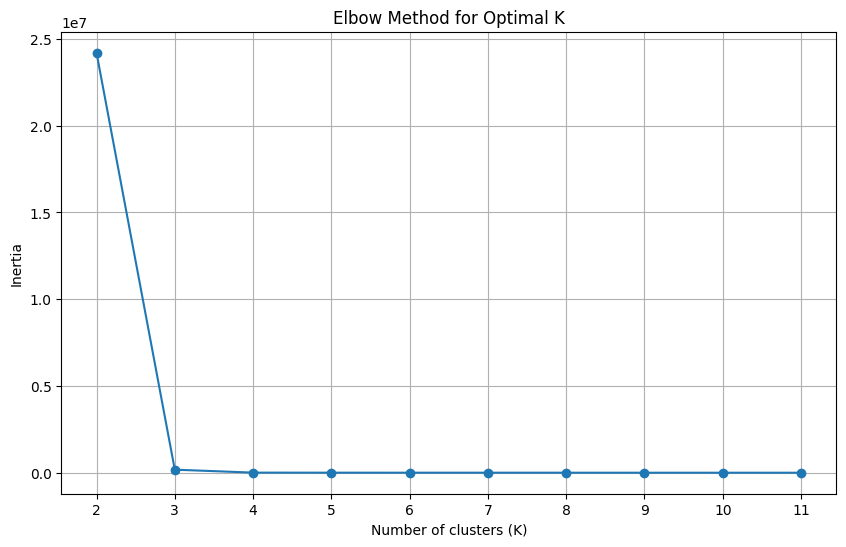

./elbow_test_export/SS-A_csv_50_70006_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             8         2         2      13030.0    260.79        1
1             3         4         3      14792.0    209.99        1
2             5         3        10      18616.0    190.96        1
3             3         1        12      13273.0    245.45        1
4             5         2        10      18282.0    181.31        1
..          ...       ...       ...          ...       ...      ...
245           5         4        10      18996.0    175.97        1
246           5         6         4      16099.0    204.13        1
247           7         3         9      18581.0    183.62        1
248          10         5        12      20586.0    178.32        1
249           3         3         3      14959.0    228.82        1

[250 rows x 6 columns]
[0.8771102250802347, 0.19067580120431846, 0.6252219686223504, nan]
[0.8771102250802347, 

<Figure size 640x480 with 0 Axes>

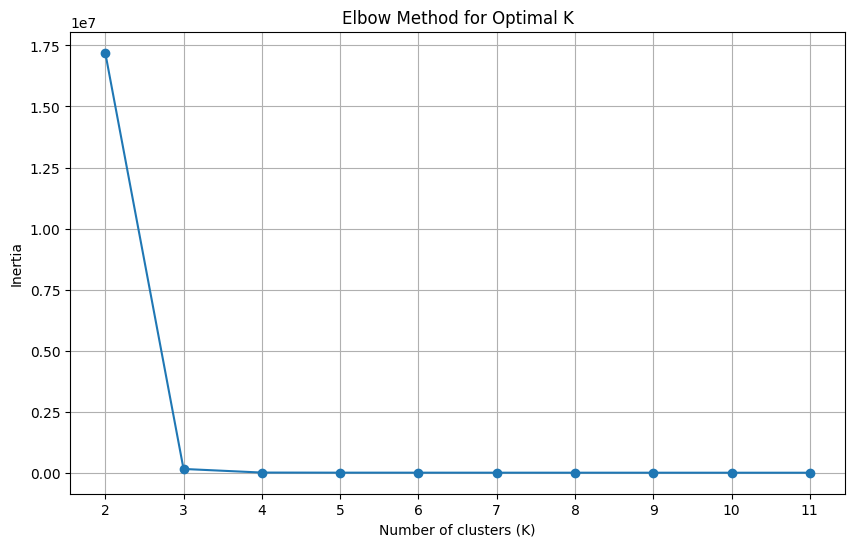

./elbow_test_export/SS-A_csv_50_70292_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             1         3         9     17202.00    205.13        0
1             5         5        11     19349.00    194.77        0
2             2         3         5     15768.00    229.09        0
3             1         3         4     14334.00    248.43        0
4             9         1        14     17554.00    185.15        0
..          ...       ...       ...          ...       ...      ...
245          10         5        13     20963.00    170.36        0
246       10000         1         4       365.31   7893.60        1
247           7         4         7     16671.00    216.34        0
248          10         1        18     15186.00    215.93        0
249           6         4        14     18883.00    171.99        0

[250 rows x 6 columns]
[0.16805327965844016, 0.8742094119924961, 0.6192151021332597, nan]
[0.16805327965844016,

<Figure size 640x480 with 0 Axes>

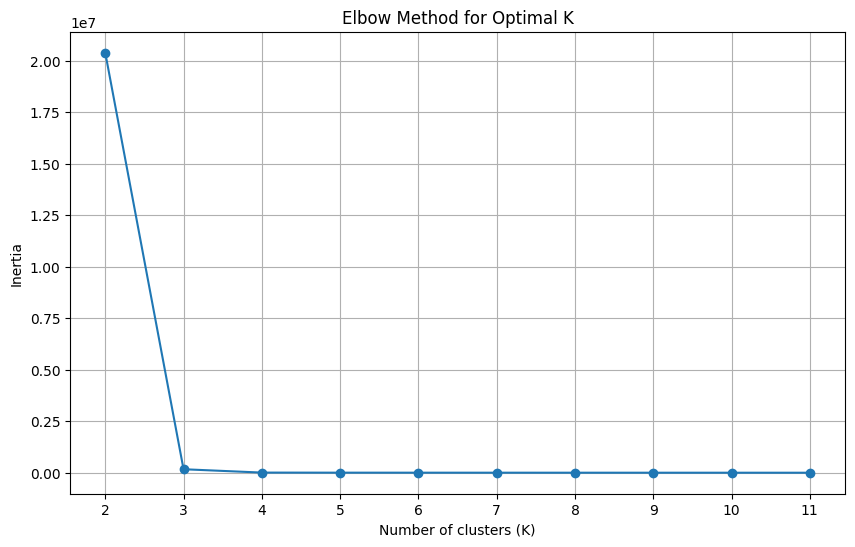

./elbow_test_export/SS-A_csv_50_77340_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             9         6         8     18180.00    199.41        0
1            10         4        11     18628.00    184.06        0
2         10000         3         6       586.88   6634.30        1
3            10         2         3     14577.00    228.04        0
4         10000         1         1       310.06   9421.00        1
..          ...       ...       ...          ...       ...      ...
245          10         2         1      9113.50    346.29        0
246           5         1        18     14336.00    224.22        0
247           8         1        12     14735.00    222.12        0
248           5         5         5     16032.00    205.54        0
249           6         1        11     15407.00    209.92        0

[250 rows x 6 columns]
[0.19066881325928808, 0.8644594076625526, 0.6207544691481263, nan]
[0.19066881325928808,

<Figure size 640x480 with 0 Axes>

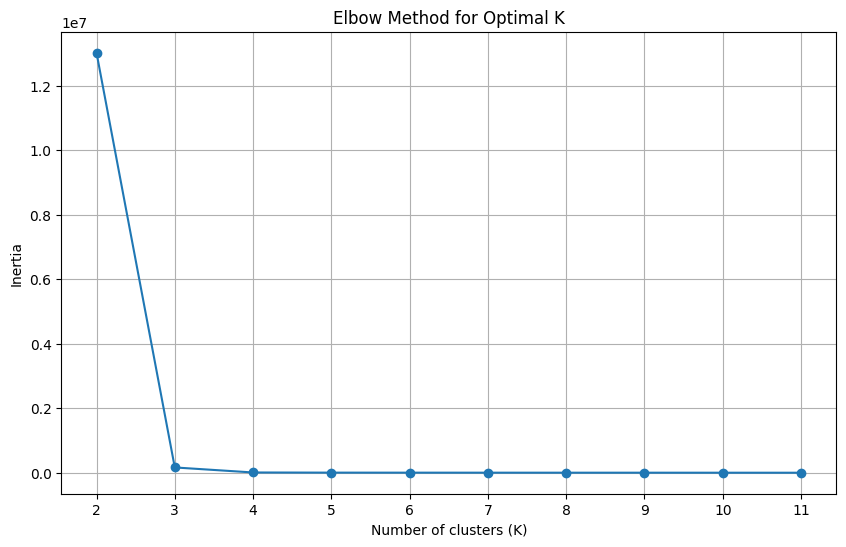

./elbow_test_export/SS-A_csv_50_77845_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             5         5         3      15595.0    212.96        0
1            10         5         7      17759.0    207.33        0
2             9         6        13      20492.0    165.89        0
3             5         1         1       8785.9    362.94        0
4          1000         3         2       3145.2    895.01        2
..          ...       ...       ...          ...       ...      ...
245       10000         3         2        434.0   7092.80        1
246           3         3         3      14959.0    228.82        0
247           7         3        17      22119.0    155.28        0
248         100         2         2      12896.0    247.46        0
249           6         1        10      13771.0    231.09        0

[250 rows x 6 columns]
[0.19578746734366032, 0.8857726916543263, 0.6256681631163484, nan]
[0.19578746734366032,

<Figure size 640x480 with 0 Axes>

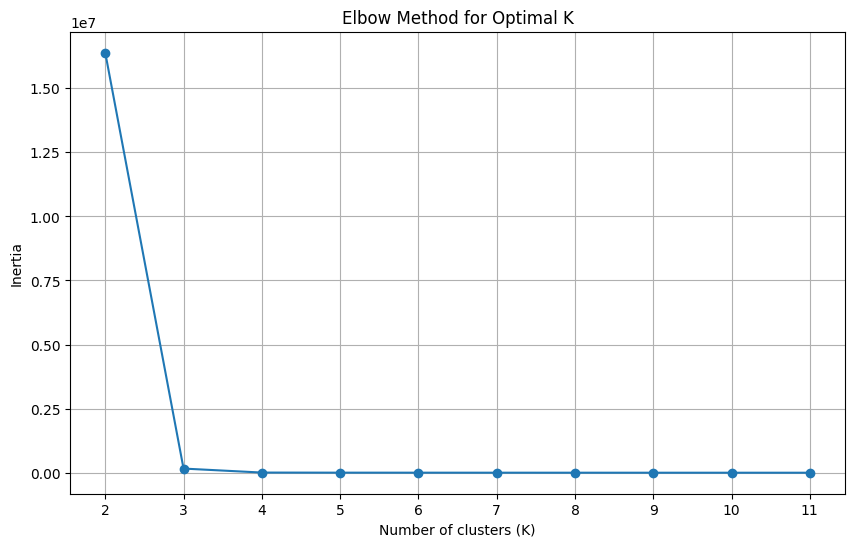

./elbow_test_export/SS-A_csv_50_83686_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             1         1        14      15891.0    198.18        0
1             8         5        15      20649.0    177.56        0
2           100         4         4      15496.0    208.09        0
3             9         1         8      16708.0    188.86        0
4             5         5        15      20974.0    175.37        0
..          ...       ...       ...          ...       ...      ...
245           5         6        13      19954.0    193.66        0
246           4         6        14      20253.0    184.74        0
247           4         1        18      14346.0    216.52        0
248           8         1         9      14181.0    238.17        0
249           2         3        17      19203.0    190.63        0

[250 rows x 6 columns]
[0.19843731337343248, 0.9207331750366261, 0.623220635506664, nan]
[0.19843731337343248, 

<Figure size 640x480 with 0 Axes>

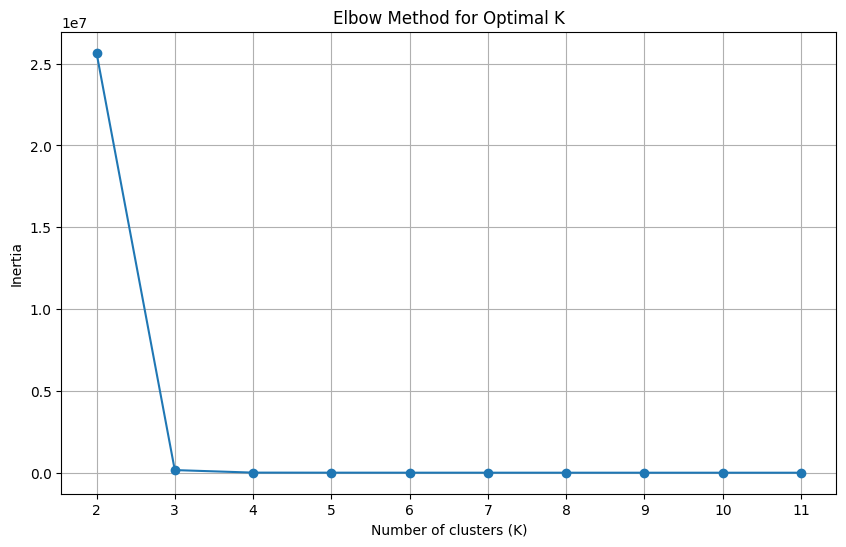

./elbow_test_export/SS-A_csv_50_84967_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             6         6         6     16882.00    195.61        0
1             5         1         8     15183.00    200.64        0
2             1         5        17     20391.00    176.12        0
3             7         4        13     20307.00    183.41        0
4             7         6        10     19514.00    161.74        0
..          ...       ...       ...          ...       ...      ...
245       10000         1         9       407.65   7631.90        1
246           4         6        11     18891.00    183.68        0
247           9         1        16     14631.00    214.60        0
248           3         3         7     16580.00    197.74        0
249           1         1         3     11601.00    286.42        0

[250 rows x 6 columns]
[0.18018201997275837, 0.8815533464027561, 0.6199207723202896, nan]
[0.18018201997275837,

<Figure size 640x480 with 0 Axes>

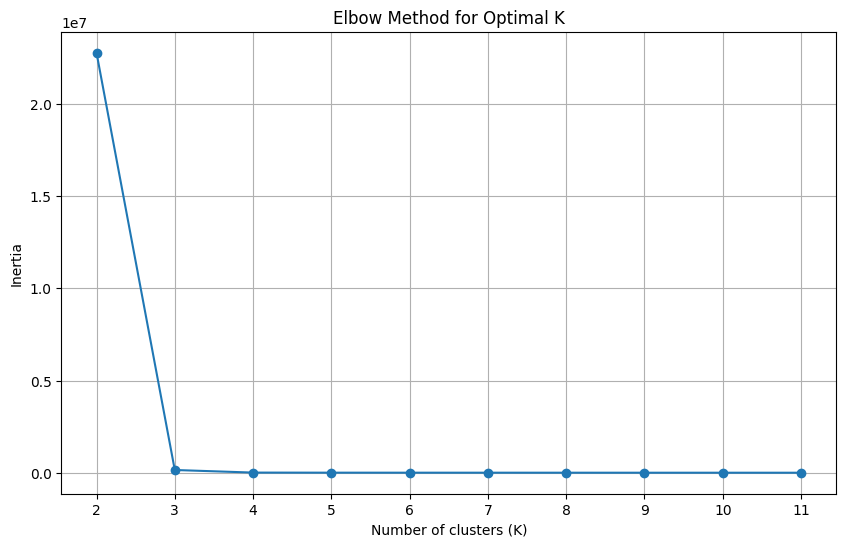

./elbow_test_export/SS-A_csv_50_86331_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0          1000         2         3       3014.6    859.05        2
1             3         6        15      19391.0    182.76        0
2          1000         3         2       3145.2    895.01        2
3            10         4        12      19995.0    187.02        0
4             9         6        18      22063.0    161.93        0
..          ...       ...       ...          ...       ...      ...
245         100         4         2      13006.0    253.35        0
246           5         6        16      19756.0    220.60        0
247           6         4        16      20350.0    184.46        0
248           5         6        10      20159.0    172.33        0
249           2         2         4      14545.0    220.19        0

[250 rows x 6 columns]
[0.17842013919713592, 0.877316402533946, 0.6199993336200855, nan]
[0.17842013919713592, 

<Figure size 640x480 with 0 Axes>

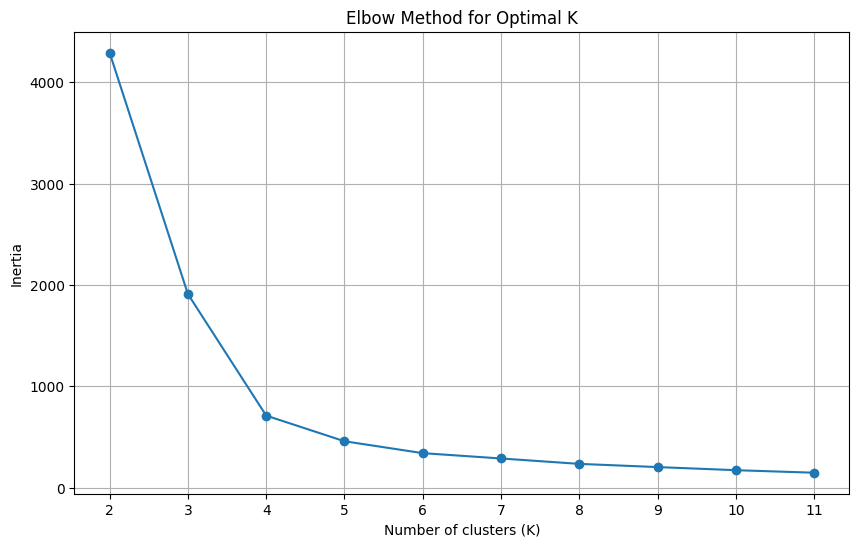

./elbow_test_export/SS-B_csv_10_11514_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   4   4  5  11.418380   8.441542        1
1   7  25  4  15.570627  11.449612        0
2   2  35  3  10.754888  10.605701        3
3   7   1  5  12.394731   6.531198        1
4   8  19  3  15.884648  11.817928        0
5   1   2  5   8.113742   4.866478        1
6   2   2  5   8.781360   5.841435        1
7   7   8  5  15.316034   7.679359        1
8   3  15  3  11.558421   9.260459        0
9   3   8  4  10.877284   8.708210        1
10  2  64  5  11.998238  10.379860        2
11  8   8  3  15.230321  10.964736        1
12  2  35  4  11.350939  10.658356        3
13  6  22  4  14.571693  11.210189        0
14  5  64  5  14.745464  12.647612        2
15  5  14  3  13.126866  10.291747        0
16  6   8  5  14.312883   9.170858        1
17  4  15  3  12.350663   9.859624        0
18  3  14  3  11.302068   9.014281        0
19  1  19  4  10.078151   7.739011        0
20  

<Figure size 640x480 with 0 Axes>

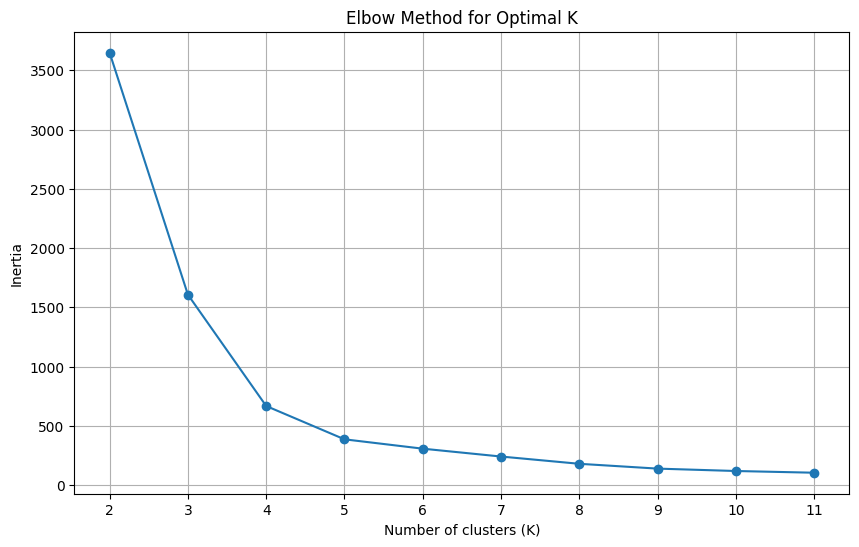

./elbow_test_export/SS-B_csv_10_19953_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   4  15  3  12.350663   9.859624        1
1   2  15  4  10.763212   8.438053        1
2   5  22  4  13.711990  11.155200        1
3   4   7  4  11.670656   9.510868        3
4   7  36  2  15.487338  14.607669        2
5   2   4  5   9.741467   6.774451        3
6   7   8  4  14.352112  10.737119        3
7   1   7  3   9.453271   6.788873        3
8   5  36  2  13.741256  13.301757        2
9   6  25  4  14.687102  11.285924        1
10  0   8  3   9.154818   6.035372        3
11  2   7  3  10.109831   7.761617        3
12  1  15  3   9.909893   7.430870        1
13  6  35  4  14.766477  12.441721        2
14  8  22  3  16.139791  11.910892        1
15  1  64  5  11.253257   9.618119        0
16  0   7  4   8.829723   5.789716        3
17  2   7  4  10.071462   7.804960        3
18  8  25  3  16.248817  12.121851        1
19  5  19  3  13.320801  10.783261        1
20  

<Figure size 640x480 with 0 Axes>

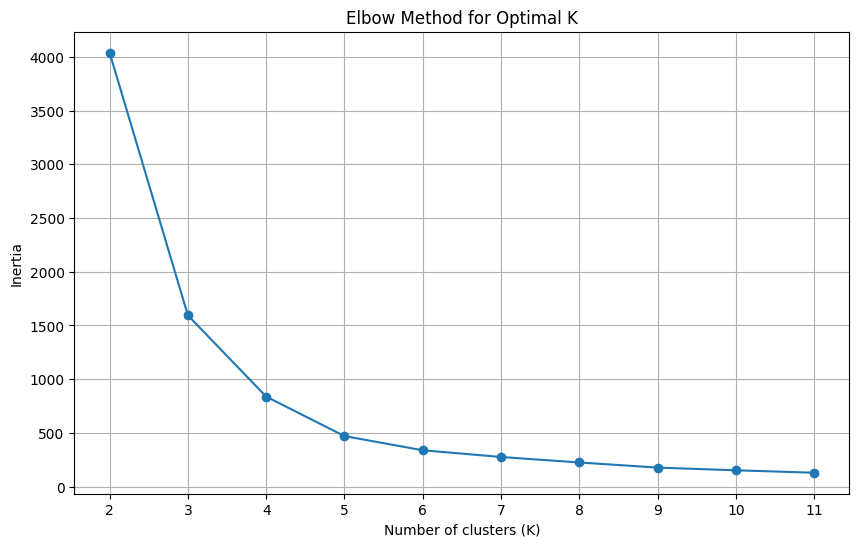

./elbow_test_export/SS-B_csv_10_3545_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   0  35  4  10.783817   8.776750        3
1   4  25  3  12.790959  11.143271        0
2   5  64  5  14.745464  12.647612        2
3   3   1  5   8.727920   5.793274        1
4   5   8  3  12.848427  10.226753        1
5   5   2  5  11.403012   7.665282        1
6   1   7  4   9.477758   6.860690        1
7   5  14  4  13.205793  10.466042        0
8   1   7  3   9.453271   6.788873        1
9   1  14  4   9.818582   7.226334        0
10  2  36  1  10.674192  10.664197        3
11  8  22  4  16.088416  11.881295        0
12  0   8  5   9.974415   5.773588        1
13  1  22  4  10.323055   8.210060        0
14  2  32  5  11.981567   9.663790        3
15  2   7  4  10.071462   7.804960        1
16  6  22  3  14.535701  11.251882        0
17  3  25  3  11.836839  10.539956        0
18  3  25  4  12.049168  10.515274        0
19  3   7  3  10.887982   8.553987        1
20  1

<Figure size 640x480 with 0 Axes>

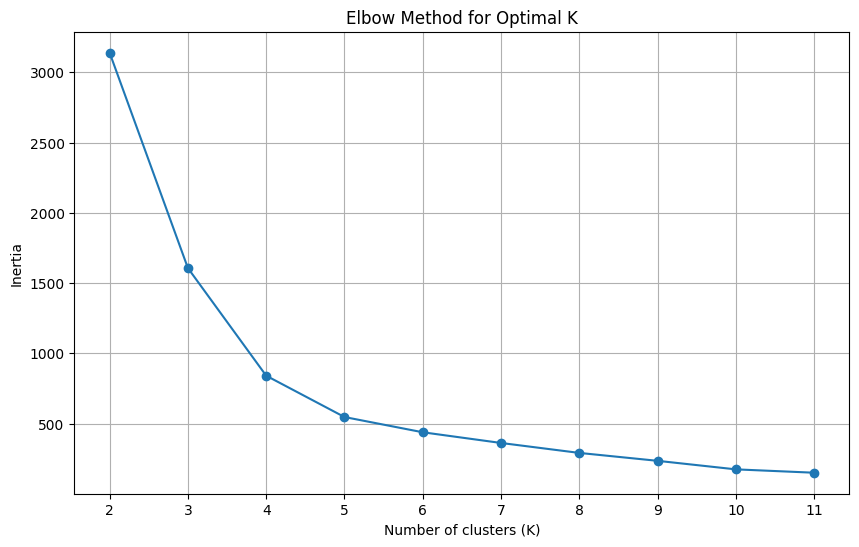

./elbow_test_export/SS-B_csv_10_39658_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   0   8  4   9.095397   6.023400        1
1   2  25  4  11.238405   9.685227        0
2   5   8  4  12.645433  10.303557        1
3   2  19  4  10.924070   8.752437        0
4   8   7  4  14.861862  10.542601        1
5   7  25  3  15.409888  11.399654        0
6   1   8  5   9.896332   6.766133        1
7   6   4  5  13.267372   8.566592        1
8   3   7  4  10.751544   8.522530        1
9   6  64  5  15.762460  12.820270        2
10  2  25  3  10.999295   9.728445        0
11  1  15  3   9.909893   7.430870        0
12  6   7  4  13.315999  10.376358        1
13  3  32  5  12.845882  10.533025        3
14  0  36  1  10.659104   8.834195        3
15  1  14  4   9.818582   7.226334        0
16  6  19  3  14.287568  10.954591        0
17  1  32  5  11.039605   8.783425        3
18  3   4  5  10.531381   7.654110        1
19  6  36  1  14.481799  13.702149        3
20  

<Figure size 640x480 with 0 Axes>

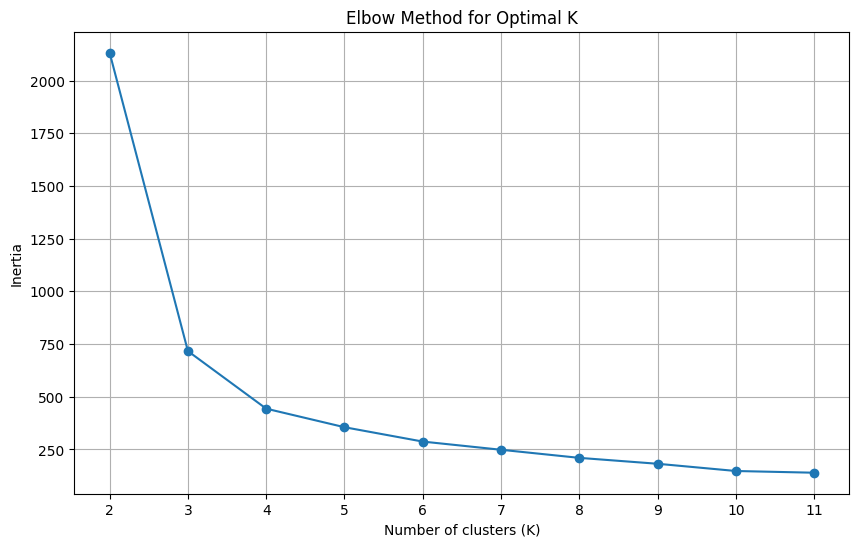

./elbow_test_export/SS-B_csv_10_40749_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   6  25  4  14.687102  11.285924        3
1   5  35  4  13.886459  12.999354        0
2   4   1  5   9.592457   6.564960        2
3   2   8  4  10.198445   7.921882        2
4   8  19  3  15.884648  11.817928        1
5   5  22  3  13.668109  10.971748        3
6   3  22  3  11.790349   9.962559        3
7   6  19  4  14.339989  10.792767        1
8   3   4  5  10.531381   7.654110        2
9   6   1  5  11.432020   6.942699        2
10  6  22  4  14.571693  11.210189        3
11  2  16  5  11.088126   8.690661        1
12  8  22  3  16.139791  11.910892        3
13  5   2  5  11.403012   7.665282        2
14  1   2  5   8.113742   4.866478        2
15  0  36  1  10.659104   8.834195        0
16  5  36  1  13.523807  13.231562        0
17  5   4  5  12.371504   8.565524        2
18  6  36  1  14.481799  13.702149        0
19  0   7  3   8.924813   5.870475        2
20  

<Figure size 640x480 with 0 Axes>

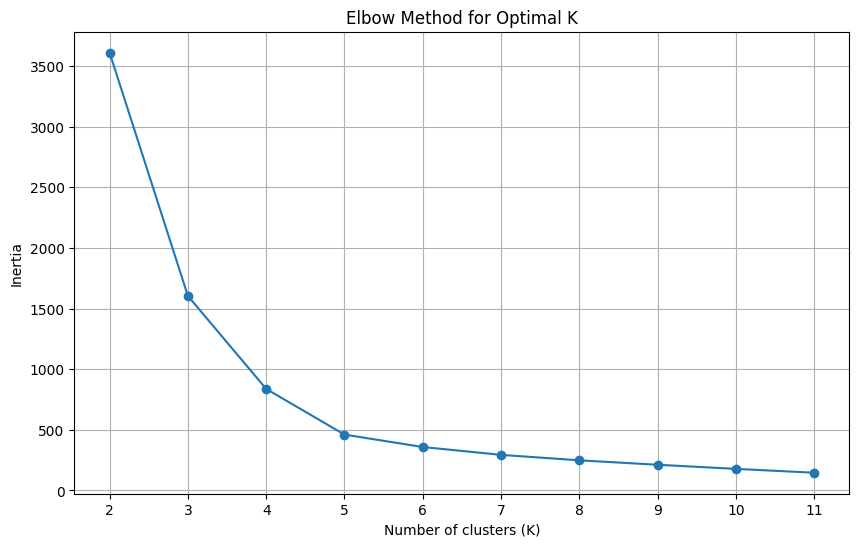

./elbow_test_export/SS-B_csv_10_44845_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   3   8  3  11.018200   8.807303        0
1   3  19  4  11.700440   9.614973        3
2   2  35  3  10.754888  10.605701        1
3   7  14  3  14.726165  10.759571        3
4   3  36  2  12.047806  11.653700        1
5   6  25  4  14.687102  11.285924        3
6   1  14  3   9.832890   7.256974        3
7   5  15  4  13.309192  10.625240        3
8   0   8  3   9.154818   6.035372        0
9   5  36  1  13.523807  13.231562        1
10  1  22  3  10.306062   8.144994        3
11  6   2  5  12.365502   7.721986        0
12  7   8  3  14.121291   9.970628        0
13  2  64  5  11.998238  10.379860        2
14  1  16  5  10.215533   7.730256        3
15  2  25  3  10.999295   9.728445        3
16  1  14  4   9.818582   7.226334        3
17  0  15  4   9.821774   6.445010        3
18  6  36  2  14.628047  13.511345        1
19  1  64  5  11.253257   9.618119        2
20  

<Figure size 640x480 with 0 Axes>

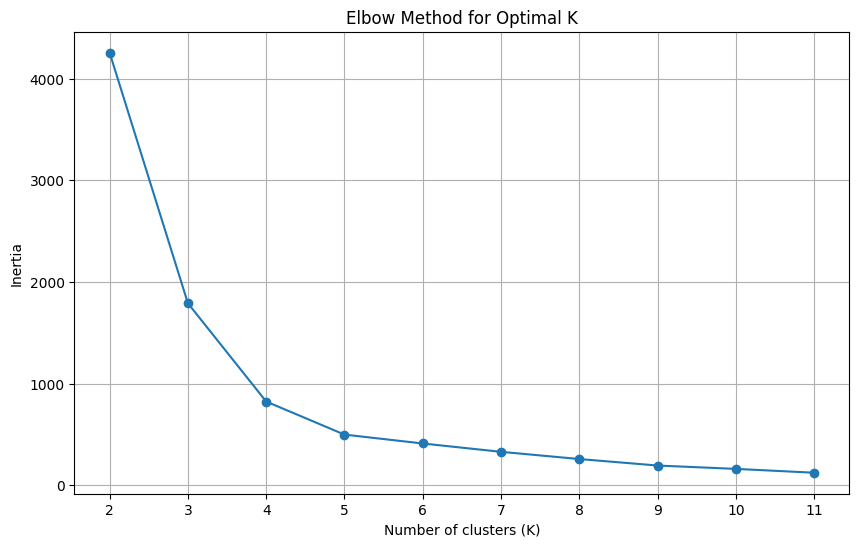

./elbow_test_export/SS-B_csv_10_51176_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   4  15  4  12.439311   9.998034        0
1   6  14  3  14.084642  10.918388        0
2   0  15  3   9.622052   6.511823        0
3   6   8  3  13.714782  10.594225        3
4   2  64  5  11.998238  10.379860        2
5   4  19  3  12.507795  10.276688        0
6   3  25  4  12.049168  10.515274        0
7   5   2  5  11.403012   7.665282        3
8   5  19  4  13.482430  10.944205        0
9   4  35  3  12.699139  12.156370        1
10  7  35  3  15.481169  13.652684        1
11  6  64  5  15.762460  12.820270        2
12  8   2  5  14.217200   7.276899        3
13  4  36  1  12.650827  12.474188        1
14  3   4  5  10.531381   7.654110        3
15  8  25  4  16.204724  11.732874        0
16  3  35  3  11.822969  11.460401        1
17  3  16  5  11.957828   9.621040        0
18  6  36  2  14.628047  13.511345        1
19  7  14  3  14.726165  10.759571        0
20  

<Figure size 640x480 with 0 Axes>

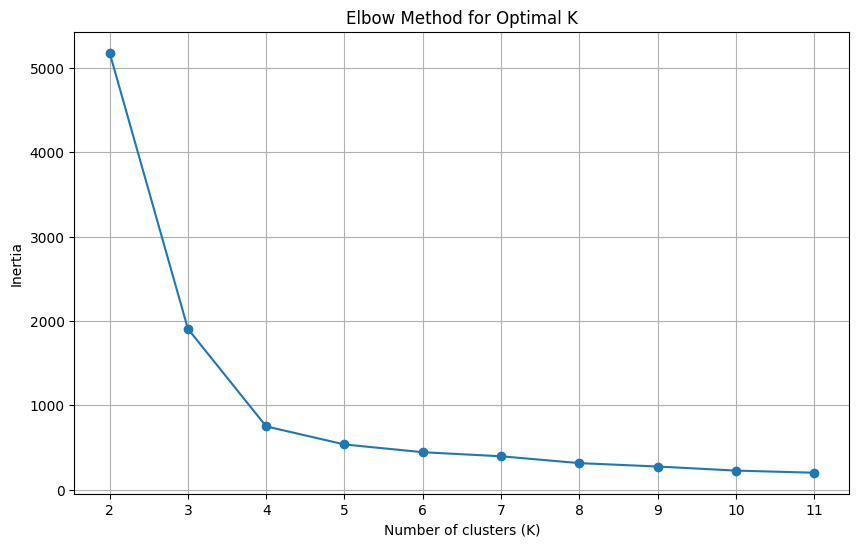

./elbow_test_export/SS-B_csv_10_58612_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   1   7  4   9.477758   6.860690        3
1   0   4  5   9.019591   4.849817        3
2   5  36  1  13.523807  13.231562        0
3   2  35  3  10.754888  10.605701        0
4   7  36  1  15.395902  14.716642        0
5   7  36  2  15.487338  14.607669        0
6   2  64  5  11.998238  10.379860        2
7   3  36  2  12.047806  11.653700        0
8   3  19  4  11.700440   9.614973        1
9   4  36  1  12.650827  12.474188        0
10  1  32  5  11.039605   8.783425        0
11  7  15  3  14.859874  10.751941        1
12  6  15  4  14.178509  11.034255        1
13  4   2  5  10.467606   7.448730        3
14  8   2  5  14.217200   7.276899        3
15  8  22  3  16.139791  11.910892        1
16  0  19  4  10.056638   6.792885        1
17  3  19  3  11.507299   9.434259        1
18  0   1  5   7.098032   2.858161        3
19  4   8  3  11.978353   9.557561        3
20  

<Figure size 640x480 with 0 Axes>

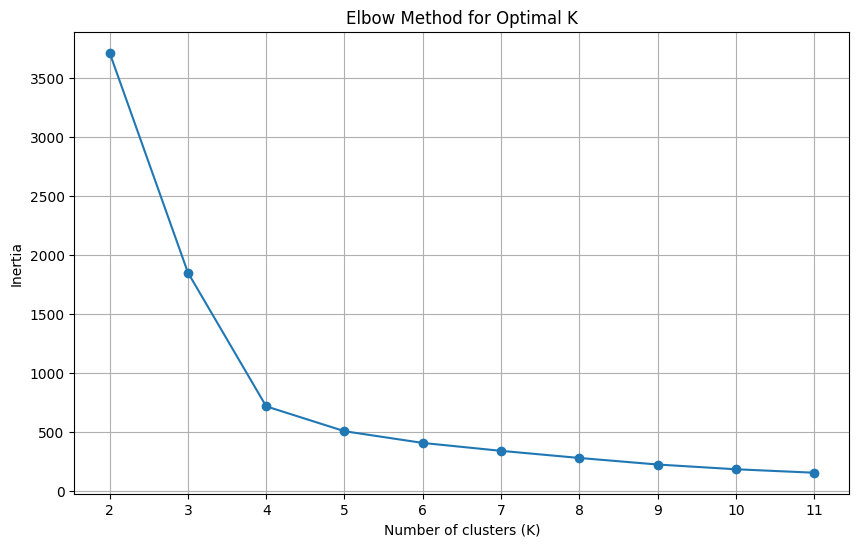

./elbow_test_export/SS-B_csv_10_61367_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   4  15  4  12.439311   9.998034        3
1   5   7  3  12.739148  10.032341        0
2   3   8  4  10.877284   8.708210        0
3   1  22  3  10.306062   8.144994        3
4   3  32  5  12.845882  10.533025        1
5   3  19  3  11.507299   9.434259        3
6   1  64  5  11.253257   9.618119        2
7   1  19  3   9.965784   7.724035        3
8   2  35  3  10.754888  10.605701        1
9   0  25  3  10.231221   7.792135        3
10  7   8  4  14.352112  10.737119        0
11  4  25  3  12.790959  11.143271        3
12  3   7  4  10.751544   8.522530        0
13  8  19  3  15.884648  11.817928        3
14  8   4  5  15.160305   7.802507        0
15  8  25  3  16.248817  12.121851        3
16  5  15  4  13.309192  10.625240        3
17  5  19  4  13.482430  10.944205        3
18  0  22  4  10.272630   7.208749        3
19  1  16  5  10.215533   7.730256        3
20  

<Figure size 640x480 with 0 Axes>

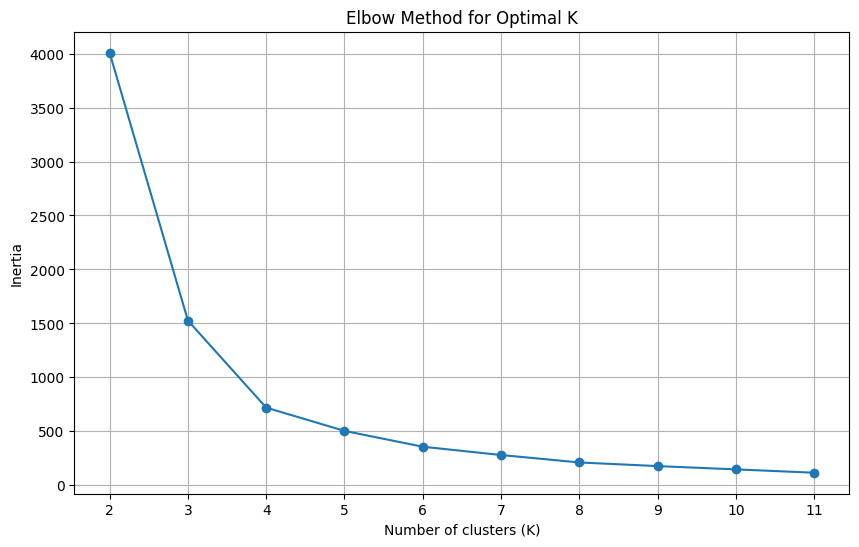

./elbow_test_export/SS-B_csv_10_65388_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   0  15  4   9.821774   6.445010        0
1   0   1  5   7.098032   2.858161        1
2   3  35  3  11.822969  11.460401        3
3   3   1  5   8.727920   5.793274        1
4   0  32  5  11.197217   7.586631        3
5   0   8  5   9.974415   5.773588        1
6   3  19  4  11.700440   9.614973        0
7   6  64  5  15.762460  12.820270        2
8   2  19  4  10.924070   8.752437        0
9   2  16  5  11.088126   8.690661        0
10  1  35  4  10.509775   9.767290        3
11  2  35  4  11.350939  10.658356        3
12  1  36  2  10.370687   9.771067        3
13  4  32  5  13.761032  11.000162        3
14  0   8  3   9.154818   6.035372        1
15  1  35  3  10.317413   9.749795        3
16  2  25  4  11.238405   9.685227        0
17  1   1  5   7.087463   3.866651        1
18  8   7  4  14.861862  10.542601        1
19  4  35  4  12.727920  11.832878        3
20  

<Figure size 640x480 with 0 Axes>

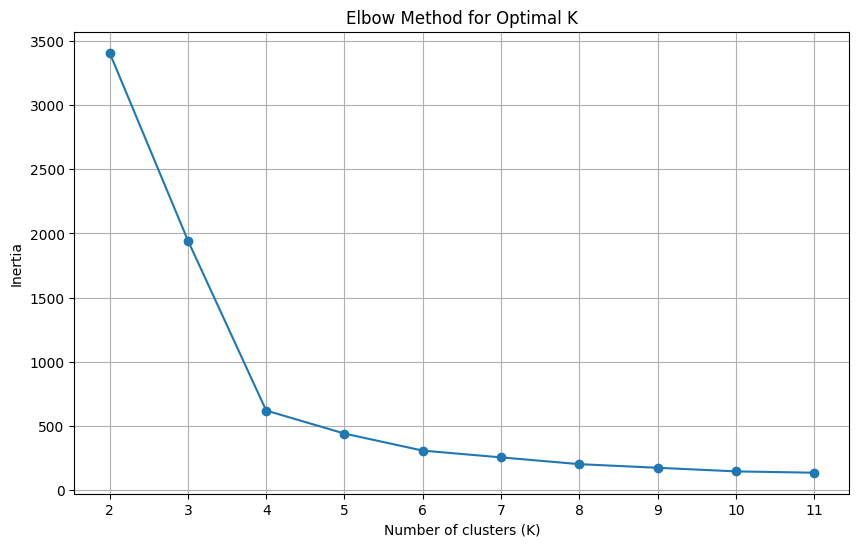

./elbow_test_export/SS-B_csv_10_65444_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   5  19  3  13.320801  10.783261        2
1   3   8  5  11.497353   8.659609        1
2   2   1  5   7.800900   4.813273        1
3   3  16  5  11.957828   9.621040        2
4   6  15  4  14.178509  11.034255        2
5   2  36  2  11.226412  10.673003        0
6   7  14  3  14.726165  10.759571        2
7   2   8  4  10.198445   7.921882        1
8   1   1  5   7.087463   3.866651        1
9   0  35  3  10.713387   8.817826        0
10  6  64  5  15.762460  12.820270        3
11  8   4  5  15.160305   7.802507        1
12  7  15  3  14.859874  10.751941        2
13  2   7  4  10.071462   7.804960        1
14  8  22  4  16.088416  11.881295        2
15  2  36  1  10.674192  10.664197        0
16  4  19  4  12.639341  10.190997        2
17  4  15  4  12.439311   9.998034        2
18  3  19  3  11.507299   9.434259        2
19  3  22  3  11.790349   9.962559        2
20  

<Figure size 640x480 with 0 Axes>

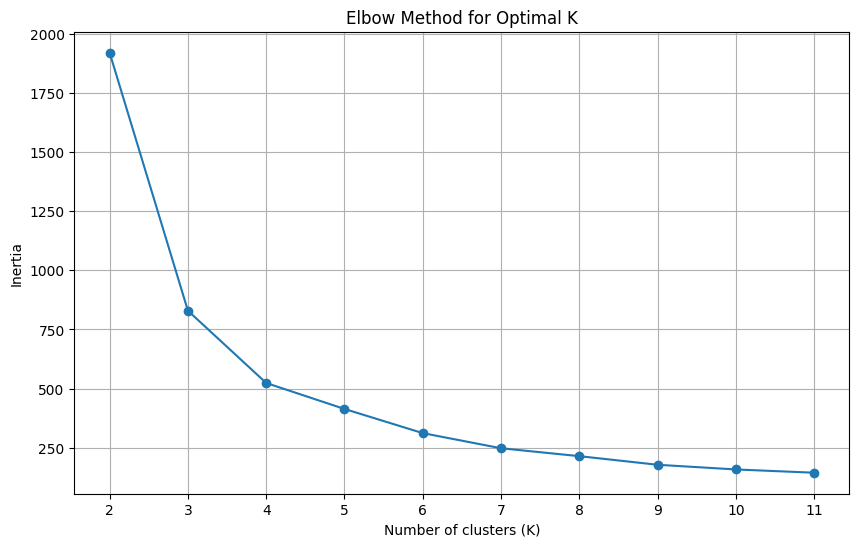

./elbow_test_export/SS-B_csv_10_66946_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   5   4  5  12.371504   8.565524        3
1   3   8  5  11.497353   8.659609        3
2   0  22  4  10.272630   7.208749        2
3   5  36  1  13.523807  13.231562        1
4   0  19  4  10.056638   6.792885        2
5   4  22  4  12.849796  10.558219        2
6   1   7  4   9.477758   6.860690        3
7   7  22  4  15.473072  11.356088        2
8   7   7  3  14.221587  10.173124        3
9   2   7  3  10.109831   7.761617        3
10  5  15  4  13.309192  10.625240        0
11  5  25  4  13.849601  11.605192        2
12  1  25  4  10.493855   8.767953        2
13  6  14  3  14.084642  10.918388        0
14  6  35  3  14.606232  13.359816        1
15  4  22  3  12.712312  10.706747        2
16  4   8  3  11.978353   9.557561        3
17  2  16  5  11.088126   8.690661        0
18  5  15  3  13.278885  10.372685        0
19  2  35  3  10.754888  10.605701        1
20  

<Figure size 640x480 with 0 Axes>

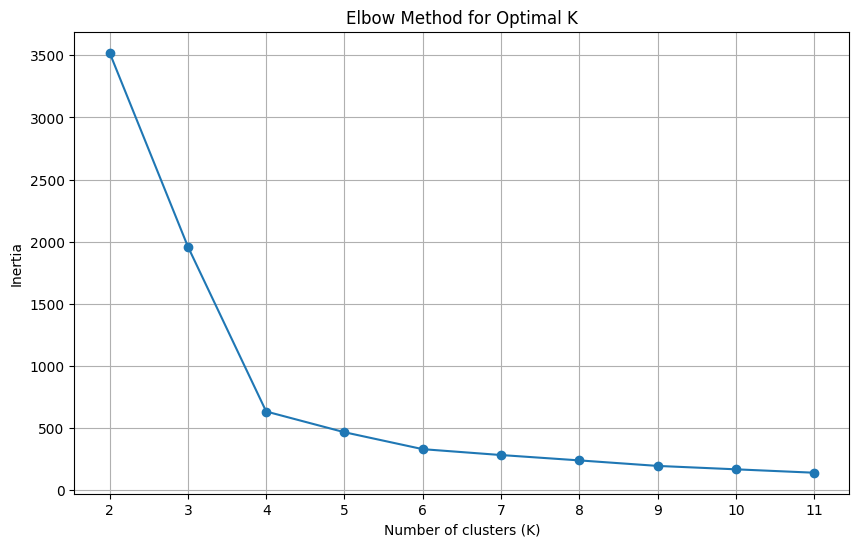

./elbow_test_export/SS-B_csv_10_69024_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   4  19  3  12.507795  10.276688        2
1   3   7  4  10.751544   8.522530        0
2   1  15  4   9.914385   7.422664        2
3   0  14  4   9.562242   6.227884        2
4   3  19  4  11.700440   9.614973        2
5   0  19  4  10.056638   6.792885        2
6   7   4  5  14.319954   7.603452        0
7   0   1  5   7.098032   2.858161        0
8   2  19  3  10.643856   8.675316        2
9   3  15  3  11.558421   9.260459        2
10  5  19  3  13.320801  10.783261        2
11  8   1  5  13.309761   7.537931        0
12  4  15  3  12.350663   9.859624        2
13  2  15  4  10.763212   8.438053        2
14  5  22  3  13.668109  10.971748        2
15  2  64  5  11.998238  10.379860        3
16  6   1  5  11.432020   6.942699        0
17  6   4  5  13.267372   8.566592        0
18  2  36  2  11.226412  10.673003        1
19  5   4  5  12.371504   8.565524        0
20  

<Figure size 640x480 with 0 Axes>

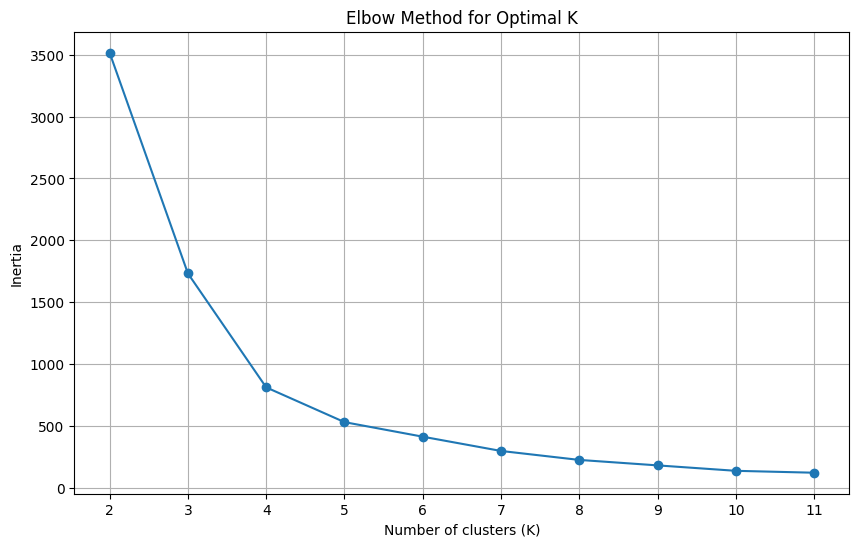

./elbow_test_export/SS-B_csv_10_70006_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   5  35  3  13.614020  13.001940        1
1   4   8  5  12.418643   9.433253        0
2   1  25  3  10.379378   8.751378        3
3   2  14  4  10.578373   8.177040        3
4   0   8  3   9.154818   6.035372        0
5   2  16  5  11.088126   8.690661        3
6   2   8  5  10.698705   7.710955        0
7   2  15  4  10.763212   8.438053        3
8   4  19  3  12.507795  10.276688        3
9   6  14  4  14.053502  10.934213        3
10  0   2  5   7.971544   3.831970        0
11  7   7  3  14.221587  10.173124        0
12  1  36  2  10.370687   9.771067        1
13  5   8  5  13.269711   9.511802        0
14  7  36  1  15.395902  14.716642        1
15  1   1  5   7.087463   3.866651        0
16  1   8  5   9.896332   6.766133        0
17  8   8  4  15.023451  11.038789        0
18  0  22  3  10.270295   7.178065        3
19  4  35  3  12.699139  12.156370        1
20  

<Figure size 640x480 with 0 Axes>

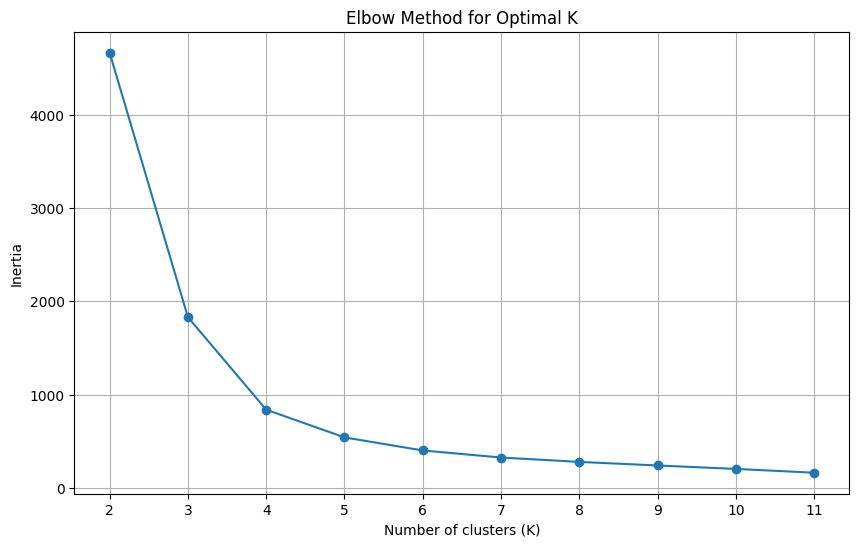

./elbow_test_export/SS-B_csv_10_70292_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   3   2  5   9.668885   6.792616        2
1   2  36  2  11.226412  10.673003        3
2   3  35  3  11.822969  11.460401        3
3   0  25  3  10.231221   7.792135        0
4   2  36  1  10.674192  10.664197        3
5   5   8  4  12.645433  10.303557        2
6   0  14  3   9.758223   6.237732        0
7   0  64  5  11.358102   8.757891        1
8   7   8  3  14.121291   9.970628        2
9   0  36  2  10.769838   8.765405        3
10  3  19  4  11.700440   9.614973        0
11  7  25  3  15.409888  11.399654        0
12  5  19  3  13.320801  10.783261        0
13  7   8  4  14.352112  10.737119        2
14  5   7  3  12.739148  10.032341        2
15  4   1  5   9.592457   6.564960        2
16  7   2  5  13.317978   7.558296        2
17  2  22  3  10.880349   9.129409        0
18  3  25  3  11.836839  10.539956        0
19  3  22  4  11.912141  10.024690        0
20  

<Figure size 640x480 with 0 Axes>

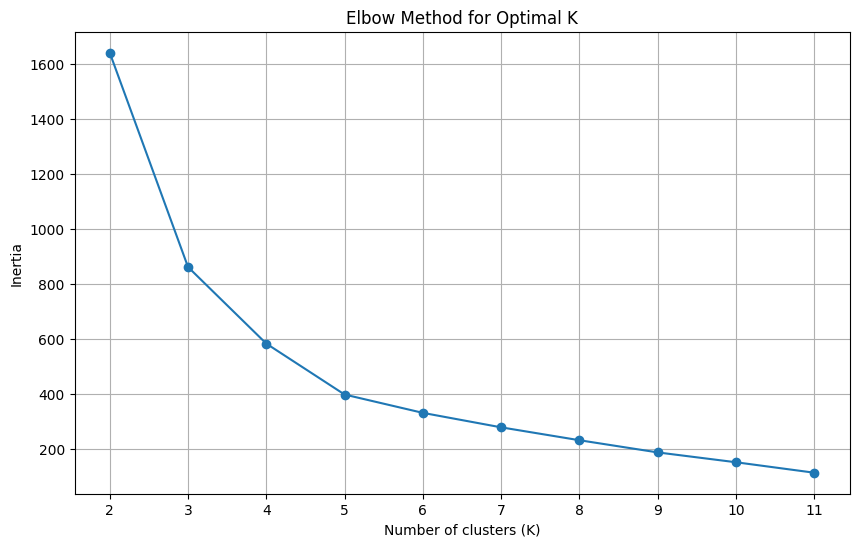

./elbow_test_export/SS-B_csv_10_77340_elbow_test.png
Optimal k value: 5
    A   B  C         A-         B-  cluster
0   6  15  3  14.195218  10.972042        1
1   7  35  4  15.567184  13.495378        0
2   2   1  5   7.800900   4.813273        4
3   6   8  3  13.714782  10.594225        2
4   1   4  5   9.038919   5.849099        4
5   1   1  5   7.087463   3.866651        4
6   6   7  4  13.315999  10.376358        2
7   5  35  4  13.886459  12.999354        0
8   6   1  5  11.432020   6.942699        4
9   4  25  3  12.790959  11.143271        3
10  0   8  4   9.095397   6.023400        2
11  1  36  1  10.092757   9.736812        0
12  3  32  5  12.845882  10.533025        0
13  5   7  3  12.739148  10.032341        2
14  3  25  4  12.049168  10.515274        3
15  5   4  5  12.371504   8.565524        4
16  0   8  5   9.974415   5.773588        2
17  0  22  4  10.272630   7.208749        3
18  6   4  5  13.267372   8.566592        4
19  1   2  5   8.113742   4.866478        4
20  

<Figure size 640x480 with 0 Axes>

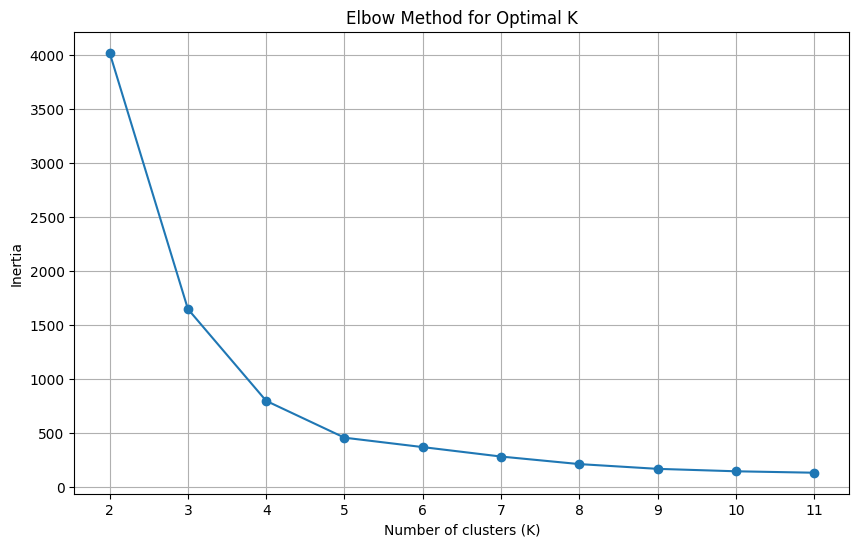

./elbow_test_export/SS-B_csv_10_77845_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   2   7  4  10.071462   7.804960        0
1   2   2  5   8.781360   5.841435        0
2   7  25  4  15.570627  11.449612        1
3   6  15  3  14.195218  10.972042        1
4   2  19  3  10.643856   8.675316        1
5   0   1  5   7.098032   2.858161        0
6   7  22  3  15.292717  11.683437        1
7   3   8  4  10.877284   8.708210        0
8   7  22  4  15.473072  11.356088        1
9   1  14  4   9.818582   7.226334        1
10  6  14  3  14.084642  10.918388        1
11  1   7  3   9.453271   6.788873        0
12  5  25  4  13.849601  11.605192        1
13  3  36  2  12.047806  11.653700        3
14  0   8  4   9.095397   6.023400        0
15  3   7  4  10.751544   8.522530        0
16  5  19  4  13.482430  10.944205        1
17  1  36  2  10.370687   9.771067        3
18  3  15  3  11.558421   9.260459        1
19  3  64  5  12.711237  11.297211        2
20  

<Figure size 640x480 with 0 Axes>

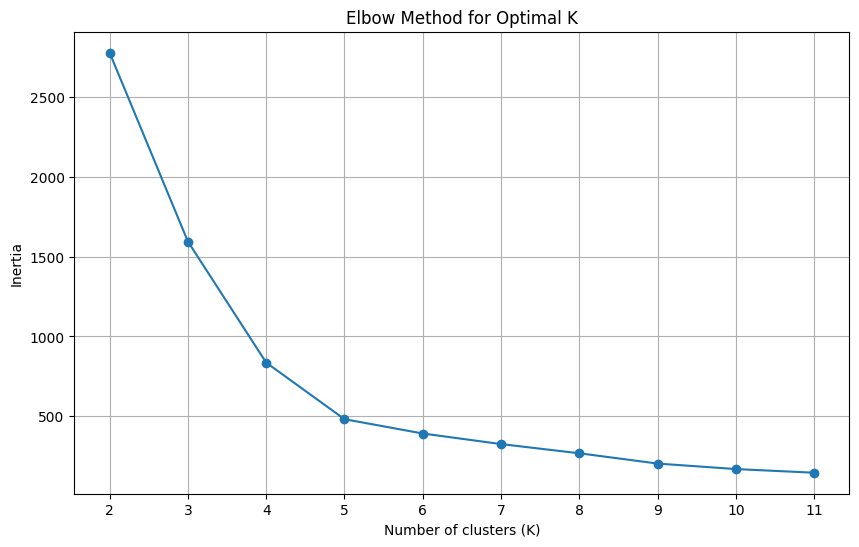

./elbow_test_export/SS-B_csv_10_83686_elbow_test.png
Optimal k value: 5
    A   B  C         A-         B-  cluster
0   7   1  5  12.394731   6.531198        1
1   0  36  2  10.769838   8.765405        0
2   5  15  4  13.309192  10.625240        2
3   6   8  5  14.312883   9.170858        1
4   4   8  5  12.418643   9.433253        1
5   7   7  3  14.221587  10.173124        1
6   5  16  5  13.825456  10.223866        2
7   7   4  5  14.319954   7.603452        1
8   5   8  3  12.848427  10.226753        1
9   5   8  5  13.269711   9.511802        1
10  3  35  3  11.822969  11.460401        0
11  3   7  3  10.887982   8.553987        1
12  3  14  4  11.354800   9.057947        2
13  7  25  4  15.570627  11.449612        4
14  6  64  5  15.762460  12.820270        3
15  8   2  5  14.217200   7.276899        1
16  1  14  3   9.832890   7.256974        2
17  7  15  3  14.859874  10.751941        2
18  8  25  4  16.204724  11.732874        4
19  4  19  4  12.639341  10.190997        2
20  

<Figure size 640x480 with 0 Axes>

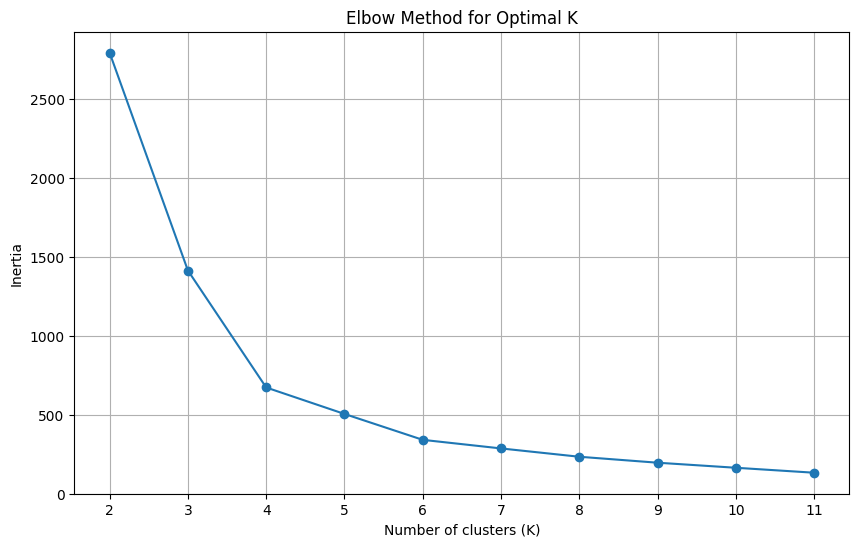

./elbow_test_export/SS-B_csv_10_84967_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   3   7  4  10.751544   8.522530        0
1   2  19  3  10.643856   8.675316        2
2   5  36  2  13.741256  13.301757        1
3   4  15  4  12.439311   9.998034        2
4   4   8  4  11.808160   9.696737        0
5   5   2  5  11.403012   7.665282        0
6   4  14  3  12.266201   9.686132        2
7   8  22  3  16.139791  11.910892        2
8   3  22  4  11.912141  10.024690        2
9   2  25  4  11.238405   9.685227        2
10  2  15  4  10.763212   8.438053        2
11  1  36  2  10.370687   9.771067        1
12  1   8  5   9.896332   6.766133        0
13  6  15  3  14.195218  10.972042        2
14  1   7  4   9.477758   6.860690        0
15  0  36  1  10.659104   8.834195        1
16  3  16  5  11.957828   9.621040        2
17  5  35  4  13.886459  12.999354        1
18  2  36  2  11.226412  10.673003        1
19  5   7  4  12.516192  10.188707        0
20  

<Figure size 640x480 with 0 Axes>

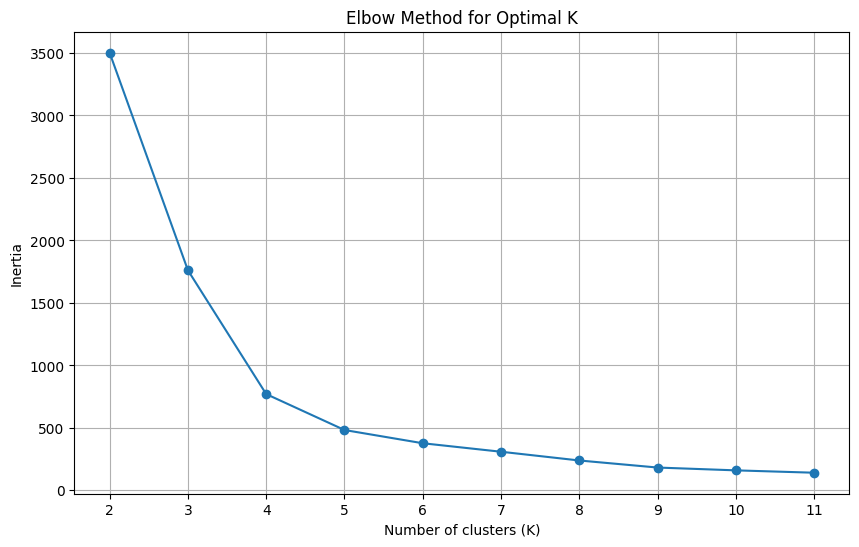

./elbow_test_export/SS-B_csv_10_86331_elbow_test.png
Optimal k value: 4
    A   B  C         A-         B-  cluster
0   8   7  3  15.103288  10.529897        0
1   1  15  3   9.909893   7.430870        3
2   0   1  5   7.098032   2.858161        0
3   4   4  5  11.418380   8.441542        0
4   7  35  4  15.567184  13.495378        1
5   6  15  4  14.178509  11.034255        3
6   2   7  4  10.071462   7.804960        0
7   7   7  3  14.221587  10.173124        0
8   1  64  5  11.253257   9.618119        2
9   2   8  3  10.238405   7.899904        0
10  1  14  4   9.818582   7.226334        3
11  4   1  5   9.592457   6.564960        0
12  6   8  5  14.312883   9.170858        0
13  4   8  3  11.978353   9.557561        0
14  4  15  3  12.350663   9.859624        3
15  3  22  4  11.912141  10.024690        3
16  5  25  4  13.849601  11.605192        3
17  7  14  4  14.952059  10.593154        3
18  3  36  2  12.047806  11.653700        1
19  5   1  5  10.451211   6.804776        0
20  

<Figure size 640x480 with 0 Axes>

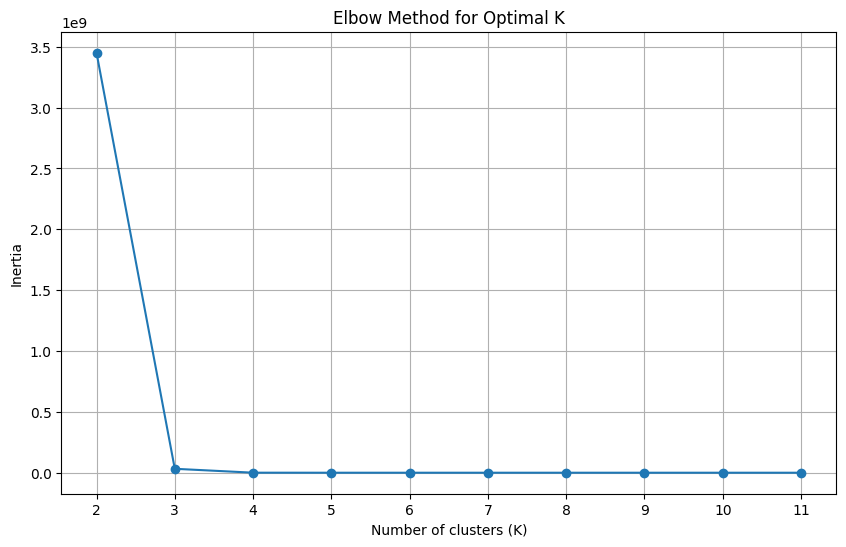

./elbow_test_export/SS-C_csv_100_11514_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0         60000         4        12       253.50  26514.00        0
1            10         5         5      6923.10    390.77        1
2             4         4        14      9953.60    271.77        1
3           100         6        18      6764.20    393.93        1
4          1000         6        14      2852.40    886.55        1
..          ...       ...       ...          ...       ...      ...
495           2         4         7     10244.00    276.14        1
496       10000         2         8       333.06   8486.30        2
497           4         6        13     10608.00    267.03        1
498           6         4        18      9766.90    283.75        1
499         100         1        18      5255.20    522.02        1

[500 rows x 6 columns]
[0.8578635896686816, 0.212914251957967, 0.6993592707291872, nan]
[0.8578635896686816, 0

<Figure size 640x480 with 0 Axes>

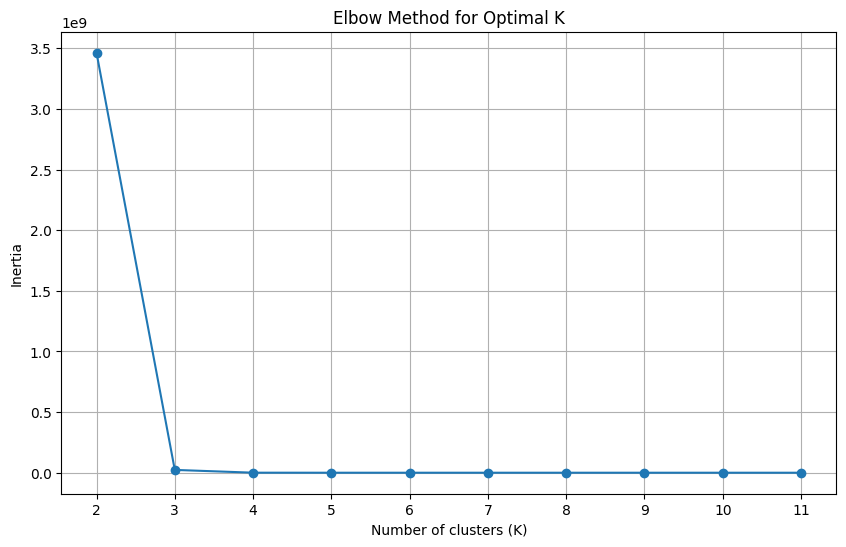

./elbow_test_export/SS-C_csv_100_19953_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4         9       8255.1    335.19        1
1             5         2         7       9123.6    309.76        1
2             8         4         3       7537.2    371.52        1
3             8         1        10       5166.9    556.34        1
4             2         1        17       7444.2    387.80        1
..          ...       ...       ...          ...       ...      ...
495          10         3         6       7213.7    380.23        1
496           6         1         6       7543.1    372.84        1
497        1000         1         9       2568.9   1089.30        1
498           5         2        17       9882.4    285.71        1
499           1         4        11       9834.2    275.67        1

[500 rows x 6 columns]
[0.8748114994893336, 0.23212024919521643, 0.7030338206336523, nan]
[0.8748114994893336,

<Figure size 640x480 with 0 Axes>

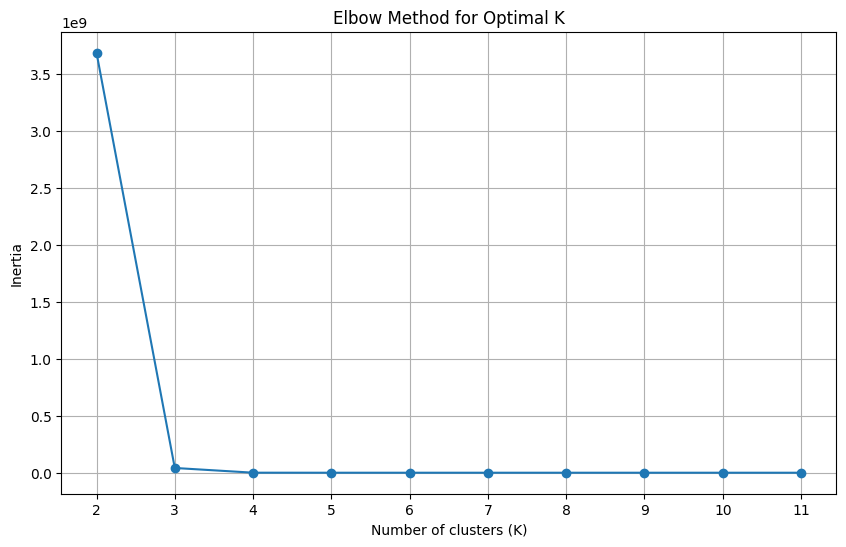

./elbow_test_export/SS-C_csv_100_3545_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         2        16      9101.40    309.22        0
1             7         1        16      6424.40    476.81        0
2         10000         6         8       356.75   7131.70        2
3             9         1         2      5087.40    562.96        0
4             4         4         4      9236.40    292.15        0
..          ...       ...       ...          ...       ...      ...
495           3         6        14     10301.00    283.18        0
496           6         1        10      8058.60    359.01        0
497           2         4         5     10334.00    276.15        0
498           7         4         9      8255.10    335.19        0
499           3         2         8      9001.60    321.19        0

[500 rows x 6 columns]
[0.24626962255873194, 0.8940677537694407, 0.7022620326655703, nan]
[0.24626962255873194,

<Figure size 640x480 with 0 Axes>

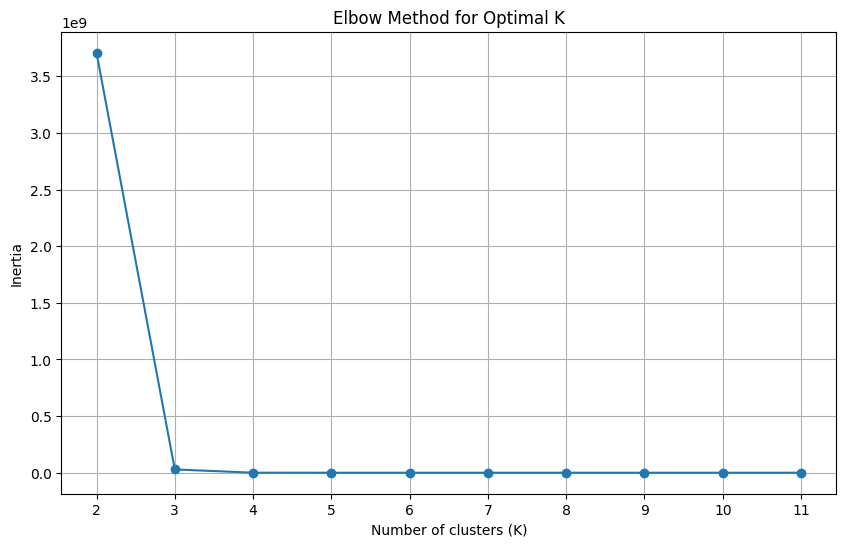

./elbow_test_export/SS-C_csv_100_39658_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             3         2         6       9099.8    321.72        0
1             4         5        16      10253.0    259.36        0
2             9         1        15       5112.0    544.70        0
3             5         1        16       7109.5    384.78        0
4          1000         2        11       2809.2    989.08        0
..          ...       ...       ...          ...       ...      ...
495        1000         4        16       2753.5    929.35        0
496           4         2         1       8814.8    340.19        0
497           9         2         5       6555.6    438.17        0
498           7         4         6       8539.2    331.84        0
499       10000         2        17        339.0   8348.50        2

[500 rows x 6 columns]
[0.2114843949070515, 0.8582682722733295, 0.7005517875637566, nan]
[0.2114843949070515, 

<Figure size 640x480 with 0 Axes>

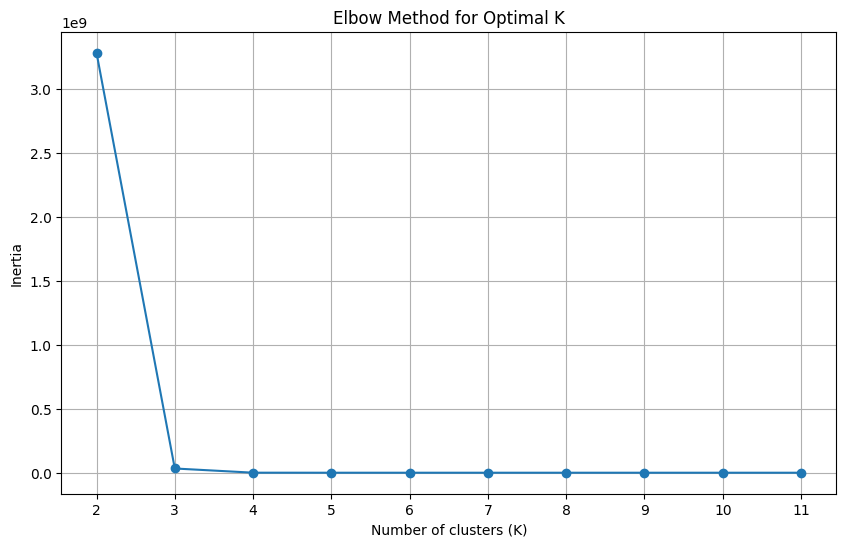

./elbow_test_export/SS-C_csv_100_40749_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             9         4         3      6954.60    381.54        0
1             8         2         4      6041.80    454.06        0
2         60000         3         9       169.83  37314.00        1
3             5         4         6     10132.00    278.23        0
4          1000         1         4      2542.10   1076.50        0
..          ...       ...       ...          ...       ...      ...
495           2         5         2     10736.00    265.88        0
496           1         3         6      9793.30    294.35        0
497           5         3         1     10617.00    275.71        0
498           5         2        11      9060.40    313.20        0
499       60000         2         7       161.00  39383.00        1

[500 rows x 6 columns]
[0.20420989547703658, 0.8728638244973606, 0.7015329467143082, nan]
[0.20420989547703658

<Figure size 640x480 with 0 Axes>

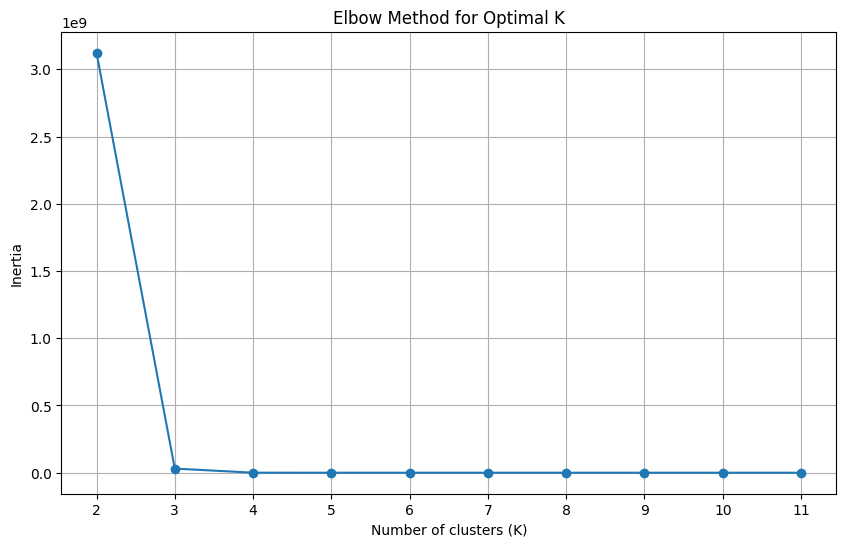

./elbow_test_export/SS-C_csv_100_44845_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             6         4        18       9766.9    283.75        0
1             6         2        15       9447.6    294.77        0
2             4         4        11       9605.0    269.76        0
3           100         2        12       6531.1    414.47        0
4             1         4         3       9322.5    305.17        0
..          ...       ...       ...          ...       ...      ...
495           4         4        14       9953.6    271.77        0
496           3         3         7       9921.8    276.13        0
497       60000         4        16        168.4  36534.00        1
498           1         6        15      10818.0    253.93        0
499          10         1         6       5077.9    522.96        0

[500 rows x 6 columns]
[0.20731904346767419, 0.8862092294295308, 0.7010577817413383, nan]
[0.20731904346767419

<Figure size 640x480 with 0 Axes>

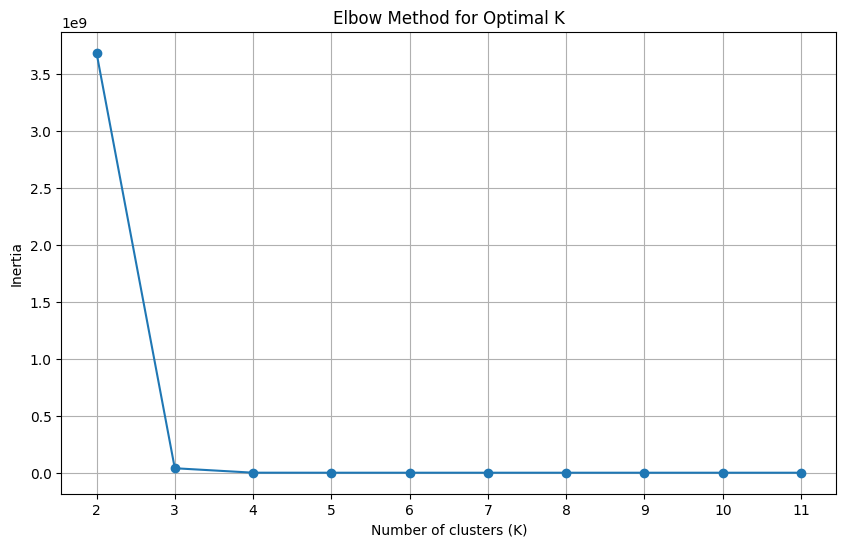

./elbow_test_export/SS-C_csv_100_51176_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4        15      8892.30    326.32        0
1            10         1         5      5130.20    540.02        0
2             2         5        13     10370.00    292.02        0
3            10         2        10      6468.60    425.57        0
4         10000         5        18       344.44   6687.10        2
..          ...       ...       ...          ...       ...      ...
495           1         3         7      9484.20    281.69        0
496           9         6         4      7657.10    366.67        0
497       60000         1         5       158.00  50406.00        1
498           4         5        13     10187.00    271.87        0
499           3         6         5      9021.40    282.39        0

[500 rows x 6 columns]
[0.21885555043263638, 0.8778184944724935, 0.7003121978167958, nan]
[0.21885555043263638

<Figure size 640x480 with 0 Axes>

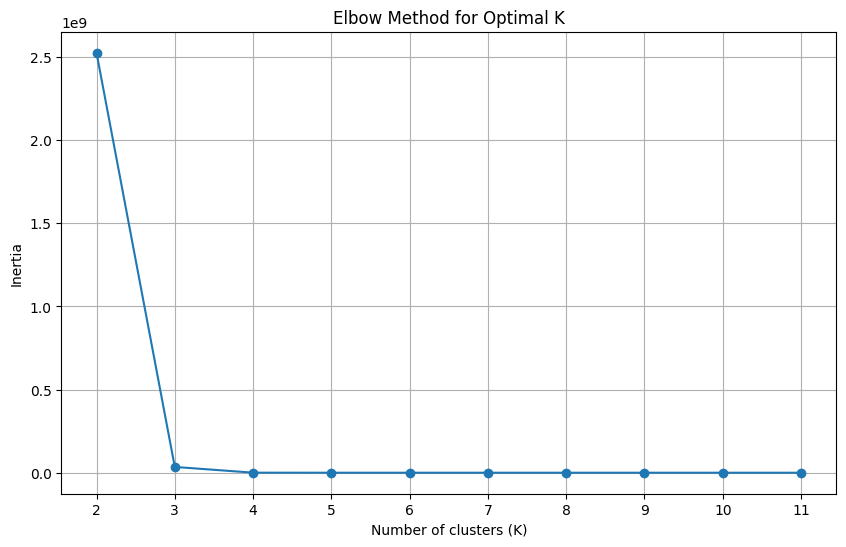

./elbow_test_export/SS-C_csv_100_58612_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             4         4         2       9827.6    286.89        0
1          1000         4         1       2901.2    928.29        0
2             1         5        11      10250.0    261.07        0
3             4         4         8       9790.1    278.59        0
4             2         1         7       6921.5    391.23        0
..          ...       ...       ...          ...       ...      ...
495           7         5        17       7779.9    360.89        0
496           2         6         4      10063.0    273.64        0
497           3         3        18      10769.0    269.77        0
498           9         4         2       7870.3    346.67        0
499           5         6        12       9367.9    270.21        0

[500 rows x 6 columns]
[0.2076801677093927, 0.8750657397314179, 0.7018211942912443, nan]
[0.2076801677093927, 

<Figure size 640x480 with 0 Axes>

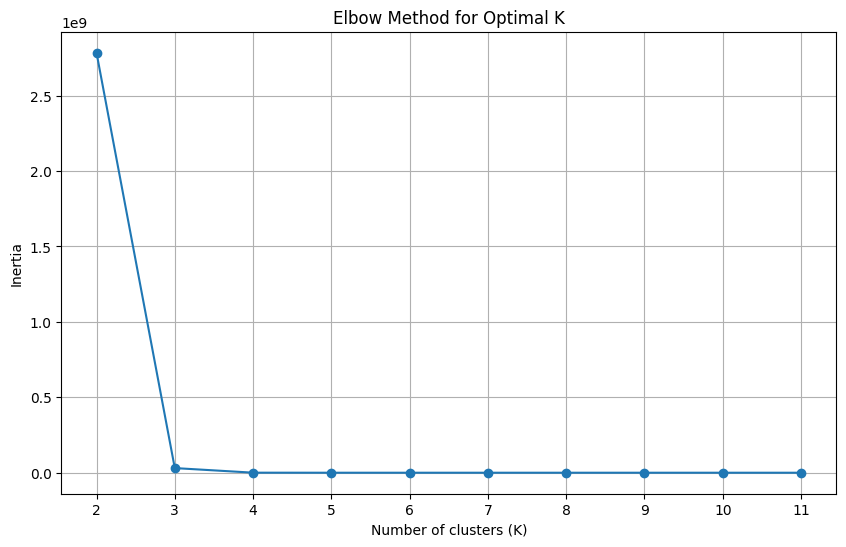

./elbow_test_export/SS-C_csv_100_61367_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4        15       8892.3    326.32        0
1             9         1        17       4962.8    538.30        0
2             6         5        12       9667.7    277.47        0
3             3         5         3       9750.4    269.54        0
4         60000         2        11        188.0  48245.00        1
..          ...       ...       ...          ...       ...      ...
495         100         4        13       6920.5    370.65        0
496        1000         5        14       2769.7    923.75        0
497           5         1        18       7088.4    385.79        0
498          10         1         5       5130.2    540.02        0
499          10         5        15       7541.1    374.31        0

[500 rows x 6 columns]
[0.21231967946910438, 0.8859418489214002, 0.7033129262437897, nan]
[0.21231967946910438

<Figure size 640x480 with 0 Axes>

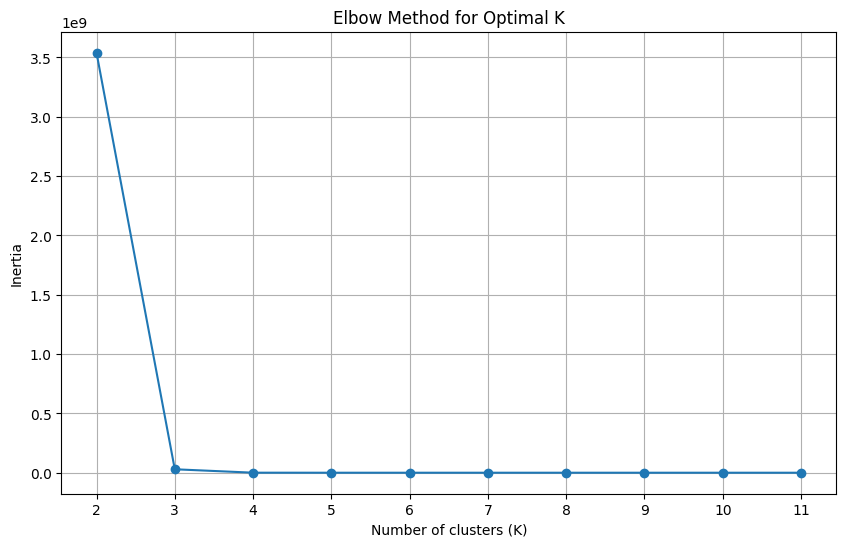

./elbow_test_export/SS-C_csv_100_65388_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         6         3      9383.10    288.03        0
1          1000         3         4      2650.60    982.38        0
2             5         5        15     10726.00    272.57        0
3         10000         6        14       383.38   6956.10        2
4          1000         5         6      2790.60    967.65        0
..          ...       ...       ...          ...       ...      ...
495          10         3        16      7237.90    360.08        0
496           2         3         9      9482.30    278.57        0
497           6         5        12      9667.70    277.47        0
498           1         4        18      9845.30    268.05        0
499           3         3        18     10769.00    269.77        0

[500 rows x 6 columns]
[0.23706662588826244, 0.8953559921170539, 0.7016078507995401, nan]
[0.23706662588826244

<Figure size 640x480 with 0 Axes>

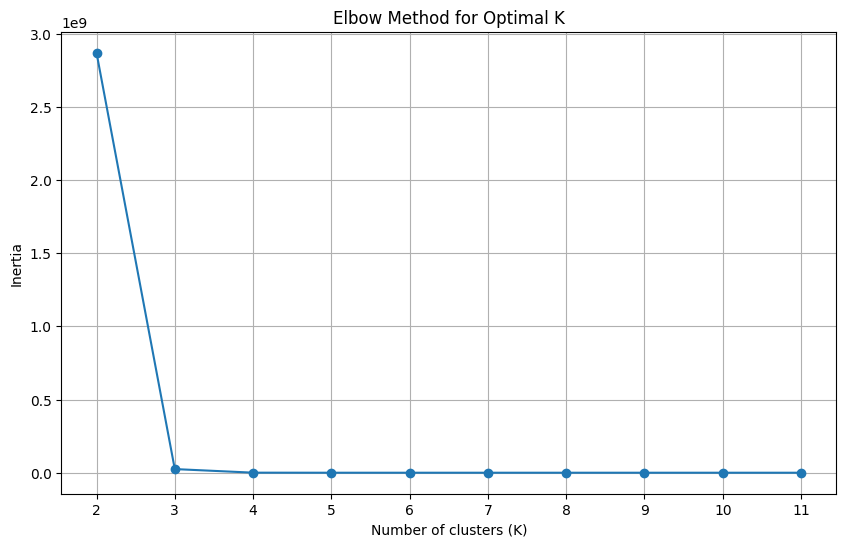

./elbow_test_export/SS-C_csv_100_65444_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             8         4         8      7723.80    403.10        0
1         60000         2         1       185.80  46488.00        1
2         10000         3        12       297.06   8108.60        2
3         60000         2         4       170.67  34681.00        1
4            10         1         1      4431.40    585.12        0
..          ...       ...       ...          ...       ...      ...
495           2         3        18     10304.00    273.89        0
496           7         6        14      7123.80    374.54        0
497       60000         3         7       321.67  49818.00        1
498           3         4        18     10870.00    262.58        0
499           3         1         6      8105.70    360.00        0

[500 rows x 6 columns]
[0.20588663088098066, 0.8890012512280594, 0.7010937564853006, nan]
[0.20588663088098066

<Figure size 640x480 with 0 Axes>

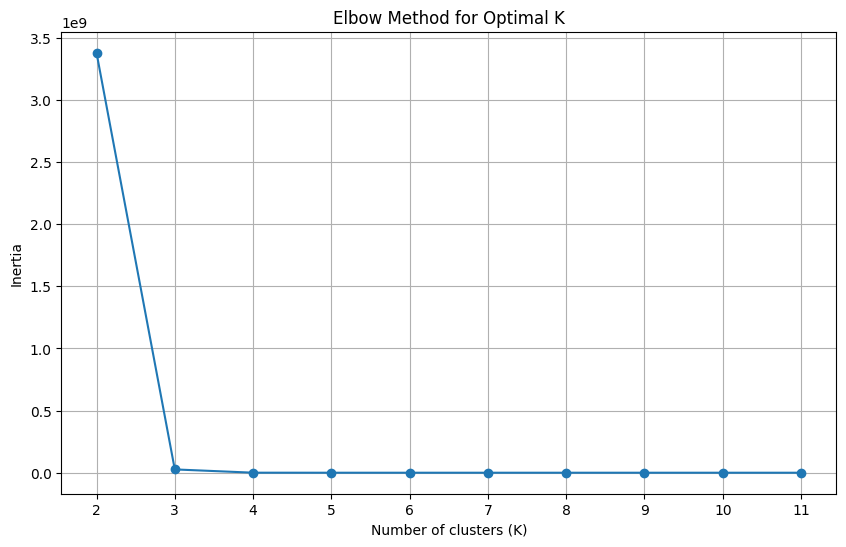

./elbow_test_export/SS-C_csv_100_66946_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0         60000         1        17        203.2  36592.00        1
1             2         4         9      10229.0    275.80        2
2             1         5        14       9378.8    267.26        2
3             2         5         9       9906.6    277.40        2
4             7         2        15       7655.1    346.78        2
..          ...       ...       ...          ...       ...      ...
495           3         3         8       9659.7    298.43        2
496           7         2        14       7685.8    384.37        2
497           1         1         9       7353.9    400.27        2
498          10         6        11       7991.8    365.40        2
499           6         1         2       7176.1    389.89        2

[500 rows x 6 columns]
[0.7009765568728136, 0.861219052950233, 0.20691164555482072, nan]
[0.7009765568728136, 

<Figure size 640x480 with 0 Axes>

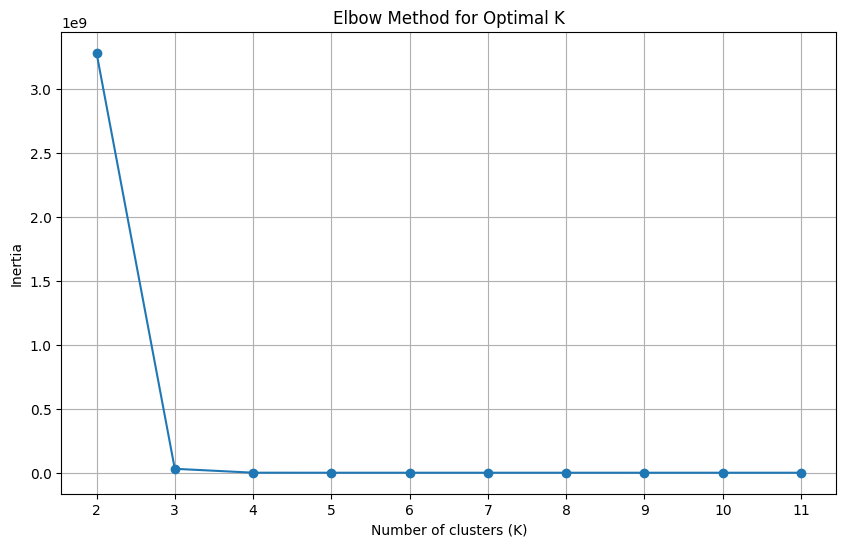

./elbow_test_export/SS-C_csv_100_69024_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         3         6       8394.2    336.58        0
1             6         6        10      10840.0    264.19        0
2             4         1         9       6948.2    356.86        0
3             3         1         4       7133.0    398.76        0
4             6         2        13       8194.6    305.47        0
..          ...       ...       ...          ...       ...      ...
495         100         5         6       7359.9    376.80        0
496           9         6        15       7122.9    391.86        0
497           1         2        13       8708.4    300.43        0
498           1         4        11       9834.2    275.67        0
499          10         5        10       7435.9    380.02        0

[500 rows x 6 columns]
[0.2345097900157584, 0.8714345288277233, 0.70151910726727, nan]
[0.2345097900157584, 0.

<Figure size 640x480 with 0 Axes>

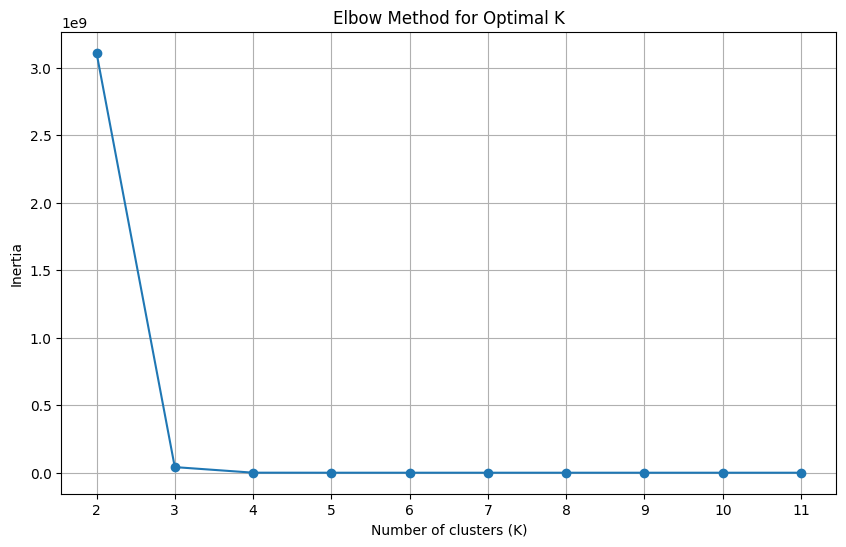

./elbow_test_export/SS-C_csv_100_70006_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             8         2         2      6703.90    417.29        0
1         60000         5         1       187.50  45329.00        1
2             3         4         3      9327.90    289.04        0
3             5         3        10      9514.00    265.12        0
4             3         1        12      7331.90    374.83        0
..          ...       ...       ...          ...       ...      ...
495       60000         3         7       321.67  49818.00        1
496           2         1         1      6407.60    462.69        0
497           3         3        12      9665.70    260.23        0
498           7         6         4      6866.20    400.62        0
499           7         5         2      7644.90    360.56        0

[500 rows x 6 columns]
[0.21644099979986153, 0.8912363814434475, 0.7024914788906438, nan]
[0.21644099979986153

<Figure size 640x480 with 0 Axes>

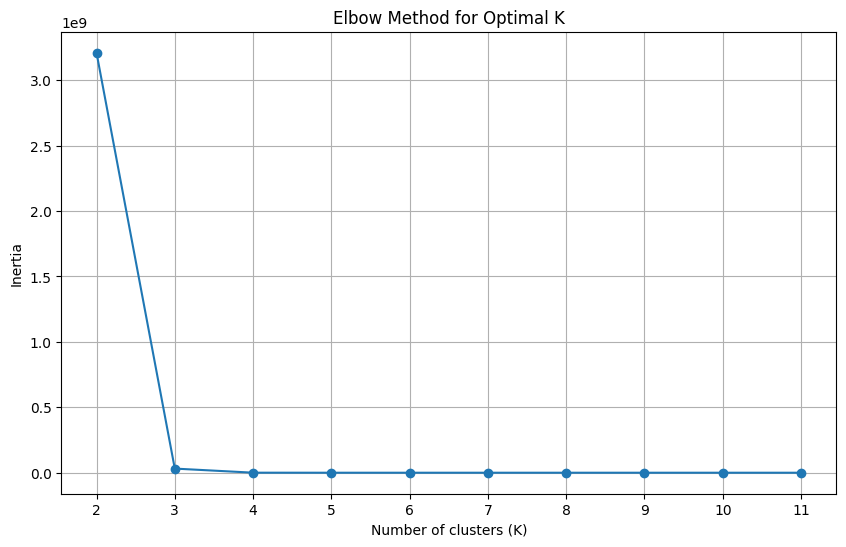

./elbow_test_export/SS-C_csv_100_70292_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0         60000         1         4        160.4  35614.00        0
1             1         3         9       9381.8    265.39        1
2             5         5        11      10332.0    272.71        1
3             2         3         5       9908.6    290.47        1
4             1         3         4       9102.1    290.05        1
..          ...       ...       ...          ...       ...      ...
495        1000         6         9       2668.2    949.53        1
496       60000         2         9        160.0  57645.00        0
497           7         5        11       7278.1    375.23        1
498           9         6        16       6947.5    361.55        1
499           4         2         8       9062.3    316.70        1

[500 rows x 6 columns]
[0.8791652395721196, 0.20581718930225962, 0.7005001771075314, nan]
[0.8791652395721196,

<Figure size 640x480 with 0 Axes>

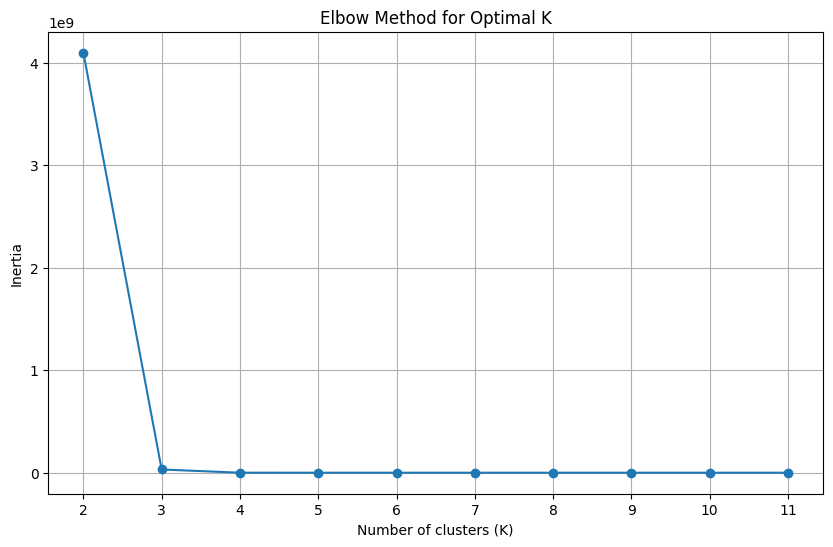

./elbow_test_export/SS-C_csv_100_77340_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             9         6         8      7152.30    357.59        0
1            10         4        11      7397.40    364.49        0
2         10000         3         6       313.25   8632.10        2
3            10         2         3      6355.70    466.67        0
4         10000         1         1       330.25   8695.80        2
..          ...       ...       ...          ...       ...      ...
495       10000         3        14       326.25   8304.20        2
496           5         6        16     11048.00    260.30        0
497           6         1        13      7614.80    371.37        0
498           7         1         1      5802.60    491.10        0
499           2         4         4      9282.20    290.41        0

[500 rows x 6 columns]
[0.24550032641777597, 0.8883867190059983, 0.7036871782284856, nan]
[0.24550032641777597

<Figure size 640x480 with 0 Axes>

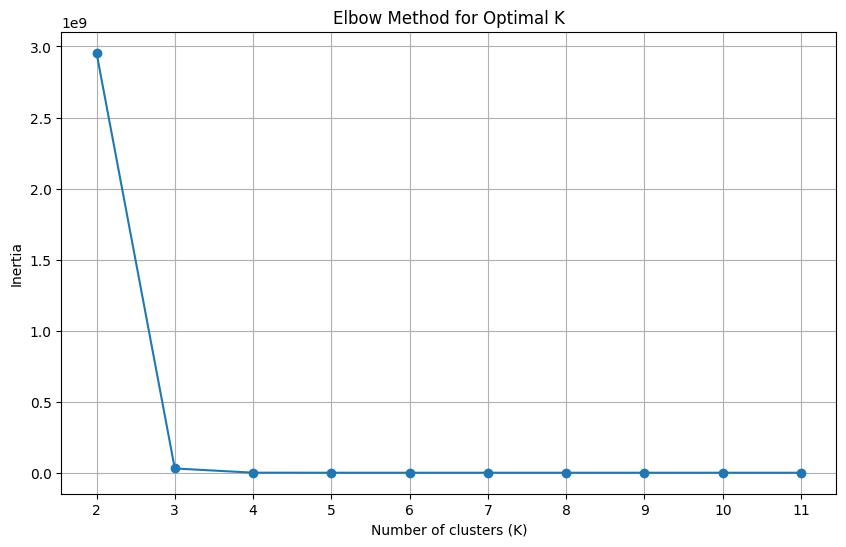

./elbow_test_export/SS-C_csv_100_77845_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             5         5         3     10165.00    289.44        2
1         10000         3        16       296.35   8400.70        0
2            10         5         7      6862.30    393.83        2
3             9         6        13      7627.60    387.58        2
4             5         1         1      6272.10    441.20        2
..          ...       ...       ...          ...       ...      ...
495           7         2         3      6712.40    387.20        2
496           3         1         1      6042.60    491.43        2
497        1000         6         1      2553.10    965.56        2
498           5         5         6      9465.10    269.73        2
499       60000         5        12       175.50  35839.00        1

[500 rows x 6 columns]
[0.7034417227810678, 0.891993461347246, 0.23547477417224325, nan]
[0.7034417227810678, 

<Figure size 640x480 with 0 Axes>

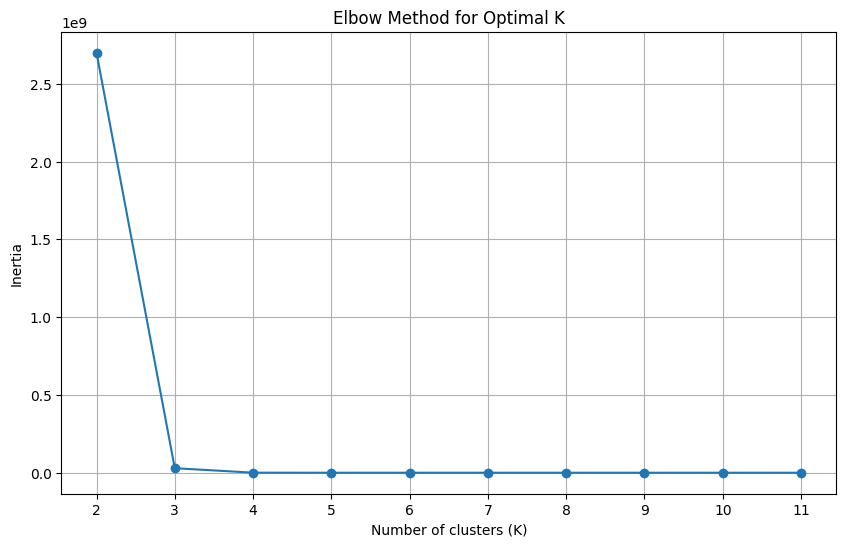

./elbow_test_export/SS-C_csv_100_83686_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             1         1        14      6851.10    398.64        0
1             8         5        15      7139.40    388.28        0
2         60000         5         4       183.33  38042.00        1
3           100         4         4      7447.40    388.17        0
4         60000         5         1       187.50  45329.00        1
..          ...       ...       ...          ...       ...      ...
495           1         1        10      7255.90    361.51        0
496       60000         3         5       177.80  46496.00        1
497          10         3         5      7139.20    391.28        0
498       60000         1        13       169.83  44884.00        1
499           7         4        11      8511.60    322.46        0

[500 rows x 6 columns]
[0.23884837622638658, 0.9014716781475131, 0.7041045770231856, nan]
[0.23884837622638658

<Figure size 640x480 with 0 Axes>

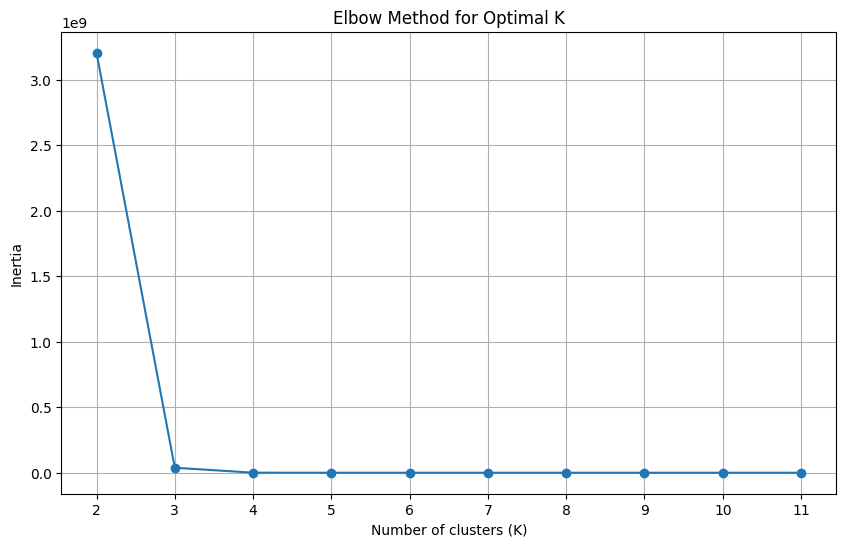

./elbow_test_export/SS-C_csv_100_84967_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             6         6         6     10444.00    274.18        0
1             5         1         8      7887.10    365.52        0
2             1         5        17     10090.00    268.18        0
3             7         4        13      8379.30    337.84        0
4             7         6        10      7393.80    370.10        0
..          ...       ...       ...          ...       ...      ...
495       60000         6         8       160.33  34180.00        1
496           7         3        12      8668.90    329.98        0
497           4         5        17     10778.00    275.23        0
498        1000         5        18      2803.40    910.83        0
499           5         4         5     10715.00    281.00        0

[500 rows x 6 columns]
[0.24502974050915288, 0.8650824675090479, 0.701613454076742, nan]
[0.24502974050915288,

<Figure size 640x480 with 0 Axes>

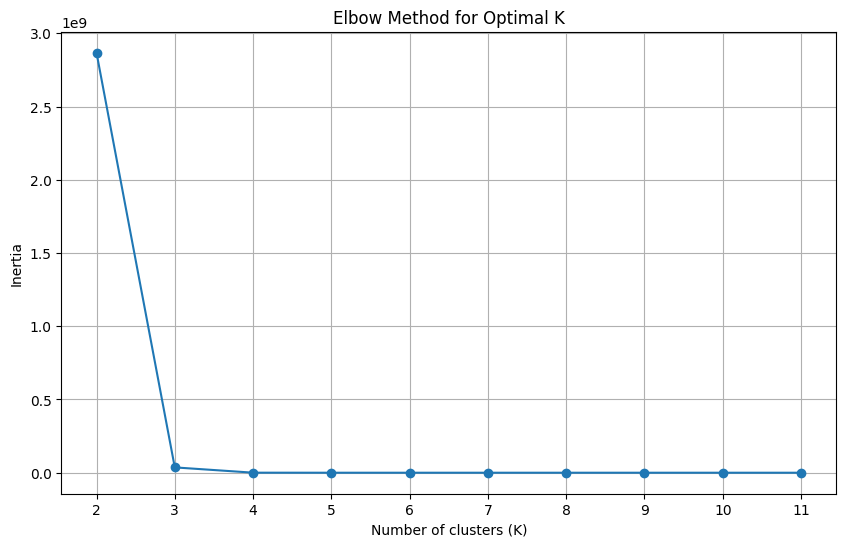

./elbow_test_export/SS-C_csv_100_86331_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0          1000         2         3      2705.50   1055.20        0
1             3         6        15     10522.00    255.39        0
2          1000         3         2      2919.60    940.20        0
3         60000         4        10       161.17  33725.00        1
4            10         4        12      7748.20    355.59        0
..          ...       ...       ...          ...       ...      ...
495           2         1         9      7277.60    394.18        0
496       60000         4        16       168.40  36534.00        1
497        1000         1        13      2464.90   1043.10        0
498           3         1        16      7556.90    378.26        0
499           1         3        10      9962.30    287.62        0

[500 rows x 6 columns]
[0.21282193652957357, 0.8631655988453819, 0.700843644676687, nan]
[0.21282193652957357,

<Figure size 640x480 with 0 Axes>

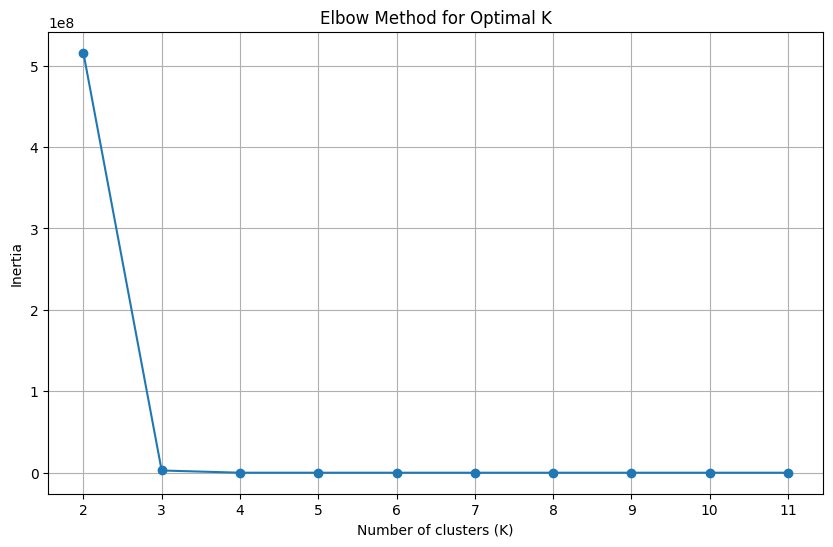

./elbow_test_export/SS-C_csv_10_11514_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0        60000         4        12       253.50  26514.00        1
1           10         5         5      6923.10    390.77        0
2            4         4        14      9953.60    271.77        0
3          100         6        18      6764.20    393.93        0
4         1000         6        14      2852.40    886.55        0
5        10000         4         1       311.06   7569.50        2
6        10000         3        13       330.44   8416.90        2
7            6         3         6      9923.70    274.52        0
8            6         5        11     10056.00    267.52        0
9        10000         6         1       334.44   7419.60        2
10        1000         1         7      2448.10   1055.20        0
11           4         4        16     10732.00    269.86        0
12           9         5         5      7863.10    358.84

<Figure size 640x480 with 0 Axes>

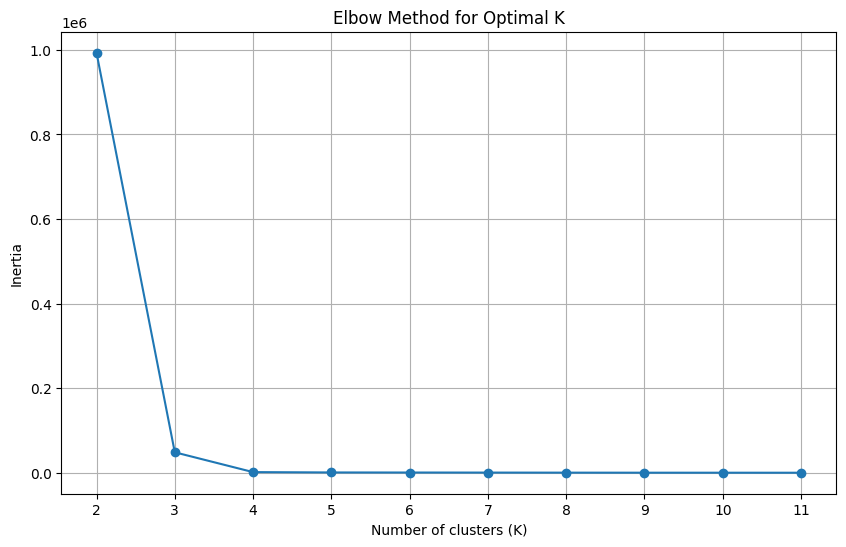

./elbow_test_export/SS-C_csv_10_19953_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            7         4         9      8255.10    335.19        0
1            5         2         7      9123.60    309.76        0
2            8         4         3      7537.20    371.52        0
3            8         1        10      5166.90    556.34        0
4            2         1        17      7444.20    387.80        0
5        10000         4         9       334.19   8482.60        1
6          100         3        15      7183.90    379.65        0
7            4         3        11     10477.00    270.74        0
8            1         5        18     10506.00    265.69        0
9            9         4         8      6861.10    368.50        0
10           3         1        16      7556.90    378.26        0
11           5         4        17     10386.00    262.97        0
12           3         6        16     10578.00    256.17

<Figure size 640x480 with 0 Axes>

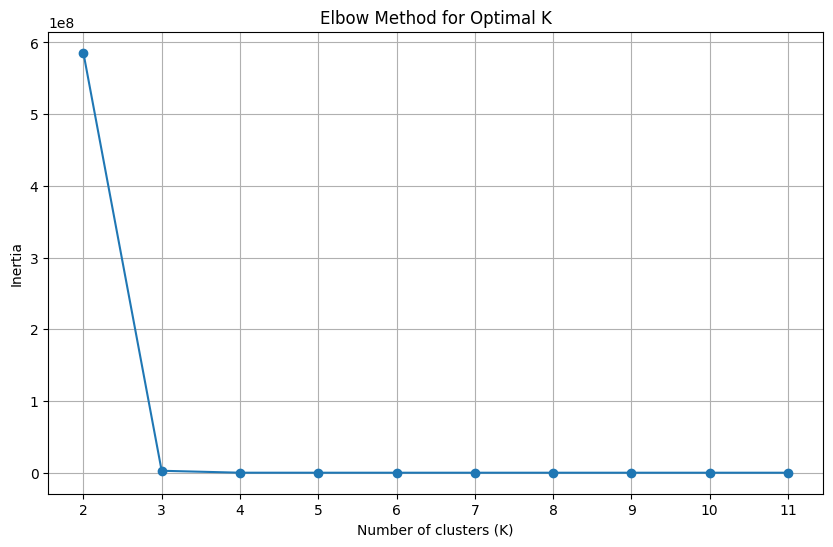

./elbow_test_export/SS-C_csv_10_3545_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            2         2        16      9101.40    309.22        0
1            7         1        16      6424.40    476.81        0
2        10000         6         8       356.75   7131.70        2
3            9         1         2      5087.40    562.96        0
4            4         4         4      9236.40    292.15        0
5            8         6        14      7534.00    361.53        0
6            4         3         9      9902.00    287.60        0
7            4         2         3      9095.60    309.95        0
8            1         2        15      8523.10    309.71        0
9          100         6         7      7077.50    370.97        0
10        1000         4        12      2834.90    957.35        0
11           3         5        14     10109.00    275.30        0
12       10000         5        16       361.44   7394.40 

<Figure size 640x480 with 0 Axes>

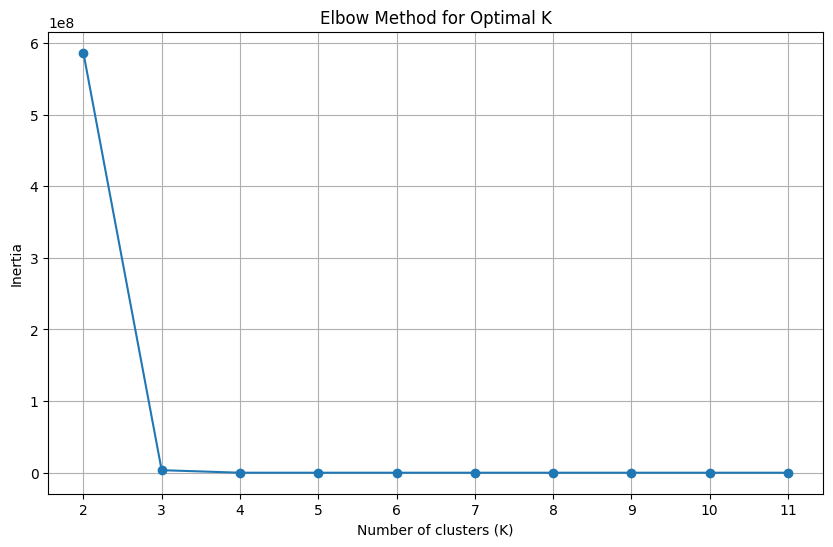

./elbow_test_export/SS-C_csv_10_39658_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            3         2         6      9099.80    321.72        0
1            4         5        16     10253.00    259.36        0
2            9         1        15      5112.00    544.70        0
3            5         1        16      7109.50    384.78        0
4         1000         2        11      2809.20    989.08        0
5           10         5         2      7219.10    372.50        0
6        10000         1        13       299.25   8308.30        2
7            6         6         9     10324.00    272.49        0
8            4         5         8     10373.00    261.83        0
9            3         6        16     10578.00    256.17        0
10          10         3        10      7370.80    359.27        0
11       60000         2        11       188.00  48245.00        1
12           1         1         3      6892.60    372.64

<Figure size 640x480 with 0 Axes>

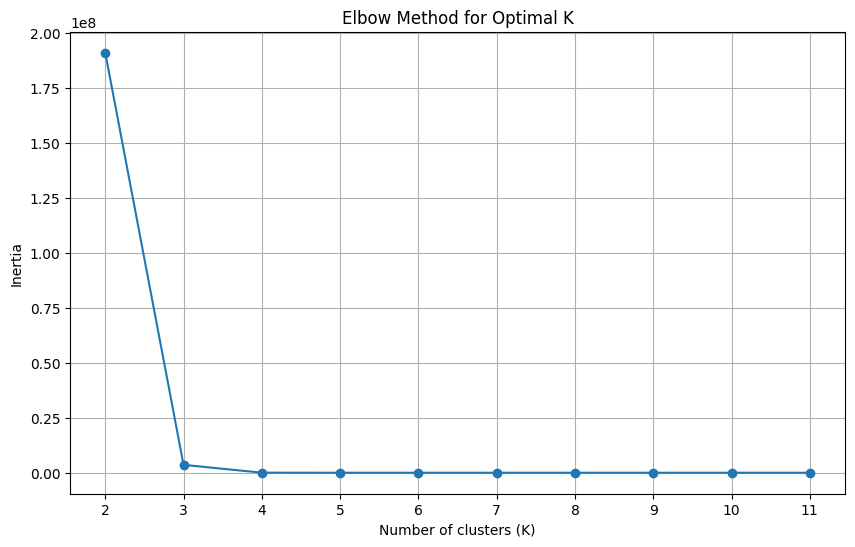

./elbow_test_export/SS-C_csv_10_40749_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            9         4         3      6954.60    381.54        0
1            8         2         4      6041.80    454.06        0
2        60000         3         9       169.83  37314.00        1
3            5         4         6     10132.00    278.23        0
4         1000         1         4      2542.10   1076.50        0
5            8         3         9      6226.20    407.85        0
6            6         1         8      7328.40    388.29        0
7            9         6         3      7033.10    400.69        0
8        60000         1        11       185.00  44398.00        1
9            9         5         2      7576.90    375.17        0
10       10000         5         8       413.38   6945.10        2
11         100         6         5      6880.90    381.31        0
12        1000         6        16      2824.70    923.69

<Figure size 640x480 with 0 Axes>

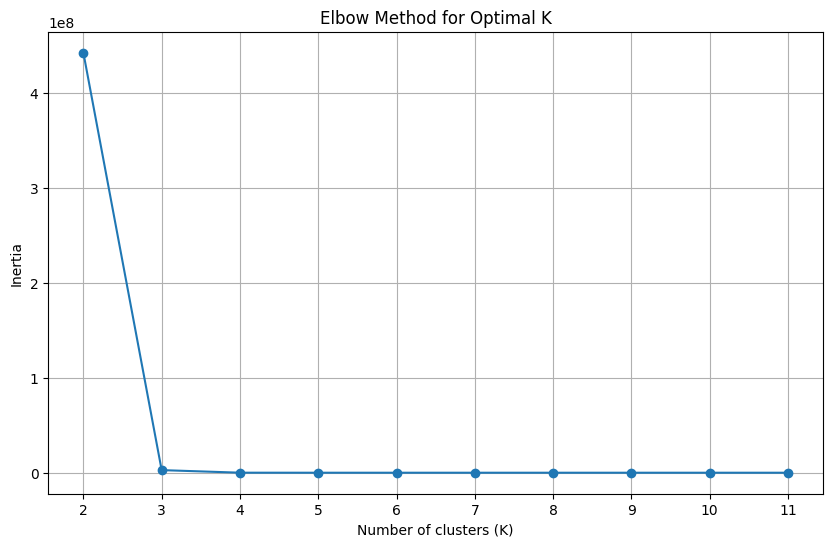

./elbow_test_export/SS-C_csv_10_44845_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            6         4        18      9766.90    283.75        0
1            6         2        15      9447.60    294.77        0
2            4         4        11      9605.00    269.76        0
3          100         2        12      6531.10    414.47        0
4            1         4         3      9322.50    305.17        0
5            9         4         6      6940.10    383.26        0
6            4         1        13      7432.40    369.06        0
7            8         6         1      7949.40    366.10        0
8            3         1        14      7541.80    381.84        0
9            1         5         9      9818.80    267.21        0
10           3         5         4      9812.00    285.93        0
11           3         5         7      9518.40    276.95        0
12         100         3         5      7052.30    397.11

<Figure size 640x480 with 0 Axes>

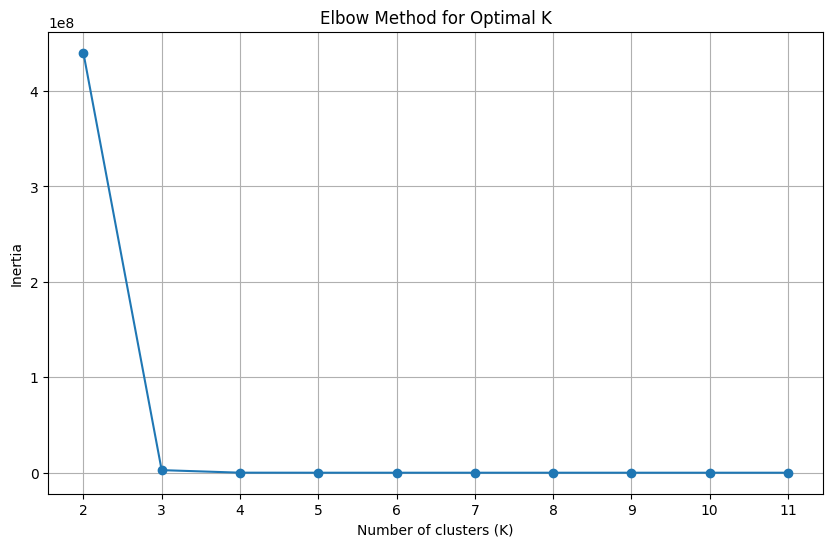

./elbow_test_export/SS-C_csv_10_51176_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            7         4        15      8892.30    326.32        0
1           10         1         5      5130.20    540.02        0
2            2         5        13     10370.00    292.02        0
3           10         2        10      6468.60    425.57        0
4        10000         5        18       344.44   6687.10        2
5            7         3        12      8668.90    329.98        0
6            6         1         2      7176.10    389.89        0
7            8         5         2      7263.90    397.46        0
8            6         6        16     10634.00    269.44        0
9           10         4         6      7327.60    375.20        0
10           1         4        16      9896.10    275.03        0
11       60000         1         8       179.50  39938.00        1
12         100         5        11      7366.40    387.21

<Figure size 640x480 with 0 Axes>

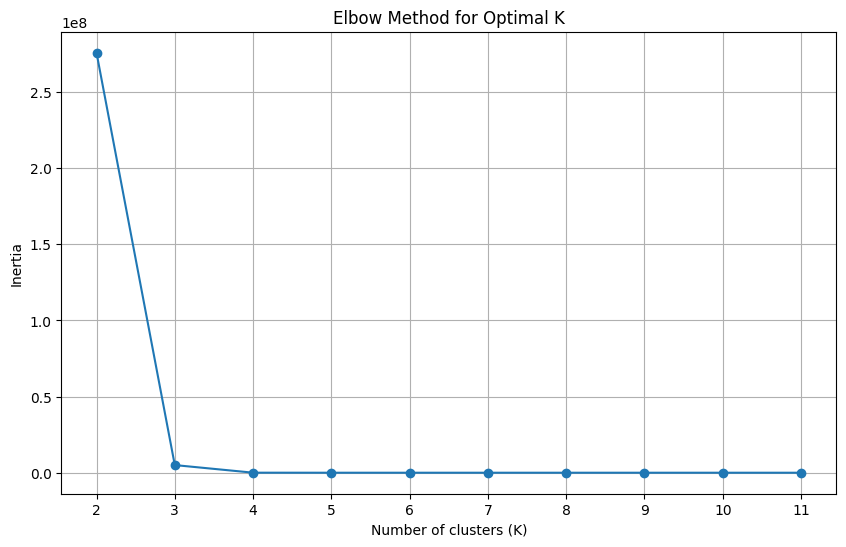

./elbow_test_export/SS-C_csv_10_58612_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            4         4         2      9827.60    286.89        0
1         1000         4         1      2901.20    928.29        0
2            1         5        11     10250.00    261.07        0
3            4         4         8      9790.10    278.59        0
4            2         1         7      6921.50    391.23        0
5            2         1        16      6403.80    403.02        0
6        10000         6         1       334.44   7419.60        2
7            1         4         4      9141.90    286.45        0
8            6         2        18      9296.20    295.66        0
9            1         4        12      9523.80    282.76        0
10       10000         2        13       322.88   8480.30        2
11         100         1        13      5564.70    537.51        0
12           9         6        18      7413.20    385.70

<Figure size 640x480 with 0 Axes>

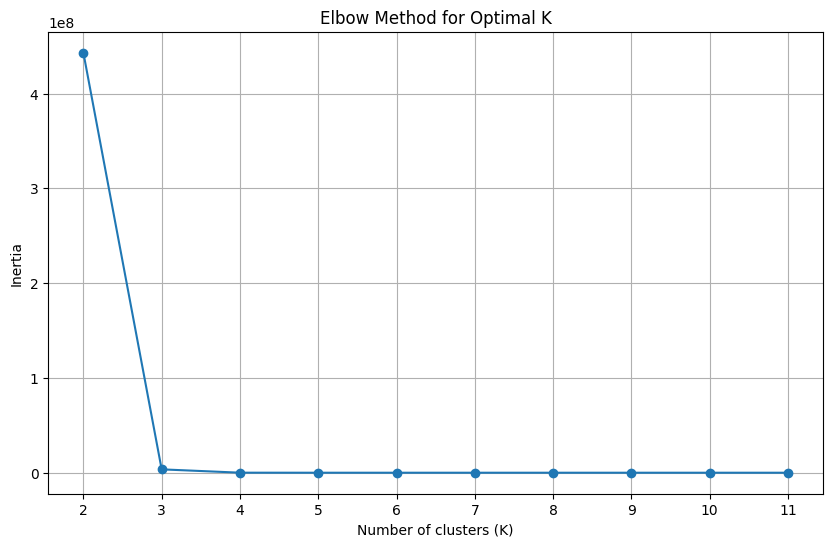

./elbow_test_export/SS-C_csv_10_61367_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            7         4        15      8892.30    326.32        0
1            9         1        17      4962.80    538.30        0
2            6         5        12      9667.70    277.47        0
3            3         5         3      9750.40    269.54        0
4        60000         2        11       188.00  48245.00        1
5            6         2         6      9039.70    320.59        0
6        10000         2        17       339.00   8348.50        2
7            3         6         4     10432.00    282.29        0
8            4         4        11      9605.00    269.76        0
9            2         3         7      9986.80    288.98        0
10         100         3        14      7184.80    379.48        0
11           7         1        16      6424.40    476.81        0
12           6         6        10     10840.00    264.19

<Figure size 640x480 with 0 Axes>

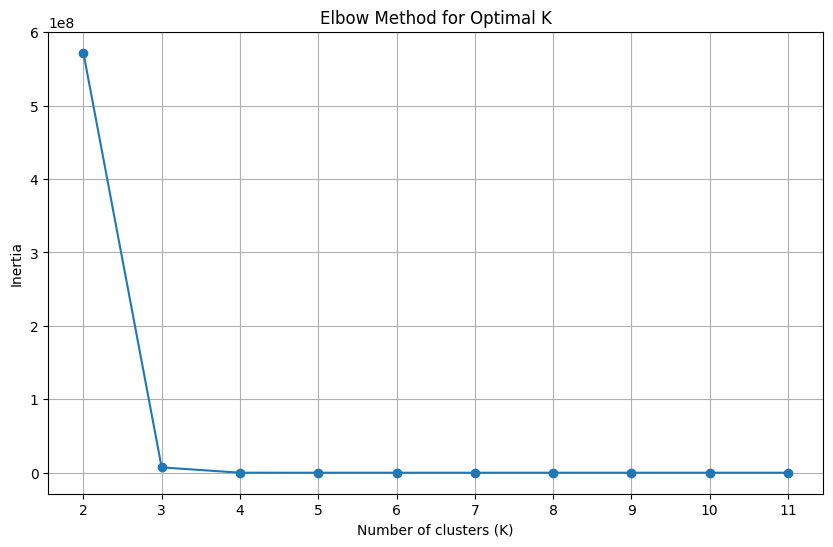

./elbow_test_export/SS-C_csv_10_65388_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            2         6         3      9383.10    288.03        0
1         1000         3         4      2650.60    982.38        0
2            5         5        15     10726.00    272.57        0
3        10000         6        14       383.38   6956.10        2
4         1000         5         6      2790.60    967.65        0
5         1000         4         7      2656.20    938.07        0
6            6         2        12      8913.20    299.89        0
7            5         1        15      7959.80    360.94        0
8        10000         5         3       370.94   7864.50        2
9            3         3        15     10087.00    263.82        0
10           4         4        16     10732.00    269.86        0
11           1         2         9      9224.80    310.57        0
12       60000         5        17       153.80  46575.00

<Figure size 640x480 with 0 Axes>

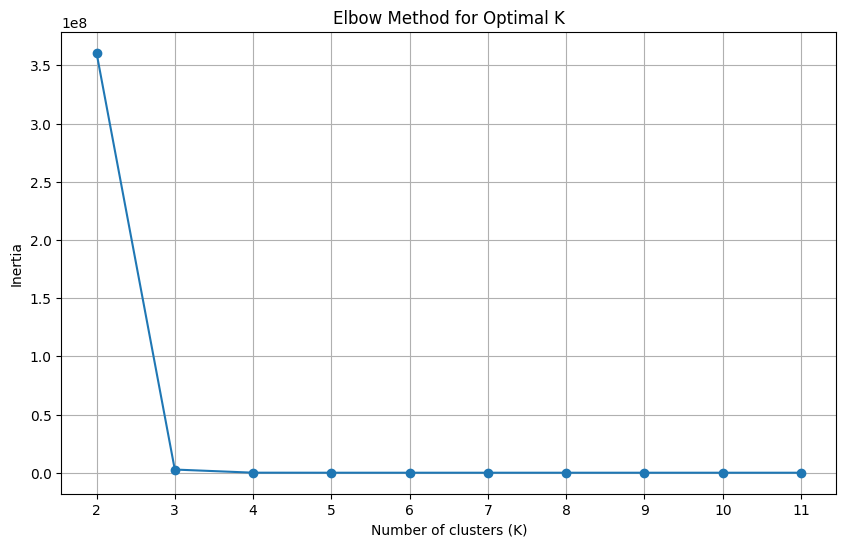

./elbow_test_export/SS-C_csv_10_65444_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            8         4         8      7723.80    403.10        0
1        60000         2         1       185.80  46488.00        1
2        10000         3        12       297.06   8108.60        2
3        60000         2         4       170.67  34681.00        1
4           10         1         1      4431.40    585.12        0
5            1         3        12      9966.80    272.83        0
6          100         2         7      6324.70    457.43        0
7            5         4         8     10293.00    278.58        0
8         1000         6         7      2733.70    965.28        0
9            2         2         5      9013.10    322.27        0
10           5         4         4      9697.30    287.73        0
11           8         4         7      6961.90    378.13        0
12         100         1         9      5112.90    511.14

<Figure size 640x480 with 0 Axes>

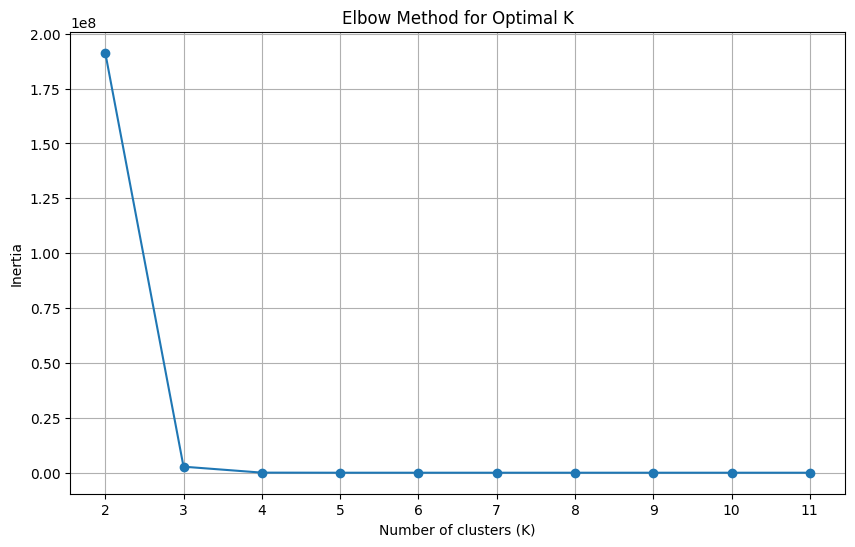

./elbow_test_export/SS-C_csv_10_66946_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0        60000         1        17       203.20  36592.00        1
1            2         4         9     10229.00    275.80        0
2            1         5        14      9378.80    267.26        0
3            2         5         9      9906.60    277.40        0
4            7         2        15      7655.10    346.78        0
5            4         4         3     10177.00    268.72        0
6           10         6         8      7568.90    360.40        0
7          100         4         6      6772.60    450.14        0
8            5         4        15     10732.00    261.57        0
9            8         5        18      7452.10    372.21        0
10           8         3         2      7493.80    364.90        0
11           3         4        13     10353.00    267.47        0
12          10         1         8      5448.40    501.27

<Figure size 640x480 with 0 Axes>

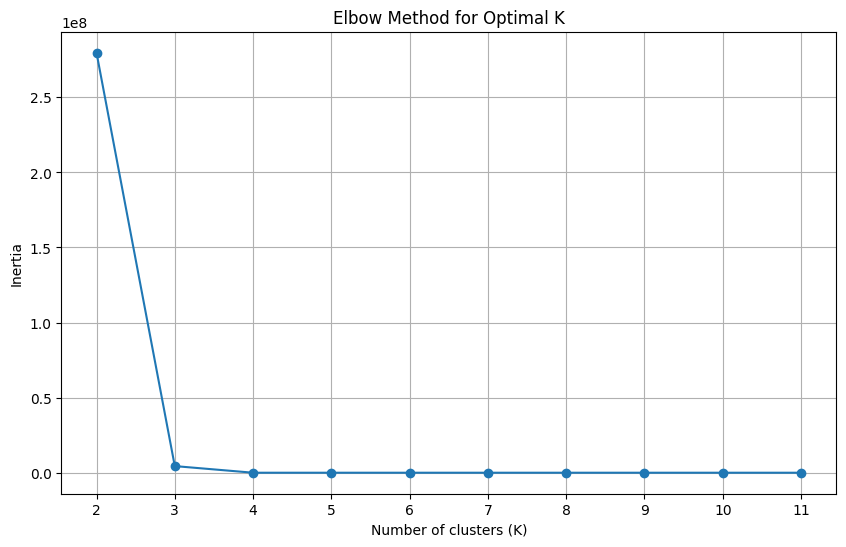

./elbow_test_export/SS-C_csv_10_69024_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            7         3         6      8394.20    336.58        0
1            6         6        10     10840.00    264.19        0
2            4         1         9      6948.20    356.86        0
3            3         1         4      7133.00    398.76        0
4            6         2        13      8194.60    305.47        0
5            2         5         7      9593.70    281.05        0
6            6         2        15      9447.60    294.77        0
7         1000         3         4      2650.60    982.38        0
8            5         1         3      7380.90    404.30        0
9            6         3         2     11026.00    269.94        0
10           8         4        10      7578.60    355.99        0
11           4         1         7      7383.90    404.74        0
12           7         4         3      8305.50    346.67

<Figure size 640x480 with 0 Axes>

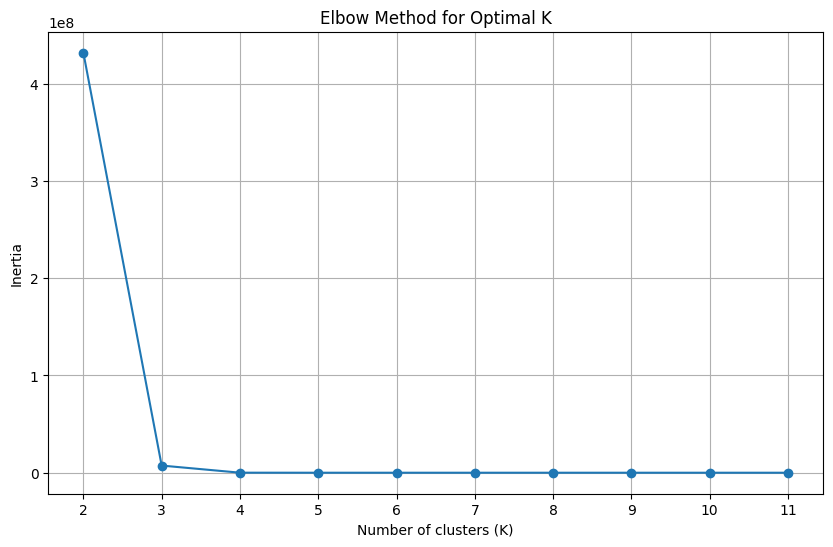

./elbow_test_export/SS-C_csv_10_70006_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            8         2         2      6703.90    417.29        0
1        60000         5         1       187.50  45329.00        1
2            3         4         3      9327.90    289.04        0
3            5         3        10      9514.00    265.12        0
4            3         1        12      7331.90    374.83        0
5        10000         5         6       316.76   8054.20        2
6        10000         4        11       317.88   8190.50        2
7            5         2        10      8966.00    299.66        0
8            7         3         7      8550.30    329.80        0
9           10         1        15      5641.10    550.29        0
10        1000         3        10      2863.10    956.06        0
11         100         4         4      7447.40    388.17        0
12           1         2        10      9157.30    314.64

<Figure size 640x480 with 0 Axes>

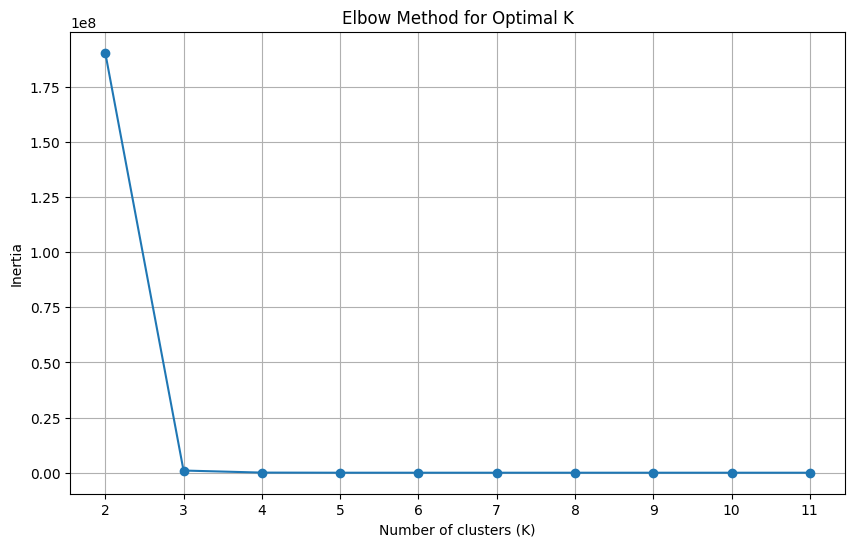

./elbow_test_export/SS-C_csv_10_70292_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0        60000         1         4       160.40  35614.00        0
1            1         3         9      9381.80    265.39        1
2            5         5        11     10332.00    272.71        1
3            2         3         5      9908.60    290.47        1
4            1         3         4      9102.10    290.05        1
5            9         1        14      5124.10    556.11        1
6            2         6        12     10101.00    276.16        1
7         1000         5        16      2695.90    929.39        1
8          100         3         5      7052.30    397.11        1
9            1         1        16      7087.60    399.54        1
10           6         2        12      8913.20    299.89        1
11          10         4        18      7556.80    368.30        1
12           8         4        14      7224.80    366.85

<Figure size 640x480 with 0 Axes>

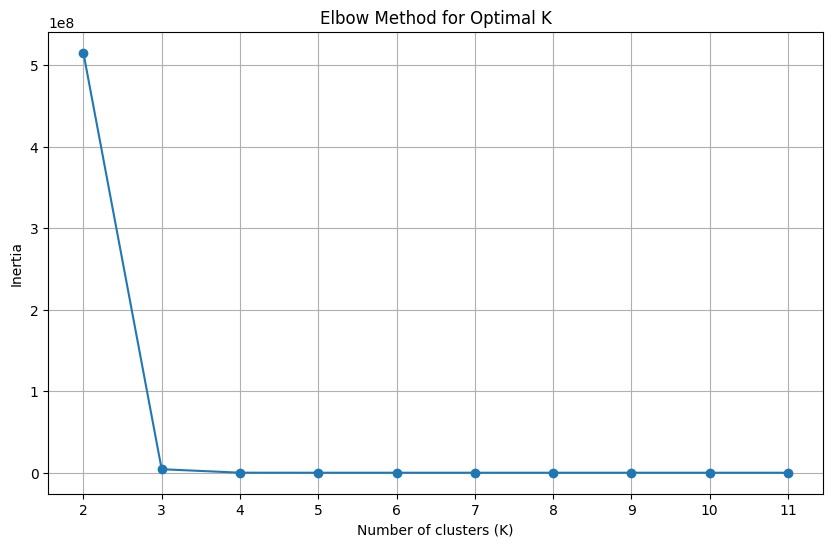

./elbow_test_export/SS-C_csv_10_77340_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            9         6         8      7152.30    357.59        0
1           10         4        11      7397.40    364.49        0
2        10000         3         6       313.25   8632.10        2
3           10         2         3      6355.70    466.67        0
4        10000         1         1       330.25   8695.80        2
5         1000         6         3      2419.90    989.22        0
6           10         3        15      7215.20    364.48        0
7            8         2         5      6789.80    450.49        0
8            7         1        12      7546.20    379.70        0
9            3         1        17      6804.80    398.52        0
10           1         2         4      7972.40    329.55        0
11       60000         2        17       158.33  40490.00        1
12           9         2         6      6573.00    421.18

<Figure size 640x480 with 0 Axes>

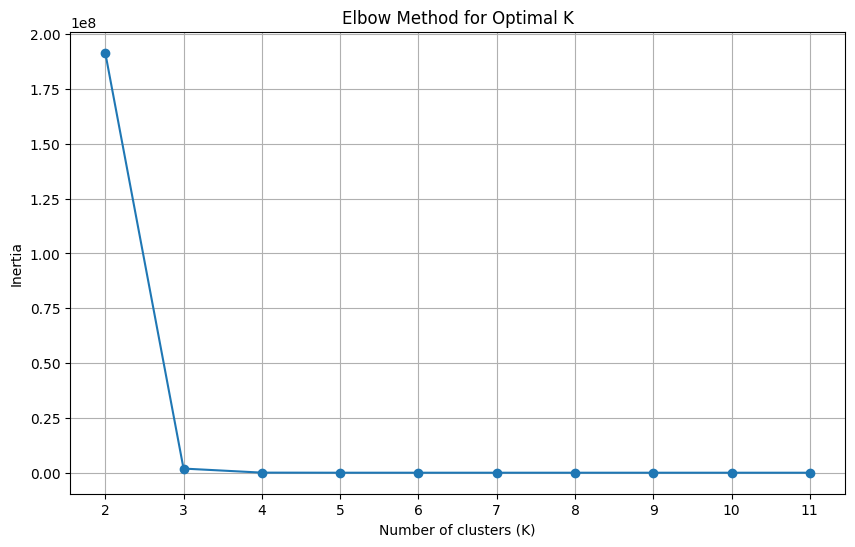

./elbow_test_export/SS-C_csv_10_77845_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            5         5         3     10165.00    289.44        0
1        10000         3        16       296.35   8400.70        2
2           10         5         7      6862.30    393.83        0
3            9         6        13      7627.60    387.58        0
4            5         1         1      6272.10    441.20        0
5         1000         3         2      2919.60    940.20        0
6           10         5        15      7541.10    374.31        0
7            6         5         8     10018.00    262.39        0
8           10         6         9      7103.60    346.65        0
9            4         2         9      8674.20    299.28        0
10          10         1        10      4875.70    547.24        0
11           4         3        14     10152.00    264.18        0
12           8         3         2      7493.80    364.90

<Figure size 640x480 with 0 Axes>

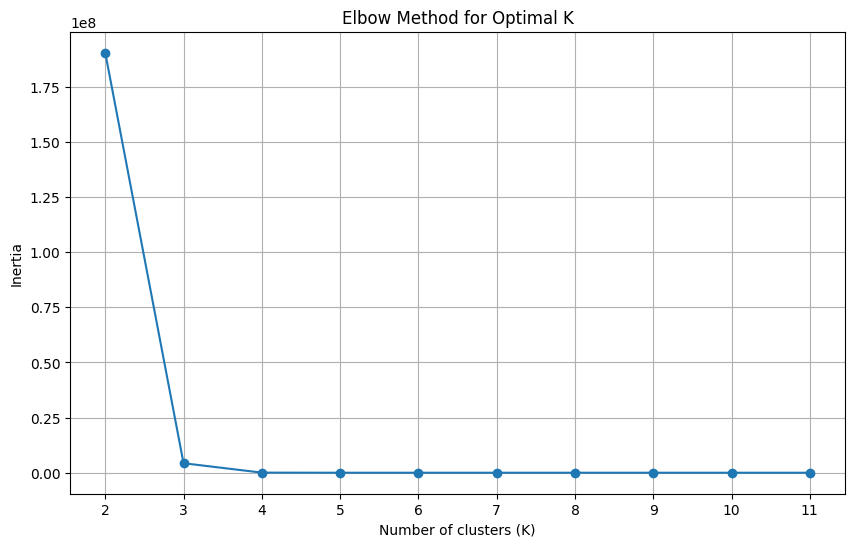

./elbow_test_export/SS-C_csv_10_83686_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            1         1        14      6851.10    398.64        0
1            8         5        15      7139.40    388.28        0
2        60000         5         4       183.33  38042.00        1
3          100         4         4      7447.40    388.17        0
4        60000         5         1       187.50  45329.00        1
5            9         1         8      4690.60    508.07        0
6            5         5        15     10726.00    272.57        0
7            6         5        14     10222.00    265.37        0
8            6         4        11     10336.00    262.61        0
9           10         5        12      7056.20    387.88        0
10       60000         4        18       172.80  35972.00        1
11           1         1        11      8100.70    354.71        0
12           4         1        14      7206.70    356.11

<Figure size 640x480 with 0 Axes>

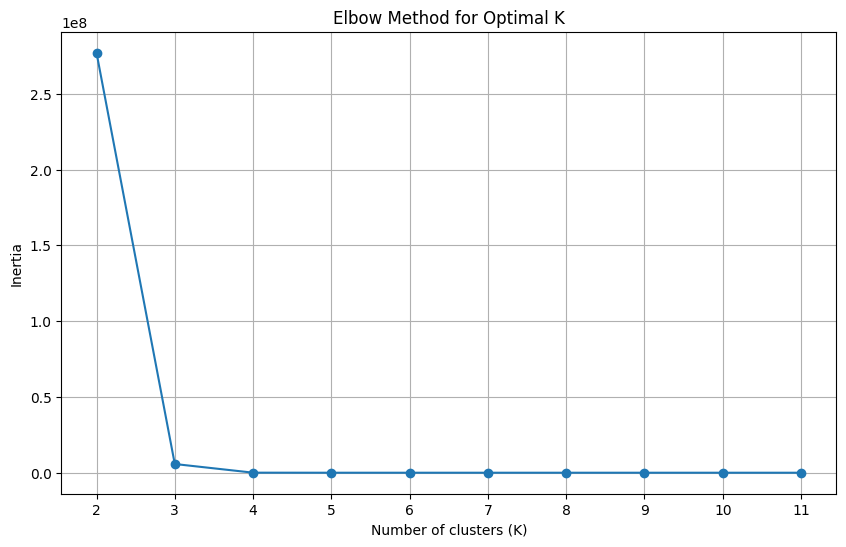

./elbow_test_export/SS-C_csv_10_84967_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0            6         6         6     10444.00    274.18        0
1            5         1         8      7887.10    365.52        0
2            1         5        17     10090.00    268.18        0
3            7         4        13      8379.30    337.84        0
4            7         6        10      7393.80    370.10        0
5            7         5         4      7337.50    370.50        0
6          100         6         5      6880.90    381.31        0
7            6         2         2      9638.70    304.03        0
8            4         5        13     10187.00    271.87        0
9            5         2         9      9351.50    296.93        0
10           1         2        12      9053.00    306.24        0
11       10000         1        11       278.67   8888.50        2
12           9         6        13      7627.60    387.58

<Figure size 640x480 with 0 Axes>

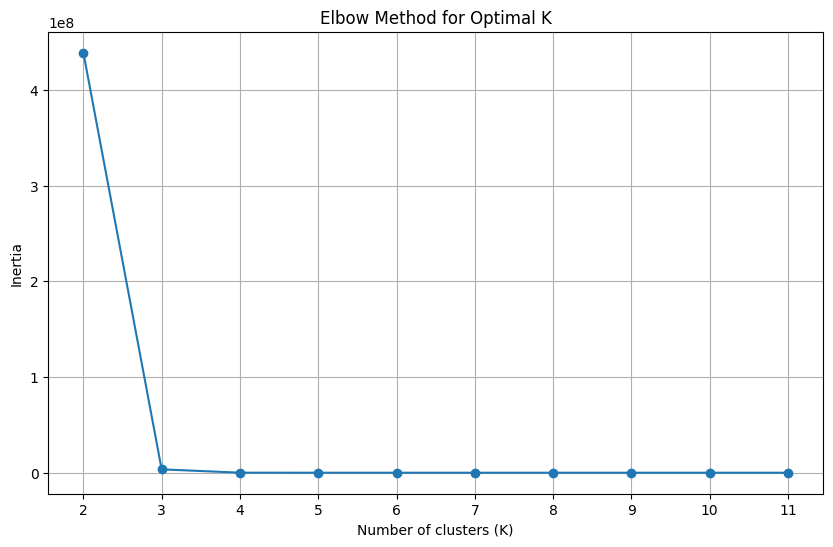

./elbow_test_export/SS-C_csv_10_86331_elbow_test.png
Optimal k value: 3
    Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0         1000         2         3      2705.50   1055.20        0
1            3         6        15     10522.00    255.39        0
2         1000         3         2      2919.60    940.20        0
3        60000         4        10       161.17  33725.00        1
4           10         4        12      7748.20    355.59        0
5            9         6        18      7413.20    385.70        0
6            5         5         2     10317.00    270.05        0
7          100         4         8      7476.10    375.24        0
8        10000         3         3       310.12   8731.10        2
9            5         3        16      9996.80    269.82        0
10           4         2         3      9095.60    309.95        0
11       60000         3        13       166.50  38699.00        1
12       10000         2        16       293.33   8777.00

<Figure size 640x480 with 0 Axes>

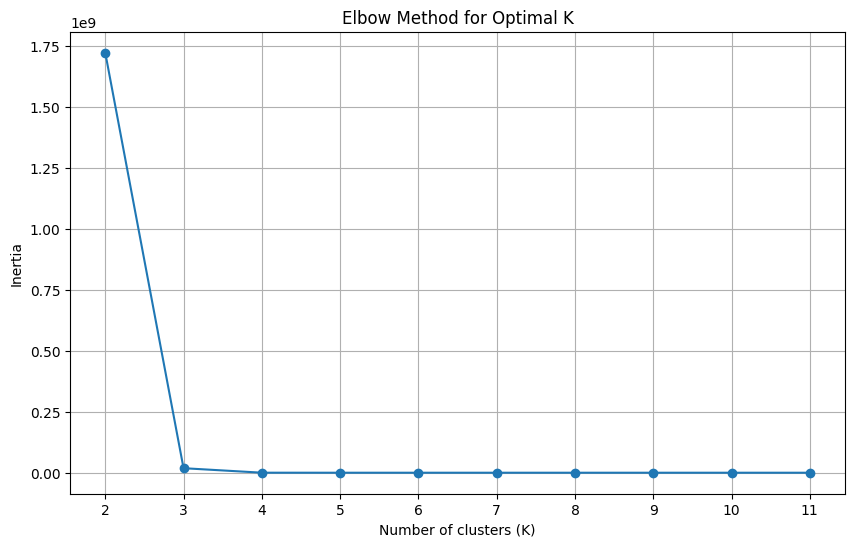

./elbow_test_export/SS-C_csv_50_11514_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0         60000         4        12       253.50  26514.00        0
1            10         5         5      6923.10    390.77        1
2             4         4        14      9953.60    271.77        1
3           100         6        18      6764.20    393.93        1
4          1000         6        14      2852.40    886.55        1
..          ...       ...       ...          ...       ...      ...
245       10000         4        17       322.44   7527.80        2
246         100         1        11      5031.50    577.44        1
247        1000         6        16      2824.70    923.69        1
248           9         4        14      7768.40    355.27        1
249        1000         5        13      2579.30    965.29        1

[250 rows x 6 columns]
[0.8866858968641166, 0.21434314626167847, 0.7007394551483207, nan]
[0.8866858968641166, 

<Figure size 640x480 with 0 Axes>

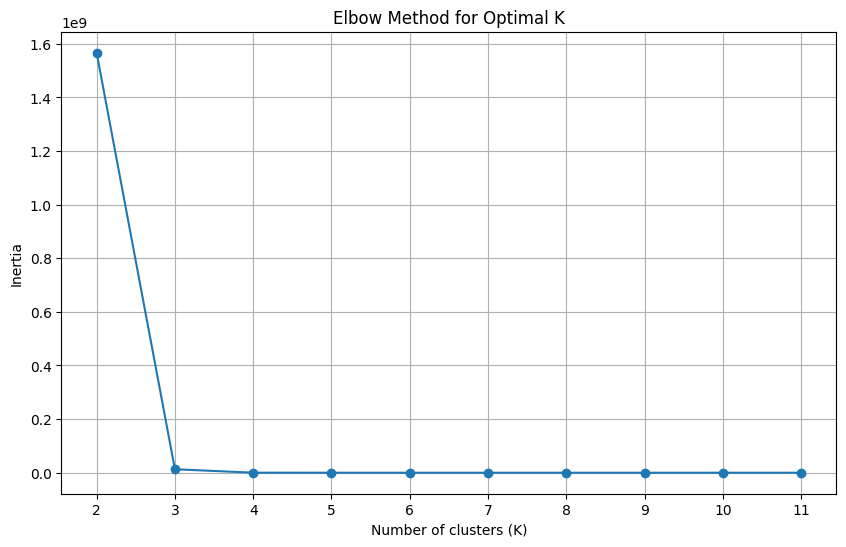

./elbow_test_export/SS-C_csv_50_19953_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4         9      8255.10    335.19        2
1             5         2         7      9123.60    309.76        2
2             8         4         3      7537.20    371.52        2
3             8         1        10      5166.90    556.34        2
4             2         1        17      7444.20    387.80        2
..          ...       ...       ...          ...       ...      ...
245           1         6         1      9954.60    275.92        2
246        1000         1        13      2464.90   1043.10        2
247       10000         6        18       350.56   7649.10        0
248        1000         6        13      2898.90    928.59        2
249       60000         5         1       187.50  45329.00        1

[250 rows x 6 columns]
[0.7040543596495059, 0.8947081248372529, 0.20024189973077464, nan]
[0.7040543596495059, 

<Figure size 640x480 with 0 Axes>

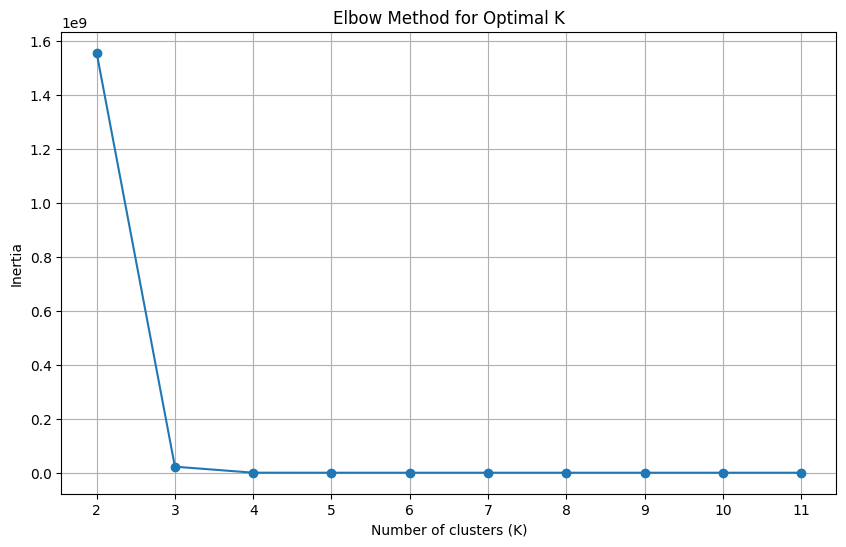

./elbow_test_export/SS-C_csv_50_3545_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         2        16      9101.40    309.22        0
1             7         1        16      6424.40    476.81        0
2         10000         6         8       356.75   7131.70        2
3             9         1         2      5087.40    562.96        0
4             4         4         4      9236.40    292.15        0
..          ...       ...       ...          ...       ...      ...
245           3         2        15      9008.50    300.97        0
246           8         5         3      7152.40    388.87        0
247           5         3        14      9968.80    275.51        0
248       60000         4        17       235.50  36860.00        1
249           2         5         2     10736.00    265.88        0

[250 rows x 6 columns]
[0.21721985202457436, 0.9140307458736867, 0.7042627111778715, nan]
[0.21721985202457436, 

<Figure size 640x480 with 0 Axes>

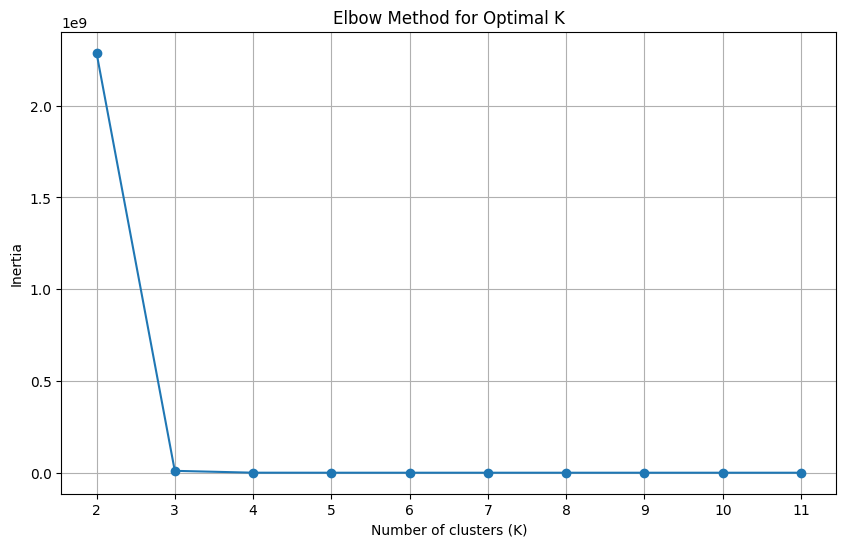

./elbow_test_export/SS-C_csv_50_39658_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             3         2         6      9099.80    321.72        1
1             4         5        16     10253.00    259.36        1
2             9         1        15      5112.00    544.70        1
3             5         1        16      7109.50    384.78        1
4          1000         2        11      2809.20    989.08        1
..          ...       ...       ...          ...       ...      ...
245           3         3        16      9799.20    266.97        1
246         100         6        15      7228.60    368.88        1
247       10000         5         9       377.25   7459.00        2
248           7         4         2      9058.40    305.60        1
249           2         4         8      9664.40    274.13        1

[250 rows x 6 columns]
[0.9043505863684863, 0.20736444637075516, 0.7015452323638481, nan]
[0.9043505863684863, 

<Figure size 640x480 with 0 Axes>

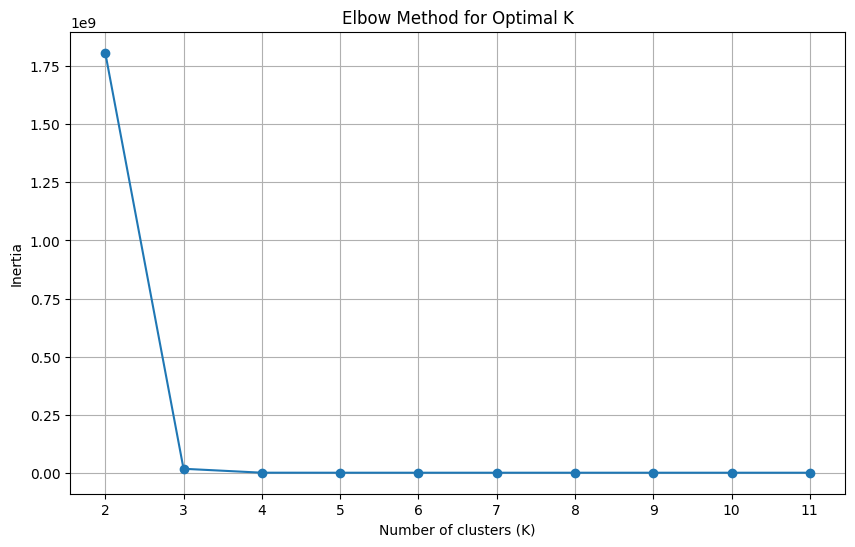

./elbow_test_export/SS-C_csv_50_40749_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             9         4         3      6954.60    381.54        0
1             8         2         4      6041.80    454.06        0
2         60000         3         9       169.83  37314.00        1
3             5         4         6     10132.00    278.23        0
4          1000         1         4      2542.10   1076.50        0
..          ...       ...       ...          ...       ...      ...
245           4         3        17      9847.10    268.98        0
246       10000         6         6       391.69   6962.40        2
247       60000         1         6       138.86  41549.00        1
248       10000         2         5       324.75   8424.20        2
249       10000         3         2       324.50   8509.00        2

[250 rows x 6 columns]
[0.19976243107128364, 0.8876934426754839, 0.7025259543939365, nan]
[0.19976243107128364,

<Figure size 640x480 with 0 Axes>

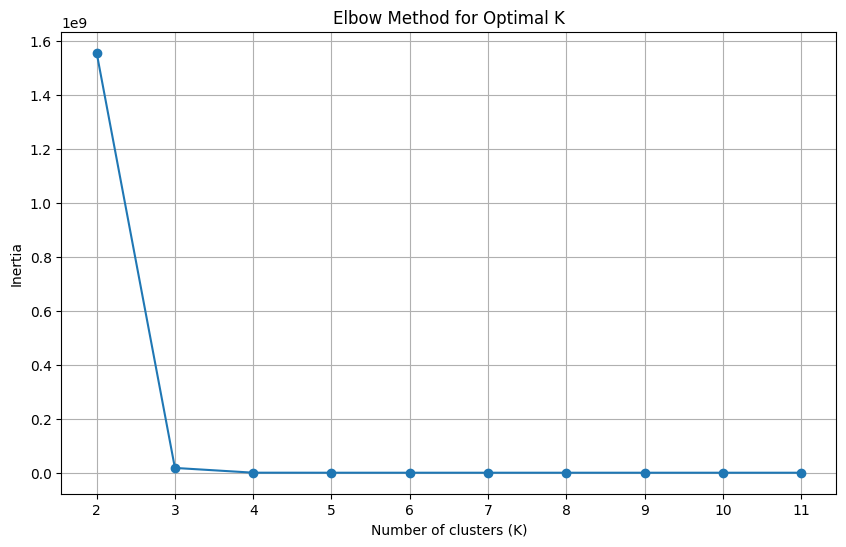

./elbow_test_export/SS-C_csv_50_44845_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             6         4        18       9766.9    283.75        0
1             6         2        15       9447.6    294.77        0
2             4         4        11       9605.0    269.76        0
3           100         2        12       6531.1    414.47        0
4             1         4         3       9322.5    305.17        0
..          ...       ...       ...          ...       ...      ...
245           8         2         8       6527.8    420.59        0
246           5         6        14      11086.0    258.97        0
247          10         4         4       6920.2    412.73        0
248         100         5         8       7322.8    382.57        0
249        1000         3         8       2449.6    969.69        0

[250 rows x 6 columns]
[0.20590089598182573, 0.871006273404578, 0.7007698568201213, nan]
[0.20590089598182573, 

<Figure size 640x480 with 0 Axes>

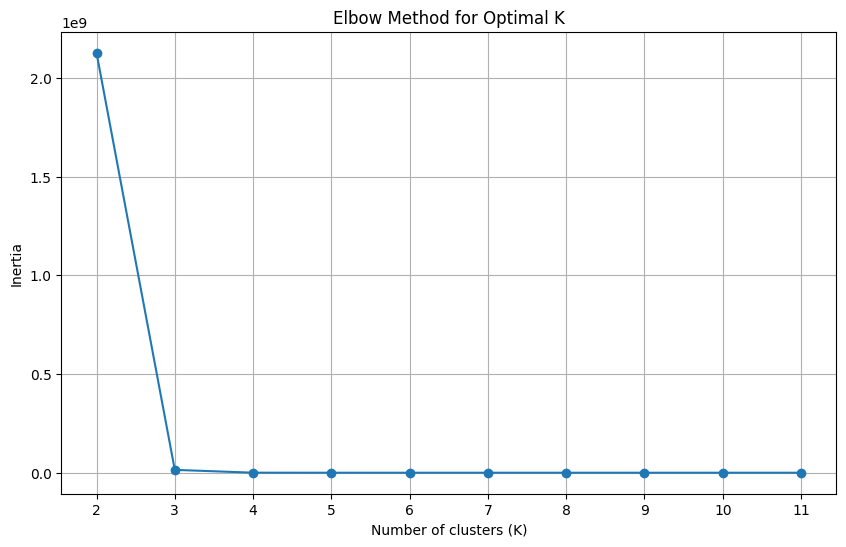

./elbow_test_export/SS-C_csv_50_51176_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4        15      8892.30    326.32        2
1            10         1         5      5130.20    540.02        2
2             2         5        13     10370.00    292.02        2
3            10         2        10      6468.60    425.57        2
4         10000         5        18       344.44   6687.10        0
..          ...       ...       ...          ...       ...      ...
245       10000         5        17       339.62   7540.00        0
246           6         1         7      7319.70    377.65        2
247           8         5        18      7452.10    372.21        2
248           2         4        14     10265.00    274.53        2
249           8         6        11      7388.50    372.32        2

[250 rows x 6 columns]
[0.7033445159588297, 0.8803059467210912, 0.21541936395628575, nan]
[0.7033445159588297, 

<Figure size 640x480 with 0 Axes>

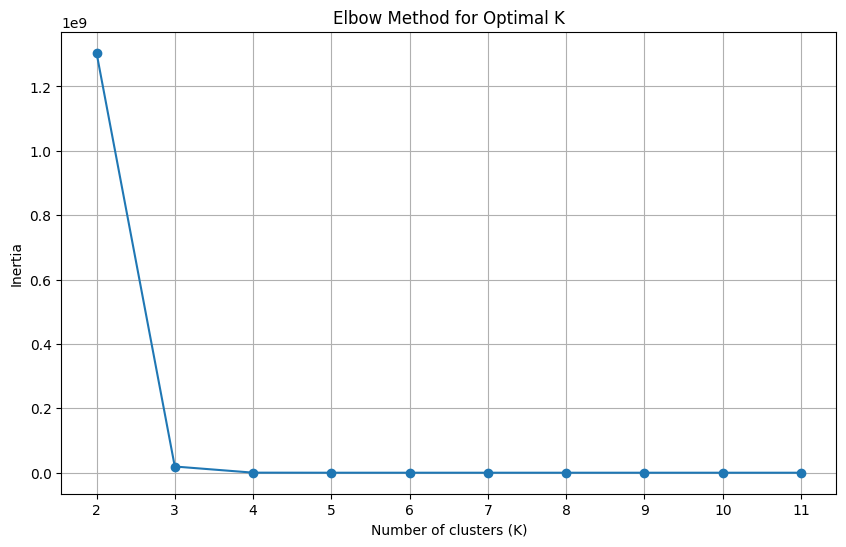

./elbow_test_export/SS-C_csv_50_58612_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             4         4         2      9827.60    286.89        0
1          1000         4         1      2901.20    928.29        0
2             1         5        11     10250.00    261.07        0
3             4         4         8      9790.10    278.59        0
4             2         1         7      6921.50    391.23        0
..          ...       ...       ...          ...       ...      ...
245           7         3        18      8880.50    307.45        0
246         100         3        15      7183.90    379.65        0
247           4         2         5      8701.90    302.32        0
248       10000         2        14       330.19   8581.80        2
249       60000         6        17       186.83  29035.00        1

[250 rows x 6 columns]
[0.2189121315321289, 0.8710930879157744, 0.7013736854858814, nan]
[0.2189121315321289, 0

<Figure size 640x480 with 0 Axes>

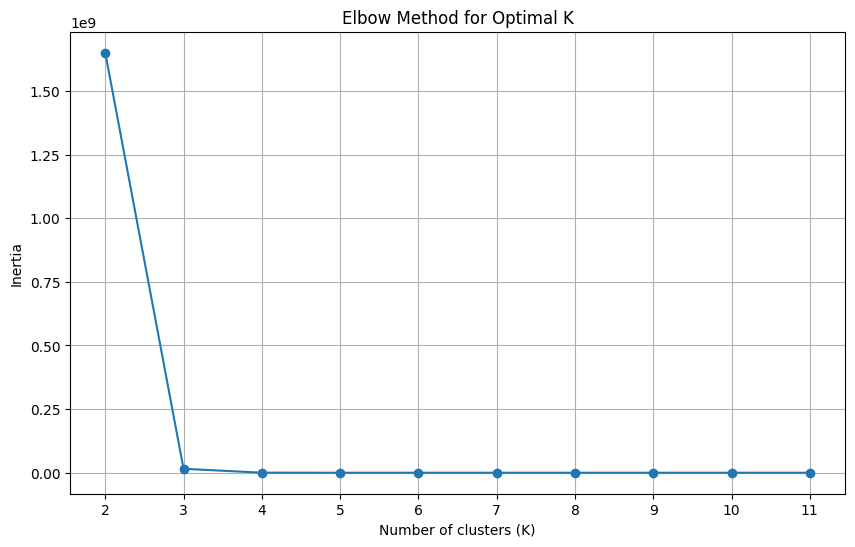

./elbow_test_export/SS-C_csv_50_61367_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         4        15       8892.3    326.32        0
1             9         1        17       4962.8    538.30        0
2             6         5        12       9667.7    277.47        0
3             3         5         3       9750.4    269.54        0
4         60000         2        11        188.0  48245.00        1
..          ...       ...       ...          ...       ...      ...
245          10         2         4       6325.8    438.82        0
246           9         5         5       7863.1    358.84        0
247        1000         5         4       2691.2    957.64        0
248           7         1        17       6404.4    437.42        0
249           6         3        15      10818.0    261.05        0

[250 rows x 6 columns]
[0.212624642034076, 0.8913051462488353, 0.7013441860795354, nan]
[0.212624642034076, 0.8

<Figure size 640x480 with 0 Axes>

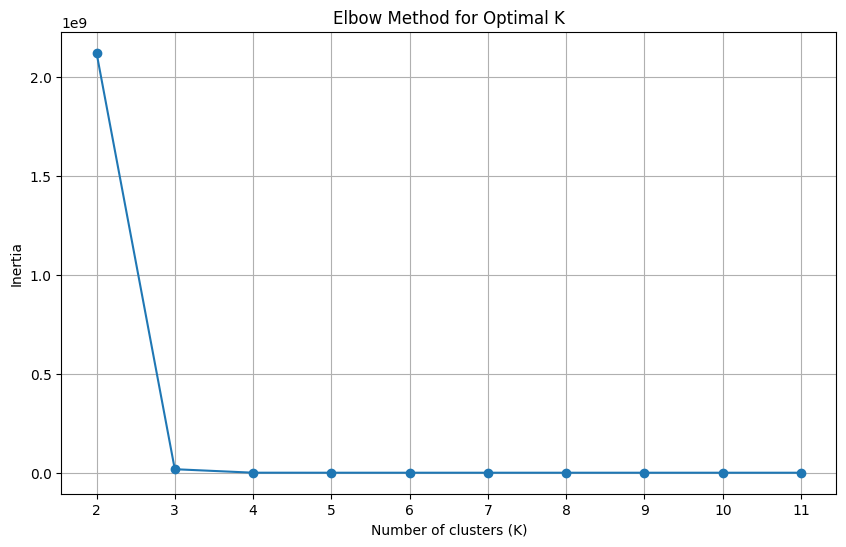

./elbow_test_export/SS-C_csv_50_65388_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             2         6         3      9383.10    288.03        0
1          1000         3         4      2650.60    982.38        0
2             5         5        15     10726.00    272.57        0
3         10000         6        14       383.38   6956.10        2
4          1000         5         6      2790.60    967.65        0
..          ...       ...       ...          ...       ...      ...
245        1000         6         5      2780.50    959.88        0
246          10         5         8      7573.00    365.30        0
247       10000         4        12       334.06   7449.50        2
248       60000         6         7       343.00  37451.00        1
249        1000         1        16      2347.60   1079.60        0

[250 rows x 6 columns]
[0.2035221808008499, 0.8878853500863543, 0.7015508690660814, nan]
[0.2035221808008499, 0

<Figure size 640x480 with 0 Axes>

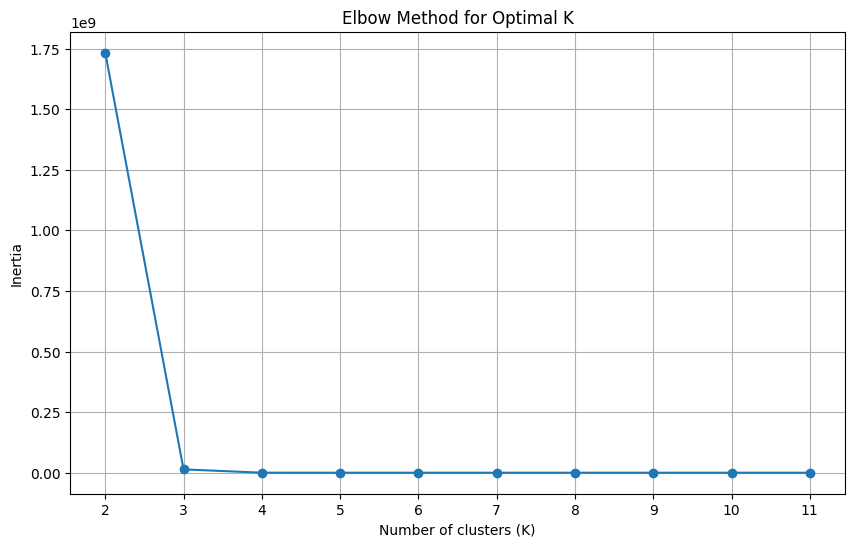

./elbow_test_export/SS-C_csv_50_65444_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             8         4         8      7723.80    403.10        0
1         60000         2         1       185.80  46488.00        1
2         10000         3        12       297.06   8108.60        2
3         60000         2         4       170.67  34681.00        1
4            10         1         1      4431.40    585.12        0
..          ...       ...       ...          ...       ...      ...
245           3         3        11     10007.00    283.96        0
246           4         1        14      7206.70    356.11        0
247           3         1        12      7331.90    374.83        0
248           8         2         9      6622.00    430.83        0
249           6         4         8     10342.00    271.63        0

[250 rows x 6 columns]
[0.20402986489423014, 0.904762225744592, 0.702638311451167, nan]
[0.20402986489423014, 0

<Figure size 640x480 with 0 Axes>

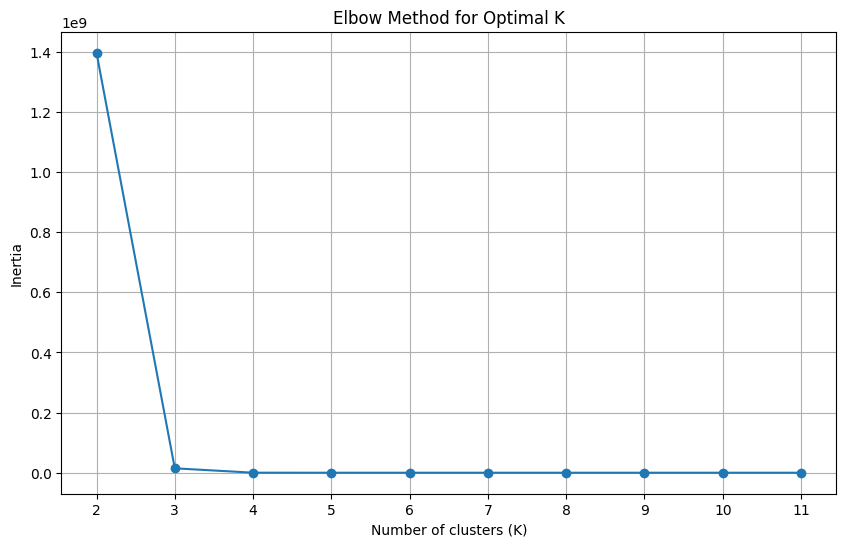

./elbow_test_export/SS-C_csv_50_66946_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0         60000         1        17        203.2  36592.00        1
1             2         4         9      10229.0    275.80        0
2             1         5        14       9378.8    267.26        0
3             2         5         9       9906.6    277.40        0
4             7         2        15       7655.1    346.78        0
..          ...       ...       ...          ...       ...      ...
245           5         3         3      10201.0    284.11        0
246           6         6         1      10298.0    263.88        0
247           4         1         1       5659.5    462.02        0
248           2         5         2      10736.0    265.88        0
249         100         1         4       5001.1    549.48        0

[250 rows x 6 columns]
[0.2019522639925046, 0.8588555356082409, 0.7013060914156797, nan]
[0.2019522639925046, 0

<Figure size 640x480 with 0 Axes>

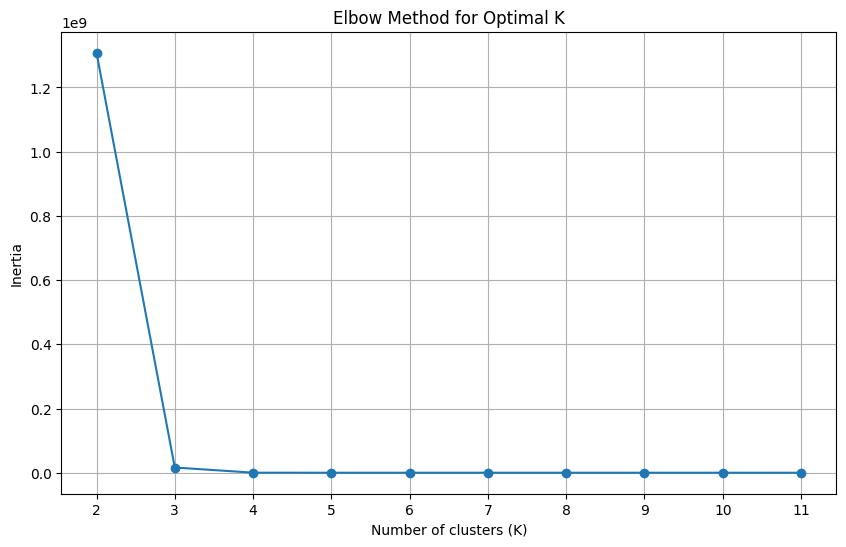

./elbow_test_export/SS-C_csv_50_69024_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             7         3         6      8394.20    336.58        0
1             6         6        10     10840.00    264.19        0
2             4         1         9      6948.20    356.86        0
3             3         1         4      7133.00    398.76        0
4             6         2        13      8194.60    305.47        0
..          ...       ...       ...          ...       ...      ...
245         100         2         8      6675.40    421.88        0
246           2         3        16     10814.00    276.04        0
247         100         6         5      6880.90    381.31        0
248       60000         5        10       249.75  33951.00        1
249          10         1        13      5002.40    560.10        0

[250 rows x 6 columns]
[0.22647970577661533, 0.87197466067524, 0.702488377118389, nan]
[0.22647970577661533, 0.

<Figure size 640x480 with 0 Axes>

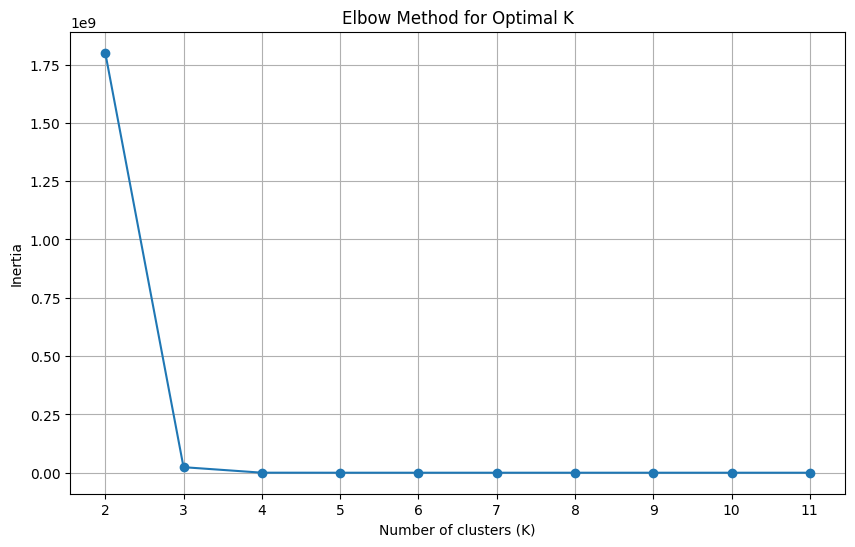

./elbow_test_export/SS-C_csv_50_70006_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             8         2         2      6703.90    417.29        0
1         60000         5         1       187.50  45329.00        1
2             3         4         3      9327.90    289.04        0
3             5         3        10      9514.00    265.12        0
4             3         1        12      7331.90    374.83        0
..          ...       ...       ...          ...       ...      ...
245       10000         2         4       331.94   8668.80        2
246          10         3         2      8184.80    361.41        0
247        1000         3         5      2785.00    988.62        0
248        1000         2        18      2446.20   1076.10        0
249        1000         2        14      2557.30    975.72        0

[250 rows x 6 columns]
[0.22354023681171345, 0.8958713184383269, 0.7015917535257242, nan]
[0.22354023681171345,

<Figure size 640x480 with 0 Axes>

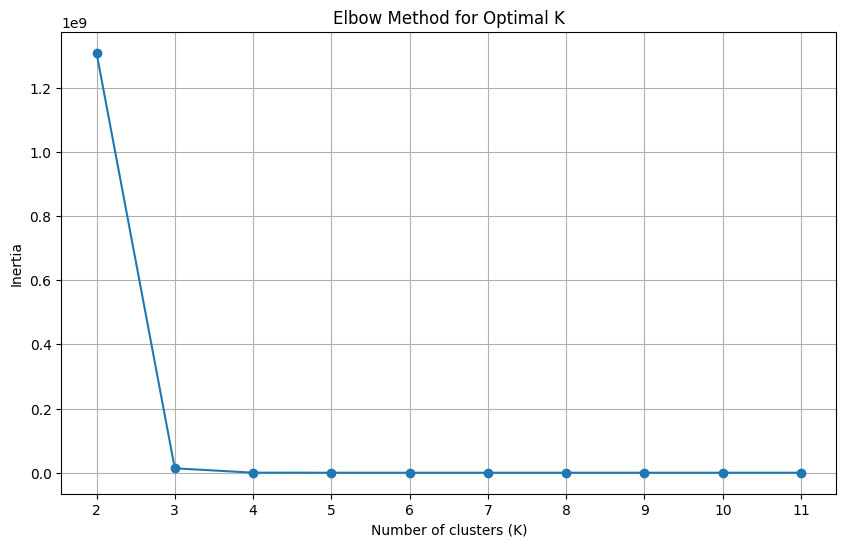

./elbow_test_export/SS-C_csv_50_70292_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0         60000         1         4        160.4  35614.00        1
1             1         3         9       9381.8    265.39        0
2             5         5        11      10332.0    272.71        0
3             2         3         5       9908.6    290.47        0
4             1         3         4       9102.1    290.05        0
..          ...       ...       ...          ...       ...      ...
245       60000         5         7        173.8  29293.00        1
246          10         5        16       7422.2    371.55        0
247           2         3         4       9927.5    288.85        0
248           5         2        10       8966.0    299.66        0
249           3         3        16       9799.2    266.97        0

[250 rows x 6 columns]
[0.20355940741872644, 0.8790613029855125, 0.7008607009514046, nan]
[0.20355940741872644,

<Figure size 640x480 with 0 Axes>

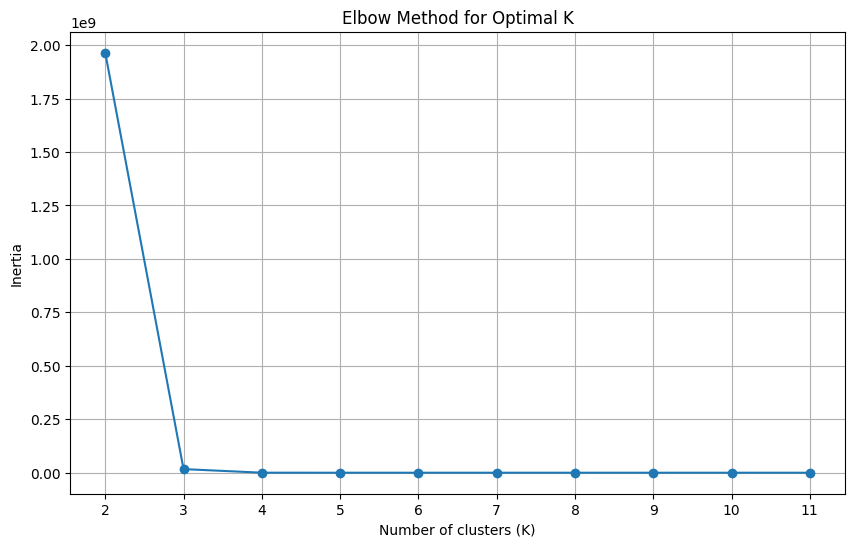

./elbow_test_export/SS-C_csv_50_77340_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             9         6         8      7152.30    357.59        0
1            10         4        11      7397.40    364.49        0
2         10000         3         6       313.25   8632.10        2
3            10         2         3      6355.70    466.67        0
4         10000         1         1       330.25   8695.80        2
..          ...       ...       ...          ...       ...      ...
245         100         4         7      7155.10    380.66        0
246           2         4        13     10178.00    279.78        0
247       60000         6         7       343.00  37451.00        1
248           5         6        13     10116.00    273.84        0
249           8         4         7      6961.90    378.13        0

[250 rows x 6 columns]
[0.24621519331785782, 0.8713383406559625, 0.70156650877265, nan]
[0.24621519331785782, 0

<Figure size 640x480 with 0 Axes>

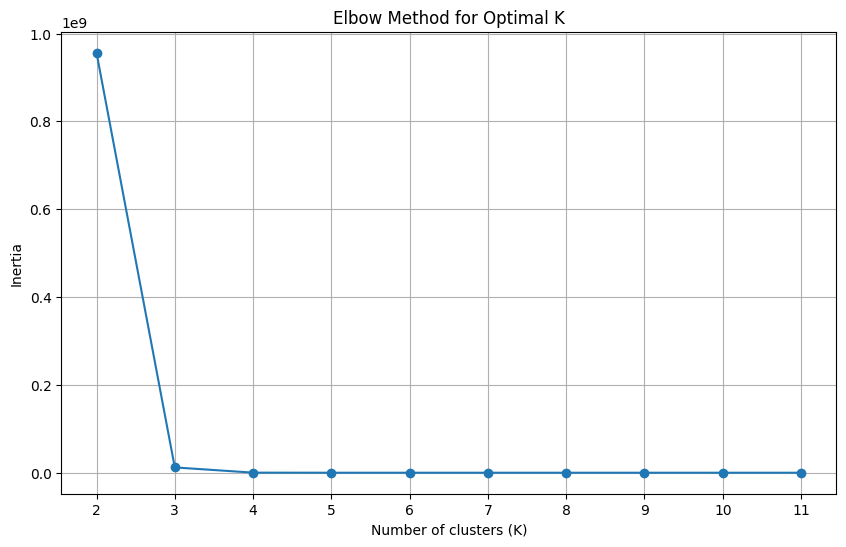

./elbow_test_export/SS-C_csv_50_77845_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             5         5         3     10165.00    289.44        0
1         10000         3        16       296.35   8400.70        2
2            10         5         7      6862.30    393.83        0
3             9         6        13      7627.60    387.58        0
4             5         1         1      6272.10    441.20        0
..          ...       ...       ...          ...       ...      ...
245       10000         5         3       370.94   7864.50        2
246        1000         1        16      2347.60   1079.60        0
247           6         6         7     10022.00    267.57        0
248          10         6         2      7736.60    348.41        0
249           9         3         8      6981.40    397.56        0

[250 rows x 6 columns]
[0.1893404738042934, 0.8883522816332183, 0.7030762745671117, nan]
[0.1893404738042934, 0

<Figure size 640x480 with 0 Axes>

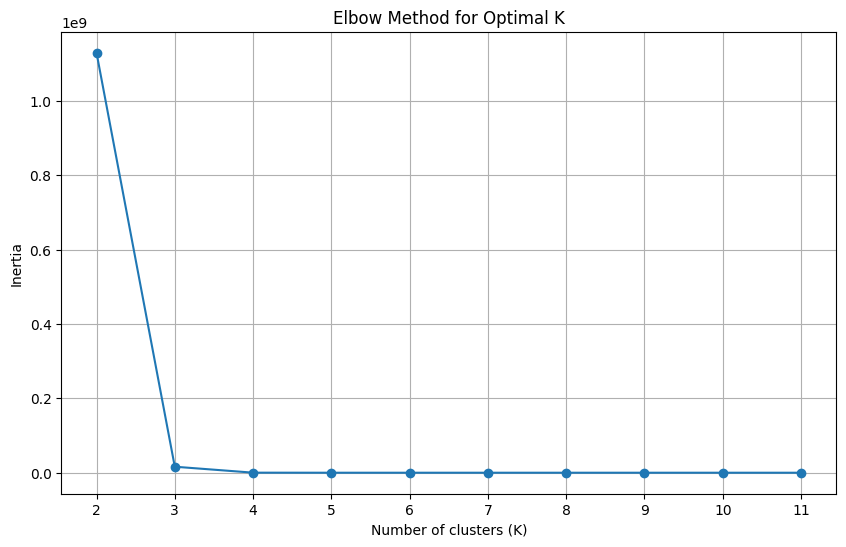

./elbow_test_export/SS-C_csv_50_83686_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             1         1        14      6851.10    398.64        0
1             8         5        15      7139.40    388.28        0
2         60000         5         4       183.33  38042.00        1
3           100         4         4      7447.40    388.17        0
4         60000         5         1       187.50  45329.00        1
..          ...       ...       ...          ...       ...      ...
245           5         3         8     10253.00    281.64        0
246       60000         3        18       153.17  32438.00        1
247           5         4        11     10364.00    275.18        0
248           3         1         4      7133.00    398.76        0
249        1000         6         5      2780.50    959.88        0

[250 rows x 6 columns]
[0.20454639727767518, 0.9033366819978567, 0.7019409792054263, nan]
[0.20454639727767518,

<Figure size 640x480 with 0 Axes>

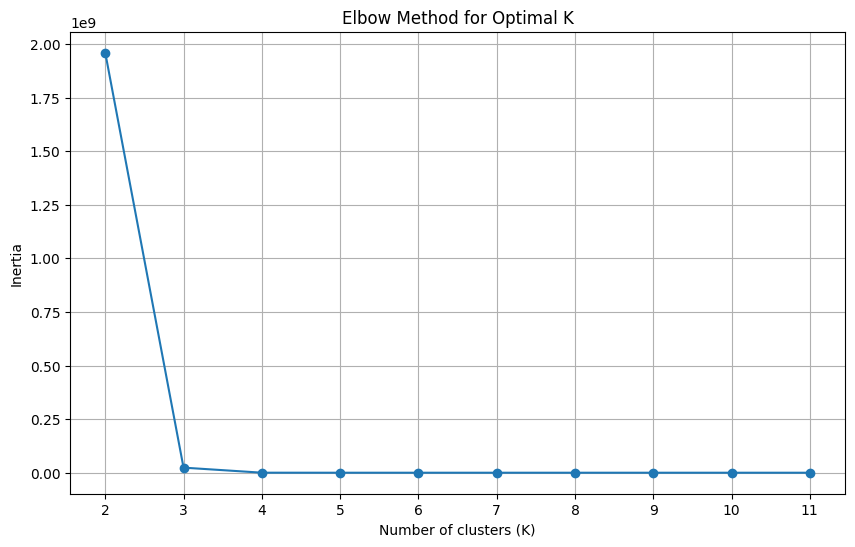

./elbow_test_export/SS-C_csv_50_84967_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0             6         6         6      10444.0    274.18        0
1             5         1         8       7887.1    365.52        0
2             1         5        17      10090.0    268.18        0
3             7         4        13       8379.3    337.84        0
4             7         6        10       7393.8    370.10        0
..          ...       ...       ...          ...       ...      ...
245           4         6        15      10453.0    261.87        0
246           6         5        14      10222.0    265.37        0
247           2         4         1      10433.0    281.20        0
248        1000         6         4       2621.8    955.26        0
249          10         4        14       7265.6    372.25        0

[250 rows x 6 columns]
[0.21873006125000866, 0.8609044930923192, 0.7018489130180504, nan]
[0.21873006125000866,

<Figure size 640x480 with 0 Axes>

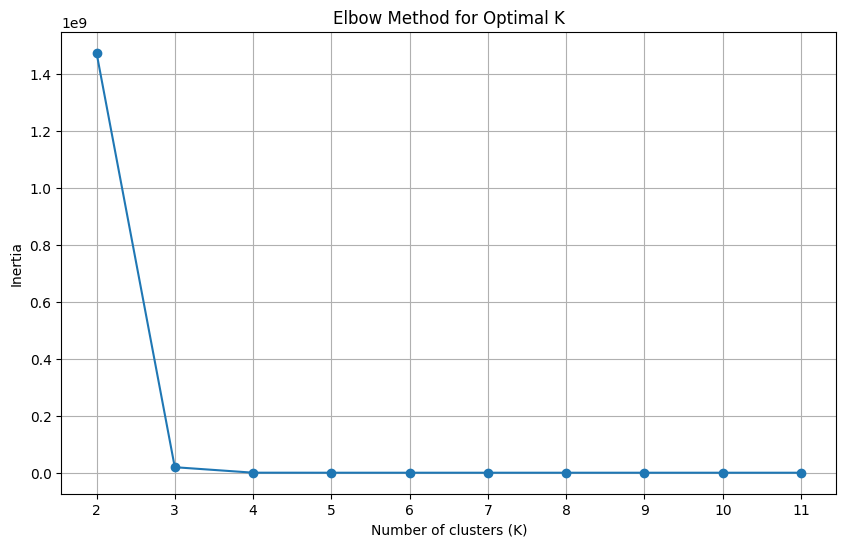

./elbow_test_export/SS-C_csv_50_86331_elbow_test.png
Optimal k value: 3
     Spout_wait  Spliters  Counters  Throughput+  Latency-  cluster
0          1000         2         3      2705.50   1055.20        0
1             3         6        15     10522.00    255.39        0
2          1000         3         2      2919.60    940.20        0
3         60000         4        10       161.17  33725.00        1
4            10         4        12      7748.20    355.59        0
..          ...       ...       ...          ...       ...      ...
245          10         1        13      5002.40    560.10        0
246           3         5         1     10152.00    272.69        0
247           6         4         5     10070.00    271.39        0
248        1000         3        16      2683.30    933.95        0
249           9         2         1      6158.20    457.16        0

[250 rows x 6 columns]
[0.21062097704490745, 0.8620012391387102, 0.7008079529405764, nan]
[0.21062097704490745,

<Figure size 640x480 with 0 Axes>

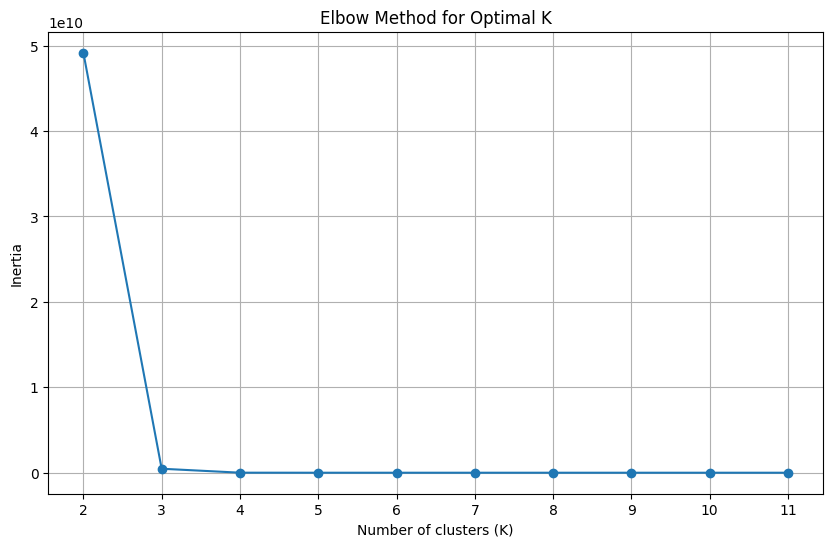

./elbow_test_export/SS-D_csv_10_11514_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+     Latency-  cluster
0   1000000.0         3         3      19133.0    1814.2000        1
1     10000.0         3        15      21523.0    1524.7000        0
2        10.0         3        18      16140.0       7.2948        0
3    100000.0         2         3      21514.0   38738.0000        2
4    100000.0         6         1      31179.0    6540.8000        2
5   1000000.0         1         1      43406.0   83233.0000        1
6   1000000.0         6         3      20812.0    2143.0000        1
7       100.0         3         6      20045.0      58.0000        0
8       100.0         6         1       9214.4     116.1300        0
9   1000000.0         1        15      44024.0   74403.0000        1
10   100000.0         2         6      28808.0   35249.0000        2
11       10.0         6         1       7524.2      13.9590        0
12    10000.0         1        

<Figure size 640x480 with 0 Axes>

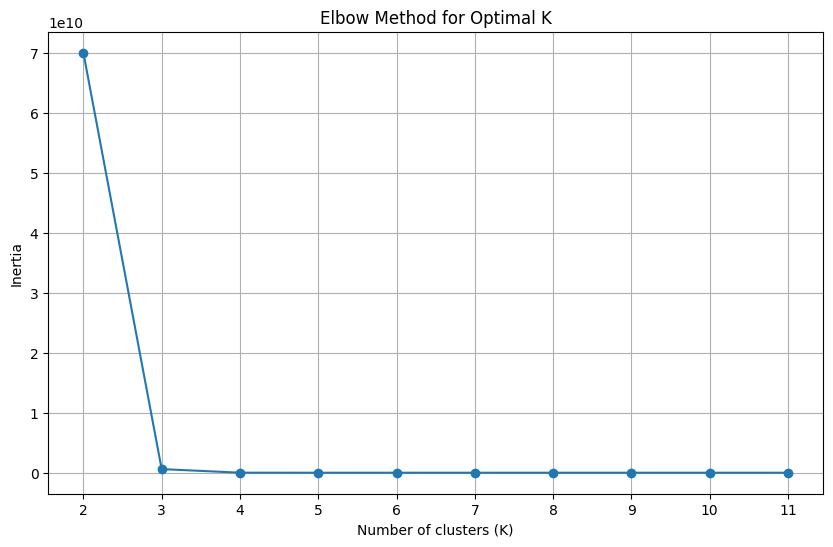

./elbow_test_export/SS-D_csv_10_19953_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1        12      21808.0    470.8200        2
1       100.0         1         3      15515.0     75.8250        2
2      1000.0         3         9      22911.0    521.2300        2
3      1000.0         2        12      32399.0    332.6800        2
4         1.0         3         3       5058.6      3.5506        2
5   1000000.0         1         3      51949.0  53632.0000        1
6    100000.0         1         3      18689.0  51009.0000        0
7        10.0         3        12      17130.0      6.2694        2
8         1.0         2        12       4288.1      2.3965        2
9     10000.0         1         9      20060.0   3340.5000        2
10       10.0         1         1       8226.1     13.7330        2
11      100.0         1        18      20121.0     56.6870        2
12       10.0         2        15      19505

<Figure size 640x480 with 0 Axes>

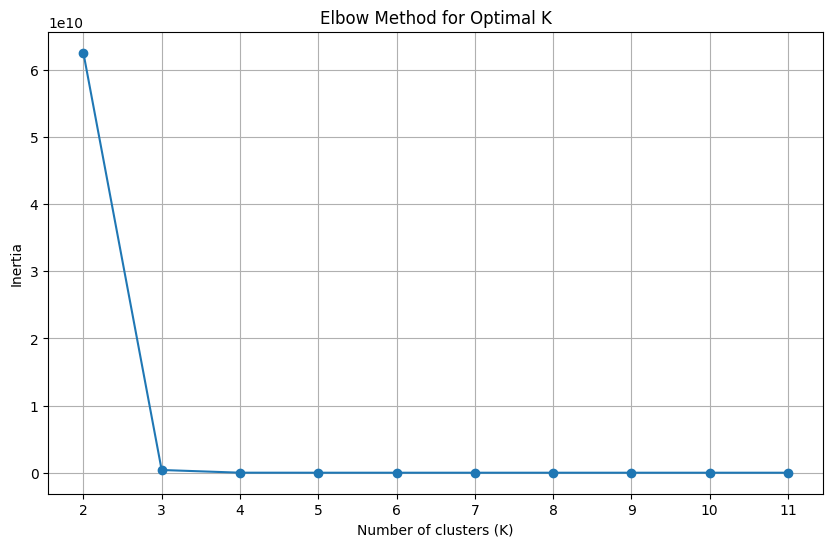

./elbow_test_export/SS-D_csv_10_3545_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         3         9       4786.9      2.1468        0
1       100.0         6        15      23675.0     32.2860        0
2   1000000.0         6        12      26474.0    976.3900        1
3   1000000.0         1        18      50783.0  65193.0000        1
4      1000.0         6         9      25870.0    330.7900        0
5   1000000.0         6         1      30522.0    961.8800        1
6        10.0         3        15      17209.0      6.2798        0
7      1000.0         6         6      25492.0    310.1400        0
8        10.0         3        12      17130.0      6.2694        0
9        10.0         3         3      14591.0      7.6695        0
10        1.0         1        12       4013.8      2.5474        0
11   100000.0         2         1       7217.6  79248.0000        2
12   100000.0         3         6      18216.

<Figure size 640x480 with 0 Axes>

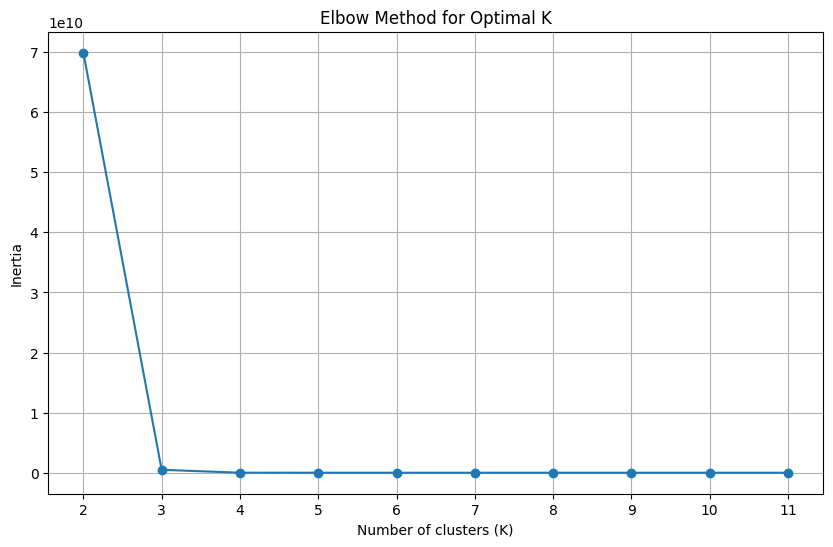

./elbow_test_export/SS-D_csv_10_39658_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        10.0         1         3      12697.0      9.2121        2
1        10.0         6         6      20089.0      5.2988        2
2      1000.0         6        12      26596.0    273.8800        2
3        10.0         6        18      18380.0      5.0711        2
4    100000.0         2        15      32561.0  27907.0000        0
5     10000.0         3        12      19488.0   1691.8000        2
6    100000.0         6         6      26583.0   1151.3000        0
7       100.0         6         6      21587.0     48.7020        2
8        10.0         6         3      16238.0      7.0838        2
9        10.0         2        15      19505.0      5.6023        2
10    10000.0         3         3      17617.0   1981.7000        2
11  1000000.0         2        12      53037.0  77350.0000        1
12        1.0         1         1       4255

<Figure size 640x480 with 0 Axes>

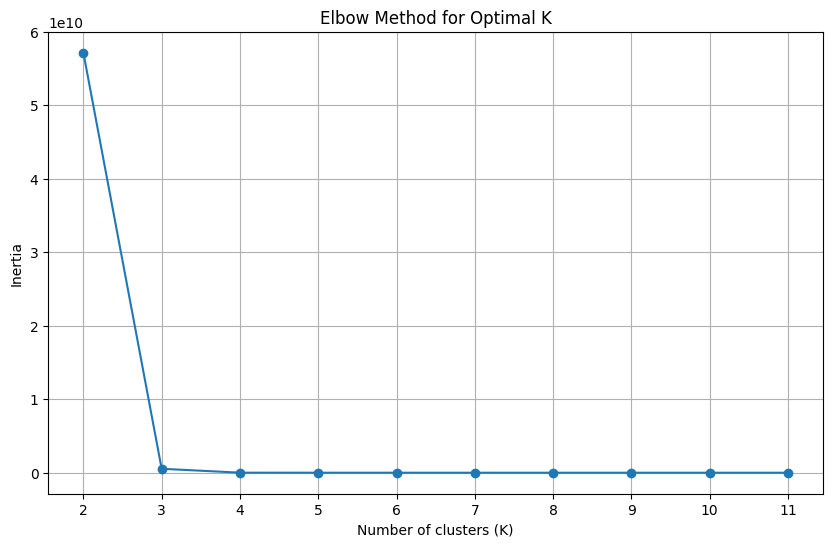

./elbow_test_export/SS-D_csv_10_40749_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0     10000.0         1         9      20060.0   3340.5000        2
1      1000.0         2        18      32815.0    341.2800        2
2   1000000.0         2        18      65823.0  46988.0000        1
3       100.0         1        15      19875.0     53.5390        2
4    100000.0         2         3      21514.0  38738.0000        0
5      1000.0         3         6      19858.0    549.7300        2
6       100.0         2        15      25948.0     46.0010        2
7     10000.0         2         1       7431.5  13541.0000        2
8   1000000.0         2         3      44107.0  94541.0000        1
9     10000.0         1        15      20936.0   4748.4000        2
10  1000000.0         1         9      41829.0  24516.0000        1
11   100000.0         1        18      21145.0  41498.0000        0
12   100000.0         6         1      31179

<Figure size 640x480 with 0 Axes>

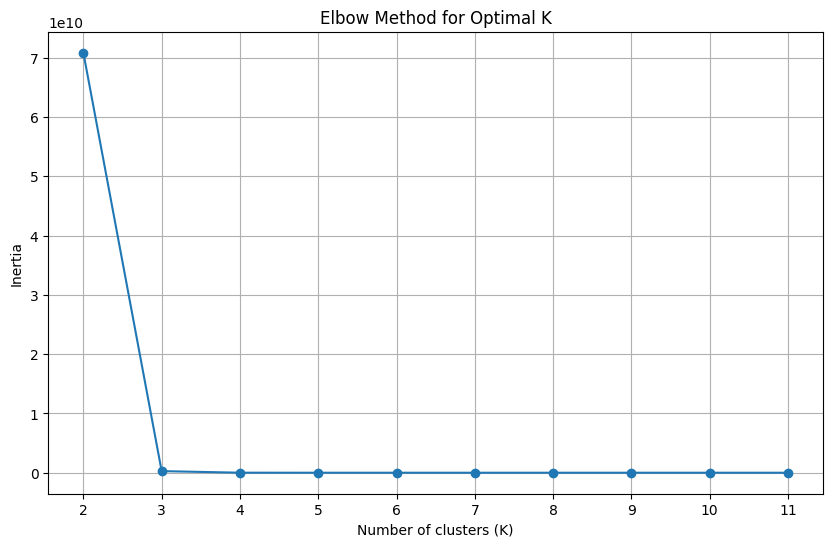

./elbow_test_export/SS-D_csv_10_44845_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         3        18      21234.0     53.9270        0
1       100.0         3         3      16941.0     65.1850        0
2        10.0         3        18      16140.0      7.2948        0
3     10000.0         6        15      25530.0   1007.9000        0
4         1.0         2         1       4294.7      4.7793        0
5     10000.0         1         9      20060.0   3340.5000        0
6        10.0         3         1       8219.4     13.8650        0
7      1000.0         6         1      11583.0   1038.1000        0
8        10.0         1         1       8226.1     13.7330        0
9         1.0         2         9       4369.6      2.4306        0
10       10.0         2         3      14169.0      8.1471        0
11  1000000.0         3         9      19266.0   1713.3000        1
12   100000.0         1         1       7473

<Figure size 640x480 with 0 Axes>

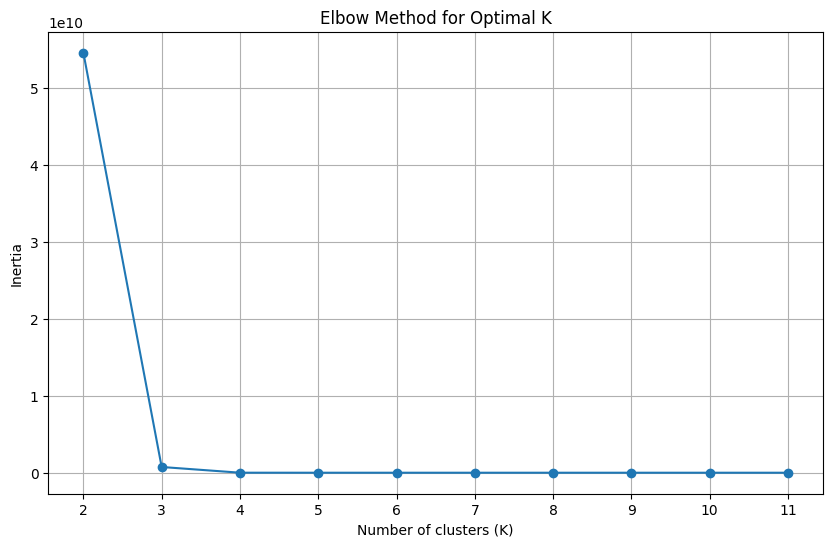

./elbow_test_export/SS-D_csv_10_51176_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1        15      23497.0    439.3500        2
1     10000.0         2         9      30161.0   3483.2000        2
2         1.0         6         9       4891.9      2.1503        2
3     10000.0         2        15      33155.0   2972.0000        2
4   1000000.0         1        15      44024.0  74403.0000        1
5      1000.0         1         6      22015.0    511.6200        2
6       100.0         2        12      26373.0     40.1690        2
7      1000.0         3        15      22132.0    468.7100        2
8       100.0         6         9      23142.0     37.9150        2
9     10000.0         3         6      18757.0   1658.8000        2
10  1000000.0         6        15      25167.0    974.8900        1
11        1.0         2         3       4343.6      2.3810        2
12  1000000.0         2         3      44107

<Figure size 640x480 with 0 Axes>

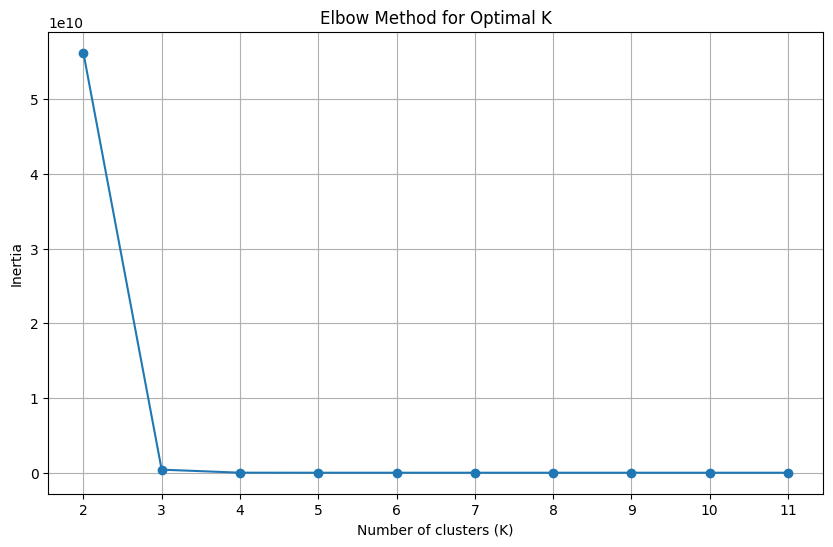

./elbow_test_export/SS-D_csv_10_58612_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+     Latency-  cluster
0        10.0         3        15      17209.0       6.2798        0
1    100000.0         3         3      17911.0    1806.9000        2
2         1.0         2         9       4369.6       2.4306        0
3        10.0         3        18      16140.0       7.2948        0
4         1.0         3         1       4980.3       2.1598        0
5         1.0         3         3       5058.6       3.5506        0
6   1000000.0         1        15      44024.0   74403.0000        1
7         1.0         2         1       4294.7       4.7793        0
8       100.0         3         3      16941.0      65.1850        0
9         1.0         2         3       4343.6       2.3810        0
10   100000.0         6        12      26315.0     928.1800        2
11    10000.0         6         9      25202.0    1145.3000        0
12    10000.0         2        

<Figure size 640x480 with 0 Axes>

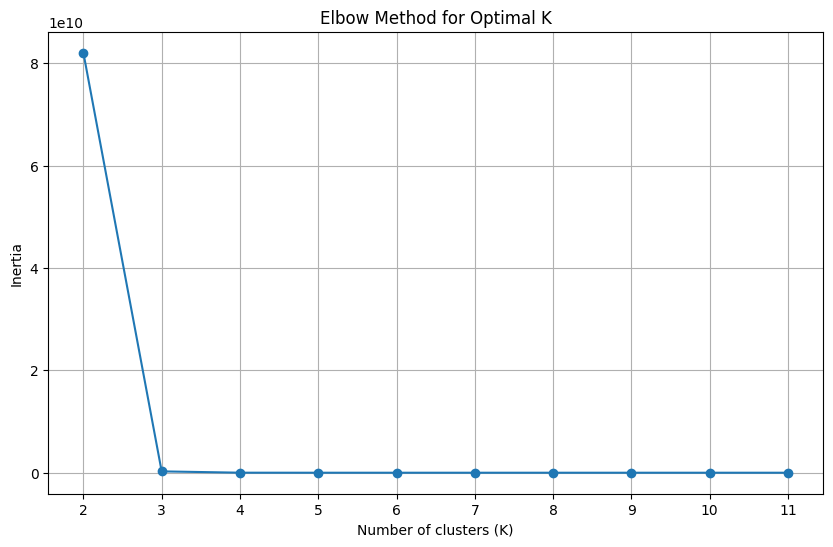

./elbow_test_export/SS-D_csv_10_61367_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1        15      23497.0    439.3500        0
1      1000.0         6        15      25833.0    251.1900        0
2       100.0         6         1       9214.4    116.1300        0
3        10.0         2         3      14169.0      8.1471        0
4   1000000.0         2        12      53037.0  77350.0000        1
5       100.0         3         1       8465.1    132.7800        0
6    100000.0         6        15      25927.0    834.6100        2
7        10.0         2         9      18652.0      6.2867        0
8        10.0         3        18      16140.0      7.2948        0
9         1.0         3        12       4528.8      3.0358        0
10   100000.0         1         3      18689.0  51009.0000        2
11      100.0         6        15      23675.0     32.2860        0
12      100.0         6         6      21587

<Figure size 640x480 with 0 Axes>

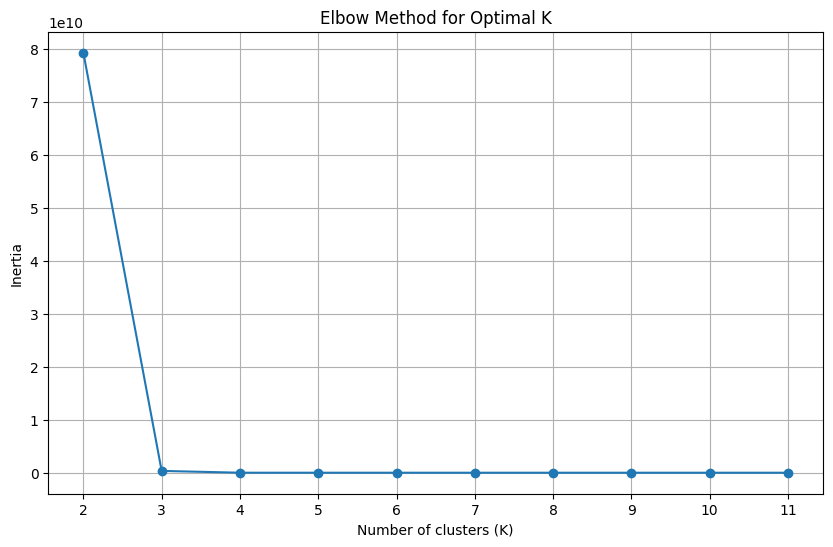

./elbow_test_export/SS-D_csv_10_65388_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         6        12       4871.0      2.2277        0
1    100000.0         2        18      31825.0  28692.0000        2
2       100.0         2         3      18568.0     65.4370        0
3   1000000.0         1        18      50783.0  65193.0000        1
4    100000.0         3        12      19842.0   1535.9000        2
5    100000.0         3         6      18216.0   1821.7000        2
6       100.0         3         3      16941.0     65.1850        0
7        10.0         6        18      18380.0      5.0711        0
8   1000000.0         1         9      41829.0  24516.0000        1
9        10.0         1        15      16019.0      7.3717        0
10       10.0         6         1       7524.2     13.9590        0
11        1.0         1         9       4156.9      2.5688        0
12       10.0         1         1       8226

<Figure size 640x480 with 0 Axes>

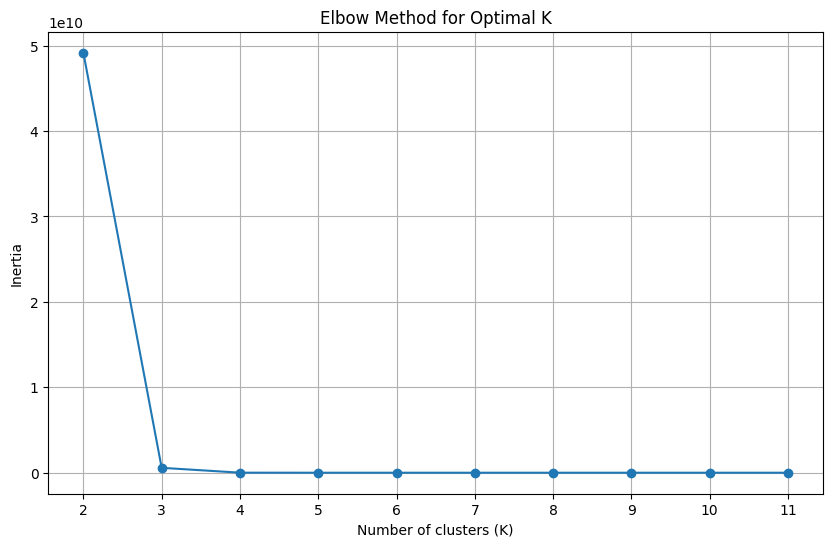

./elbow_test_export/SS-D_csv_10_65444_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+     Latency-  cluster
0      1000.0         3        12      22122.0     501.1100        2
1   1000000.0         2         6      45856.0  105000.0000        1
2    100000.0         6        18      28650.0     776.3800        0
3   1000000.0         2         9      47756.0   70551.0000        1
4     10000.0         2         6      29437.0    3740.0000        2
5         1.0         1        15       4194.1       2.5676        2
6     10000.0         6        15      25530.0    1007.9000        2
7       100.0         1        15      19875.0      53.5390        2
8    100000.0         3        18      21527.0    1635.1000        0
9         1.0         3         6       4836.7       2.1283        2
10  1000000.0         3        18      20307.0    1817.5000        1
11  1000000.0         6        18      26933.0     979.5500        1
12    10000.0         6        

<Figure size 640x480 with 0 Axes>

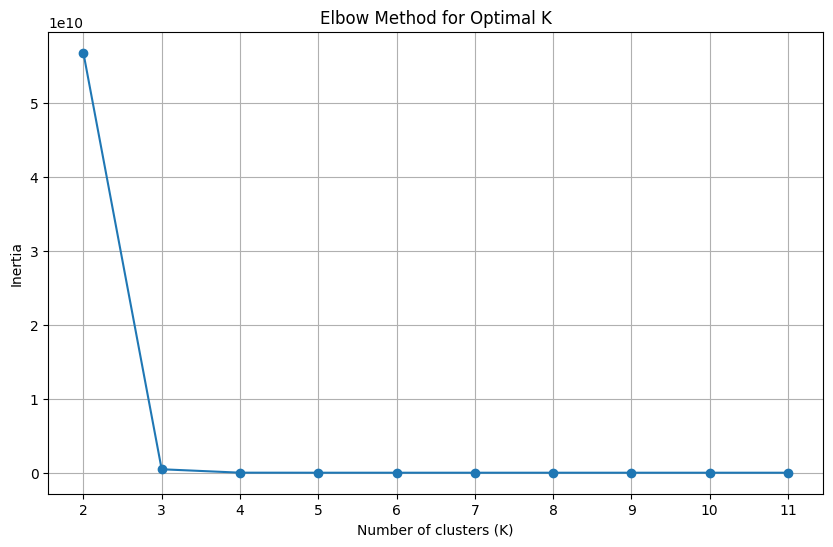

./elbow_test_export/SS-D_csv_10_66946_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+     Latency-  cluster
0   1000000.0         6         3      20812.0    2143.0000        1
1   1000000.0         2         6      45856.0  105000.0000        1
2         1.0         6         1       4904.2       2.1626        0
3         1.0         2         9       4369.6       2.4306        0
4         1.0         6         6       4847.1       2.1376        0
5      1000.0         1         3      20050.0     553.7400        0
6        10.0         3        15      17209.0       6.2798        0
7     10000.0         6         1      21157.0    1439.6000        0
8    100000.0         1         6      27212.0   25993.0000        2
9       100.0         1        18      20121.0      56.6870        0
10     1000.0         6         1      11583.0    1038.1000        0
11     1000.0         3         3      19036.0     595.9100        0
12       10.0         2        

<Figure size 640x480 with 0 Axes>

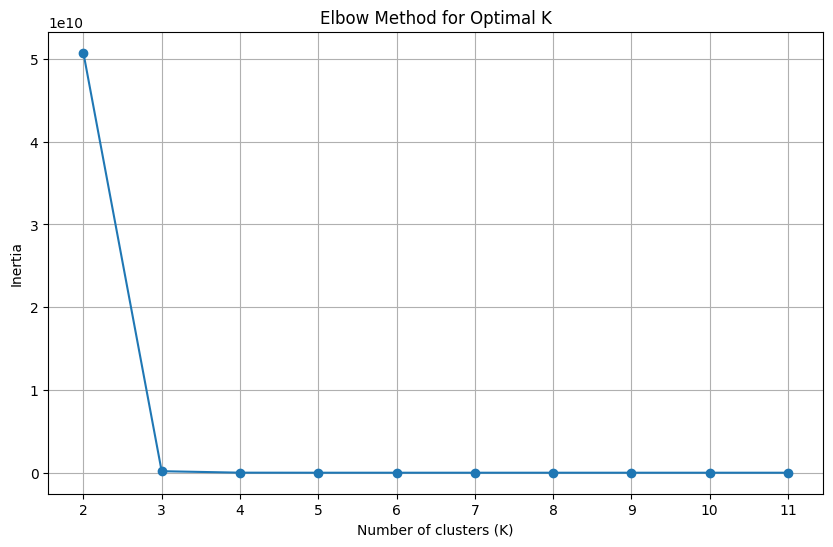

./elbow_test_export/SS-D_csv_10_69024_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1         6      22015.0    511.6200        0
1       100.0         6         6      21587.0     48.7020        0
2        10.0         2        18      19335.0      5.6410        0
3         1.0         6        18       4688.1      2.2277        0
4       100.0         3         3      16941.0     65.1850        0
5         1.0         6         6       4847.1      2.1376        0
6   1000000.0         6         6      25226.0    856.8200        1
7    100000.0         2        18      31825.0  28692.0000        2
8        10.0         6        15      19157.0      5.0006        0
9       100.0         3         6      20045.0     58.0000        0
10     1000.0         3        12      22122.0    501.1100        0
11  1000000.0         6        12      26474.0    976.3900        1
12     1000.0         1        12      21808

<Figure size 640x480 with 0 Axes>

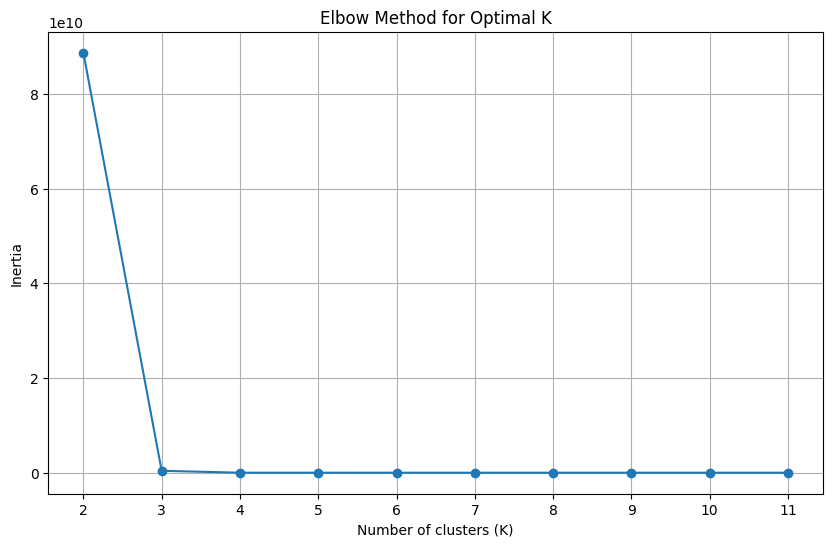

./elbow_test_export/SS-D_csv_10_70006_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         2        15      33549.0    321.5300        2
1   1000000.0         3         6      19405.0   1592.6000        1
2        10.0         1        18      15103.0      7.3965        2
3       100.0         1         9      18652.0     62.0800        2
4        10.0         1         1       8226.1     13.7330        2
5   1000000.0         1         9      41829.0  24516.0000        1
6   1000000.0         1         6      41953.0  36772.0000        1
7       100.0         1         3      15515.0     75.8250        2
8      1000.0         1         6      22015.0    511.6200        2
9     10000.0         2        12      35418.0   3138.8000        2
10   100000.0         3         1      16832.0  24535.0000        0
11   100000.0         1         6      27212.0  25993.0000        0
12        1.0         1         9       4156

<Figure size 640x480 with 0 Axes>

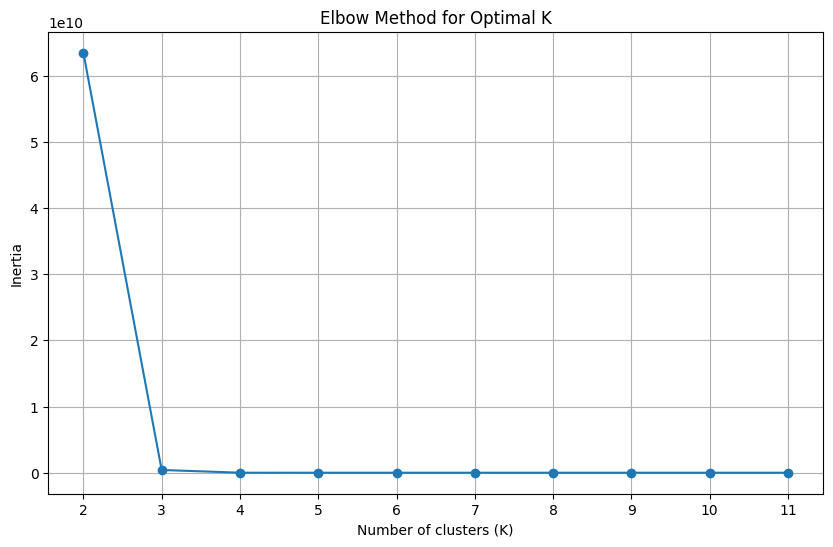

./elbow_test_export/SS-D_csv_10_70292_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         2         1      38992.0  72496.0000        1
1         1.0         1        15       4194.1      2.5676        0
2       100.0         2         3      18568.0     65.4370        0
3         1.0         3        12       4528.8      3.0358        0
4         1.0         1        12       4013.8      2.5474        0
5      1000.0         6        12      26596.0    273.8800        0
6         1.0         6        15       4645.8      2.1468        0
7    100000.0         3        15      20932.0   1579.7000        2
8    100000.0         1         1       7473.9  53025.0000        2
9         1.0         1         3       4160.1      2.6057        0
10      100.0         3         3      16941.0     65.1850        0
11    10000.0         3        12      19488.0   1691.8000        0
12     1000.0         3        12      22122

<Figure size 640x480 with 0 Axes>

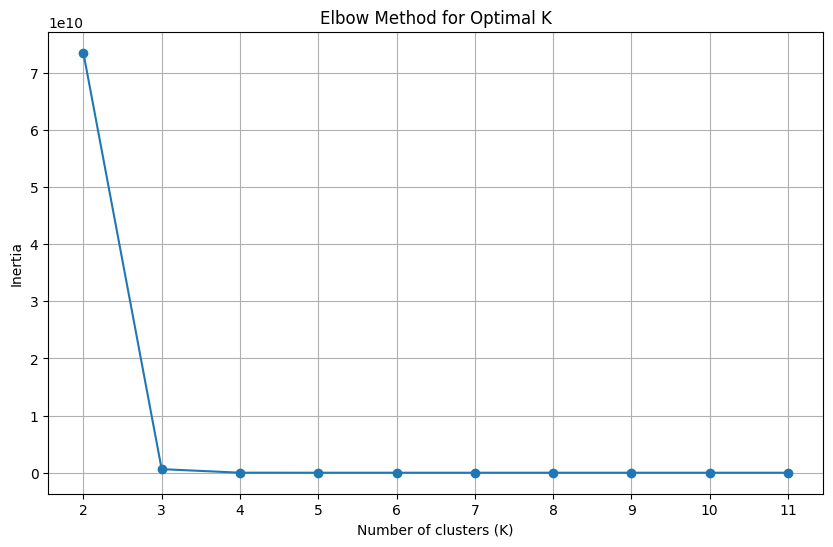

./elbow_test_export/SS-D_csv_10_77340_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+     Latency-  cluster
0     10000.0         2         3      22333.0    5447.8000        0
1     10000.0         3         9      18710.0    1802.8000        0
2    100000.0         6        18      28650.0     776.3800        2
3     10000.0         2        15      33155.0    2972.0000        0
4    100000.0         6         3      21251.0    1891.2000        2
5    100000.0         3        18      21527.0    1635.1000        2
6     10000.0         3         3      17617.0    1981.7000        0
7      1000.0         2        18      32815.0     341.2800        0
8       100.0         6        15      23675.0      32.2860        0
9        10.0         1         3      12697.0       9.2121        0
10        1.0         1         6       4089.5       2.5500        0
11  1000000.0         2        12      53037.0   77350.0000        1
12     1000.0         6        

<Figure size 640x480 with 0 Axes>

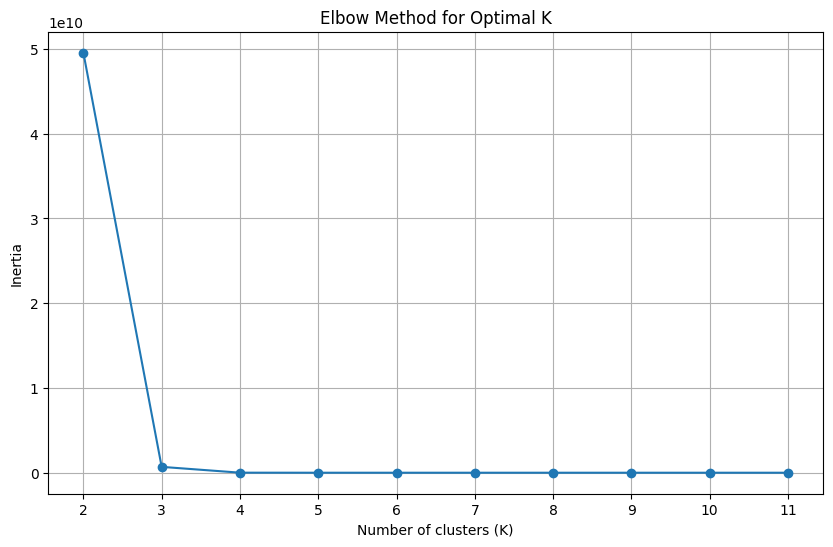

./elbow_test_export/SS-D_csv_10_77845_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         2         1       8746.0    117.5700        0
1   1000000.0         1         1      43406.0  83233.0000        1
2     10000.0         3        15      21523.0   1524.7000        0
3     10000.0         2         3      22333.0   5447.8000        0
4        10.0         6        15      19157.0      5.0006        0
5    100000.0         2        18      31825.0  28692.0000        2
6     10000.0         3        18      21380.0   1384.5000        0
7       100.0         6         1       9214.4    116.1300        0
8     10000.0         6         1      21157.0   1439.6000        0
9        10.0         3         3      14591.0      7.6695        0
10    10000.0         2         9      30161.0   3483.2000        0
11       10.0         3        12      17130.0      6.2694        0
12     1000.0         3         3      19036

<Figure size 640x480 with 0 Axes>

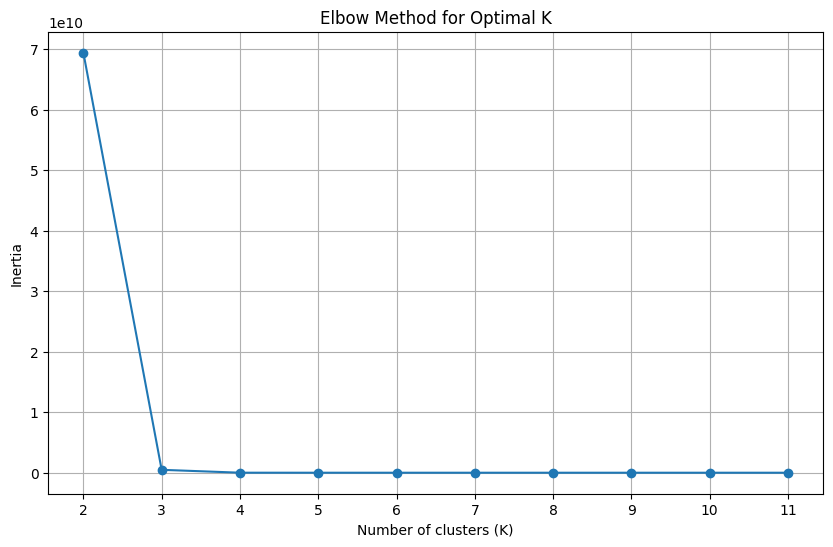

./elbow_test_export/SS-D_csv_10_83686_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         1         3       4160.1      2.6057        0
1      1000.0         6         1      11583.0   1038.1000        0
2   1000000.0         3         6      19405.0   1592.6000        1
3    100000.0         1         6      27212.0  25993.0000        2
4   1000000.0         6        12      26474.0    976.3900        1
5      1000.0         6         9      25870.0    330.7900        0
6       100.0         2         3      18568.0     65.4370        0
7       100.0         6         3      20359.0     55.5010        0
8       100.0         3        15      23240.0     51.4630        0
9     10000.0         3        15      21523.0   1524.7000        0
10  1000000.0         6         6      25226.0    856.8200        1
11  1000000.0         6        18      26933.0    979.5500        1
12       10.0         3         1       8219

<Figure size 640x480 with 0 Axes>

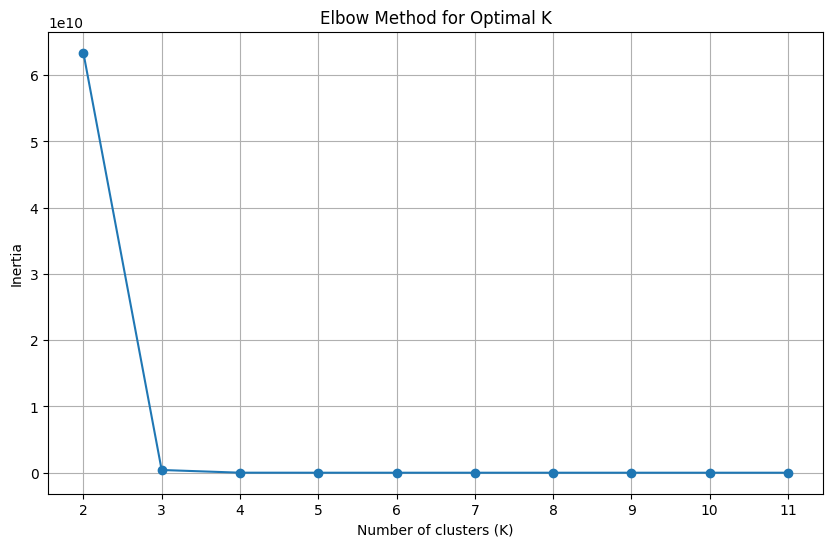

./elbow_test_export/SS-D_csv_10_84967_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         6         6      21587.0     48.7020        0
1        10.0         6        15      19157.0      5.0006        0
2         1.0         2        12       4288.1      2.3965        0
3      1000.0         1        15      23497.0    439.3500        0
4      1000.0         2         6      25805.0    463.3300        0
5   1000000.0         6         1      30522.0    961.8800        1
6      1000.0         1        18      24392.0    419.9100        0
7    100000.0         1        18      21145.0  41498.0000        2
8       100.0         2        18      25565.0     39.4470        0
9        10.0         6         6      20089.0      5.2988        0
10      100.0         1         3      15515.0     75.8250        0
11        1.0         1         9       4156.9      2.5688        0
12   100000.0         6         6      26583

<Figure size 640x480 with 0 Axes>

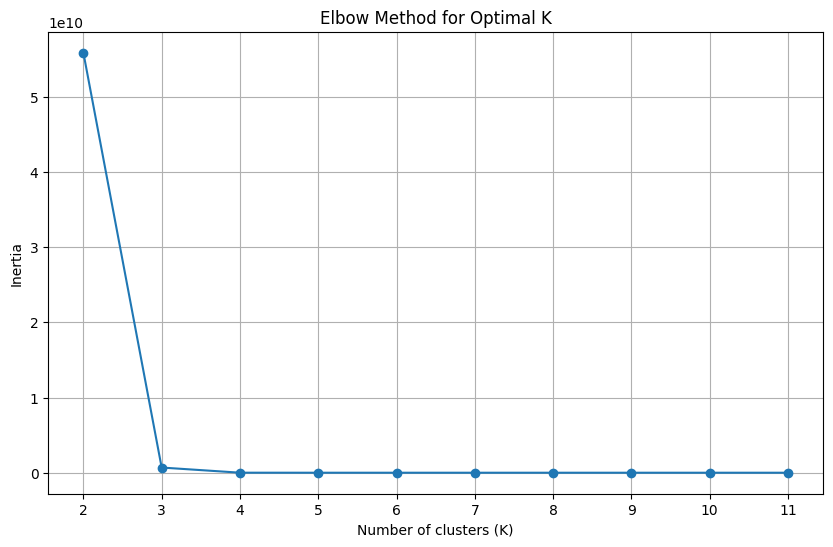

./elbow_test_export/SS-D_csv_10_86331_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0    100000.0         2        12      31491.0  29871.0000        2
1        10.0         2        15      19505.0      5.6023        1
2    100000.0         2        18      31825.0  28692.0000        2
3   1000000.0         3         3      19133.0   1814.2000        0
4     10000.0         3         9      18710.0   1802.8000        1
5     10000.0         2         6      29437.0   3740.0000        1
6       100.0         2         1       8746.0    117.5700        1
7    100000.0         1         6      27212.0  25993.0000        2
8    100000.0         6        15      25927.0    834.6100        2
9       100.0         1        12      20872.0     55.8860        1
10       10.0         3         3      14591.0      7.6695        1
11  1000000.0         2        18      65823.0  46988.0000        0
12  1000000.0         3        15      19319

<Figure size 640x480 with 0 Axes>

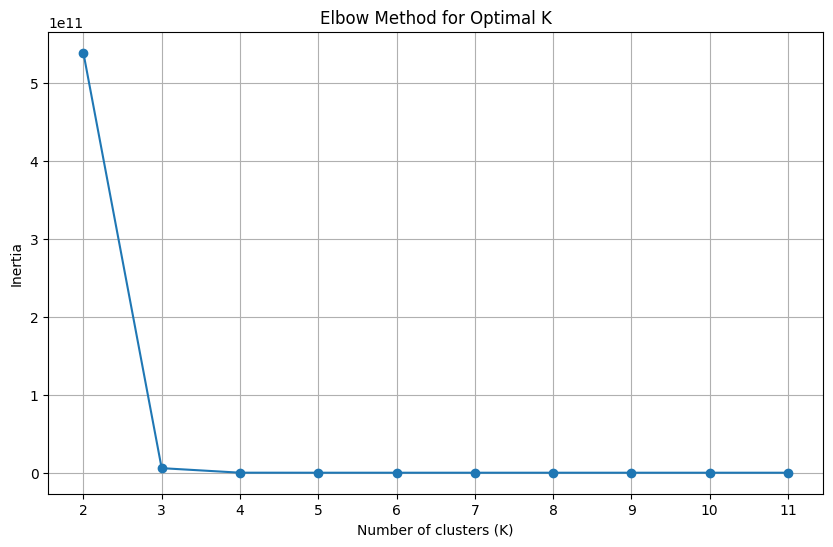

./elbow_test_export/SS-E_csv_100_11514_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+  Latency-  cluster
0    1000000.0         5        15      54619.0  965.7300        1
1      10000.0         6         3      42753.0  904.0300        0
2         10.0         5        16      29568.0    3.4202        0
3     100000.0         3        18      58816.0  812.4000        2
4     100000.0         6        16      47476.0  535.4500        2
..         ...       ...       ...          ...       ...      ...
495       10.0         2         4      31513.0    3.1552        0
496    10000.0         6        14      47003.0  494.8000        0
497     1000.0         3        12      60301.0  165.5000        0
498    10000.0         4         9      53002.0  914.2100        0
499      100.0         1         1      45494.0   22.1790        0

[500 rows x 6 columns]
[0.42985243068756523, 0.31047066247044297, 0.3049213859116544, nan]
[0.42985243068756523, 0.3104706

<Figure size 640x480 with 0 Axes>

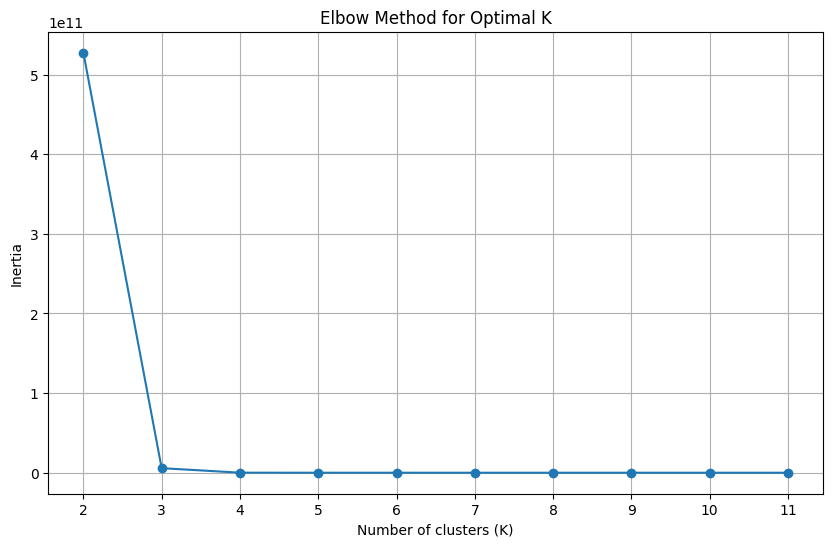

./elbow_test_export/SS-E_csv_100_19953_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       1000.0         2        14      63127.0    141.8100        0
1        100.0         1        13      54443.0     17.3280        0
2       1000.0         5        11      56833.0    182.6300        0
3       1000.0         4         5      48125.0    216.9500        0
4          1.0         4         9       6256.8      1.6328        0
..         ...       ...       ...          ...         ...      ...
495        1.0         3        18       6296.5      1.6335        0
496        1.0         4        10       6328.6      1.6178        0
497   100000.0         2         3      58901.0  15448.0000        2
498   100000.0         2        18      78561.0  11850.0000        2
499    10000.0         4        15      55474.0    803.0400        0

[500 rows x 6 columns]
[0.4418696811198296, 0.31764885734303283, 0.3154749565236596, nan]
[0.44186

<Figure size 640x480 with 0 Axes>

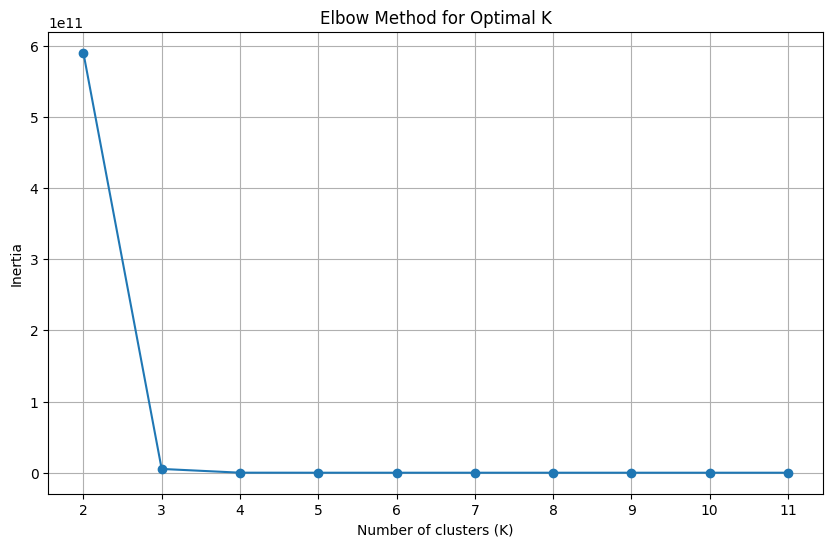

./elbow_test_export/SS-E_csv_100_3545_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0          1.0         4        17       6151.7     1.6312        0
1       1000.0         1         8      53505.0   174.8300        0
2    1000000.0         3        13      58196.0   753.0600        1
3      10000.0         1         1      50789.0  2008.5000        0
4         10.0         5        11      28365.0     3.4786        0
..         ...       ...       ...          ...        ...      ...
495     1000.0         3        17      59539.0   175.9000        0
496        1.0         5        14       6400.4     1.5555        0
497    10000.0         5        18      55113.0   791.6200        0
498     1000.0         6         4      45218.0   192.3700        0
499      100.0         2         5      47051.0    22.1100        0

[500 rows x 6 columns]
[0.43628728370828773, 0.30815846666746216, 0.31837317626325634, nan]
[0.4362872837082877

<Figure size 640x480 with 0 Axes>

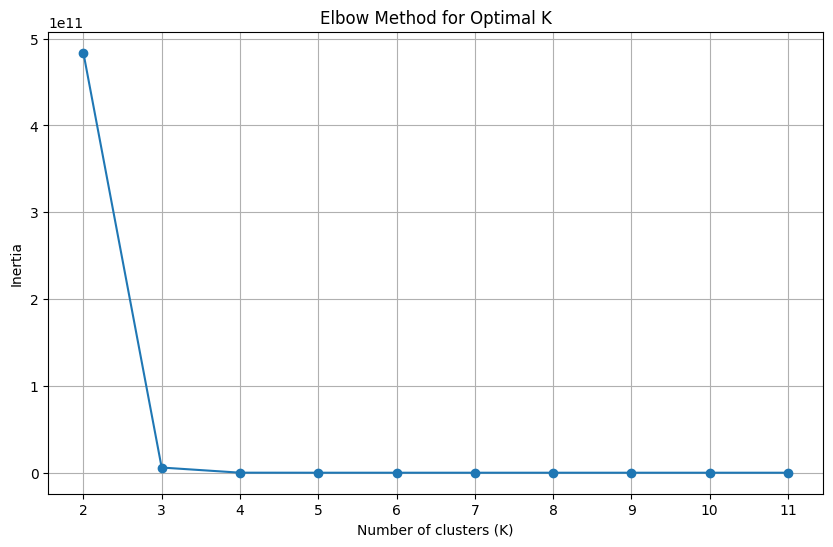

./elbow_test_export/SS-E_csv_100_39658_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0         10.0         1        12      28007.0     3.5948        0
1         10.0         6         8      31859.0     3.2040        0
2      10000.0         1         8      62588.0  1376.4000        0
3        100.0         1         8      51198.0    20.1360        0
4     100000.0         4        15      55649.0   878.4300        2
..         ...       ...       ...          ...        ...      ...
495   100000.0         4        12      54068.0   830.7900        2
496        1.0         1         5       5534.5     1.8374        0
497      100.0         1        17      53428.0    17.7980        0
498       10.0         3         4      32064.0     3.1989        0
499  1000000.0         3         3      43923.0   834.6600        1

[500 rows x 6 columns]
[0.43531287069330266, 0.32051740728581873, 0.3131017904545936, nan]
[0.4353128706933026

<Figure size 640x480 with 0 Axes>

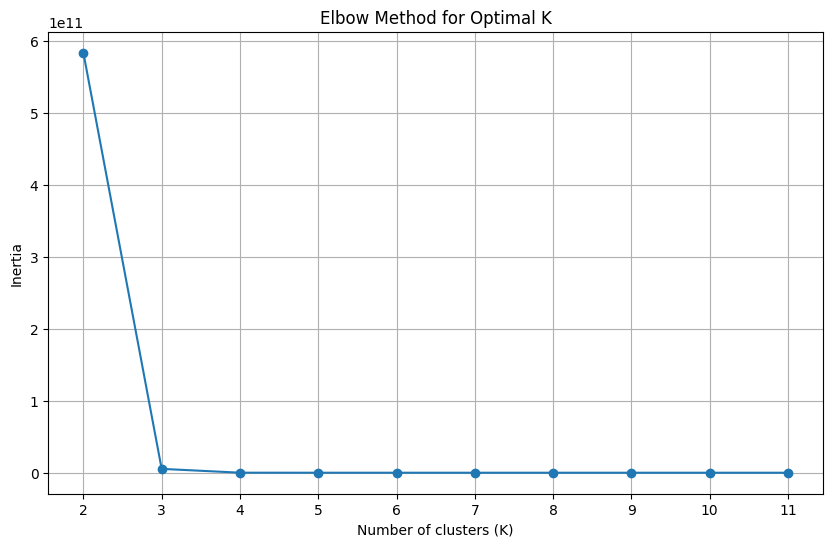

./elbow_test_export/SS-E_csv_100_40749_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0      10000.0         2        11      73286.0   1183.400        0
1       1000.0         4        11      57962.0    176.220        0
2    1000000.0         5         5      48852.0    821.360        1
3        100.0         2        12      54774.0     17.333        0
4     100000.0         4         2      33020.0   1152.000        2
..         ...       ...       ...          ...        ...      ...
495   100000.0         5         1      28325.0   1347.700        2
496   100000.0         4        15      55649.0    878.430        2
497   100000.0         3        18      58816.0    812.400        2
498  1000000.0         1        18      82514.0  44566.000        1
499  1000000.0         6         1      55673.0   6031.500        1

[500 rows x 6 columns]
[0.43926509338966147, 0.307672366335623, 0.32780593584354223, nan]
[0.43926509338966147

<Figure size 640x480 with 0 Axes>

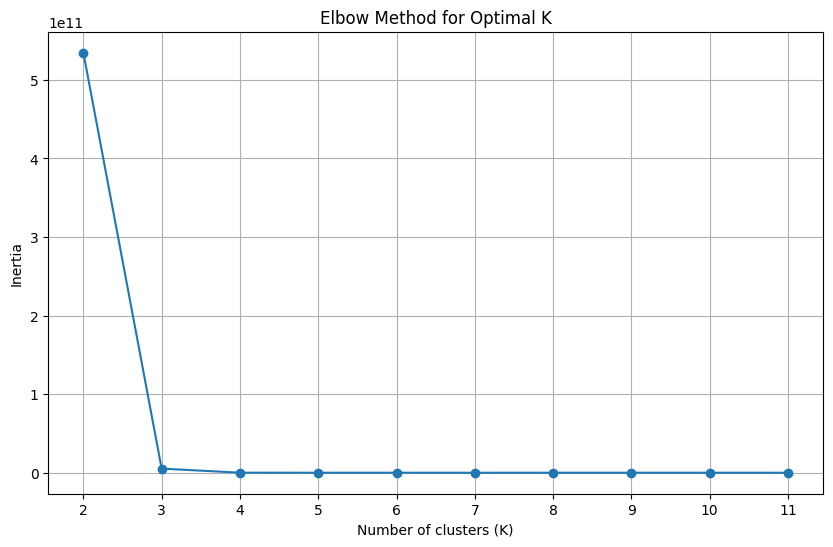

./elbow_test_export/SS-E_csv_100_44845_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        100.0         5        18      51769.0     19.3440        0
1        100.0         4        17      53212.0     19.8810        0
2         10.0         5        15      28524.0      3.5358        0
3     100000.0         1        15      64561.0  15257.0000        2
4          1.0         2        11       5378.1      1.8613        0
..         ...       ...       ...          ...         ...      ...
495       10.0         1        11      27273.0      3.5566        0
496  1000000.0         3        13      58196.0    753.0600        1
497      100.0         3        13      55170.0     18.3740        0
498     1000.0         3        17      59539.0    175.9000        0
499    10000.0         3         8      58858.0    748.6200        0

[500 rows x 6 columns]
[0.4392196824277905, 0.3138072583074568, 0.32166354454301527, nan]
[0.43921

<Figure size 640x480 with 0 Axes>

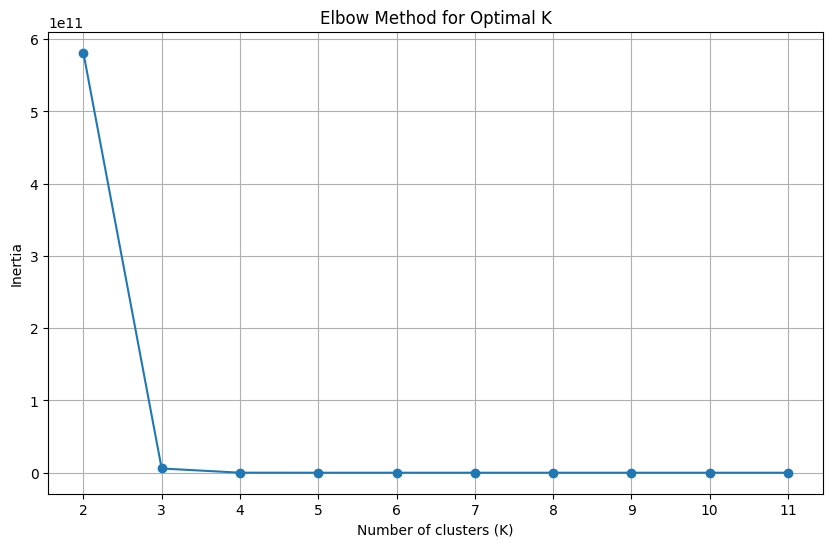

./elbow_test_export/SS-E_csv_100_51176_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0       1000.0         2        17      69097.0   127.6800        1
1      10000.0         4         3      36455.0  1007.8000        1
2          1.0         6         7       7767.6     1.3310        1
3      10000.0         4        14      54537.0   828.6200        1
4    1000000.0         3         9      58277.0   775.4500        0
..         ...       ...       ...          ...        ...      ...
495  1000000.0         4         8      49519.0   860.0100        0
496  1000000.0         4         7      55725.0   803.8200        0
497        1.0         1         2       5552.9     1.8259        1
498       10.0         6        10      31625.0     3.1312        1
499       10.0         6        17      29777.0     3.3335        1

[500 rows x 6 columns]
[0.3092006567580502, 0.436775192575759, 0.3222510519957364, nan]
[0.3092006567580502, 0

<Figure size 640x480 with 0 Axes>

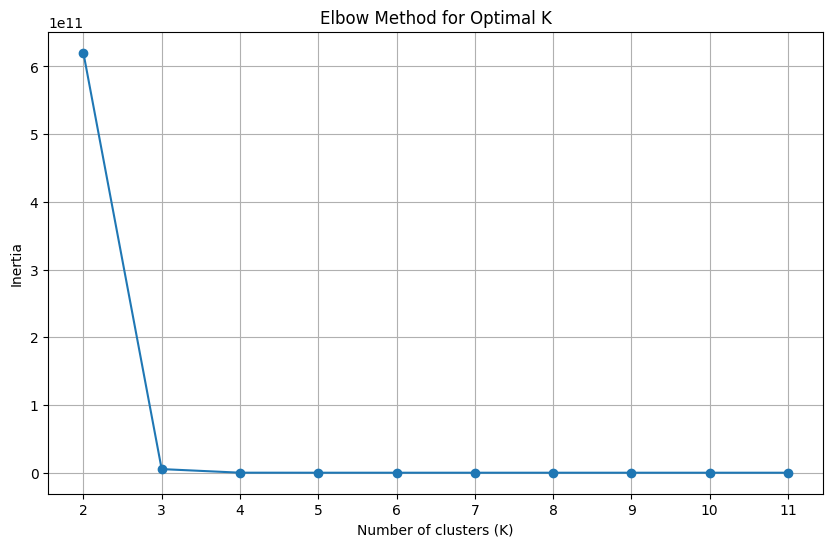

./elbow_test_export/SS-E_csv_100_58612_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         10.0         5        10      30269.0      3.3514        0
1     100000.0         5        10      55095.0    853.4100        2
2          1.0         3         6       7136.5      1.4391        0
3         10.0         5        13      28871.0      3.5410        0
4          1.0         4         4       6916.1      1.4471        0
..         ...       ...       ...          ...         ...      ...
495     1000.0         1         6      55423.0    176.6900        0
496       10.0         2         9      30945.0      3.2195        0
497     1000.0         4        14      55946.0    181.5700        0
498  1000000.0         2         7      71997.0  27969.0000        1
499   100000.0         1         5      60465.0  14235.0000        2

[500 rows x 6 columns]
[0.43525479248347704, 0.3172879295096622, 0.3158190363640726, nan]
[0.43525

<Figure size 640x480 with 0 Axes>

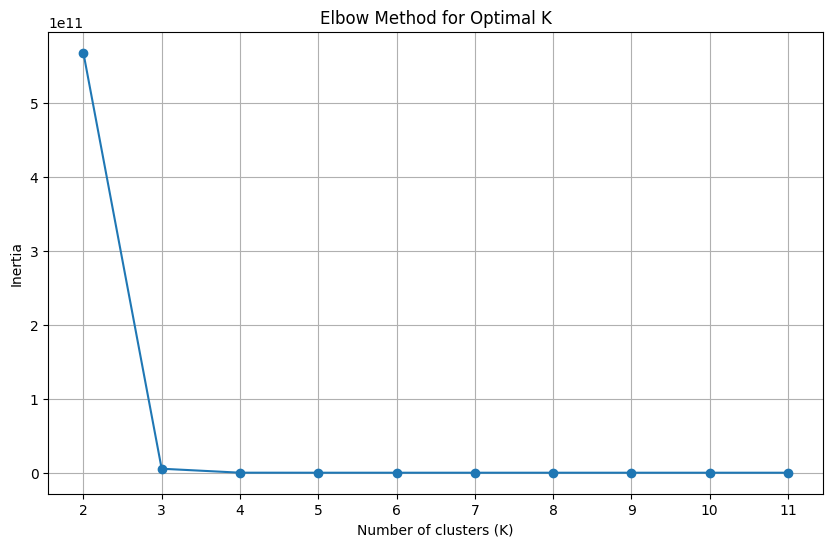

./elbow_test_export/SS-E_csv_100_61367_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       1000.0         2        17      69097.0    127.6800        0
1      10000.0         1         9      64300.0   1468.8000        0
2        100.0         6         6      46332.0     21.1470        0
3         10.0         3         2      32680.0      3.0580        0
4    1000000.0         4        15      56222.0    821.5300        1
..         ...       ...       ...          ...         ...      ...
495        1.0         6         3       7680.7      1.3299        0
496      100.0         4         3      39276.0     26.5000        0
497       10.0         1        15      27492.0      3.6191        0
498   100000.0         1        11      67729.0  12569.0000        2
499       10.0         1        16      27584.0      3.6382        0

[500 rows x 6 columns]
[0.44844712724395563, 0.3145726261971405, 0.30812984087088985, nan]
[0.4484

<Figure size 640x480 with 0 Axes>

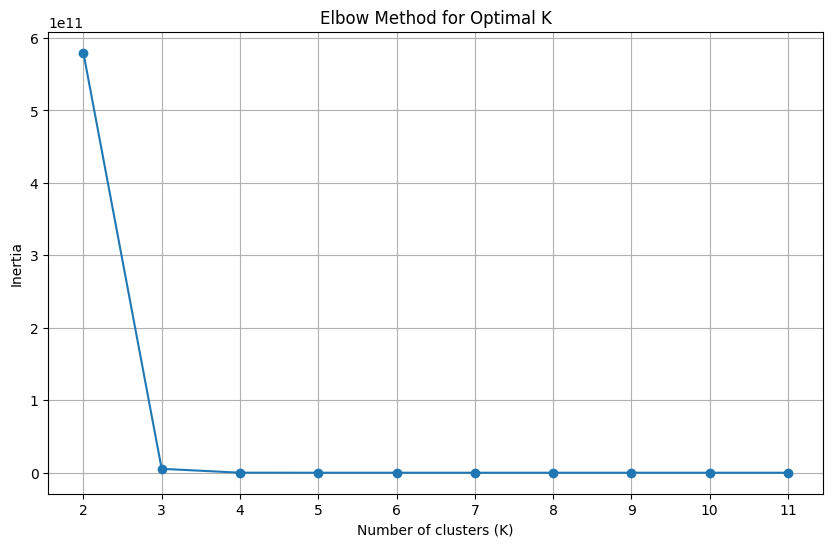

./elbow_test_export/SS-E_csv_100_65388_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0          1.0         6        11       7037.9      1.4329        2
1     100000.0         5         2      34813.0   1027.4000        0
2        100.0         3         8      53673.0     18.8190        2
3    1000000.0         3        16      54812.0    796.9100        1
4     100000.0         6         3      43781.0    877.3500        0
..         ...       ...       ...          ...         ...      ...
495       10.0         3         9      30268.0      3.3580        2
496   100000.0         4        16      57492.0    860.1300        0
497   100000.0         1         3      59297.0  15169.0000        0
498  1000000.0         6        10      45823.0    549.6900        1
499   100000.0         5        10      55095.0    853.4100        0

[500 rows x 6 columns]
[0.314251468459906, 0.31384476264408934, 0.4348823039039998, nan]
[0.314251

<Figure size 640x480 with 0 Axes>

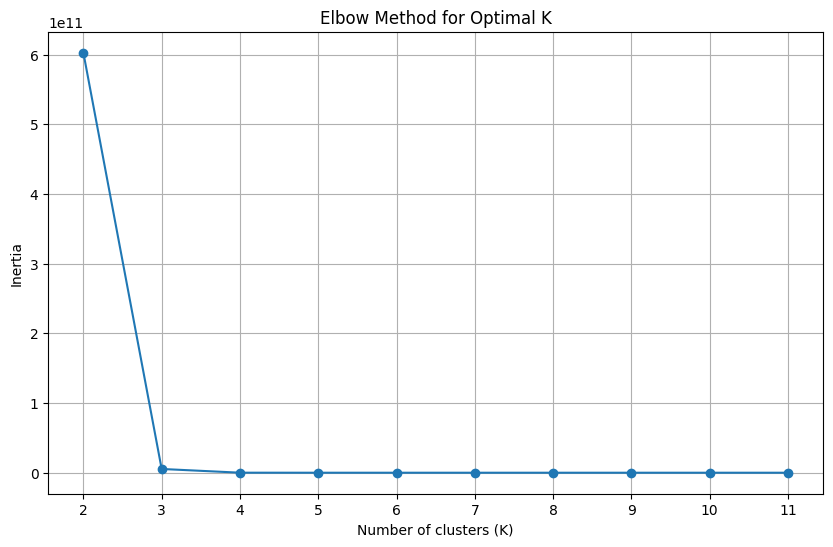

./elbow_test_export/SS-E_csv_100_65444_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       1000.0         5        13      59666.0    171.3000        0
1    1000000.0         4        10      54489.0    824.3600        1
2    1000000.0         2         6      68913.0  56665.0000        1
3    1000000.0         4        11      54485.0    799.5900        1
4      10000.0         4         1      55902.0   1726.8000        0
..         ...       ...       ...          ...         ...      ...
495        1.0         6         7       7767.6      1.3310        0
496      100.0         2         7      51649.0     19.8320        0
497        1.0         1         3       5529.9      1.8618        0
498  1000000.0         3        18      57632.0    871.2600        1
499   100000.0         2        12      79475.0  10377.0000        2

[500 rows x 6 columns]
[0.4289633122692936, 0.3168585441427957, 0.3128259883118151, nan]
[0.428963

<Figure size 640x480 with 0 Axes>

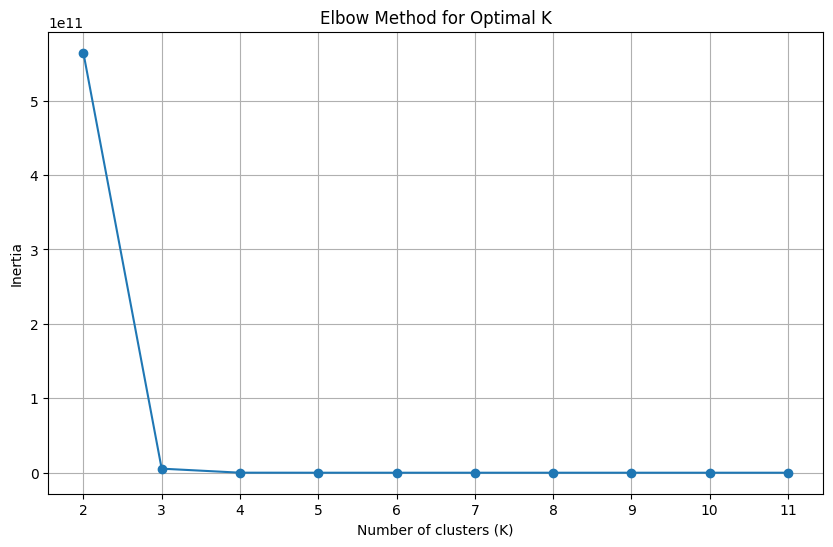

./elbow_test_export/SS-E_csv_100_66946_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+  Latency-  cluster
0    1000000.0         4         9      51861.0  857.0300        1
1          1.0         5        14       6400.4    1.5555        0
2          1.0         3         7       7266.3    1.4241        0
3          1.0         6         5       7532.7    1.3448        0
4       1000.0         1        17      64267.0  155.3900        0
..         ...       ...       ...          ...       ...      ...
495  1000000.0         6         8      46245.0  552.0100        1
496   100000.0         3         9      57433.0  925.4300        2
497      100.0         3        11      54634.0   18.1930        0
498      100.0         4         6      49121.0   20.6160        0
499  1000000.0         5        15      54619.0  965.7300        1

[500 rows x 6 columns]
[0.434918325655132, 0.31659727628845297, 0.32531991340501515, nan]
[0.434918325655132, 0.3165972762

<Figure size 640x480 with 0 Axes>

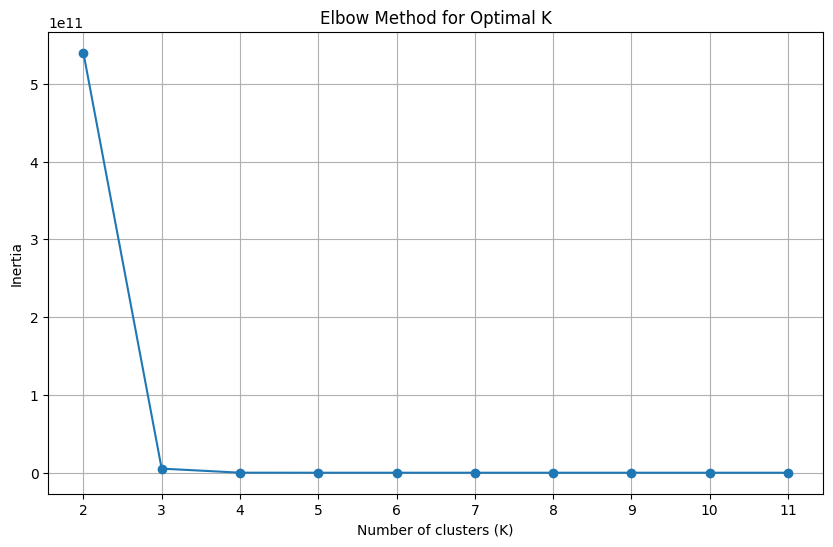

./elbow_test_export/SS-E_csv_100_69024_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0       1000.0         2         3      51798.0   195.3600        0
1        100.0         6        14      48914.0    19.0310        0
2         10.0         4         5      30406.0     3.3592        0
3         10.0         1         2      30487.0     3.2351        0
4        100.0         4        16      52702.0    18.7640        0
..         ...       ...       ...          ...        ...      ...
495  1000000.0         4         6      46966.0   853.6300        1
496  1000000.0         4        13      54540.0   792.3900        1
497    10000.0         4         7      58163.0   722.5800        0
498  1000000.0         5         1      28155.0  1546.7000        1
499    10000.0         2        11      73286.0  1183.4000        0

[500 rows x 6 columns]
[0.4311893970875078, 0.3069024982476413, 0.31028342135599274, nan]
[0.4311893970875078,

<Figure size 640x480 with 0 Axes>

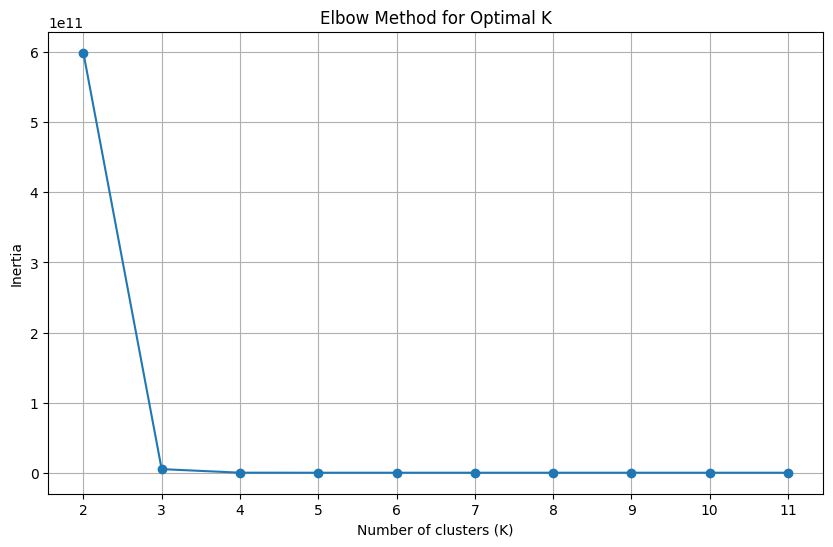

./elbow_test_export/SS-E_csv_100_70006_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       1000.0         4        10      55124.0    184.0600        0
1    1000000.0         6         1      55673.0   6031.5000        1
2         10.0         2        11      30705.0      3.2506        0
3        100.0         2         5      47051.0     22.1100        0
4         10.0         1         6      28862.0      3.5443        0
..         ...       ...       ...          ...         ...      ...
495    10000.0         2        11      73286.0   1183.4000        0
496      100.0         1        11      55611.0     17.0240        0
497        1.0         4         8       6386.8      1.5310        0
498  1000000.0         2        14      87119.0  26320.0000        1
499     1000.0         4         9      55281.0    186.2800        0

[500 rows x 6 columns]
[0.4427455037289394, 0.30508126928712065, 0.31124615407531125, nan]
[0.4427

<Figure size 640x480 with 0 Axes>

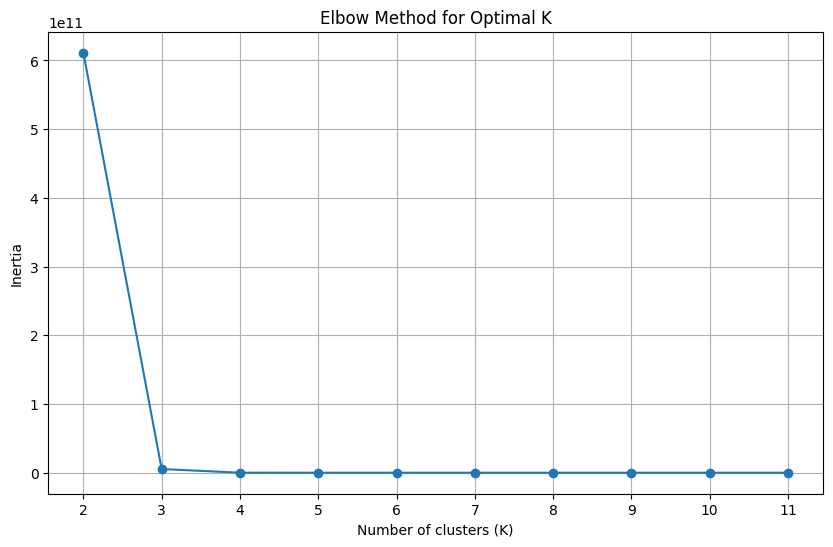

./elbow_test_export/SS-E_csv_100_70292_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0    1000000.0         4         2      31507.0   1210.1000        1
1          1.0         2         5       5846.6      1.8195        0
2        100.0         3         6      52614.0     19.2970        0
3          1.0         5         3       7040.8      1.4460        0
4          1.0         2         2       5801.6      1.7259        0
..         ...       ...       ...          ...         ...      ...
495  1000000.0         1        16      70303.0  60552.0000        1
496  1000000.0         6        18      47878.0    531.3200        1
497    10000.0         5        15      54627.0    810.0400        0
498  1000000.0         2         5      63131.0  81802.0000        1
499  1000000.0         1        14      95094.0  36603.0000        1

[500 rows x 6 columns]
[0.4379000056671038, 0.3121284002669585, 0.3080116511673989, nan]
[0.437900

<Figure size 640x480 with 0 Axes>

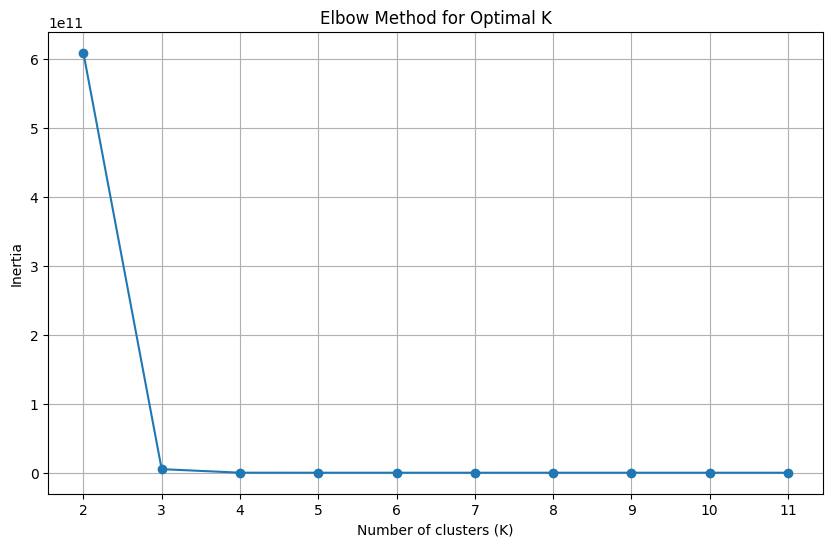

./elbow_test_export/SS-E_csv_100_77340_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0      10000.0         3        13      58653.0    736.470        0
1      10000.0         5        15      54627.0    810.040        0
2    1000000.0         2         3      61824.0  83512.000        1
3      10000.0         4        11      54605.0    791.700        0
4    1000000.0         1         1      66418.0  91578.000        1
..         ...       ...       ...          ...        ...      ...
495  1000000.0         3        12      58792.0    853.420        1
496    10000.0         5        13      55044.0    791.560        0
497      100.0         4         4      42733.0     24.039        0
498      100.0         5        18      51769.0     19.344        0
499  1000000.0         4        14      55471.0    842.900        1

[500 rows x 6 columns]
[0.4430678944977332, 0.3169320599735593, 0.3044006772374748, nan]
[0.4430678944977332, 

<Figure size 640x480 with 0 Axes>

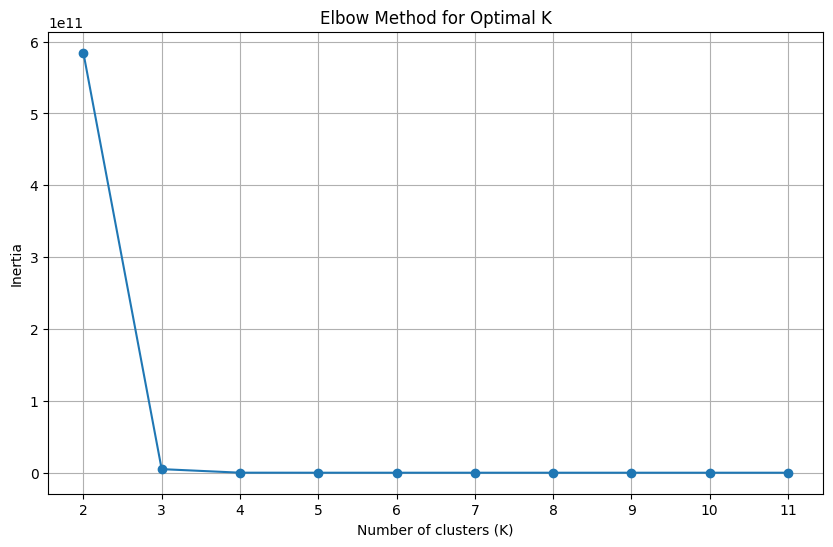

./elbow_test_export/SS-E_csv_100_77845_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        100.0         3         2      51763.0     19.5740        0
1    1000000.0         2         8      80544.0  30348.0000        1
2      10000.0         6         4      43014.0    743.2100        0
3      10000.0         3        16      57894.0    753.8100        0
4        100.0         1         1      45494.0     22.1790        0
..         ...       ...       ...          ...         ...      ...
495     1000.0         3        17      59539.0    175.9000        0
496        1.0         3         2       7468.3      1.3264        0
497     1000.0         3         5      50915.0    198.3300        0
498  1000000.0         3        15      59941.0    860.9200        1
499   100000.0         2         7      65050.0  11657.0000        2

[500 rows x 6 columns]
[0.44901601972540217, 0.31679408579839985, 0.3182196432098082, nan]
[0.4490

<Figure size 640x480 with 0 Axes>

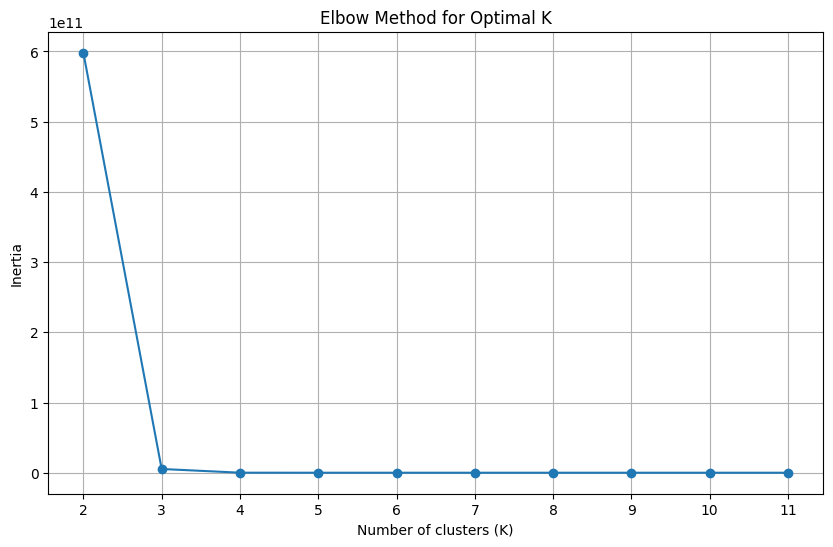

./elbow_test_export/SS-E_csv_100_83686_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0          1.0         1         7       5377.6      1.8759        0
1       1000.0         6         8      49745.0    161.9300        0
2    1000000.0         6         2      53945.0    447.4800        1
3     100000.0         2        11      76492.0  11936.0000        2
4    1000000.0         6         1      55673.0   6031.5000        1
..         ...       ...       ...          ...         ...      ...
495     1000.0         2         9      57605.0    168.9400        0
496       10.0         5         3      28968.0      3.4356        0
497    10000.0         6        10      45921.0    468.4400        0
498    10000.0         2         8      57685.0   1722.0000        0
499  1000000.0         1        12      85232.0  40805.0000        1

[500 rows x 6 columns]
[0.44993293780699994, 0.30805681505400634, 0.3137704894937817, nan]
[0.4499

<Figure size 640x480 with 0 Axes>

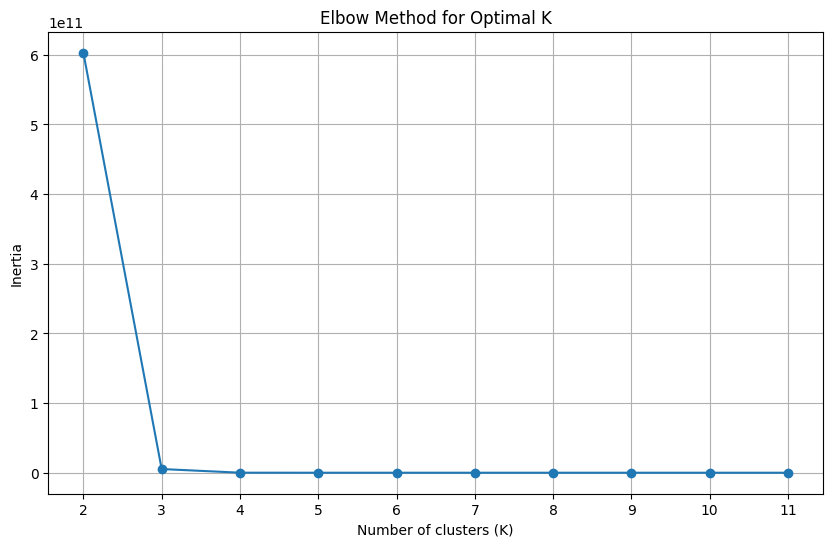

./elbow_test_export/SS-E_csv_100_84967_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+  Latency-  cluster
0        100.0         6        12      47366.0   20.0420        2
1        100.0         1         4      46717.0   22.1510        2
2          1.0         3         9       6753.5    1.5161        2
3       1000.0         2        16      63510.0  116.0600        2
4       1000.0         3        14      60581.0  167.9900        2
..         ...       ...       ...          ...       ...      ...
495       10.0         4         6      30674.0    3.2740        2
496      100.0         6         8      47814.0   19.5470        2
497       10.0         1         2      30487.0    3.2351        2
498     1000.0         3        13      59795.0  172.8200        2
499      100.0         3        13      55170.0   18.3740        2

[500 rows x 6 columns]
[0.3116730119873625, 0.31040020482914876, 0.4407446877942842, nan]
[0.3116730119873625, 0.310400204

<Figure size 640x480 with 0 Axes>

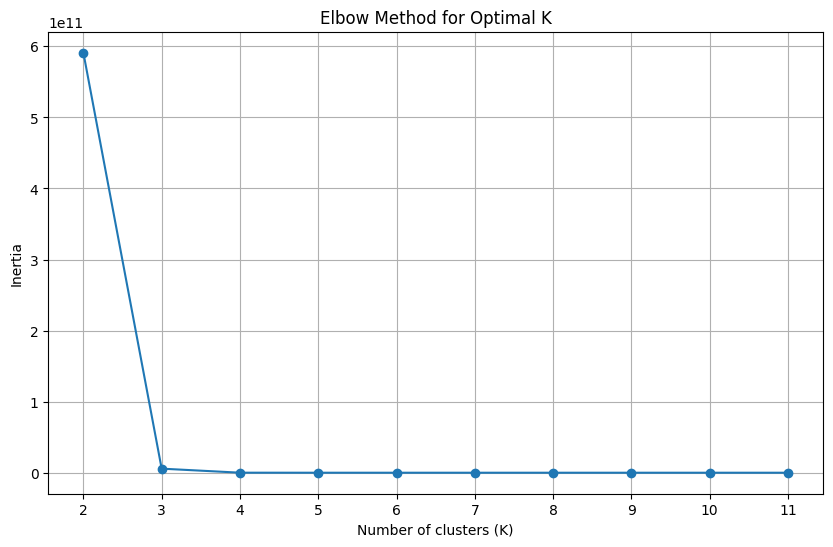

./elbow_test_export/SS-E_csv_100_86331_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0     100000.0         4        11      55317.0   784.3400        0
1         10.0         3        17      29452.0     3.4393        2
2     100000.0         5         1      28325.0  1347.7000        0
3    1000000.0         5        14      50915.0   811.7000        1
4      10000.0         5        15      54627.0   810.0400        2
..         ...       ...       ...          ...        ...      ...
495     1000.0         4         9      55281.0   186.2800        2
496   100000.0         6         9      45395.0   528.0300        0
497  1000000.0         6        14      48325.0   518.2600        1
498       10.0         3         4      32064.0     3.1989        2
499   100000.0         6        16      47476.0   535.4500        0

[500 rows x 6 columns]
[0.31795192430543107, 0.3141230558963352, 0.4401414059143394, nan]
[0.31795192430543107

<Figure size 640x480 with 0 Axes>

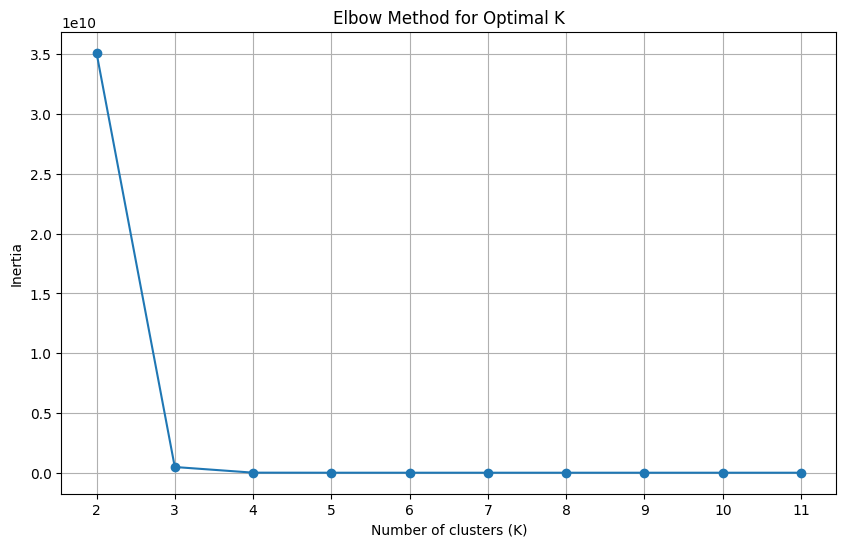

./elbow_test_export/SS-E_csv_10_11514_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         5        15      54619.0    965.7300        1
1     10000.0         6         3      42753.0    904.0300        0
2        10.0         5        16      29568.0      3.4202        0
3    100000.0         3        18      58816.0    812.4000        2
4    100000.0         6        16      47476.0    535.4500        2
5   1000000.0         2        10      90483.0  40896.0000        1
6   1000000.0         2         7      71997.0  27969.0000        1
7       100.0         5         3      40247.0     25.3470        0
8       100.0         6         6      46332.0     21.1470        0
9   1000000.0         3        10      56862.0    827.5500        1
10   100000.0         4         4      40355.0    897.7500        2
11       10.0         5        17      28762.0      3.4509        0
12    10000.0         3         3      40776

<Figure size 640x480 with 0 Axes>

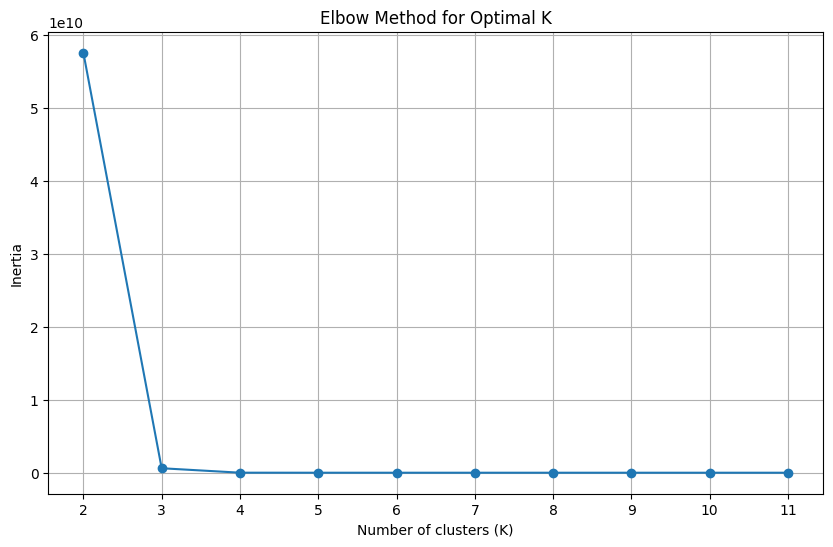

./elbow_test_export/SS-E_csv_10_19953_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         2        14      63127.0    141.8100        0
1       100.0         1        13      54443.0     17.3280        0
2      1000.0         5        11      56833.0    182.6300        0
3      1000.0         4         5      48125.0    216.9500        0
4         1.0         4         9       6256.8      1.6328        0
5   1000000.0         2        14      87119.0  26320.0000        1
6    100000.0         2         8      61056.0  14804.0000        2
7        10.0         5         6      30234.0      3.3410        0
8         1.0         3         9       6753.5      1.5161        0
9     10000.0         2        13      71459.0    387.5700        0
10       10.0         1         8      28536.0      3.5172        0
11      100.0         2        18      55966.0     16.9270        0
12       10.0         3        17      29452

<Figure size 640x480 with 0 Axes>

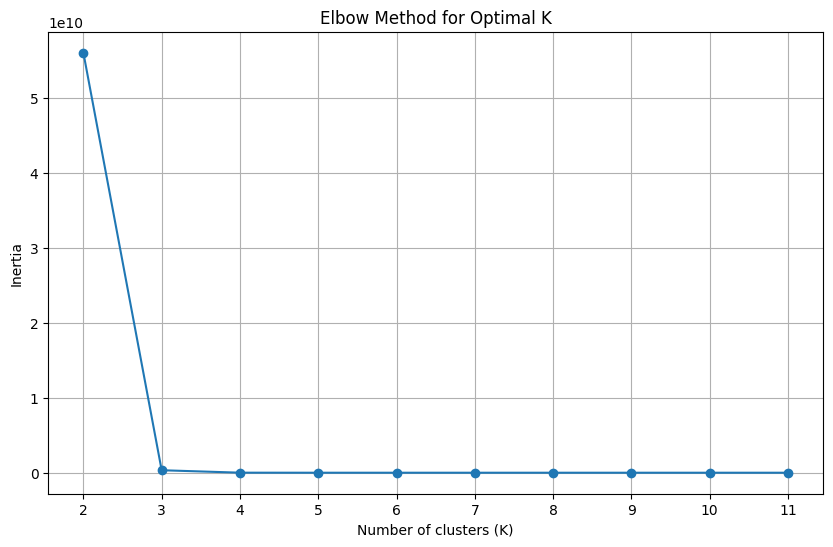

./elbow_test_export/SS-E_csv_10_3545_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         4        17       6151.7      1.6312        0
1      1000.0         1         8      53505.0    174.8300        0
2   1000000.0         3        13      58196.0    753.0600        1
3     10000.0         1         1      50789.0   2008.5000        0
4        10.0         5        11      28365.0      3.4786        0
5      1000.0         6        16      45229.0    193.4500        0
6        10.0         5         5      31592.0      3.2717        0
7        10.0         4        11      29849.0      3.3491        0
8         1.0         1        17       5190.9      1.9543        0
9    100000.0         3        13      57626.0    886.6700        2
10   100000.0         5        15      55162.0   1249.1000        2
11       10.0         3         7      30044.0      3.3138        0
12  1000000.0         3         8      58117.

<Figure size 640x480 with 0 Axes>

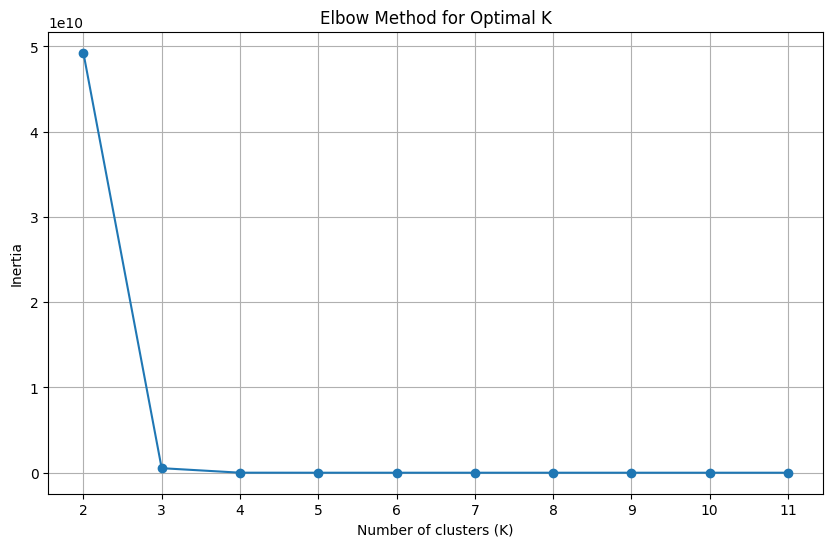

./elbow_test_export/SS-E_csv_10_39658_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        10.0         1        12      28007.0      3.5948        2
1        10.0         6         8      31859.0      3.2040        2
2     10000.0         1         8      62588.0   1376.4000        2
3       100.0         1         8      51198.0     20.1360        2
4    100000.0         4        15      55649.0    878.4300        0
5     10000.0         6         1      56278.0   1267.7000        2
6   1000000.0         1         7      65052.0  71448.0000        1
7       100.0         6        14      48914.0     19.0310        2
8        10.0         6         4      32233.0      3.1626        2
9        10.0         3        17      29452.0      3.4393        2
10    10000.0         5         5      46750.0    815.8900        2
11  1000000.0         4        15      56222.0    821.5300        1
12        1.0         1         2       5552

<Figure size 640x480 with 0 Axes>

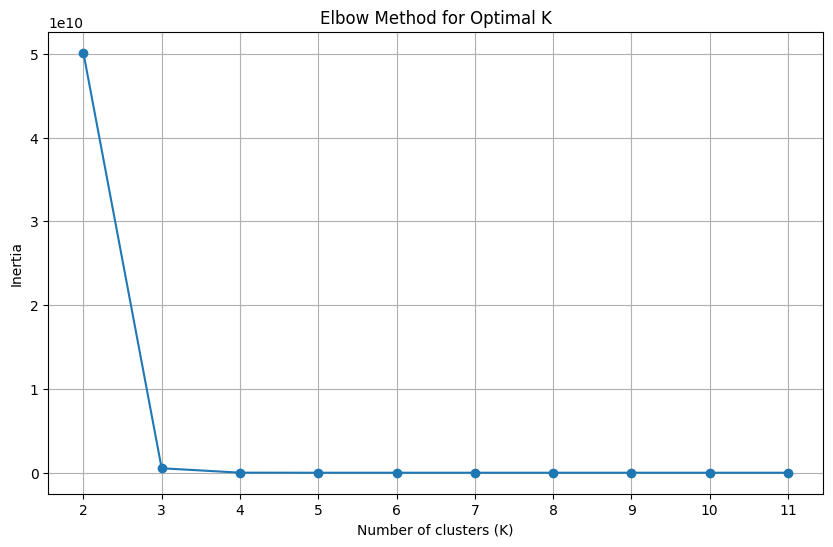

./elbow_test_export/SS-E_csv_10_40749_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0     10000.0         2        11      73286.0   1183.4000        0
1      1000.0         4        11      57962.0    176.2200        0
2   1000000.0         5         5      48852.0    821.3600        1
3       100.0         2        12      54774.0     17.3330        0
4    100000.0         4         2      33020.0   1152.0000        2
5      1000.0         5         5      49159.0    205.9900        0
6       100.0         4         4      42733.0     24.0390        0
7     10000.0         3        11      58125.0    823.4500        0
8   1000000.0         4         6      46966.0    853.6300        1
9     10000.0         3         1      51479.0   1811.1000        0
10  1000000.0         3         4      52085.0   1052.8000        1
11   100000.0         3        12      56804.0    806.5200        2
12   100000.0         6        17      44254

<Figure size 640x480 with 0 Axes>

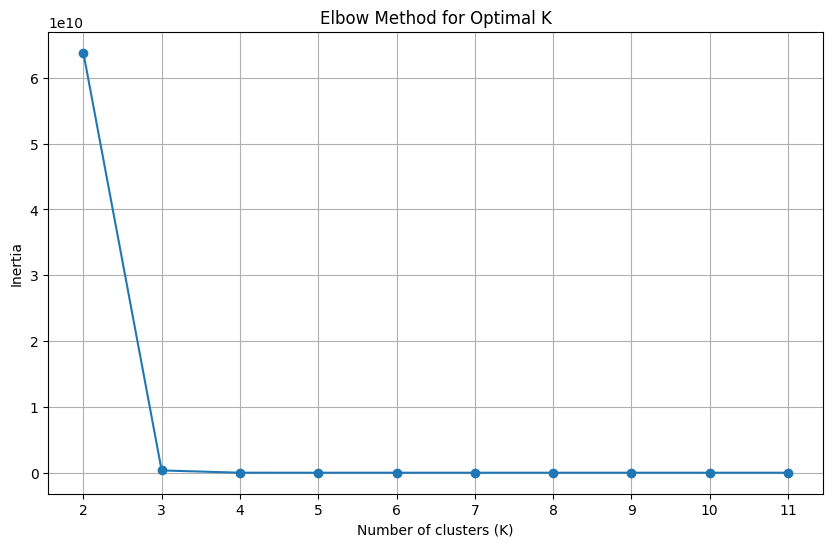

./elbow_test_export/SS-E_csv_10_44845_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         5        18      51769.0     19.3440        0
1       100.0         4        17      53212.0     19.8810        0
2        10.0         5        15      28524.0      3.5358        0
3    100000.0         1        15      64561.0  15257.0000        2
4         1.0         2        11       5378.1      1.8613        0
5     10000.0         2        12      74141.0   1169.3000        0
6        10.0         4         7      30177.0      3.3191        0
7      1000.0         6        10      45031.0    177.5200        0
8        10.0         1         7      29503.0      3.4534        0
9         1.0         3         5       7130.9      1.4207        0
10       10.0         3         2      32680.0      3.0580        0
11       10.0         3         4      32064.0      3.1989        0
12   100000.0         2         3      58901

<Figure size 640x480 with 0 Axes>

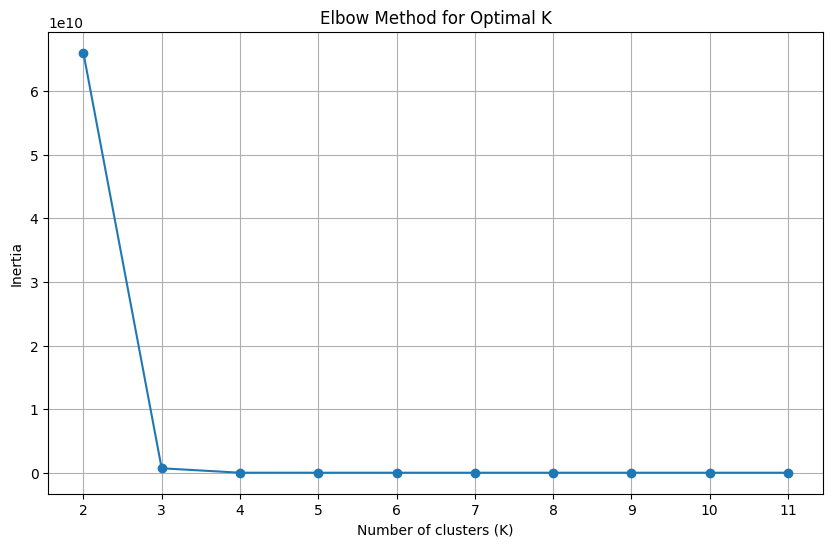

./elbow_test_export/SS-E_csv_10_51176_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         2        17      69097.0    127.6800        0
1     10000.0         4         3      36455.0   1007.8000        0
2         1.0         6         7       7767.6      1.3310        0
3     10000.0         4        14      54537.0    828.6200        0
4   1000000.0         3         9      58277.0    775.4500        1
5      1000.0         2         6      53012.0    197.9600        0
6       100.0         4         1      46605.0     22.2060        0
7      1000.0         6         1      51216.0    176.2800        0
8       100.0         6        17      42239.0     21.3750        0
9     10000.0         5        12      56196.0    775.4500        0
10        1.0         2        17       5381.0      1.9208        0
11  1000000.0         4         4      41062.0    897.4300        1
12   100000.0         3         6      54630

<Figure size 640x480 with 0 Axes>

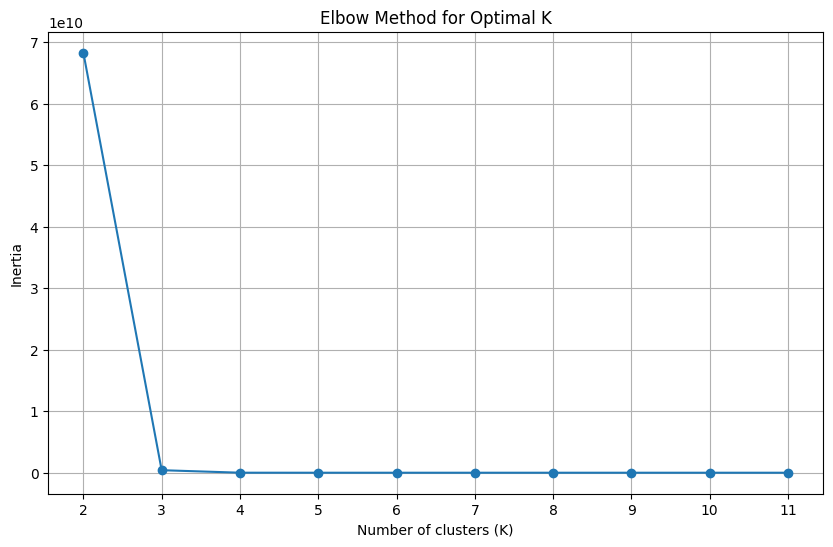

./elbow_test_export/SS-E_csv_10_58612_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        10.0         5        10      30269.0      3.3514        1
1    100000.0         5        10      55095.0    853.4100        2
2         1.0         3         6       7136.5      1.4391        1
3        10.0         5        13      28871.0      3.5410        1
4         1.0         4         4       6916.1      1.4471        1
5         1.0         4         8       6386.8      1.5310        1
6   1000000.0         3        10      56862.0    827.5500        0
7         1.0         2        11       5378.1      1.8613        1
8       100.0         4        18      50439.0     19.9120        1
9         1.0         2        15       5381.5      1.8954        1
10  1000000.0         1        16      70303.0  60552.0000        0
11   100000.0         1         7      61873.0  16088.0000        2
12    10000.0         3        18      57586

<Figure size 640x480 with 0 Axes>

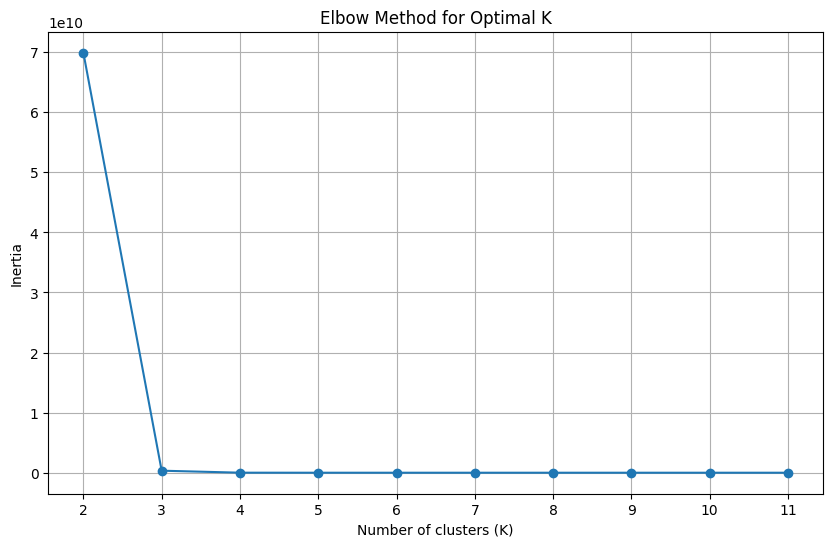

./elbow_test_export/SS-E_csv_10_61367_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         2        17      69097.0    127.6800        2
1     10000.0         1         9      64300.0   1468.8000        2
2       100.0         6         6      46332.0     21.1470        2
3        10.0         3         2      32680.0      3.0580        2
4   1000000.0         4        15      56222.0    821.5300        1
5       100.0         4        12      50747.0     19.6860        2
6   1000000.0         1        18      82514.0  44566.0000        1
7        10.0         3        11      30027.0      3.3538        2
8        10.0         5        15      28524.0      3.5358        2
9         1.0         5         4       6534.9      1.5195        2
10   100000.0         2         7      65050.0  11657.0000        0
11     1000.0         1         8      53505.0    174.8300        2
12      100.0         6        14      48914

<Figure size 640x480 with 0 Axes>

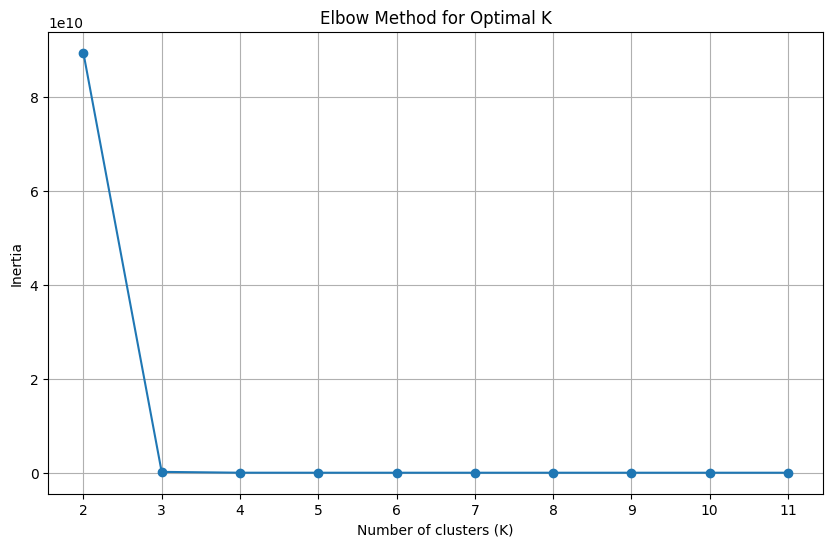

./elbow_test_export/SS-E_csv_10_65388_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         6        11       7037.9      1.4329        0
1    100000.0         5         2      34813.0   1027.4000        2
2       100.0         3         8      53673.0     18.8190        0
3   1000000.0         3        16      54812.0    796.9100        1
4    100000.0         6         3      43781.0    877.3500        2
5    100000.0         5        13      53807.0    840.3300        2
6       100.0         4        15      52719.0     19.1390        0
7       100.0         1         8      51198.0     20.1360        0
8   1000000.0         3         2      64297.0    720.3500        1
9        10.0         2         8      31045.0      3.2466        0
10       10.0         5        17      28762.0      3.4509        0
11        1.0         1        14       5042.6      1.9422        0
12  1000000.0         6         9      45737

<Figure size 640x480 with 0 Axes>

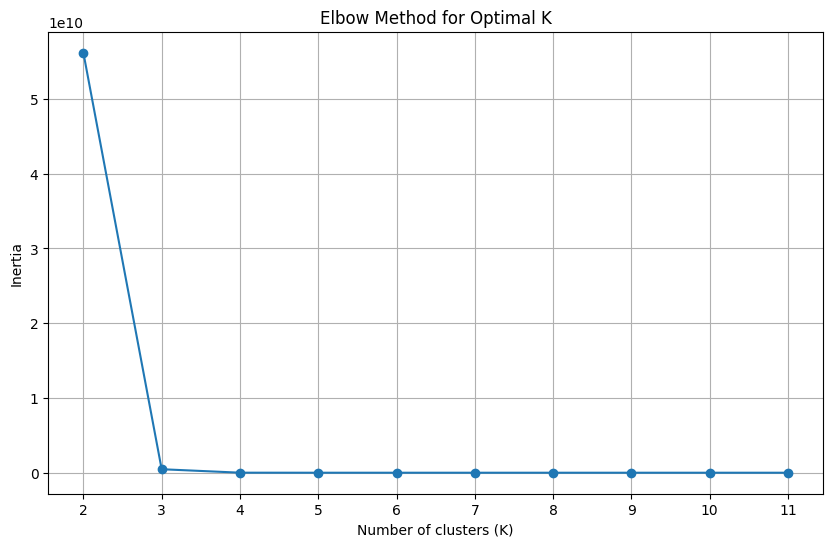

./elbow_test_export/SS-E_csv_10_65444_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         5        13      59666.0    171.3000        0
1   1000000.0         4        10      54489.0    824.3600        1
2   1000000.0         2         6      68913.0  56665.0000        1
3   1000000.0         4        11      54485.0    799.5900        1
4     10000.0         4         1      55902.0   1726.8000        0
5         1.0         2         6       5546.3      1.8161        0
6    100000.0         1        13      65445.0  14273.0000        2
7       100.0         2        13      57293.0     15.9400        0
8    100000.0         6        13      46049.0    552.5600        2
9         1.0         4        12       6686.6      1.5439        0
10      100.0         2        11      57860.0     16.3930        0
11   100000.0         1         5      60465.0  14235.0000        2
12      100.0         3         1      46137

<Figure size 640x480 with 0 Axes>

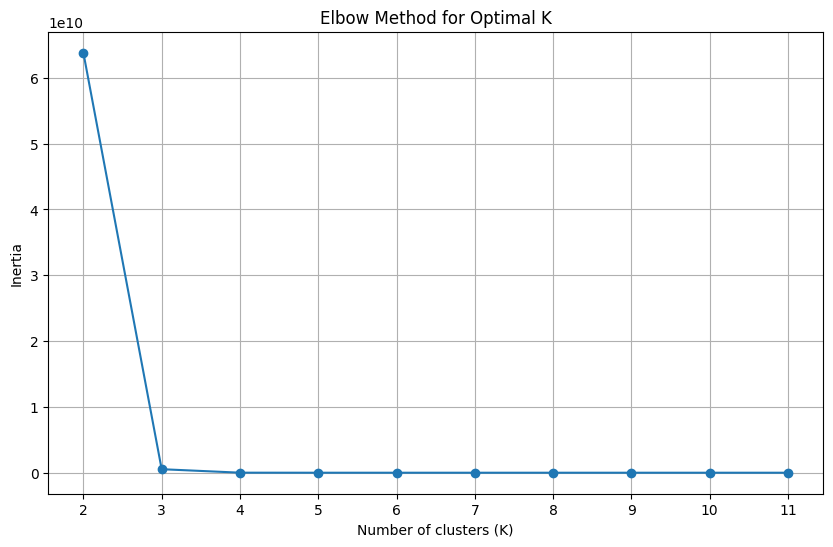

./elbow_test_export/SS-E_csv_10_66946_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         4         9      51861.0    857.0300        1
1         1.0         5        14       6400.4      1.5555        0
2         1.0         3         7       7266.3      1.4241        0
3         1.0         6         5       7532.7      1.3448        0
4      1000.0         1        17      64267.0    155.3900        0
5        10.0         5        11      28365.0      3.4786        0
6     10000.0         6        13      46248.0    522.7800        0
7    100000.0         2        12      79475.0  10377.0000        2
8       100.0         2        17      55616.0     17.0360        0
9      1000.0         6         9      47213.0    181.5700        0
10     1000.0         5         1      30328.0    339.9400        0
11       10.0         2        16      30324.0      3.2671        0
12    10000.0         4         4      39796

<Figure size 640x480 with 0 Axes>

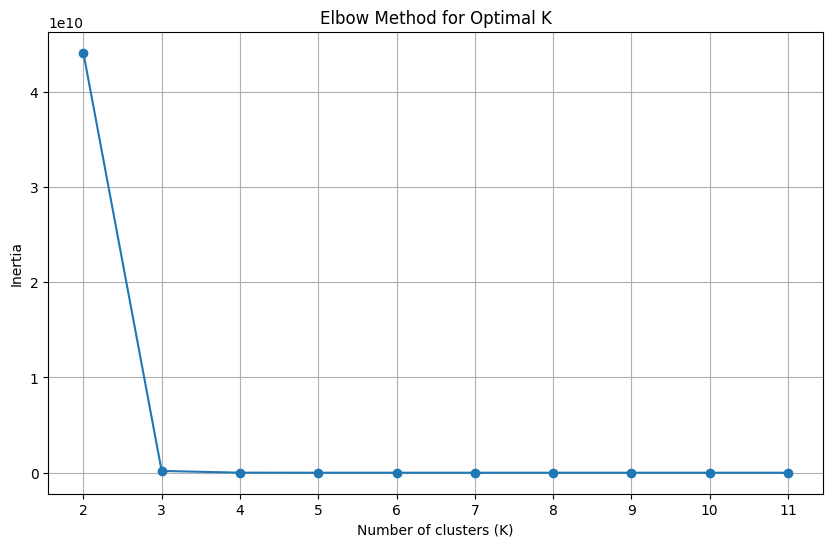

./elbow_test_export/SS-E_csv_10_69024_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         2         3      51798.0    195.3600        0
1       100.0         6        14      48914.0     19.0310        0
2        10.0         4         5      30406.0      3.3592        0
3        10.0         1         2      30487.0      3.2351        0
4       100.0         4        16      52702.0     18.7640        0
5         1.0         6         4       7690.8      1.3000        0
6       100.0         4        17      53212.0     19.8810        0
7    100000.0         5         2      34813.0   1027.4000        2
8       100.0         1         2      46286.0     22.1030        0
9       100.0         5         1      30879.0     32.6950        0
10     1000.0         5        14      56967.0    179.5300        0
11       10.0         4         4      30830.0      3.2615        0
12     1000.0         2        11      61353

<Figure size 640x480 with 0 Axes>

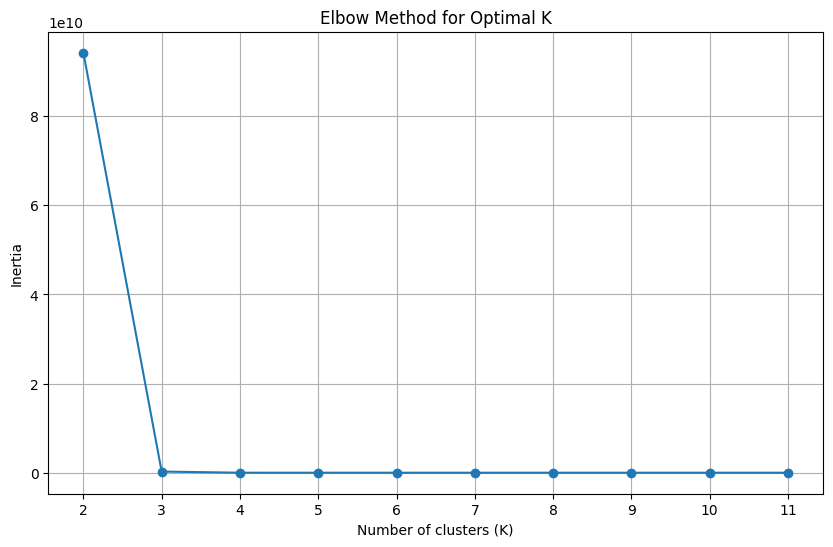

./elbow_test_export/SS-E_csv_10_70006_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         4        10      55124.0    184.0600        2
1   1000000.0         6         1      55673.0   6031.5000        1
2        10.0         2        11      30705.0      3.2506        2
3       100.0         2         5      47051.0     22.1100        2
4        10.0         1         6      28862.0      3.5443        2
5   1000000.0         3         3      43923.0    834.6600        1
6   1000000.0         2        15      77306.0  17328.0000        1
7       100.0         1        14      53658.0     17.3610        2
8      1000.0         2         4      48976.0    203.1200        2
9     10000.0         4         8      46546.0    851.1600        2
10   100000.0         5         5      44880.0    841.3300        0
11   100000.0         2        11      76492.0  11936.0000        0
12        1.0         1        14       5042

<Figure size 640x480 with 0 Axes>

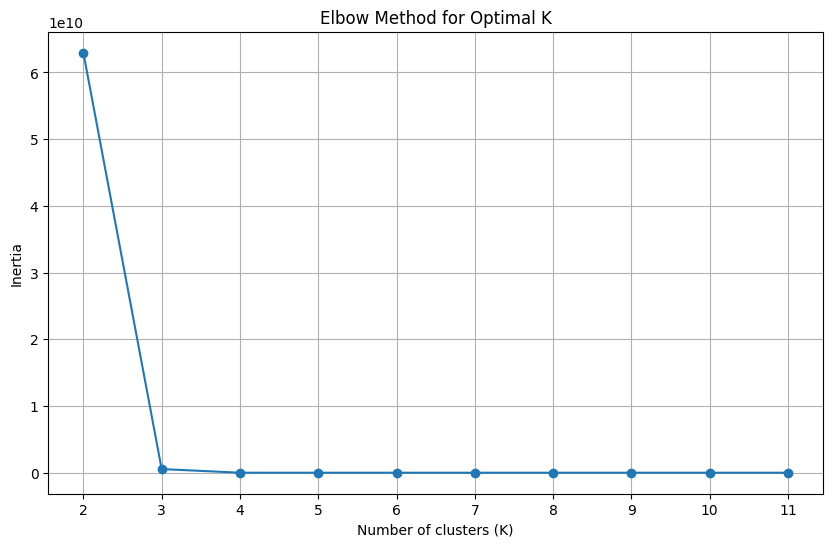

./elbow_test_export/SS-E_csv_10_70292_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         4         2      31507.0   1210.1000        1
1         1.0         2         5       5846.6      1.8195        0
2       100.0         3         6      52614.0     19.2970        0
3         1.0         5         3       7040.8      1.4460        0
4         1.0         2         2       5801.6      1.7259        0
5     10000.0         1         7      59942.0   1727.8000        0
6         1.0         6        15       7042.3      1.4358        0
7    100000.0         6         8      47573.0    476.8500        2
8    100000.0         2         3      58901.0  15448.0000        2
9         1.0         1         8       5377.4      1.8902        0
10      100.0         4        15      52719.0     19.1390        0
11    10000.0         5        18      55113.0    791.6200        0
12     1000.0         5        16      53494

<Figure size 640x480 with 0 Axes>

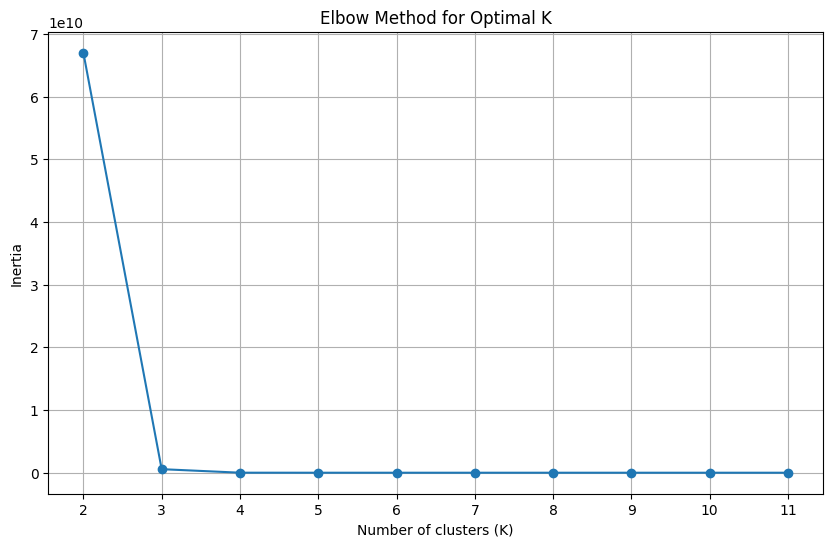

./elbow_test_export/SS-E_csv_10_77340_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0     10000.0         3        13      58653.0    736.4700        0
1     10000.0         5        15      54627.0    810.0400        0
2   1000000.0         2         3      61824.0  83512.0000        1
3     10000.0         4        11      54605.0    791.7000        0
4   1000000.0         1         1      66418.0  91578.0000        1
5    100000.0         6        11      48833.0    528.0200        2
6     10000.0         5         8      53575.0    770.3700        0
7      1000.0         4        12      54865.0    184.3600        0
8      1000.0         1         6      55423.0    176.6900        0
9        10.0         1         9      28657.0      3.4184        0
10        1.0         1        11       5300.4      1.9305        0
11  1000000.0         4        18      55566.0    952.8600        1
12    10000.0         1        12      62552

<Figure size 640x480 with 0 Axes>

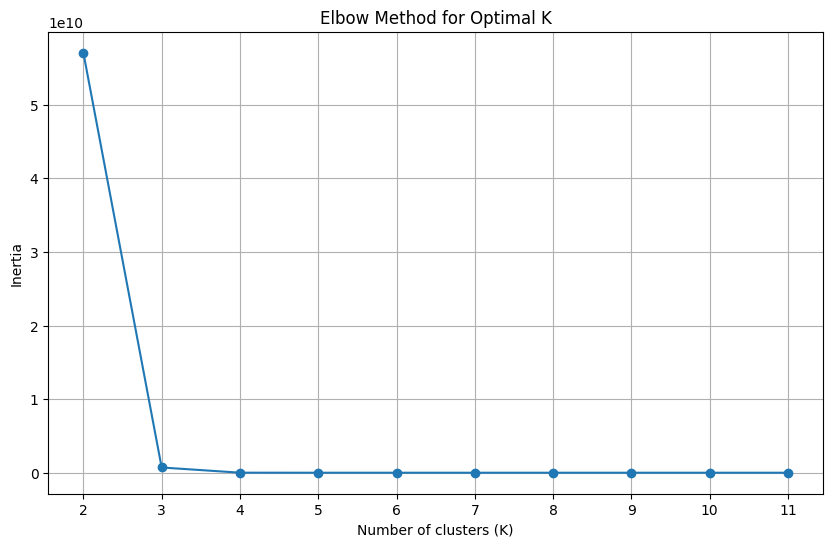

./elbow_test_export/SS-E_csv_10_77845_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         3         2      51763.0     19.5740        0
1   1000000.0         2         8      80544.0  30348.0000        1
2     10000.0         6         4      43014.0    743.2100        0
3     10000.0         3        16      57894.0    753.8100        0
4       100.0         1         1      45494.0     22.1790        0
5    100000.0         5         1      28325.0   1347.7000        2
6     10000.0         6         8      48377.0    453.5000        0
7       100.0         6         4      43909.0     22.2360        0
8     10000.0         6        14      47003.0    494.8000        0
9        10.0         4        14      30010.0      3.3890        0
10    10000.0         4         5      44606.0    876.8300        0
11       10.0         5         7      29903.0      3.3740        0
12     1000.0         5         1      30328

<Figure size 640x480 with 0 Axes>

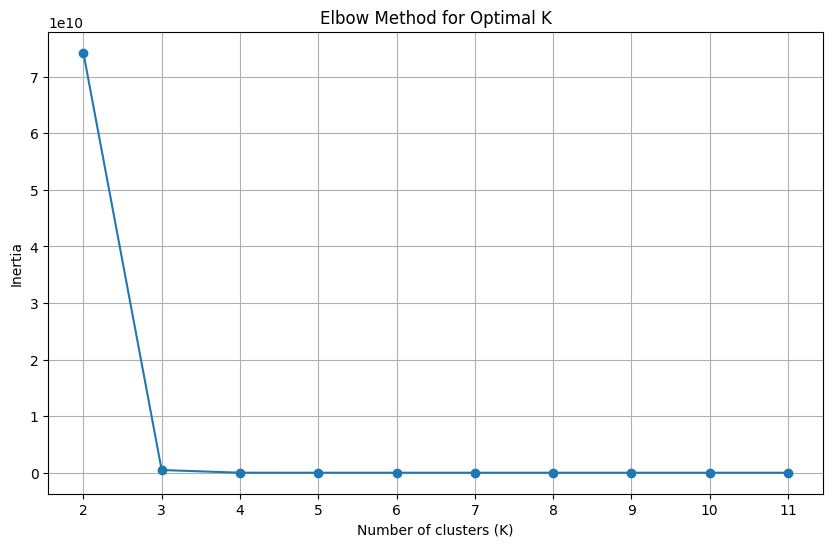

./elbow_test_export/SS-E_csv_10_83686_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         1         7       5377.6      1.8759        0
1      1000.0         6         8      49745.0    161.9300        0
2   1000000.0         6         2      53945.0    447.4800        1
3    100000.0         2        11      76492.0  11936.0000        2
4   1000000.0         6         1      55673.0   6031.5000        1
5     10000.0         1         4      64087.0   1529.5000        0
6       100.0         3         8      53673.0     18.8190        0
7       100.0         6         7      40728.0     24.3830        0
8       100.0         5        15      52117.0     19.1990        0
9     10000.0         6         6      44504.0    552.3800        0
10  1000000.0         5        18      54890.0    829.2800        1
11        1.0         1         6       5420.2      1.8391        0
12       10.0         4         7      30177

<Figure size 640x480 with 0 Axes>

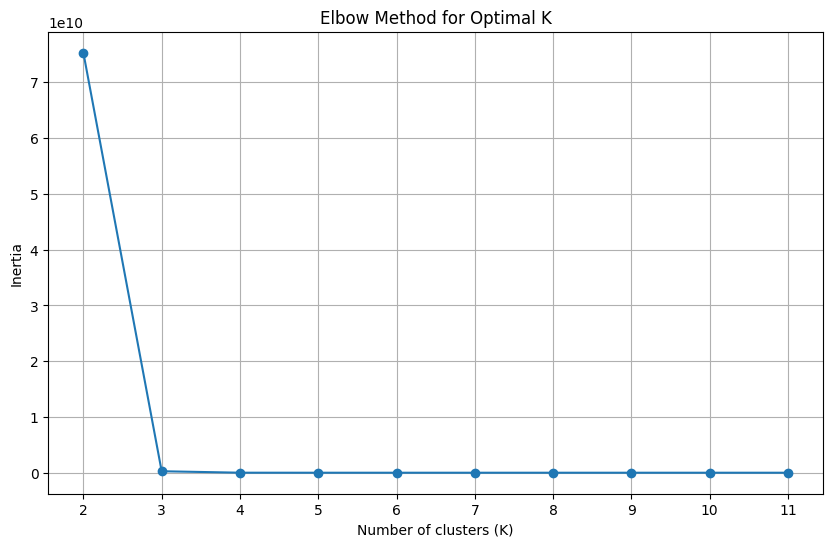

./elbow_test_export/SS-E_csv_10_84967_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         6        12      47366.0     20.0420        0
1       100.0         1         4      46717.0     22.1510        0
2         1.0         3         9       6753.5      1.5161        0
3      1000.0         2        16      63510.0    116.0600        0
4      1000.0         3        14      60581.0    167.9900        0
5      1000.0         3         2      60799.0    166.4700        0
6    100000.0         3        12      56804.0    806.5200        2
7       100.0         4        10      50731.0     20.1600        0
8        10.0         6         7      31102.0      3.1728        0
9       100.0         1        14      53658.0     17.3610        0
10        1.0         1        15       5257.5      1.9272        0
11  1000000.0         1         6      67297.0  53340.0000        1
12    10000.0         3        16      57894

<Figure size 640x480 with 0 Axes>

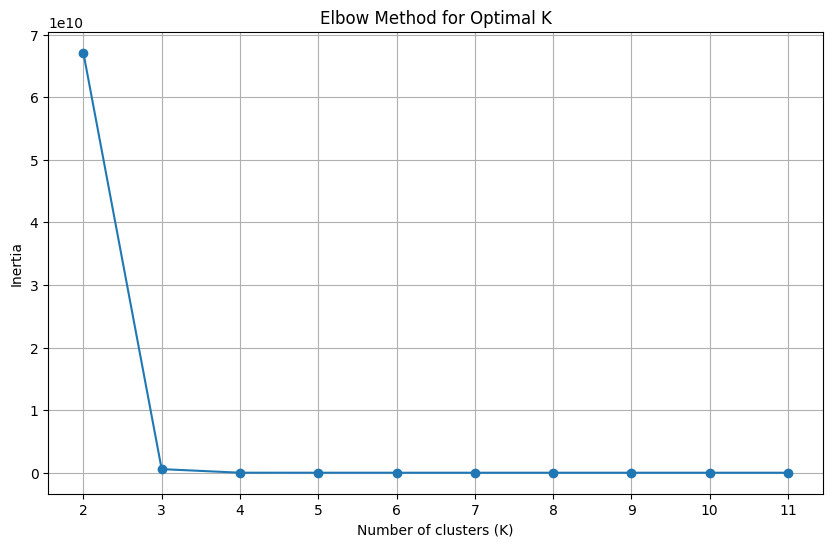

./elbow_test_export/SS-E_csv_10_86331_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0    100000.0         4        11      55317.0    784.3400        2
1        10.0         3        17      29452.0      3.4393        0
2    100000.0         5         1      28325.0   1347.7000        2
3   1000000.0         5        14      50915.0    811.7000        1
4     10000.0         5        15      54627.0    810.0400        0
5     10000.0         3        18      57586.0    792.9600        0
6       100.0         3         1      46137.0     22.0120        0
7    100000.0         2        13      76190.0    789.5500        2
8   1000000.0         2         2      57085.0  85782.0000        1
9       100.0         2         8      47480.0     21.4230        0
10       10.0         4        11      29849.0      3.3491        0
11  1000000.0         5         7      49609.0    887.9400        1
12  1000000.0         1        17      78498

<Figure size 640x480 with 0 Axes>

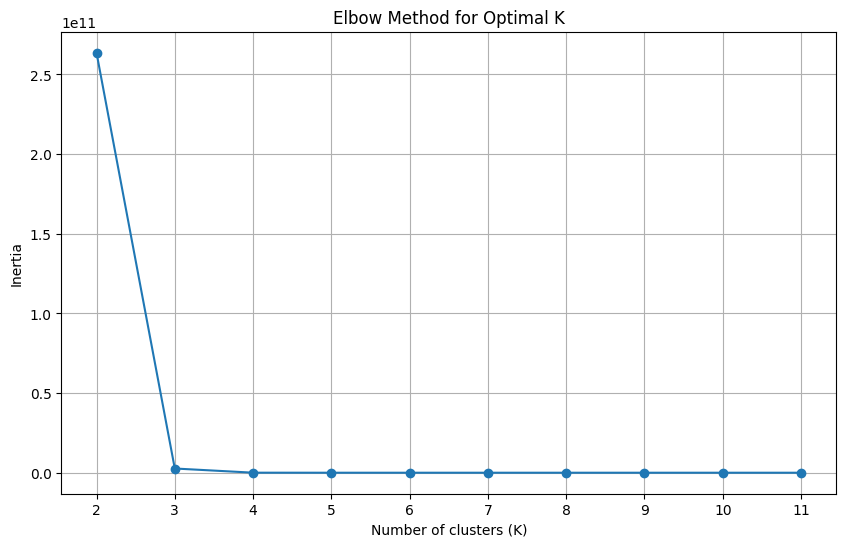

./elbow_test_export/SS-E_csv_50_11514_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0    1000000.0         5        15      54619.0    965.7300        1
1      10000.0         6         3      42753.0    904.0300        0
2         10.0         5        16      29568.0      3.4202        0
3     100000.0         3        18      58816.0    812.4000        2
4     100000.0         6        16      47476.0    535.4500        2
..         ...       ...       ...          ...         ...      ...
245     1000.0         5        16      53494.0    190.4800        0
246       10.0         4         1      28420.0      3.4374        0
247   100000.0         1         3      59297.0  15169.0000        2
248   100000.0         3         7      43754.0    820.2900        2
249       10.0         3        15      30182.0      3.3306        0

[250 rows x 6 columns]
[0.43013930833956143, 0.32005253631536834, 0.3197242720131696, nan]
[0.43013

<Figure size 640x480 with 0 Axes>

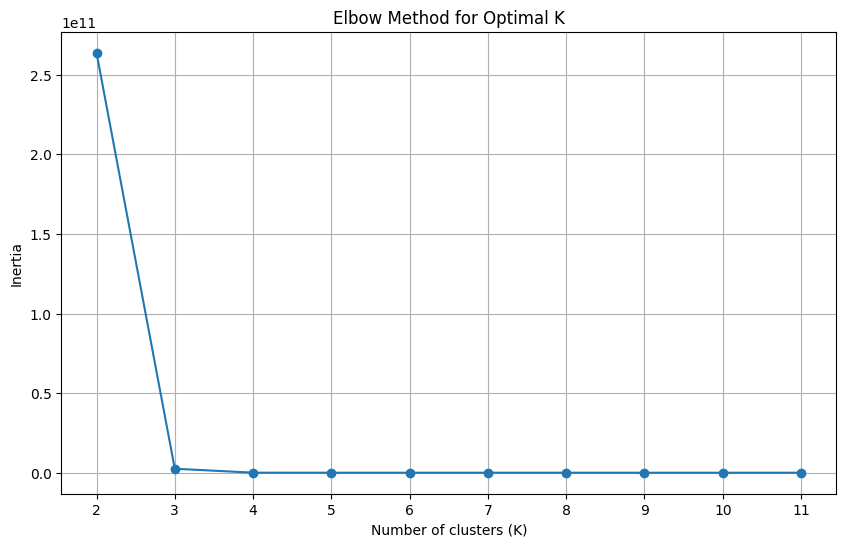

./elbow_test_export/SS-E_csv_50_19953_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0       1000.0         2        14      63127.0   141.8100        0
1        100.0         1        13      54443.0    17.3280        0
2       1000.0         5        11      56833.0   182.6300        0
3       1000.0         4         5      48125.0   216.9500        0
4          1.0         4         9       6256.8     1.6328        0
..         ...       ...       ...          ...        ...      ...
245    10000.0         1         6      63667.0  1499.3000        0
246       10.0         6         1      30328.0     3.3034        0
247  1000000.0         4         7      55725.0   803.8200        1
248   100000.0         3        12      56804.0   806.5200        2
249        1.0         6         5       7532.7     1.3448        0

[250 rows x 6 columns]
[0.43502823610127533, 0.315955909196659, 0.32198876637180307, nan]
[0.43502823610127533,

<Figure size 640x480 with 0 Axes>

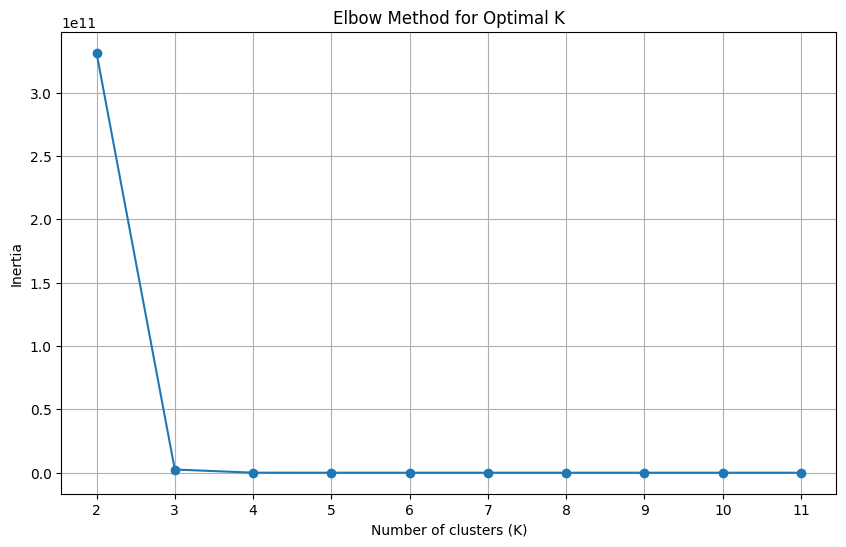

./elbow_test_export/SS-E_csv_50_3545_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0          1.0         4        17       6151.7     1.6312        0
1       1000.0         1         8      53505.0   174.8300        0
2    1000000.0         3        13      58196.0   753.0600        1
3      10000.0         1         1      50789.0  2008.5000        0
4         10.0         5        11      28365.0     3.4786        0
..         ...       ...       ...          ...        ...      ...
245       10.0         2         4      31513.0     3.1552        0
246       10.0         1         2      30487.0     3.2351        0
247      100.0         1        17      53428.0    17.7980        0
248   100000.0         3        11      58079.0   773.6200        2
249    10000.0         6        11      46686.0   513.5800        0

[250 rows x 6 columns]
[0.4378381864001139, 0.3115365403143263, 0.31836960549173343, nan]
[0.4378381864001139, 0

<Figure size 640x480 with 0 Axes>

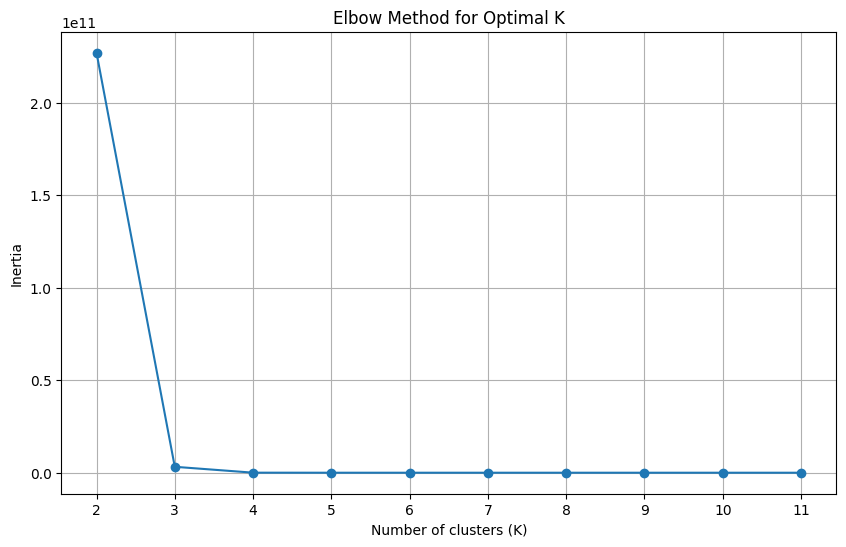

./elbow_test_export/SS-E_csv_50_39658_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0         10.0         1        12      28007.0     3.5948        0
1         10.0         6         8      31859.0     3.2040        0
2      10000.0         1         8      62588.0  1376.4000        0
3        100.0         1         8      51198.0    20.1360        0
4     100000.0         4        15      55649.0   878.4300        2
..         ...       ...       ...          ...        ...      ...
245    10000.0         2         2      48986.0  2043.7000        0
246     1000.0         3        18      60789.0   167.7700        0
247     1000.0         1         5      54852.0   184.6000        0
248       10.0         5        14      28961.0     3.4509        0
249      100.0         3         1      46137.0    22.0120        0

[250 rows x 6 columns]
[0.4380204622704805, 0.313555951503668, 0.29437010098126504, nan]
[0.4380204622704805, 0

<Figure size 640x480 with 0 Axes>

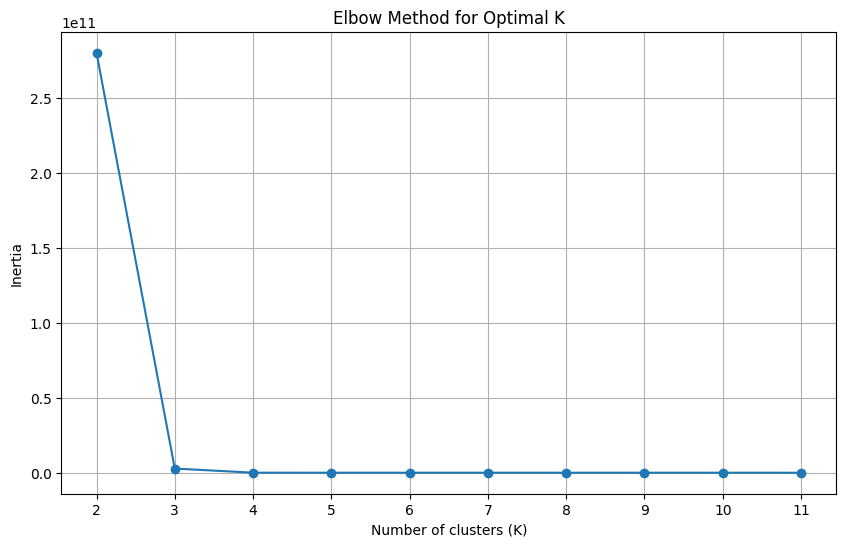

./elbow_test_export/SS-E_csv_50_40749_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      10000.0         2        11      73286.0   1183.4000        0
1       1000.0         4        11      57962.0    176.2200        0
2    1000000.0         5         5      48852.0    821.3600        1
3        100.0         2        12      54774.0     17.3330        0
4     100000.0         4         2      33020.0   1152.0000        2
..         ...       ...       ...          ...         ...      ...
245  1000000.0         2         4      55321.0  63627.0000        1
246        1.0         3         8       6900.3      1.4368        0
247     1000.0         5        18      59279.0    171.4900        0
248  1000000.0         3        15      59941.0    860.9200        1
249    10000.0         5        12      56196.0    775.4500        0

[250 rows x 6 columns]
[0.4434176145268519, 0.31951564798670834, 0.3221639429443529, nan]
[0.443417

<Figure size 640x480 with 0 Axes>

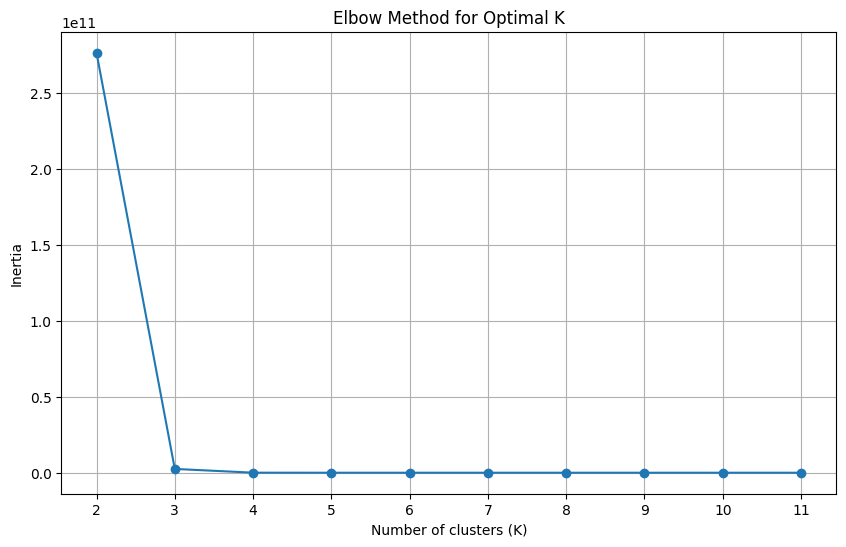

./elbow_test_export/SS-E_csv_50_44845_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        100.0         5        18      51769.0     19.3440        0
1        100.0         4        17      53212.0     19.8810        0
2         10.0         5        15      28524.0      3.5358        0
3     100000.0         1        15      64561.0  15257.0000        2
4          1.0         2        11       5378.1      1.8613        0
..         ...       ...       ...          ...         ...      ...
245    10000.0         6        10      45921.0    468.4400        0
246      100.0         4        12      50747.0     19.6860        0
247        1.0         5        10       6437.4      1.5584        0
248   100000.0         5        12      58277.0    825.9100        2
249      100.0         5         2      36286.0     27.5710        0

[250 rows x 6 columns]
[0.40194462306325696, 0.29023943861509105, 0.2769270751675934, nan]
[0.40194

<Figure size 640x480 with 0 Axes>

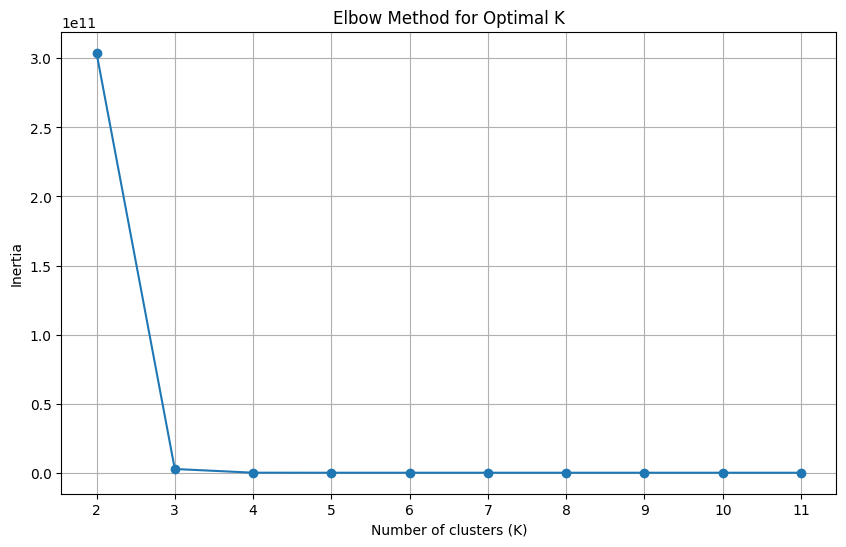

./elbow_test_export/SS-E_csv_50_51176_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0       1000.0         2        17      69097.0   127.6800        1
1      10000.0         4         3      36455.0  1007.8000        1
2          1.0         6         7       7767.6     1.3310        1
3      10000.0         4        14      54537.0   828.6200        1
4    1000000.0         3         9      58277.0   775.4500        0
..         ...       ...       ...          ...        ...      ...
245    10000.0         3        18      57586.0   792.9600        1
246    10000.0         1         5      63080.0  1516.0000        1
247      100.0         6         6      46332.0    21.1470        1
248        1.0         1         1       5434.7     1.8632        1
249     1000.0         4        17      61043.0   172.1100        1

[250 rows x 6 columns]
[0.292627557031661, 0.4218139623925021, 0.30592642829521116, nan]
[0.292627557031661, 0.

<Figure size 640x480 with 0 Axes>

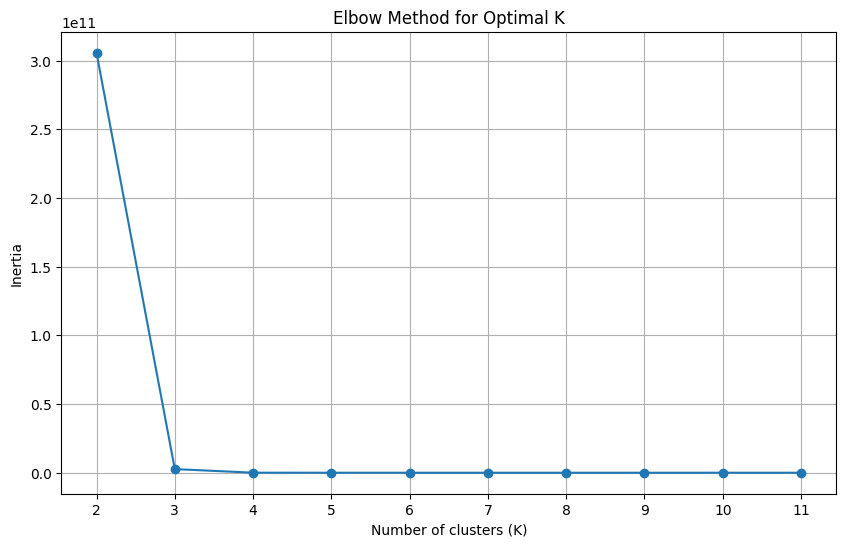

./elbow_test_export/SS-E_csv_50_58612_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0         10.0         5        10      30269.0     3.3514        0
1     100000.0         5        10      55095.0   853.4100        2
2          1.0         3         6       7136.5     1.4391        0
3         10.0         5        13      28871.0     3.5410        0
4          1.0         4         4       6916.1     1.4471        0
..         ...       ...       ...          ...        ...      ...
245      100.0         2         9      52608.0    19.2650        0
246   100000.0         5        13      53807.0   840.3300        2
247   100000.0         5         2      34813.0  1027.4000        2
248       10.0         2         4      31513.0     3.1552        0
249     1000.0         3         3      45915.0   222.6600        0

[250 rows x 6 columns]
[0.41403396524331426, 0.30286415467956307, 0.3086793912269836, nan]
[0.41403396524331426

<Figure size 640x480 with 0 Axes>

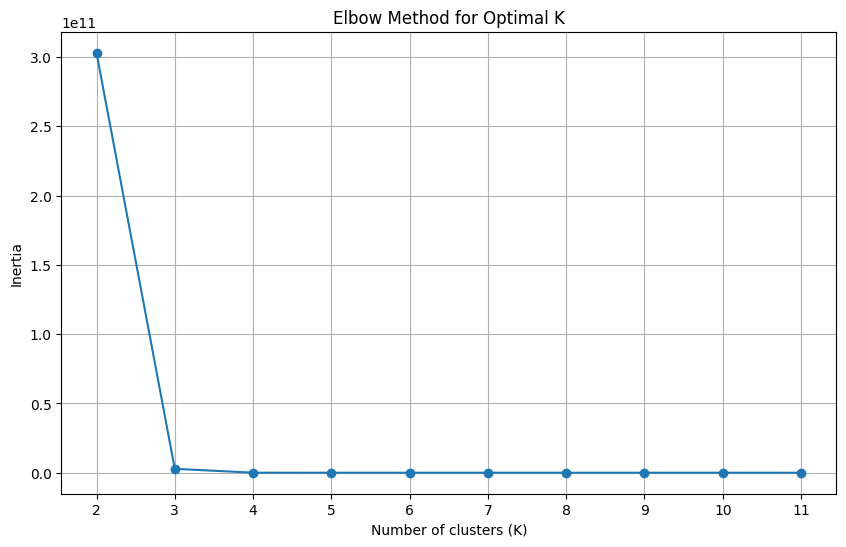

./elbow_test_export/SS-E_csv_50_61367_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+  Latency-  cluster
0       1000.0         2        17      69097.0   127.680        0
1      10000.0         1         9      64300.0  1468.800        0
2        100.0         6         6      46332.0    21.147        0
3         10.0         3         2      32680.0     3.058        0
4    1000000.0         4        15      56222.0   821.530        1
..         ...       ...       ...          ...       ...      ...
245     1000.0         5         1      30328.0   339.940        0
246   100000.0         6        18      47520.0   601.950        2
247      100.0         1        12      53898.0    17.537        0
248    10000.0         3         7      49894.0   777.490        0
249   100000.0         5        16      54569.0   931.080        2

[250 rows x 6 columns]
[0.43745715207243674, 0.3155630902354011, 0.30074374811020893, nan]
[0.43745715207243674, 0.31556309

<Figure size 640x480 with 0 Axes>

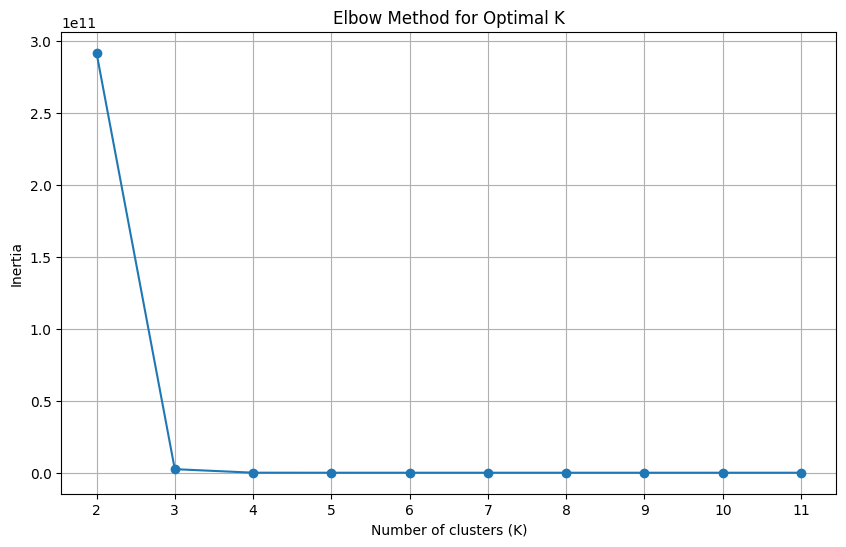

./elbow_test_export/SS-E_csv_50_65388_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0          1.0         6        11       7037.9     1.4329        2
1     100000.0         5         2      34813.0  1027.4000        0
2        100.0         3         8      53673.0    18.8190        2
3    1000000.0         3        16      54812.0   796.9100        1
4     100000.0         6         3      43781.0   877.3500        0
..         ...       ...       ...          ...        ...      ...
245      100.0         6         2      51600.0    19.3510        2
246  1000000.0         5         4      34482.0   992.8300        1
247      100.0         2        10      54155.0    18.1620        2
248        1.0         6         2       7496.3     1.3678        2
249        1.0         2        10       5370.8     1.8457        2

[250 rows x 6 columns]
[0.2971444399759176, 0.31312407242280244, 0.41868677857804776, nan]
[0.2971444399759176,

<Figure size 640x480 with 0 Axes>

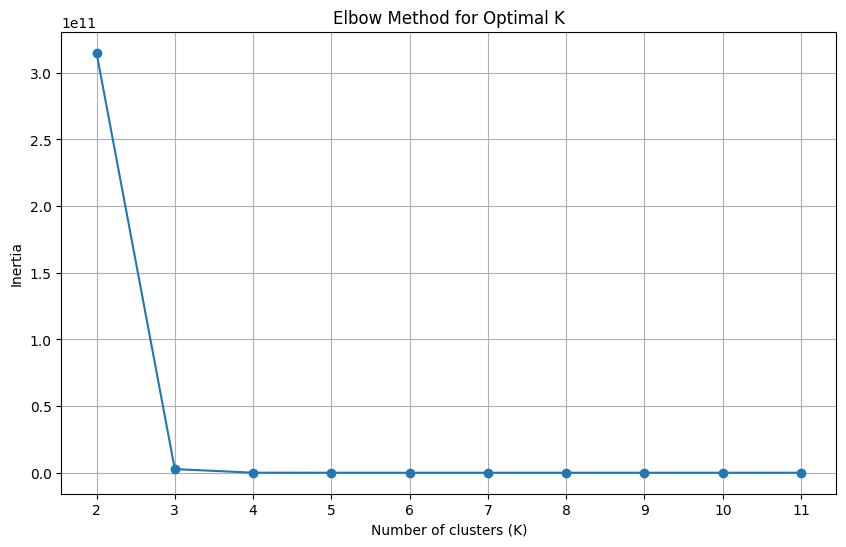

./elbow_test_export/SS-E_csv_50_65444_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+  Latency-  cluster
0       1000.0         5        13      59666.0    171.30        0
1    1000000.0         4        10      54489.0    824.36        1
2    1000000.0         2         6      68913.0  56665.00        1
3    1000000.0         4        11      54485.0    799.59        1
4      10000.0         4         1      55902.0   1726.80        0
..         ...       ...       ...          ...       ...      ...
245    10000.0         1        13      64277.0   1595.80        0
246   100000.0         5        14      52484.0    891.42        2
247   100000.0         1        15      64561.0  15257.00        2
248     1000.0         5        16      53494.0    190.48        0
249     1000.0         2         6      53012.0    197.96        0

[250 rows x 6 columns]
[0.42121562400717344, 0.32900009435899114, 0.32661002403616185, nan]
[0.42121562400717344, 0.3290000

<Figure size 640x480 with 0 Axes>

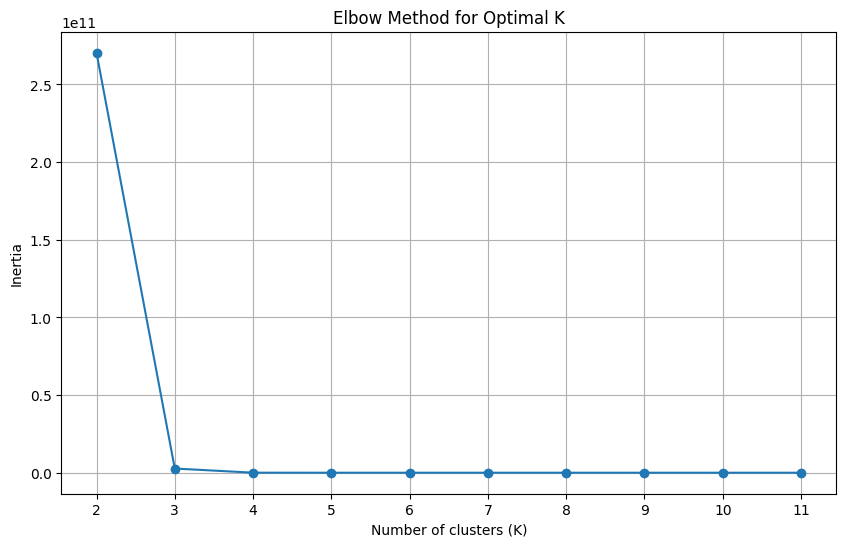

./elbow_test_export/SS-E_csv_50_66946_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0    1000000.0         4         9      51861.0    857.0300        1
1          1.0         5        14       6400.4      1.5555        0
2          1.0         3         7       7266.3      1.4241        0
3          1.0         6         5       7532.7      1.3448        0
4       1000.0         1        17      64267.0    155.3900        0
..         ...       ...       ...          ...         ...      ...
245  1000000.0         4        11      54485.0    799.5900        1
246   100000.0         1         6      64450.0  15049.0000        2
247     1000.0         2        10      56649.0    177.4200        0
248      100.0         2         7      51649.0     19.8320        0
249    10000.0         1        13      64277.0   1595.8000        0

[250 rows x 6 columns]
[0.4345161865264479, 0.3210776566839678, 0.301581046840894, nan]
[0.43451618

<Figure size 640x480 with 0 Axes>

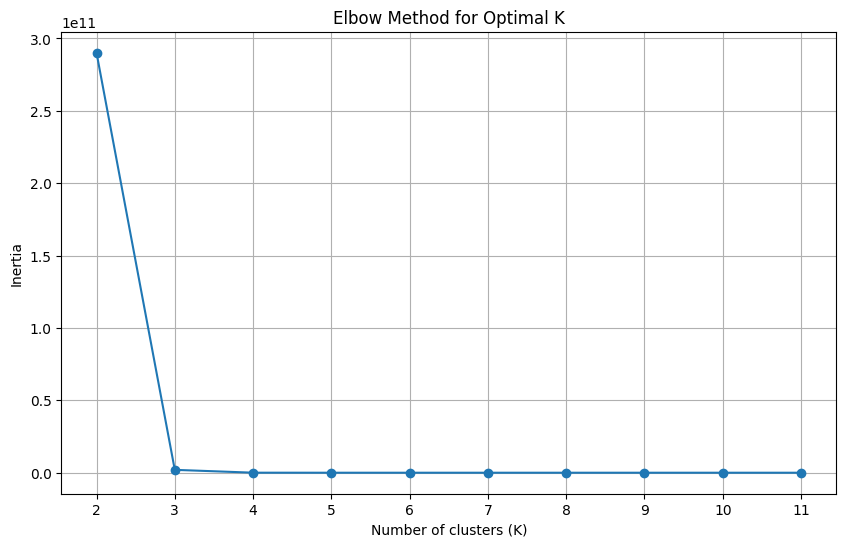

./elbow_test_export/SS-E_csv_50_69024_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+  Latency-  cluster
0       1000.0         2         3      51798.0  195.3600        0
1        100.0         6        14      48914.0   19.0310        0
2         10.0         4         5      30406.0    3.3592        0
3         10.0         1         2      30487.0    3.2351        0
4        100.0         4        16      52702.0   18.7640        0
..         ...       ...       ...          ...       ...      ...
245  1000000.0         4        18      55566.0  952.8600        1
246     1000.0         3        12      60301.0  165.5000        0
247     1000.0         5        11      56833.0  182.6300        0
248      100.0         2        13      57293.0   15.9400        0
249     1000.0         4         1      52846.0  187.3600        0

[250 rows x 6 columns]
[0.4429107998975565, 0.30414035249103893, 0.3037516616729865, nan]
[0.4429107998975565, 0.3041403524

<Figure size 640x480 with 0 Axes>

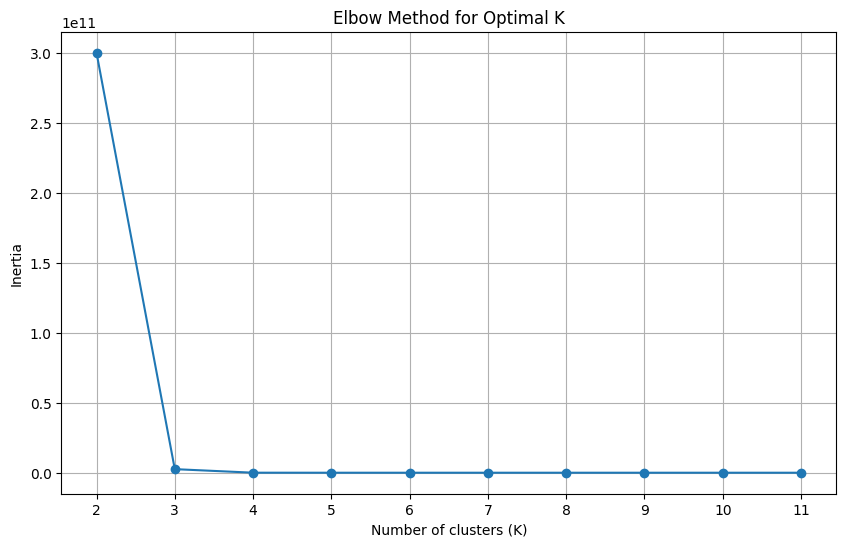

./elbow_test_export/SS-E_csv_50_70006_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+   Latency-  cluster
0       1000.0         4        10      55124.0   184.0600        0
1    1000000.0         6         1      55673.0  6031.5000        1
2         10.0         2        11      30705.0     3.2506        0
3        100.0         2         5      47051.0    22.1100        0
4         10.0         1         6      28862.0     3.5443        0
..         ...       ...       ...          ...        ...      ...
245        1.0         2         2       5801.6     1.7259        0
246        1.0         2         3       5791.9     1.7557        0
247    10000.0         6         3      42753.0   904.0300        0
248     1000.0         1         7      58797.0   173.9300        0
249       10.0         5        17      28762.0     3.4509        0

[250 rows x 6 columns]
[0.4468620249473115, 0.3182374284593539, 0.3150946378005082, nan]
[0.4468620249473115, 0

<Figure size 640x480 with 0 Axes>

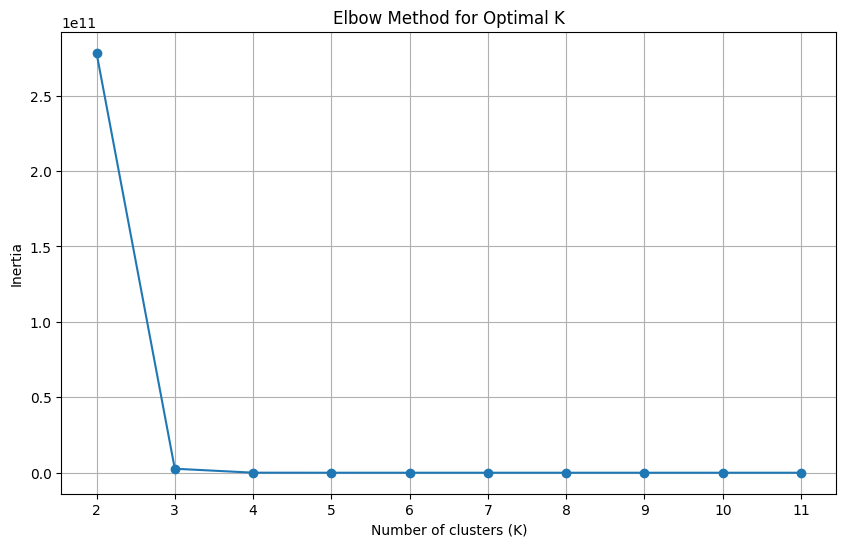

./elbow_test_export/SS-E_csv_50_70292_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0    1000000.0         4         2      31507.0   1210.1000        1
1          1.0         2         5       5846.6      1.8195        0
2        100.0         3         6      52614.0     19.2970        0
3          1.0         5         3       7040.8      1.4460        0
4          1.0         2         2       5801.6      1.7259        0
..         ...       ...       ...          ...         ...      ...
245    10000.0         3        14      57828.0    792.7300        0
246        1.0         5         8       7004.2      1.4586        0
247     1000.0         6        11      48956.0    174.1200        0
248    10000.0         3        16      57894.0    753.8100        0
249  1000000.0         1        18      82514.0  44566.0000        1

[250 rows x 6 columns]
[0.4348353986253577, 0.33514756030399406, 0.2854428576423319, nan]
[0.434835

<Figure size 640x480 with 0 Axes>

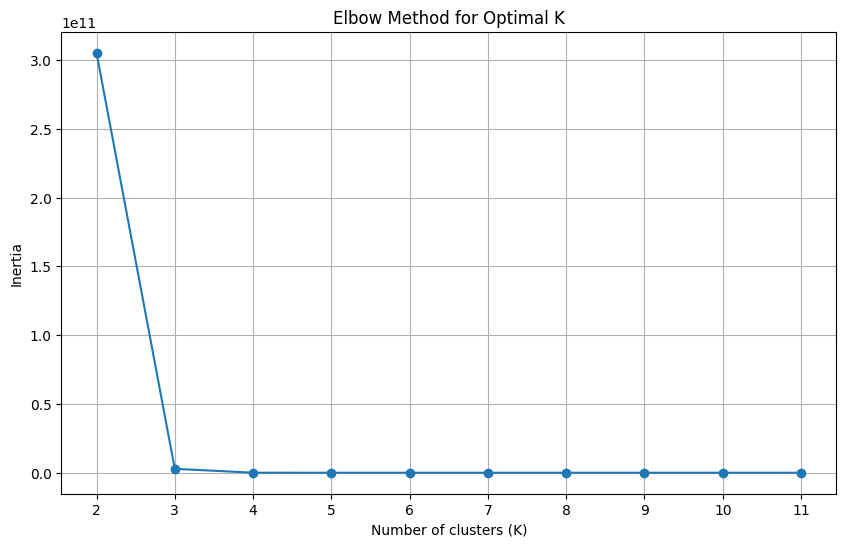

./elbow_test_export/SS-E_csv_50_77340_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      10000.0         3        13      58653.0    736.4700        0
1      10000.0         5        15      54627.0    810.0400        0
2    1000000.0         2         3      61824.0  83512.0000        1
3      10000.0         4        11      54605.0    791.7000        0
4    1000000.0         1         1      66418.0  91578.0000        1
..         ...       ...       ...          ...         ...      ...
245    10000.0         3        11      58125.0    823.4500        0
246        1.0         2        16       5424.0      1.8711        0
247       10.0         5         4      30228.0      3.3734        0
248        1.0         6         3       7680.7      1.3299        0
249       10.0         3         8      30063.0      3.3333        0

[250 rows x 6 columns]
[0.4377939467344236, 0.3298379135969205, 0.29105898500345806, nan]
[0.437793

<Figure size 640x480 with 0 Axes>

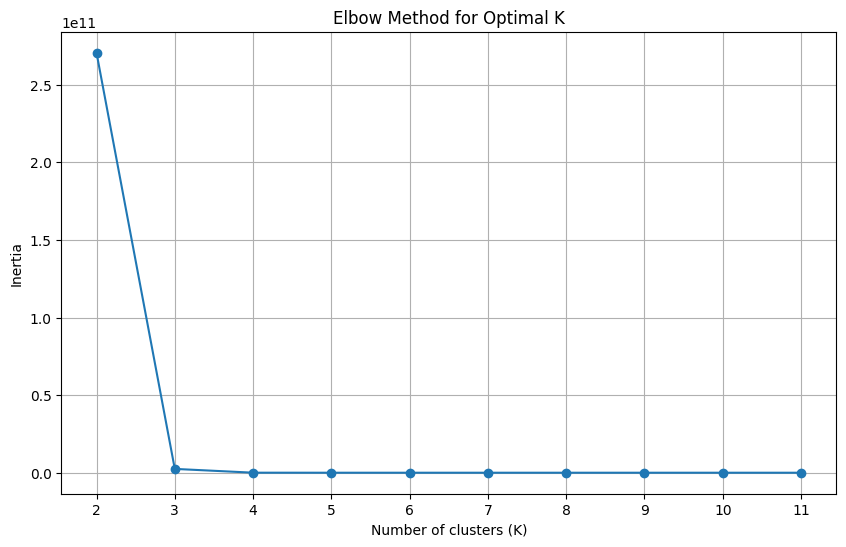

./elbow_test_export/SS-E_csv_50_77845_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        100.0         3         2      51763.0     19.5740        0
1    1000000.0         2         8      80544.0  30348.0000        1
2      10000.0         6         4      43014.0    743.2100        0
3      10000.0         3        16      57894.0    753.8100        0
4        100.0         1         1      45494.0     22.1790        0
..         ...       ...       ...          ...         ...      ...
245        1.0         2         8       5534.4      1.8247        0
246  1000000.0         3        18      57632.0    871.2600        1
247  1000000.0         5        11      53942.0    888.8700        1
248      100.0         4        18      50439.0     19.9120        0
249    10000.0         6         2      53858.0    425.7700        0

[250 rows x 6 columns]
[0.45373001133148383, 0.29970058826172374, 0.3275327529387494, nan]
[0.45373

<Figure size 640x480 with 0 Axes>

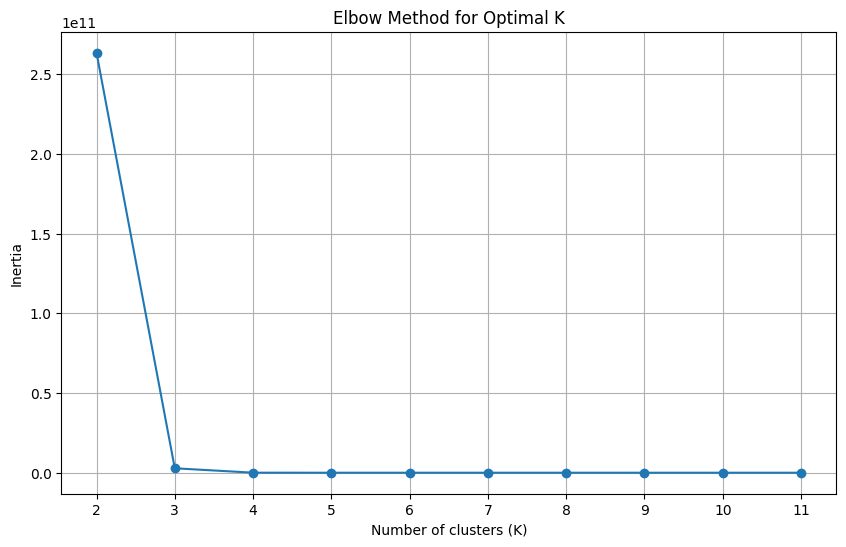

./elbow_test_export/SS-E_csv_50_83686_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0          1.0         1         7       5377.6      1.8759        0
1       1000.0         6         8      49745.0    161.9300        0
2    1000000.0         6         2      53945.0    447.4800        1
3     100000.0         2        11      76492.0  11936.0000        2
4    1000000.0         6         1      55673.0   6031.5000        1
..         ...       ...       ...          ...         ...      ...
245        1.0         5        16       6304.4      1.5942        0
246    10000.0         6        13      46248.0    522.7800        0
247       10.0         6        17      29777.0      3.3335        0
248        1.0         6         3       7680.7      1.3299        0
249       10.0         2         8      31045.0      3.2466        0

[250 rows x 6 columns]
[0.441343327983749, 0.2844752808294969, 0.2768414505399148, nan]
[0.44134332

<Figure size 640x480 with 0 Axes>

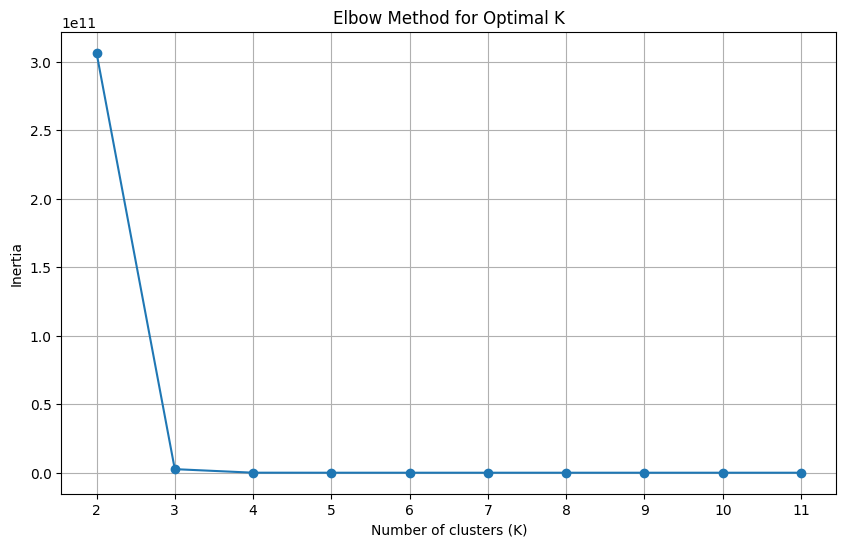

./elbow_test_export/SS-E_csv_50_84967_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+  Latency-  cluster
0        100.0         6        12      47366.0   20.0420        2
1        100.0         1         4      46717.0   22.1510        2
2          1.0         3         9       6753.5    1.5161        2
3       1000.0         2        16      63510.0  116.0600        2
4       1000.0         3        14      60581.0  167.9900        2
..         ...       ...       ...          ...       ...      ...
245     1000.0         3         3      45915.0  222.6600        2
246       10.0         5         4      30228.0    3.3734        2
247       10.0         6         2      34466.0    2.9167        2
248     1000.0         6         3      43097.0  217.5300        2
249       10.0         6        15      30885.0    3.2422        2

[250 rows x 6 columns]
[0.2973437471257297, 0.2991716686161995, 0.4332831111870392, nan]
[0.2973437471257297, 0.29917166861

<Figure size 640x480 with 0 Axes>

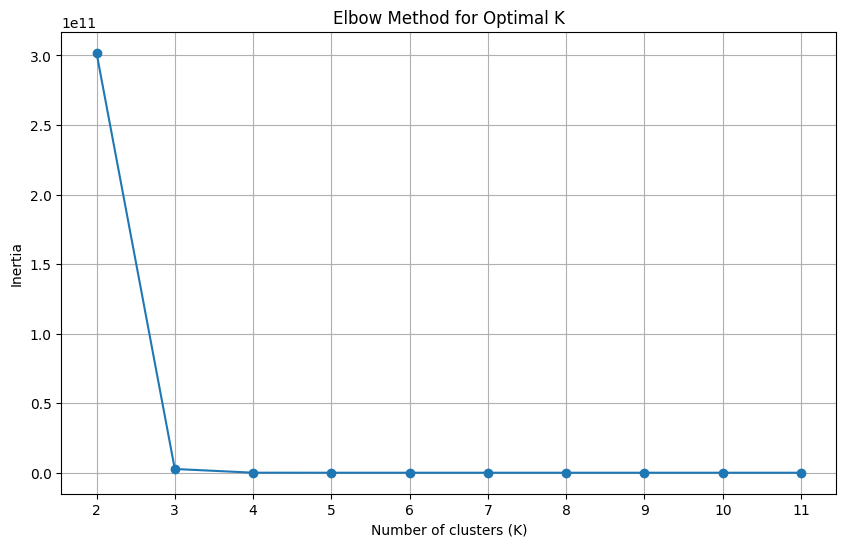

./elbow_test_export/SS-E_csv_50_86331_elbow_test.png
Optimal k value: 3
     Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0     100000.0         4        11      55317.0    784.3400        0
1         10.0         3        17      29452.0      3.4393        2
2     100000.0         5         1      28325.0   1347.7000        0
3    1000000.0         5        14      50915.0    811.7000        1
4      10000.0         5        15      54627.0    810.0400        2
..         ...       ...       ...          ...         ...      ...
245   100000.0         5         4      33910.0   1023.2000        0
246        1.0         5        13       6373.1      1.5647        2
247      100.0         6         1      46071.0     21.2410        2
248  1000000.0         1        16      70303.0  60552.0000        1
249      100.0         4        14      50767.0     19.8880        2

[250 rows x 6 columns]
[0.32420503679769846, 0.33480424406673204, 0.44954745141689256, nan]
[0.3242

<Figure size 640x480 with 0 Axes>

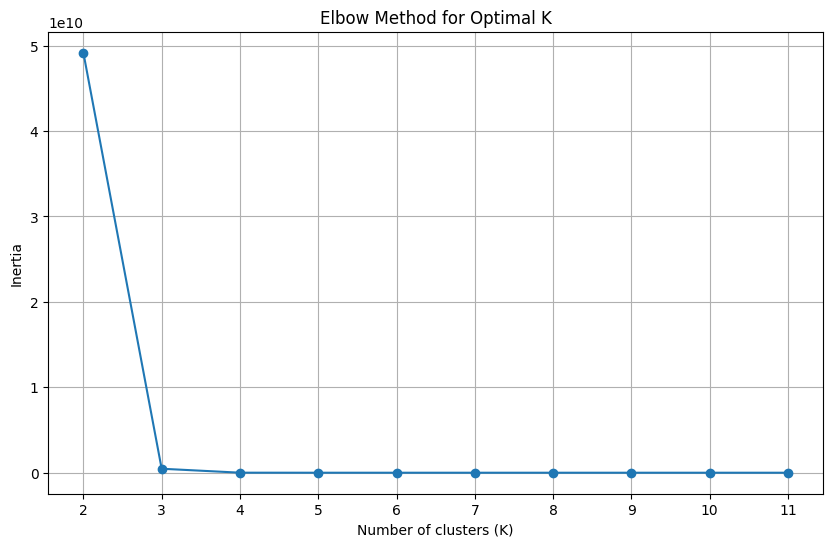

./elbow_test_export/SS-F_csv_10_11514_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         3         3      19409.0   1785.0000        1
1     10000.0         3        15      22331.0   1447.1000        0
2        10.0         3        18      15905.0      6.7601        0
3    100000.0         2         3      26935.0  35250.0000        2
4    100000.0         6         1      10376.0  64210.0000        2
5   1000000.0         1         1      57603.0  99722.0000        1
6   1000000.0         6         3      22139.0   1764.9000        1
7       100.0         3         6      21693.0     52.7320        0
8       100.0         6         1      10467.0    102.5400        0
9   1000000.0         1        15      58616.0  84497.0000        1
10   100000.0         2         6      30621.0  30120.0000        2
11       10.0         6         1       8667.5     12.5460        0
12    10000.0         1        15      20039

<Figure size 640x480 with 0 Axes>

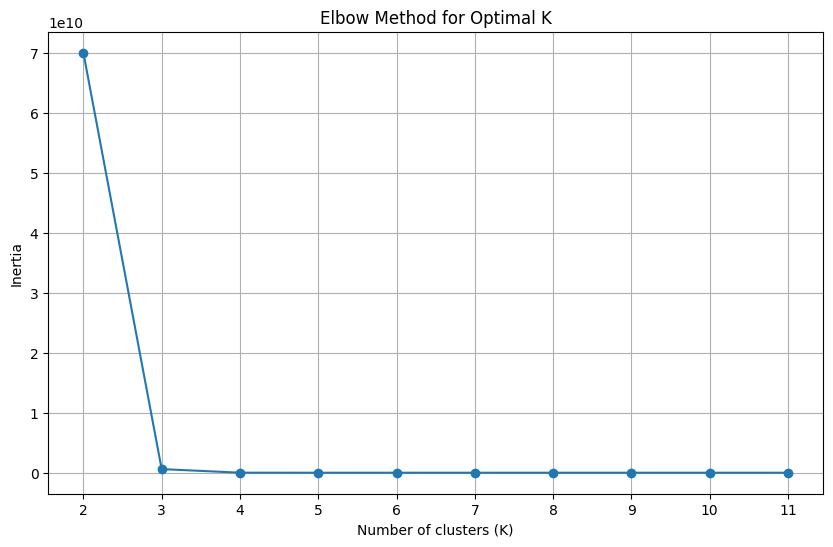

./elbow_test_export/SS-F_csv_10_19953_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1        12      25936.0    446.5100        2
1       100.0         1         3      21959.0     53.8570        2
2      1000.0         3         9      22074.0    480.9900        2
3      1000.0         2        12      38846.0    299.2000        2
4         1.0         3         3       5591.7      1.9243        2
5   1000000.0         1         3      58279.0  88542.0000        1
6    100000.0         1         3      18463.0  48084.0000        0
7        10.0         3        12      17287.0      6.1786        2
8         1.0         2        12       4686.7      2.2306        2
9     10000.0         1         9      21076.0   5170.7000        2
10       10.0         1         1       9276.1     12.0390        2
11      100.0         1        18      23184.0     47.3060        2
12       10.0         2        15      22447

<Figure size 640x480 with 0 Axes>

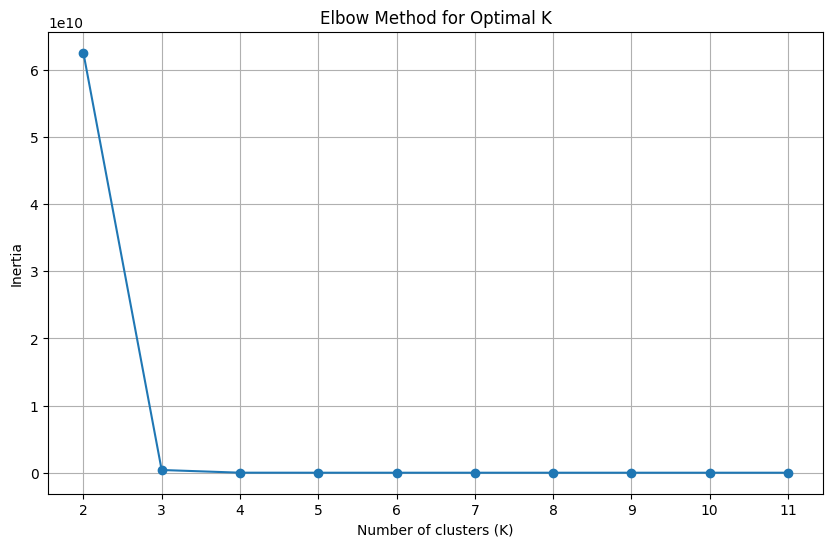

./elbow_test_export/SS-F_csv_10_3545_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         3         9       5258.3      2.0457        0
1       100.0         6        15      24599.0     30.5100        0
2   1000000.0         6        12      28919.0    741.0200        1
3   1000000.0         1        18      58326.0  86354.0000        1
4      1000.0         6         9      26511.0    307.3300        0
5   1000000.0         6         1      52828.0  73243.0000        1
6        10.0         3        15      16905.0      6.2653        0
7      1000.0         6         6      27448.0    277.1800        0
8        10.0         3        12      17287.0      6.1786        0
9        10.0         3         3      16797.0      6.4150        0
10        1.0         1        12       4275.4      2.3254        0
11   100000.0         2         1       7977.6  78965.0000        2
12   100000.0         3         6      21296.

<Figure size 640x480 with 0 Axes>

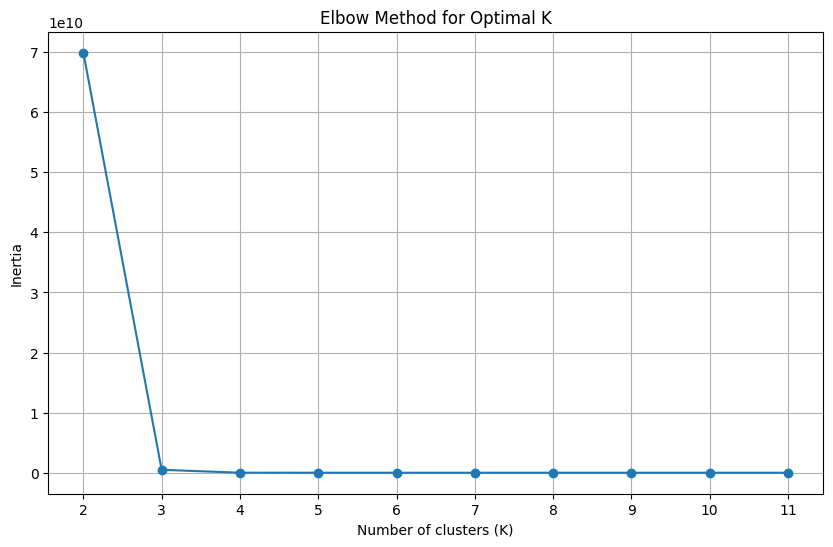

./elbow_test_export/SS-F_csv_10_39658_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        10.0         1         3      14647.0      7.5798        2
1        10.0         6         6      19636.0      4.7110        2
2      1000.0         6        12      27644.0    254.6400        2
3        10.0         6        18      19340.0      4.6347        2
4    100000.0         2        15      34852.0  27668.0000        0
5     10000.0         3        12      20768.0   1526.2000        2
6    100000.0         6         6      25775.0   1066.2000        0
7       100.0         6         6      24578.0     38.3870        2
8        10.0         6         3      17814.0      5.4526        2
9        10.0         2        15      22447.0      4.7671        2
10    10000.0         3         3      19143.0   1658.2000        2
11  1000000.0         2        12      64455.0  65922.0000        1
12        1.0         1         1       4602

<Figure size 640x480 with 0 Axes>

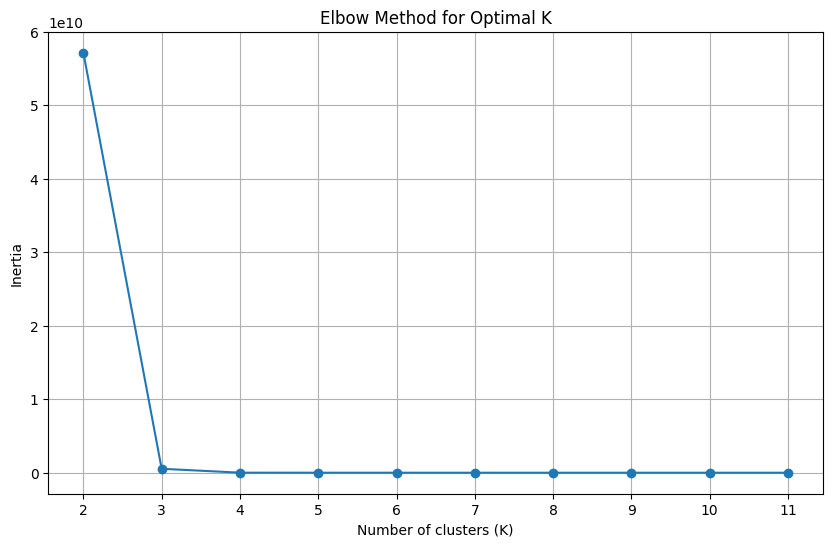

./elbow_test_export/SS-F_csv_10_40749_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0     10000.0         1         9      21076.0   5170.7000        2
1      1000.0         2        18      37037.0    312.0700        2
2   1000000.0         2        18      53112.0  69276.0000        1
3       100.0         1        15      22591.0     49.3350        2
4    100000.0         2         3      26935.0  35250.0000        0
5      1000.0         3         6      21866.0    471.8200        2
6       100.0         2        15      31867.0     33.1330        2
7     10000.0         2         1       8922.4  11828.0000        2
8   1000000.0         2         3      42537.0  85607.0000        1
9     10000.0         1        15      20039.0   5536.3000        2
10  1000000.0         1         9      55495.0  82624.0000        1
11   100000.0         1        18      21202.0  45261.0000        0
12   100000.0         6         1      10376

<Figure size 640x480 with 0 Axes>

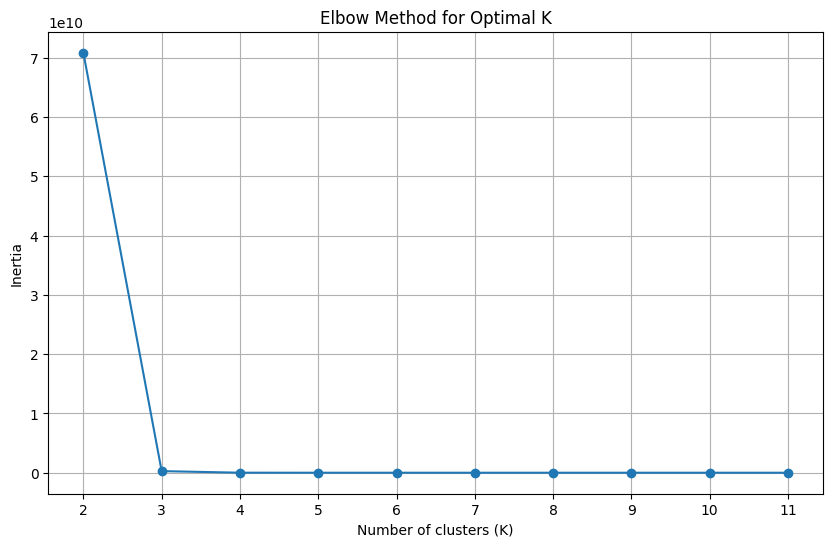

./elbow_test_export/SS-F_csv_10_44845_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         3        18      21195.0     49.9250        0
1       100.0         3         3      18806.0     58.4400        0
2        10.0         3        18      15905.0      6.7601        0
3     10000.0         6        15      27720.0    745.0400        0
4         1.0         2         1       4508.5      2.4379        0
5     10000.0         1         9      21076.0   5170.7000        0
6        10.0         3         1       8400.0     12.5090        0
7      1000.0         6         1       9328.2   1175.0000        0
8        10.0         1         1       9276.1     12.0390        0
9         1.0         2         9       4752.9      2.2133        0
10       10.0         2         3      19208.0      5.7214        0
11  1000000.0         3         9      21188.0   1713.5000        1
12   100000.0         1         1       9136

<Figure size 640x480 with 0 Axes>

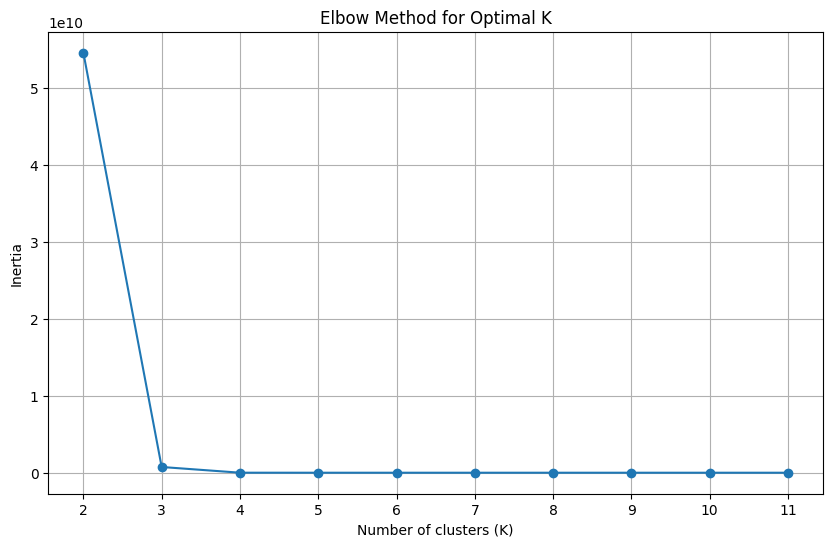

./elbow_test_export/SS-F_csv_10_51176_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1        15      25778.0    412.5000        2
1     10000.0         2         9      34739.0   3308.0000        2
2         1.0         6         9       5160.1      2.0405        2
3     10000.0         2        15      34157.0   3154.6000        2
4   1000000.0         1        15      58616.0  84497.0000        1
5      1000.0         1         6      23770.0    478.5300        2
6       100.0         2        12      33320.0     34.1840        2
7      1000.0         3        15      23466.0    447.5500        2
8       100.0         6         9      23012.0     37.8550        2
9     10000.0         3         6      21413.0   1751.1000        2
10  1000000.0         6        15      26632.0    824.5100        1
11        1.0         2         3       4747.2      2.1477        2
12  1000000.0         2         3      42537

<Figure size 640x480 with 0 Axes>

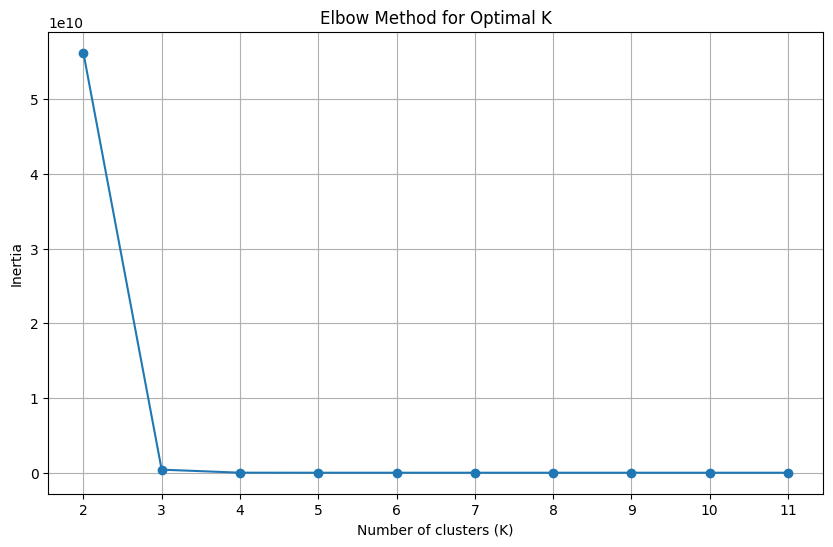

./elbow_test_export/SS-F_csv_10_58612_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        10.0         3        15      16905.0      6.2653        0
1    100000.0         3         3      18567.0   1733.9000        2
2         1.0         2         9       4752.9      2.2133        0
3        10.0         3        18      15905.0      6.7601        0
4         1.0         3         1       5384.6      1.9707        0
5         1.0         3         3       5591.7      1.9243        0
6   1000000.0         1        15      58616.0  84497.0000        1
7         1.0         2         1       4508.5      2.4379        0
8       100.0         3         3      18806.0     58.4400        0
9         1.0         2         3       4747.2      2.1477        0
10   100000.0         6        12      29156.0    697.9100        2
11    10000.0         6         9      27814.0    655.0300        0
12    10000.0         2         6      33463

<Figure size 640x480 with 0 Axes>

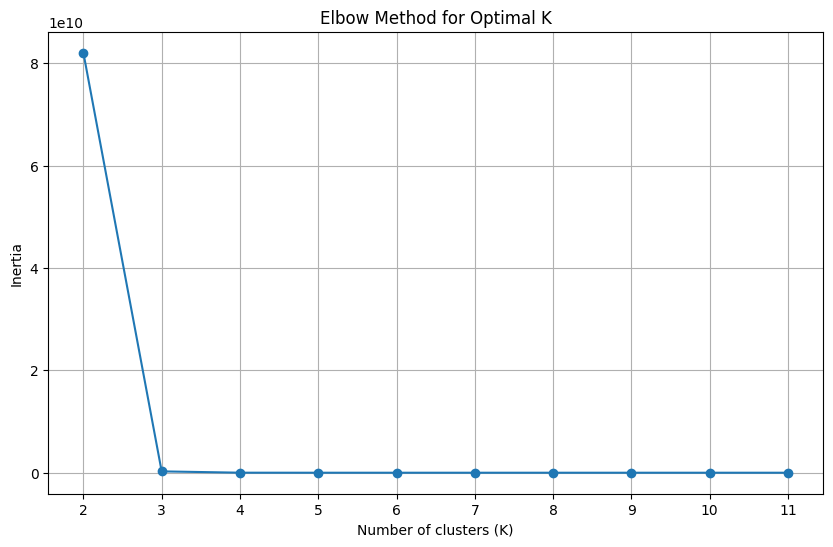

./elbow_test_export/SS-F_csv_10_61367_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1        15      25778.0    412.5000        0
1      1000.0         6        15      27234.0    277.6500        0
2       100.0         6         1      10467.0    102.5400        0
3        10.0         2         3      19208.0      5.7214        0
4   1000000.0         2        12      64455.0  65922.0000        1
5       100.0         3         1       9885.2    117.1900        0
6    100000.0         6        15      27609.0    931.8900        2
7        10.0         2         9      22005.0      4.7740        0
8        10.0         3        18      15905.0      6.7601        0
9         1.0         3        12       5131.6      2.0329        0
10   100000.0         1         3      18463.0  48084.0000        2
11      100.0         6        15      24599.0     30.5100        0
12      100.0         6         6      24578

<Figure size 640x480 with 0 Axes>

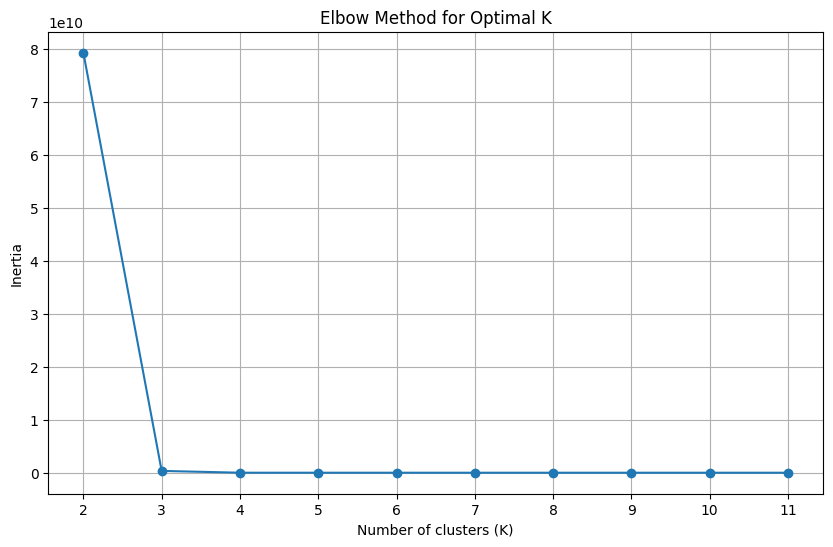

./elbow_test_export/SS-F_csv_10_65388_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         6        12       5120.9      1.9902        0
1    100000.0         2        18      34687.0  28743.0000        2
2       100.0         2         3      24998.0     49.5840        0
3   1000000.0         1        18      58326.0  86354.0000        1
4    100000.0         3        12      20378.0   1540.1000        2
5    100000.0         3         6      21296.0   1548.2000        2
6       100.0         3         3      18806.0     58.4400        0
7        10.0         6        18      19340.0      4.6347        0
8   1000000.0         1         9      55495.0  82624.0000        1
9        10.0         1        15      15229.0      7.2642        0
10       10.0         6         1       8667.5     12.5460        0
11        1.0         1         9       4404.4      2.3335        0
12       10.0         1         1       9276

<Figure size 640x480 with 0 Axes>

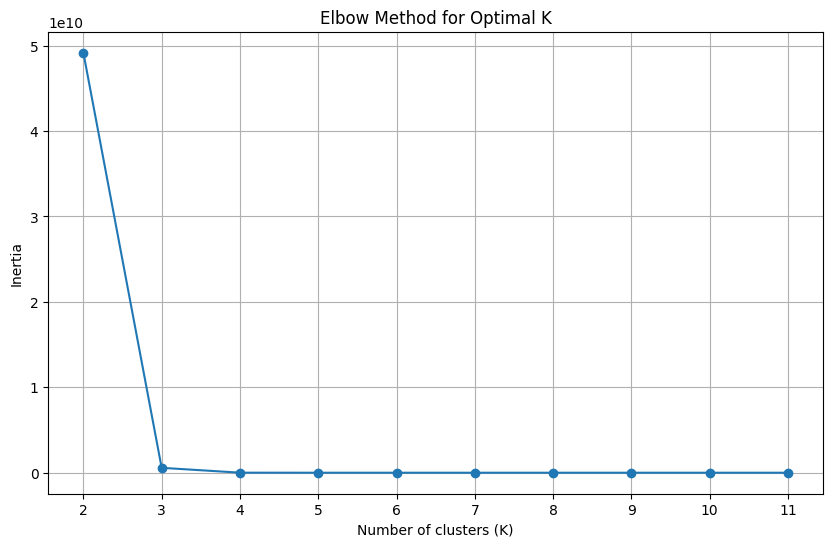

./elbow_test_export/SS-F_csv_10_65444_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         3        12      25959.0    435.8900        2
1   1000000.0         2         6      56964.0  72319.0000        1
2    100000.0         6        18      28055.0    874.7800        0
3   1000000.0         2         9      72394.0  58477.0000        1
4     10000.0         2         6      33463.0   3441.6000        2
5         1.0         1        15       4422.9      2.3844        2
6     10000.0         6        15      27720.0    745.0400        2
7       100.0         1        15      22591.0     49.3350        2
8    100000.0         3        18      21210.0   1826.1000        0
9         1.0         3         6       5372.8      1.9353        2
10  1000000.0         3        18      20184.0   1516.5000        1
11  1000000.0         6        18      28388.0    887.6700        1
12    10000.0         6         9      27814

<Figure size 640x480 with 0 Axes>

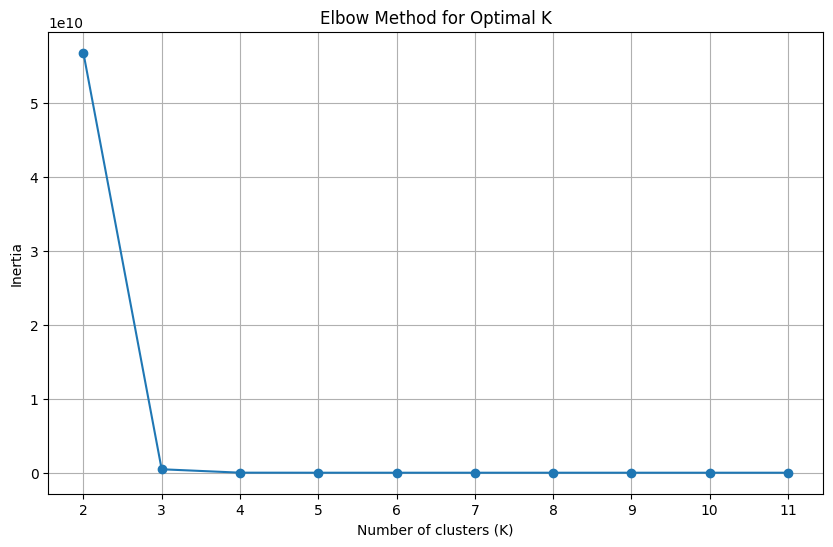

./elbow_test_export/SS-F_csv_10_66946_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         6         3      22139.0   1764.9000        1
1   1000000.0         2         6      56964.0  72319.0000        1
2         1.0         6         1       5318.7      1.9595        0
3         1.0         2         9       4752.9      2.2133        0
4         1.0         6         6       5202.6      1.9410        0
5      1000.0         1         3      22456.0    495.8500        0
6        10.0         3        15      16905.0      6.2653        0
7     10000.0         6         1      11814.0   8104.6000        0
8    100000.0         1         6      19583.0  46923.0000        2
9       100.0         1        18      23184.0     47.3060        0
10     1000.0         6         1       9328.2   1175.0000        0
11     1000.0         3         3      22331.0    505.4000        0
12       10.0         2         1       8494

<Figure size 640x480 with 0 Axes>

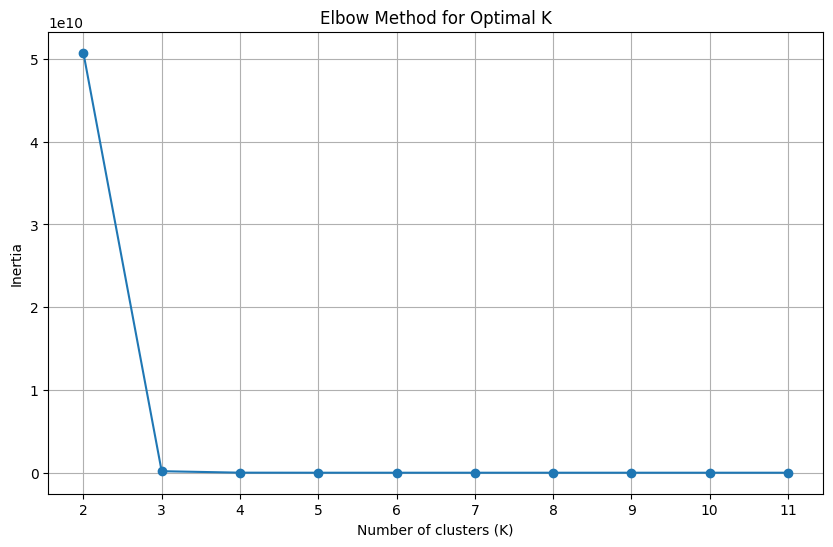

./elbow_test_export/SS-F_csv_10_69024_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1         6      23770.0    478.5300        0
1       100.0         6         6      24578.0     38.3870        0
2        10.0         2        18      22140.0      4.9532        0
3         1.0         6        18       4957.8      2.0430        0
4       100.0         3         3      18806.0     58.4400        0
5         1.0         6         6       5202.6      1.9410        0
6   1000000.0         6         6      28016.0    890.1100        1
7    100000.0         2        18      34687.0  28743.0000        2
8        10.0         6        15      19637.0      4.6353        0
9       100.0         3         6      21693.0     52.7320        0
10     1000.0         3        12      25959.0    435.8900        0
11  1000000.0         6        12      28919.0    741.0200        1
12     1000.0         1        12      25936

<Figure size 640x480 with 0 Axes>

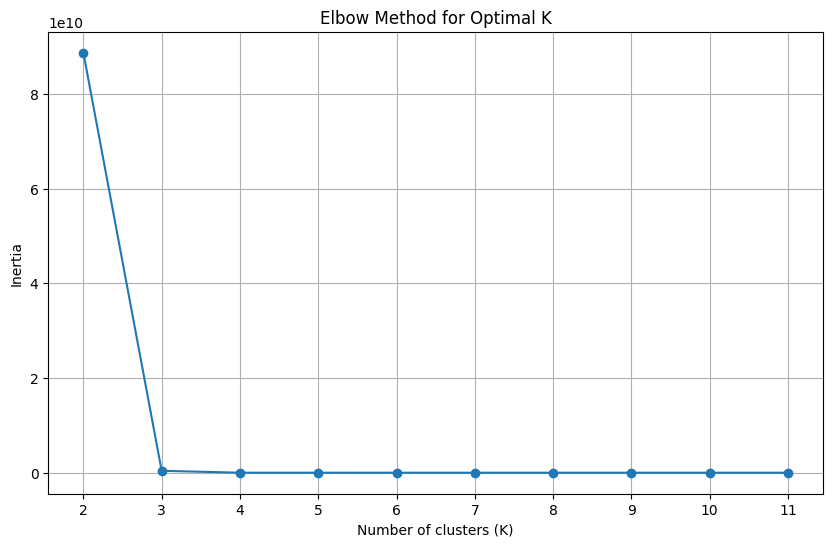

./elbow_test_export/SS-F_csv_10_70006_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         2        15      38350.0    294.8100        2
1   1000000.0         3         6      18902.0   1623.2000        1
2        10.0         1        18      15212.0      7.1578        2
3       100.0         1         9      23144.0     48.1750        2
4        10.0         1         1       9276.1     12.0390        2
5   1000000.0         1         9      55495.0  82624.0000        1
6   1000000.0         1         6      54006.0  89234.0000        1
7       100.0         1         3      21959.0     53.8570        2
8      1000.0         1         6      23770.0    478.5300        2
9     10000.0         2        12      33345.0   3375.2000        2
10   100000.0         3         1      10023.0  70985.0000        0
11   100000.0         1         6      19583.0  46923.0000        0
12        1.0         1         9       4404

<Figure size 640x480 with 0 Axes>

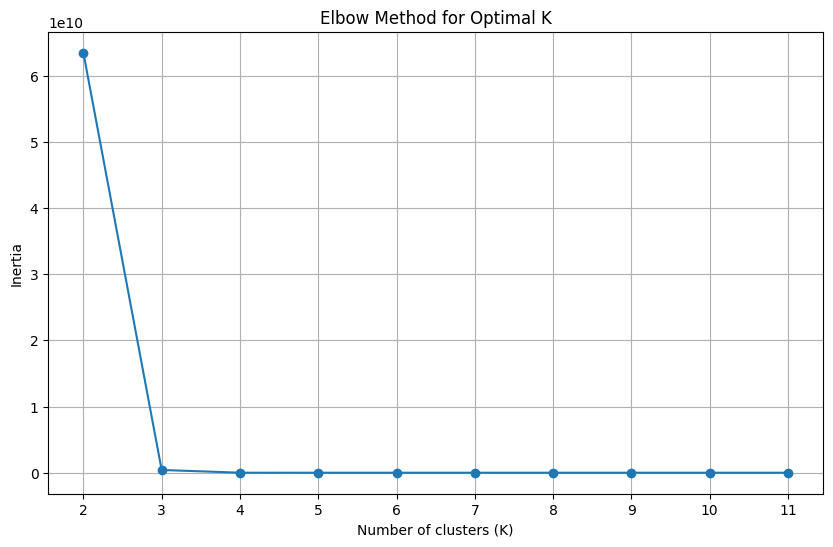

./elbow_test_export/SS-F_csv_10_70292_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         2         1      38501.0  72876.0000        1
1         1.0         1        15       4422.9      2.3844        0
2       100.0         2         3      24998.0     49.5840        0
3         1.0         3        12       5131.6      2.0329        0
4         1.0         1        12       4275.4      2.3254        0
5      1000.0         6        12      27644.0    254.6400        0
6         1.0         6        15       4999.7      2.0329        0
7    100000.0         3        15      21716.0   1473.6000        2
8    100000.0         1         1       9136.9  82037.0000        2
9         1.0         1         3       4508.5      2.2534        0
10      100.0         3         3      18806.0     58.4400        0
11    10000.0         3        12      20768.0   1526.2000        0
12     1000.0         3        12      25959

<Figure size 640x480 with 0 Axes>

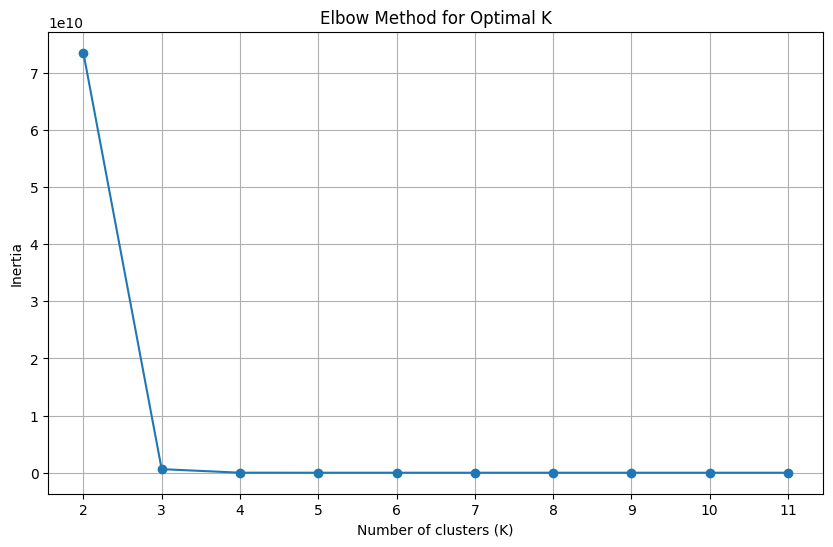

./elbow_test_export/SS-F_csv_10_77340_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0     10000.0         2         3      25630.0   4190.6000        0
1     10000.0         3         9      21810.0   1437.6000        0
2    100000.0         6        18      28055.0    874.7800        2
3     10000.0         2        15      34157.0   3154.6000        0
4    100000.0         6         3      21885.0   1960.1000        2
5    100000.0         3        18      21210.0   1826.1000        2
6     10000.0         3         3      19143.0   1658.2000        0
7      1000.0         2        18      37037.0    312.0700        0
8       100.0         6        15      24599.0     30.5100        0
9        10.0         1         3      14647.0      7.5798        0
10        1.0         1         6       4504.4      2.2747        0
11  1000000.0         2        12      64455.0  65922.0000        1
12     1000.0         6        15      27234

<Figure size 640x480 with 0 Axes>

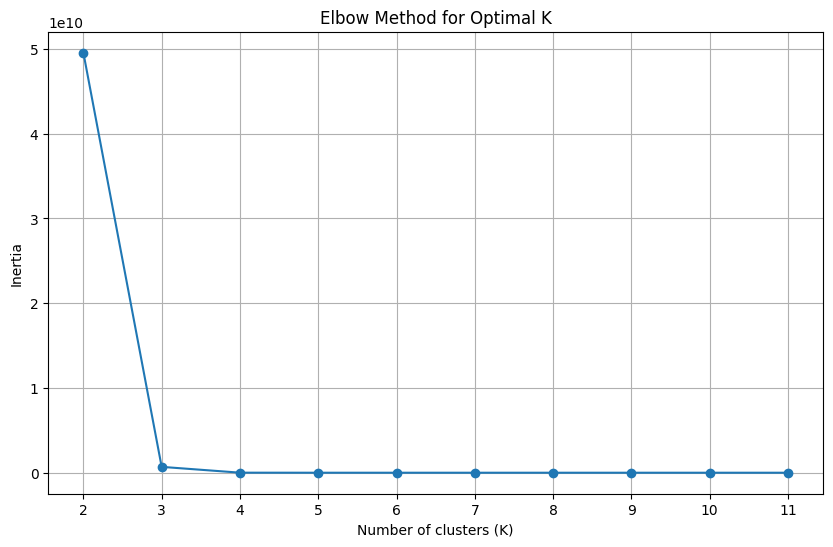

./elbow_test_export/SS-F_csv_10_77845_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         2         1       9506.6    109.8700        0
1   1000000.0         1         1      57603.0  99722.0000        1
2     10000.0         3        15      22331.0   1447.1000        0
3     10000.0         2         3      25630.0   4190.6000        0
4        10.0         6        15      19637.0      4.6353        0
5    100000.0         2        18      34687.0  28743.0000        2
6     10000.0         3        18      21871.0   1573.4000        0
7       100.0         6         1      10467.0    102.5400        0
8     10000.0         6         1      11814.0   8104.6000        0
9        10.0         3         3      16797.0      6.4150        0
10    10000.0         2         9      34739.0   3308.0000        0
11       10.0         3        12      17287.0      6.1786        0
12     1000.0         3         3      22331

<Figure size 640x480 with 0 Axes>

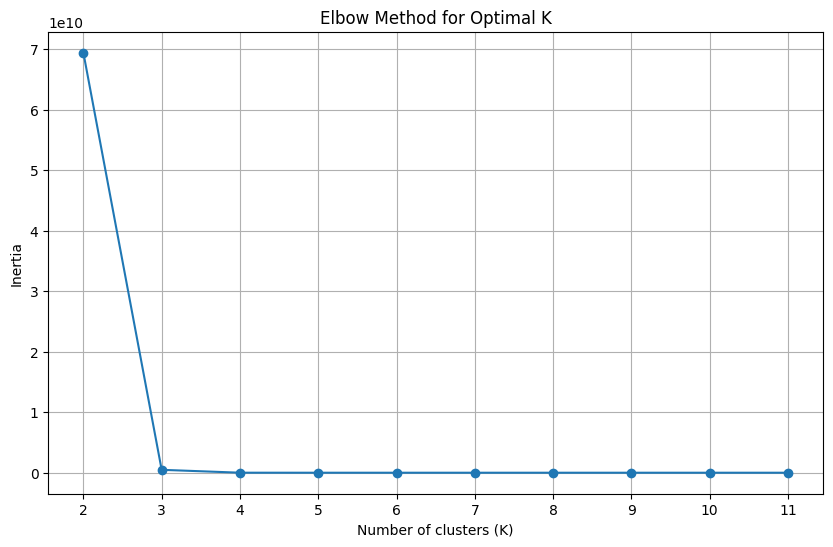

./elbow_test_export/SS-F_csv_10_83686_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         1         3       4508.5      2.2534        0
1      1000.0         6         1       9328.2   1175.0000        0
2   1000000.0         3         6      18902.0   1623.2000        1
3    100000.0         1         6      19583.0  46923.0000        2
4   1000000.0         6        12      28919.0    741.0200        1
5      1000.0         6         9      26511.0    307.3300        0
6       100.0         2         3      24998.0     49.5840        0
7       100.0         6         3      22524.0     47.0470        0
8       100.0         3        15      22544.0     47.8470        0
9     10000.0         3        15      22331.0   1447.1000        0
10  1000000.0         6         6      28016.0    890.1100        1
11  1000000.0         6        18      28388.0    887.6700        1
12       10.0         3         1       8400

<Figure size 640x480 with 0 Axes>

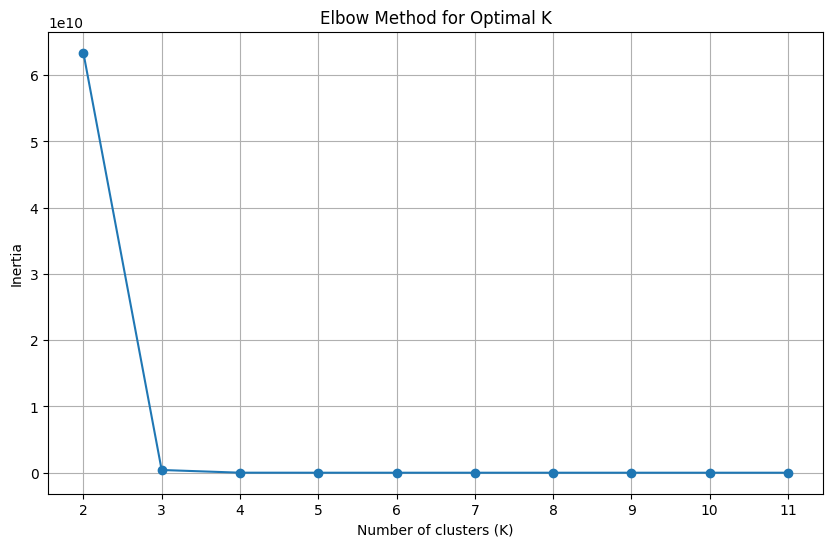

./elbow_test_export/SS-F_csv_10_84967_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         6         6      24578.0     38.3870        0
1        10.0         6        15      19637.0      4.6353        0
2         1.0         2        12       4686.7      2.2306        0
3      1000.0         1        15      25778.0    412.5000        0
4      1000.0         2         6      31480.0    342.6500        0
5   1000000.0         6         1      52828.0  73243.0000        1
6      1000.0         1        18      25595.0    446.0300        0
7    100000.0         1        18      21202.0  45261.0000        2
8       100.0         2        18      33784.0     32.8830        0
9        10.0         6         6      19636.0      4.7110        0
10      100.0         1         3      21959.0     53.8570        0
11        1.0         1         9       4404.4      2.3335        0
12   100000.0         6         6      25775

<Figure size 640x480 with 0 Axes>

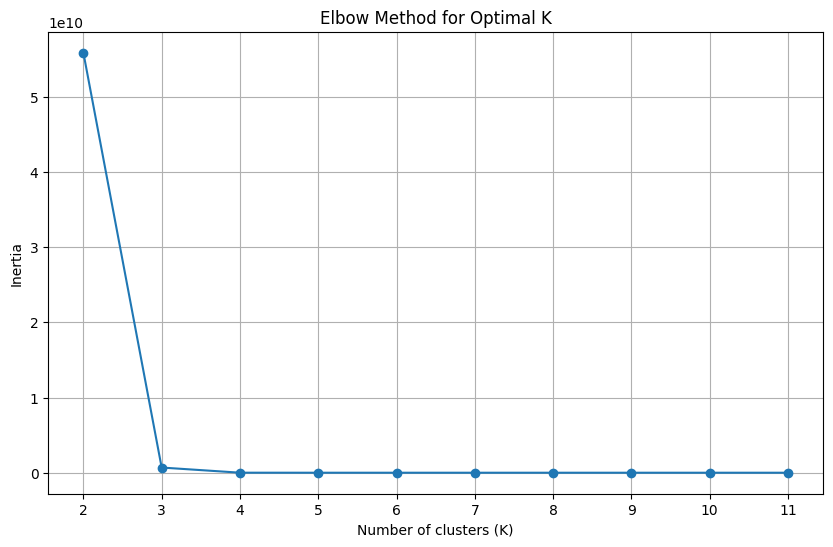

./elbow_test_export/SS-F_csv_10_86331_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0    100000.0         2        12      35034.0  28760.0000        2
1        10.0         2        15      22447.0      4.7671        1
2    100000.0         2        18      34687.0  28743.0000        2
3   1000000.0         3         3      19409.0   1785.0000        0
4     10000.0         3         9      21810.0   1437.6000        1
5     10000.0         2         6      33463.0   3441.6000        1
6       100.0         2         1       9506.6    109.8700        1
7    100000.0         1         6      19583.0  46923.0000        2
8    100000.0         6        15      27609.0    931.8900        2
9       100.0         1        12      22410.0     48.0320        1
10       10.0         3         3      16797.0      6.4150        1
11  1000000.0         2        18      53112.0  69276.0000        0
12  1000000.0         3        15      21614

<Figure size 640x480 with 0 Axes>

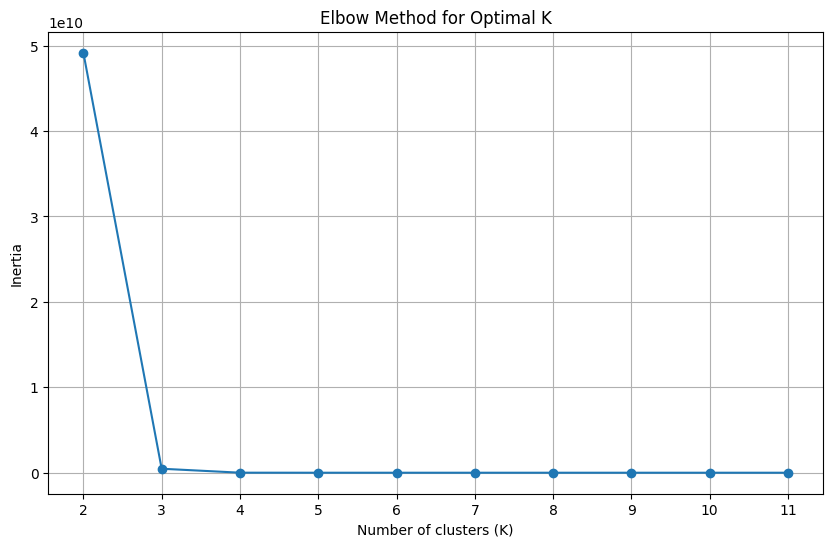

./elbow_test_export/SS-G_csv_10_11514_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         3         3      17810.0   2023.7000        1
1     10000.0         3        15      18857.0   1717.1000        0
2        10.0         3        18      16158.0      6.5150        0
3    100000.0         2         3      23864.0  37378.0000        2
4    100000.0         6         1       7625.9  61107.0000        2
5   1000000.0         1         1      48918.0  93904.0000        1
6   1000000.0         6         3      20157.0   1979.7000        1
7       100.0         3         6      20076.0     55.6090        0
8       100.0         6         1       8636.8    123.0300        0
9   1000000.0         1        15      39811.0  83368.0000        1
10   100000.0         2         6      26935.0  36587.0000        2
11       10.0         6         1       7599.1     13.8740        0
12    10000.0         1        15      19210

<Figure size 640x480 with 0 Axes>

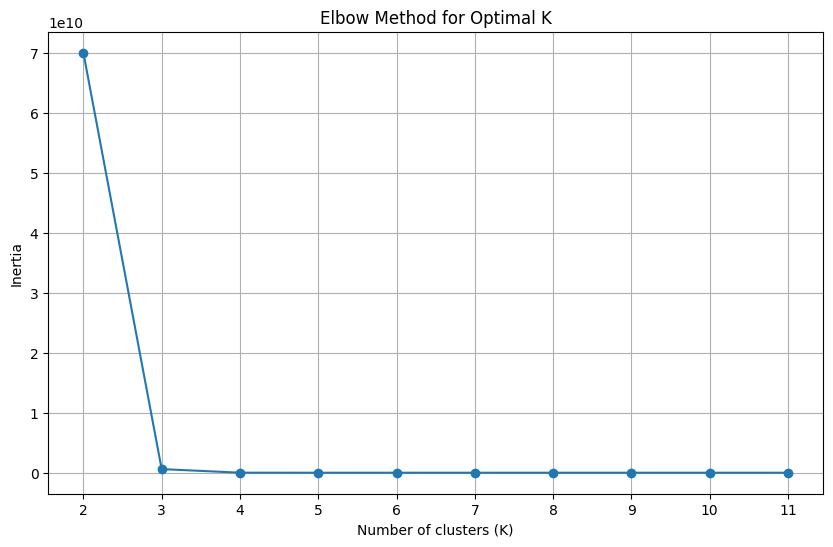

./elbow_test_export/SS-G_csv_10_19953_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1        12      22722.0    494.2900        2
1       100.0         1         3      17561.0     66.2780        2
2      1000.0         3         9      20589.0    537.3400        2
3      1000.0         2        12      33903.0    348.4900        2
4         1.0         3         3       4742.8      2.2434        2
5   1000000.0         1         3      43144.0  77076.0000        1
6    100000.0         1         3      17260.0  57080.0000        0
7        10.0         3        12      15038.0      7.0763        2
8         1.0         2        12       4224.6      2.4514        2
9     10000.0         1         9      18112.0   6255.3000        2
10       10.0         1         1       7494.8     15.2670        2
11      100.0         1        18      21201.0     51.0090        2
12       10.0         2        15      18564

<Figure size 640x480 with 0 Axes>

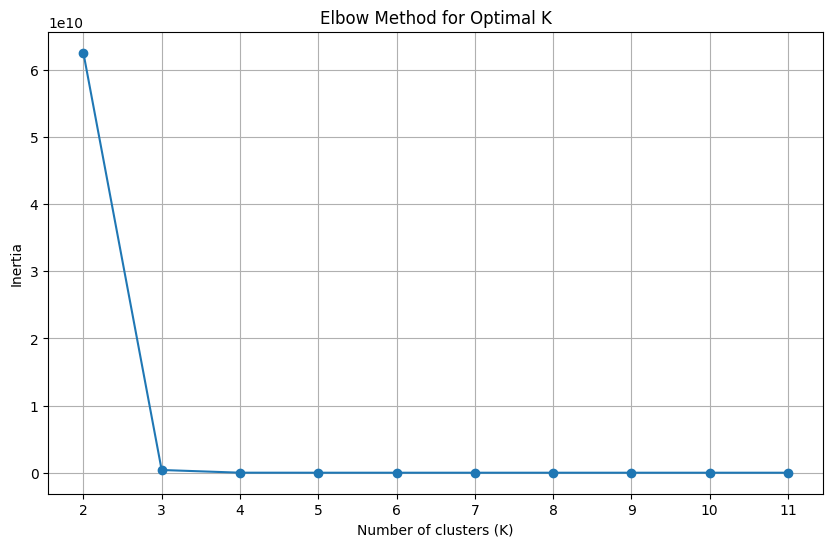

./elbow_test_export/SS-G_csv_10_3545_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         3         9       4646.2      2.2873        0
1       100.0         6        15      21993.0     42.0930        0
2   1000000.0         6        12      26336.0    855.8000        1
3   1000000.0         1        18      46272.0  83169.0000        1
4      1000.0         6         9      24362.0    345.3800        0
5   1000000.0         6         1      36125.0  46551.0000        1
6        10.0         3        15      15777.0      6.9694        0
7      1000.0         6         6      25035.0    343.8500        0
8        10.0         3        12      15038.0      7.0763        0
9        10.0         3         3      14028.0      8.6410        0
10        1.0         1        12       4032.0      2.6341        0
11   100000.0         2         1       6209.4  83712.0000        2
12   100000.0         3         6      17406.

<Figure size 640x480 with 0 Axes>

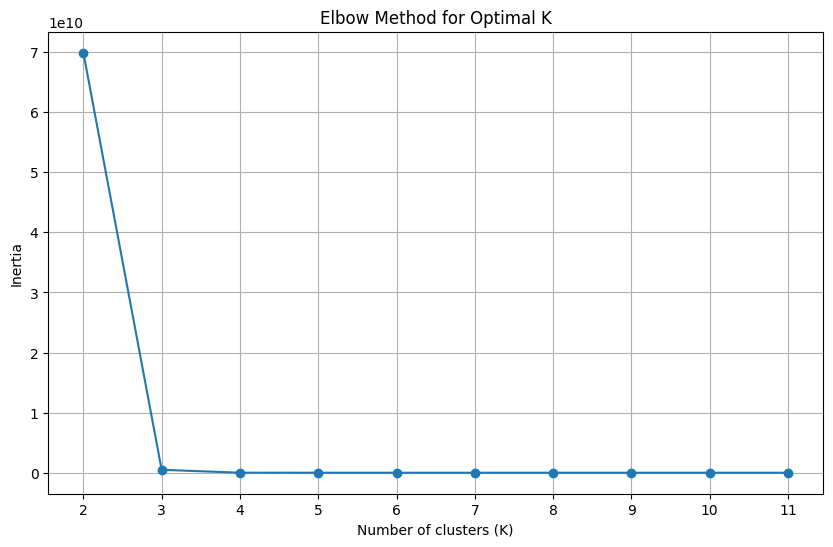

./elbow_test_export/SS-G_csv_10_39658_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        10.0         1         3      12690.0      9.0425        2
1        10.0         6         6      17588.0      5.4324        2
2      1000.0         6        12      23951.0    419.3100        2
3        10.0         6        18      17697.0      5.2977        2
4    100000.0         2        15      29311.0  33300.0000        0
5     10000.0         3        12      18735.0   1760.2000        2
6    100000.0         6         6      24924.0    869.0000        0
7       100.0         6         6      21305.0     46.8380        2
8        10.0         6         3      16448.0      6.6913        2
9        10.0         2        15      18564.0      5.8220        2
10    10000.0         3         3      18253.0   1943.9000        2
11  1000000.0         2        12      60713.0  73693.0000        1
12        1.0         1         1       4123

<Figure size 640x480 with 0 Axes>

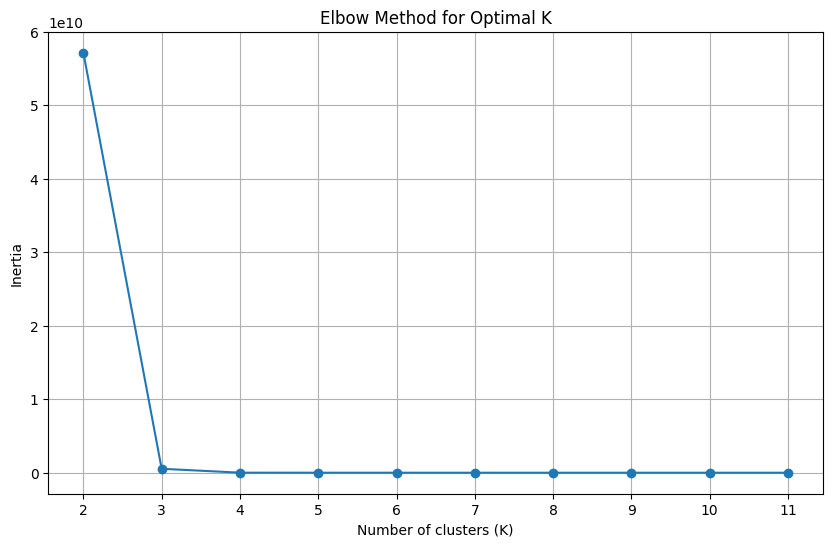

./elbow_test_export/SS-G_csv_10_40749_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0     10000.0         1         9      18112.0   6255.3000        2
1      1000.0         2        18      34045.0    334.4400        2
2   1000000.0         2        18      63113.0  76115.0000        1
3       100.0         1        15      17886.0     62.3450        2
4    100000.0         2         3      23864.0  37378.0000        0
5      1000.0         3         6      20312.0    555.6800        2
6       100.0         2        15      28395.0     36.8610        2
7     10000.0         2         1       6913.8  14710.0000        2
8   1000000.0         2         3      41319.0  90593.0000        1
9     10000.0         1        15      19210.0   6260.9000        2
10  1000000.0         1         9      35978.0  85576.0000        1
11   100000.0         1        18      20186.0  46405.0000        0
12   100000.0         6         1       7625

<Figure size 640x480 with 0 Axes>

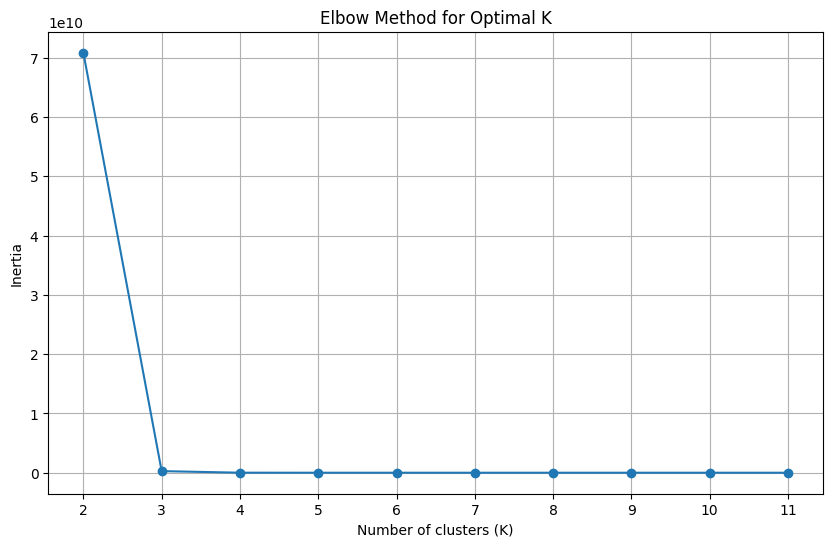

./elbow_test_export/SS-G_csv_10_44845_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         3        18      19610.0     59.4780        0
1       100.0         3         3      17860.0     61.2240        0
2        10.0         3        18      16158.0      6.5150        0
3     10000.0         6        15      25023.0    809.0500        0
4         1.0         2         1       4097.1      2.6345        0
5     10000.0         1         9      18112.0   6255.3000        0
6        10.0         3         1       7221.4     19.8490        0
7      1000.0         6         1       9131.9   1299.1000        0
8        10.0         1         1       7494.8     15.2670        0
9         1.0         2         9       4212.6      2.4867        0
10       10.0         2         3      13898.0      7.9557        0
11  1000000.0         3         9      19653.0   1953.2000        1
12   100000.0         1         1       7445

<Figure size 640x480 with 0 Axes>

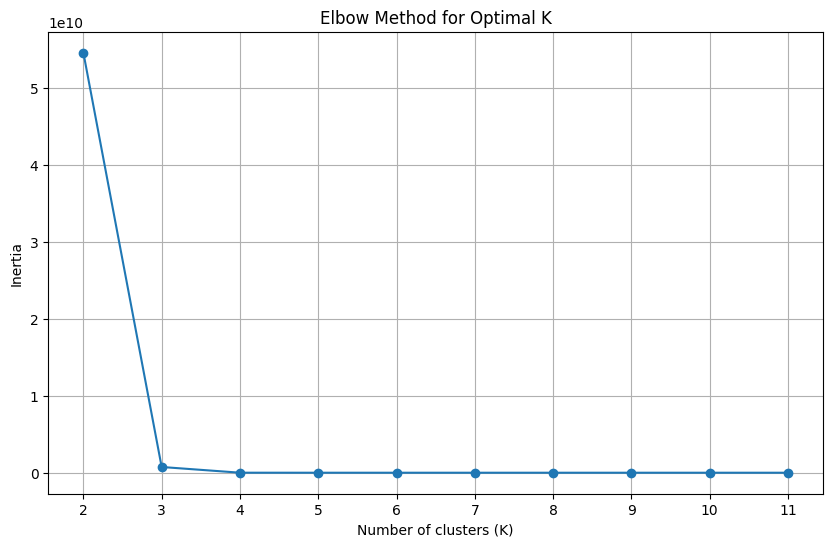

./elbow_test_export/SS-G_csv_10_51176_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1        15      20768.0    560.9800        2
1     10000.0         2         9      30740.0   3751.1000        2
2         1.0         6         9       4568.4      2.2659        2
3     10000.0         2        15      27830.0   3523.8000        2
4   1000000.0         1        15      39811.0  83368.0000        1
5      1000.0         1         6      22127.0    540.9800        2
6       100.0         2        12      26077.0     39.5960        2
7      1000.0         3        15      19776.0    602.7200        2
8       100.0         6         9      22039.0     41.5810        2
9     10000.0         3         6      16018.0   2153.4000        2
10  1000000.0         6        15      25389.0    812.2000        1
11        1.0         2         3       4213.6      2.4483        2
12  1000000.0         2         3      41319

<Figure size 640x480 with 0 Axes>

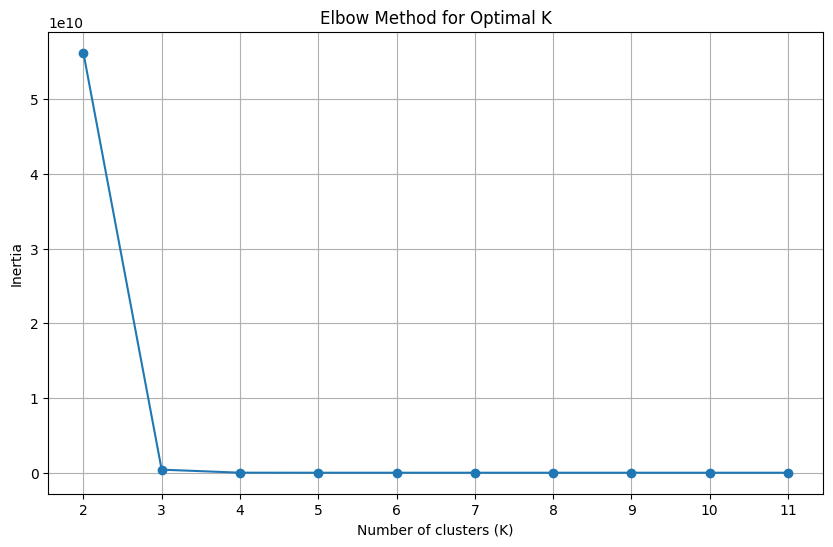

./elbow_test_export/SS-G_csv_10_58612_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0        10.0         3        15      15777.0      6.9694        0
1    100000.0         3         3      18159.0   1781.5000        2
2         1.0         2         9       4212.6      2.4867        0
3        10.0         3        18      16158.0      6.5150        0
4         1.0         3         1       4869.9      2.2345        0
5         1.0         3         3       4742.8      2.2434        0
6   1000000.0         1        15      39811.0  83368.0000        1
7         1.0         2         1       4097.1      2.6345        0
8       100.0         3         3      17860.0     61.2240        0
9         1.0         2         3       4213.6      2.4483        0
10   100000.0         6        12      25490.0    953.1900        2
11    10000.0         6         9      25614.0   1220.9000        0
12    10000.0         2         6      27670

<Figure size 640x480 with 0 Axes>

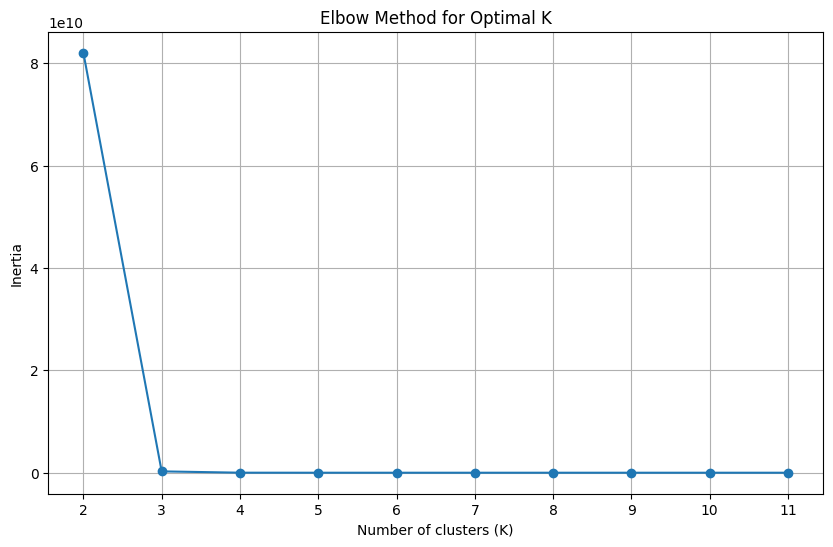

./elbow_test_export/SS-G_csv_10_61367_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1        15      20768.0    560.9800        0
1      1000.0         6        15      24693.0    277.7400        0
2       100.0         6         1       8636.8    123.0300        0
3        10.0         2         3      13898.0      7.9557        0
4   1000000.0         2        12      60713.0  73693.0000        1
5       100.0         3         1       7864.7    131.9200        0
6    100000.0         6        15      26714.0    985.5700        2
7        10.0         2         9      18656.0      5.6942        0
8        10.0         3        18      16158.0      6.5150        0
9         1.0         3        12       4589.6      2.2376        0
10   100000.0         1         3      17260.0  57080.0000        2
11      100.0         6        15      21993.0     42.0930        0
12      100.0         6         6      21305

<Figure size 640x480 with 0 Axes>

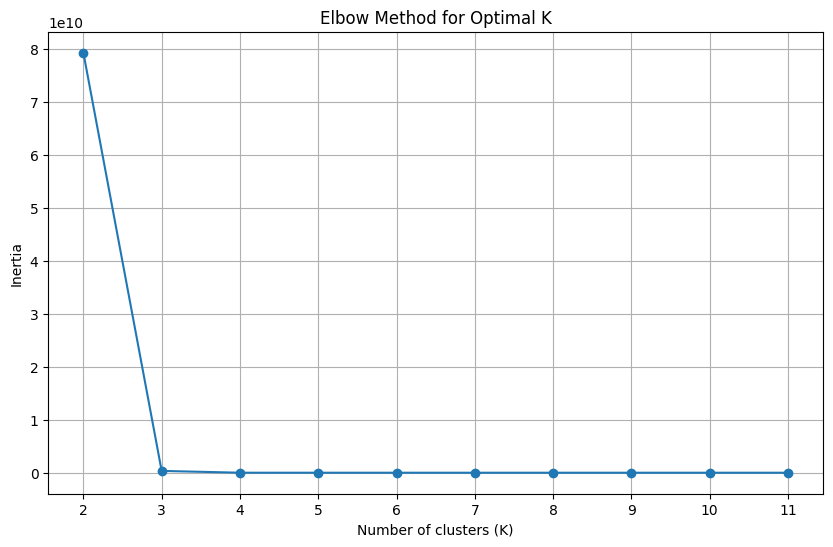

./elbow_test_export/SS-G_csv_10_65388_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         6        12       4638.4      2.2965        0
1    100000.0         2        18      32366.0  28518.0000        2
2       100.0         2         3      18789.0     60.3800        0
3   1000000.0         1        18      46272.0  83169.0000        1
4    100000.0         3        12      19027.0   1568.1000        2
5    100000.0         3         6      17406.0   2010.2000        2
6       100.0         3         3      17860.0     61.2240        0
7        10.0         6        18      17697.0      5.2977        0
8   1000000.0         1         9      35978.0  85576.0000        1
9        10.0         1        15      13048.0      8.2902        0
10       10.0         6         1       7599.1     13.8740        0
11        1.0         1         9       4059.4      2.5699        0
12       10.0         1         1       7494

<Figure size 640x480 with 0 Axes>

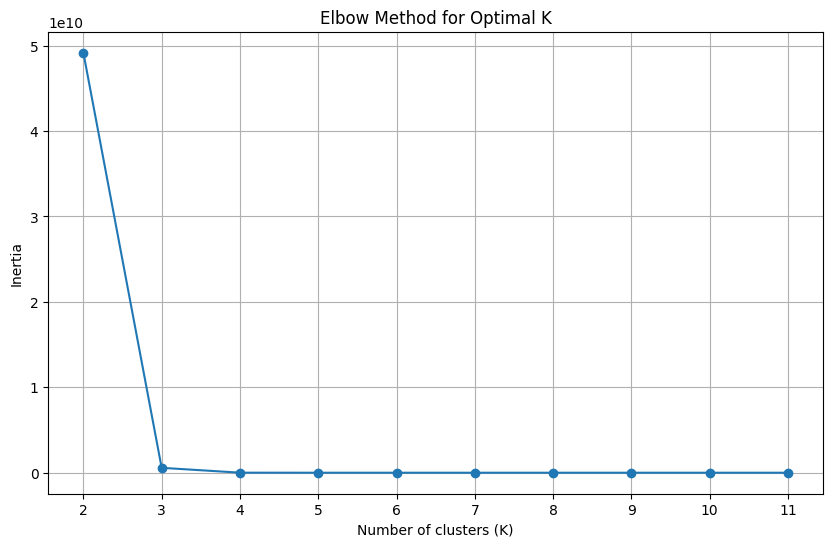

./elbow_test_export/SS-G_csv_10_65444_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         3        12      20562.0    523.6300        2
1   1000000.0         2         6      52611.0  82576.0000        1
2    100000.0         6        18      27324.0    865.8300        0
3   1000000.0         2         9      61403.0  52488.0000        1
4     10000.0         2         6      27670.0   3923.0000        2
5         1.0         1        15       3983.3      2.5850        2
6     10000.0         6        15      25023.0    809.0500        2
7       100.0         1        15      17886.0     62.3450        2
8    100000.0         3        18      17900.0   1829.9000        0
9         1.0         3         6       4745.9      2.2740        2
10  1000000.0         3        18      20100.0   1692.8000        1
11  1000000.0         6        18      26278.0   1019.7000        1
12    10000.0         6         9      25614

<Figure size 640x480 with 0 Axes>

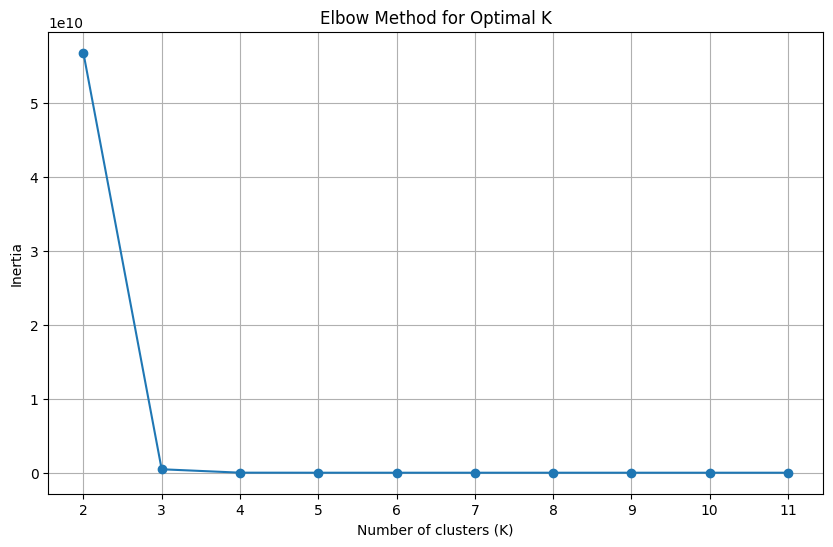

./elbow_test_export/SS-G_csv_10_66946_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         6         3      20157.0   1979.7000        1
1   1000000.0         2         6      52611.0  82576.0000        1
2         1.0         6         1       4849.6      2.3172        0
3         1.0         2         9       4212.6      2.4867        0
4         1.0         6         6       4716.8      2.1994        0
5      1000.0         1         3      20665.0    547.7700        0
6        10.0         3        15      15777.0      6.9694        0
7     10000.0         6         1       8058.1  11121.0000        0
8    100000.0         1         6      18566.0  51016.0000        2
9       100.0         1        18      21201.0     51.0090        0
10     1000.0         6         1       9131.9   1299.1000        0
11     1000.0         3         3      18655.0    579.2900        0
12       10.0         2         1       6876

<Figure size 640x480 with 0 Axes>

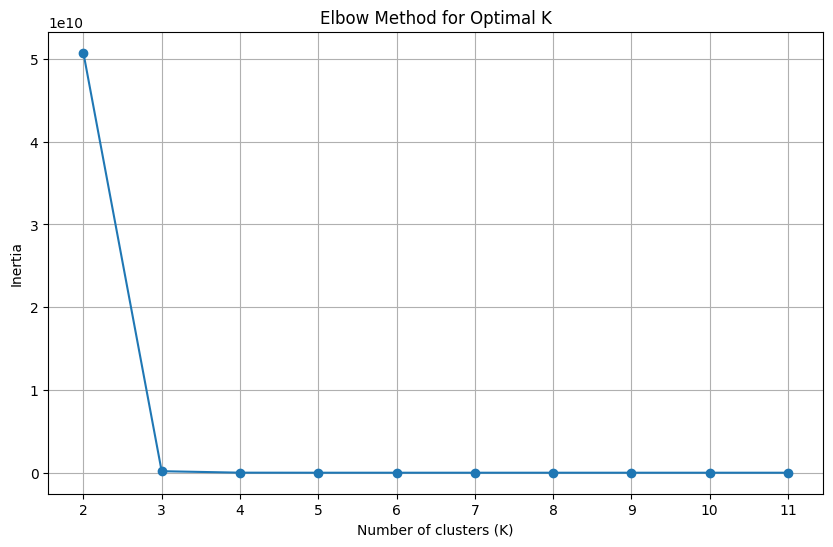

./elbow_test_export/SS-G_csv_10_69024_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         1         6      22127.0    540.9800        0
1       100.0         6         6      21305.0     46.8380        0
2        10.0         2        18      18872.0      5.7040        0
3         1.0         6        18       4702.3      2.2763        0
4       100.0         3         3      17860.0     61.2240        0
5         1.0         6         6       4716.8      2.1994        0
6   1000000.0         6         6      24009.0   1028.0000        1
7    100000.0         2        18      32366.0  28518.0000        2
8        10.0         6        15      18604.0      5.2717        0
9       100.0         3         6      20076.0     55.6090        0
10     1000.0         3        12      20562.0    523.6300        0
11  1000000.0         6        12      26336.0    855.8000        1
12     1000.0         1        12      22722

<Figure size 640x480 with 0 Axes>

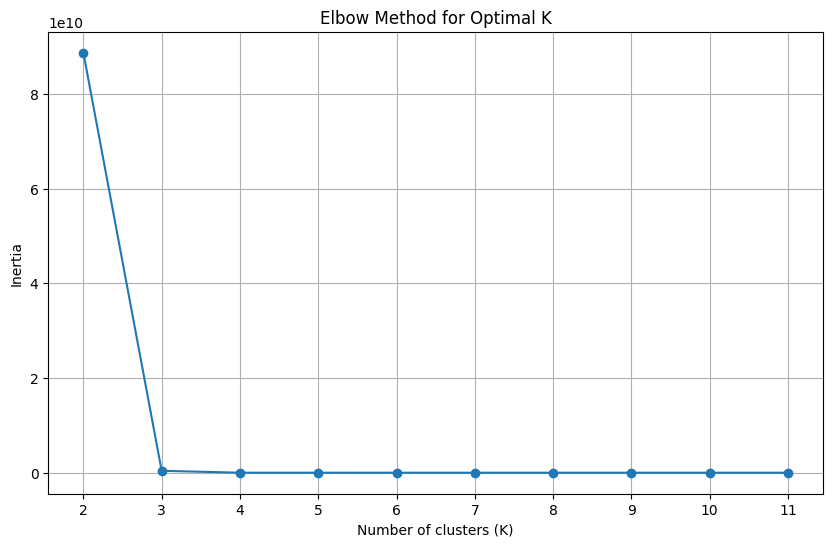

./elbow_test_export/SS-G_csv_10_70006_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0      1000.0         2        15      35508.0    330.1300        2
1   1000000.0         3         6      18378.0   1747.9000        1
2        10.0         1        18      13618.0      8.6734        2
3       100.0         1         9      19721.0     62.5120        2
4        10.0         1         1       7494.8     15.2670        2
5   1000000.0         1         9      35978.0  85576.0000        1
6   1000000.0         1         6      32533.0  79764.0000        1
7       100.0         1         3      17561.0     66.2780        2
8      1000.0         1         6      22127.0    540.9800        2
9     10000.0         2        12      31890.0   3379.6000        2
10   100000.0         3         1       9988.9  64176.0000        0
11   100000.0         1         6      18566.0  51016.0000        0
12        1.0         1         9       4059

<Figure size 640x480 with 0 Axes>

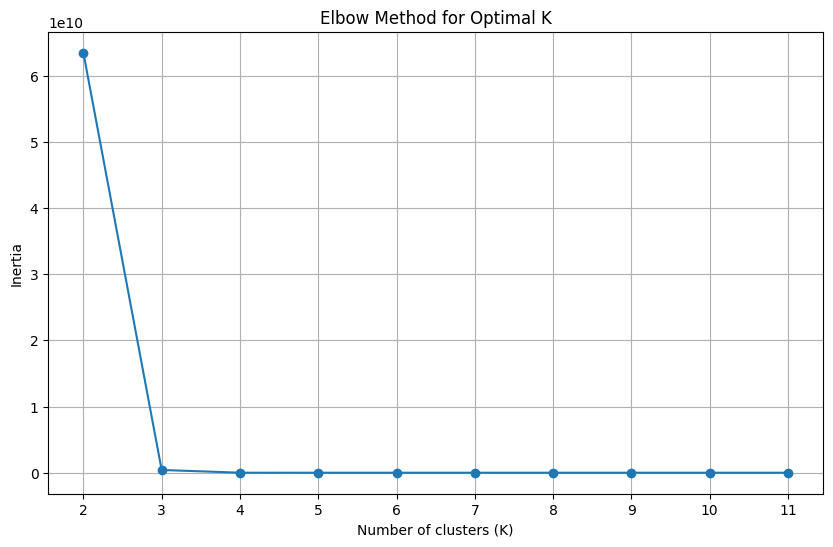

./elbow_test_export/SS-G_csv_10_70292_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0   1000000.0         2         1      35943.0  70293.0000        1
1         1.0         1        15       3983.3      2.5850        0
2       100.0         2         3      18789.0     60.3800        0
3         1.0         3        12       4589.6      2.2376        0
4         1.0         1        12       4032.0      2.6341        0
5      1000.0         6        12      23951.0    419.3100        0
6         1.0         6        15       4642.1      2.2694        0
7    100000.0         3        15      19488.0   1556.2000        2
8    100000.0         1         1       7445.7  74603.0000        2
9         1.0         1         3       4098.6      2.5385        0
10      100.0         3         3      17860.0     61.2240        0
11    10000.0         3        12      18735.0   1760.2000        0
12     1000.0         3        12      20562

<Figure size 640x480 with 0 Axes>

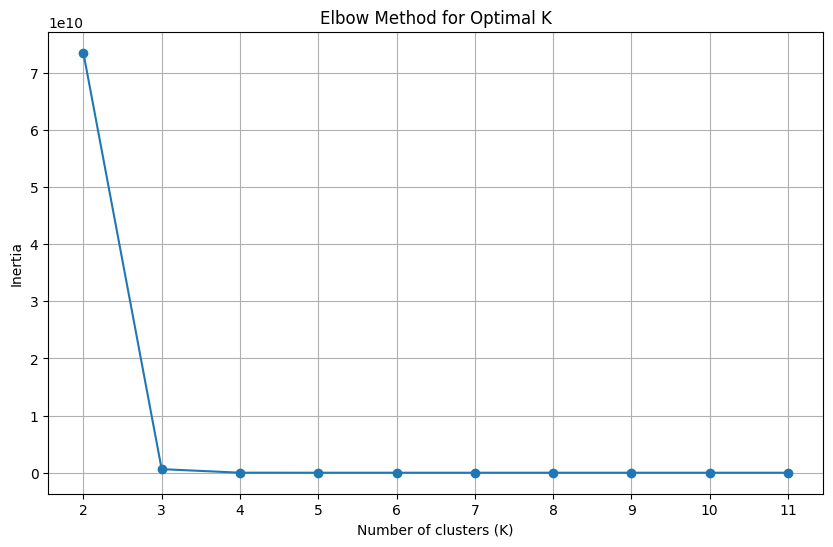

./elbow_test_export/SS-G_csv_10_77340_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0     10000.0         2         3      23990.0   4735.0000        0
1     10000.0         3         9      19366.0   1781.6000        0
2    100000.0         6        18      27324.0    865.8300        2
3     10000.0         2        15      27830.0   3523.8000        0
4    100000.0         6         3      19790.0   2276.2000        2
5    100000.0         3        18      17900.0   1829.9000        2
6     10000.0         3         3      18253.0   1943.9000        0
7      1000.0         2        18      34045.0    334.4400        0
8       100.0         6        15      21993.0     42.0930        0
9        10.0         1         3      12690.0      9.0425        0
10        1.0         1         6       4176.9      2.5477        0
11  1000000.0         2        12      60713.0  73693.0000        1
12     1000.0         6        15      24693

<Figure size 640x480 with 0 Axes>

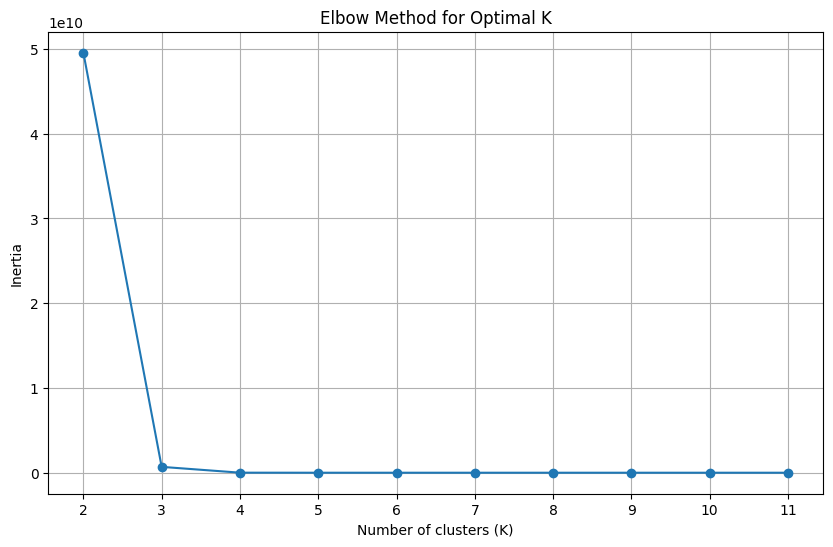

./elbow_test_export/SS-G_csv_10_77845_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         2         1       7677.3    137.6300        0
1   1000000.0         1         1      48918.0  93904.0000        1
2     10000.0         3        15      18857.0   1717.1000        0
3     10000.0         2         3      23990.0   4735.0000        0
4        10.0         6        15      18604.0      5.2717        0
5    100000.0         2        18      32366.0  28518.0000        2
6     10000.0         3        18      19010.0   1792.1000        0
7       100.0         6         1       8636.8    123.0300        0
8     10000.0         6         1       8058.1  11121.0000        0
9        10.0         3         3      14028.0      8.6410        0
10    10000.0         2         9      30740.0   3751.1000        0
11       10.0         3        12      15038.0      7.0763        0
12     1000.0         3         3      18655

<Figure size 640x480 with 0 Axes>

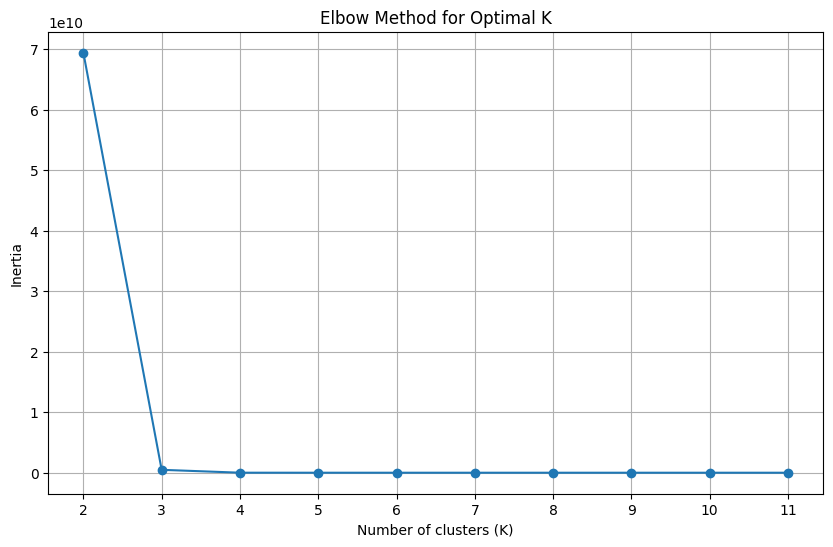

./elbow_test_export/SS-G_csv_10_83686_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0         1.0         1         3       4098.6      2.5385        0
1      1000.0         6         1       9131.9   1299.1000        0
2   1000000.0         3         6      18378.0   1747.9000        1
3    100000.0         1         6      18566.0  51016.0000        2
4   1000000.0         6        12      26336.0    855.8000        1
5      1000.0         6         9      24362.0    345.3800        0
6       100.0         2         3      18789.0     60.3800        0
7       100.0         6         3      19318.0     47.3480        0
8       100.0         3        15      20075.0     57.0990        0
9     10000.0         3        15      18857.0   1717.1000        0
10  1000000.0         6         6      24009.0   1028.0000        1
11  1000000.0         6        18      26278.0   1019.7000        1
12       10.0         3         1       7221

<Figure size 640x480 with 0 Axes>

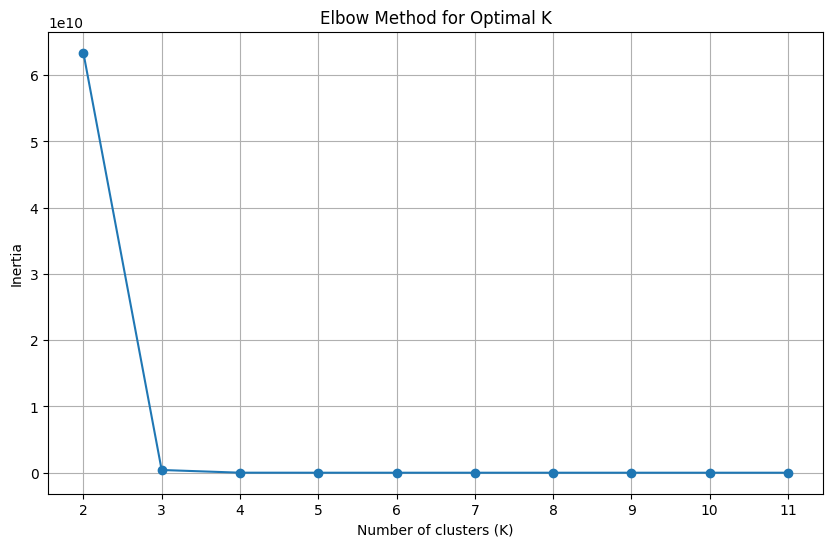

./elbow_test_export/SS-G_csv_10_84967_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0       100.0         6         6      21305.0     46.8380        0
1        10.0         6        15      18604.0      5.2717        0
2         1.0         2        12       4224.6      2.4514        0
3      1000.0         1        15      20768.0    560.9800        0
4      1000.0         2         6      28725.0    399.1300        0
5   1000000.0         6         1      36125.0  46551.0000        1
6      1000.0         1        18      23878.0    465.9200        0
7    100000.0         1        18      20186.0  46405.0000        2
8       100.0         2        18      28405.0     38.0970        0
9        10.0         6         6      17588.0      5.4324        0
10      100.0         1         3      17561.0     66.2780        0
11        1.0         1         9       4059.4      2.5699        0
12   100000.0         6         6      24924

<Figure size 640x480 with 0 Axes>

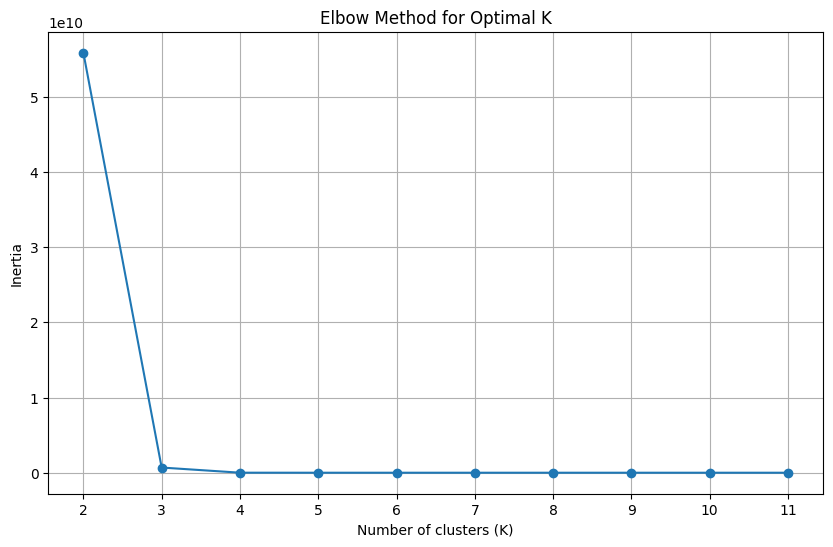

./elbow_test_export/SS-G_csv_10_86331_elbow_test.png
Optimal k value: 3
    Max_spout  Spliters  Counters  Throughput+    Latency-  cluster
0    100000.0         2        12      29893.0  34751.0000        2
1        10.0         2        15      18564.0      5.8220        1
2    100000.0         2        18      32366.0  28518.0000        2
3   1000000.0         3         3      17810.0   2023.7000        0
4     10000.0         3         9      19366.0   1781.6000        1
5     10000.0         2         6      27670.0   3923.0000        1
6       100.0         2         1       7677.3    137.6300        1
7    100000.0         1         6      18566.0  51016.0000        2
8    100000.0         6        15      26714.0    985.5700        2
9       100.0         1        12      20382.0     57.6350        1
10       10.0         3         3      14028.0      8.6410        1
11  1000000.0         2        18      63113.0  76115.0000        0
12  1000000.0         3        15      20226

<Figure size 640x480 with 0 Axes>

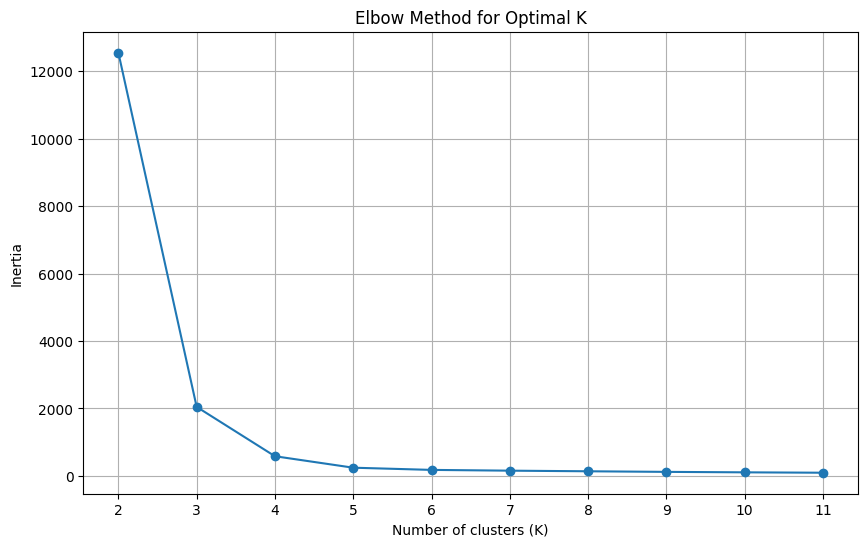

./elbow_test_export/SS-H_csv_10_11514_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       6           1     2          20  7.978390      5.111081        3
1       7           1     2          10  7.408083      5.099071        1
2       7           1     2          20  7.937150      5.112800        3
3       6           1     3          20  7.978390      5.111081        3
4       6           0     3          10  7.162583      5.102448        1
5       3           1     4         100  9.965784      5.066154        0
6       5           0     2           1  6.415404      4.837142        1
7       6           1     2          50  8.902719      5.117956        2
8       4           1     1         100  9.824529      5.104190        0
9       5           0     3           5  6.849712      5.068121        1
10      6           1     2         100  9.740248      5.121425        0
11      3           0     2           2  7.353588   

<Figure size 640x480 with 0 Axes>

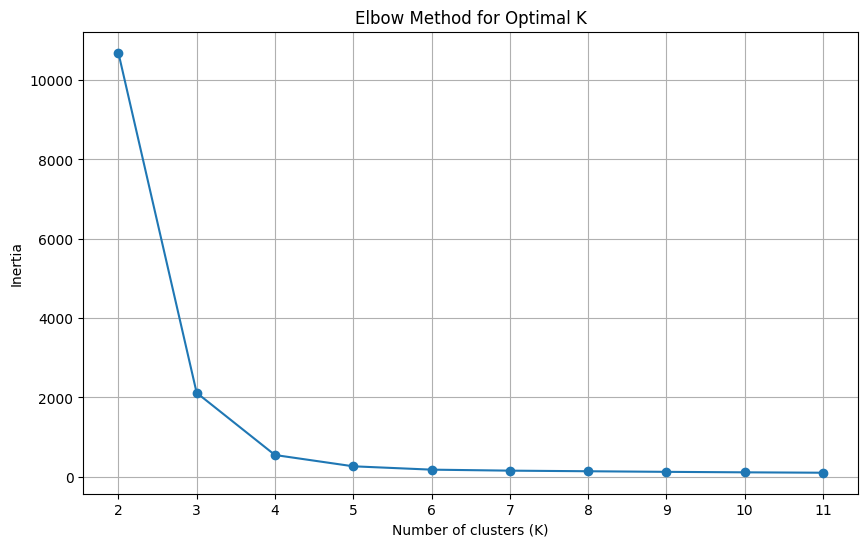

./elbow_test_export/SS-H_csv_10_19953_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       7           0     2           5  6.656067      5.083255        2
1       6           0     4          10  7.162583      5.102448        2
2       3           0     1           5  7.540787      4.946184        2
3       3           0     2         100  9.858304      5.066162        1
4       4           0     3          50  8.900257      5.101621        3
5       7           0     1         100  9.672986      5.123160        1
6       7           1     2           1  6.673217      4.878750        2
7       4           0     1           2  6.812883      4.915281        2
8       3           1     2           2  7.881934      4.679289        2
9       4           0     4          50  8.900257      5.101621        3
10      6           0     1          10  7.162583      5.102448        2
11      4           1     4           5  7.513254   

<Figure size 640x480 with 0 Axes>

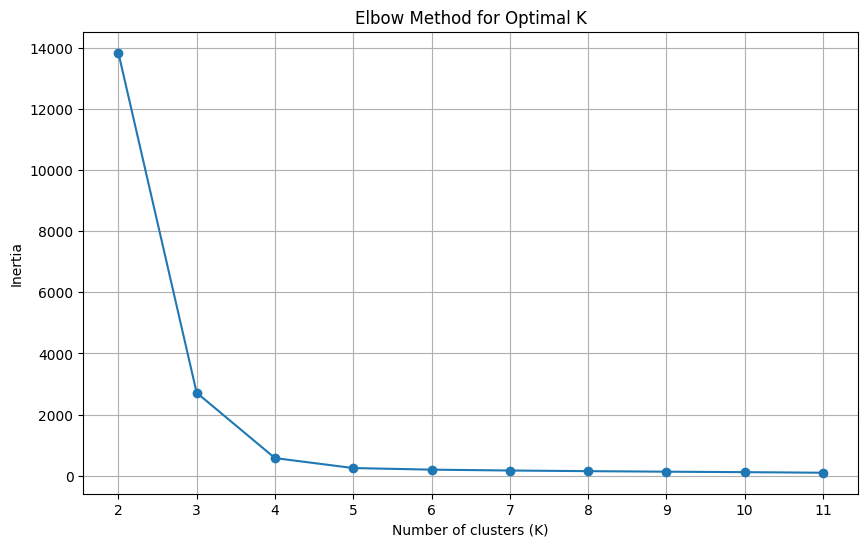

./elbow_test_export/SS-H_csv_10_3545_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       3           1     1           2  7.882967      4.667404        0
1       7           0     2           1  6.144515      4.923427        0
2       4           1     4          10  7.782710      5.080353        0
3       6           1     4          20  7.978390      5.111081        3
4       6           1     3          50  8.902719      5.117956        1
5       3           1     2           2  7.881934      4.679289        0
6       5           1     1          50  8.947272      5.114504        1
7       4           1     4           1  7.254651      4.687796        0
8       4           0     1          20  7.958239      5.096536        3
9       3           0     4          20  8.239069      5.051195        3
10      7           1     1         100  9.726830      5.123157        2
11      4           1     2          20  8.211626    

<Figure size 640x480 with 0 Axes>

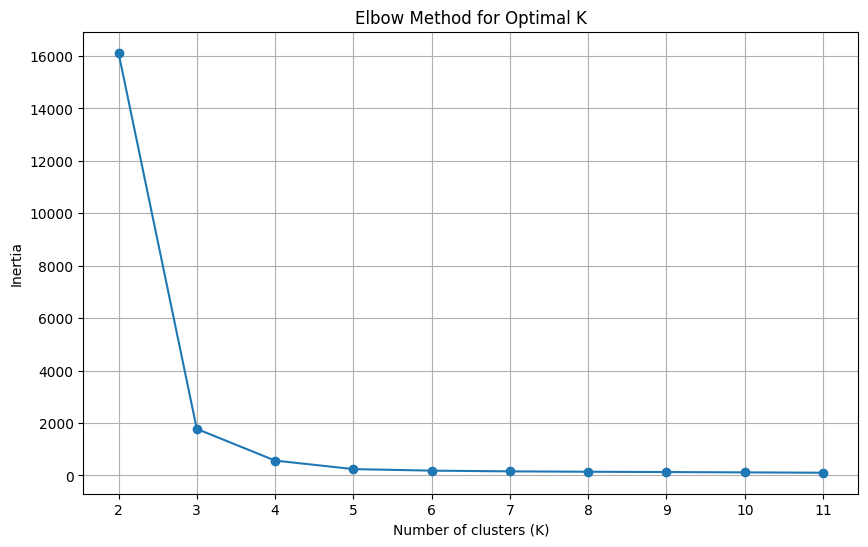

./elbow_test_export/SS-H_csv_10_39658_elbow_test.png
Optimal k value: 3
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       5           0     3         100  9.702370      5.117968        1
1       6           1     2           5  7.121689      5.069792        0
2       4           1     3          10  7.782710      5.080357        0
3       6           0     3           1  6.240143      4.894786        0
4       7           1     3           2  6.775696      4.998379        0
5       6           0     3          20  7.772288      5.113666        0
6       7           1     3          50  8.880040      5.119685        2
7       3           0     2           2  7.353588      4.718156        0
8       3           1     1          20  8.548710      5.046250        0
9       4           0     4         100  9.746890      5.104194        1
10      5           0     3           1  6.415404      4.837142        0
11      5           1     2           5  7.263870   

<Figure size 640x480 with 0 Axes>

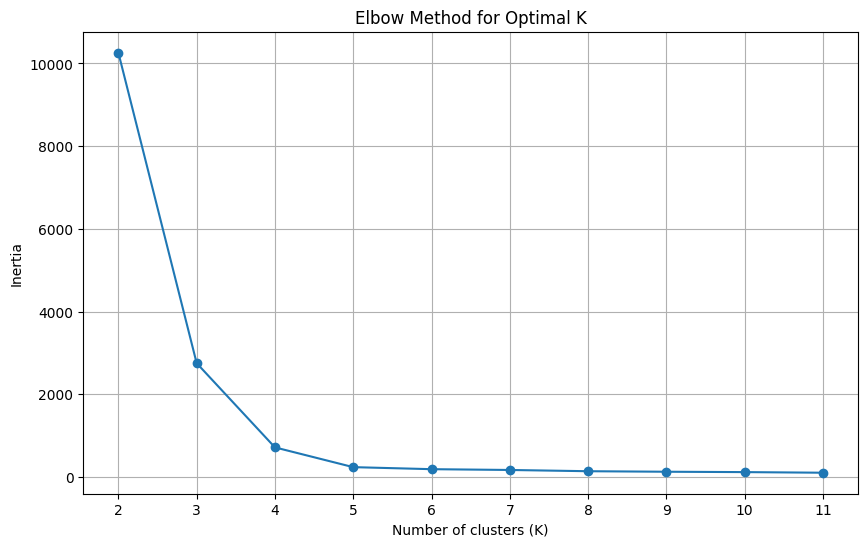

./elbow_test_export/SS-H_csv_10_40749_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       4           1     1          20  8.211626      5.093926        3
1       3           0     4           2  7.353588      4.718156        0
2       6           0     4           2  6.376724      5.007693        0
3       3           0     2          20  8.239069      5.051195        3
4       3           1     4          20  8.548710      5.046250        3
5       6           0     1         100  9.682816      5.121427        1
6       3           0     3           5  7.540787      4.946187        0
7       7           0     1           5  6.656067      5.083255        0
8       4           0     2           2  6.812883      4.915290        0
9       6           0     3          10  7.162583      5.102448        0
10      7           0     1           2  6.290129      5.022485        0
11      7           1     3          10  7.408083   

<Figure size 640x480 with 0 Axes>

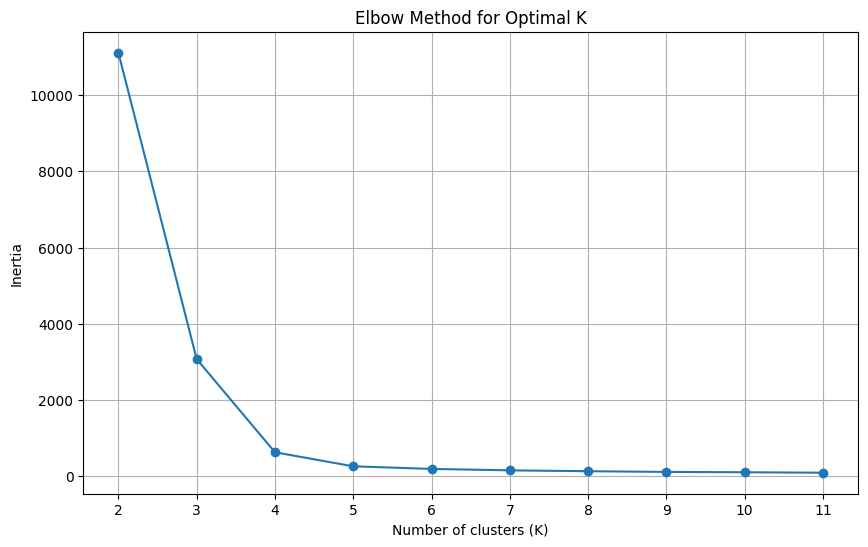

./elbow_test_export/SS-H_csv_10_44845_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       7           1     3           2  6.775696      4.998379        0
1       7           1     1          10  7.408083      5.099071        0
2       6           1     2          20  7.978390      5.111081        3
3       4           0     2          50  8.900257      5.101621        2
4       4           1     2           1  7.254651      4.687796        0
5       6           0     1          10  7.162583      5.102448        0
6       5           1     4          50  8.947272      5.114504        2
7       6           1     1          50  8.902719      5.117956        2
8       5           1     3         100  9.766852      5.117965        1
9       4           0     3           5  7.075886      5.041578        0
10      5           1     2          20  8.059182      5.107608        3
11      3           1     1         100  9.965784   

<Figure size 640x480 with 0 Axes>

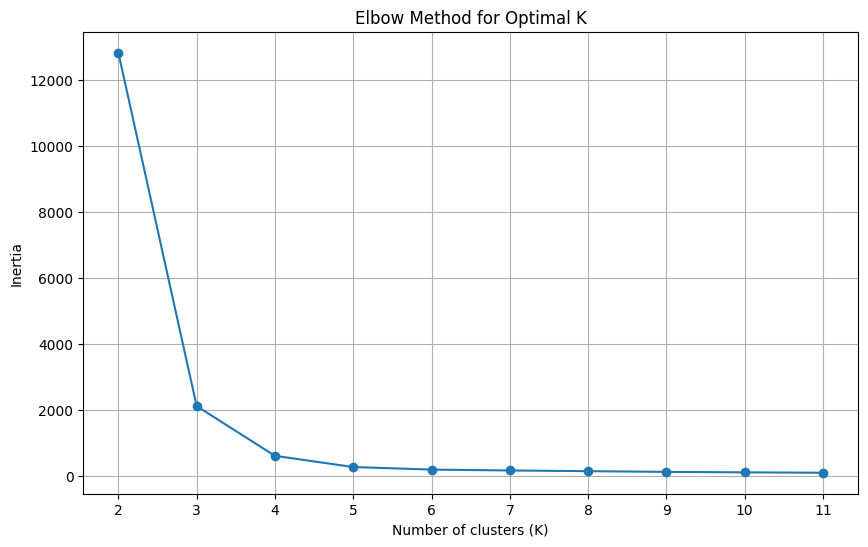

./elbow_test_export/SS-H_csv_10_51176_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       7           0     2          50  8.780969      5.120554        2
1       4           0     2           1  6.713325      4.726993        0
2       5           0     1           1  6.415404      4.837126        0
3       4           0     2          10  7.429867      5.085423        0
4       7           0     1          20  7.739754      5.115355        3
5       6           1     4         100  9.740248      5.121425        1
6       5           0     3          20  7.834932      5.110229        3
7       3           0     4         100  9.858304      5.066162        1
8       4           1     3           1  7.254651      4.687796        0
9       6           1     3           5  7.121689      5.069792        0
10      6           1     2           1  6.771371      4.850980        0
11      6           0     1          20  7.772288   

<Figure size 640x480 with 0 Axes>

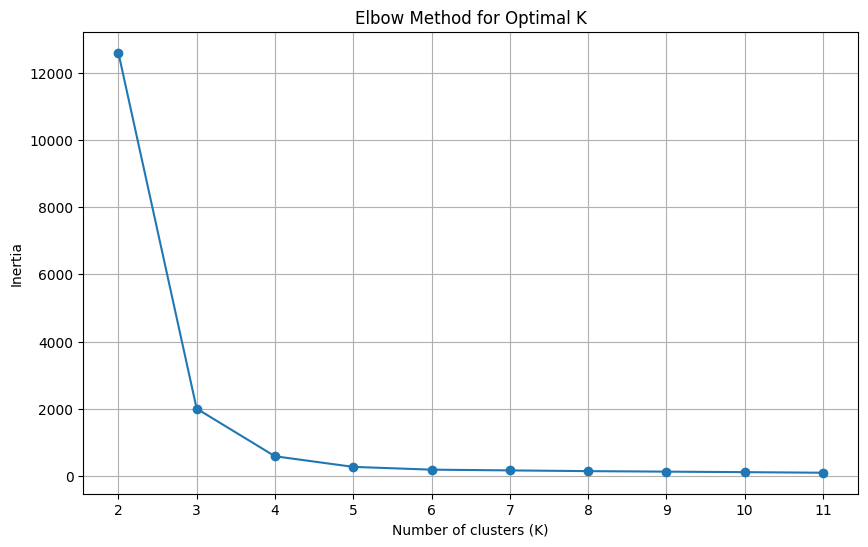

./elbow_test_export/SS-H_csv_10_58612_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       6           1     3           2  6.867242      4.983830        0
1       5           1     4          10  7.578984      5.093914        0
2       6           1     1          20  7.978390      5.111081        3
3       5           1     3         100  9.766852      5.117965        1
4       4           1     1           2  7.324190      4.889213        0
5       4           0     3          50  8.900257      5.101621        2
6       7           0     1          20  7.739754      5.115355        3
7       4           0     4           5  7.075886      5.041578        0
8       5           0     2           5  6.849712      5.068121        0
9       4           0     1           5  7.075886      5.041574        0
10      7           0     2           1  6.144515      4.923427        0
11      6           0     4          50  8.797687   

<Figure size 640x480 with 0 Axes>

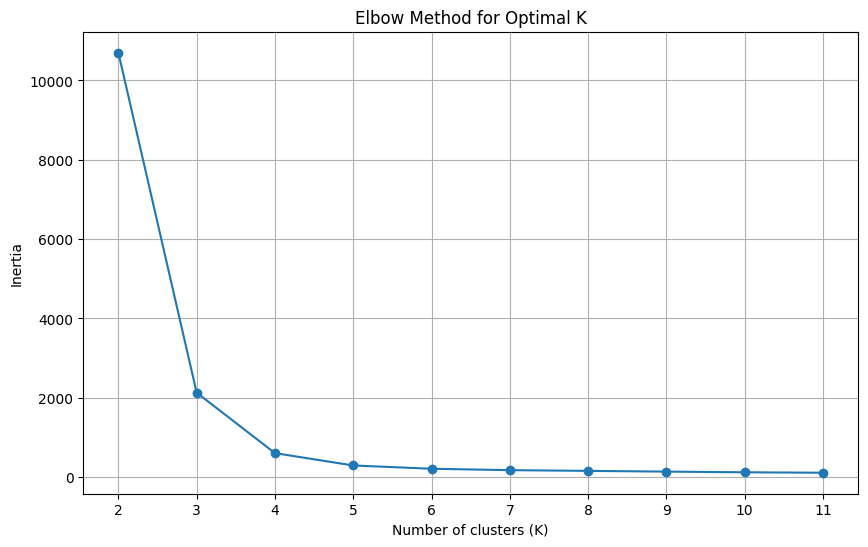

./elbow_test_export/SS-H_csv_10_61367_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       7           0     2          50  8.780969      5.120554        3
1       4           1     4         100  9.824529      5.104190        1
2       7           1     2          20  7.937150      5.112800        0
3       5           0     3           5  6.849712      5.068121        2
4       4           0     3           2  6.812883      4.915290        2
5       5           0     1           5  6.849712      5.068120        2
6       7           0     1          10  7.113784      5.104158        2
7       5           1     4           5  7.263870      5.058114        2
8       5           0     1           1  6.415404      4.837126        2
9       5           1     2           1  6.951937      4.795036        2
10      7           1     2           1  6.673217      4.878750        2
11      4           1     3           2  7.323784   

<Figure size 640x480 with 0 Axes>

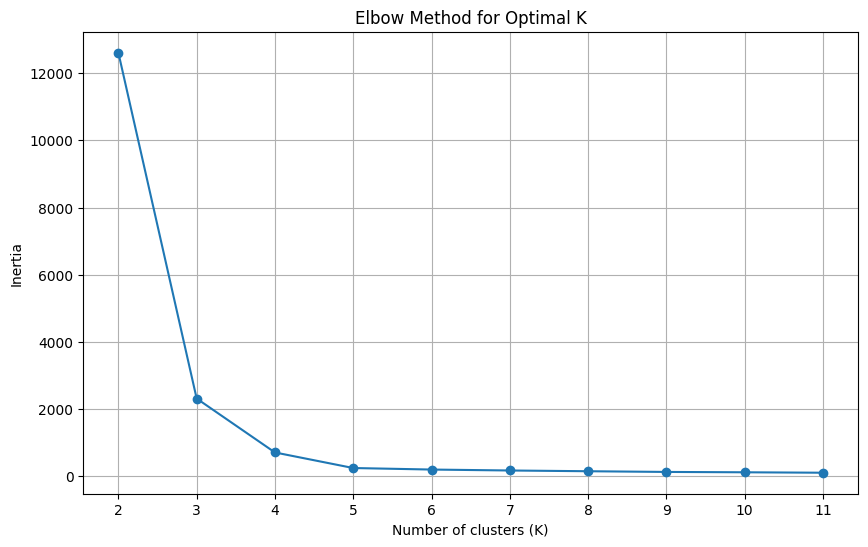

./elbow_test_export/SS-H_csv_10_65388_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       5           0     3           1  6.415404      4.837142        3
1       6           0     2          20  7.772288      5.113666        1
2       7           1     3           1  6.673217      4.878750        3
3       6           0     3           1  6.240143      4.894786        3
4       4           0     3          10  7.429867      5.085429        1
5       4           1     2           1  7.254651      4.687796        3
6       4           1     2          10  7.782710      5.080357        1
7       7           0     1           2  6.290129      5.022485        3
8       5           1     4          20  8.059182      5.107608        1
9       5           0     2           1  6.415404      4.837142        3
10      4           0     4          20  7.958239      5.096536        1
11      3           0     1          10  7.807606   

<Figure size 640x480 with 0 Axes>

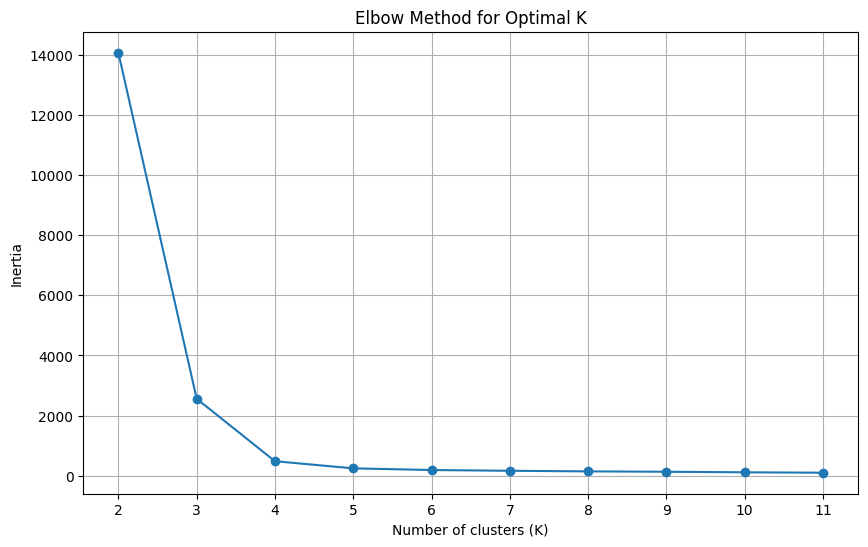

./elbow_test_export/SS-H_csv_10_65444_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       3           1     1          10  8.211465      5.019398        2
1       4           0     1           1  6.713338      4.726862        2
2       4           0     4          50  8.900257      5.101621        3
3       6           0     1           2  6.376724      5.007684        2
4       7           1     1          50  8.880040      5.119685        3
5       4           1     3          50  9.037629      5.100761        3
6       5           1     4           1  6.951937      4.795036        2
7       5           0     1           2  6.536877      4.976904        2
8       6           1     2           5  7.121689      5.069792        2
9       6           0     4          50  8.797687      5.118825        3
10      5           0     3           2  6.536861      4.976922        2
11      7           1     1         100  9.726830   

<Figure size 640x480 with 0 Axes>

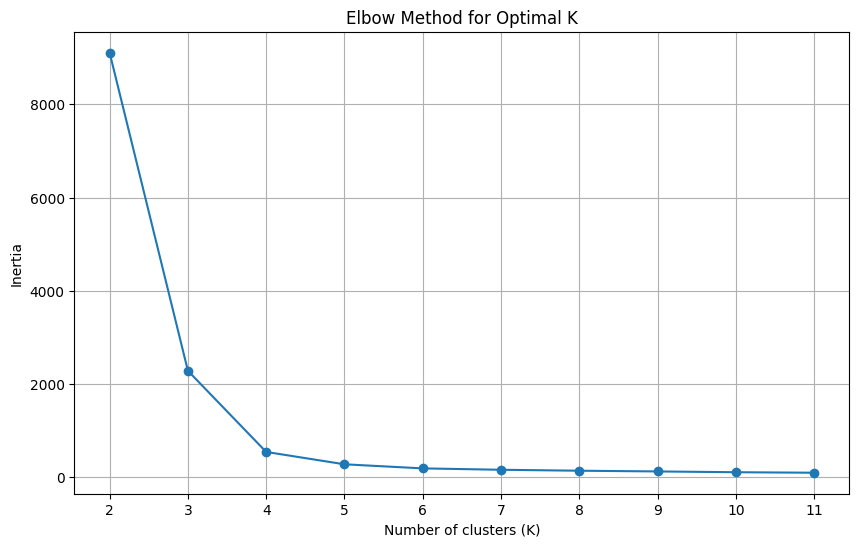

./elbow_test_export/SS-H_csv_10_66946_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       5           1     4          50  8.947272      5.114504        2
1       5           1     1          10  7.578999      5.093871        0
2       5           0     4           1  6.415404      4.837142        0
3       7           0     2         100  9.672986      5.123160        1
4       4           0     1           2  6.812883      4.915281        0
5       6           0     2           5  6.722671      5.079878        0
6       7           1     3           1  6.673217      4.878750        0
7       5           0     2           2  6.536861      4.976922        0
8       6           1     1          50  8.902719      5.117956        2
9       6           1     4           5  7.121689      5.069792        0
10      3           1     1           2  7.882967      4.667404        0
11      4           1     2           1  7.254651   

<Figure size 640x480 with 0 Axes>

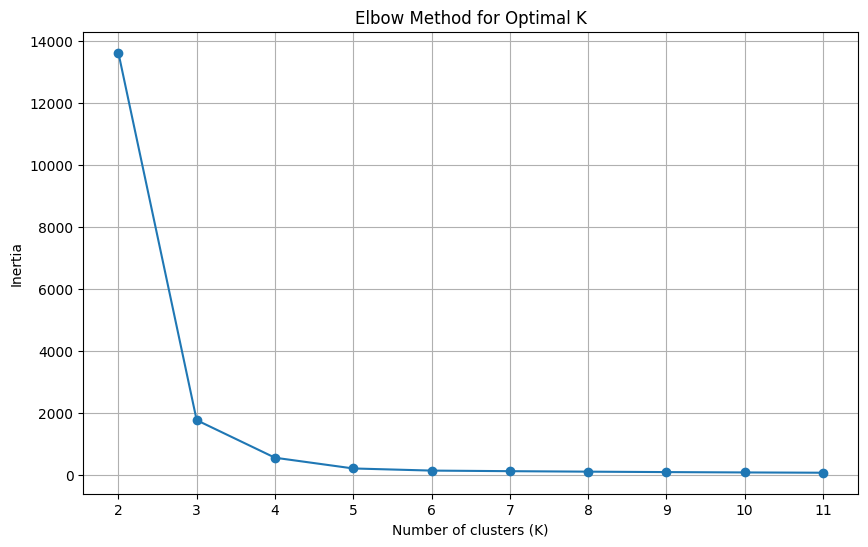

./elbow_test_export/SS-H_csv_10_69024_elbow_test.png
Optimal k value: 3
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       7           0     2           2  6.290129      5.022485        0
1       7           1     3           5  7.046175      5.073146        0
2       6           1     1          10  7.466488      5.097367        0
3       5           0     3          10  7.256643      5.099032        0
4       5           0     2           5  6.849712      5.068121        0
5       5           1     3          10  7.578984      5.093914        0
6       4           0     3         100  9.746890      5.104194        1
7       3           1     4          50  9.251482      5.059484        2
8       4           0     4           2  6.812883      4.915290        0
9       5           0     3           5  6.849712      5.068121        0
10      6           1     2           5  7.121689      5.069792        0
11      5           1     3           5  7.263870   

<Figure size 640x480 with 0 Axes>

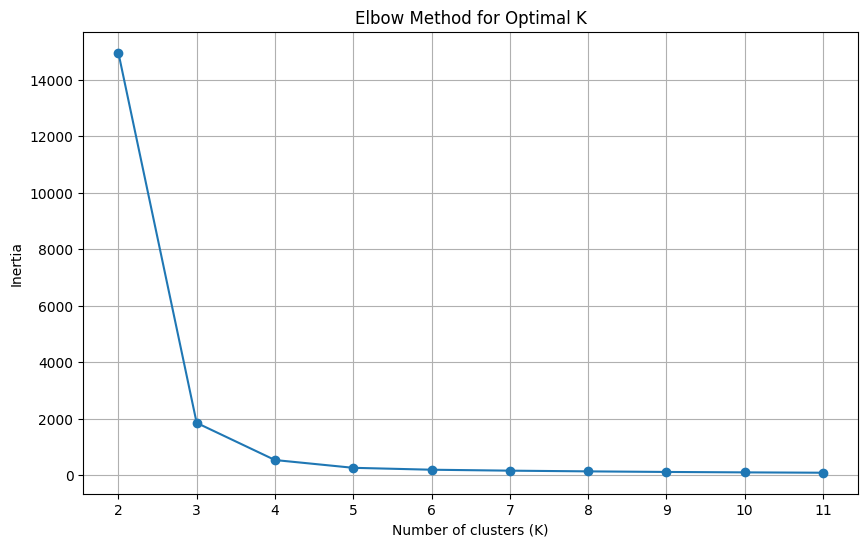

./elbow_test_export/SS-H_csv_10_70006_elbow_test.png
Optimal k value: 3
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       3           1     4          10  8.211260      5.020146        0
1       3           1     4          20  8.548710      5.046250        0
2       6           0     1         100  9.682816      5.121427        1
3       5           0     1         100  9.702370      5.117968        1
4       3           0     3          50  9.069461      5.061162        2
5       7           0     1           2  6.290129      5.022485        0
6       7           0     2         100  9.672986      5.123160        1
7       4           1     1           1  7.255406      4.676592        0
8       4           0     1          10  7.429867      5.085430        0
9       3           1     3           2  7.881934      4.679289        0
10      6           1     4         100  9.740248      5.121425        1
11      4           1     2           5  7.513254   

<Figure size 640x480 with 0 Axes>

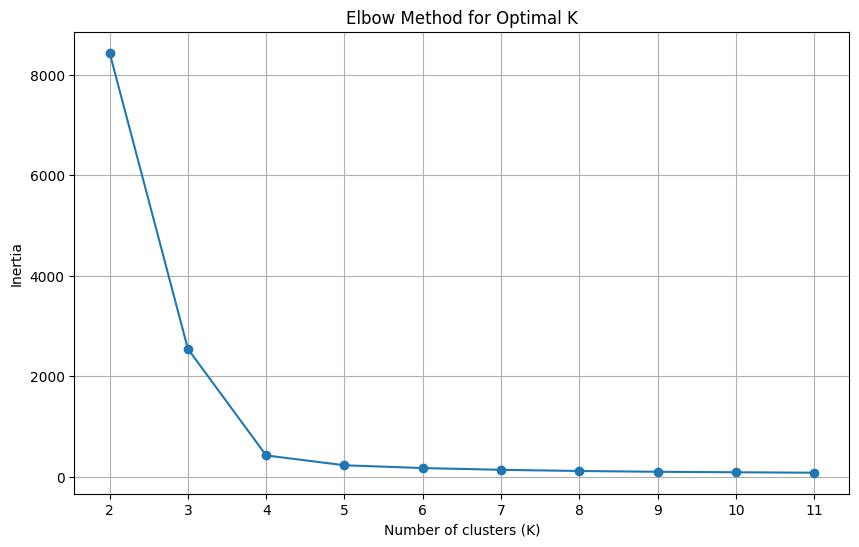

./elbow_test_export/SS-H_csv_10_70292_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       4           0     4          50  8.900257      5.101621        0
1       6           0     1          20  7.772288      5.113666        3
2       5           1     3          20  8.059182      5.107608        3
3       4           0     2           5  7.075886      5.041578        1
4       6           0     1           1  6.240143      4.894766        1
5       5           1     1         100  9.766852      5.117965        2
6       7           1     3           5  7.046175      5.073146        1
7       7           1     1           1  6.673217      4.878722        1
8       3           1     1           1  7.836833      4.309194        1
9       5           0     2           5  6.849712      5.068121        1
10      6           0     3          20  7.772288      5.113666        3
11      4           1     2           1  7.254651   

<Figure size 640x480 with 0 Axes>

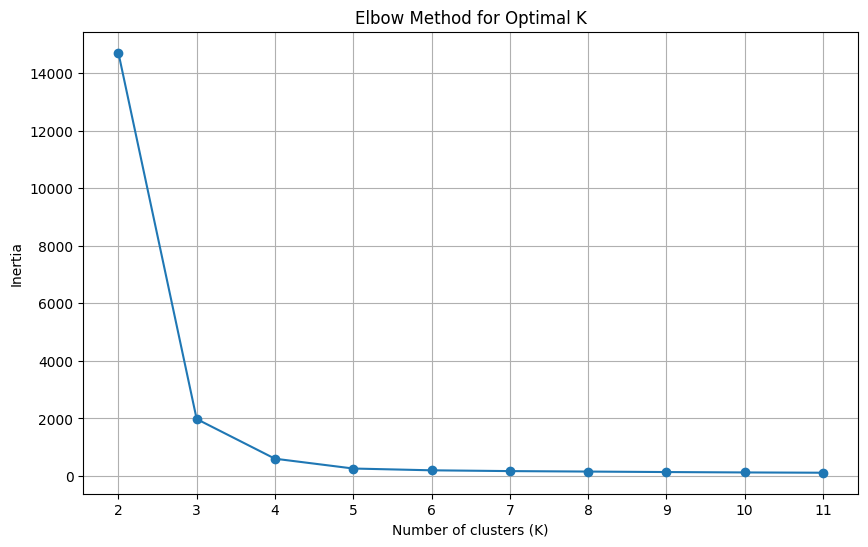

./elbow_test_export/SS-H_csv_10_77340_elbow_test.png
Optimal k value: 3
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       4           1     2          50  9.037629      5.100761        2
1       3           1     1         100  9.965784      5.066154        0
2       4           0     4           2  6.812883      4.915290        1
3       3           0     4           2  7.353588      4.718156        1
4       4           0     1           2  6.812883      4.915281        1
5       3           0     2          50  9.069461      5.061162        2
6       6           1     4          10  7.466488      5.097368        1
7       5           1     4           2  7.035668      4.953555        1
8       3           1     2         100  9.965784      5.066154        0
9       4           1     2           1  7.254651      4.687796        1
10      3           0     3          50  9.069461      5.061162        2
11      3           0     2           5  7.540787   

<Figure size 640x480 with 0 Axes>

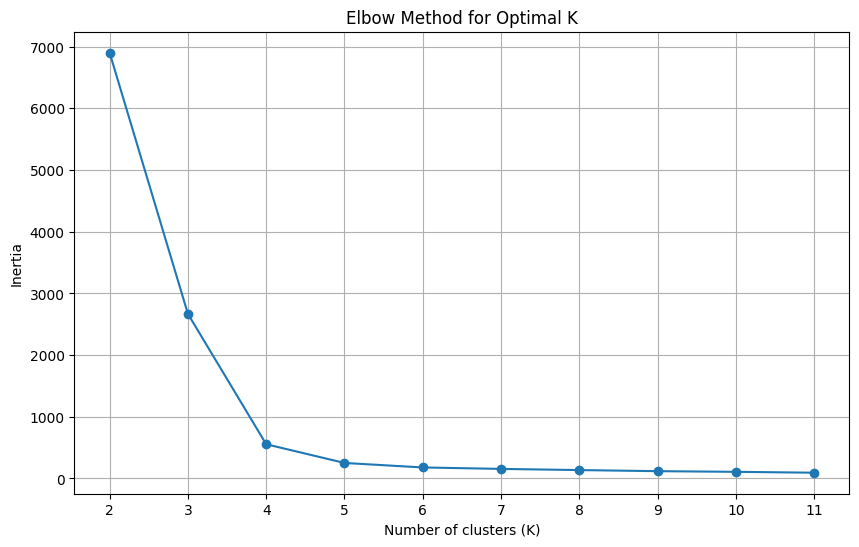

./elbow_test_export/SS-H_csv_10_77845_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       6           0     3           2  6.376724      5.007693        0
1       4           1     3          50  9.037629      5.100761        2
2       6           0     4           1  6.240143      4.894786        0
3       7           1     1          20  7.937150      5.112800        3
4       4           0     1          10  7.429867      5.085430        0
5       6           0     2           5  6.722671      5.079878        0
6       5           1     1          50  8.947272      5.114504        2
7       6           0     4           2  6.376724      5.007693        0
8       3           1     2           2  7.881934      4.679289        0
9       6           1     4           5  7.121689      5.069792        0
10      4           0     4           5  7.075886      5.041578        0
11      5           1     4           2  7.035668   

<Figure size 640x480 with 0 Axes>

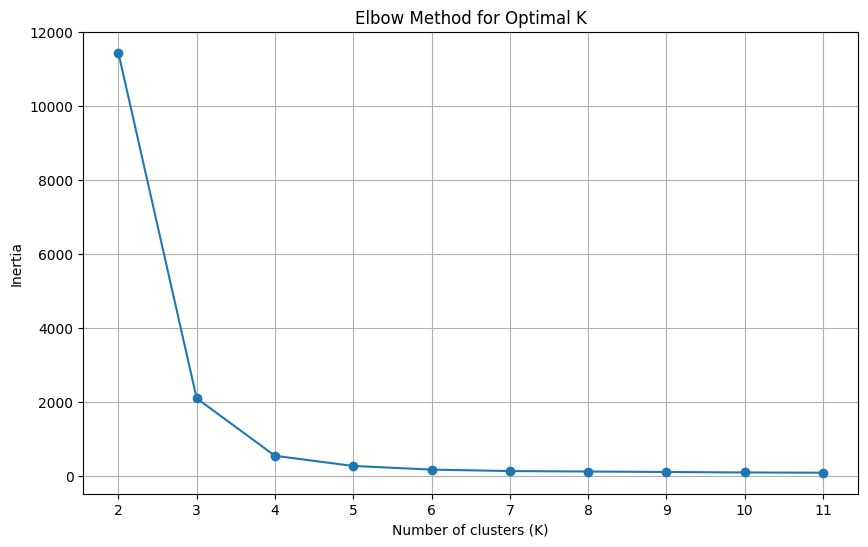

./elbow_test_export/SS-H_csv_10_83686_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       4           0     4          20  7.958239      5.096536        3
1       3           0     3          50  9.069461      5.061162        2
2       4           1     1          10  7.782782      5.080146        0
3       6           0     2          20  7.772288      5.113666        3
4       6           1     1           1  6.771397      4.850639        0
5       5           0     2          50  8.830731      5.115372        2
6       6           0     4           5  6.722671      5.079878        0
7       3           0     3           1  7.285532      4.401581        0
8       3           1     1           1  7.836833      4.309194        0
9       3           0     2           2  7.353588      4.718156        0
10      3           1     1          10  8.211465      5.019398        0
11      5           1     4          50  8.947272   

<Figure size 640x480 with 0 Axes>

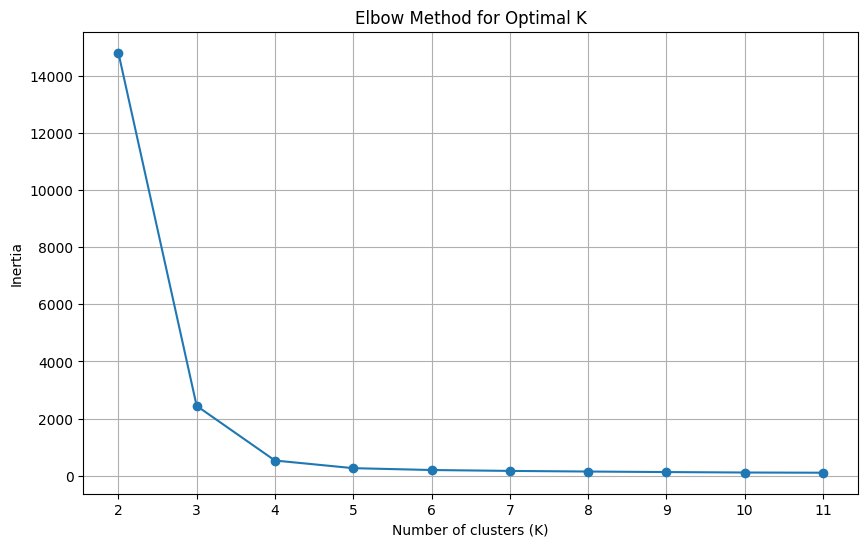

./elbow_test_export/SS-H_csv_10_84967_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       7           1     2           5  7.046175      5.073146        2
1       6           0     1           1  6.240143      4.894766        2
2       5           1     2          10  7.578984      5.093913        2
3       7           0     1          50  8.780969      5.120554        3
4       4           1     1          10  7.782782      5.080146        2
5       6           1     2           2  6.867242      4.983830        2
6       3           0     4         100  9.858304      5.066162        1
7       3           1     2          20  8.548710      5.046250        0
8       7           1     3          10  7.408083      5.099071        2
9       5           0     4           5  6.849712      5.068121        2
10      5           0     4          10  7.256643      5.099033        2
11      3           1     3           2  7.881934   

<Figure size 640x480 with 0 Axes>

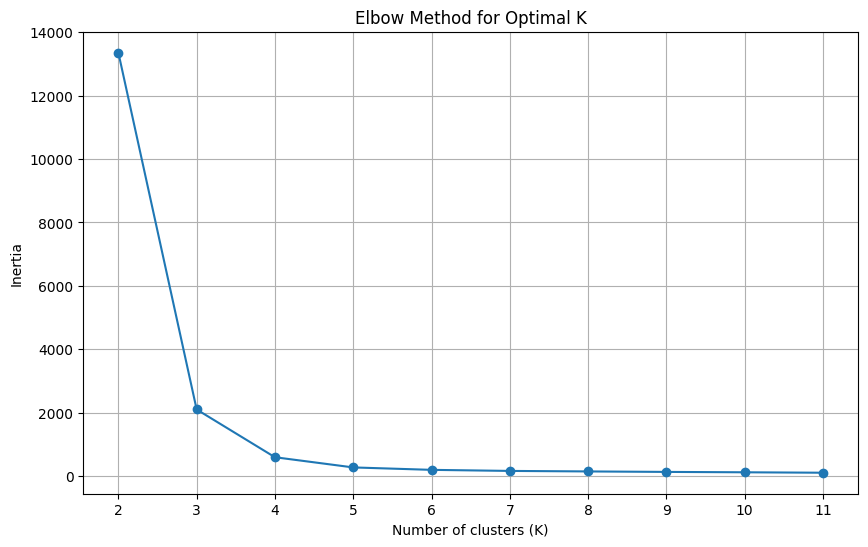

./elbow_test_export/SS-H_csv_10_86331_elbow_test.png
Optimal k value: 4
    Width  Complexity  Fifo  Multiplier   Energy-  Inv_runtime-  cluster
0       6           1     2           1  6.771371      4.850980        0
1       4           0     4           1  6.713325      4.726993        0
2       6           0     3           2  6.376724      5.007693        0
3       6           0     2         100  9.682816      5.121427        1
4       4           1     2         100  9.824529      5.104190        1
5       5           1     1          50  8.947272      5.114504        2
6       3           0     1           1  7.285550      4.401361        0
7       7           0     1          10  7.113784      5.104158        0
8       6           1     1           2  6.867254      4.983722        0
9       6           1     2         100  9.740248      5.121425        1
10      3           0     1          20  8.239069      5.051195        3
11      5           0     4           5  6.849712   

<Figure size 640x480 with 0 Axes>

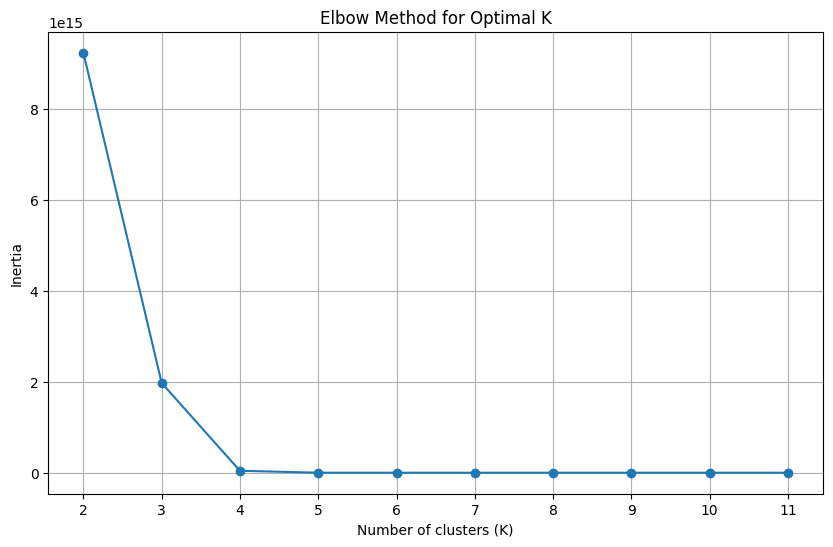

./elbow_test_export/SS-I_csv_100_11514_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      6      6  105000000.0  1024      15370.0   196.870        1
1        2      1      3     262000.0  1024      12325.0   165.610        0
2        2      3      3   10500000.0  2048      11394.0   178.650        2
3        2      3     12    5240000.0  1024      14707.0   132.910        3
4        2      1      3    1050000.0   512      12418.0   164.900        0
..     ...    ...    ...          ...   ...          ...       ...      ...
695      1      6      2     262000.0  1024      11693.0    81.686        0
696      1      3      9     262000.0  2048      12957.0    73.267        0
697      1      6      9    5240000.0  2048      13906.0    67.546        3
698      3      1      9     262000.0   512      12422.0   242.850        0
699      2      3      1     262000.0  2048       9534.9   208.180        0

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

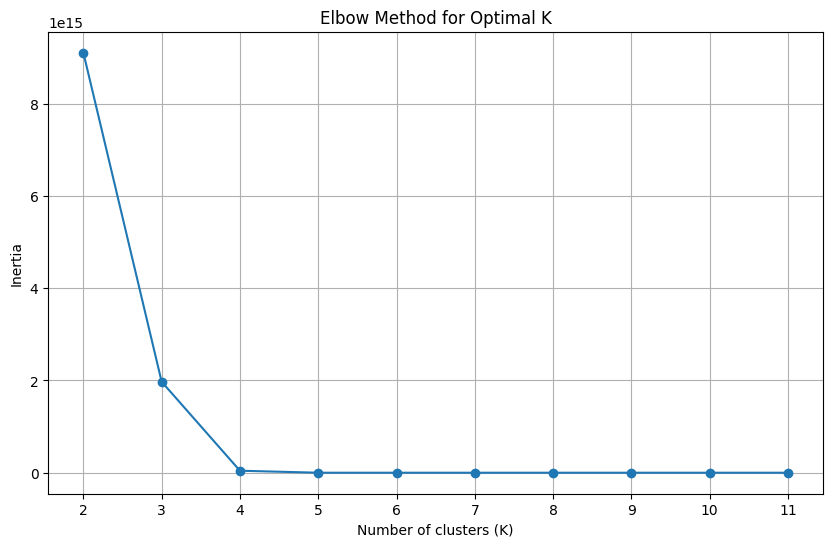

./elbow_test_export/SS-I_csv_100_19953_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6     12    1050000.0  2048      15256.0   129.030        0
1        2      2      1    5240000.0   512       8229.4   245.200        3
2        3      2      1     262000.0  2048       8198.4   372.850        0
3        3      1      6     262000.0   512      11920.0   250.240        0
4        1      2      3    1050000.0  1024      14343.0    67.011        0
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      2      6     262000.0  1024      13270.0   151.920        0
696      1      6      6  105000000.0  2048      13254.0    73.818        1
697      2      6      1    1050000.0   512       9912.1   195.050        0
698      1      3      9    1050000.0  2048      12170.0    76.017        0
699      1      3      6     262000.0  1024      12790.0    75.441        0

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

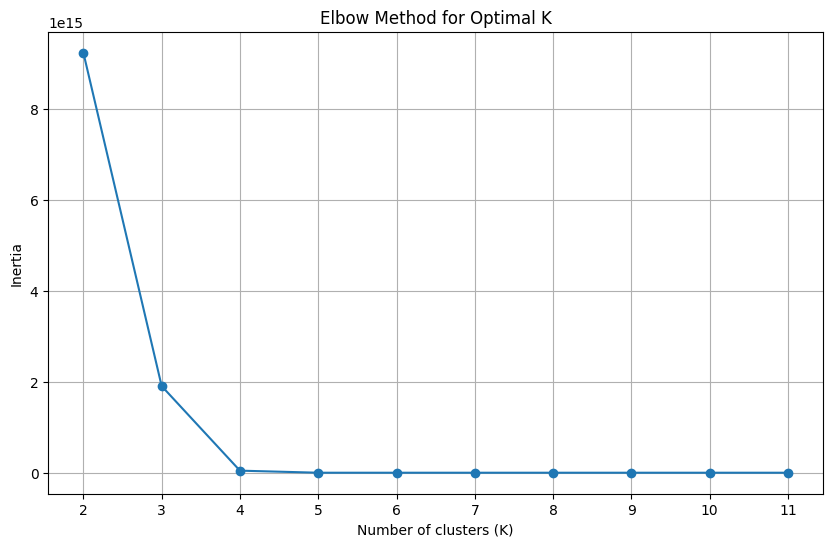

./elbow_test_export/SS-I_csv_100_3545_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      2      6    5240000.0   512      17189.0    57.059        3
1        2      6      3    1050000.0   512      11937.0   163.400        0
2        3      2      6   10500000.0  1024      14290.0   211.170        2
3        2      1      2    5240000.0   512      11241.0   179.530        3
4        3      2      6    1050000.0  1024      13980.0   215.670        0
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      3      6    1050000.0  1024      13031.0   153.920        0
696      3      3      6     262000.0  1024      15488.0   203.430        0
697      1      6      3   10500000.0   512      12366.0    76.828        2
698      1      2      3    5240000.0   512      14573.0    68.835        3
699      2      1     12    1050000.0  2048      13268.0   147.810        0

[700 rows x 8 c

<Figure size 640x480 with 0 Axes>

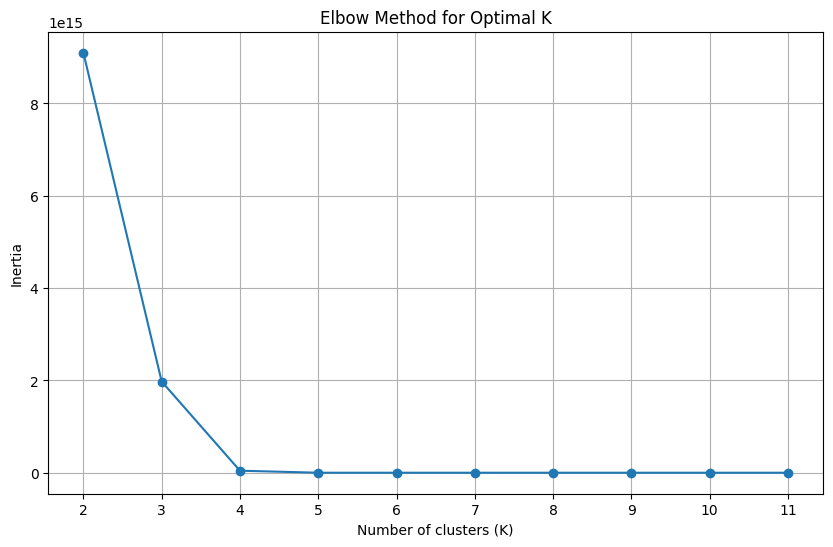

./elbow_test_export/SS-I_csv_100_39658_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      3      6  105000000.0  2048      12455.0    73.217        1
1        2      1      6    5240000.0   512      13224.0   153.920        3
2        3      2      9    5240000.0  2048      15224.0   205.930        3
3        2      1     12  105000000.0   512      12999.0   152.140        1
4        3      6      6   10500000.0  1024      15822.0   191.570        2
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      3      3     262000.0  2048      11877.0   167.730        0
696      2      6      3    5240000.0  2048      11681.0   163.560        3
697      2      6      9    5240000.0  1024      14311.0   138.010        3
698      1      3      3    5240000.0  1024      12652.0    75.422        3
699      3      1      6     262000.0  1024      11676.0   256.900        0

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

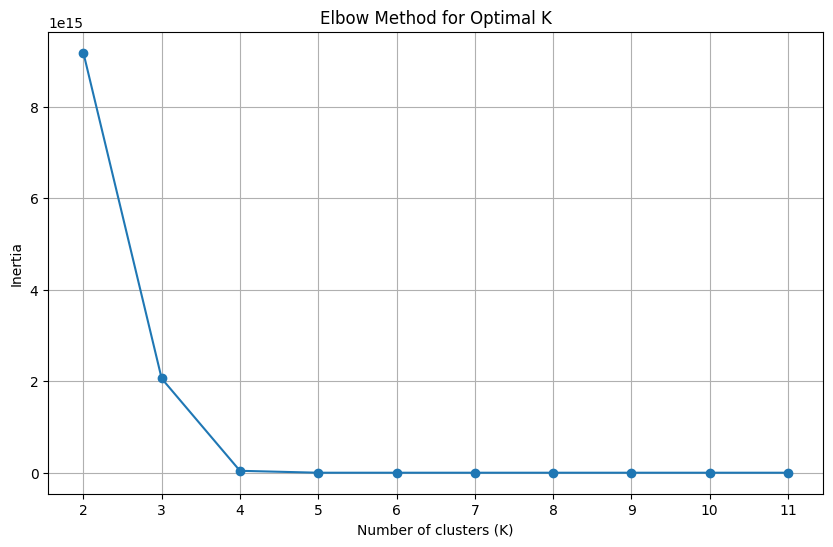

./elbow_test_export/SS-I_csv_100_40749_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      3      2    1050000.0  2048      11542.0   267.340        0
1        3      1      6  105000000.0   512      11781.0   258.810        1
2        2      2      3   10500000.0  2048      12657.0   157.840        2
3        3      1     12    1050000.0  2048      12827.0   237.560        0
4        2      3      1    5240000.0  1024       9398.1   202.450        3
..     ...    ...    ...          ...   ...          ...       ...      ...
695      3      2      3    1050000.0  2048      12555.0   244.310        0
696      2      2      6    5240000.0   512      12907.0   148.980        3
697      3      1      3     262000.0  2048      12026.0   258.270        0
698      3      6     12     262000.0  2048      18315.0   176.250        0
699      1      1      9     262000.0  2048      14570.0    66.392        0

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

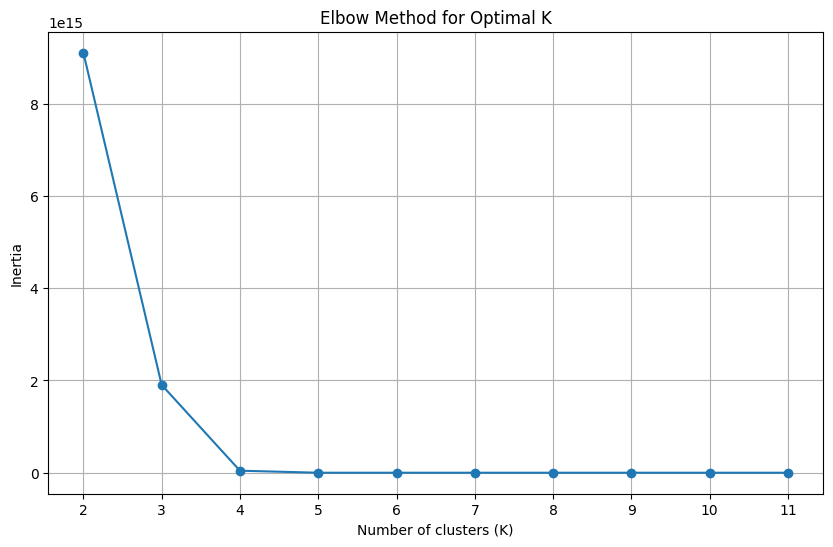

./elbow_test_export/SS-I_csv_100_44845_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      3      9   10500000.0  2048      13615.0   147.560        2
1        2      3      3     262000.0  2048      11877.0   167.730        0
2        2      1      2  105000000.0  1024      11218.0   179.020        1
3        1      1      6   10500000.0  2048      13955.0    69.705        2
4        3      3      2    5240000.0  2048      11475.0   263.580        3
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      6      9     262000.0  2048      14476.0   136.850        0
696      3      6      1    5240000.0  2048       8417.0   356.030        3
697      1      1      9    1050000.0  2048      14318.0    68.578        0
698      3      1      1    1050000.0  2048       7768.4   390.460        0
699      2      6      1     262000.0  1024       9697.1   201.070        0

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

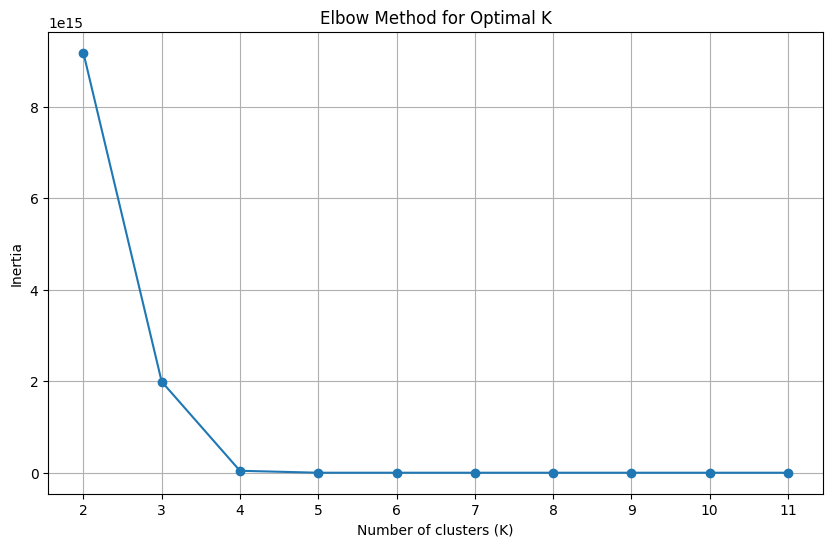

./elbow_test_export/SS-I_csv_100_51176_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6     12   10500000.0  2048      15139.0   131.670        2
1        3      3     12     262000.0  1024      18349.0   167.460        0
2        1      3      1  105000000.0   512       8423.9   112.780        1
3        3      6      1   10500000.0   512       8560.2   354.290        2
4        2      6      9    1050000.0  2048      14215.0   138.060        0
..     ...    ...    ...          ...   ...          ...       ...      ...
695      1      6     12    5240000.0  1024      13906.0    70.048        3
696      2      6      2     262000.0  1024      11921.0   170.530        0
697      3      6     12    5240000.0  1024      18717.0   163.220        3
698      1      6      9  105000000.0  2048      13778.0    67.548        1
699      1      6      9   10500000.0   512      12990.0    72.943        2

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

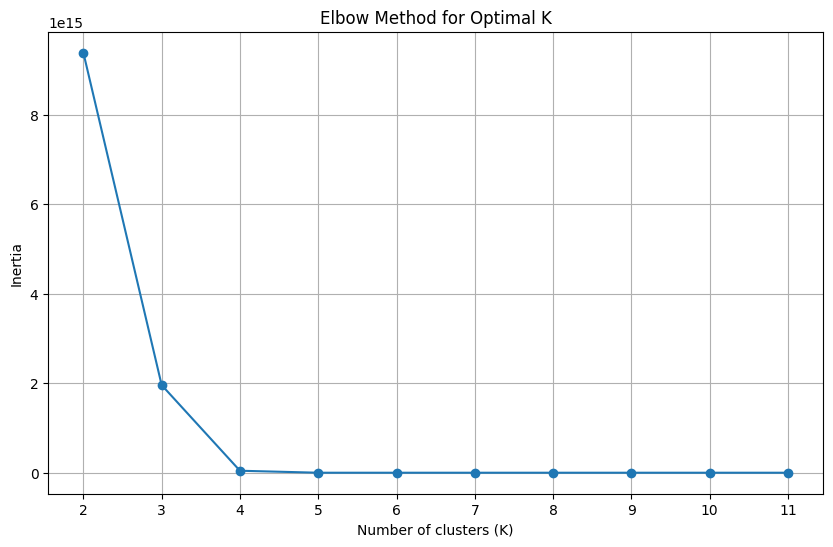

./elbow_test_export/SS-I_csv_100_58612_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      1      2    1050000.0  1024      11254.0   175.100        1
1        1      1     12    5240000.0  1024      14805.0    68.305        3
2        2      1      2   10500000.0  1024      11572.0   173.700        2
3        1      2      2   10500000.0   512      11302.0    83.442        2
4        1      2      3    1050000.0   512      14327.0    67.328        1
..     ...    ...    ...          ...   ...          ...       ...      ...
695      3      3      3  105000000.0  1024      13713.0   222.100        0
696      1      6      6    1050000.0   512      12728.0    73.452        1
697      3      1      6    5240000.0  1024      11652.0   261.550        3
698      3      1      3     262000.0  2048      12026.0   258.270        1
699      2      6      6   10500000.0  1024      13286.0   141.220        2

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

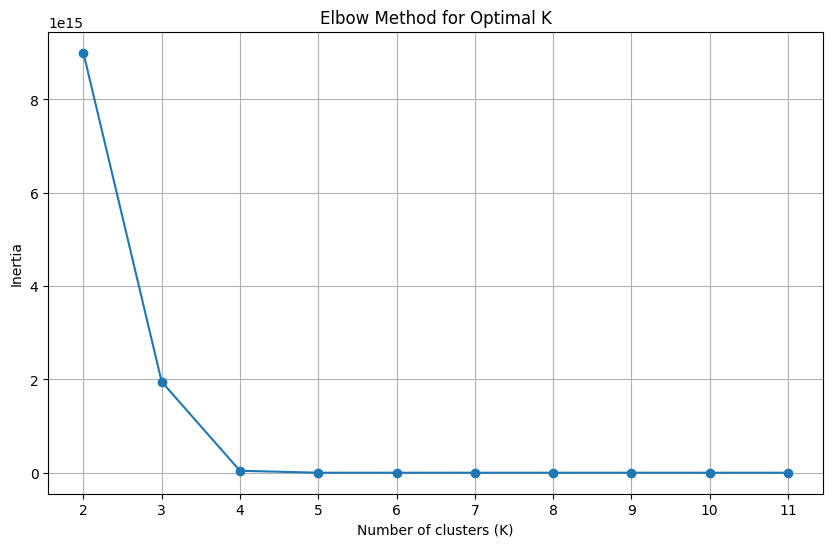

./elbow_test_export/SS-I_csv_100_61367_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6     12   10500000.0  2048      15139.0   131.670        2
1        3      2      9   10500000.0  1024      15773.0   201.110        2
2        2      3     12    5240000.0  2048      14557.0   133.220        3
3        1      6      2    1050000.0  2048      11690.0    83.558        0
4        2      3      2    5240000.0  2048      11766.0   168.680        3
..     ...    ...    ...          ...   ...          ...       ...      ...
695      1      2      2  105000000.0   512      11123.0    88.986        1
696      2      6      3    5240000.0  2048      11681.0   163.560        3
697      2      3     12  105000000.0   512      14436.0   137.280        1
698      2      3      1    5240000.0  1024       9398.1   202.450        3
699      2      3      1    5240000.0  2048       9575.8   199.410        3

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

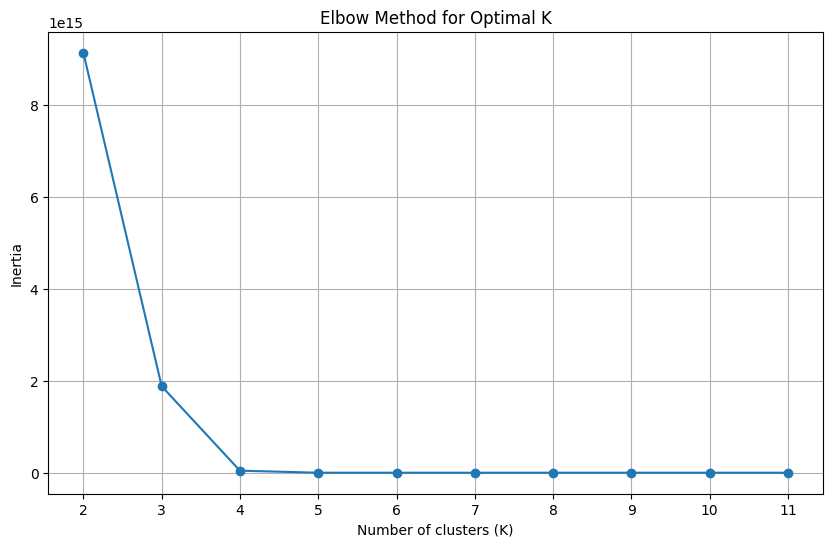

./elbow_test_export/SS-I_csv_100_65388_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      3      2    1050000.0  2048      11549.0    84.664        0
1        2      2      9    5240000.0  2048      14160.0   143.350        3
2        2      3      2  105000000.0  2048      11384.0   177.380        1
3        2      1     12   10500000.0  2048      14456.0   135.190        2
4        1      3     12   10500000.0  2048      12437.0    77.372        2
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      1     12    1050000.0  2048      13268.0   147.810        0
696      2      6      3   10500000.0  2048      11864.0   167.520        2
697      2      6      2    5240000.0   512      11574.0   176.280        3
698      2      3     12    1050000.0  2048      13643.0   144.770        0
699      2      3      1  105000000.0   512       9503.6   203.990        1

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

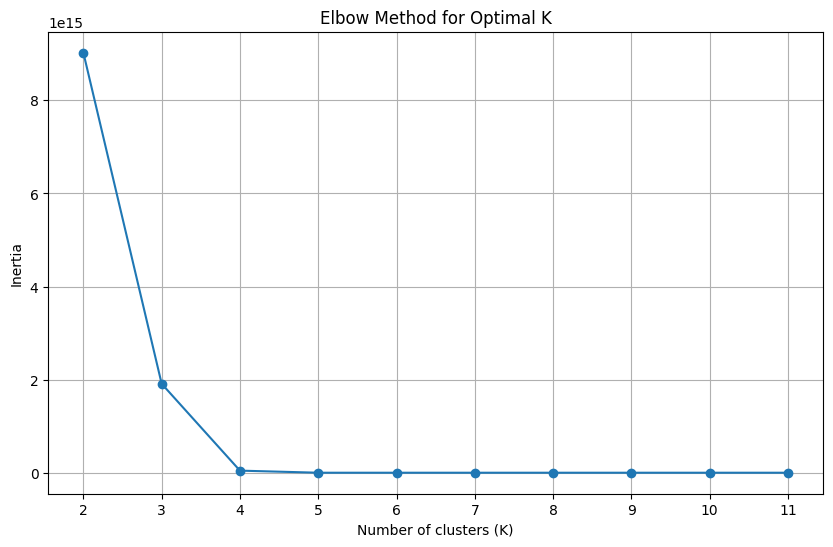

./elbow_test_export/SS-I_csv_100_65444_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      2      1    5240000.0  1024       8231.7   362.870        3
1        3      3      9  105000000.0   512      16949.0   189.300        1
2        1      1      6     262000.0  2048      13516.0    71.818        0
3        2      2      3  105000000.0  1024      12621.0   161.800        1
4        1      2      3   10500000.0  1024      14584.0    66.234        2
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      2      9    5240000.0  2048      14160.0   143.350        3
696      1      3     12   10500000.0  2048      12437.0    77.372        2
697      2      1      3    1050000.0  1024      12806.0   154.680        0
698      3      6      3    1050000.0   512      13868.0   213.320        0
699      2      6      3   10500000.0  2048      11864.0   167.520        2

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

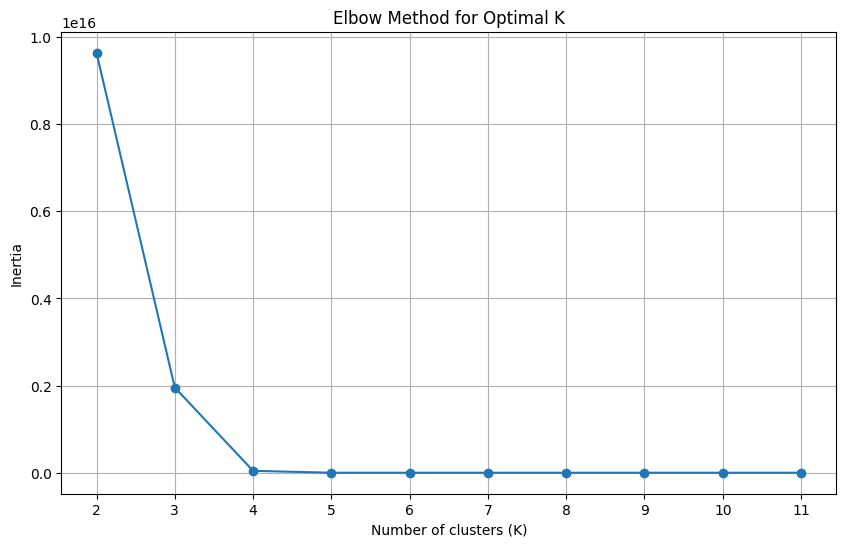

./elbow_test_export/SS-I_csv_100_66946_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      2     12    1050000.0  2048      19935.0    51.311        3
1        1      1     12   10500000.0  1024      14971.0    64.789        2
2        1      3      1    5240000.0  2048       8404.0   114.930        0
3        2      6      6    1050000.0  2048      13047.0   147.880        3
4        2      1      2    1050000.0  2048      11488.0   172.870        3
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      1      6    5240000.0  1024      12674.0   150.200        0
696      2      6      3    5240000.0  2048      11681.0   163.560        0
697      3      2      3  105000000.0   512      12181.0   249.930        1
698      3      6      6    5240000.0  2048      15531.0   202.910        0
699      1      1      3   10500000.0  1024      12305.0    82.948        2

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

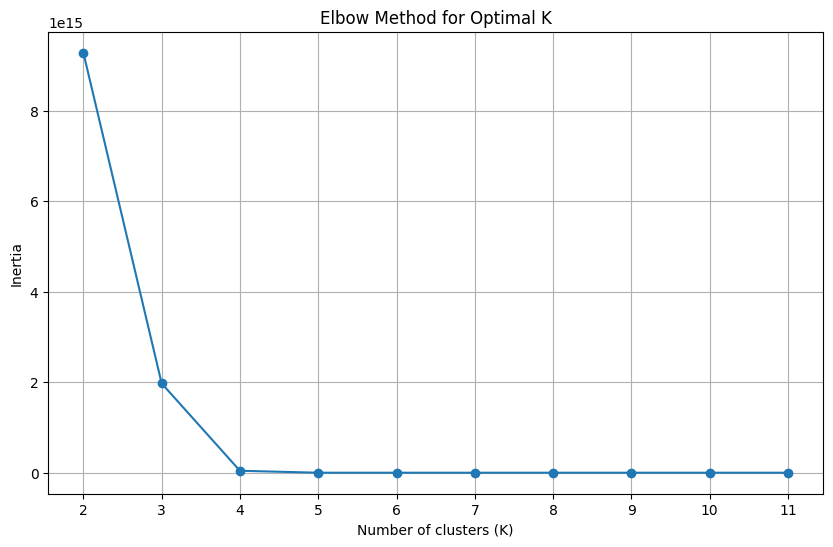

./elbow_test_export/SS-I_csv_100_69024_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6      6  105000000.0  2048      13050.0   145.750        1
1        2      6      1   10500000.0   512       9789.0   197.190        3
2        1      6      9     262000.0  2048      13824.0    69.907        2
3        1      3      3   10500000.0   512      12192.0    78.380        3
4        2      3      3     262000.0   512      11589.0   172.210        2
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      1      3  105000000.0  2048      12716.0   157.120        1
696      1      1      1    1050000.0   512       8945.8   110.330        2
697      3      2      3    1050000.0  2048      12555.0   244.310        2
698      2      3      6    5240000.0  1024      13193.0   149.170        0
699      1      6      6    1050000.0  1024      13514.0    68.725        2

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

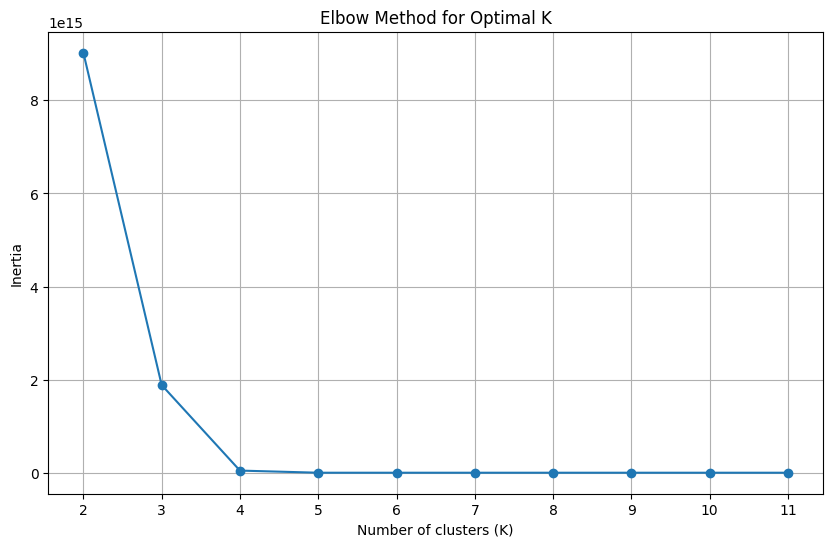

./elbow_test_export/SS-I_csv_100_70006_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      1      6   10500000.0  1024      11847.0   250.200        2
1        1      6      1     262000.0  2048       8528.8   106.990        1
2        2      2      2  105000000.0   512      12581.0   158.910        0
3        1      3      6     262000.0  2048      12237.0    77.458        1
4        2      2      1   10500000.0   512       8517.5   236.680        2
..     ...    ...    ...          ...   ...          ...       ...      ...
695      3      6      9  105000000.0   512      16954.0   184.920        0
696      2      3      6     262000.0  2048      12754.0   152.370        1
697      3      2      2   10500000.0   512      11682.0   259.610        2
698      1      3      9   10500000.0  1024      12693.0    71.982        2
699      3      1      6    5240000.0   512      12152.0   246.020        3

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

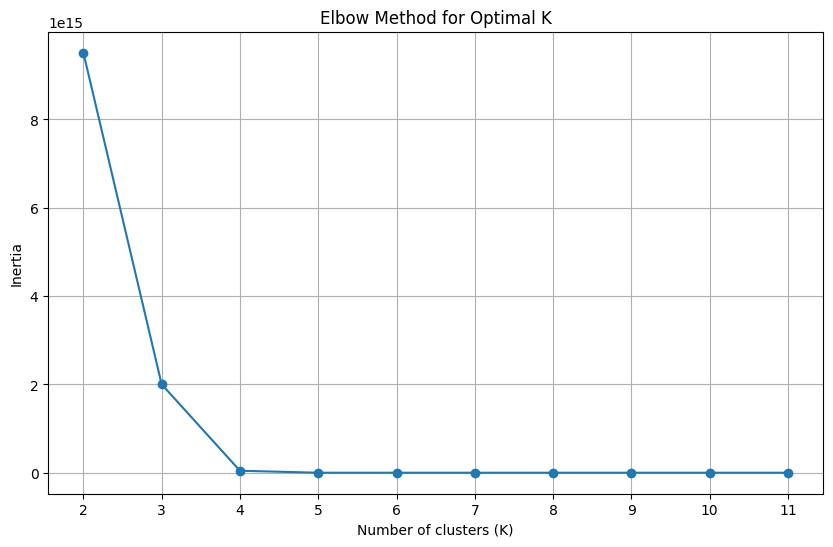

./elbow_test_export/SS-I_csv_100_70292_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      1      3  105000000.0  2048      12221.0    79.187        1
1        2      2      9    1050000.0  1024      13711.0   147.740        0
2        1      2      6  105000000.0  1024      17497.0    54.146        1
3        1      1      3   10500000.0   512      12597.0    80.093        2
4        3      2      9    5240000.0  1024      15317.0   199.730        3
..     ...    ...    ...          ...   ...          ...       ...      ...
695      1      6      2    5240000.0  1024      11972.0    78.883        3
696      3      1      1    5240000.0   512       7879.3   376.890        3
697      2      1      6  105000000.0  1024      12535.0   160.220        1
698      2      3      3    1050000.0  1024      11724.0   169.370        0
699      1      1      2     262000.0  2048      10703.0    92.150        0

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

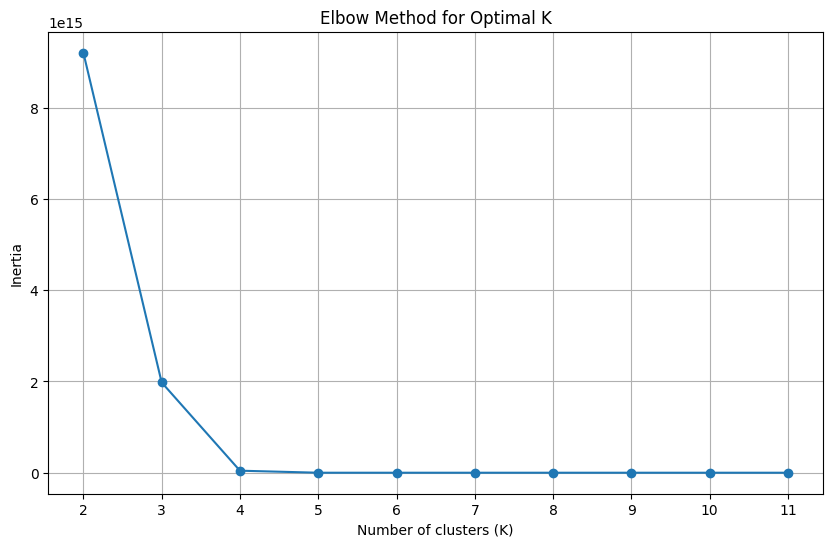

./elbow_test_export/SS-I_csv_100_77340_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      3      9     262000.0  1024      17633.0   182.470        2
1        3      6      6     262000.0  1024      15574.0   203.430        2
2        3      6      1     262000.0  2048       8443.9   350.410        2
3        3      6      3     262000.0  2048      13830.0   219.690        2
4        3      1      6  105000000.0  1024      12052.0   258.380        1
..     ...    ...    ...          ...   ...          ...       ...      ...
695      3      1     12    1050000.0  2048      12827.0   237.560        2
696      1      6      6  105000000.0  2048      13254.0    73.818        1
697      2      3      6    5240000.0  2048      12844.0   153.550        0
698      1      1      2   10500000.0  1024      10793.0    92.613        3
699      2      6     12     262000.0  2048      15084.0   132.030        2

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

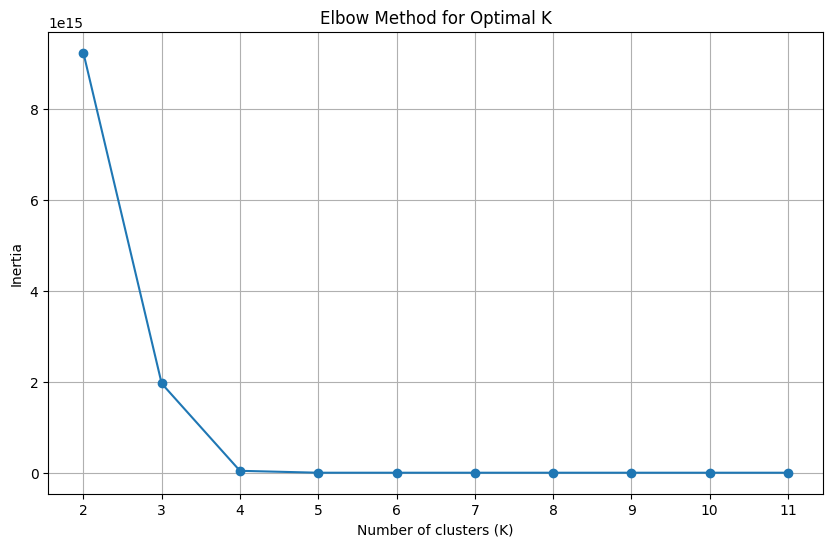

./elbow_test_export/SS-I_csv_100_77845_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      2      6   10500000.0  2048      12322.0    153.88        3
1        3      6      9     262000.0   512      17194.0    186.42        2
2        3      3      9    5240000.0   512      16854.0    181.01        0
3        2      1      9  105000000.0   512      13791.0    147.23        1
4        3      6      9    5240000.0  2048      17512.0    172.99        0
..     ...    ...    ...          ...   ...          ...       ...      ...
695      3      6      1    5240000.0   512       8059.8    363.97        0
696      2      6      1    1050000.0   512       9912.1    195.05        2
697      3      2      6   10500000.0  2048      13714.0    216.59        3
698      3      2      1    5240000.0  2048       8473.0    365.42        0
699      1      3      1    1050000.0  2048       8282.6    113.69        2

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

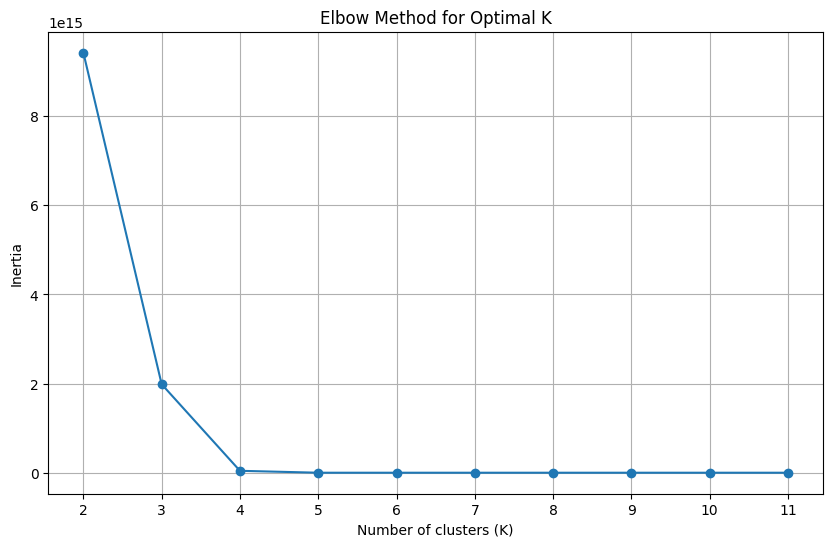

./elbow_test_export/SS-I_csv_100_83686_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      1      1  105000000.0  1024       9333.8   102.770        1
1        3      2      3     262000.0  2048      12419.0   245.430        0
2        3      2      9     262000.0  1024      15383.0   196.520        0
3        2      2      9    5240000.0  2048      14160.0   143.350        3
4        2      3     12   10500000.0  1024      14750.0   133.890        2
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      6      9  105000000.0  2048      14121.0   137.870        1
696      3      2      9    5240000.0  1024      15317.0   199.730        3
697      1      2     12   10500000.0  1024      20356.0    48.387        2
698      3      1      9   10500000.0  1024      12296.0   246.510        2
699      1      1      1     262000.0  1024       9282.3   103.320        0

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

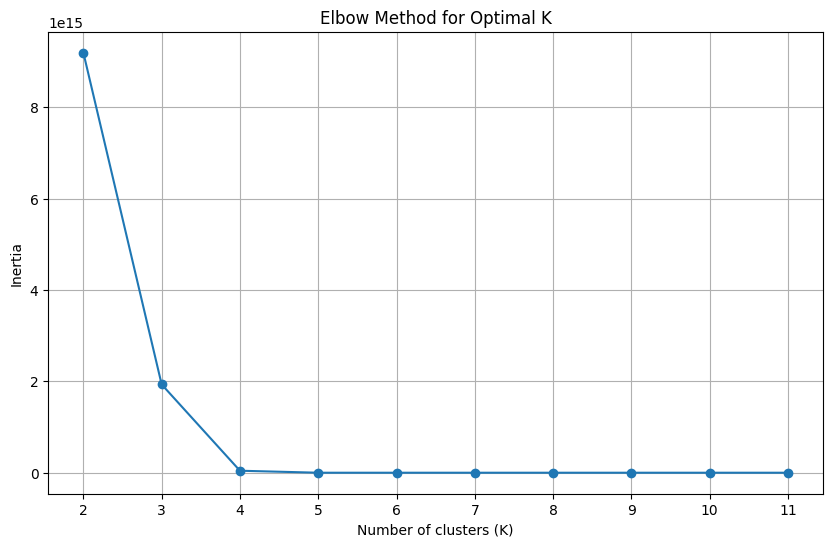

./elbow_test_export/SS-I_csv_100_84967_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6      1    1050000.0  2048       9551.3   197.830        2
1        2      1     12    1050000.0  1024      14385.0   135.920        2
2        1      1     12  105000000.0  1024      14557.0    66.947        1
3        2      6     12   10500000.0   512      15587.0   129.740        3
4        3      1      2  105000000.0   512      11367.0   268.870        1
..     ...    ...    ...          ...   ...          ...       ...      ...
695      2      3      9  105000000.0  1024      14244.0   140.870        1
696      1      6      1  105000000.0   512       8592.3   108.420        1
697      3      3      9  105000000.0  2048      16995.0   184.630        1
698      1      3      2  105000000.0  2048      11699.0    84.691        1
699      2      6      3    1050000.0  2048      11856.0   164.900        2

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

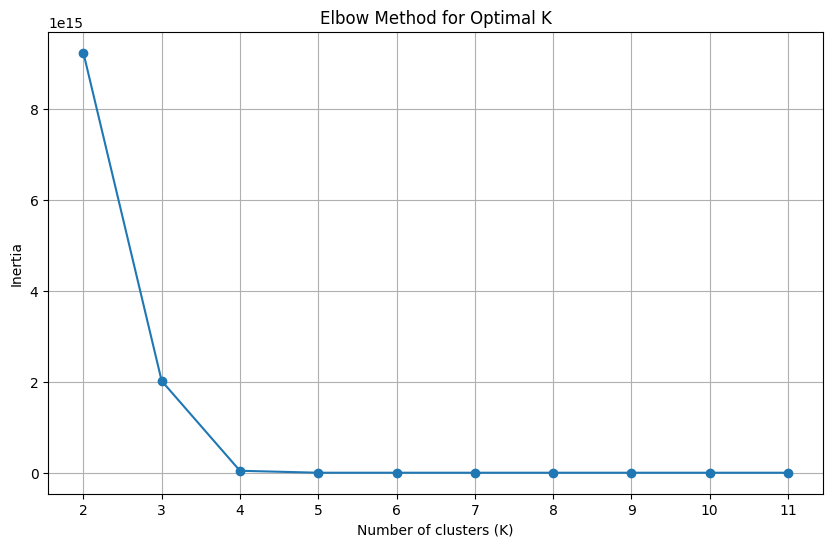

./elbow_test_export/SS-I_csv_100_86331_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      6      6    1050000.0  2048      12812.0    73.119        1
1        3      6      6     262000.0  2048      14967.0   204.870        1
2        3      3      9   10500000.0  2048      16833.0   183.640        2
3        2      2      6   10500000.0  1024      13154.0   150.980        2
4        2      2      3    1050000.0   512      12469.0   162.720        1
..     ...    ...    ...          ...   ...          ...       ...      ...
695      1      1      6    5240000.0  1024      13611.0    70.129        3
696      1      3      6   10500000.0   512      13052.0    72.387        2
697      3      3     12   10500000.0  1024      17738.0   176.250        2
698      1      6      2    1050000.0  1024      11782.0    80.944        1
699      2      1      3    1050000.0   512      12418.0   164.900        1

[700 rows x 8 

<Figure size 640x480 with 0 Axes>

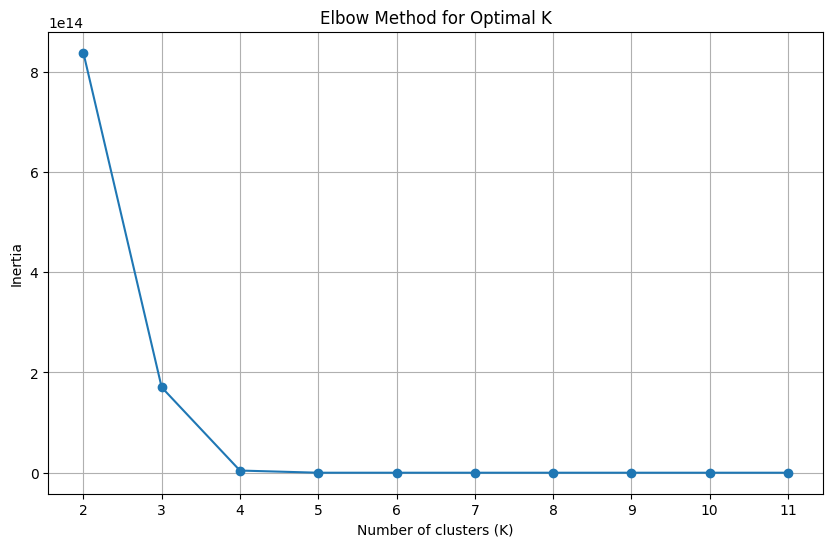

./elbow_test_export/SS-I_csv_10_11514_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       3      6      6  105000000.0  1024      15370.0   196.870        0
1       2      1      3     262000.0  1024      12325.0   165.610        1
2       2      3      3   10500000.0  2048      11394.0   178.650        2
3       2      3     12    5240000.0  1024      14707.0   132.910        3
4       2      1      3    1050000.0   512      12418.0   164.900        1
..    ...    ...    ...          ...   ...          ...       ...      ...
65      1      3      3    5240000.0   512      12141.0    79.583        3
66      1      6      1     262000.0  2048       8528.8   106.990        1
67      2      2      9    5240000.0  2048      14160.0   143.350        3
68      2      1      2  105000000.0  1024      11218.0   179.020        0
69      1      3      1  105000000.0  1024       8440.4   113.820        0

[70 rows x 8 columns]
[0.45

<Figure size 640x480 with 0 Axes>

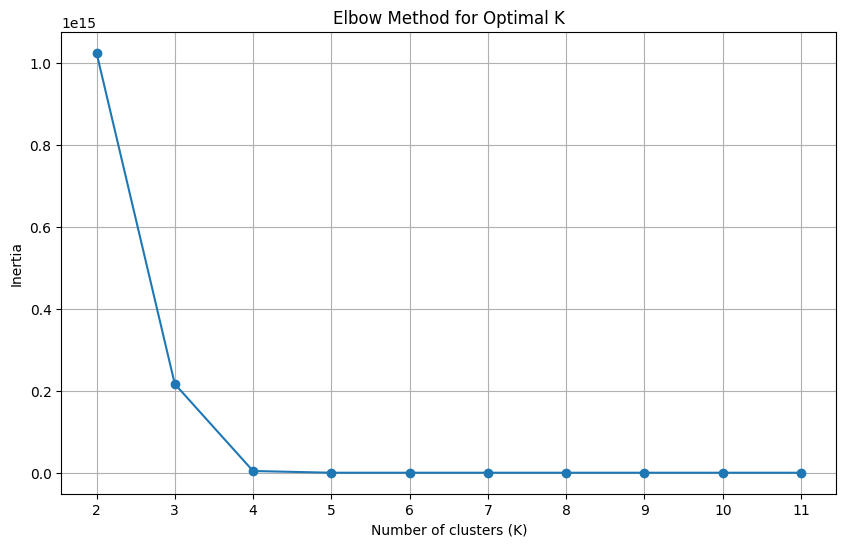

./elbow_test_export/SS-I_csv_10_19953_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       2      6     12    1050000.0  2048      15256.0   129.030        0
1       2      2      1    5240000.0   512       8229.4   245.200        3
2       3      2      1     262000.0  2048       8198.4   372.850        0
3       3      1      6     262000.0   512      11920.0   250.240        0
4       1      2      3    1050000.0  1024      14343.0    67.011        0
..    ...    ...    ...          ...   ...          ...       ...      ...
65      2      2      2   10500000.0   512      12446.0   161.590        2
66      1      6      9     262000.0   512      13387.0    70.633        0
67      3      1      2  105000000.0  2048      11151.0   269.900        1
68      3      2      2   10500000.0  1024      11490.0   278.640        2
69      3      6      9  105000000.0  1024      16990.0   177.940        1

[70 rows x 8 columns]
[0.48

<Figure size 640x480 with 0 Axes>

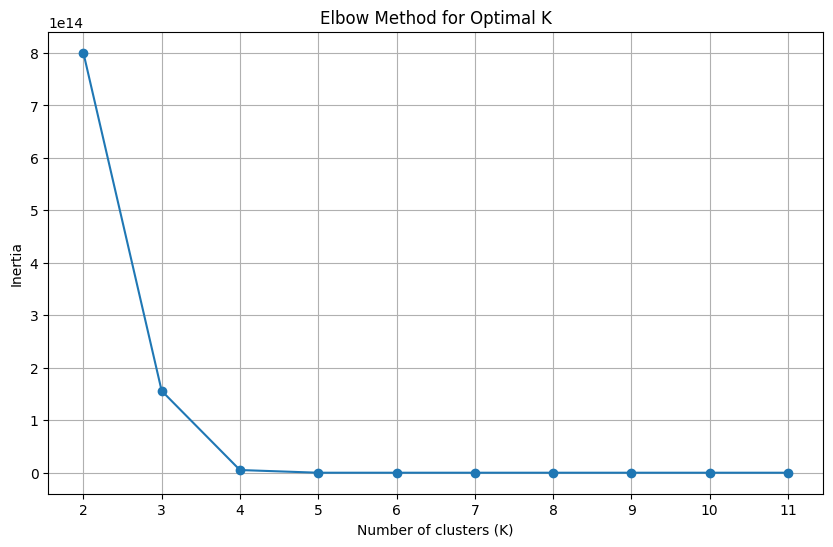

./elbow_test_export/SS-I_csv_10_3545_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       1      2      6    5240000.0   512      17189.0    57.059        3
1       2      6      3    1050000.0   512      11937.0   163.400        0
2       3      2      6   10500000.0  1024      14290.0   211.170        2
3       2      1      2    5240000.0   512      11241.0   179.530        3
4       3      2      6    1050000.0  1024      13980.0   215.670        0
..    ...    ...    ...          ...   ...          ...       ...      ...
65      2      1      2   10500000.0   512      11463.0   172.790        2
66      1      1     12  105000000.0  2048      14527.0    67.116        1
67      1      2      9  105000000.0  2048      19671.0    50.391        1
68      1      1      3   10500000.0  1024      12305.0    82.948        2
69      1      3      9    1050000.0  2048      12170.0    76.017        0

[70 rows x 8 columns]
[0.500

<Figure size 640x480 with 0 Axes>

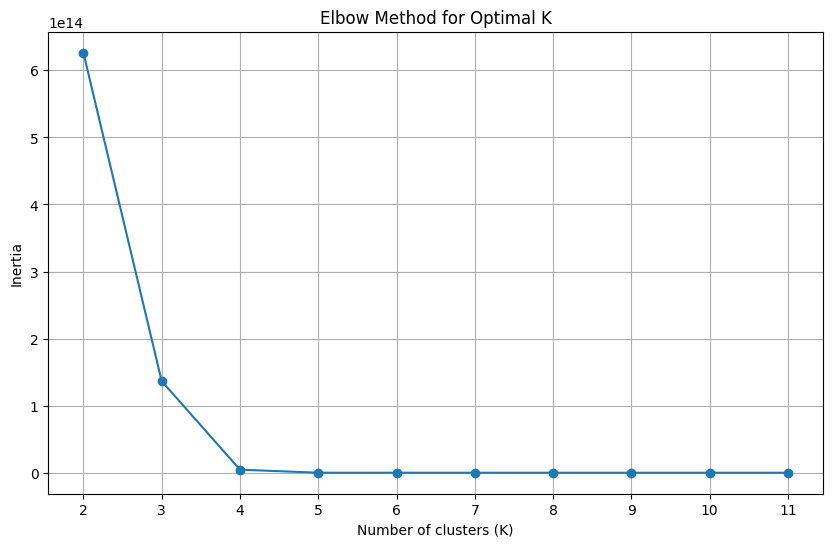

./elbow_test_export/SS-I_csv_10_39658_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       1      3      6  105000000.0  2048      12455.0    73.217        1
1       2      1      6    5240000.0   512      13224.0   153.920        3
2       3      2      9    5240000.0  2048      15224.0   205.930        3
3       2      1     12  105000000.0   512      12999.0   152.140        1
4       3      6      6   10500000.0  1024      15822.0   191.570        2
..    ...    ...    ...          ...   ...          ...       ...      ...
65      1      3      6   10500000.0  1024      11980.0    78.924        2
66      1      3      1    1050000.0   512       8556.9   111.330        0
67      2      1      3     262000.0  1024      12325.0   165.610        0
68      2      3      6  105000000.0  2048      12534.0   154.190        1
69      3      6      1   10500000.0  1024       8344.1   363.010        2

[70 rows x 8 columns]
[0.49

<Figure size 640x480 with 0 Axes>

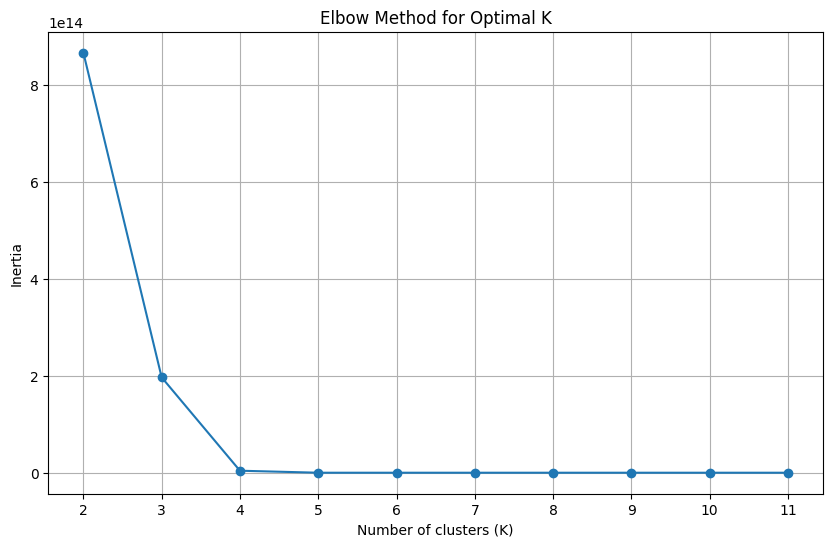

./elbow_test_export/SS-I_csv_10_40749_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       3      3      2    1050000.0  2048      11542.0   267.340        2
1       3      1      6  105000000.0   512      11781.0   258.810        1
2       2      2      3   10500000.0  2048      12657.0   157.840        0
3       3      1     12    1050000.0  2048      12827.0   237.560        2
4       2      3      1    5240000.0  1024       9398.1   202.450        3
..    ...    ...    ...          ...   ...          ...       ...      ...
65      3      3      6    1050000.0  2048      15403.0   205.090        2
66      1      2     12    1050000.0   512      20495.0    49.017        2
67      3      3     12    1050000.0  2048      18663.0   166.980        2
68      2      2      6    5240000.0  1024      13095.0   151.030        3
69      1      3      9  105000000.0  1024      12074.0    80.847        1

[70 rows x 8 columns]
[0.48

<Figure size 640x480 with 0 Axes>

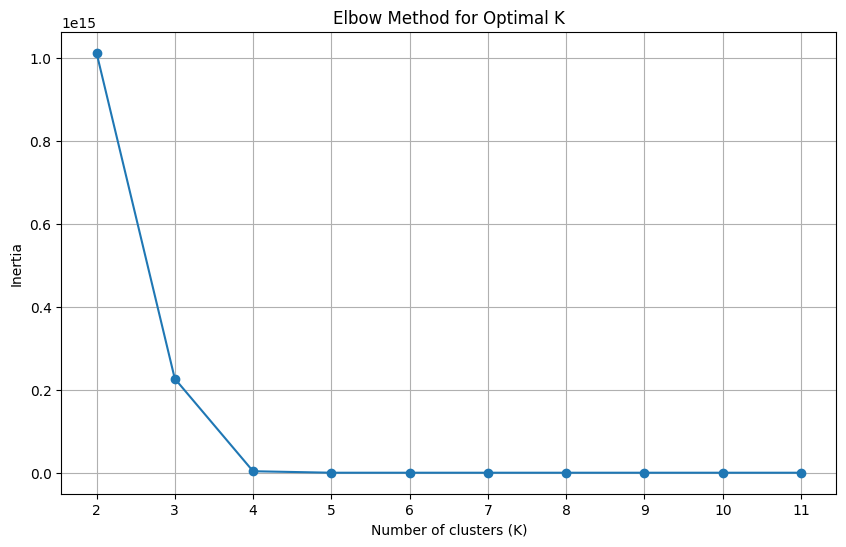

./elbow_test_export/SS-I_csv_10_44845_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       2      3      9   10500000.0  2048      13615.0   147.560        2
1       2      3      3     262000.0  2048      11877.0   167.730        0
2       2      1      2  105000000.0  1024      11218.0   179.020        1
3       1      1      6   10500000.0  2048      13955.0    69.705        2
4       3      3      2    5240000.0  2048      11475.0   263.580        3
..    ...    ...    ...          ...   ...          ...       ...      ...
65      3      6     12  105000000.0  1024      18972.0   167.870        1
66      1      2      9     262000.0  2048      19992.0    47.622        0
67      1      3      1    5240000.0   512       8571.8   110.880        3
68      3      2     12  105000000.0  2048      15681.0   203.010        1
69      2      3     12  105000000.0  2048      14753.0   142.820        1

[70 rows x 8 columns]
[0.48

<Figure size 640x480 with 0 Axes>

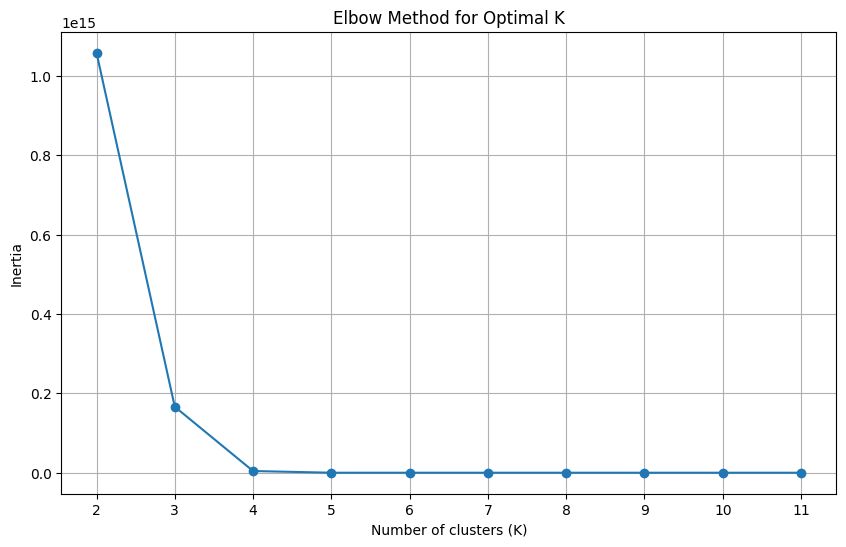

./elbow_test_export/SS-I_csv_10_51176_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       2      6     12   10500000.0  2048      15139.0    131.67        0
1       3      3     12     262000.0  1024      18349.0    167.46        2
2       1      3      1  105000000.0   512       8423.9    112.78        1
3       3      6      1   10500000.0   512       8560.2    354.29        0
4       2      6      9    1050000.0  2048      14215.0    138.06        2
..    ...    ...    ...          ...   ...          ...       ...      ...
65      2      3      1    1050000.0  2048       9682.5    200.58        2
66      3      2      1  105000000.0  1024       8153.9    380.27        1
67      2      3     12    5240000.0   512      14808.0    137.62        3
68      3      3      1  105000000.0  1024       8083.4    382.76        1
69      2      2     12  105000000.0  1024      14810.0    139.85        1

[70 rows x 8 columns]
[0.47

<Figure size 640x480 with 0 Axes>

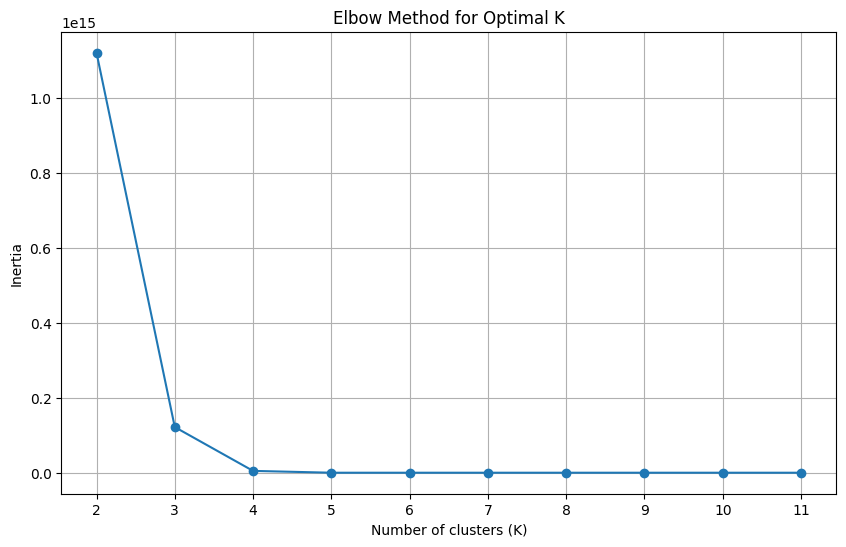

./elbow_test_export/SS-I_csv_10_58612_elbow_test.png
Optimal k value: 3
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       2      1      2    1050000.0  1024      11254.0   175.100        2
1       1      1     12    5240000.0  1024      14805.0    68.305        2
2       2      1      2   10500000.0  1024      11572.0   173.700        0
3       1      2      2   10500000.0   512      11302.0    83.442        0
4       1      2      3    1050000.0   512      14327.0    67.328        2
..    ...    ...    ...          ...   ...          ...       ...      ...
65      3      2      2   10500000.0  1024      11490.0   278.640        0
66      3      3      2     262000.0  2048      11687.0   263.870        2
67      3      1      1    5240000.0  2048       7858.1   387.380        2
68      2      6      2    1050000.0  1024      11437.0   177.010        2
69      1      1      3   10500000.0  2048      11983.0    80.941        0

[70 rows x 8 columns]
[0.46

<Figure size 640x480 with 0 Axes>

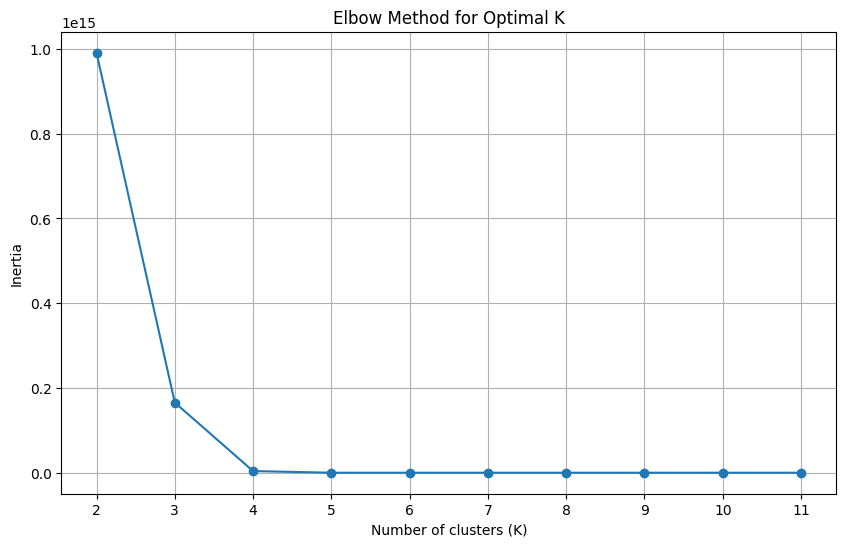

./elbow_test_export/SS-I_csv_10_61367_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       2      6     12   10500000.0  2048      15139.0   131.670        2
1       3      2      9   10500000.0  1024      15773.0   201.110        2
2       2      3     12    5240000.0  2048      14557.0   133.220        3
3       1      6      2    1050000.0  2048      11690.0    83.558        0
4       2      3      2    5240000.0  2048      11766.0   168.680        3
..    ...    ...    ...          ...   ...          ...       ...      ...
65      3      2     12  105000000.0   512      15753.0   193.190        1
66      2      6      6    5240000.0   512      12790.0   156.570        3
67      2      1      6    1050000.0   512      12742.0   159.030        0
68      1      6     12   10500000.0  1024      13987.0    65.751        2
69      3      6      3  105000000.0  1024      13865.0   215.980        1

[70 rows x 8 columns]
[0.50

<Figure size 640x480 with 0 Axes>

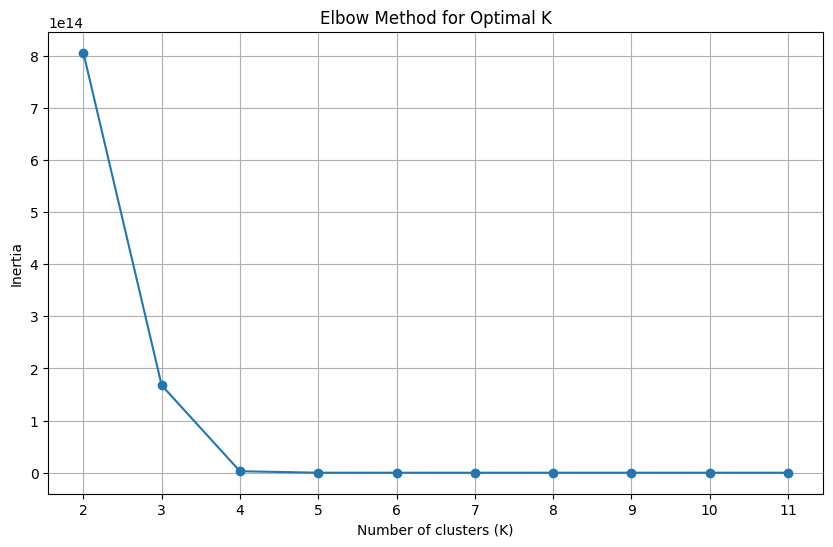

./elbow_test_export/SS-I_csv_10_65388_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       1      3      2    1050000.0  2048      11549.0    84.664        2
1       2      2      9    5240000.0  2048      14160.0   143.350        3
2       2      3      2  105000000.0  2048      11384.0   177.380        1
3       2      1     12   10500000.0  2048      14456.0   135.190        0
4       1      3     12   10500000.0  2048      12437.0    77.372        0
..    ...    ...    ...          ...   ...          ...       ...      ...
65      2      3      6  105000000.0   512      12741.0   156.580        1
66      1      1      3  105000000.0  2048      12221.0    79.187        1
67      2      6      3  105000000.0  1024      12007.0   165.000        1
68      3      6      2  105000000.0  2048      12107.0   248.100        1
69      3      3      2  105000000.0   512      11738.0   259.030        1

[70 rows x 8 columns]
[0.48

<Figure size 640x480 with 0 Axes>

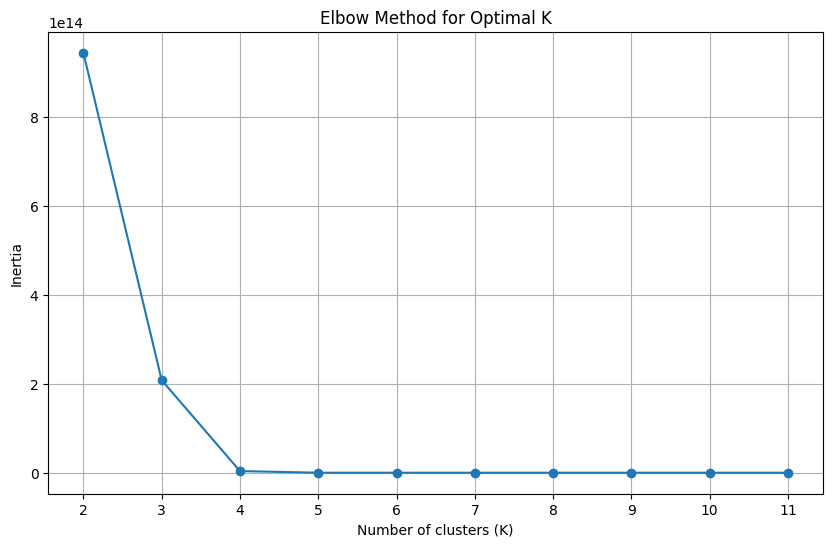

./elbow_test_export/SS-I_csv_10_65444_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       3      2      1    5240000.0  1024       8231.7   362.870        1
1       3      3      9  105000000.0   512      16949.0   189.300        0
2       1      1      6     262000.0  2048      13516.0    71.818        2
3       2      2      3  105000000.0  1024      12621.0   161.800        0
4       1      2      3   10500000.0  1024      14584.0    66.234        3
..    ...    ...    ...          ...   ...          ...       ...      ...
65      1      3      6    1050000.0   512      12604.0    78.001        2
66      1      1      2  105000000.0  1024      10817.0    92.744        0
67      1      3      3   10500000.0   512      12192.0    78.380        3
68      3      2      2    5240000.0  2048      11650.0   263.150        1
69      2      6      2     262000.0   512      11742.0   166.740        2

[70 rows x 8 columns]
[0.38

<Figure size 640x480 with 0 Axes>

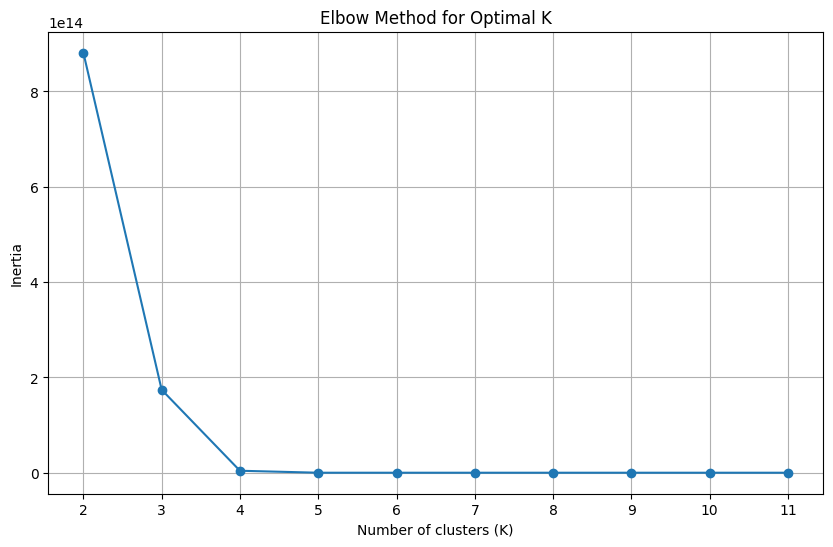

./elbow_test_export/SS-I_csv_10_66946_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       1      2     12    1050000.0  2048      19935.0    51.311        2
1       1      1     12   10500000.0  1024      14971.0    64.789        0
2       1      3      1    5240000.0  2048       8404.0   114.930        3
3       2      6      6    1050000.0  2048      13047.0   147.880        2
4       2      1      2    1050000.0  2048      11488.0   172.870        2
..    ...    ...    ...          ...   ...          ...       ...      ...
65      3      2      9   10500000.0  2048      15101.0   202.330        0
66      3      1      2  105000000.0  1024      11515.0   268.590        1
67      1      1      2   10500000.0  1024      10793.0    92.613        0
68      3      2      3     262000.0  2048      12419.0   245.430        2
69      3      1      9     262000.0   512      12422.0   242.850        2

[70 rows x 8 columns]
[0.51

<Figure size 640x480 with 0 Axes>

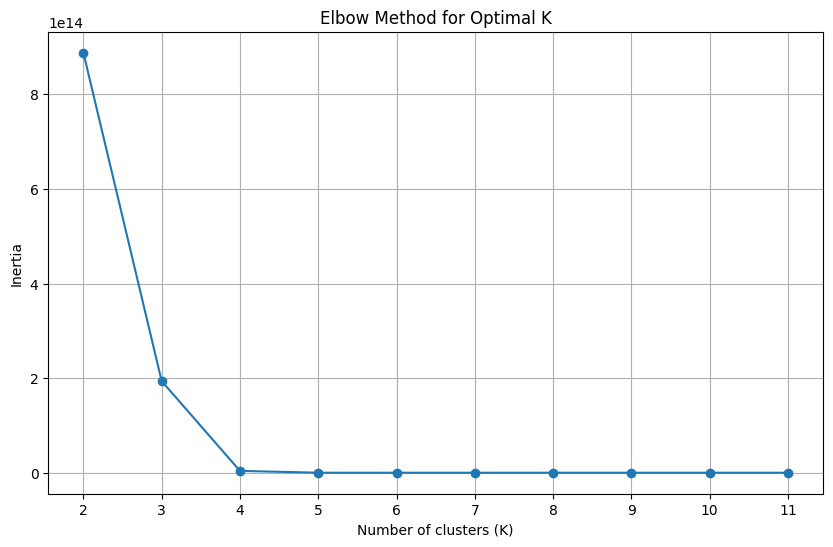

./elbow_test_export/SS-I_csv_10_69024_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       2      6      6  105000000.0  2048      13050.0   145.750        1
1       2      6      1   10500000.0   512       9789.0   197.190        0
2       1      6      9     262000.0  2048      13824.0    69.907        2
3       1      3      3   10500000.0   512      12192.0    78.380        0
4       2      3      3     262000.0   512      11589.0   172.210        2
..    ...    ...    ...          ...   ...          ...       ...      ...
65      1      2      1    1050000.0  2048       7811.1   127.360        2
66      1      2     12     262000.0  2048      20534.0    49.505        2
67      2      1      3    1050000.0  2048      12465.0   157.740        2
68      2      6     12    1050000.0  1024      15471.0   125.770        2
69      2      6      2    5240000.0   512      11574.0   176.280        3

[70 rows x 8 columns]
[0.52

<Figure size 640x480 with 0 Axes>

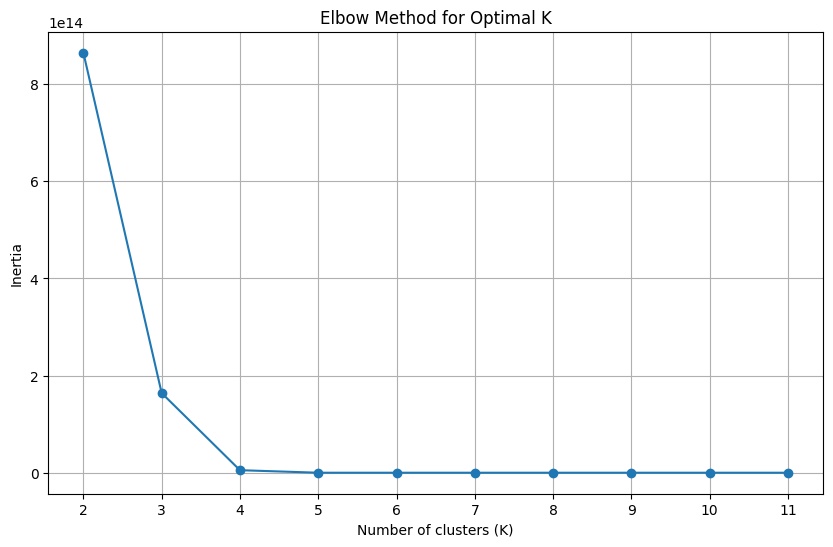

./elbow_test_export/SS-I_csv_10_70006_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       3      1      6   10500000.0  1024      11847.0   250.200        0
1       1      6      1     262000.0  2048       8528.8   106.990        2
2       2      2      2  105000000.0   512      12581.0   158.910        1
3       1      3      6     262000.0  2048      12237.0    77.458        2
4       2      2      1   10500000.0   512       8517.5   236.680        0
..    ...    ...    ...          ...   ...          ...       ...      ...
65      1      1      6    5240000.0  1024      13611.0    70.129        3
66      2      1      9     262000.0  1024      14350.0   137.560        2
67      2      6      6    5240000.0  1024      13097.0   147.470        3
68      1      6     12   10500000.0   512      13511.0    70.402        0
69      1      3      2   10500000.0  2048      11772.0    82.358        0

[70 rows x 8 columns]
[0.44

<Figure size 640x480 with 0 Axes>

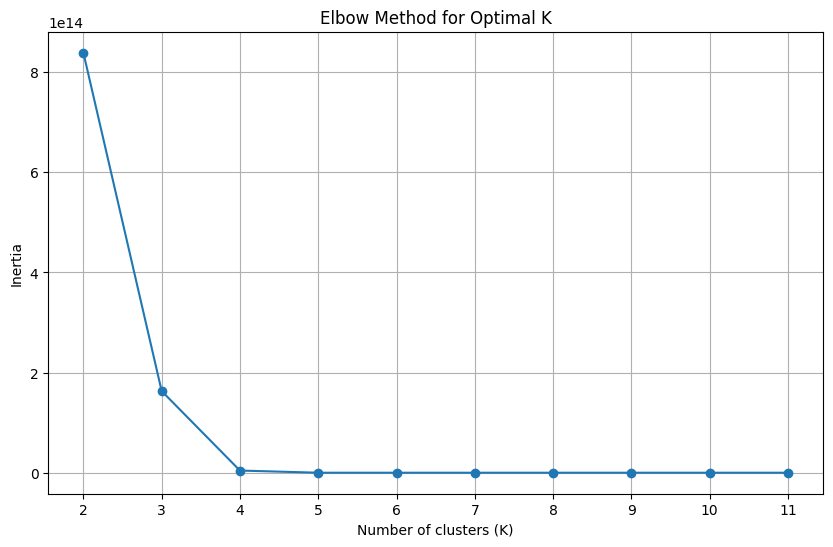

./elbow_test_export/SS-I_csv_10_70292_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       1      1      3  105000000.0  2048      12221.0    79.187        1
1       2      2      9    1050000.0  1024      13711.0   147.740        2
2       1      2      6  105000000.0  1024      17497.0    54.146        1
3       1      1      3   10500000.0   512      12597.0    80.093        0
4       3      2      9    5240000.0  1024      15317.0   199.730        3
..    ...    ...    ...          ...   ...          ...       ...      ...
65      3      2      1   10500000.0   512       8170.9   370.080        0
66      3      6      6    1050000.0  1024      15528.0   196.240        2
67      3      2      9    1050000.0   512      14853.0   212.770        2
68      2      2     12    1050000.0  2048      14175.0   135.470        2
69      2      3     12  105000000.0   512      14436.0   137.280        1

[70 rows x 8 columns]
[0.44

<Figure size 640x480 with 0 Axes>

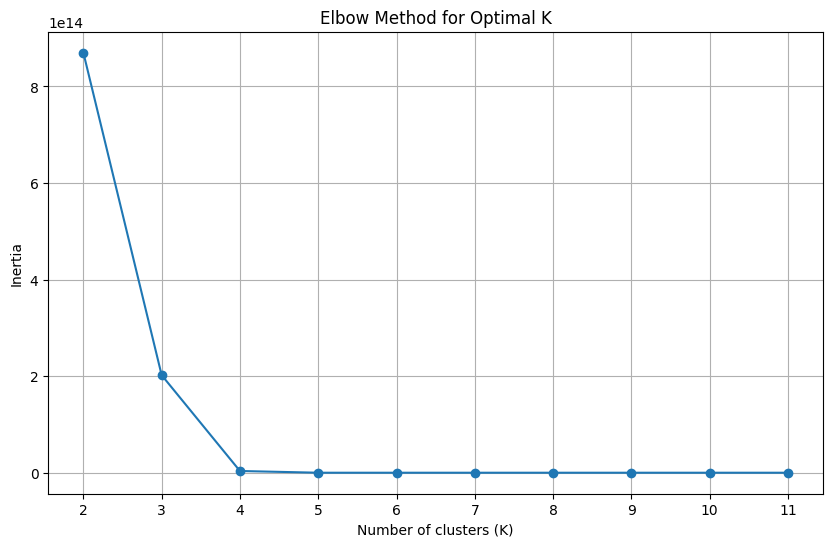

./elbow_test_export/SS-I_csv_10_77340_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       3      3      9     262000.0  1024      17633.0   182.470        2
1       3      6      6     262000.0  1024      15574.0   203.430        2
2       3      6      1     262000.0  2048       8443.9   350.410        2
3       3      6      3     262000.0  2048      13830.0   219.690        2
4       3      1      6  105000000.0  1024      12052.0   258.380        1
..    ...    ...    ...          ...   ...          ...       ...      ...
65      3      6      2  105000000.0  2048      12107.0   248.100        1
66      1      2      2  105000000.0  1024      11067.0    87.060        1
67      1      6      9   10500000.0  1024      13292.0    70.041        0
68      3      6      2    1050000.0  1024      11594.0   255.230        2
69      1      6      2   10500000.0   512      11815.0    81.210        0

[70 rows x 8 columns]
[0.45

<Figure size 640x480 with 0 Axes>

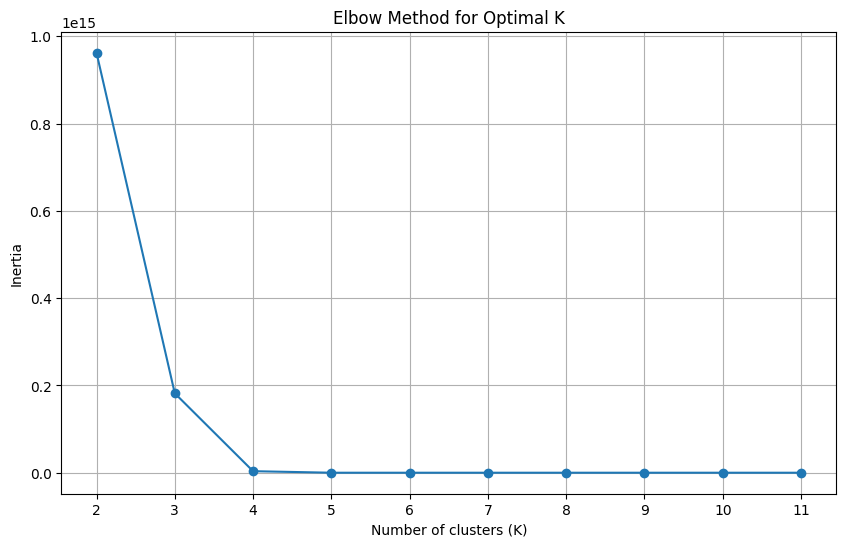

./elbow_test_export/SS-I_csv_10_77845_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       2      2      6   10500000.0  2048      12322.0   153.880        3
1       3      6      9     262000.0   512      17194.0   186.420        2
2       3      3      9    5240000.0   512      16854.0   181.010        1
3       2      1      9  105000000.0   512      13791.0   147.230        0
4       3      6      9    5240000.0  2048      17512.0   172.990        1
..    ...    ...    ...          ...   ...          ...       ...      ...
65      2      3      1    1050000.0   512       9661.6   202.410        2
66      1      1      9   10500000.0  2048      14557.0    69.437        3
67      1      3      2     262000.0  2048      11518.0    83.852        2
68      2      1      3    5240000.0  1024      11924.0   175.490        1
69      2      3      6    1050000.0  2048      13339.0   154.390        2

[70 rows x 8 columns]
[0.49

<Figure size 640x480 with 0 Axes>

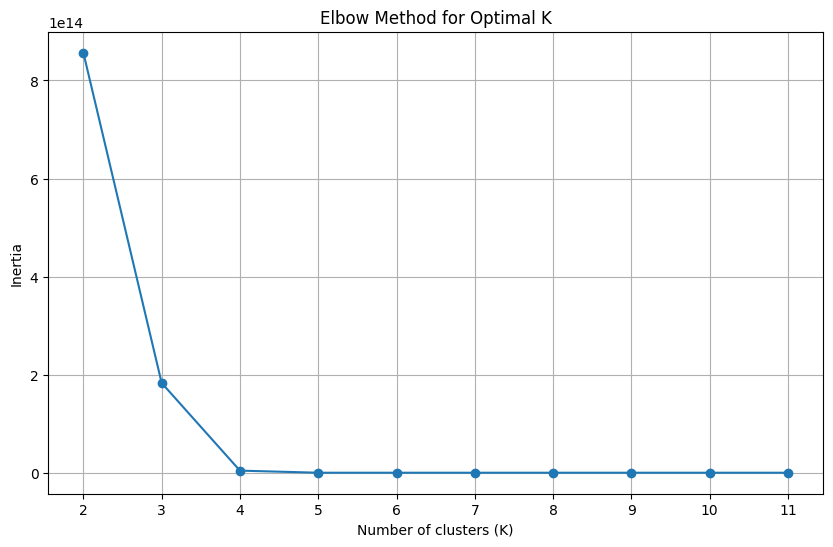

./elbow_test_export/SS-I_csv_10_83686_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       1      1      1  105000000.0  1024       9333.8   102.770        1
1       3      2      3     262000.0  2048      12419.0   245.430        0
2       3      2      9     262000.0  1024      15383.0   196.520        0
3       2      2      9    5240000.0  2048      14160.0   143.350        2
4       2      3     12   10500000.0  1024      14750.0   133.890        3
..    ...    ...    ...          ...   ...          ...       ...      ...
65      3      3      6   10500000.0  1024      15353.0   196.480        3
66      1      2      2   10500000.0  1024      11185.0    86.291        3
67      2      2      3     262000.0  2048      12499.0   162.460        0
68      2      3      3    5240000.0  1024      11637.0   171.710        2
69      1      1     12    1050000.0  1024      14910.0    67.445        0

[70 rows x 8 columns]
[0.42

<Figure size 640x480 with 0 Axes>

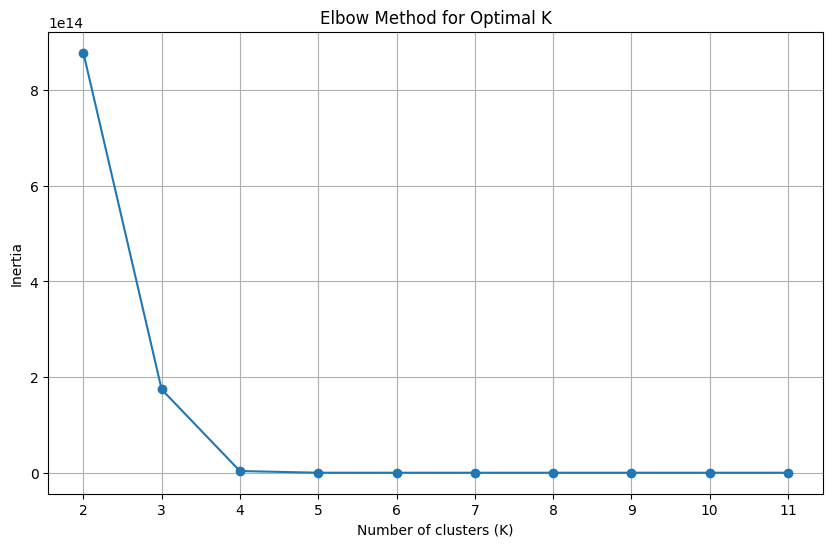

./elbow_test_export/SS-I_csv_10_84967_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       2      6      1    1050000.0  2048       9551.3   197.830        0
1       2      1     12    1050000.0  1024      14385.0   135.920        0
2       1      1     12  105000000.0  1024      14557.0    66.947        1
3       2      6     12   10500000.0   512      15587.0   129.740        2
4       3      1      2  105000000.0   512      11367.0   268.870        1
..    ...    ...    ...          ...   ...          ...       ...      ...
65      1      2      2  105000000.0  2048      11455.0    83.516        1
66      3      3      3    1050000.0  1024      13658.0   223.860        0
67      3      3      2   10500000.0  1024      11650.0   263.140        2
68      2      2     12   10500000.0   512      15329.0   137.400        2
69      3      2      6   10500000.0   512      13983.0   214.560        2

[70 rows x 8 columns]
[0.47

<Figure size 640x480 with 0 Axes>

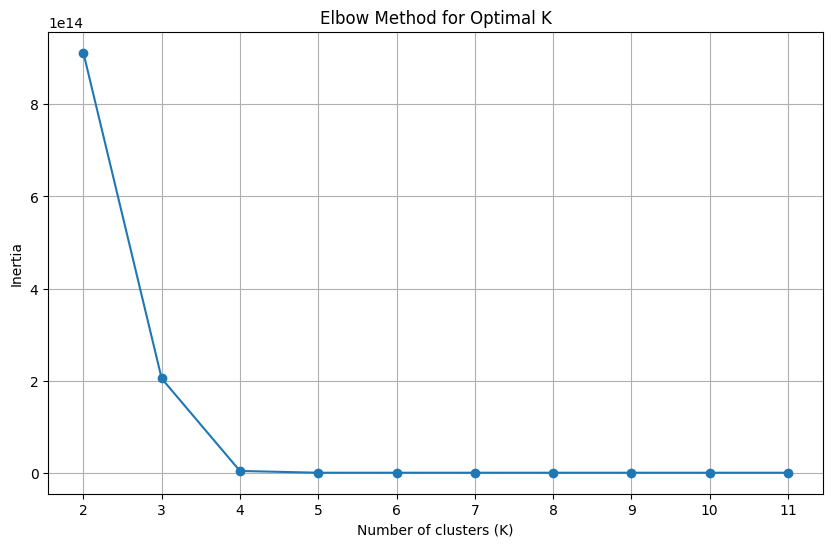

./elbow_test_export/SS-I_csv_10_86331_elbow_test.png
Optimal k value: 4
    Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0       1      6      6    1050000.0  2048      12812.0    73.119        2
1       3      6      6     262000.0  2048      14967.0   204.870        2
2       3      3      9   10500000.0  2048      16833.0   183.640        3
3       2      2      6   10500000.0  1024      13154.0   150.980        3
4       2      2      3    1050000.0   512      12469.0   162.720        2
..    ...    ...    ...          ...   ...          ...       ...      ...
65      2      3      3    1050000.0   512      11813.0   166.260        2
66      3      6      9  105000000.0   512      16954.0   184.920        1
67      3      2      2    5240000.0  2048      11650.0   263.150        0
68      3      1      9     262000.0  1024      12160.0   244.750        2
69      2      1      9   10500000.0  1024      13875.0   143.540        3

[70 rows x 8 columns]
[0.50

<Figure size 640x480 with 0 Axes>

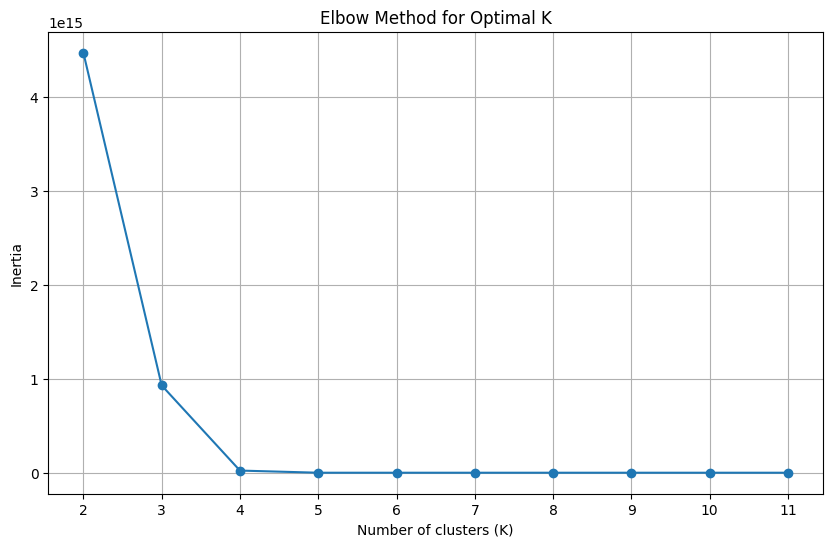

./elbow_test_export/SS-I_csv_50_11514_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      6      6  105000000.0  1024      15370.0   196.870        1
1        2      1      3     262000.0  1024      12325.0   165.610        0
2        2      3      3   10500000.0  2048      11394.0   178.650        2
3        2      3     12    5240000.0  1024      14707.0   132.910        3
4        2      1      3    1050000.0   512      12418.0   164.900        0
..     ...    ...    ...          ...   ...          ...       ...      ...
345      2      6     12    5240000.0  1024      15339.0   123.240        3
346      1      2      3    5240000.0  1024      14197.0    69.457        3
347      2      2      3    5240000.0   512      12699.0   161.350        3
348      3      1      6  105000000.0   512      11781.0   258.810        1
349      2      6      6     262000.0  1024      12864.0   149.100        0

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

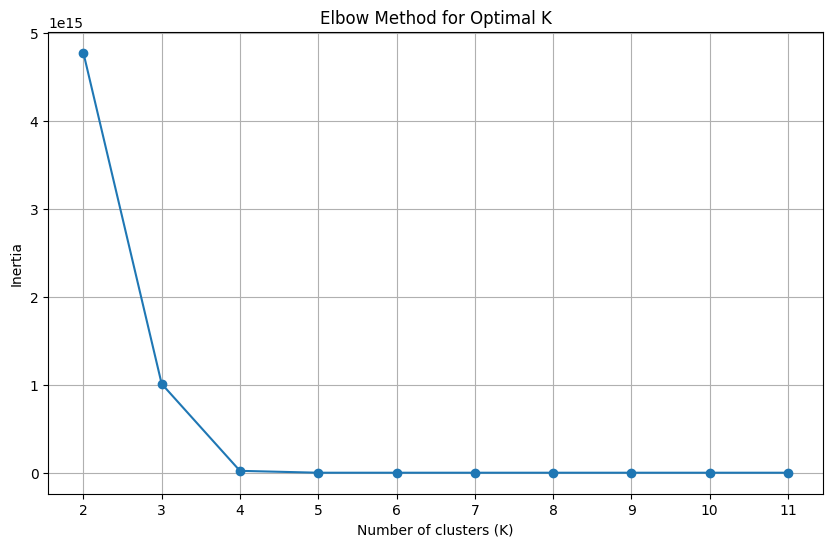

./elbow_test_export/SS-I_csv_50_19953_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6     12    1050000.0  2048      15256.0   129.030        2
1        2      2      1    5240000.0   512       8229.4   245.200        1
2        3      2      1     262000.0  2048       8198.4   372.850        2
3        3      1      6     262000.0   512      11920.0   250.240        2
4        1      2      3    1050000.0  1024      14343.0    67.011        2
..     ...    ...    ...          ...   ...          ...       ...      ...
345      2      1      6     262000.0   512      13701.0   146.250        2
346      2      6      2    1050000.0   512      11758.0   168.510        2
347      2      2     12    5240000.0  2048      14184.0   137.270        1
348      1      3      9  105000000.0   512      12390.0    78.109        0
349      1      6      2   10500000.0  1024      11604.0    82.823        3

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

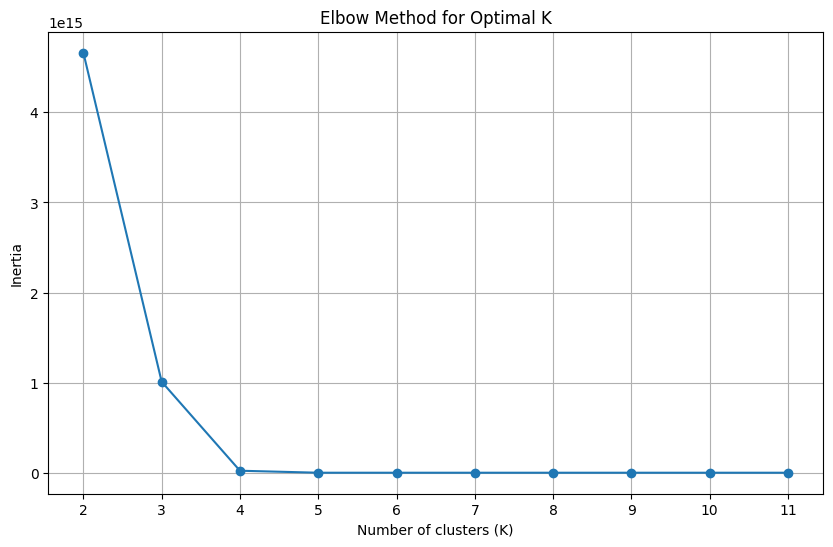

./elbow_test_export/SS-I_csv_50_3545_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      2      6    5240000.0   512      17189.0    57.059        3
1        2      6      3    1050000.0   512      11937.0   163.400        0
2        3      2      6   10500000.0  1024      14290.0   211.170        2
3        2      1      2    5240000.0   512      11241.0   179.530        3
4        3      2      6    1050000.0  1024      13980.0   215.670        0
..     ...    ...    ...          ...   ...          ...       ...      ...
345      2      1      3   10500000.0  2048      12602.0   158.230        2
346      3      6      3    1050000.0  2048      13699.0   223.010        0
347      3      3     12    1050000.0   512      17892.0   172.780        0
348      1      2      2     262000.0  2048      11125.0    86.779        0
349      2      1     12    5240000.0  1024      14161.0   136.240        3

[350 rows x 8 co

<Figure size 640x480 with 0 Axes>

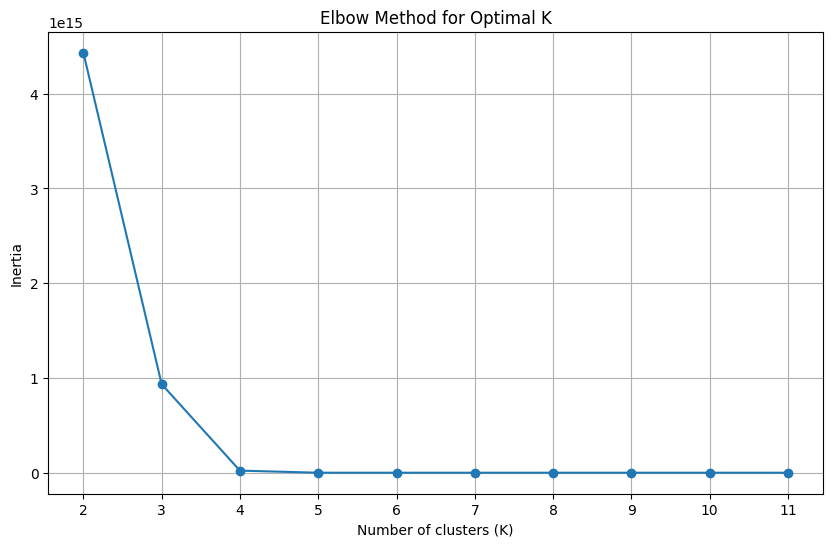

./elbow_test_export/SS-I_csv_50_39658_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      3      6  105000000.0  2048      12455.0    73.217        1
1        2      1      6    5240000.0   512      13224.0   153.920        3
2        3      2      9    5240000.0  2048      15224.0   205.930        3
3        2      1     12  105000000.0   512      12999.0   152.140        1
4        3      6      6   10500000.0  1024      15822.0   191.570        2
..     ...    ...    ...          ...   ...          ...       ...      ...
345      2      1      3    5240000.0  1024      11924.0   175.490        3
346      3      3      6    5240000.0   512      14876.0   200.340        3
347      2      2      2    1050000.0   512      12240.0   163.520        0
348      2      2      6     262000.0  2048      13395.0   150.910        0
349      3      3      3   10500000.0  1024      13672.0   223.300        2

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

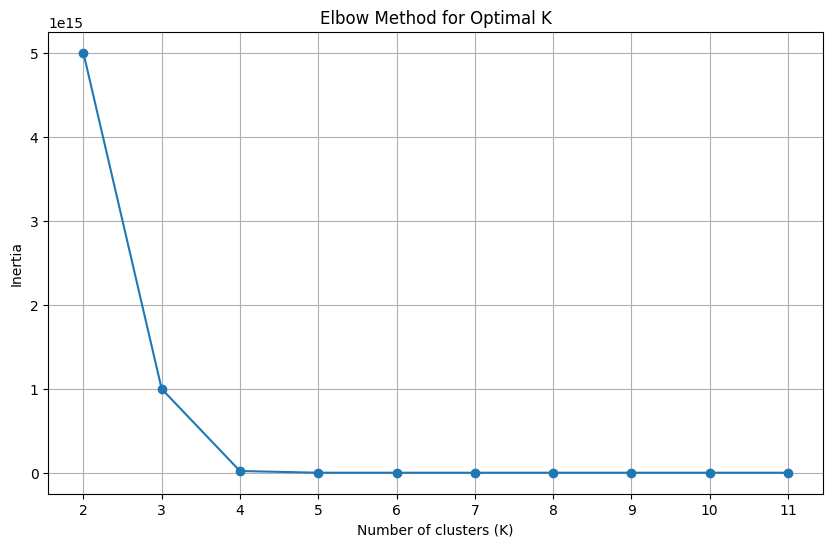

./elbow_test_export/SS-I_csv_50_40749_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      3      2    1050000.0  2048      11542.0   267.340        2
1        3      1      6  105000000.0   512      11781.0   258.810        1
2        2      2      3   10500000.0  2048      12657.0   157.840        3
3        3      1     12    1050000.0  2048      12827.0   237.560        2
4        2      3      1    5240000.0  1024       9398.1   202.450        0
..     ...    ...    ...          ...   ...          ...       ...      ...
345      1      1      2    1050000.0  1024      11009.0    90.522        2
346      1      3      2    5240000.0  1024      11795.0    83.769        0
347      1      1      9   10500000.0   512      15037.0    64.194        3
348      2      6      2  105000000.0   512      11655.0   169.220        1
349      2      3      3    1050000.0   512      11813.0   166.260        2

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

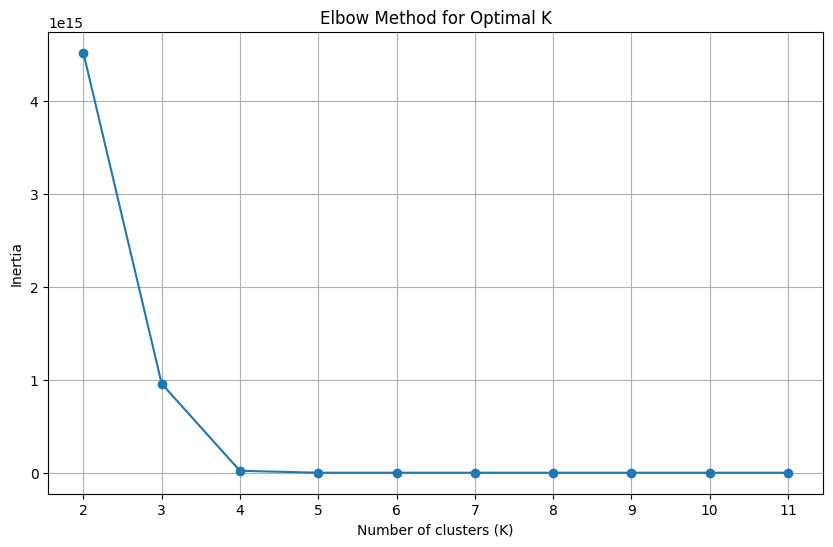

./elbow_test_export/SS-I_csv_50_44845_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      3      9   10500000.0  2048      13615.0   147.560        0
1        2      3      3     262000.0  2048      11877.0   167.730        2
2        2      1      2  105000000.0  1024      11218.0   179.020        1
3        1      1      6   10500000.0  2048      13955.0    69.705        0
4        3      3      2    5240000.0  2048      11475.0   263.580        3
..     ...    ...    ...          ...   ...          ...       ...      ...
345      3      6     12    1050000.0  2048      18664.0   171.800        2
346      3      1      1   10500000.0  2048       7999.9   384.800        0
347      2      1      1    5240000.0   512       8080.2   251.140        3
348      1      2      1     262000.0  1024       7878.8   125.610        2
349      3      2     12  105000000.0  1024      15825.0   185.040        1

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

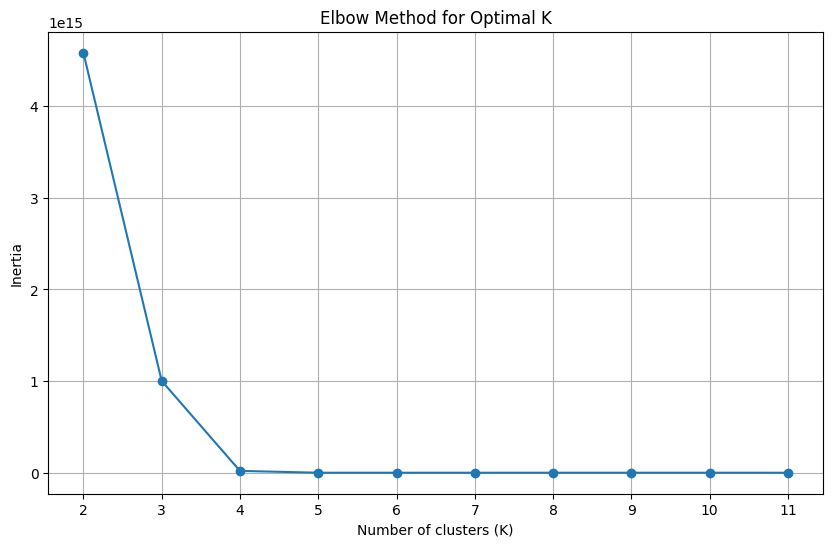

./elbow_test_export/SS-I_csv_50_51176_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6     12   10500000.0  2048      15139.0    131.67        3
1        3      3     12     262000.0  1024      18349.0    167.46        2
2        1      3      1  105000000.0   512       8423.9    112.78        0
3        3      6      1   10500000.0   512       8560.2    354.29        3
4        2      6      9    1050000.0  2048      14215.0    138.06        2
..     ...    ...    ...          ...   ...          ...       ...      ...
345      2      1      6     262000.0  2048      13046.0    153.25        2
346      3      2      9   10500000.0  2048      15101.0    202.33        3
347      2      6      3    1050000.0  2048      11856.0    164.90        2
348      3      1      2    1050000.0  1024      11301.0    275.85        2
349      3      6      9     262000.0   512      17194.0    186.42        2

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

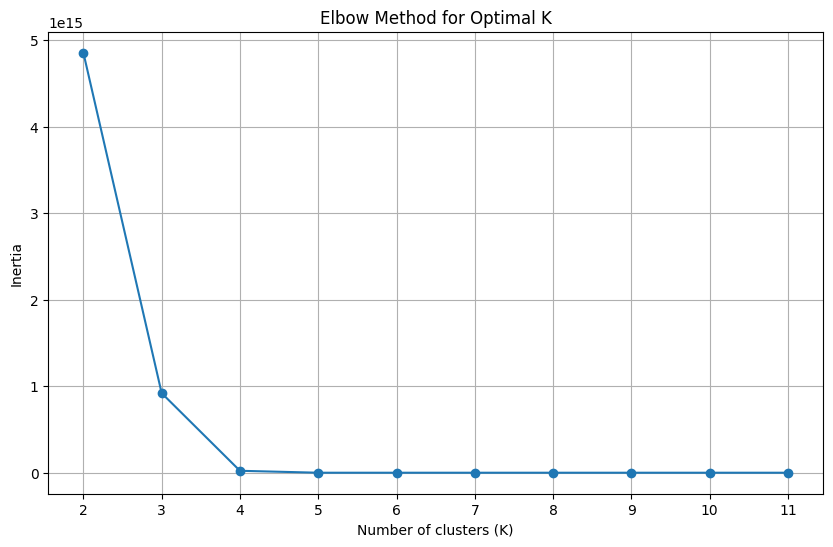

./elbow_test_export/SS-I_csv_50_58612_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      1      2    1050000.0  1024      11254.0   175.100        0
1        1      1     12    5240000.0  1024      14805.0    68.305        3
2        2      1      2   10500000.0  1024      11572.0   173.700        2
3        1      2      2   10500000.0   512      11302.0    83.442        2
4        1      2      3    1050000.0   512      14327.0    67.328        0
..     ...    ...    ...          ...   ...          ...       ...      ...
345      3      2     12  105000000.0   512      15753.0   193.190        1
346      3      2      1   10500000.0  2048       8407.0   366.260        2
347      1      2      1    5240000.0  1024       7954.7   126.380        3
348      1      6      6   10500000.0  1024      12604.0    74.836        2
349      3      2     12    5240000.0  1024      15855.0   191.910        3

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

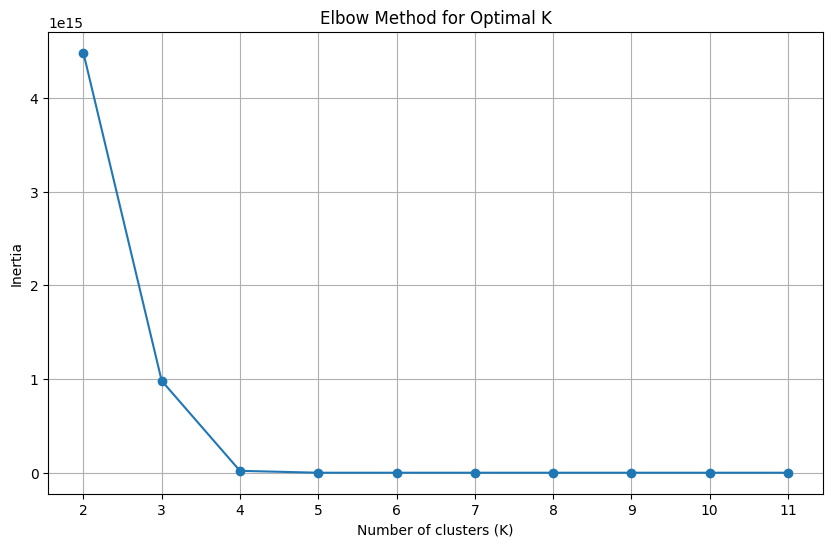

./elbow_test_export/SS-I_csv_50_61367_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6     12   10500000.0  2048      15139.0   131.670        2
1        3      2      9   10500000.0  1024      15773.0   201.110        2
2        2      3     12    5240000.0  2048      14557.0   133.220        3
3        1      6      2    1050000.0  2048      11690.0    83.558        0
4        2      3      2    5240000.0  2048      11766.0   168.680        3
..     ...    ...    ...          ...   ...          ...       ...      ...
345      1      1      6   10500000.0  1024      13915.0    69.791        2
346      1      2      6    1050000.0   512      17898.0    54.633        0
347      2      2      3    5240000.0  1024      12478.0   165.570        3
348      2      2      9  105000000.0  2048      14045.0   145.760        1
349      1      1      3  105000000.0   512      12503.0    80.717        1

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

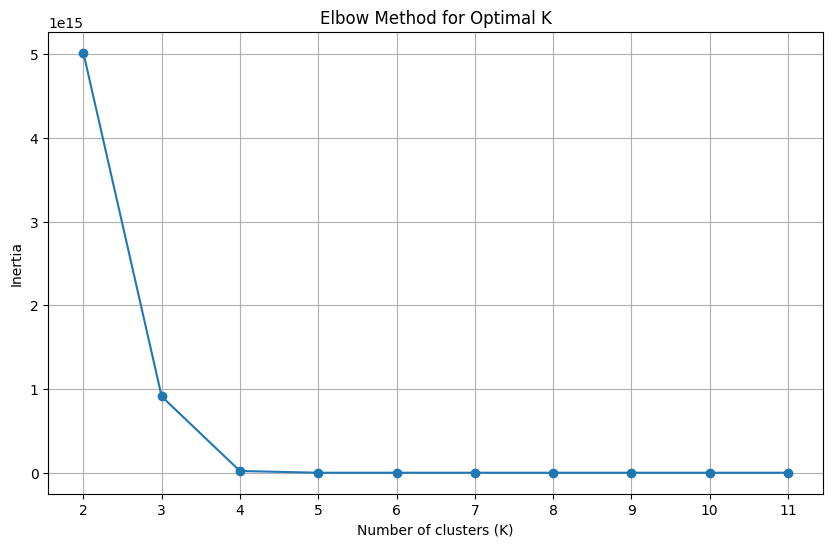

./elbow_test_export/SS-I_csv_50_65388_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      3      2    1050000.0  2048      11549.0    84.664        2
1        2      2      9    5240000.0  2048      14160.0   143.350        0
2        2      3      2  105000000.0  2048      11384.0   177.380        1
3        2      1     12   10500000.0  2048      14456.0   135.190        3
4        1      3     12   10500000.0  2048      12437.0    77.372        3
..     ...    ...    ...          ...   ...          ...       ...      ...
345      1      2      6    1050000.0  1024      17299.0    55.711        2
346      3      3      3  105000000.0   512      13981.0   222.080        1
347      2      2      6   10500000.0  2048      12322.0   153.880        3
348      3      1      1   10500000.0  2048       7999.9   384.800        3
349      1      3      3    1050000.0  1024      12217.0    79.256        2

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

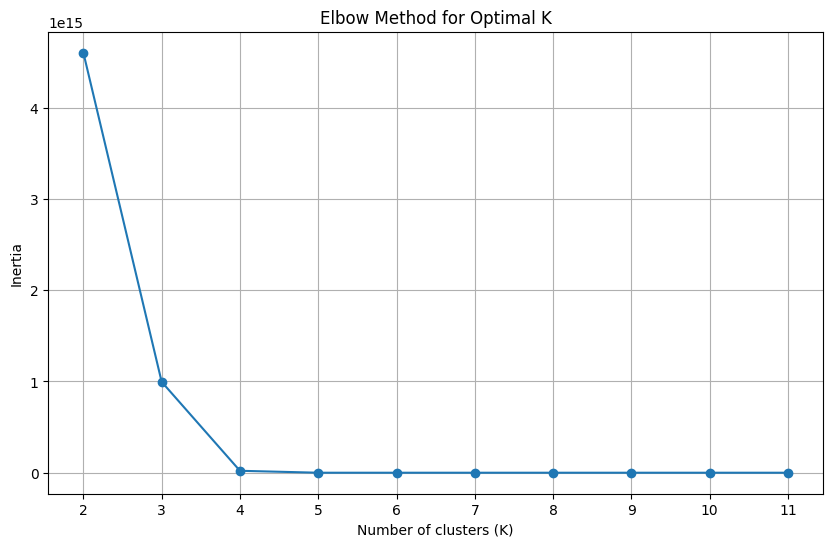

./elbow_test_export/SS-I_csv_50_65444_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      2      1    5240000.0  1024       8231.7   362.870        3
1        3      3      9  105000000.0   512      16949.0   189.300        1
2        1      1      6     262000.0  2048      13516.0    71.818        0
3        2      2      3  105000000.0  1024      12621.0   161.800        1
4        1      2      3   10500000.0  1024      14584.0    66.234        2
..     ...    ...    ...          ...   ...          ...       ...      ...
345      3      3      9    5240000.0   512      16854.0   181.010        3
346      1      1      2    5240000.0  1024      10874.0    90.620        3
347      3      1      2    5240000.0  1024      11326.0   273.880        3
348      1      3      2  105000000.0  1024      11901.0    81.936        1
349      1      6      1    1050000.0   512       8584.0   113.320        0

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

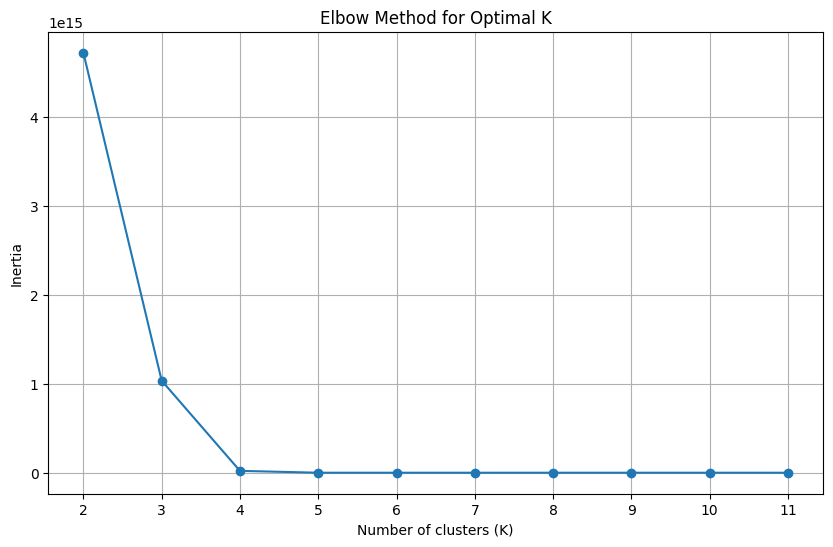

./elbow_test_export/SS-I_csv_50_66946_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      2     12    1050000.0  2048      19935.0    51.311        0
1        1      1     12   10500000.0  1024      14971.0    64.789        2
2        1      3      1    5240000.0  2048       8404.0   114.930        3
3        2      6      6    1050000.0  2048      13047.0   147.880        0
4        2      1      2    1050000.0  2048      11488.0   172.870        0
..     ...    ...    ...          ...   ...          ...       ...      ...
345      3      2     12   10500000.0   512      16054.0   184.060        2
346      3      3      1     262000.0  2048       8533.0   352.640        0
347      2      1      6  105000000.0  1024      12535.0   160.220        1
348      2      3      2   10500000.0  1024      11816.0   169.110        2
349      2      2      2   10500000.0   512      12446.0   161.590        2

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

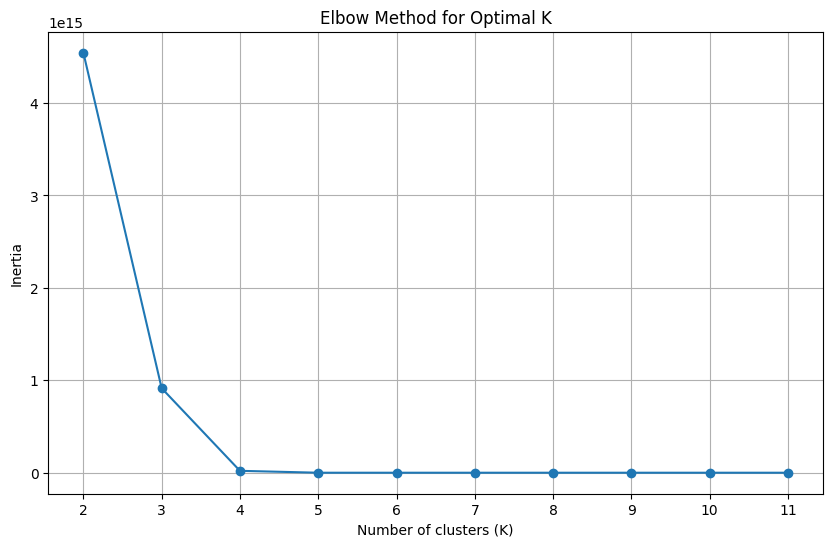

./elbow_test_export/SS-I_csv_50_69024_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6      6  105000000.0  2048      13050.0   145.750        0
1        2      6      1   10500000.0   512       9789.0   197.190        3
2        1      6      9     262000.0  2048      13824.0    69.907        2
3        1      3      3   10500000.0   512      12192.0    78.380        3
4        2      3      3     262000.0   512      11589.0   172.210        2
..     ...    ...    ...          ...   ...          ...       ...      ...
345      3      1     12    5240000.0  2048      12483.0   244.520        1
346      2      3      1    1050000.0  1024       9649.2   201.810        2
347      3      6     12     262000.0  2048      18315.0   176.250        2
348      2      3     12   10500000.0  1024      14750.0   133.890        3
349      3      2     12     262000.0  2048      15494.0   199.530        2

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

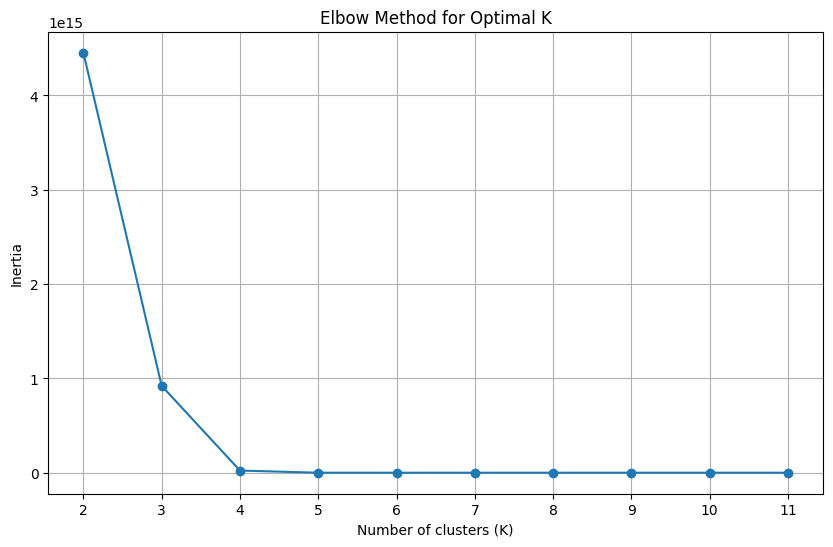

./elbow_test_export/SS-I_csv_50_70006_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      1      6   10500000.0  1024      11847.0   250.200        0
1        1      6      1     262000.0  2048       8528.8   106.990        2
2        2      2      2  105000000.0   512      12581.0   158.910        1
3        1      3      6     262000.0  2048      12237.0    77.458        2
4        2      2      1   10500000.0   512       8517.5   236.680        0
..     ...    ...    ...          ...   ...          ...       ...      ...
345      1      6      2     262000.0   512      12108.0    79.968        2
346      2      2      2   10500000.0  2048      12346.0   165.310        0
347      1      2     12    5240000.0  1024      20353.0    48.677        3
348      3      3      9  105000000.0  1024      16916.0   180.520        1
349      1      2      6   10500000.0  1024      17130.0    60.020        0

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

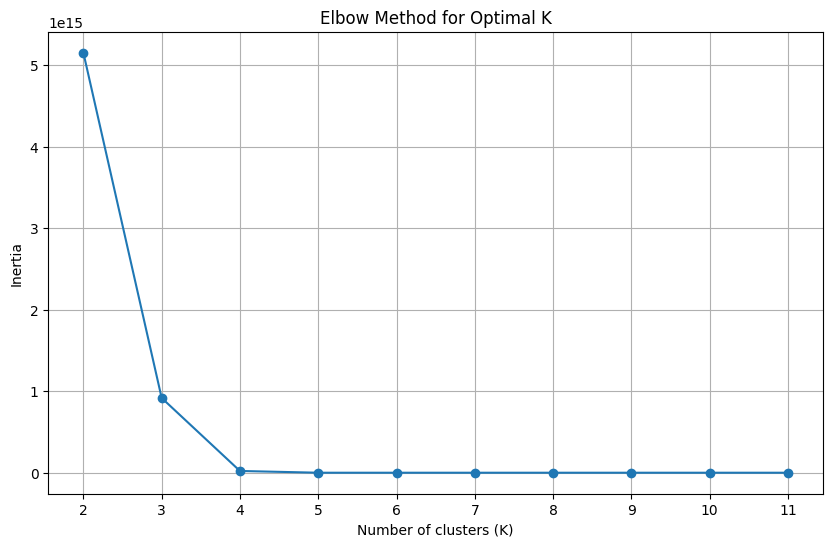

./elbow_test_export/SS-I_csv_50_70292_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      1      3  105000000.0  2048      12221.0    79.187        1
1        2      2      9    1050000.0  1024      13711.0   147.740        0
2        1      2      6  105000000.0  1024      17497.0    54.146        1
3        1      1      3   10500000.0   512      12597.0    80.093        2
4        3      2      9    5240000.0  1024      15317.0   199.730        3
..     ...    ...    ...          ...   ...          ...       ...      ...
345      1      3     12    1050000.0  2048      12771.0    72.043        0
346      2      2      3    1050000.0  1024      12135.0   167.020        0
347      1      1      2   10500000.0  2048      10839.0    91.767        2
348      1      3     12    1050000.0   512      13068.0    73.478        0
349      3      6      9    1050000.0  1024      17526.0   177.350        0

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

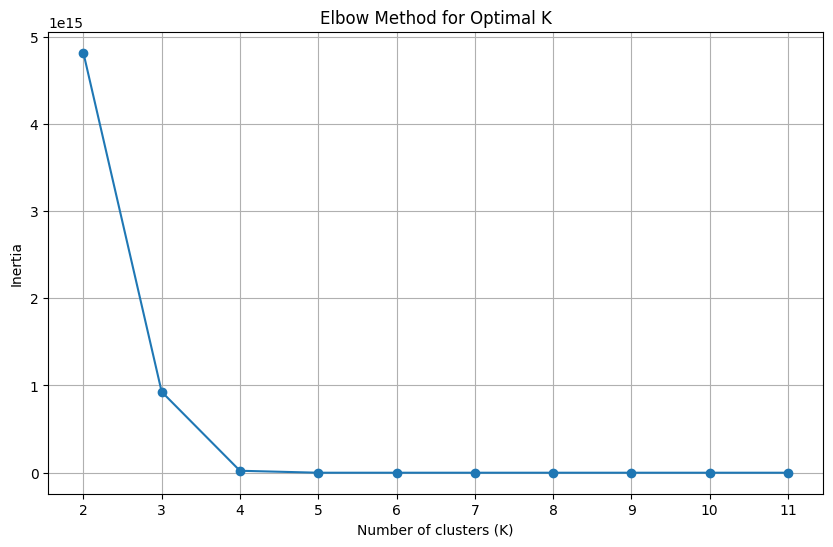

./elbow_test_export/SS-I_csv_50_77340_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        3      3      9     262000.0  1024      17633.0   182.470        2
1        3      6      6     262000.0  1024      15574.0   203.430        2
2        3      6      1     262000.0  2048       8443.9   350.410        2
3        3      6      3     262000.0  2048      13830.0   219.690        2
4        3      1      6  105000000.0  1024      12052.0   258.380        1
..     ...    ...    ...          ...   ...          ...       ...      ...
345      1      2      6   10500000.0   512      16393.0    61.680        0
346      1      2      1   10500000.0   512       7890.0   126.630        0
347      1      6      3  105000000.0  2048      12814.0    76.921        1
348      3      2     12    1050000.0  1024      15245.0   199.960        2
349      1      3      2   10500000.0  2048      11772.0    82.358        0

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

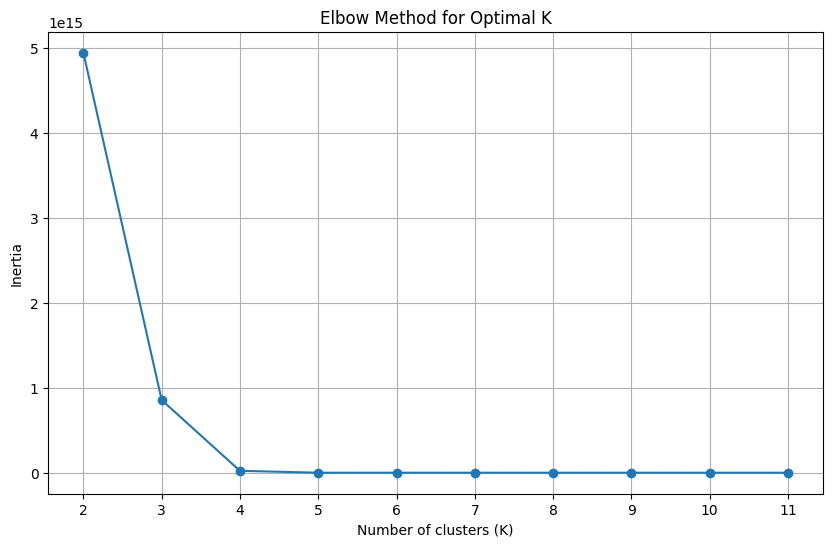

./elbow_test_export/SS-I_csv_50_77845_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      2      6   10500000.0  2048      12322.0   153.880        3
1        3      6      9     262000.0   512      17194.0   186.420        2
2        3      3      9    5240000.0   512      16854.0   181.010        1
3        2      1      9  105000000.0   512      13791.0   147.230        0
4        3      6      9    5240000.0  2048      17512.0   172.990        1
..     ...    ...    ...          ...   ...          ...       ...      ...
345      1      2      2     262000.0  2048      11125.0    86.779        2
346      3      2      3    5240000.0  2048      12315.0   247.840        1
347      3      2      3    1050000.0  2048      12555.0   244.310        2
348      2      1      6     262000.0  2048      13046.0   153.250        2
349      2      2     12   10500000.0  1024      14617.0   138.010        3

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

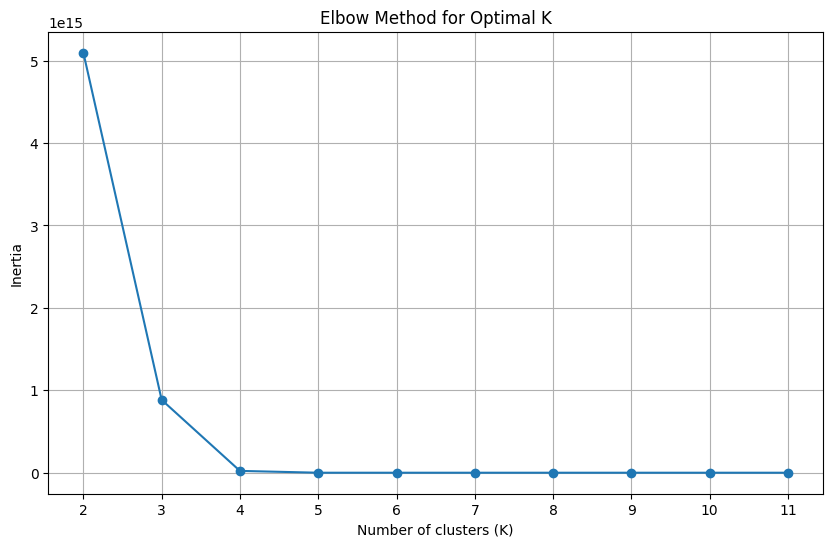

./elbow_test_export/SS-I_csv_50_83686_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      1      1  105000000.0  1024       9333.8   102.770        0
1        3      2      3     262000.0  2048      12419.0   245.430        1
2        3      2      9     262000.0  1024      15383.0   196.520        1
3        2      2      9    5240000.0  2048      14160.0   143.350        3
4        2      3     12   10500000.0  1024      14750.0   133.890        2
..     ...    ...    ...          ...   ...          ...       ...      ...
345      1      6     12    1050000.0  2048      13861.0    66.109        1
346      2      6      1    1050000.0  2048       9551.3   197.830        1
347      2      2      3    1050000.0  1024      12135.0   167.020        1
348      3      2      3    5240000.0  2048      12315.0   247.840        3
349      3      3      1    5240000.0  2048       8500.0   373.120        3

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

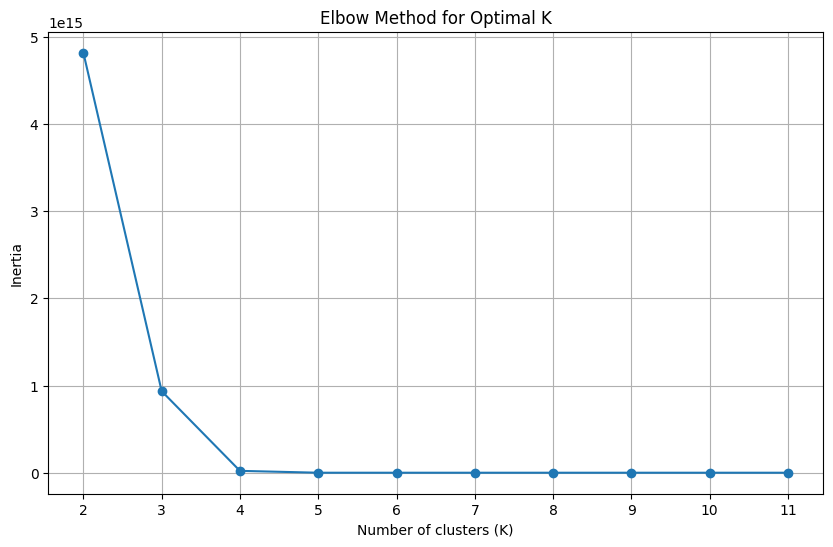

./elbow_test_export/SS-I_csv_50_84967_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        2      6      1    1050000.0  2048       9551.3   197.830        0
1        2      1     12    1050000.0  1024      14385.0   135.920        0
2        1      1     12  105000000.0  1024      14557.0    66.947        1
3        2      6     12   10500000.0   512      15587.0   129.740        2
4        3      1      2  105000000.0   512      11367.0   268.870        1
..     ...    ...    ...          ...   ...          ...       ...      ...
345      3      2      6    5240000.0  2048      14251.0   214.700        3
346      2      6      1  105000000.0  2048       9819.2   196.160        1
347      1      1      1     262000.0  2048       9375.7   101.580        0
348      3      2      1    1050000.0   512       7982.3   378.110        0
349      3      6      6     262000.0   512      15483.0   203.680        0

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

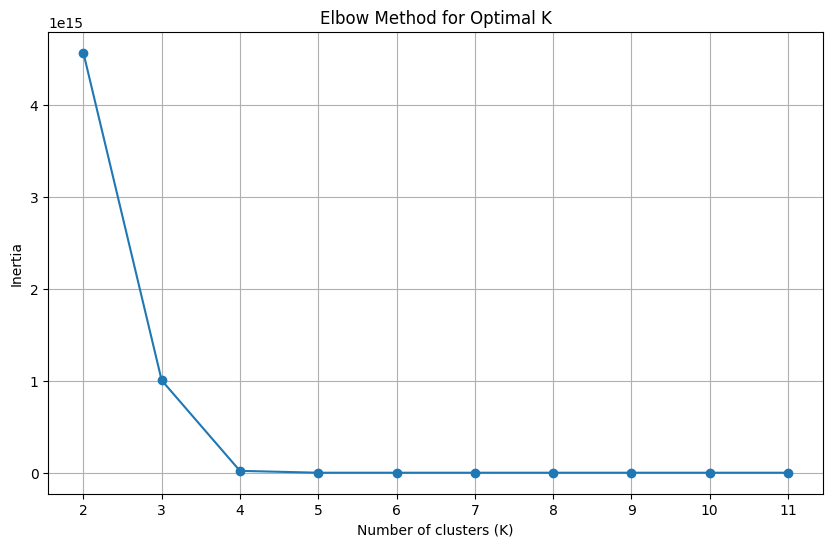

./elbow_test_export/SS-I_csv_50_86331_elbow_test.png
Optimal k value: 4
     Spout  Split  Count  Buffer_size  Heap  Throughput+  Latency-  cluster
0        1      6      6    1050000.0  2048      12812.0    73.119        2
1        3      6      6     262000.0  2048      14967.0   204.870        2
2        3      3      9   10500000.0  2048      16833.0   183.640        0
3        2      2      6   10500000.0  1024      13154.0   150.980        0
4        2      2      3    1050000.0   512      12469.0   162.720        2
..     ...    ...    ...          ...   ...          ...       ...      ...
345      3      1      3    1050000.0  2048      11828.0   263.260        2
346      1      2      9     262000.0  1024      19371.0    51.331        2
347      2      6     12  105000000.0  1024      15247.0   126.320        1
348      2      3      9     262000.0  2048      13737.0   141.780        2
349      3      1      6  105000000.0  1024      12052.0   258.380        1

[350 rows x 8 c

<Figure size 640x480 with 0 Axes>

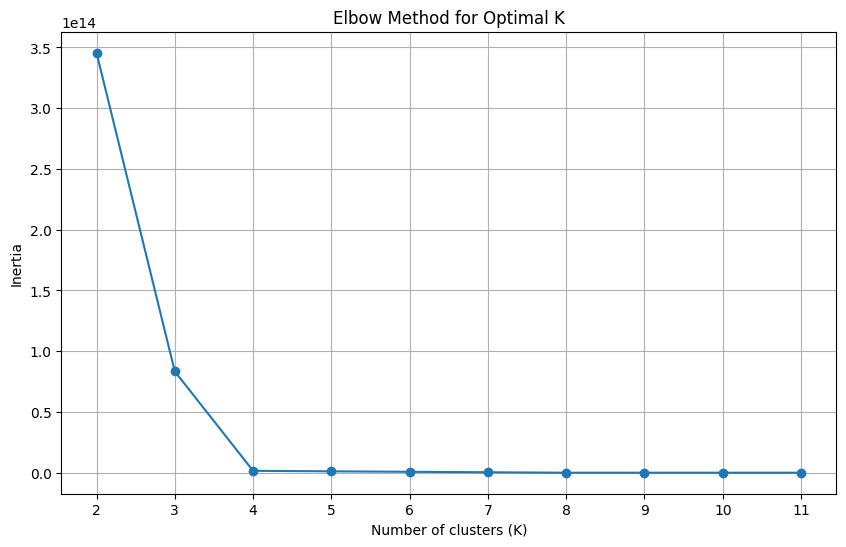

./elbow_test_export/SS-J_csv_100_11514_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3       1000        1        300  10000000.0       10000.0   
1         3         10        3        300  10000000.0        1000.0   
2         1        100       12          1   1000000.0        1000.0   
3         3       1000       12          1  10000000.0        1000.0   
4         3         10       18         60  10000000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
795       3        100        2          1    100000.0       10000.0   
796       3        100        1        120   1000000.0       10000.0   
797       1      10000       18        300    100000.0       10000.0   
798       3      10000       15         60   2000000.0       10000.0   
799       3       1000       18        300   1000000.0        1000.0   

     Throughput+   Latency-  cluster  
0         740.94  25769

<Figure size 640x480 with 0 Axes>

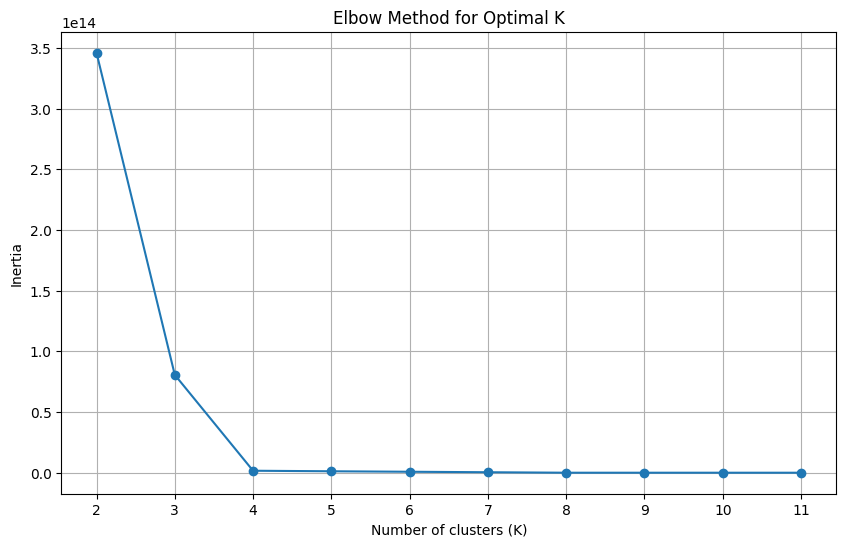

./elbow_test_export/SS-J_csv_100_19953_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000       18        120   1000000.0       10000.0   
1         1        100       18         10    100000.0        1000.0   
2         1      10000        6          1   1000000.0      100000.0   
3         1      10000        2         60   2000000.0        1000.0   
4         1         10        9          1   2000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
795       3      10000        2         60  10000000.0       10000.0   
796       3       1000        3         10  10000000.0        1000.0   
797       1       1000        1         10  10000000.0      100000.0   
798       3         10       18         10  10000000.0        1000.0   
799       1         10        3          1  10000000.0      100000.0   

     Throughput+    Latency-  cluster  
0        58317.0    12

<Figure size 640x480 with 0 Axes>

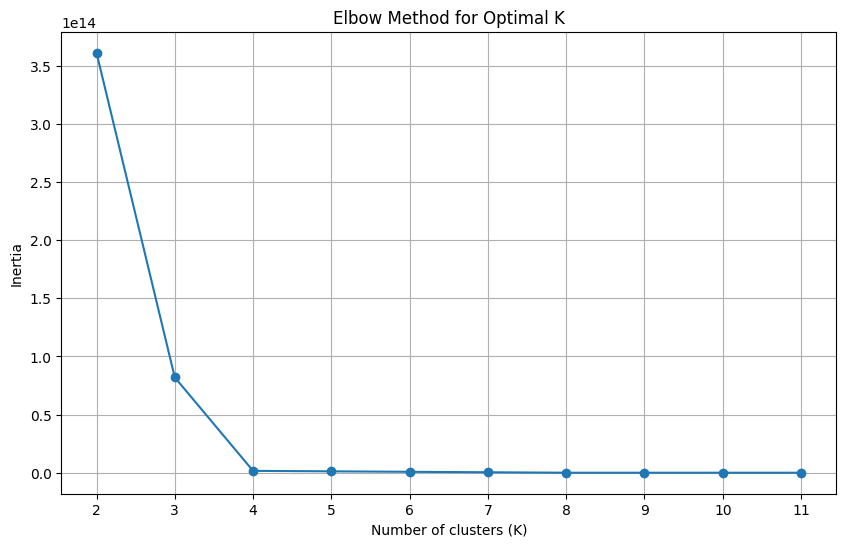

./elbow_test_export/SS-J_csv_100_3545_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1         10        9        120   2000000.0       10000.0   
1         1       1000       15          1   2000000.0       10000.0   
2         3       1000        6         60   2000000.0        1000.0   
3         3        100       15         60    100000.0      100000.0   
4         1      10000        9        300   1000000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
795       1       1000       12        120    100000.0        1000.0   
796       3       1000        2        120  10000000.0       10000.0   
797       1       1000       12        120   2000000.0        1000.0   
798       3      10000        9        300   2000000.0        1000.0   
799       3         10        9        120   2000000.0      100000.0   

     Throughput+   Latency-  cluster  
0        37059.0     2.0

<Figure size 640x480 with 0 Axes>

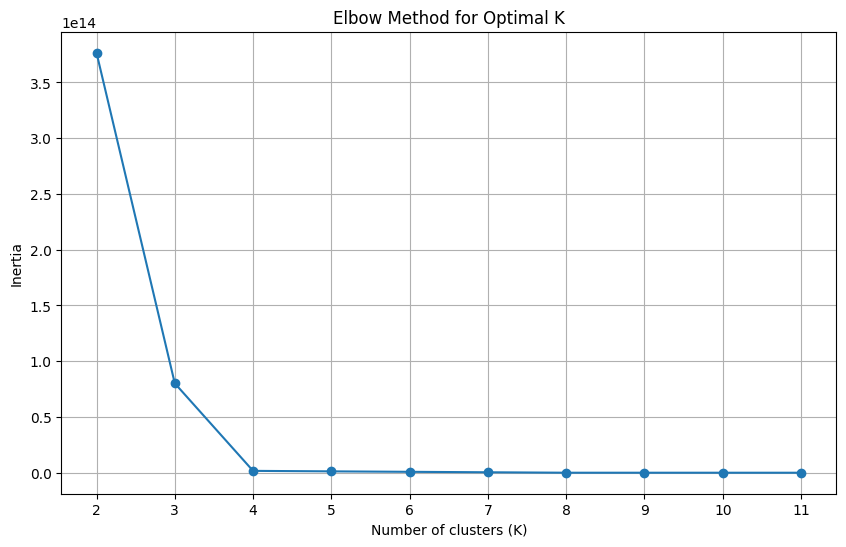

./elbow_test_export/SS-J_csv_100_39658_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1         10       18        300  10000000.0      100000.0   
1         1        100       12        120   2000000.0       10000.0   
2         1      10000       12         10   1000000.0       10000.0   
3         1        100       15        300   2000000.0        1000.0   
4         3        100        1         60   2000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
795       3         10       12         10   1000000.0        1000.0   
796       3        100        3        300  10000000.0      100000.0   
797       3      10000       18        300   1000000.0      100000.0   
798       1         10        2          1  10000000.0       10000.0   
799       3        100        9        120    100000.0       10000.0   

     Throughput+    Latency-  cluster  
0      35131.000      

<Figure size 640x480 with 0 Axes>

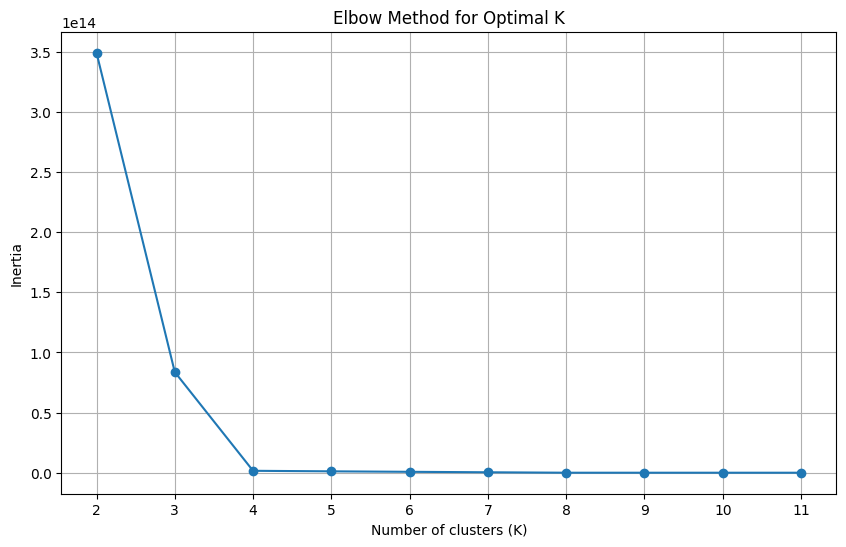

./elbow_test_export/SS-J_csv_100_40749_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1      10000       15        120   1000000.0       10000.0   
1         1      10000        2        300   2000000.0       10000.0   
2         3       1000        1         10   1000000.0      100000.0   
3         1       1000        1         10  10000000.0       10000.0   
4         3         10       18        120   2000000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
795       1        100       12         60    100000.0        1000.0   
796       3         10        3          1    100000.0        1000.0   
797       3      10000        9          1   2000000.0        1000.0   
798       1        100        3        120   2000000.0       10000.0   
799       3      10000        3         10    100000.0        1000.0   

     Throughput+   Latency-  cluster  
0      157000.00    376

<Figure size 640x480 with 0 Axes>

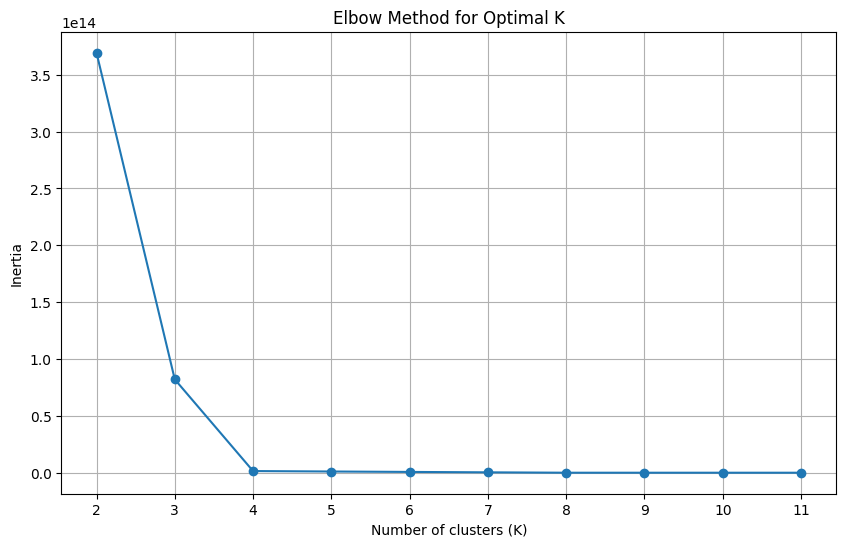

./elbow_test_export/SS-J_csv_100_44845_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000        9         10  10000000.0       10000.0   
1         3       1000       18        120    100000.0        1000.0   
2         1       1000        6          1   1000000.0       10000.0   
3         1        100        9        300   2000000.0      100000.0   
4         3         10        9        300  10000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
795       3        100        2         60    100000.0      100000.0   
796       1       1000        1         60    100000.0       10000.0   
797       3       1000        6         10  10000000.0       10000.0   
798       1         10        6         60    100000.0       10000.0   
799       1         10       15        300   1000000.0      100000.0   

     Throughput+    Latency-  cluster  
0       74505.00    11

<Figure size 640x480 with 0 Axes>

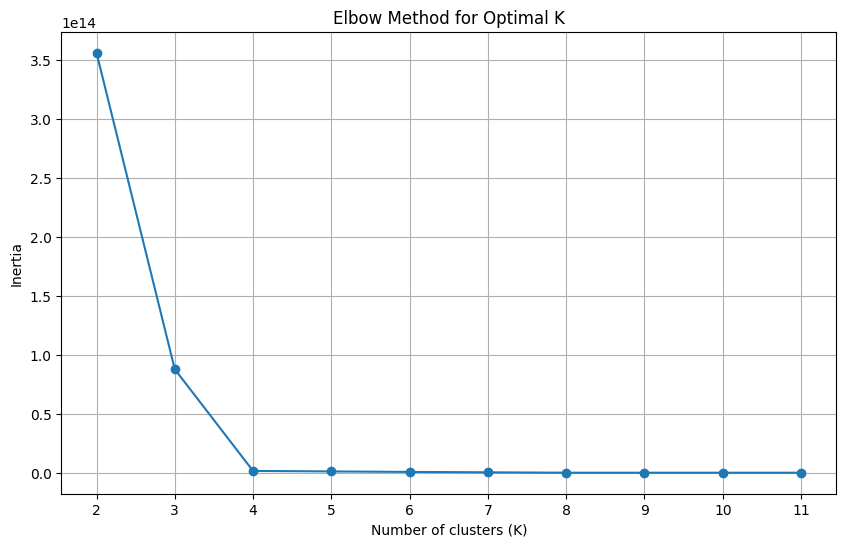

./elbow_test_export/SS-J_csv_100_51176_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000       18        300   1000000.0       10000.0   
1         3         10        1         60   2000000.0      100000.0   
2         1         10       15         60    100000.0        1000.0   
3         3         10        2         10   2000000.0       10000.0   
4         3        100       15          1  10000000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
795       3         10        9          1   2000000.0      100000.0   
796       3        100        3        300  10000000.0       10000.0   
797       1         10        3         60    100000.0        1000.0   
798       3      10000       18        120   2000000.0       10000.0   
799       3        100        6          1  10000000.0       10000.0   

     Throughput+  Latency-  cluster  
0       58661.00   120.3

<Figure size 640x480 with 0 Axes>

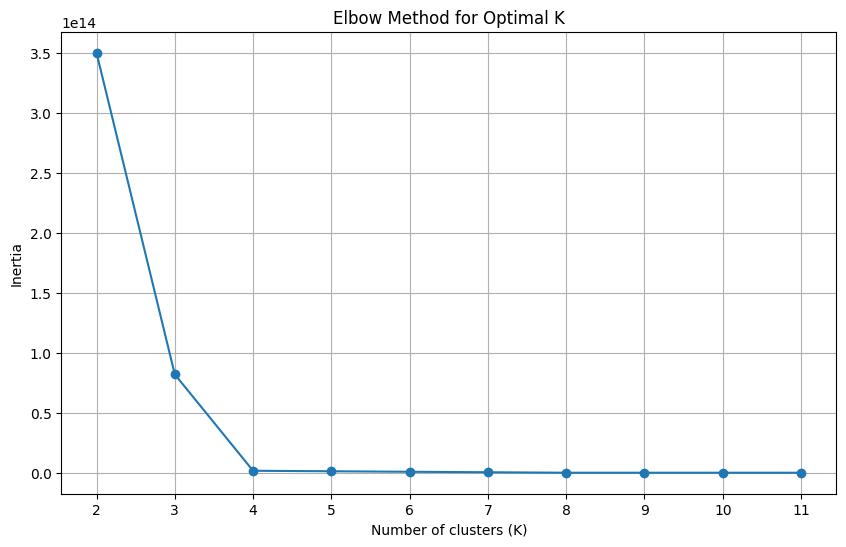

./elbow_test_export/SS-J_csv_100_58612_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1        100        9        120    100000.0      100000.0   
1         3        100        2         60    100000.0        1000.0   
2         1         10        3        120  10000000.0        1000.0   
3         1        100        9        300   1000000.0        1000.0   
4         1         10        6        300    100000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
795       1      10000       18        300    100000.0        1000.0   
796       3         10       15          1  10000000.0       10000.0   
797       3         10       18         10    100000.0       10000.0   
798       3      10000        3        120  10000000.0      100000.0   
799       3       1000        3         10   2000000.0        1000.0   

     Throughput+   Latency-  cluster  
0        38018.0    17.

<Figure size 640x480 with 0 Axes>

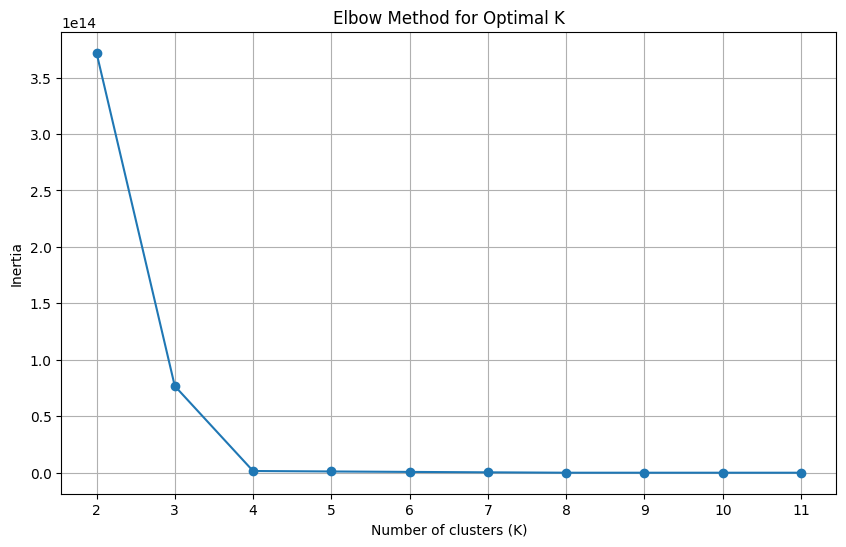

./elbow_test_export/SS-J_csv_100_61367_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3      10000       12         10   2000000.0       10000.0   
1         1       1000       18        300   1000000.0      100000.0   
2         1      10000       12         10   2000000.0      100000.0   
3         1       1000        9        120  10000000.0      100000.0   
4         1        100        2        120   1000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
795       1        100        3          1   1000000.0       10000.0   
796       3        100       18          1    100000.0      100000.0   
797       1        100       18        120   2000000.0       10000.0   
798       3       1000        1         60   1000000.0       10000.0   
799       1        100       12         10  10000000.0      100000.0   

     Throughput+   Latency-  cluster  
0      204000.00   1100

<Figure size 640x480 with 0 Axes>

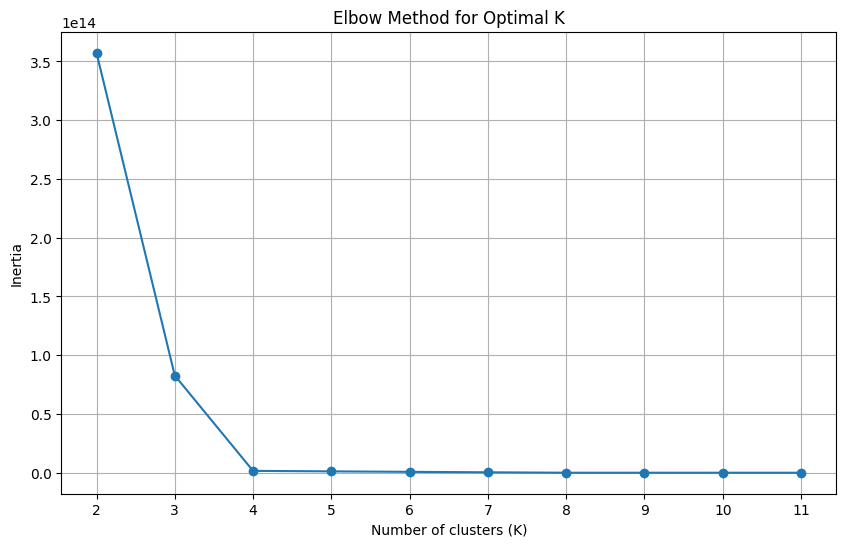

./elbow_test_export/SS-J_csv_100_65388_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1         10       15        120   1000000.0      100000.0   
1         3        100        1        300   2000000.0        1000.0   
2         1       1000        2         10   1000000.0      100000.0   
3         3        100       15        120    100000.0      100000.0   
4         3        100        3          1  10000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
795       1         10        6        300   1000000.0      100000.0   
796       1       1000        2          1    100000.0        1000.0   
797       1        100        9        120    100000.0       10000.0   
798       3         10        6         60   2000000.0        1000.0   
799       1      10000       18        120   1000000.0      100000.0   

     Throughput+    Latency-  cluster  
0       36304.00      

<Figure size 640x480 with 0 Axes>

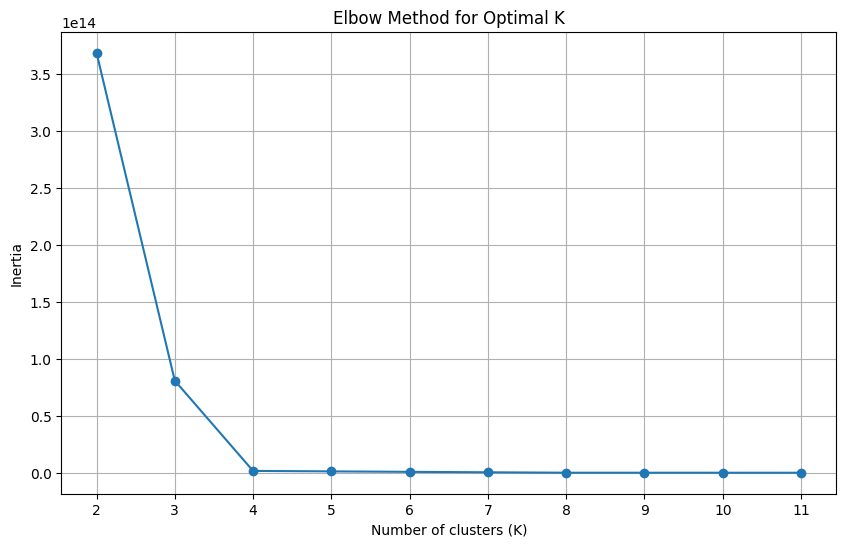

./elbow_test_export/SS-J_csv_100_65444_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1      10000        6         10    100000.0      100000.0   
1         3        100       18         60    100000.0       10000.0   
2         3        100        9        120  10000000.0       10000.0   
3         3        100       18         60   2000000.0       10000.0   
4         3         10        1         60    100000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
795       3        100        3        120    100000.0        1000.0   
796       1         10        3        300  10000000.0       10000.0   
797       1        100        1         60   1000000.0      100000.0   
798       3       1000       18         10  10000000.0        1000.0   
799       3      10000        6         10  10000000.0       10000.0   

     Throughput+   Latency-  cluster  
0      142000.00   416.

<Figure size 640x480 with 0 Axes>

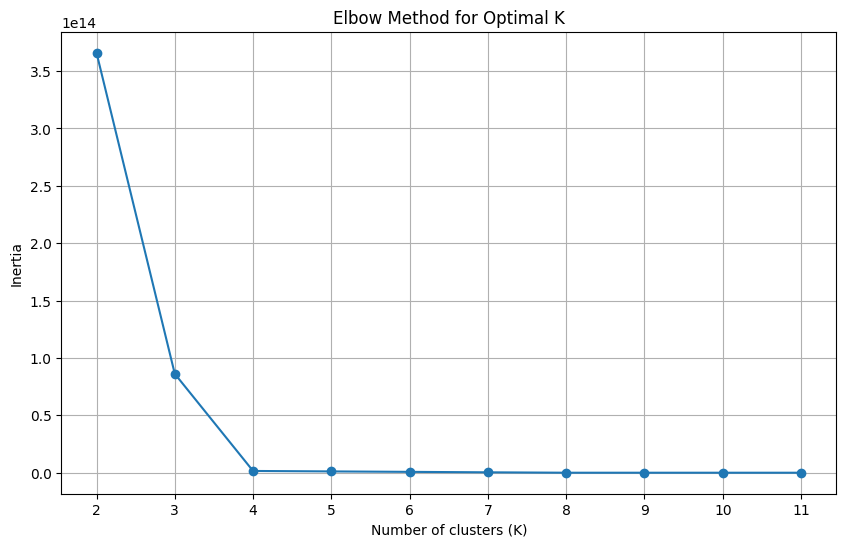

./elbow_test_export/SS-J_csv_100_66946_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3       1000        3        300    100000.0      100000.0   
1         3        100       18         10  10000000.0        1000.0   
2         1         10       12        120   1000000.0      100000.0   
3         1         10        3        300    100000.0      100000.0   
4         3       1000       18         60   1000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
795       3       1000       12         60   2000000.0       10000.0   
796       3        100        3         60   2000000.0      100000.0   
797       3      10000        6         10    100000.0      100000.0   
798       3       1000        3          1   2000000.0        1000.0   
799       1         10        6         10   1000000.0        1000.0   

     Throughput+  Latency-  cluster  
0       130000.0  183.61

<Figure size 640x480 with 0 Axes>

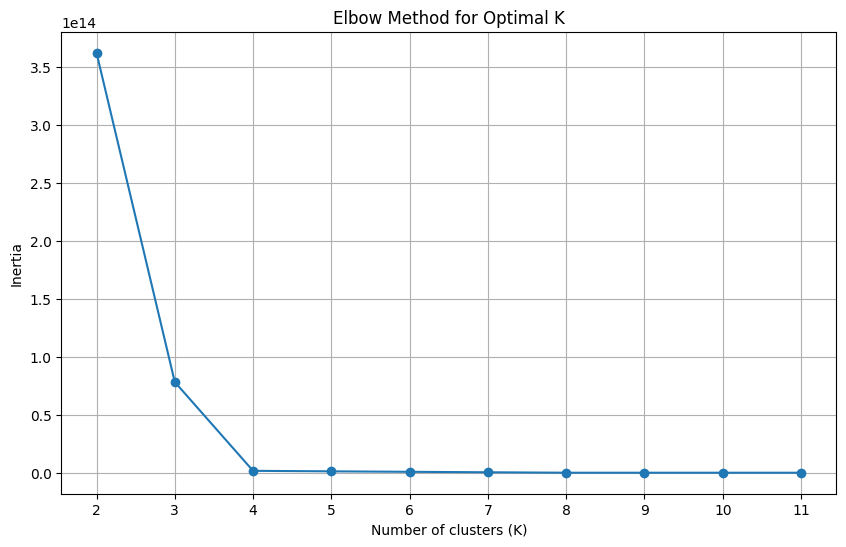

./elbow_test_export/SS-J_csv_100_69024_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000       15        300  10000000.0      100000.0   
1         1       1000       12         10   2000000.0        1000.0   
2         1        100        6          1   1000000.0      100000.0   
3         3      10000        1        300   1000000.0      100000.0   
4         1         10       18         10   2000000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
795       3      10000       12          1   2000000.0       10000.0   
796       1      10000        1         60   2000000.0      100000.0   
797       3         10       12        300    100000.0      100000.0   
798       1        100        6         10    100000.0      100000.0   
799       3         10        9          1   1000000.0       10000.0   

     Throughput+    Latency-  cluster  
0        55326.0    18

<Figure size 640x480 with 0 Axes>

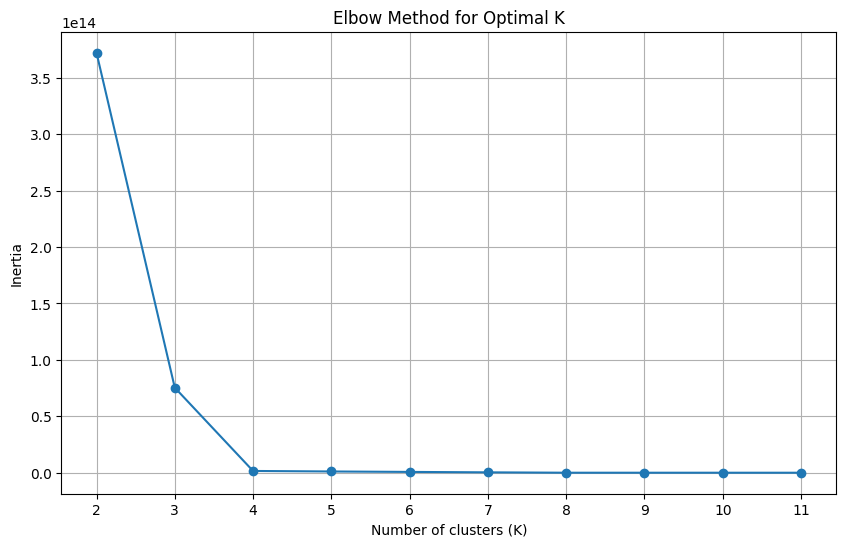

./elbow_test_export/SS-J_csv_100_70006_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1      10000        2        300   1000000.0        1000.0   
1         3       1000        2         10    100000.0       10000.0   
2         3      10000       18         60   1000000.0       10000.0   
3         1        100        2          1   1000000.0      100000.0   
4         1        100       18        300   2000000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
795       3        100        6         60    100000.0       10000.0   
796       1        100       15        120   1000000.0       10000.0   
797       3       1000        1         10   1000000.0       10000.0   
798       3      10000        3        120   2000000.0       10000.0   
799       1        100       12          1  10000000.0        1000.0   

     Throughput+   Latency-  cluster  
0        5268.90  14182

<Figure size 640x480 with 0 Axes>

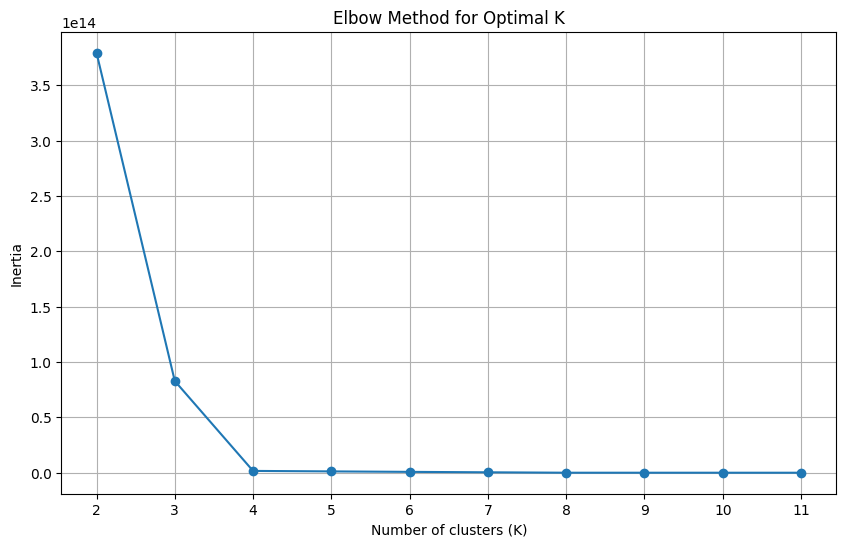

./elbow_test_export/SS-J_csv_100_70292_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3        100       15        300   2000000.0       10000.0   
1         1         10        2         60   1000000.0       10000.0   
2         1       1000        2          1   2000000.0      100000.0   
3         1         10        9        300  10000000.0        1000.0   
4         1         10        2         10   2000000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
795       1        100       18         60    100000.0       10000.0   
796       3        100       15         10  10000000.0        1000.0   
797       3        100        9         60   2000000.0        1000.0   
798       1      10000       12        300   1000000.0       10000.0   
799       1       1000        6        300   2000000.0       10000.0   

     Throughput+   Latency-  cluster  
0       39400.00    67.

<Figure size 640x480 with 0 Axes>

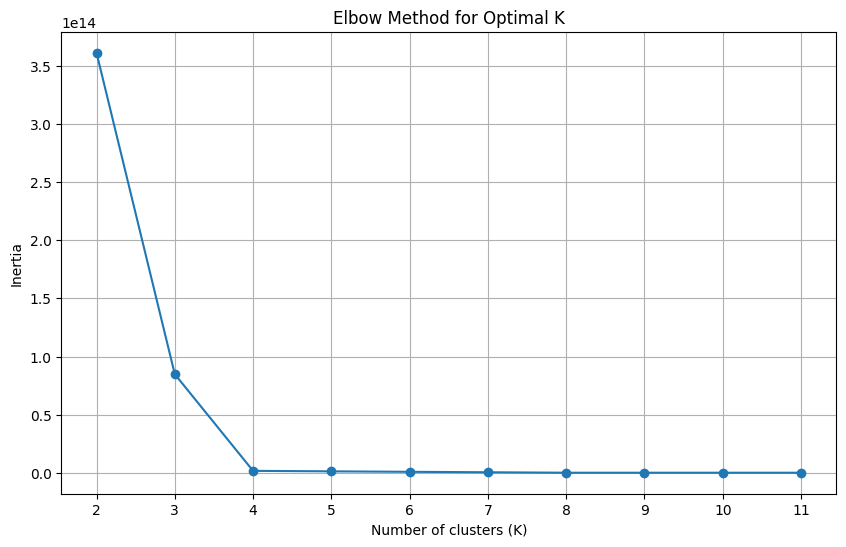

./elbow_test_export/SS-J_csv_100_77340_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3         10        1          1    100000.0      100000.0   
1         3         10        3         60  10000000.0        1000.0   
2         3        100        9         60  10000000.0      100000.0   
3         3         10        2          1   1000000.0      100000.0   
4         3        100        6         10    100000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
795       3      10000        1         10    100000.0        1000.0   
796       3      10000        6        300   1000000.0        1000.0   
797       1        100       15          1    100000.0      100000.0   
798       3         10        6        300   1000000.0        1000.0   
799       3      10000        3          1  10000000.0       10000.0   

     Throughput+   Latency-  cluster  
0         103.19   2803

<Figure size 640x480 with 0 Axes>

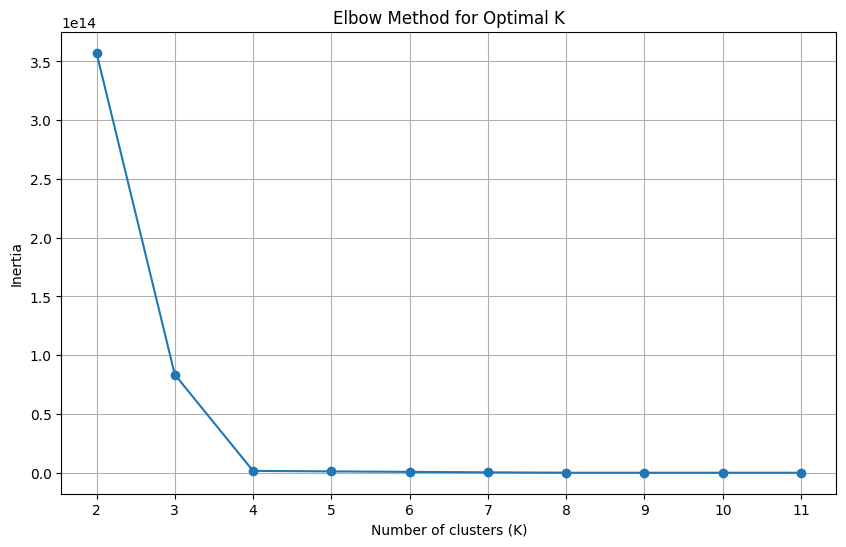

./elbow_test_export/SS-J_csv_100_77845_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000        1        300   1000000.0       10000.0   
1         3      10000       18         10  10000000.0        1000.0   
2         3        100        9        300   2000000.0       10000.0   
3         3         10        6          1    100000.0       10000.0   
4         3         10        1         10    100000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
795       1      10000        6          1   1000000.0      100000.0   
796       3         10        1         60    100000.0      100000.0   
797       1       1000        6         10    100000.0        1000.0   
798       1        100       15        120   1000000.0      100000.0   
799       1        100       12         60   1000000.0        1000.0   

     Throughput+   Latency-  cluster  
0        422.240  20688

<Figure size 640x480 with 0 Axes>

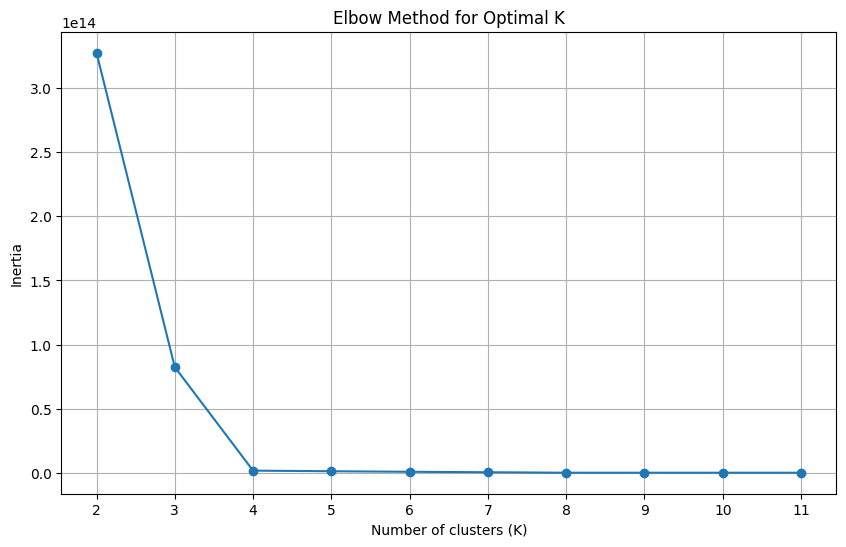

./elbow_test_export/SS-J_csv_100_83686_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3       1000       12          1  10000000.0      100000.0   
1         1         10        1         60    100000.0      100000.0   
2         1      10000        9          1   1000000.0      100000.0   
3         3       1000       15        120    100000.0      100000.0   
4         3       1000        9        120    100000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
795       1      10000        2         10    100000.0        1000.0   
796       1       1000       18         60  10000000.0      100000.0   
797       1      10000       12        300  10000000.0       10000.0   
798       1        100        1        120  10000000.0      100000.0   
799       3        100       15        300    100000.0       10000.0   

     Throughput+   Latency-  cluster  
0      111000.00    243

<Figure size 640x480 with 0 Axes>

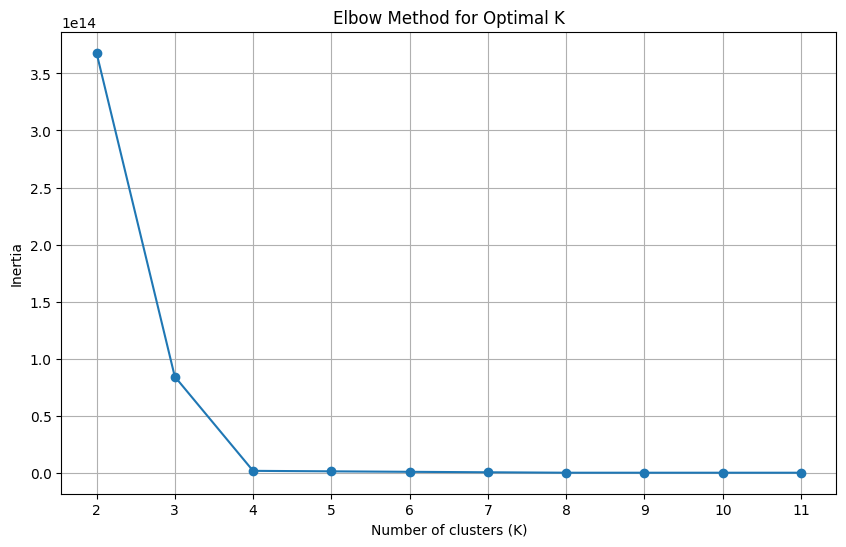

./elbow_test_export/SS-J_csv_100_84967_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000       12          1  10000000.0       10000.0   
1         1        100       15        120    100000.0      100000.0   
2         1         10        3        300   2000000.0      100000.0   
3         1       1000       18        300    100000.0       10000.0   
4         3      10000        2        300   1000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
795       3       1000        9          1    100000.0        1000.0   
796       3      10000        1          1    100000.0       10000.0   
797       1        100        2        300   2000000.0      100000.0   
798       1      10000        3        300   2000000.0      100000.0   
799       3      10000       12        120  10000000.0        1000.0   

     Throughput+    Latency-  cluster  
0        53296.0    17

<Figure size 640x480 with 0 Axes>

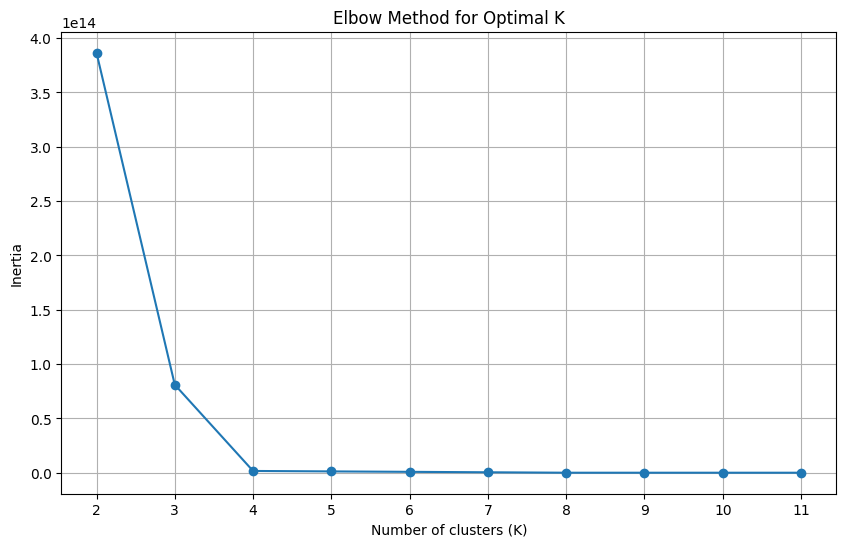

./elbow_test_export/SS-J_csv_100_86331_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3        100        1         10   1000000.0      100000.0   
1         1        100        3        120   1000000.0      100000.0   
2         3        100        1        300    100000.0      100000.0   
3         3      10000       12          1    100000.0      100000.0   
4         3      10000        1          1  10000000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
795       1        100       15        120    100000.0      100000.0   
796       1       1000       12         60   2000000.0        1000.0   
797       1         10        9        300  10000000.0       10000.0   
798       3         10        6        300    100000.0      100000.0   
799       1        100       15         60  10000000.0      100000.0   

     Throughput+    Latency-  cluster  
0         72.188  2663

<Figure size 640x480 with 0 Axes>

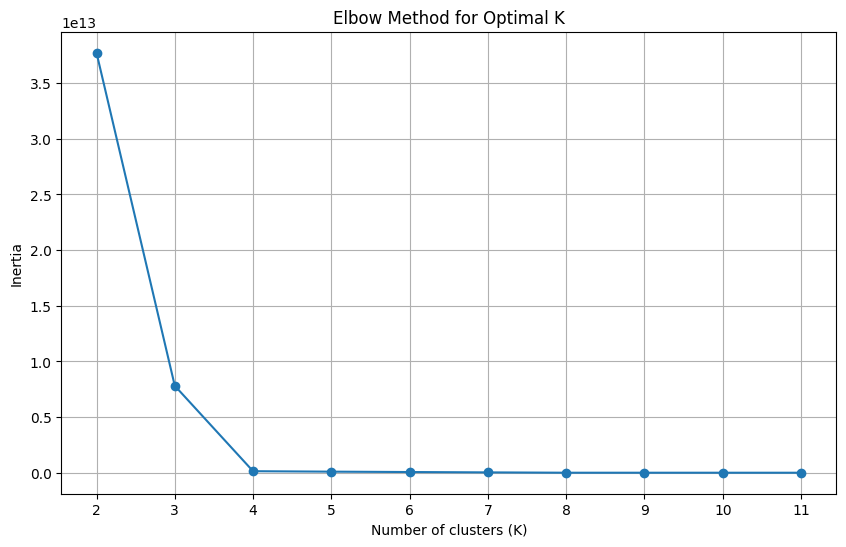

./elbow_test_export/SS-J_csv_10_11514_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        3       1000        1        300  10000000.0       10000.0   
1        3         10        3        300  10000000.0        1000.0   
2        1        100       12          1   1000000.0        1000.0   
3        3       1000       12          1  10000000.0        1000.0   
4        3         10       18         60  10000000.0       10000.0   
..     ...        ...      ...        ...         ...           ...   
75       3       1000        2         60   2000000.0        1000.0   
76       1      10000        9        300   2000000.0        1000.0   
77       3       1000        6          1   2000000.0        1000.0   
78       3        100        2         10   1000000.0        1000.0   
79       1      10000        9        300  10000000.0        1000.0   

    Throughput+   Latency-  cluster  
0        740.94  25769.000        1  

<Figure size 640x480 with 0 Axes>

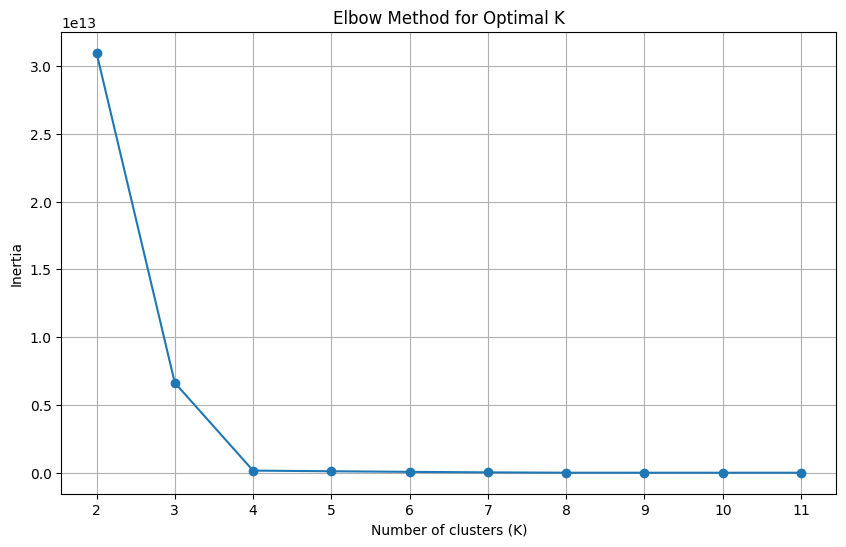

./elbow_test_export/SS-J_csv_10_19953_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1       1000       18        120   1000000.0       10000.0   
1        1        100       18         10    100000.0        1000.0   
2        1      10000        6          1   1000000.0      100000.0   
3        1      10000        2         60   2000000.0        1000.0   
4        1         10        9          1   2000000.0      100000.0   
..     ...        ...      ...        ...         ...           ...   
75       1        100        2         10   1000000.0      100000.0   
76       3        100       15         10  10000000.0        1000.0   
77       1         10        9        120    100000.0       10000.0   
78       1        100       15         60  10000000.0      100000.0   
79       1         10        1        120   2000000.0        1000.0   

    Throughput+    Latency-  cluster  
0      58317.00    127.2000        0

<Figure size 640x480 with 0 Axes>

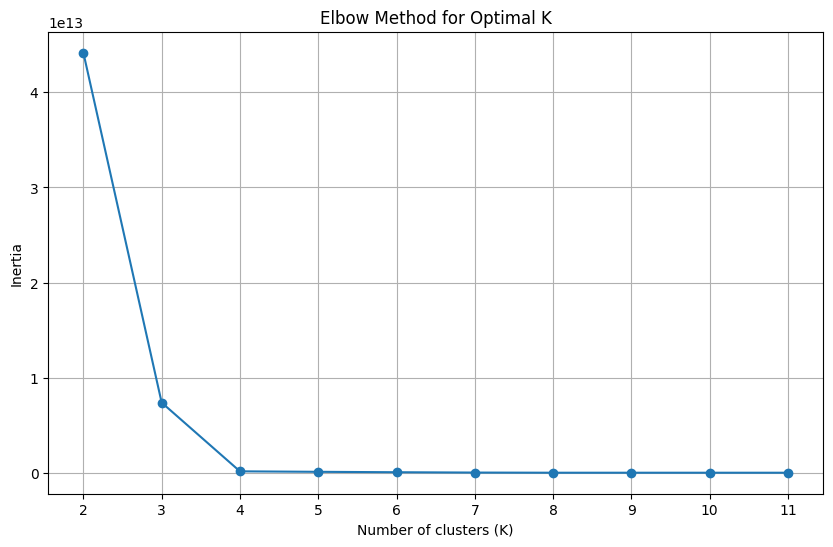

./elbow_test_export/SS-J_csv_10_3545_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1         10        9        120   2000000.0       10000.0   
1        1       1000       15          1   2000000.0       10000.0   
2        3       1000        6         60   2000000.0        1000.0   
3        3        100       15         60    100000.0      100000.0   
4        1      10000        9        300   1000000.0        1000.0   
..     ...        ...      ...        ...         ...           ...   
75       1        100        1        120  10000000.0      100000.0   
76       3      10000       18        120  10000000.0       10000.0   
77       3        100        2        120   1000000.0      100000.0   
78       1       1000        2        300  10000000.0      100000.0   
79       1       1000        9        120    100000.0      100000.0   

    Throughput+   Latency-  cluster  
0      37059.00     2.0351        2  


<Figure size 640x480 with 0 Axes>

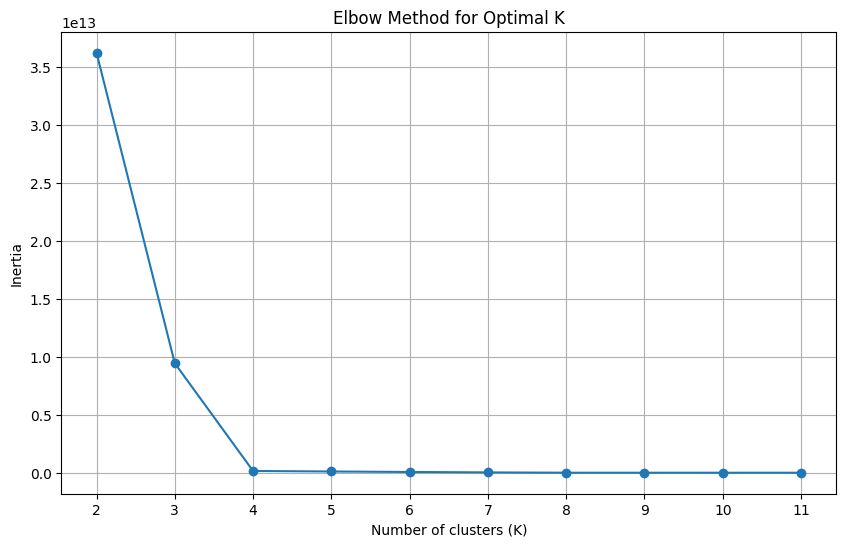

./elbow_test_export/SS-J_csv_10_39658_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1         10       18        300  10000000.0      100000.0   
1        1        100       12        120   2000000.0       10000.0   
2        1      10000       12         10   1000000.0       10000.0   
3        1        100       15        300   2000000.0        1000.0   
4        3        100        1         60   2000000.0      100000.0   
..     ...        ...      ...        ...         ...           ...   
75       3         10       12         60    100000.0        1000.0   
76       3         10        2         60    100000.0        1000.0   
77       1         10        3        300   2000000.0      100000.0   
78       1      10000       12        120   1000000.0      100000.0   
79       1       1000       18        300    100000.0      100000.0   

    Throughput+    Latency-  cluster  
0     35131.000      2.2728        0

<Figure size 640x480 with 0 Axes>

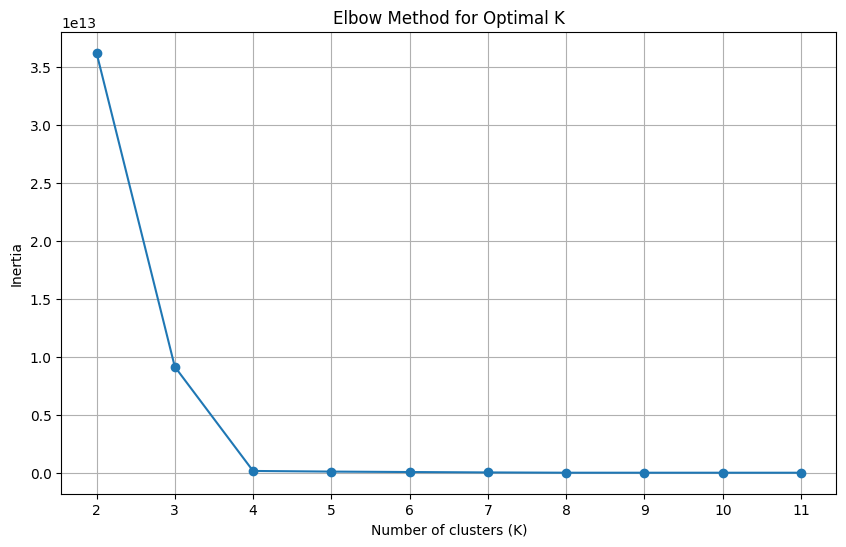

./elbow_test_export/SS-J_csv_10_40749_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1      10000       15        120   1000000.0       10000.0   
1        1      10000        2        300   2000000.0       10000.0   
2        3       1000        1         10   1000000.0      100000.0   
3        1       1000        1         10  10000000.0       10000.0   
4        3         10       18        120   2000000.0        1000.0   
..     ...        ...      ...        ...         ...           ...   
75       1      10000        9         60   1000000.0       10000.0   
76       1        100        6         60   2000000.0        1000.0   
77       1         10        2         60  10000000.0        1000.0   
78       3      10000        6         10   2000000.0        1000.0   
79       3         10        3         60   2000000.0       10000.0   

    Throughput+    Latency-  cluster  
0     157000.00    376.3700        2

<Figure size 640x480 with 0 Axes>

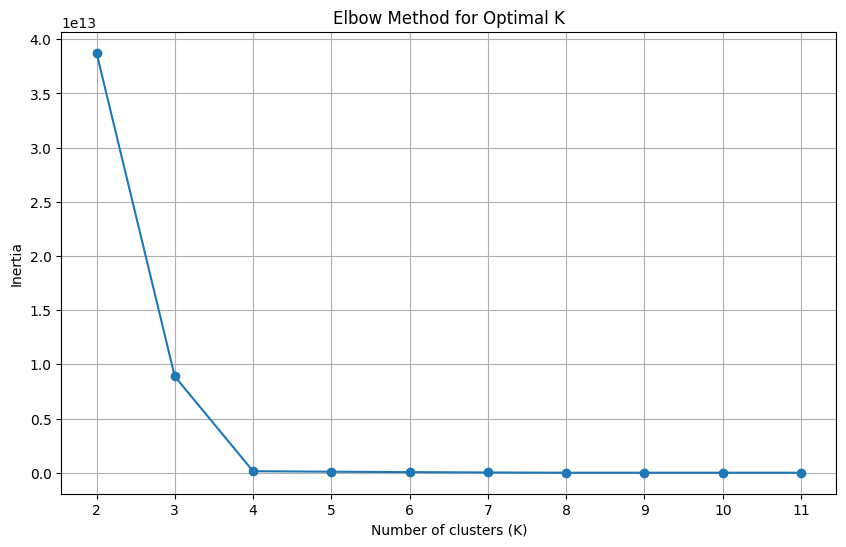

./elbow_test_export/SS-J_csv_10_44845_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1       1000        9         10  10000000.0       10000.0   
1        3       1000       18        120    100000.0        1000.0   
2        1       1000        6          1   1000000.0       10000.0   
3        1        100        9        300   2000000.0      100000.0   
4        3         10        9        300  10000000.0      100000.0   
..     ...        ...      ...        ...         ...           ...   
75       1        100        2          1   2000000.0      100000.0   
76       1      10000       18         60    100000.0        1000.0   
77       3      10000       15         10  10000000.0       10000.0   
78       1         10        9          1    100000.0        1000.0   
79       3        100       12         10   2000000.0      100000.0   

    Throughput+   Latency-  cluster  
0      74505.00   116.0600        1  

<Figure size 640x480 with 0 Axes>

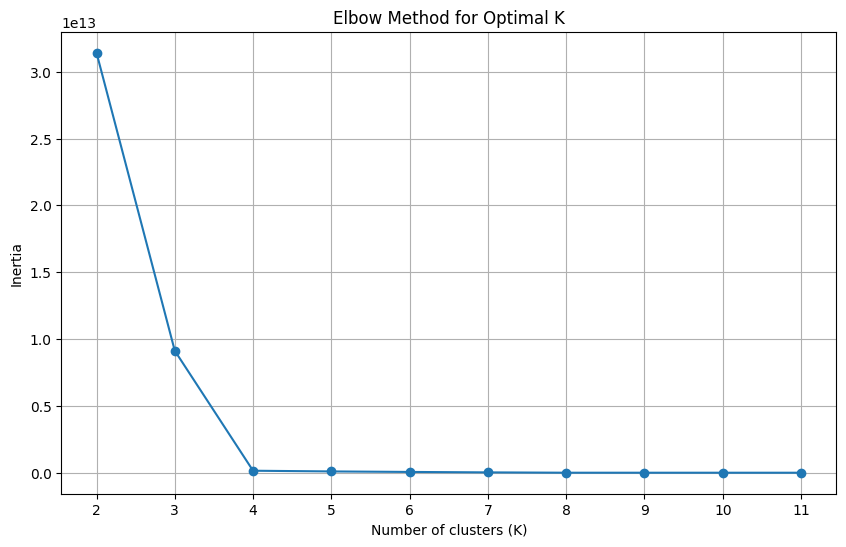

./elbow_test_export/SS-J_csv_10_51176_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1       1000       18        300   1000000.0       10000.0   
1        3         10        1         60   2000000.0      100000.0   
2        1         10       15         60    100000.0        1000.0   
3        3         10        2         10   2000000.0       10000.0   
4        3        100       15          1  10000000.0       10000.0   
..     ...        ...      ...        ...         ...           ...   
75       3        100       12        120   2000000.0       10000.0   
76       1      10000        3          1   2000000.0       10000.0   
77       1        100       15         10   2000000.0      100000.0   
78       1         10        6        300  10000000.0      100000.0   
79       3        100       12         60    100000.0       10000.0   

    Throughput+   Latency-  cluster  
0      58661.00   120.3500        3  

<Figure size 640x480 with 0 Axes>

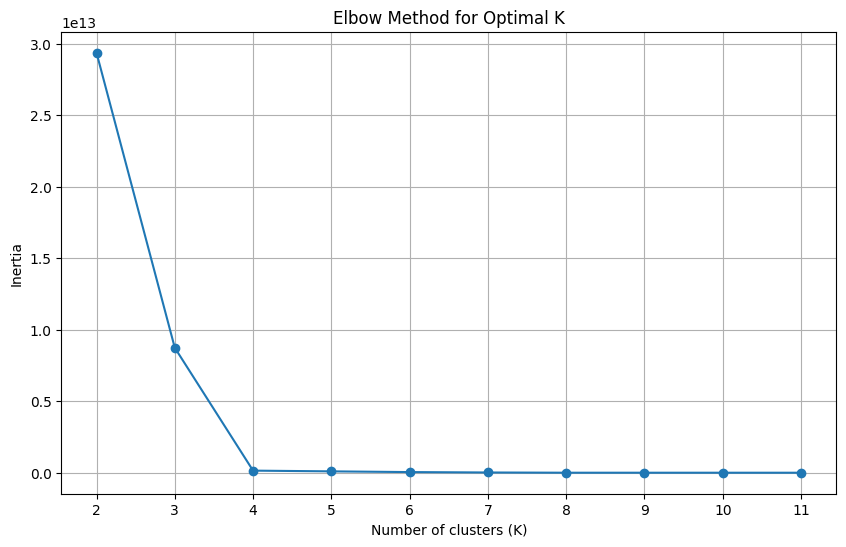

./elbow_test_export/SS-J_csv_10_58612_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1        100        9        120    100000.0      100000.0   
1        3        100        2         60    100000.0        1000.0   
2        1         10        3        120  10000000.0        1000.0   
3        1        100        9        300   1000000.0        1000.0   
4        1         10        6        300    100000.0       10000.0   
..     ...        ...      ...        ...         ...           ...   
75       3      10000       12        120    100000.0       10000.0   
76       1       1000        3        120    100000.0        1000.0   
77       1        100        2        300   1000000.0       10000.0   
78       3        100       15          1   1000000.0       10000.0   
79       1       1000        6        120    100000.0       10000.0   

    Throughput+   Latency-  cluster  
0       38018.0    17.9920        2  

<Figure size 640x480 with 0 Axes>

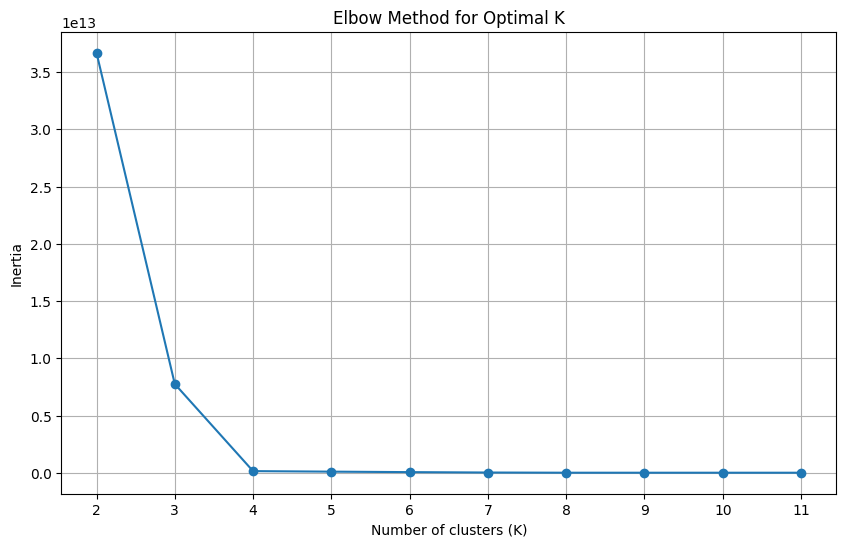

./elbow_test_export/SS-J_csv_10_61367_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        3      10000       12         10   2000000.0       10000.0   
1        1       1000       18        300   1000000.0      100000.0   
2        1      10000       12         10   2000000.0      100000.0   
3        1       1000        9        120  10000000.0      100000.0   
4        1        100        2        120   1000000.0      100000.0   
..     ...        ...      ...        ...         ...           ...   
75       3      10000        9        300   1000000.0      100000.0   
76       1      10000       15          1   1000000.0        1000.0   
77       3         10       15        120  10000000.0       10000.0   
78       1       1000       12         60    100000.0        1000.0   
79       3        100        6         60   2000000.0       10000.0   

    Throughput+  Latency-  cluster  
0      204000.0  1100.600        0  
1

<Figure size 640x480 with 0 Axes>

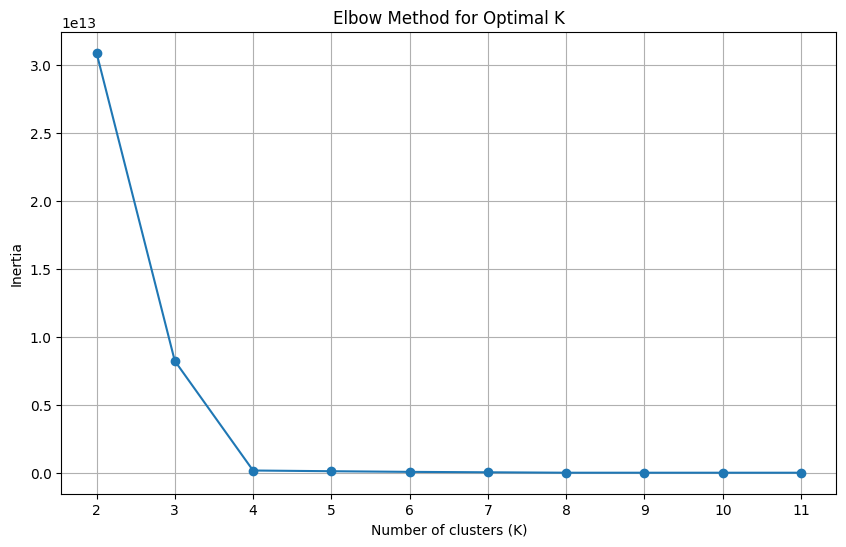

./elbow_test_export/SS-J_csv_10_65388_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1         10       15        120   1000000.0      100000.0   
1        3        100        1        300   2000000.0        1000.0   
2        1       1000        2         10   1000000.0      100000.0   
3        3        100       15        120    100000.0      100000.0   
4        3        100        3          1  10000000.0      100000.0   
..     ...        ...      ...        ...         ...           ...   
75       3         10        1        120  10000000.0      100000.0   
76       3       1000        3        300    100000.0      100000.0   
77       3        100        9         60   1000000.0      100000.0   
78       1       1000        1         60   2000000.0      100000.0   
79       3         10        1        300   2000000.0        1000.0   

    Throughput+    Latency-  cluster  
0     36304.000      2.1482        0

<Figure size 640x480 with 0 Axes>

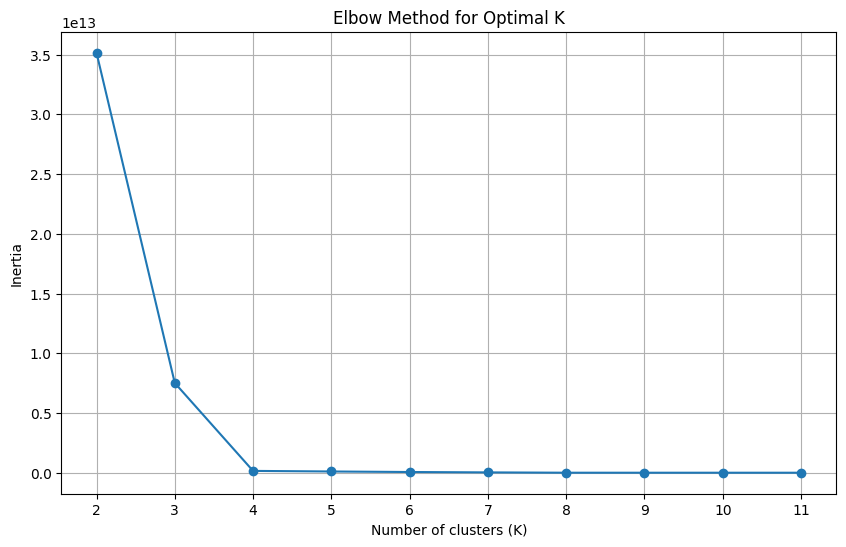

./elbow_test_export/SS-J_csv_10_65444_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1      10000        6         10    100000.0      100000.0   
1        3        100       18         60    100000.0       10000.0   
2        3        100        9        120  10000000.0       10000.0   
3        3        100       18         60   2000000.0       10000.0   
4        3         10        1         60    100000.0       10000.0   
..     ...        ...      ...        ...         ...           ...   
75       1        100        2        300  10000000.0       10000.0   
76       3         10        3         60    100000.0        1000.0   
77       3      10000       18         10    100000.0      100000.0   
78       1         10        1         10  10000000.0       10000.0   
79       1       1000        2        120   1000000.0      100000.0   

    Throughput+  Latency-  cluster  
0     142000.00   416.540        2  
1

<Figure size 640x480 with 0 Axes>

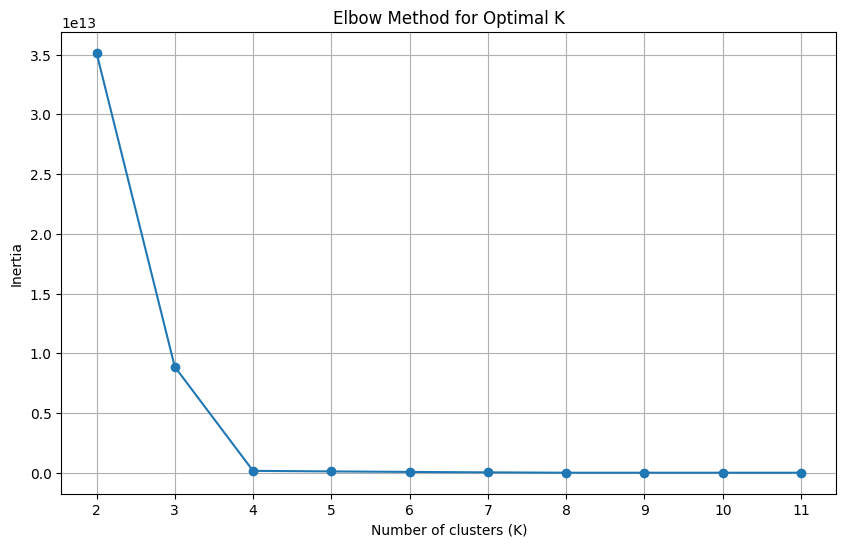

./elbow_test_export/SS-J_csv_10_66946_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        3       1000        3        300    100000.0      100000.0   
1        3        100       18         10  10000000.0        1000.0   
2        1         10       12        120   1000000.0      100000.0   
3        1         10        3        300    100000.0      100000.0   
4        3       1000       18         60   1000000.0      100000.0   
..     ...        ...      ...        ...         ...           ...   
75       3      10000        3         10  10000000.0        1000.0   
76       1      10000       18        300   1000000.0      100000.0   
77       1         10       12        120   2000000.0        1000.0   
78       1       1000        3        120    100000.0        1000.0   
79       1         10       15        120    100000.0       10000.0   

    Throughput+   Latency-  cluster  
0      130000.0   183.6100        0  

<Figure size 640x480 with 0 Axes>

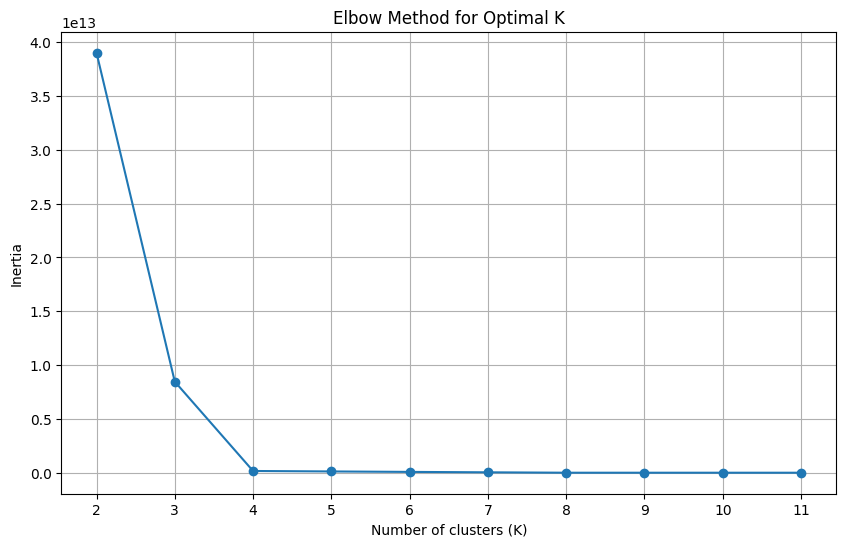

./elbow_test_export/SS-J_csv_10_69024_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1       1000       15        300  10000000.0      100000.0   
1        1       1000       12         10   2000000.0        1000.0   
2        1        100        6          1   1000000.0      100000.0   
3        3      10000        1        300   1000000.0      100000.0   
4        1         10       18         10   2000000.0       10000.0   
..     ...        ...      ...        ...         ...           ...   
75       1         10       15        120   1000000.0      100000.0   
76       3         10       18        300   2000000.0       10000.0   
77       3        100        9         10   1000000.0      100000.0   
78       3      10000        6         60  10000000.0        1000.0   
79       3       1000       12         60   2000000.0      100000.0   

    Throughput+    Latency-  cluster  
0       55326.0    183.9300        1

<Figure size 640x480 with 0 Axes>

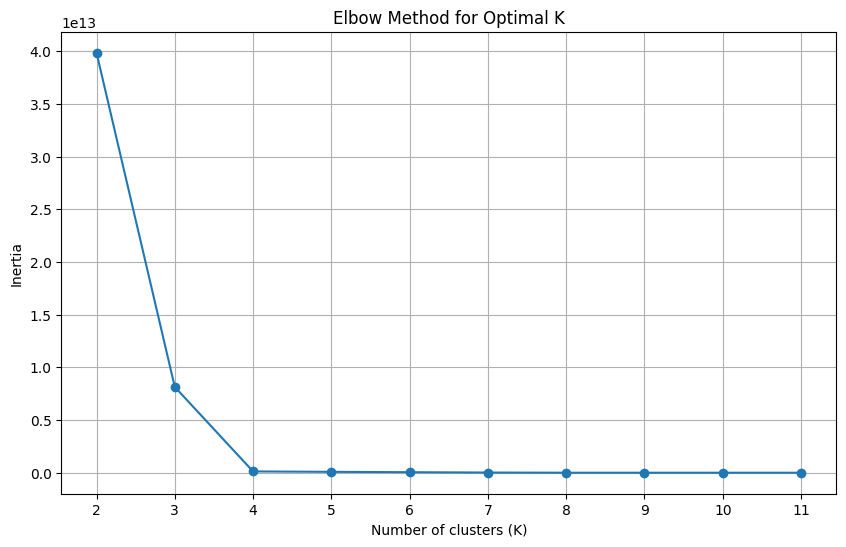

./elbow_test_export/SS-J_csv_10_70006_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1      10000        2        300   1000000.0        1000.0   
1        3       1000        2         10    100000.0       10000.0   
2        3      10000       18         60   1000000.0       10000.0   
3        1        100        2          1   1000000.0      100000.0   
4        1        100       18        300   2000000.0       10000.0   
..     ...        ...      ...        ...         ...           ...   
75       1       1000        1          1    100000.0      100000.0   
76       1       1000        1          1    100000.0        1000.0   
77       3        100        9        300    100000.0        1000.0   
78       3         10        1        120  10000000.0       10000.0   
79       3         10       15          1    100000.0      100000.0   

    Throughput+   Latency-  cluster  
0       5268.90  14182.000        3  

<Figure size 640x480 with 0 Axes>

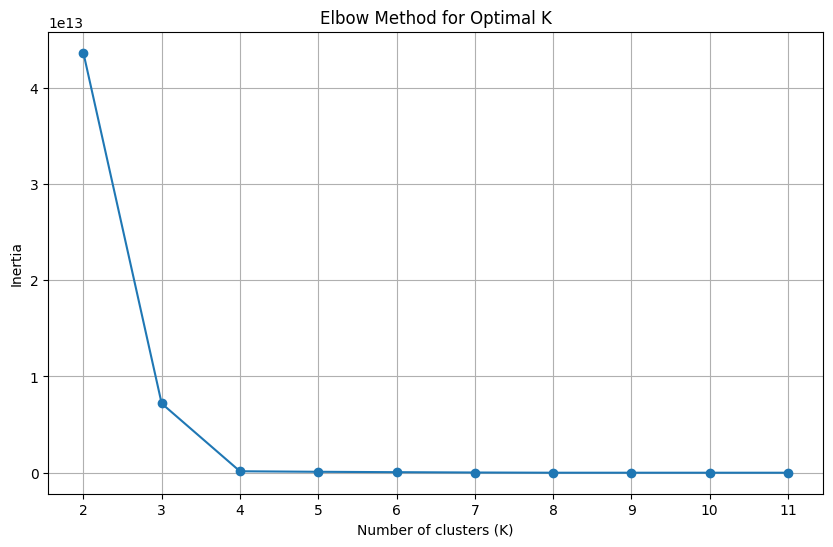

./elbow_test_export/SS-J_csv_10_70292_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        3        100       15        300   2000000.0       10000.0   
1        1         10        2         60   1000000.0       10000.0   
2        1       1000        2          1   2000000.0      100000.0   
3        1         10        9        300  10000000.0        1000.0   
4        1         10        2         10   2000000.0        1000.0   
..     ...        ...      ...        ...         ...           ...   
75       1      10000        3        300   2000000.0       10000.0   
76       3      10000        2          1   2000000.0       10000.0   
77       3       1000       15        120  10000000.0      100000.0   
78       1         10       15         10    100000.0        1000.0   
79       1        100        1         60  10000000.0       10000.0   

    Throughput+    Latency-  cluster  
0      39400.00     67.8680        2

<Figure size 640x480 with 0 Axes>

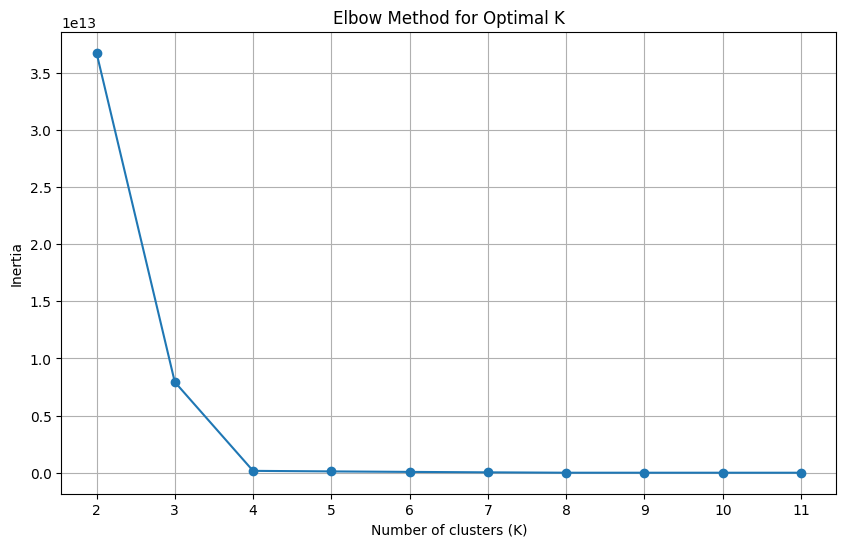

./elbow_test_export/SS-J_csv_10_77340_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        3         10        1          1    100000.0      100000.0   
1        3         10        3         60  10000000.0        1000.0   
2        3        100        9         60  10000000.0      100000.0   
3        3         10        2          1   1000000.0      100000.0   
4        3        100        6         10    100000.0        1000.0   
..     ...        ...      ...        ...         ...           ...   
75       1        100        1        300    100000.0       10000.0   
76       1      10000       12        120   2000000.0       10000.0   
77       3        100        2         10    100000.0        1000.0   
78       3       1000       18         60   1000000.0       10000.0   
79       3        100        3        300    100000.0      100000.0   

    Throughput+  Latency-  cluster  
0        103.19  2803.100        3  
1

<Figure size 640x480 with 0 Axes>

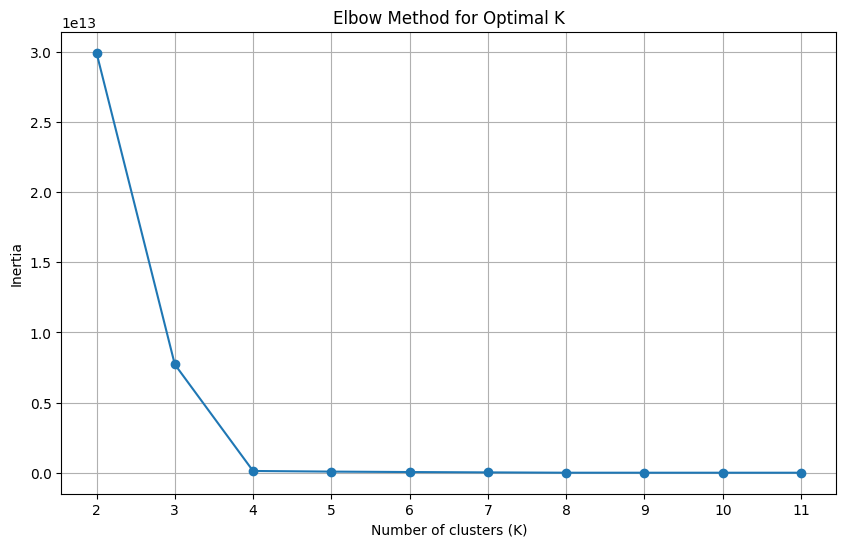

./elbow_test_export/SS-J_csv_10_77845_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1       1000        1        300   1000000.0       10000.0   
1        3      10000       18         10  10000000.0        1000.0   
2        3        100        9        300   2000000.0       10000.0   
3        3         10        6          1    100000.0       10000.0   
4        3         10        1         10    100000.0        1000.0   
..     ...        ...      ...        ...         ...           ...   
75       1        100       12        300   2000000.0        1000.0   
76       3        100        2          1  10000000.0       10000.0   
77       3      10000        2         10   1000000.0      100000.0   
78       1        100        9         10    100000.0       10000.0   
79       3        100        2          1   1000000.0        1000.0   

    Throughput+   Latency-  cluster  
0        422.24  20688.000        1  

<Figure size 640x480 with 0 Axes>

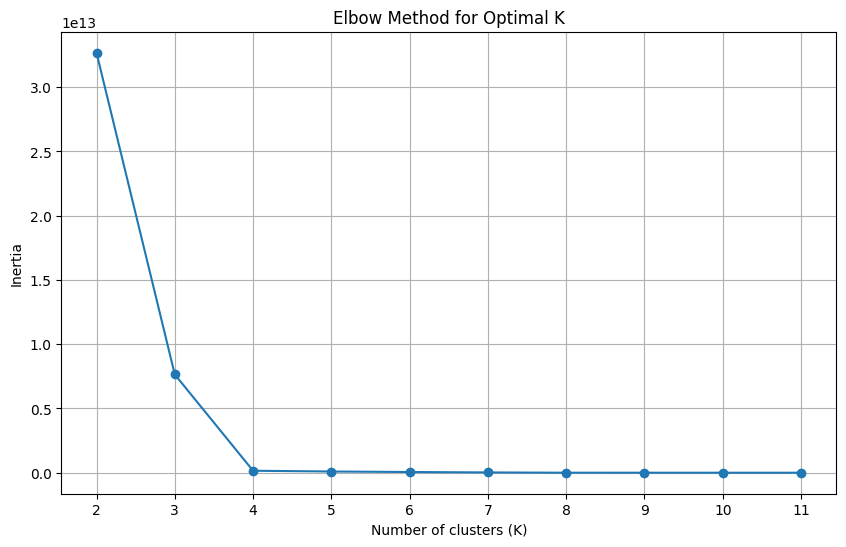

./elbow_test_export/SS-J_csv_10_83686_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        3       1000       12          1  10000000.0      100000.0   
1        1         10        1         60    100000.0      100000.0   
2        1      10000        9          1   1000000.0      100000.0   
3        3       1000       15        120    100000.0      100000.0   
4        3       1000        9        120    100000.0      100000.0   
..     ...        ...      ...        ...         ...           ...   
75       1      10000        6         60    100000.0      100000.0   
76       3      10000        2         60    100000.0        1000.0   
77       3       1000        6        120  10000000.0      100000.0   
78       1      10000       12        300   1000000.0       10000.0   
79       1         10        2        300   1000000.0      100000.0   

    Throughput+   Latency-  cluster  
0      111000.0    243.130        1  

<Figure size 640x480 with 0 Axes>

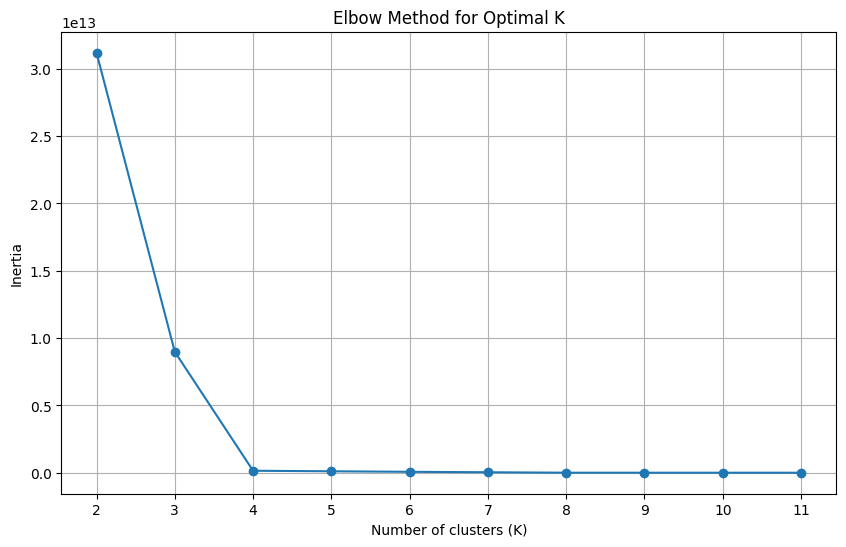

./elbow_test_export/SS-J_csv_10_84967_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        1       1000       12          1  10000000.0       10000.0   
1        1        100       15        120    100000.0      100000.0   
2        1         10        3        300   2000000.0      100000.0   
3        1       1000       18        300    100000.0       10000.0   
4        3      10000        2        300   1000000.0      100000.0   
..     ...        ...      ...        ...         ...           ...   
75       1        100        3         60   1000000.0       10000.0   
76       1         10       15        120  10000000.0      100000.0   
77       1         10       18          1   1000000.0        1000.0   
78       1       1000        3        300   1000000.0       10000.0   
79       1       1000        3        300  10000000.0        1000.0   

    Throughput+   Latency-  cluster  
0       53296.0   172.5200        1  

<Figure size 640x480 with 0 Axes>

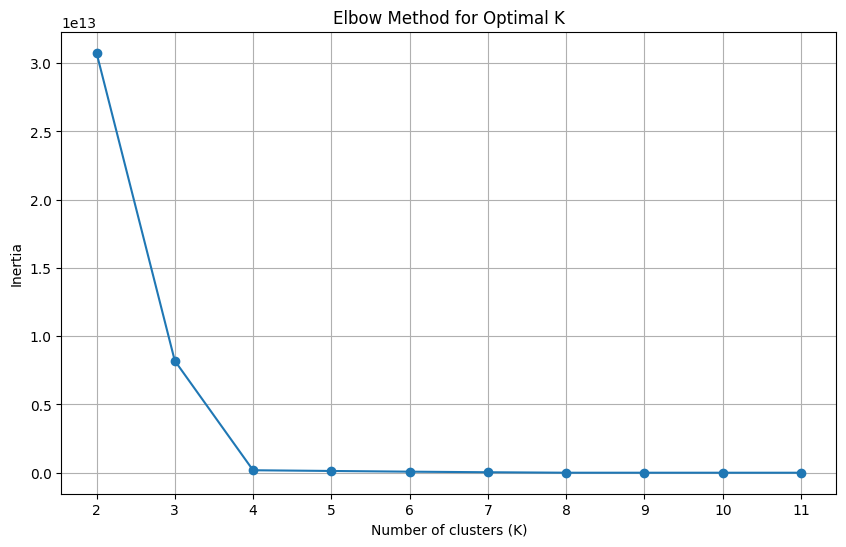

./elbow_test_export/SS-J_csv_10_86331_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0        3        100        1         10   1000000.0      100000.0   
1        1        100        3        120   1000000.0      100000.0   
2        3        100        1        300    100000.0      100000.0   
3        3      10000       12          1    100000.0      100000.0   
4        3      10000        1          1  10000000.0        1000.0   
..     ...        ...      ...        ...         ...           ...   
75       3        100       15          1    100000.0        1000.0   
76       3         10        2        120  10000000.0        1000.0   
77       3      10000       18         10  10000000.0        1000.0   
78       3      10000        2         60   1000000.0        1000.0   
79       1         10       15         10    100000.0        1000.0   

    Throughput+    Latency-  cluster  
0        72.188  26635.0000        2

<Figure size 640x480 with 0 Axes>

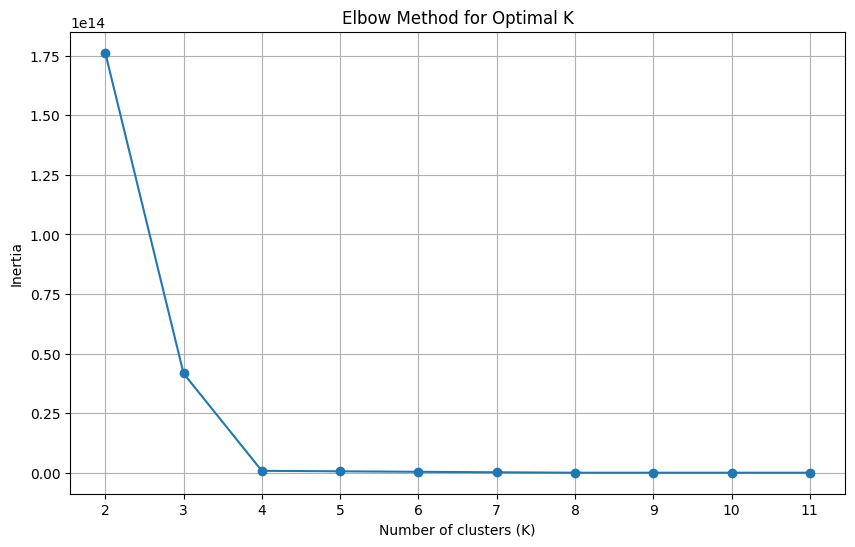

./elbow_test_export/SS-J_csv_50_11514_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3       1000        1        300  10000000.0       10000.0   
1         3         10        3        300  10000000.0        1000.0   
2         1        100       12          1   1000000.0        1000.0   
3         3       1000       12          1  10000000.0        1000.0   
4         3         10       18         60  10000000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
395       1         10        6          1   1000000.0      100000.0   
396       1      10000        1        300   2000000.0      100000.0   
397       3        100       18         60   1000000.0       10000.0   
398       1        100        1         60   1000000.0      100000.0   
399       3         10        1         60    100000.0      100000.0   

     Throughput+   Latency-  cluster  
0        740.940  25769.

<Figure size 640x480 with 0 Axes>

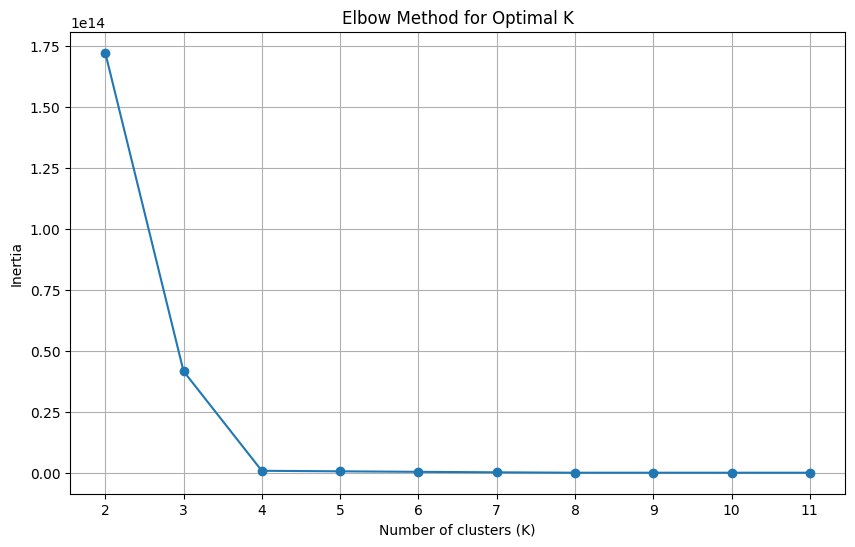

./elbow_test_export/SS-J_csv_50_19953_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000       18        120   1000000.0       10000.0   
1         1        100       18         10    100000.0        1000.0   
2         1      10000        6          1   1000000.0      100000.0   
3         1      10000        2         60   2000000.0        1000.0   
4         1         10        9          1   2000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
395       3         10       18          1  10000000.0       10000.0   
396       3         10        1         60    100000.0      100000.0   
397       1       1000        1         10   1000000.0       10000.0   
398       3        100        1        120   1000000.0        1000.0   
399       3      10000        9         10  10000000.0       10000.0   

     Throughput+    Latency-  cluster  
0      58317.000    127

<Figure size 640x480 with 0 Axes>

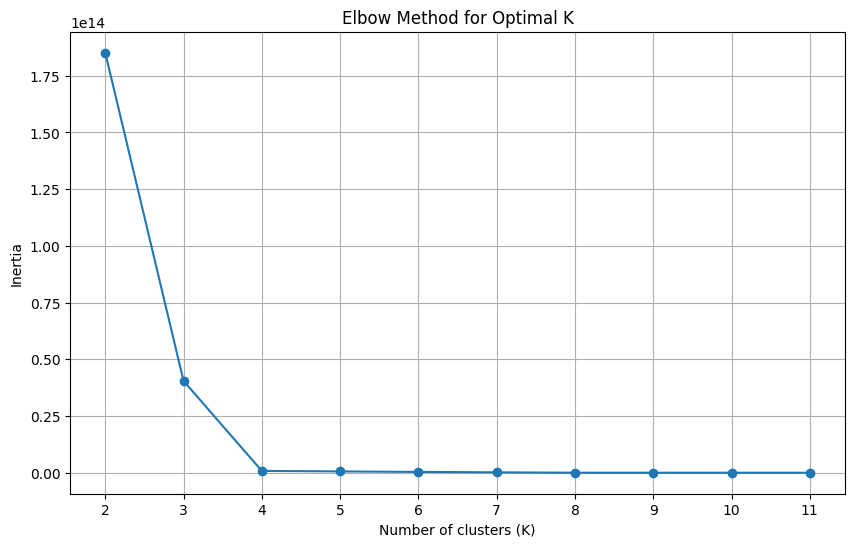

./elbow_test_export/SS-J_csv_50_3545_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1         10        9        120   2000000.0       10000.0   
1         1       1000       15          1   2000000.0       10000.0   
2         3       1000        6         60   2000000.0        1000.0   
3         3        100       15         60    100000.0      100000.0   
4         1      10000        9        300   1000000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
395       3       1000        3         10   1000000.0       10000.0   
396       3        100        2        120   1000000.0       10000.0   
397       3         10       18         10  10000000.0      100000.0   
398       1      10000        3        120   2000000.0      100000.0   
399       3       1000       18         10   1000000.0      100000.0   

     Throughput+  Latency-  cluster  
0        37059.0    2.0351

<Figure size 640x480 with 0 Axes>

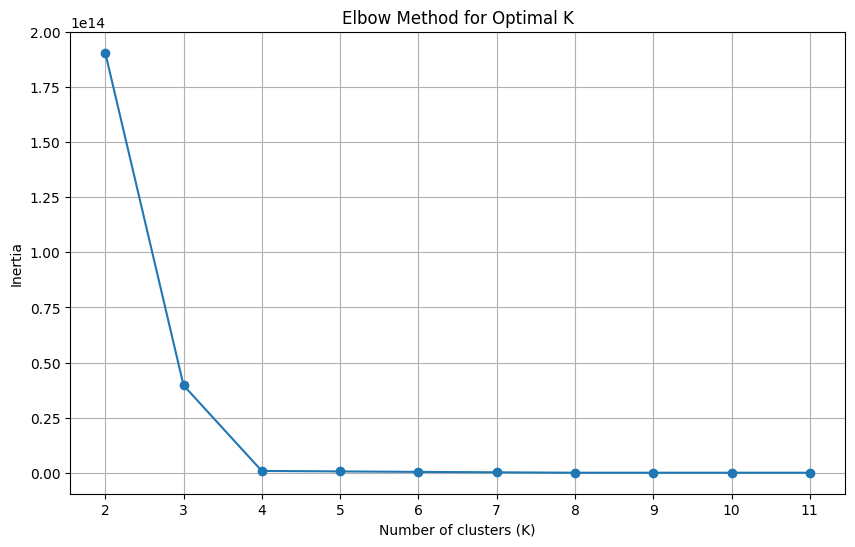

./elbow_test_export/SS-J_csv_50_39658_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1         10       18        300  10000000.0      100000.0   
1         1        100       12        120   2000000.0       10000.0   
2         1      10000       12         10   1000000.0       10000.0   
3         1        100       15        300   2000000.0        1000.0   
4         3        100        1         60   2000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
395       1         10        3        300  10000000.0       10000.0   
396       1       1000        9        120    100000.0      100000.0   
397       1        100       15        120   2000000.0        1000.0   
398       3        100       15        300   2000000.0       10000.0   
399       3         10        2         10   2000000.0        1000.0   

     Throughput+    Latency-  cluster  
0      35131.000      2

<Figure size 640x480 with 0 Axes>

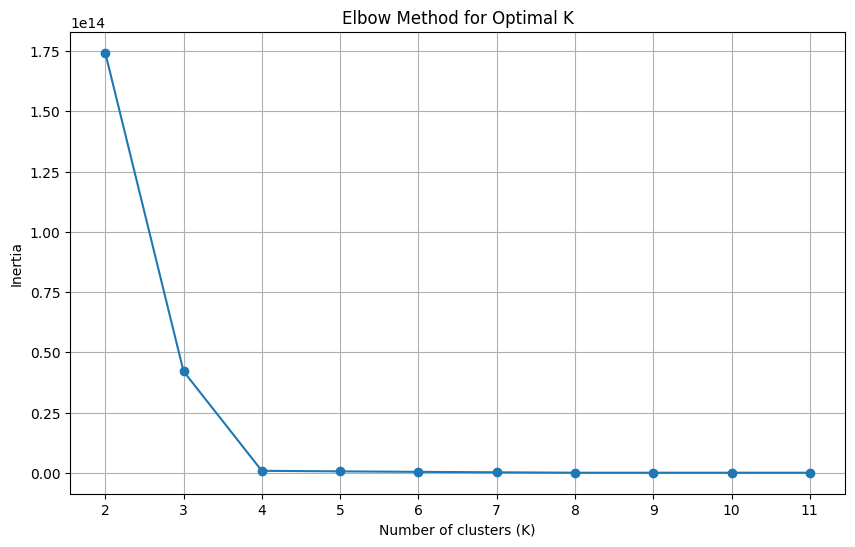

./elbow_test_export/SS-J_csv_50_40749_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1      10000       15        120   1000000.0       10000.0   
1         1      10000        2        300   2000000.0       10000.0   
2         3       1000        1         10   1000000.0      100000.0   
3         1       1000        1         10  10000000.0       10000.0   
4         3         10       18        120   2000000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
395       1        100       12         60   1000000.0      100000.0   
396       1         10        9        120    100000.0       10000.0   
397       3        100        6        300    100000.0        1000.0   
398       3         10       15         10    100000.0      100000.0   
399       3       1000        9          1  10000000.0      100000.0   

     Throughput+   Latency-  cluster  
0      157000.00    376.

<Figure size 640x480 with 0 Axes>

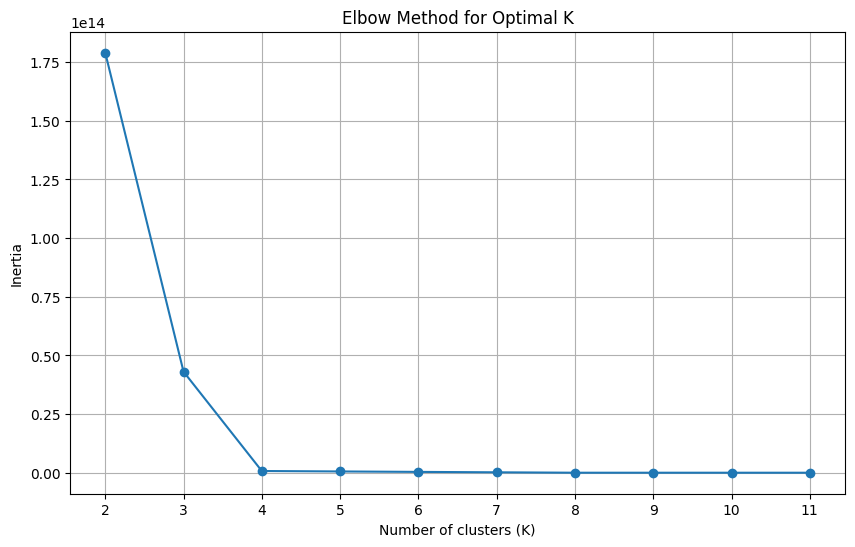

./elbow_test_export/SS-J_csv_50_44845_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000        9         10  10000000.0       10000.0   
1         3       1000       18        120    100000.0        1000.0   
2         1       1000        6          1   1000000.0       10000.0   
3         1        100        9        300   2000000.0      100000.0   
4         3         10        9        300  10000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
395       1        100       12         60   1000000.0      100000.0   
396       1      10000        1         10   2000000.0      100000.0   
397       1       1000        2        300    100000.0       10000.0   
398       1        100        3          1    100000.0        1000.0   
399       3       1000       12         10    100000.0        1000.0   

     Throughput+   Latency-  cluster  
0        74505.0    116.

<Figure size 640x480 with 0 Axes>

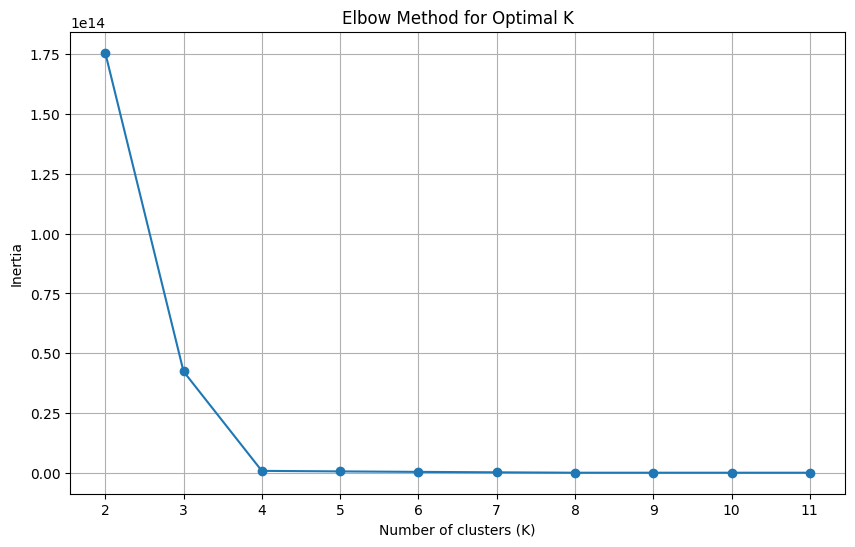

./elbow_test_export/SS-J_csv_50_51176_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000       18        300   1000000.0       10000.0   
1         3         10        1         60   2000000.0      100000.0   
2         1         10       15         60    100000.0        1000.0   
3         3         10        2         10   2000000.0       10000.0   
4         3        100       15          1  10000000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
395       3        100       18          1  10000000.0       10000.0   
396       3         10        3        300   1000000.0      100000.0   
397       1         10       12          1    100000.0        1000.0   
398       1       1000       12         60  10000000.0        1000.0   
399       3         10       18        300  10000000.0        1000.0   

     Throughput+  Latency-  cluster  
0       58661.00   120.35

<Figure size 640x480 with 0 Axes>

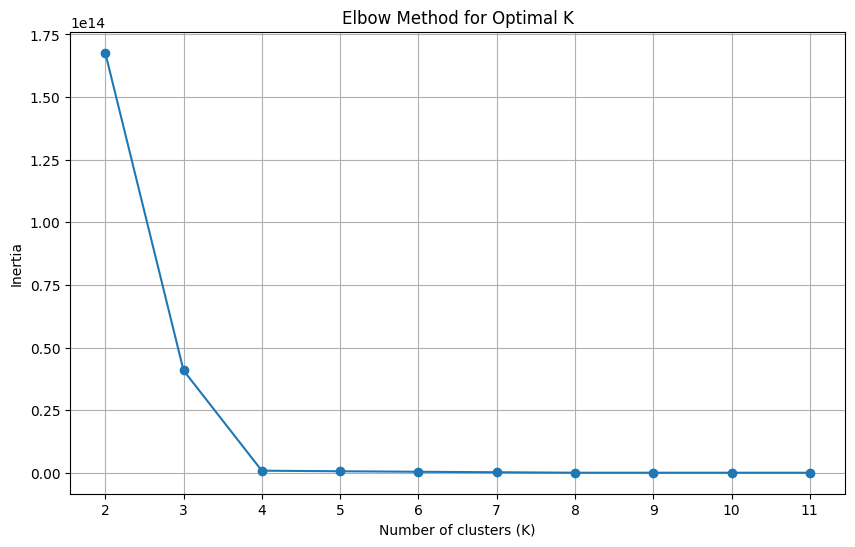

./elbow_test_export/SS-J_csv_50_58612_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1        100        9        120    100000.0      100000.0   
1         3        100        2         60    100000.0        1000.0   
2         1         10        3        120  10000000.0        1000.0   
3         1        100        9        300   1000000.0        1000.0   
4         1         10        6        300    100000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
395       1        100       15          1    100000.0      100000.0   
396       1       1000        2         10   1000000.0      100000.0   
397       1        100        6        300    100000.0      100000.0   
398       1         10       12        300    100000.0      100000.0   
399       1      10000       12         10   2000000.0      100000.0   

     Throughput+    Latency-  cluster  
0       38018.00     17

<Figure size 640x480 with 0 Axes>

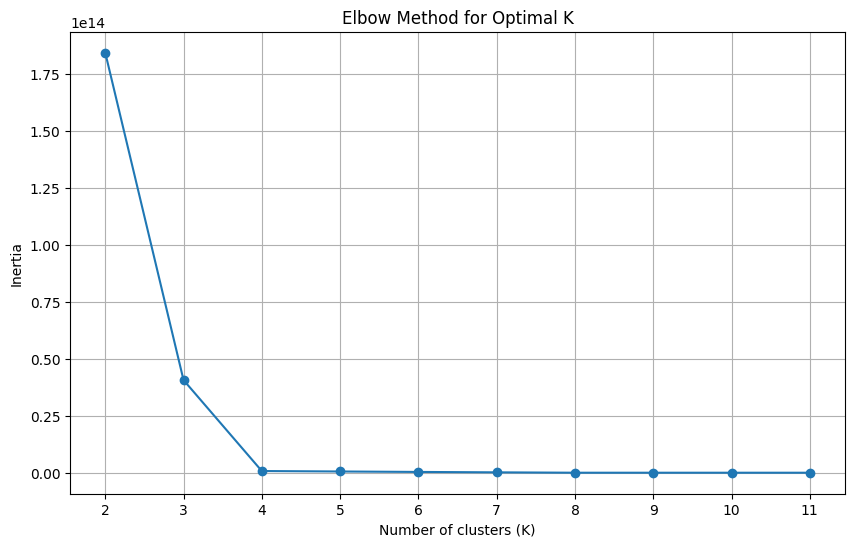

./elbow_test_export/SS-J_csv_50_61367_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3      10000       12         10   2000000.0       10000.0   
1         1       1000       18        300   1000000.0      100000.0   
2         1      10000       12         10   2000000.0      100000.0   
3         1       1000        9        120  10000000.0      100000.0   
4         1        100        2        120   1000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
395       1       1000       15        300    100000.0        1000.0   
396       3        100       15         10  10000000.0        1000.0   
397       3        100       12         60    100000.0       10000.0   
398       1         10        1          1   1000000.0       10000.0   
399       3        100       15         60   1000000.0       10000.0   

     Throughput+  Latency-  cluster  
0       204000.0  1100.60

<Figure size 640x480 with 0 Axes>

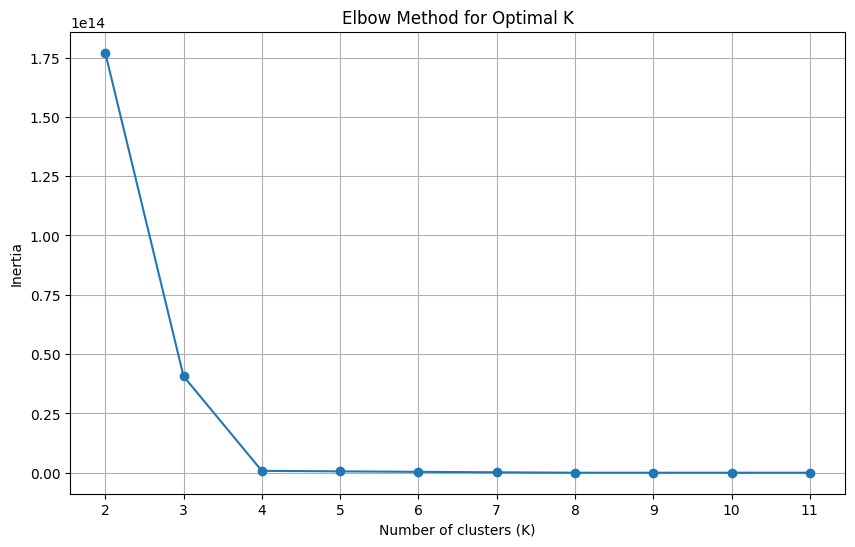

./elbow_test_export/SS-J_csv_50_65388_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1         10       15        120   1000000.0      100000.0   
1         3        100        1        300   2000000.0        1000.0   
2         1       1000        2         10   1000000.0      100000.0   
3         3        100       15        120    100000.0      100000.0   
4         3        100        3          1  10000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
395       1       1000        6         60  10000000.0        1000.0   
396       1      10000        3         60   1000000.0      100000.0   
397       1      10000        3        120  10000000.0      100000.0   
398       3       1000        9         60   2000000.0      100000.0   
399       3       1000        9         10   1000000.0       10000.0   

     Throughput+    Latency-  cluster  
0       36304.00      2

<Figure size 640x480 with 0 Axes>

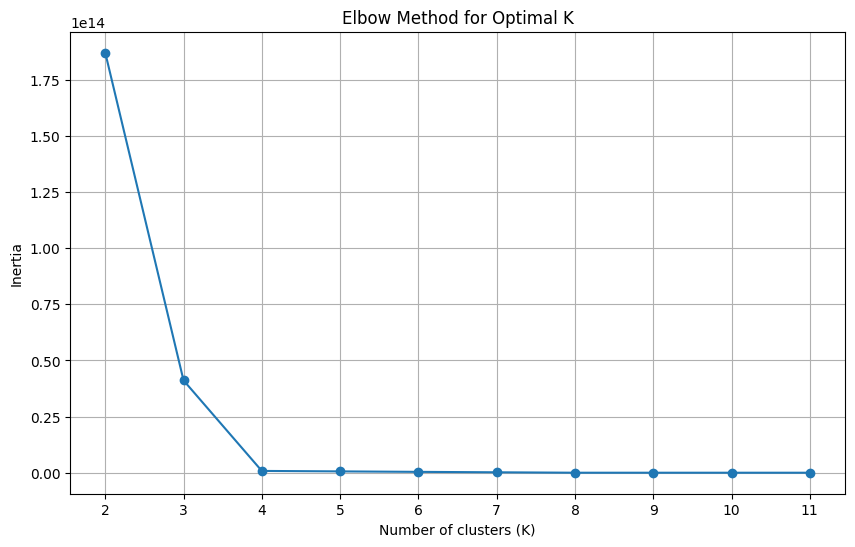

./elbow_test_export/SS-J_csv_50_65444_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1      10000        6         10    100000.0      100000.0   
1         3        100       18         60    100000.0       10000.0   
2         3        100        9        120  10000000.0       10000.0   
3         3        100       18         60   2000000.0       10000.0   
4         3         10        1         60    100000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
395       1         10        2         60   2000000.0        1000.0   
396       3      10000        2         60  10000000.0       10000.0   
397       3       1000        2        120    100000.0       10000.0   
398       1        100       12        300   2000000.0       10000.0   
399       3      10000       18        120   1000000.0       10000.0   

     Throughput+   Latency-  cluster  
0      142000.00   416.5

<Figure size 640x480 with 0 Axes>

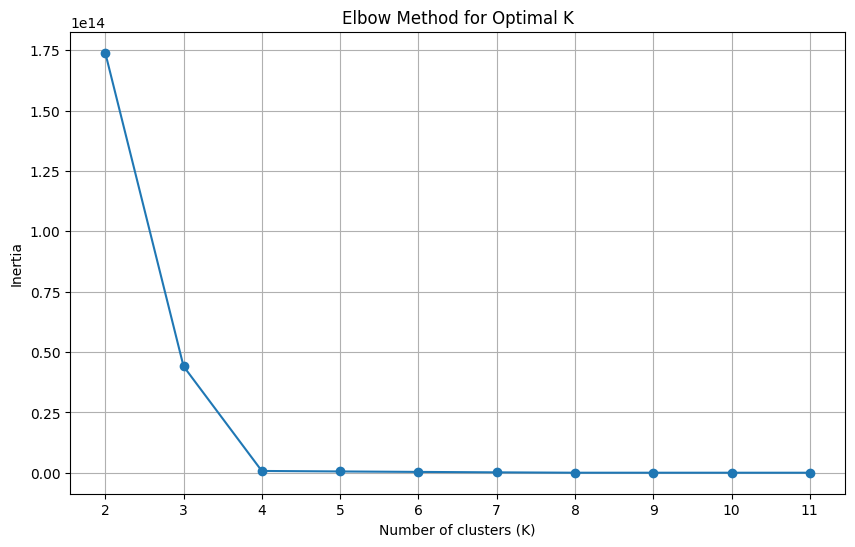

./elbow_test_export/SS-J_csv_50_66946_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3       1000        3        300    100000.0      100000.0   
1         3        100       18         10  10000000.0        1000.0   
2         1         10       12        120   1000000.0      100000.0   
3         1         10        3        300    100000.0      100000.0   
4         3       1000       18         60   1000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
395       1       1000       18        120   2000000.0        1000.0   
396       3         10        2         10    100000.0      100000.0   
397       3       1000        6        120   1000000.0       10000.0   
398       3         10       12          1   2000000.0      100000.0   
399       3       1000        3         10   2000000.0       10000.0   

     Throughput+  Latency-  cluster  
0       130000.0  183.610

<Figure size 640x480 with 0 Axes>

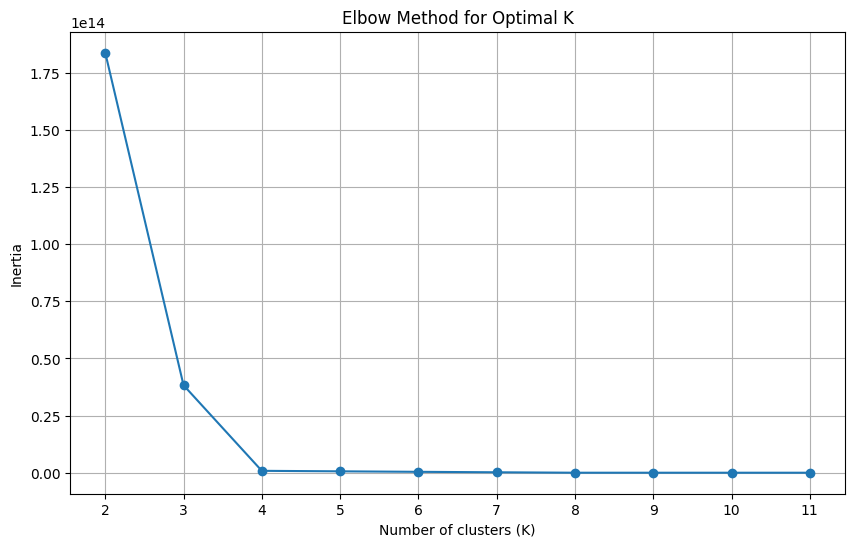

./elbow_test_export/SS-J_csv_50_69024_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000       15        300  10000000.0      100000.0   
1         1       1000       12         10   2000000.0        1000.0   
2         1        100        6          1   1000000.0      100000.0   
3         3      10000        1        300   1000000.0      100000.0   
4         1         10       18         10   2000000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
395       1      10000        9        120   2000000.0        1000.0   
396       1       1000        1        300  10000000.0        1000.0   
397       3      10000        9        120  10000000.0        1000.0   
398       1      10000        3        120   1000000.0      100000.0   
399       3       1000        3         10   1000000.0      100000.0   

     Throughput+    Latency-  cluster  
0        55326.0    183

<Figure size 640x480 with 0 Axes>

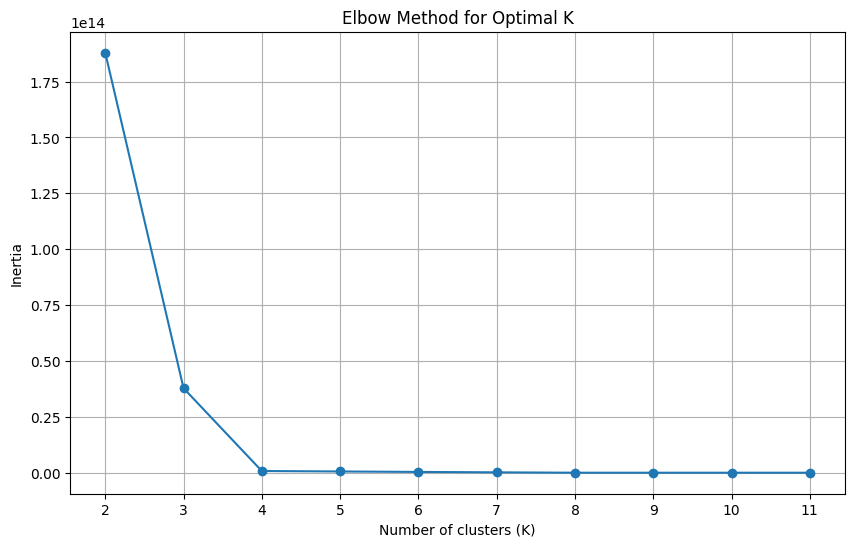

./elbow_test_export/SS-J_csv_50_70006_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1      10000        2        300   1000000.0        1000.0   
1         3       1000        2         10    100000.0       10000.0   
2         3      10000       18         60   1000000.0       10000.0   
3         1        100        2          1   1000000.0      100000.0   
4         1        100       18        300   2000000.0       10000.0   
..      ...        ...      ...        ...         ...           ...   
395       1        100       18         60   1000000.0        1000.0   
396       1        100       18         60  10000000.0      100000.0   
397       1      10000        2         60   1000000.0        1000.0   
398       1      10000        9         60   1000000.0       10000.0   
399       1       1000       12         10   1000000.0       10000.0   

     Throughput+   Latency-  cluster  
0        5268.90  14182.

<Figure size 640x480 with 0 Axes>

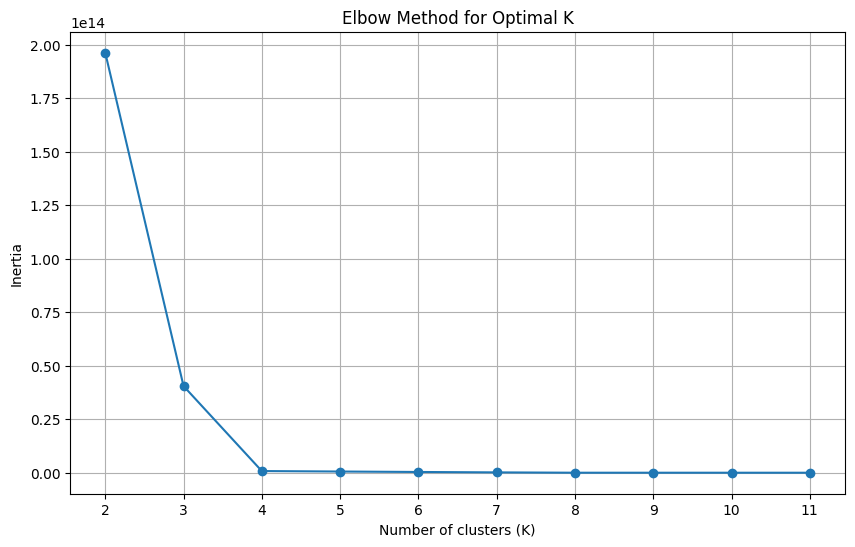

./elbow_test_export/SS-J_csv_50_70292_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3        100       15        300   2000000.0       10000.0   
1         1         10        2         60   1000000.0       10000.0   
2         1       1000        2          1   2000000.0      100000.0   
3         1         10        9        300  10000000.0        1000.0   
4         1         10        2         10   2000000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
395       1         10        2        120  10000000.0      100000.0   
396       3      10000        1         10  10000000.0       10000.0   
397       1       1000        2         10    100000.0      100000.0   
398       3         10        2          1   1000000.0       10000.0   
399       3       1000        3         60    100000.0       10000.0   

     Throughput+    Latency-  cluster  
0       39400.00     67

<Figure size 640x480 with 0 Axes>

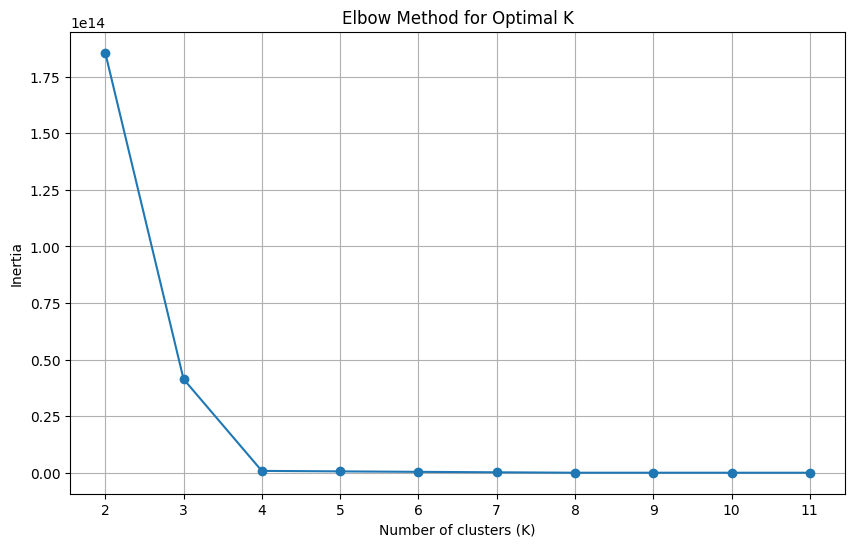

./elbow_test_export/SS-J_csv_50_77340_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3         10        1          1    100000.0      100000.0   
1         3         10        3         60  10000000.0        1000.0   
2         3        100        9         60  10000000.0      100000.0   
3         3         10        2          1   1000000.0      100000.0   
4         3        100        6         10    100000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
395       1      10000        2          1   2000000.0        1000.0   
396       1        100        6          1    100000.0       10000.0   
397       1      10000        2         10    100000.0      100000.0   
398       1        100        2        300  10000000.0      100000.0   
399       1         10       18         10    100000.0      100000.0   

     Throughput+    Latency-  cluster  
0         103.19   2803

<Figure size 640x480 with 0 Axes>

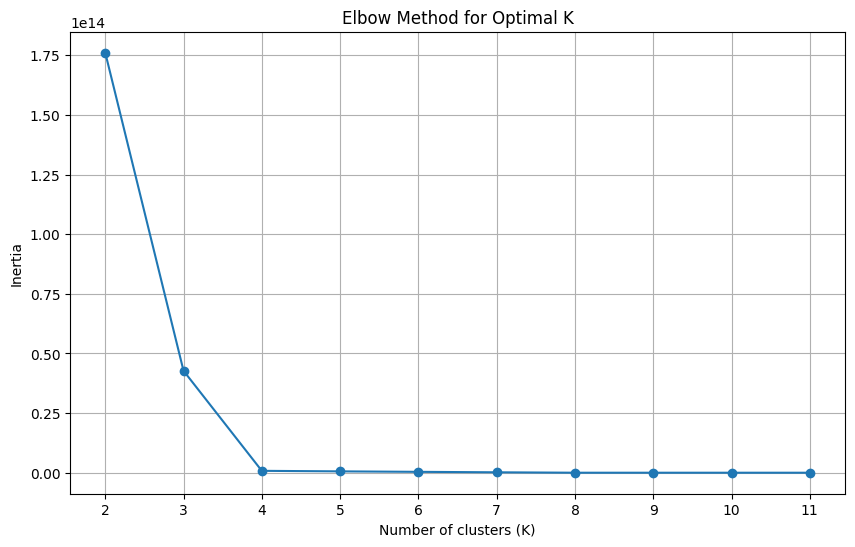

./elbow_test_export/SS-J_csv_50_77845_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000        1        300   1000000.0       10000.0   
1         3      10000       18         10  10000000.0        1000.0   
2         3        100        9        300   2000000.0       10000.0   
3         3         10        6          1    100000.0       10000.0   
4         3         10        1         10    100000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
395       3         10        6        300   2000000.0       10000.0   
396       3        100        2         60   1000000.0      100000.0   
397       1      10000        1        120  10000000.0        1000.0   
398       1         10        3          1   1000000.0       10000.0   
399       1      10000        9         60  10000000.0       10000.0   

     Throughput+    Latency-  cluster  
0         422.24  20688

<Figure size 640x480 with 0 Axes>

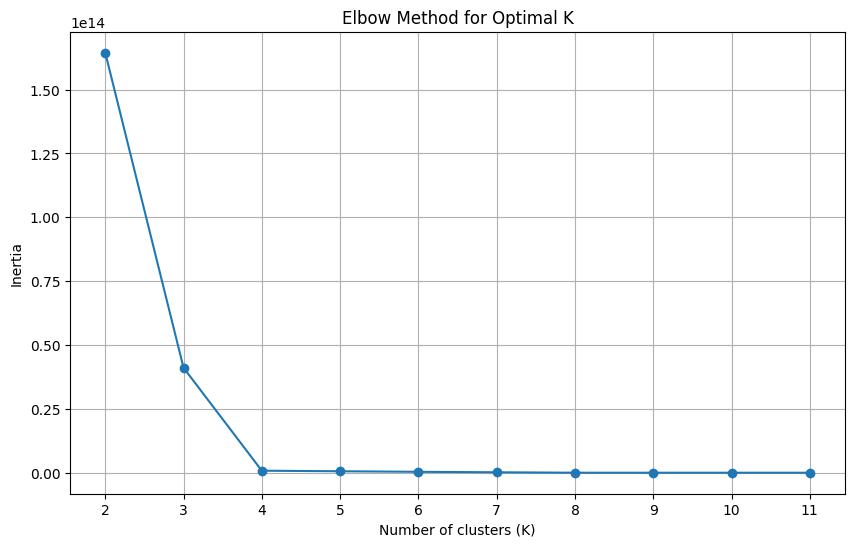

./elbow_test_export/SS-J_csv_50_83686_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3       1000       12          1  10000000.0      100000.0   
1         1         10        1         60    100000.0      100000.0   
2         1      10000        9          1   1000000.0      100000.0   
3         3       1000       15        120    100000.0      100000.0   
4         3       1000        9        120    100000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
395       1      10000        9        120  10000000.0       10000.0   
396       1      10000        9         10   2000000.0      100000.0   
397       3        100        3        120   1000000.0        1000.0   
398       3        100        9        300   1000000.0      100000.0   
399       3      10000       12        300  10000000.0      100000.0   

     Throughput+  Latency-  cluster  
0       111000.0   243.13

<Figure size 640x480 with 0 Axes>

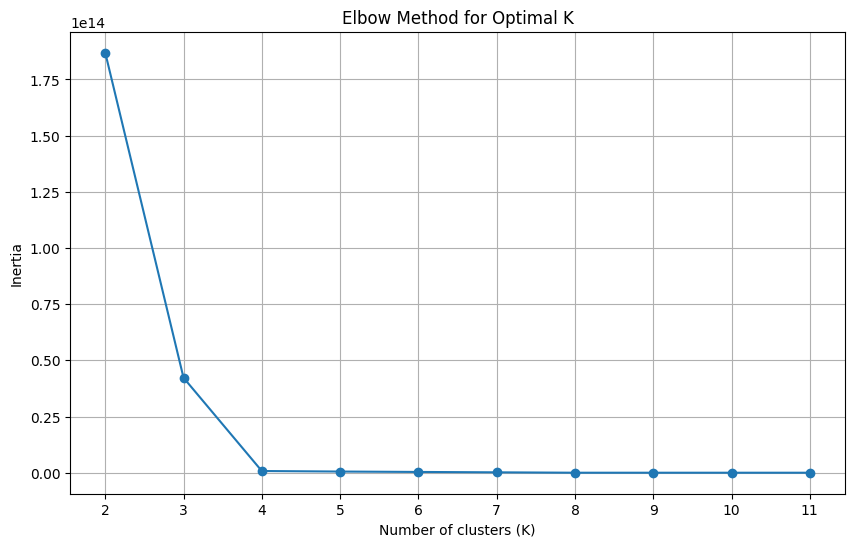

./elbow_test_export/SS-J_csv_50_84967_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         1       1000       12          1  10000000.0       10000.0   
1         1        100       15        120    100000.0      100000.0   
2         1         10        3        300   2000000.0      100000.0   
3         1       1000       18        300    100000.0       10000.0   
4         3      10000        2        300   1000000.0      100000.0   
..      ...        ...      ...        ...         ...           ...   
395       1        100       18         60  10000000.0       10000.0   
396       3       1000        6          1   2000000.0        1000.0   
397       3       1000        9         60   1000000.0      100000.0   
398       1         10        1        120    100000.0        1000.0   
399       3        100        2        300  10000000.0      100000.0   

     Throughput+   Latency-  cluster  
0        53296.0   172.5

<Figure size 640x480 with 0 Axes>

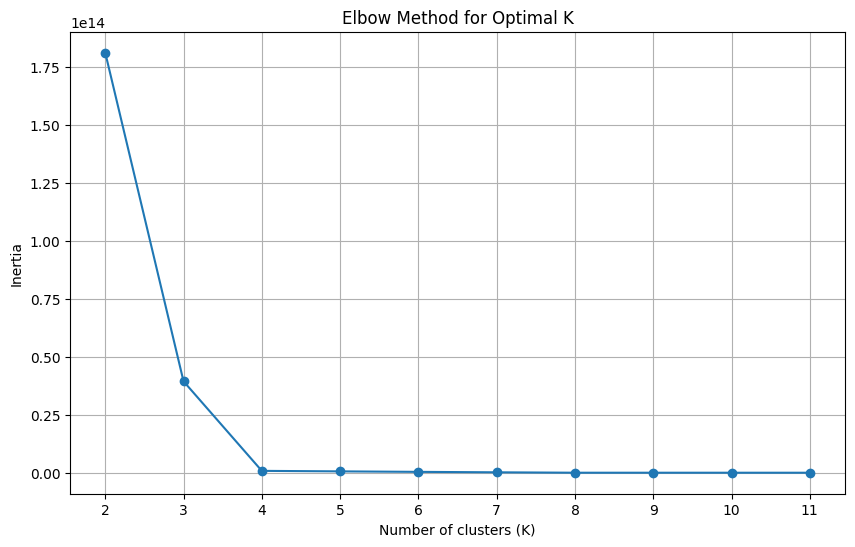

./elbow_test_export/SS-J_csv_50_86331_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Sorters  Emit_freq  Chunk_size  Message_size  \
0         3        100        1         10   1000000.0      100000.0   
1         1        100        3        120   1000000.0      100000.0   
2         3        100        1        300    100000.0      100000.0   
3         3      10000       12          1    100000.0      100000.0   
4         3      10000        1          1  10000000.0        1000.0   
..      ...        ...      ...        ...         ...           ...   
395       1       1000       12          1    100000.0      100000.0   
396       1         10        3         60   1000000.0       10000.0   
397       1      10000       18         10   1000000.0       10000.0   
398       3       1000        9        120  10000000.0      100000.0   
399       1       1000        3         60   1000000.0      100000.0   

     Throughput+    Latency-  cluster  
0         72.188  26635

<Figure size 640x480 with 0 Axes>

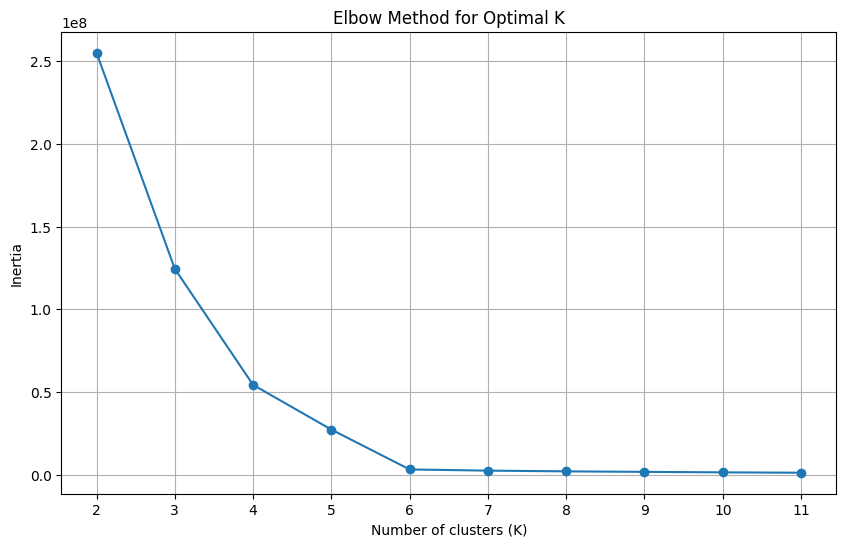

./elbow_test_export/SS-K_csv_100_11514_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3         10          10         3        12              10   
1         1        100           2         2         3              10   
2         3        100         100         2        12             100   
3         3       1000          10         6         1            1000   
4         3      10000           2         2         1              10   
..      ...        ...         ...       ...       ...             ...   
795       3      10000           2         6        12             100   
796       1          1           1         3         6              10   
797       1        100           3         1         6              10   
798       3          2          10         2         6            1000   
799       3        100           3         1         3             100   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

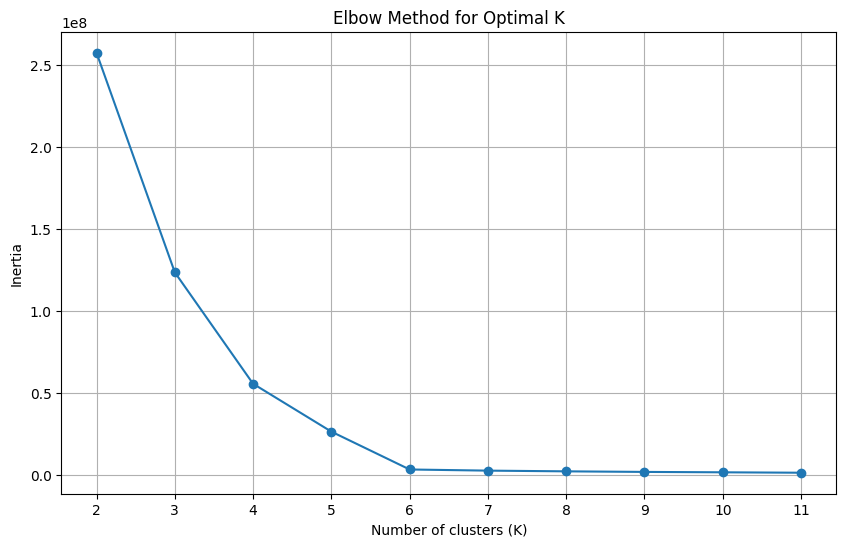

./elbow_test_export/SS-K_csv_100_19953_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000         100         3         3             100   
1         1        100         100         1         1              10   
2         3          1          10         6         3            1000   
3         3          1           2         6         6              10   
4         1          2           1         1         6            1000   
..      ...        ...         ...       ...       ...             ...   
795       1         10         100         2         3              10   
796       1        100         100         6         3             100   
797       1      10000           3         1         6            1000   
798       3         10           2         2         3            1000   
799       1       1000          10         1         6            1000   

     Throughput+   Latency-  cluster  

<Figure size 640x480 with 0 Axes>

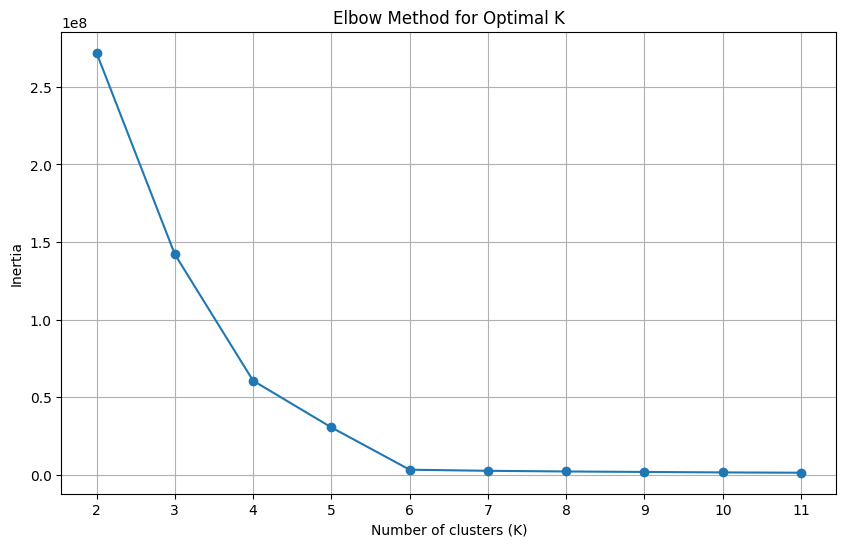

./elbow_test_export/SS-K_csv_100_3545_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1          2           1         6         6             100   
1         1      10000           3         3         6             100   
2         3      10000          10         1         1            1000   
3         3          2           2         1         3              10   
4         1        100           1         6         6             100   
..      ...        ...         ...       ...       ...             ...   
795       3          2           2         3        12            1000   
796       1         10          10         1         3            1000   
797       3         10           1         1        12              10   
798       3         10           2         1         3             100   
799       3          1           3         3         3              10   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

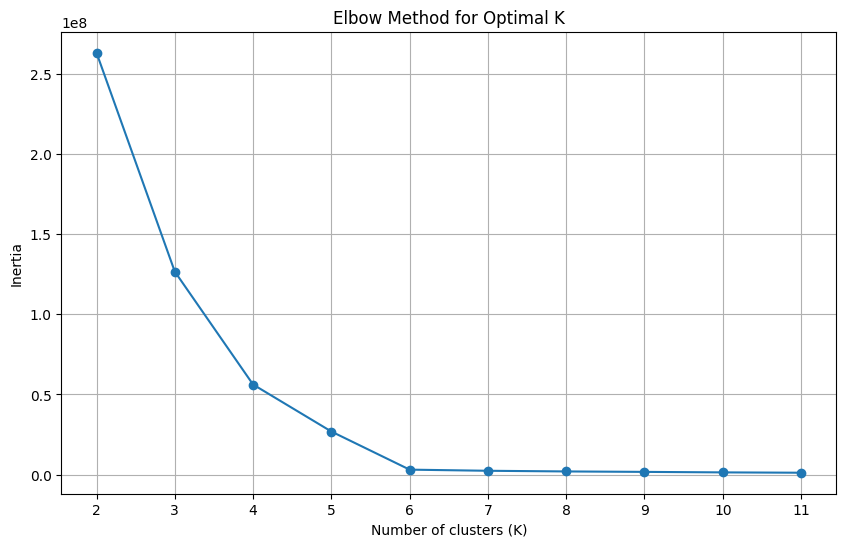

./elbow_test_export/SS-K_csv_100_39658_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1          2         100         6        12            1000   
1         1        100           3         1         6             100   
2         3          2           2         3         3             100   
3         1        100          10         3         6              10   
4         3       1000           1         3         6            1000   
..      ...        ...         ...       ...       ...             ...   
795       3          1         100         2         1             100   
796       1         10         100         3         6              10   
797       3          2           3         1         3             100   
798       3          1           1         6         1             100   
799       1         10         100         2         3              10   

     Throughput+   Latency-  cluster  

<Figure size 640x480 with 0 Axes>

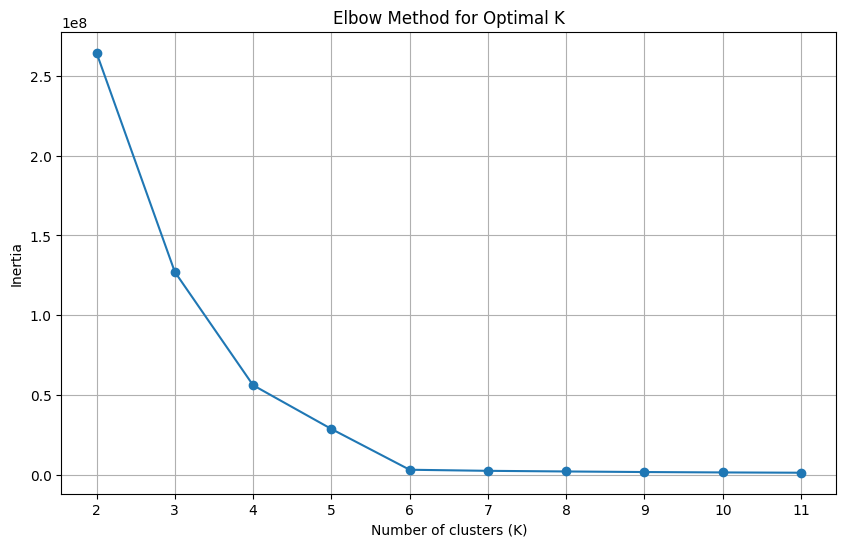

./elbow_test_export/SS-K_csv_100_40749_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3          2          10         2         3             100   
1         3          1           3         2         6             100   
2         1       1000           1         2        12             100   
3         3        100         100         3         6              10   
4         3          1          10         2         3            1000   
..      ...        ...         ...       ...       ...             ...   
795       1       1000          10         2         6              10   
796       3          2         100         2         3              10   
797       1         10          10         2         6              10   
798       3        100           3         6         6            1000   
799       3        100           3         2         1             100   

     Throughput+  Latency-  cluster  


<Figure size 640x480 with 0 Axes>

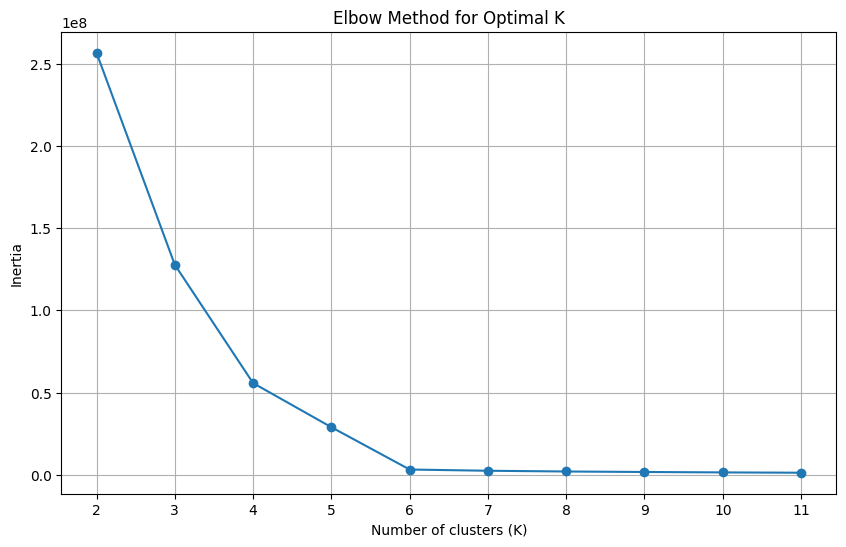

./elbow_test_export/SS-K_csv_100_44845_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000           1         2        12             100   
1         1       1000          10         6         3             100   
2         1        100           2         1         6            1000   
3         3        100           2         1        12            1000   
4         1          1           3         2         3             100   
..      ...        ...         ...       ...       ...             ...   
795       1       1000         100         6        12            1000   
796       1      10000           2         3         1              10   
797       3         10          10         3         1              10   
798       1      10000         100         2         1              10   
799       3          2           3         6         6            1000   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

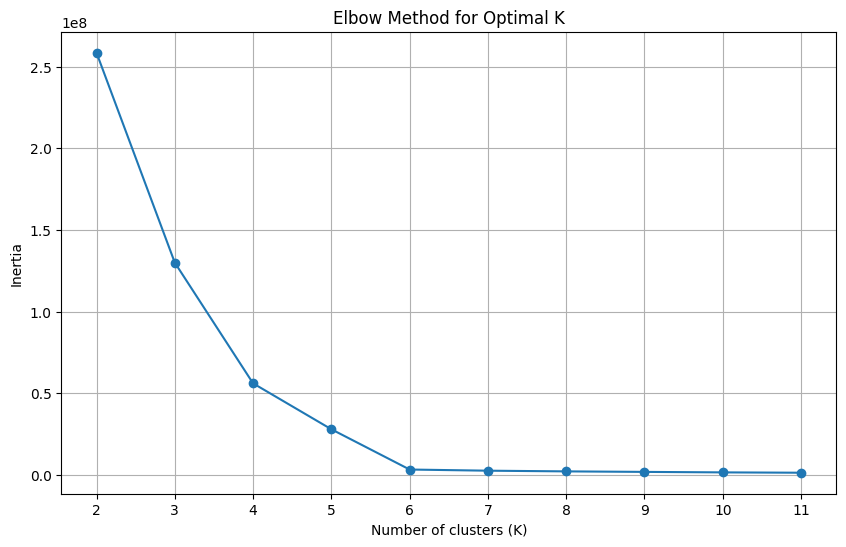

./elbow_test_export/SS-K_csv_100_51176_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000         100         6         3             100   
1         3         10           1         3         6            1000   
2         1          2          10         1         1              10   
3         3         10           2         3         6             100   
4         3      10000           3         3        12             100   
..      ...        ...         ...       ...       ...             ...   
795       3         10         100         2         1              10   
796       3         10           1         1         1             100   
797       1          2           3         3         3            1000   
798       3         10           2         2         3            1000   
799       3        100          10         1         6            1000   

     Throughput+   Latency-  cluster  

<Figure size 640x480 with 0 Axes>

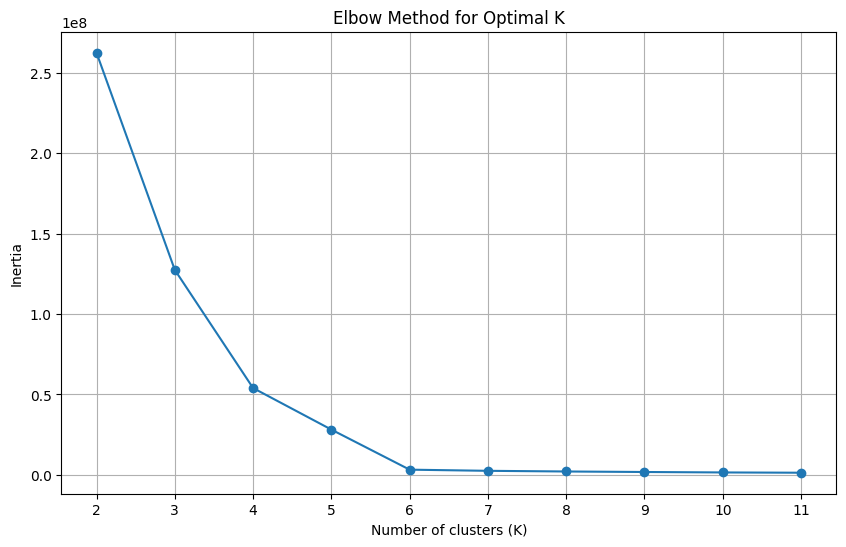

./elbow_test_export/SS-K_csv_100_58612_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1        100           1         6         1            1000   
1         3       1000           2         6         1              10   
2         1          1          10         2        12              10   
3         1        100           2         1         3              10   
4         1          1         100         6         1             100   
..      ...        ...         ...       ...       ...             ...   
795       1          2          10         3         3              10   
796       3         10           2         3         1             100   
797       1         10           3         6         3            1000   
798       3       1000          10         3         3             100   
799       1          2         100         6         3            1000   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

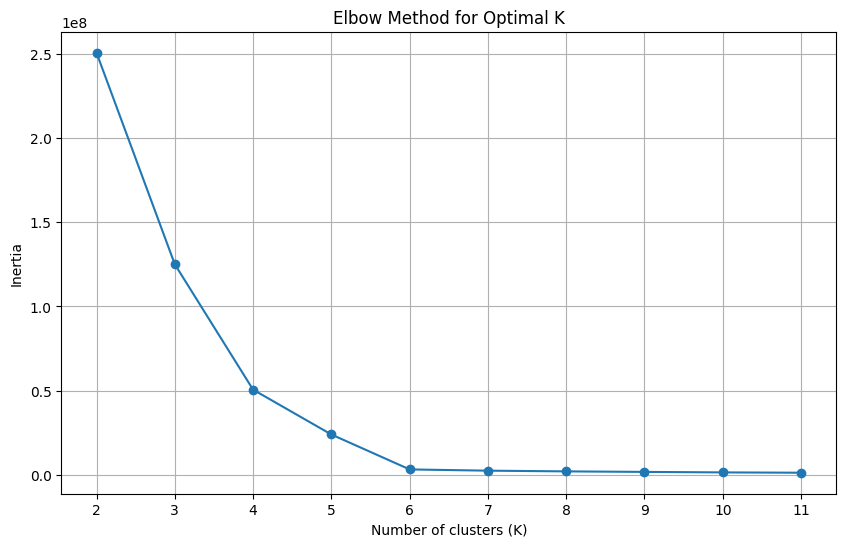

./elbow_test_export/SS-K_csv_100_61367_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000         100         6         3            1000   
1         3          2           2         3         6            1000   
2         1      10000           1         6        12            1000   
3         1         10           3         1         3            1000   
4         3      10000         100         3        12              10   
..      ...        ...         ...       ...       ...             ...   
795       1      10000          10         6         3              10   
796       1         10          10         2         3            1000   
797       3      10000         100         6         6             100   
798       1       1000         100         2        12            1000   
799       1      10000          10         3        12             100   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

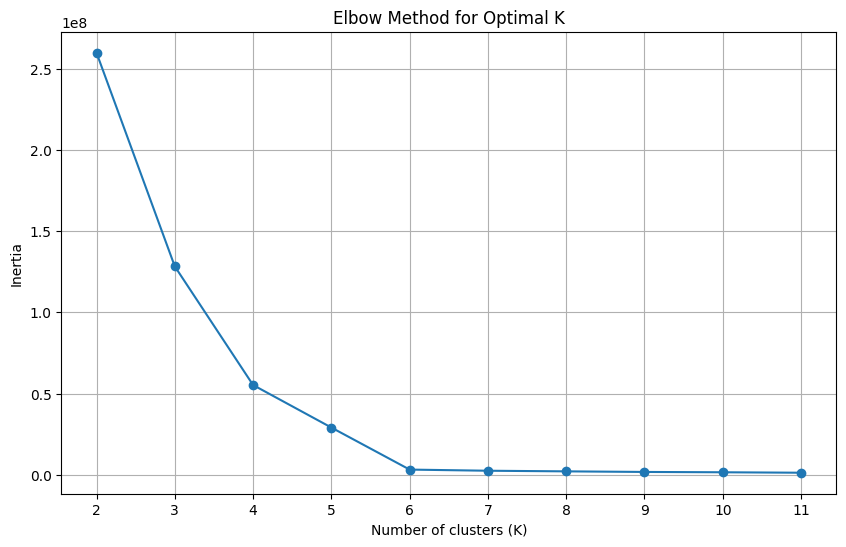

./elbow_test_export/SS-K_csv_100_65388_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1          2          10         2         3            1000   
1         3       1000           2         1         6              10   
2         1       1000           2         3         3            1000   
3         3      10000          10         2         1            1000   
4         3       1000           3         3        12            1000   
..      ...        ...         ...       ...       ...             ...   
795       3          1           3         3         1             100   
796       1        100           1         2        12             100   
797       3         10           2         6         3             100   
798       3      10000           2         2        12              10   
799       3        100          10         3        12             100   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

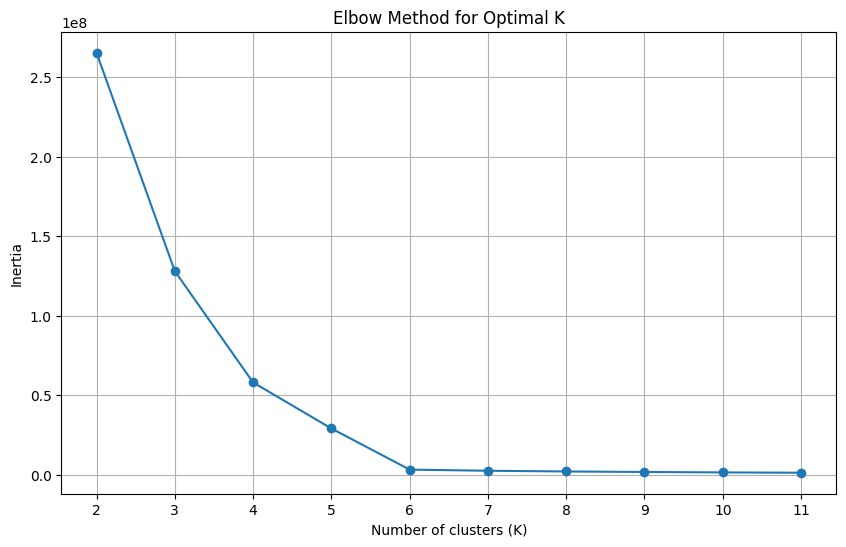

./elbow_test_export/SS-K_csv_100_65444_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3          1         100         1         1            1000   
1         3      10000         100         2         1             100   
2         3      10000           1         6        12             100   
3         3      10000         100         2         6             100   
4         3         10           1         3         1             100   
..      ...        ...         ...       ...       ...             ...   
795       1       1000           3         3         1             100   
796       1        100          10         3         3              10   
797       1         10           2         3        12              10   
798       1        100           2         1         6              10   
799       3          2           2         1         6              10   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

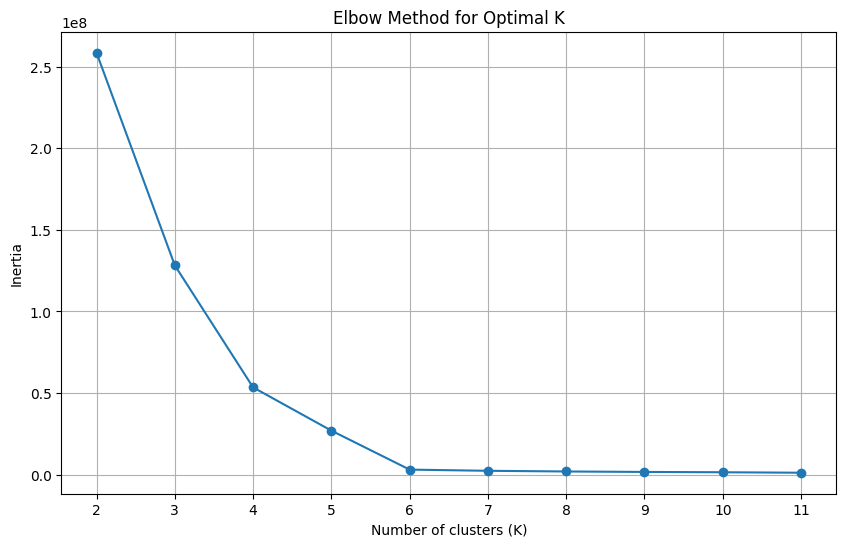

./elbow_test_export/SS-K_csv_100_66946_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3      10000         100         1        12              10   
1         1          2           3         1         3            1000   
2         1          1          10         3         1            1000   
3         1          2           3         6         3            1000   
4         1      10000          10         2         3             100   
..      ...        ...         ...       ...       ...             ...   
795       1      10000           2         6         1              10   
796       3          1           3         2         6            1000   
797       1          2           1         3         3              10   
798       3       1000           1         2         1              10   
799       1       1000          10         3        12             100   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

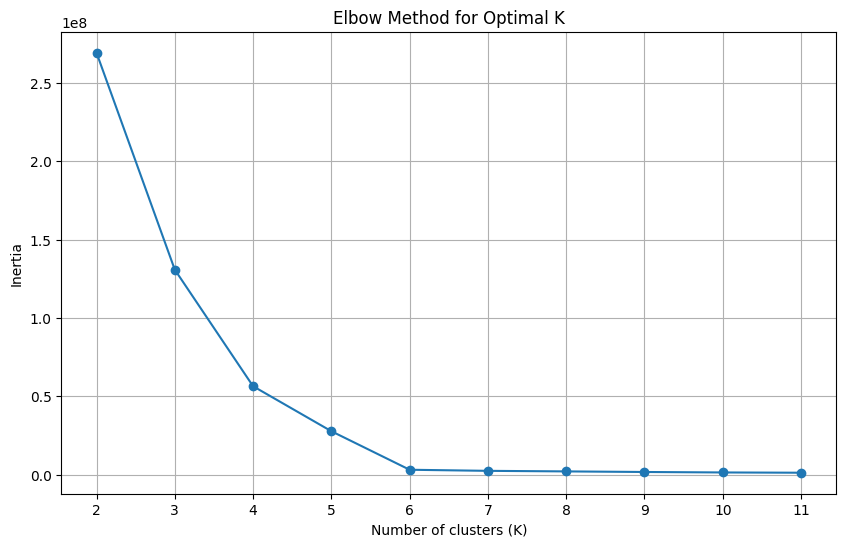

./elbow_test_export/SS-K_csv_100_69024_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000          10         3        12            1000   
1         1      10000           2         3         6              10   
2         1         10          10         6         3            1000   
3         1          2         100         1         6             100   
4         1       1000          10         6         1              10   
..      ...        ...         ...       ...       ...             ...   
795       1       1000          10         6        12              10   
796       1          1         100         1        12            1000   
797       3         10           3         2         6            1000   
798       1      10000           1         2         3             100   
799       1      10000           1         6         1            1000   

     Throughput+   Latency-  cluster  

<Figure size 640x480 with 0 Axes>

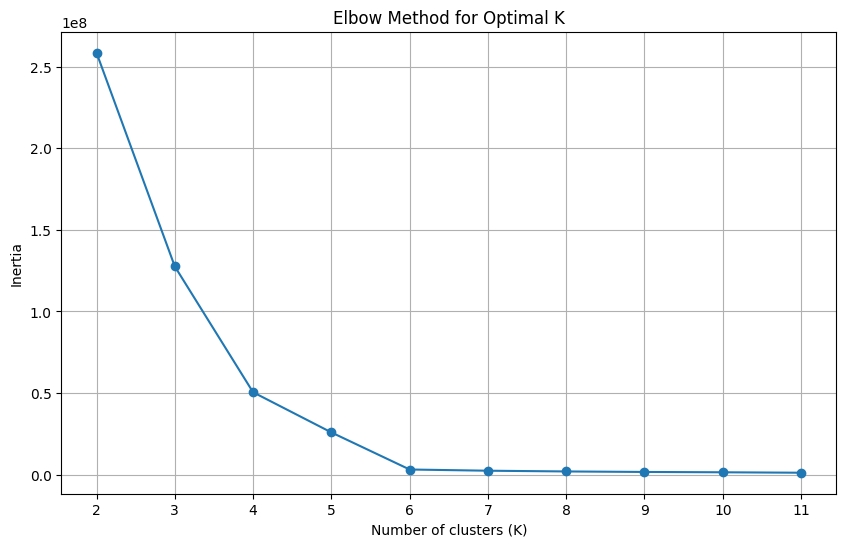

./elbow_test_export/SS-K_csv_100_70006_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3          1           3         2         3              10   
1         1         10           2         2         3            1000   
2         1        100         100         6         6             100   
3         1          2         100         2        12             100   
4         3      10000           3         1        12            1000   
..      ...        ...         ...       ...       ...             ...   
795       3        100         100         1         1              10   
796       1         10           3         3         3            1000   
797       3          2           3         6         3            1000   
798       3         10           2         2         6              10   
799       3         10          10         3         1              10   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

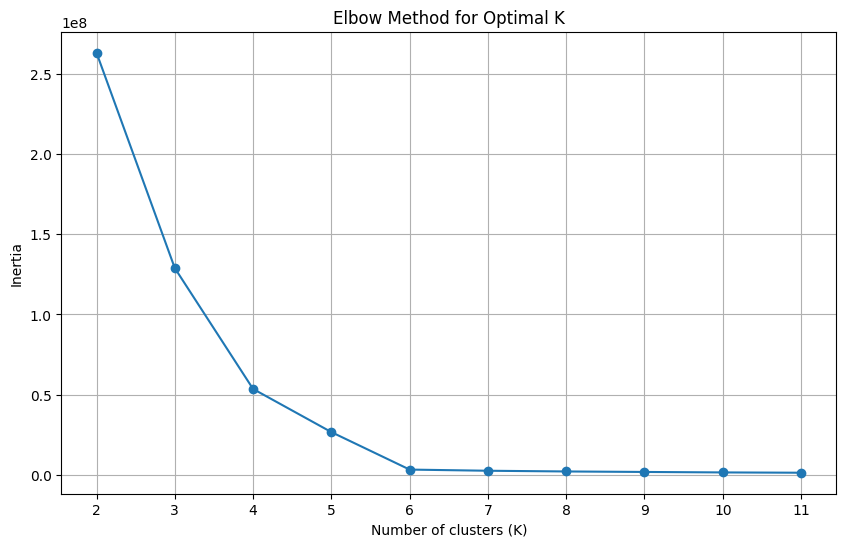

./elbow_test_export/SS-K_csv_100_70292_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3      10000          10         3         6             100   
1         1          1           2         6         3             100   
2         1       1000           2         2         6            1000   
3         1          2           2         1        12              10   
4         1          1           2         3         6              10   
..      ...        ...         ...       ...       ...             ...   
795       3          2           1         6         3             100   
796       3       1000           2         3         3              10   
797       3          2           1         2         6              10   
798       1          1           1         3         6            1000   
799       3          2         100         6         6            1000   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

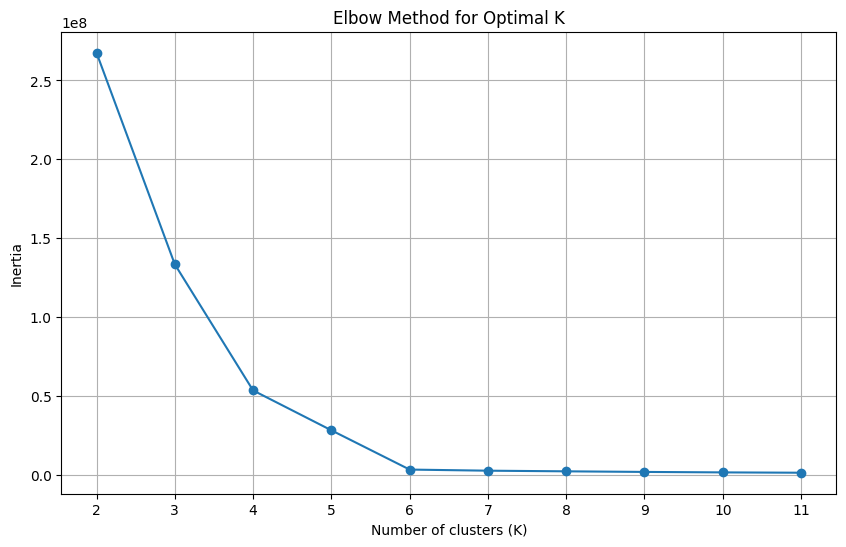

./elbow_test_export/SS-K_csv_100_77340_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3         10           1         1         1            1000   
1         3         10          10         1        12              10   
2         3      10000           1         3        12            1000   
3         3         10           2         2         3            1000   
4         3       1000         100         1         1              10   
..      ...        ...         ...       ...       ...             ...   
795       3      10000          10         2         6             100   
796       1          2           1         3         3             100   
797       1         10           1         2         3              10   
798       3         10         100         2         1            1000   
799       3       1000           2         6         1             100   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

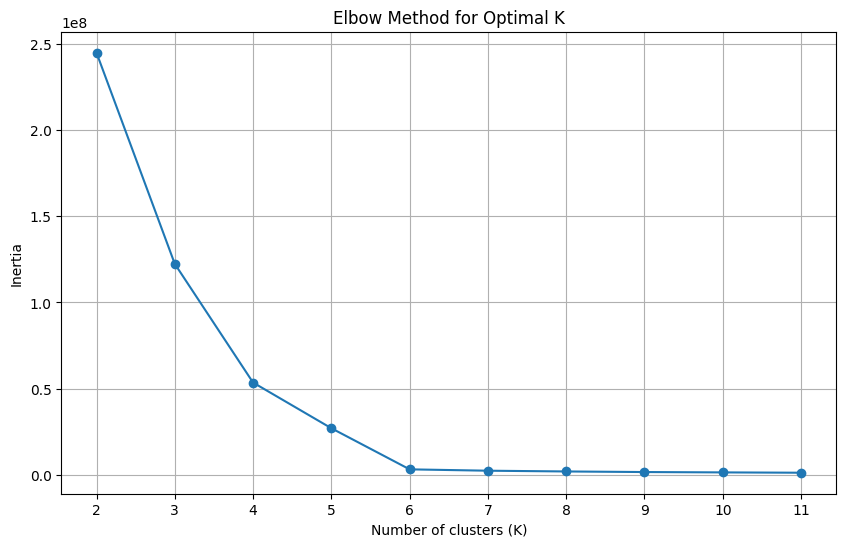

./elbow_test_export/SS-K_csv_100_77845_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1       1000           2         1         3             100   
1         3      10000           2         1         6             100   
2         3         10          10         6         1             100   
3         3         10           1         2         1              10   
4         1        100          10         1         1              10   
..      ...        ...         ...       ...       ...             ...   
795       1          2         100         3         3             100   
796       3          2           3         2         6            1000   
797       1      10000           2         3        12             100   
798       3         10         100         6         6              10   
799       3          2           1         3        12            1000   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

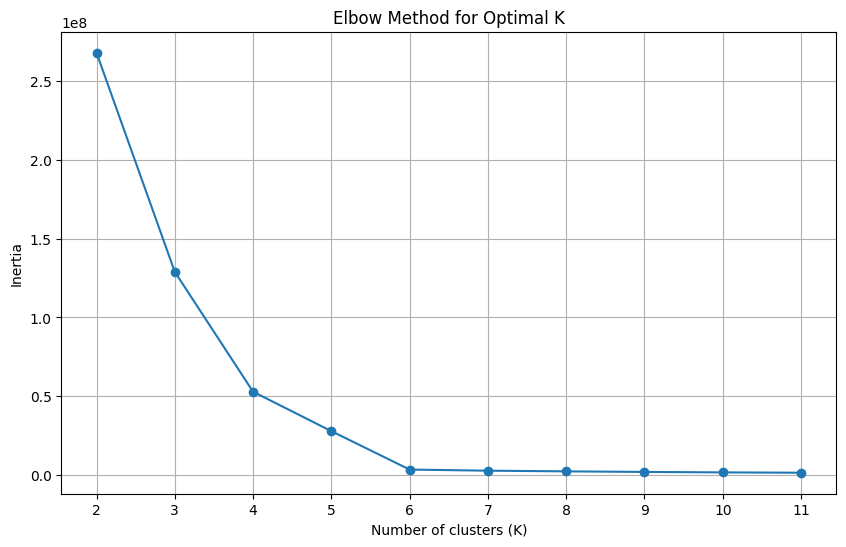

./elbow_test_export/SS-K_csv_100_83686_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1          1           1         3         1            1000   
1         3          2           1         1         3            1000   
2         3        100           3         2         6              10   
3         3          2           2         2         1            1000   
4         1       1000           2         3         3             100   
..      ...        ...         ...       ...       ...             ...   
795       1          1           1         2        12            1000   
796       3      10000           2         3        12            1000   
797       1         10           1         1         3             100   
798       3       1000           3         3         3            1000   
799       3         10         100         6         6             100   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

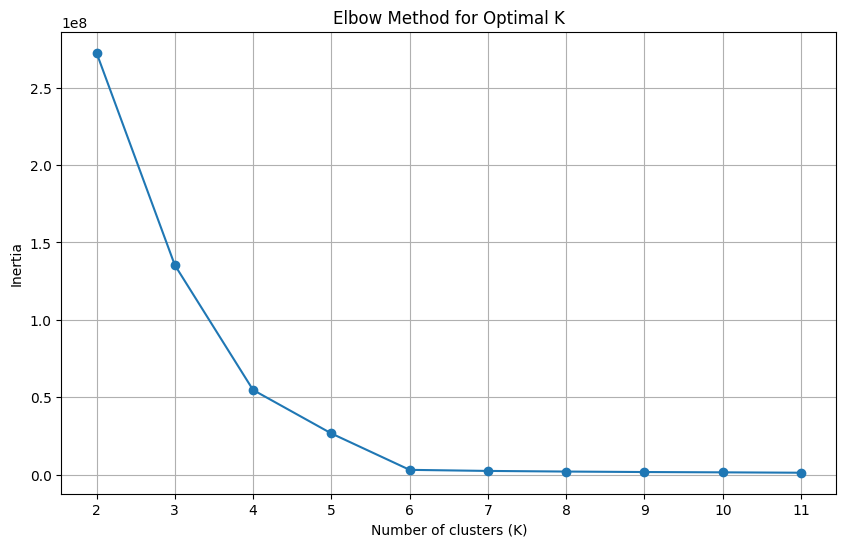

./elbow_test_export/SS-K_csv_100_84967_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000           2         2        12             100   
1         1        100          10         2         1            1000   
2         1          1          10         3         6            1000   
3         1      10000         100         6         1             100   
4         3          1           2         1         6              10   
..      ...        ...         ...       ...       ...             ...   
795       1         10           3         6         1            1000   
796       3       1000           3         2         1              10   
797       3         10           2         1         1            1000   
798       1          1           3         3         6             100   
799       1        100           2         6        12              10   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

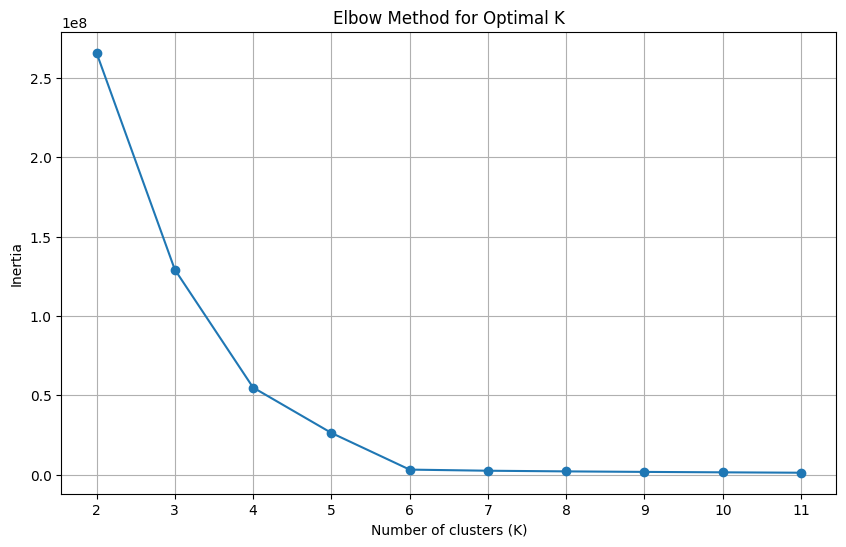

./elbow_test_export/SS-K_csv_100_86331_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3       1000           1         2         3            1000   
1         1         10          10         2         3            1000   
2         3       1000           2         1         1            1000   
3         3         10          10         1        12            1000   
4         3         10           1         2        12            1000   
..      ...        ...         ...       ...       ...             ...   
795       1        100           3         3         3              10   
796       1         10           3         1         3             100   
797       3        100         100         2        12            1000   
798       1      10000           1         2        12            1000   
799       3      10000           2         2        12              10   

     Throughput+    Latency-  cluster 

<Figure size 640x480 with 0 Axes>

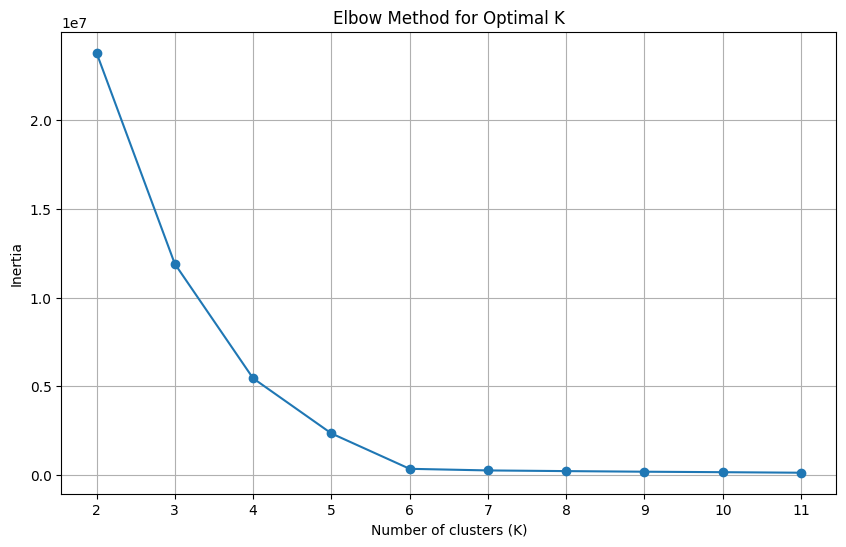

./elbow_test_export/SS-K_csv_10_11514_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        3         10          10         3        12              10   
1        1        100           2         2         3              10   
2        3        100         100         2        12             100   
3        3       1000          10         6         1            1000   
4        3      10000           2         2         1              10   
..     ...        ...         ...       ...       ...             ...   
75       1          1           1         1         6            1000   
76       3         10         100         2         6            1000   
77       1       1000           2         3         6              10   
78       3       1000         100         2         6            1000   
79       3      10000          10         1         3             100   

    Throughput+    Latency-  cluster  
0       1680

<Figure size 640x480 with 0 Axes>

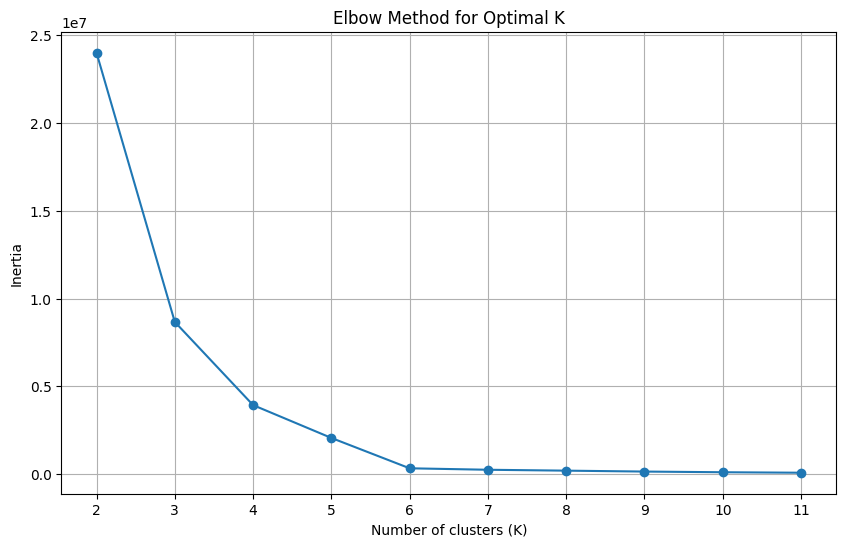

./elbow_test_export/SS-K_csv_10_19953_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1      10000         100         3         3             100   
1        1        100         100         1         1              10   
2        3          1          10         6         3            1000   
3        3          1           2         6         6              10   
4        1          2           1         1         6            1000   
..     ...        ...         ...       ...       ...             ...   
75       3          1         100         6         3             100   
76       3          1           1         6         6              10   
77       1        100           1         6        12            1000   
78       1          2         100         1        12             100   
79       3          1           1         6        12              10   

    Throughput+   Latency-  cluster  
0      16340.

<Figure size 640x480 with 0 Axes>

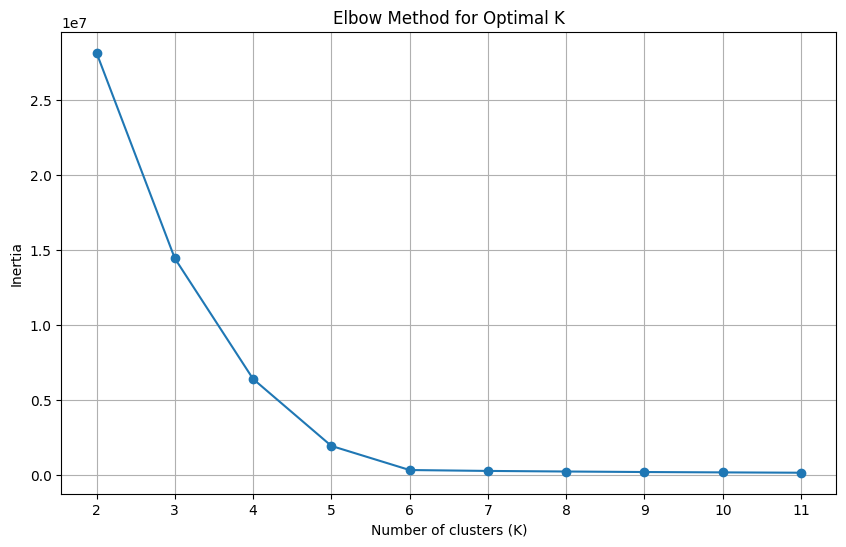

./elbow_test_export/SS-K_csv_10_3545_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1          2           1         6         6             100   
1        1      10000           3         3         6             100   
2        3      10000          10         1         1            1000   
3        3          2           2         1         3              10   
4        1        100           1         6         6             100   
..     ...        ...         ...       ...       ...             ...   
75       1        100           1         6         1              10   
76       3          2          10         2         1             100   
77       1      10000         100         6        12              10   
78       3       1000           3         6        12            1000   
79       1      10000           1         1         3              10   

    Throughput+    Latency-  cluster  
0        4893

<Figure size 640x480 with 0 Axes>

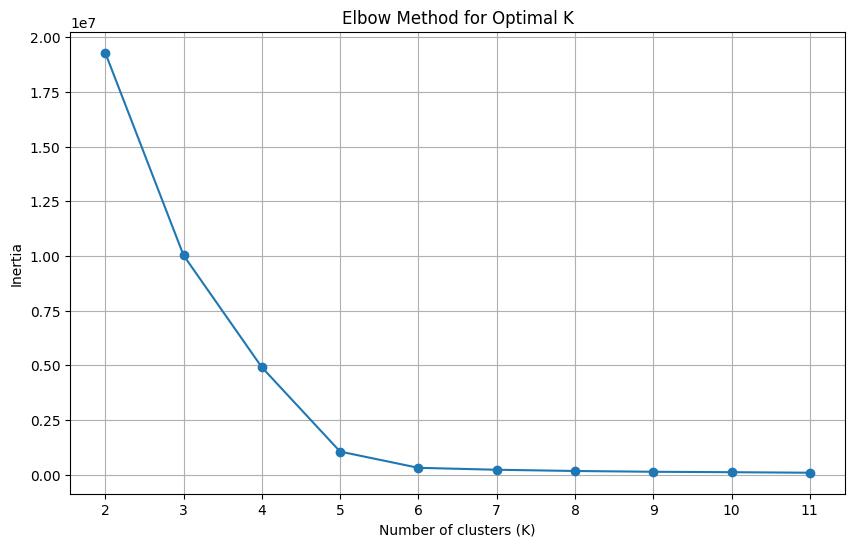

./elbow_test_export/SS-K_csv_10_39658_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1          2         100         6        12            1000   
1        1        100           3         1         6             100   
2        3          2           2         3         3             100   
3        1        100          10         3         6              10   
4        3       1000           1         3         6            1000   
..     ...        ...         ...       ...       ...             ...   
75       3          2           1         6         6              10   
76       1          1         100         3         6             100   
77       3      10000           1         2         6              10   
78       1          2           2         6         6              10   
79       1        100           2         1        12              10   

    Throughput+    Latency-  cluster  
0       201.

<Figure size 640x480 with 0 Axes>

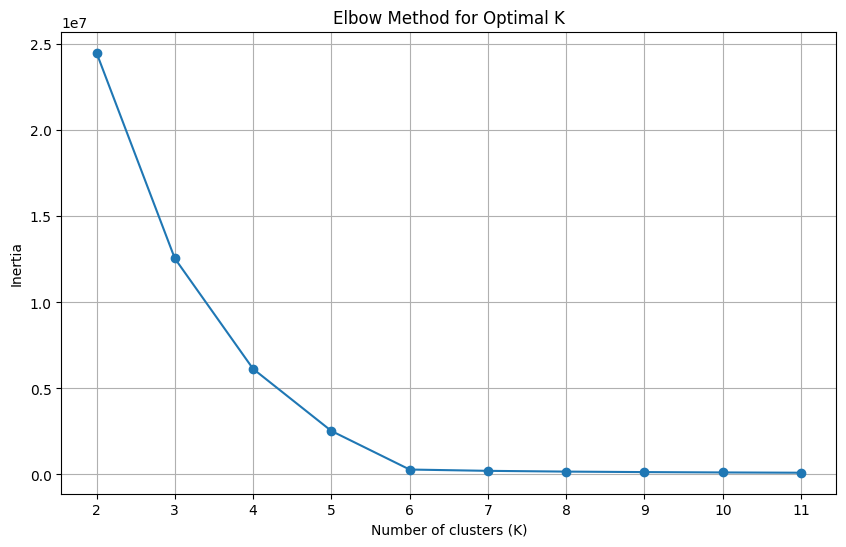

./elbow_test_export/SS-K_csv_10_40749_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        3          2          10         2         3             100   
1        3          1           3         2         6             100   
2        1       1000           1         2        12             100   
3        3        100         100         3         6              10   
4        3          1          10         2         3            1000   
..     ...        ...         ...       ...       ...             ...   
75       1         10           3         2         6            1000   
76       1          2           2         2         1              10   
77       1        100         100         2         6             100   
78       1      10000         100         3        12            1000   
79       1       1000           3         1         6            1000   

    Throughput+   Latency-  cluster  
0        5128

<Figure size 640x480 with 0 Axes>

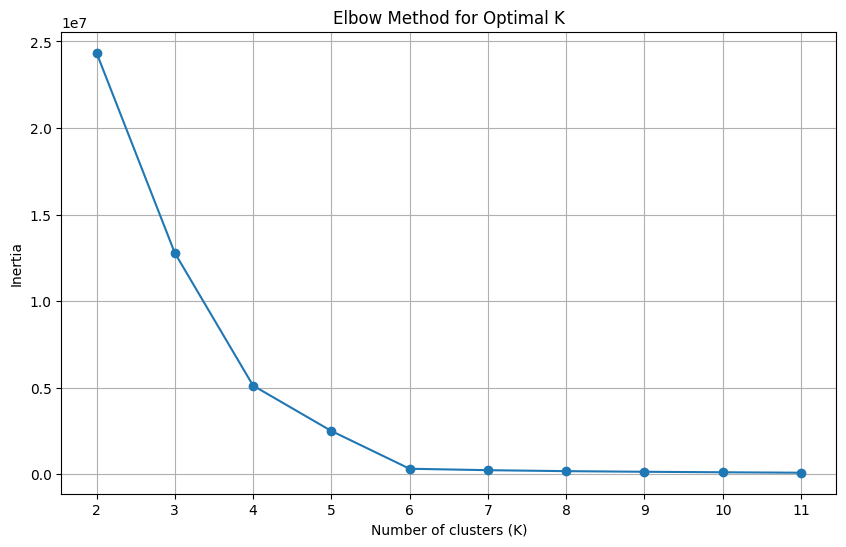

./elbow_test_export/SS-K_csv_10_44845_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1      10000           1         2        12             100   
1        1       1000          10         6         3             100   
2        1        100           2         1         6            1000   
3        3        100           2         1        12            1000   
4        1          1           3         2         3             100   
..     ...        ...         ...       ...       ...             ...   
75       3          1         100         3         3             100   
76       3          1           1         1         3              10   
77       1          2          10         3         3             100   
78       3          2          10         3         3             100   
79       3       1000          10         1        12             100   

    Throughput+   Latency-  cluster  
0      26472.

<Figure size 640x480 with 0 Axes>

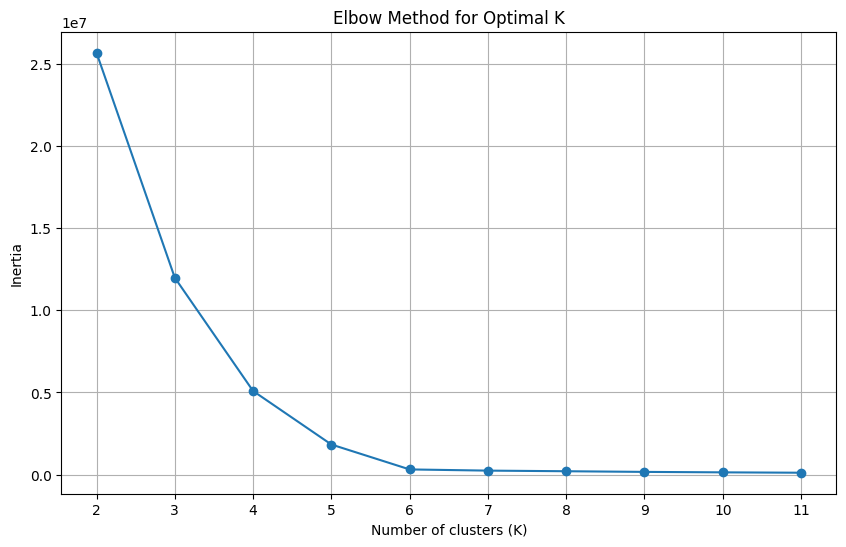

./elbow_test_export/SS-K_csv_10_51176_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1      10000         100         6         3             100   
1        3         10           1         3         6            1000   
2        1          2          10         1         1              10   
3        3         10           2         3         6             100   
4        3      10000           3         3        12             100   
..     ...        ...         ...       ...       ...             ...   
75       1         10           1         2         1            1000   
76       1        100           3         3         1             100   
77       1       1000           3         6         3              10   
78       3       1000           1         3        12             100   
79       3          2           3         6         1            1000   

    Throughput+    Latency-  cluster  
0       2588

<Figure size 640x480 with 0 Axes>

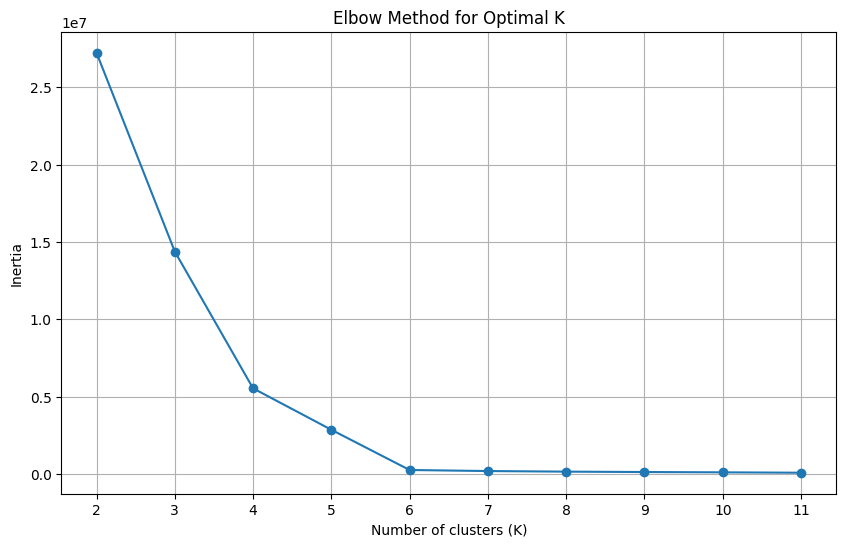

./elbow_test_export/SS-K_csv_10_58612_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1        100           1         6         1            1000   
1        3       1000           2         6         1              10   
2        1          1          10         2        12              10   
3        1        100           2         1         3              10   
4        1          1         100         6         1             100   
..     ...        ...         ...       ...       ...             ...   
75       1      10000           1         3         3             100   
76       3       1000           3         2         3             100   
77       1          1           1         3         1              10   
78       1         10          10         1         1              10   
79       1      10000           2         6         6              10   

    Throughput+    Latency-  cluster  
0       8520

<Figure size 640x480 with 0 Axes>

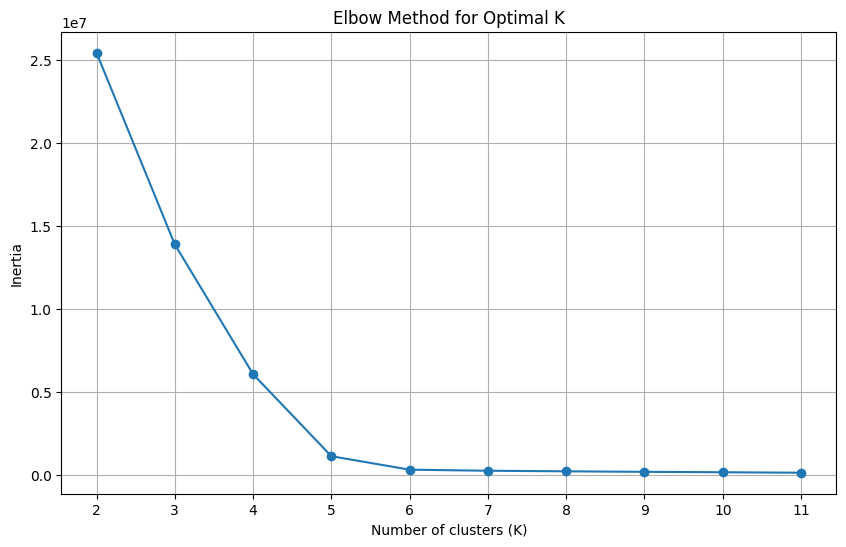

./elbow_test_export/SS-K_csv_10_61367_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1      10000         100         6         3            1000   
1        3          2           2         3         6            1000   
2        1      10000           1         6        12            1000   
3        1         10           3         1         3            1000   
4        3      10000         100         3        12              10   
..     ...        ...         ...       ...       ...             ...   
75       3      10000         100         1         6            1000   
76       3       1000           3         6         1              10   
77       1      10000         100         2         6             100   
78       1          1           2         6         3            1000   
79       1       1000         100         6         6             100   

    Throughput+    Latency-  cluster  
0       2374

<Figure size 640x480 with 0 Axes>

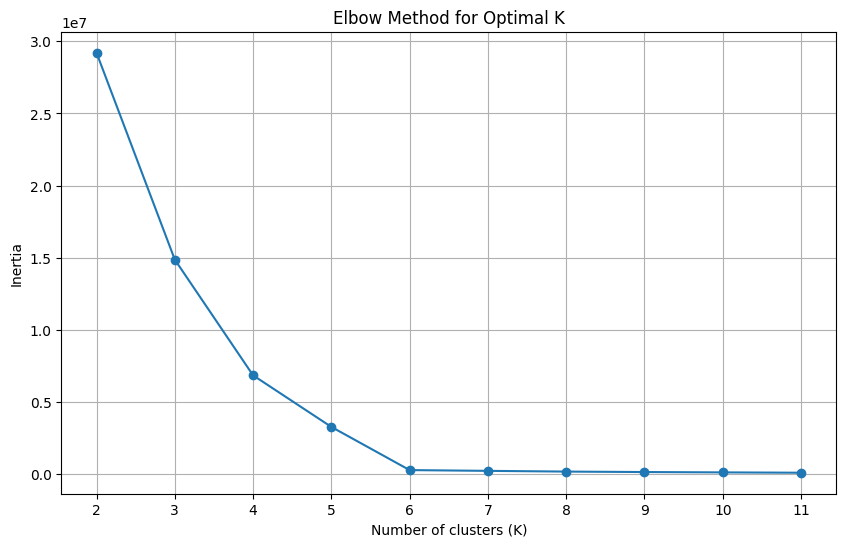

./elbow_test_export/SS-K_csv_10_65388_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1          2          10         2         3            1000   
1        3       1000           2         1         6              10   
2        1       1000           2         3         3            1000   
3        3      10000          10         2         1            1000   
4        3       1000           3         3        12            1000   
..     ...        ...         ...       ...       ...             ...   
75       3      10000           1         2         1              10   
76       1          1           2         3        12            1000   
77       1         10           2         3        12             100   
78       1       1000           3         1        12            1000   
79       1      10000         100         1        12             100   

    Throughput+    Latency-  cluster  
0        185

<Figure size 640x480 with 0 Axes>

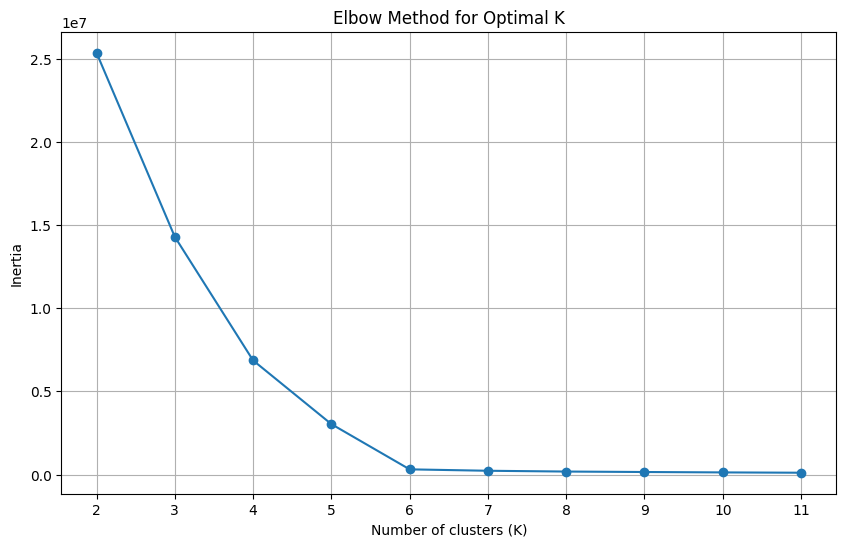

./elbow_test_export/SS-K_csv_10_65444_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        3          1         100         1         1            1000   
1        3      10000         100         2         1             100   
2        3      10000           1         6        12             100   
3        3      10000         100         2         6             100   
4        3         10           1         3         1             100   
..     ...        ...         ...       ...       ...             ...   
75       3          1          10         2         3              10   
76       1          1           3         6         1             100   
77       1          1           3         1        12              10   
78       1          1         100         1         3            1000   
79       1        100         100         1         3             100   

    Throughput+    Latency-  cluster  
0       283.

<Figure size 640x480 with 0 Axes>

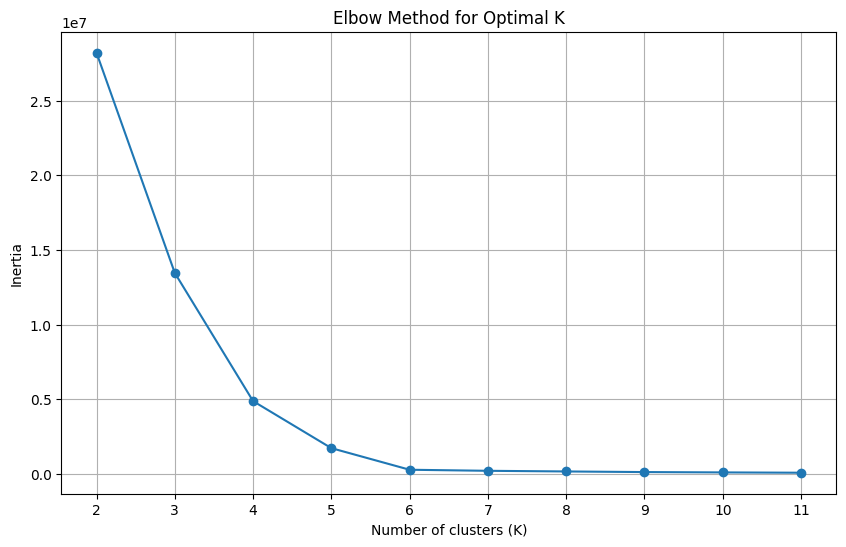

./elbow_test_export/SS-K_csv_10_66946_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        3      10000         100         1        12              10   
1        1          2           3         1         3            1000   
2        1          1          10         3         1            1000   
3        1          2           3         6         3            1000   
4        1      10000          10         2         3             100   
..     ...        ...         ...       ...       ...             ...   
75       3          1           2         1         6             100   
76       1          2         100         6         1            1000   
77       1          1         100         1        12              10   
78       3      10000         100         3         3            1000   
79       3         10           3         2         3             100   

    Throughput+    Latency-  cluster  
0       6211

<Figure size 640x480 with 0 Axes>

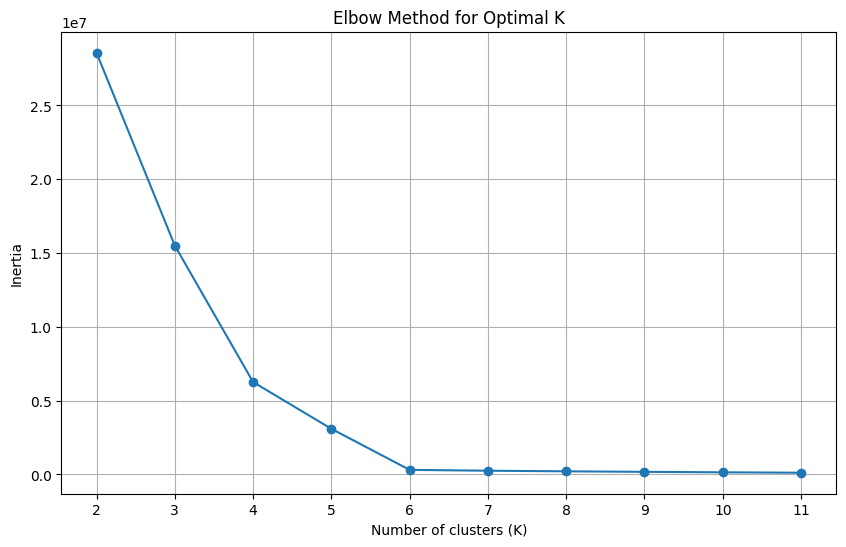

./elbow_test_export/SS-K_csv_10_69024_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1      10000          10         3        12            1000   
1        1      10000           2         3         6              10   
2        1         10          10         6         3            1000   
3        1          2         100         1         6             100   
4        1       1000          10         6         1              10   
..     ...        ...         ...       ...       ...             ...   
75       1          2           3         3        12             100   
76       3       1000           2         1         1             100   
77       3          1         100         6         6              10   
78       1         10          10         6        12              10   
79       1          2          10         3         6            1000   

    Throughput+   Latency-  cluster  
0      17535.

<Figure size 640x480 with 0 Axes>

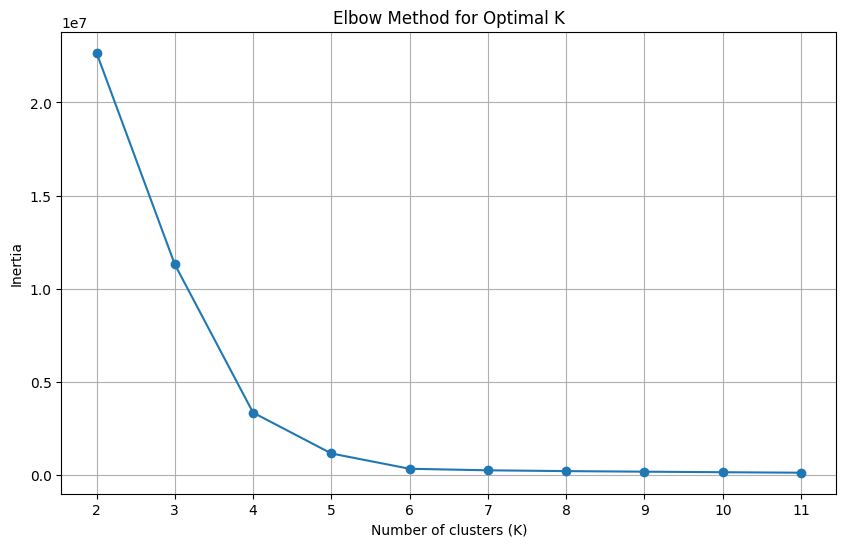

./elbow_test_export/SS-K_csv_10_70006_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        3          1           3         2         3              10   
1        1         10           2         2         3            1000   
2        1        100         100         6         6             100   
3        1          2         100         2        12             100   
4        3      10000           3         1        12            1000   
..     ...        ...         ...       ...       ...             ...   
75       1       1000           2         3         1             100   
76       1        100          10         6        12             100   
77       3         10          10         1        12            1000   
78       1         10           1         6         6             100   
79       1          2           3         2         3              10   

    Throughput+    Latency-  cluster  
0       5249

<Figure size 640x480 with 0 Axes>

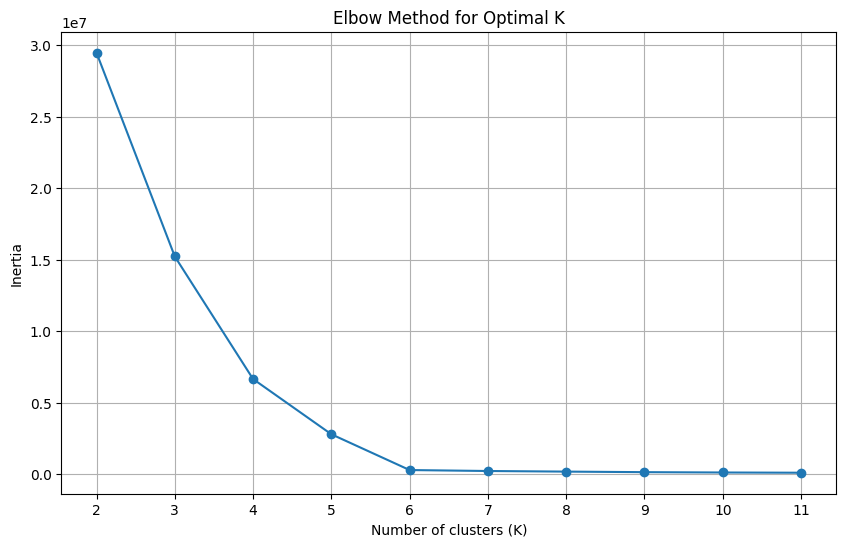

./elbow_test_export/SS-K_csv_10_70292_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        3      10000          10         3         6             100   
1        1          1           2         6         3             100   
2        1       1000           2         2         6            1000   
3        1          2           2         1        12              10   
4        1          1           2         3         6              10   
..     ...        ...         ...       ...       ...             ...   
75       1       1000          10         6         6            1000   
76       3          2           3         3        12             100   
77       3         10          10         3         6            1000   
78       1          2           2         3         1              10   
79       3          1          10         1        12            1000   

    Throughput+    Latency-  cluster  
0       1194

<Figure size 640x480 with 0 Axes>

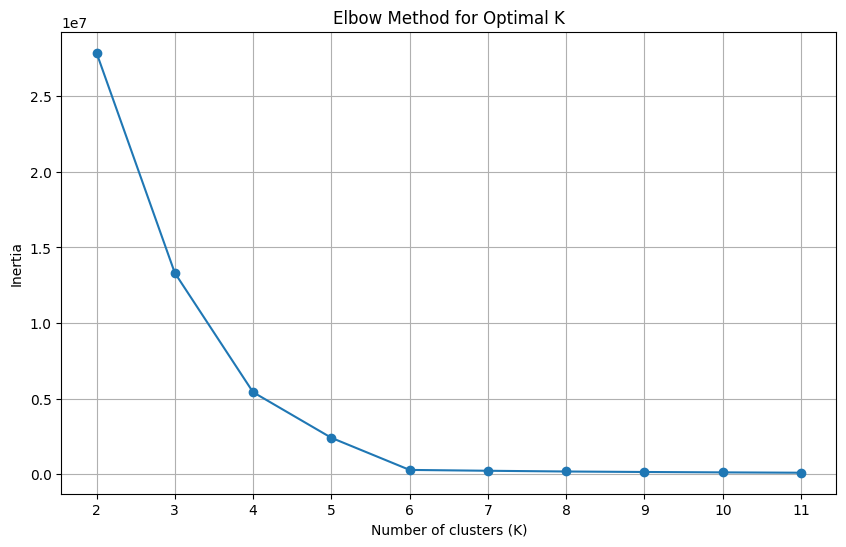

./elbow_test_export/SS-K_csv_10_77340_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        3         10           1         1         1            1000   
1        3         10          10         1        12              10   
2        3      10000           1         3        12            1000   
3        3         10           2         2         3            1000   
4        3       1000         100         1         1              10   
..     ...        ...         ...       ...       ...             ...   
75       3      10000          10         1        12            1000   
76       1         10           1         2         3            1000   
77       3         10         100         1         3             100   
78       1         10           2         3         6            1000   
79       1       1000           1         1         6             100   

    Throughput+    Latency-  cluster  
0        752

<Figure size 640x480 with 0 Axes>

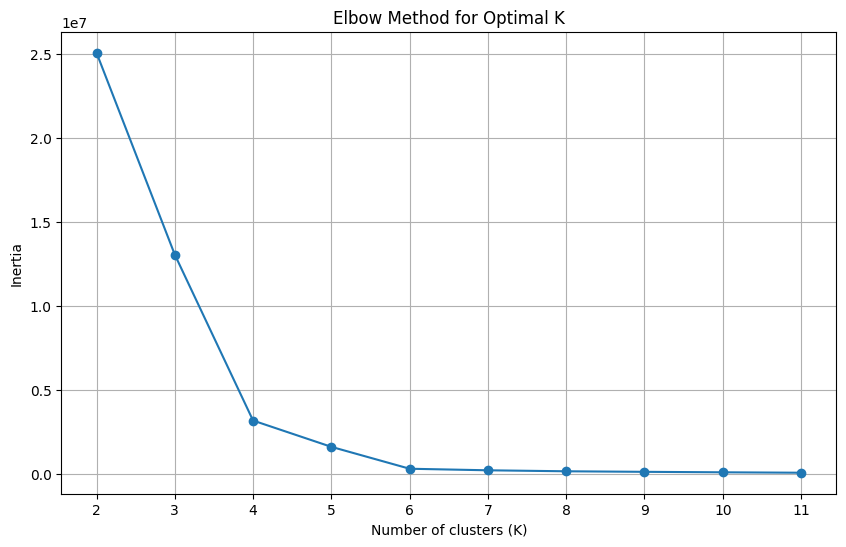

./elbow_test_export/SS-K_csv_10_77845_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1       1000           2         1         3             100   
1        3      10000           2         1         6             100   
2        3         10          10         6         1             100   
3        3         10           1         2         1              10   
4        1        100          10         1         1              10   
..     ...        ...         ...       ...       ...             ...   
75       3          2           1         2         1              10   
76       3         10           2         6         6              10   
77       1        100           1         1        12              10   
78       3       1000         100         3         1            1000   
79       1       1000           3         3         6              10   

    Throughput+    Latency-  cluster  
0       1447

<Figure size 640x480 with 0 Axes>

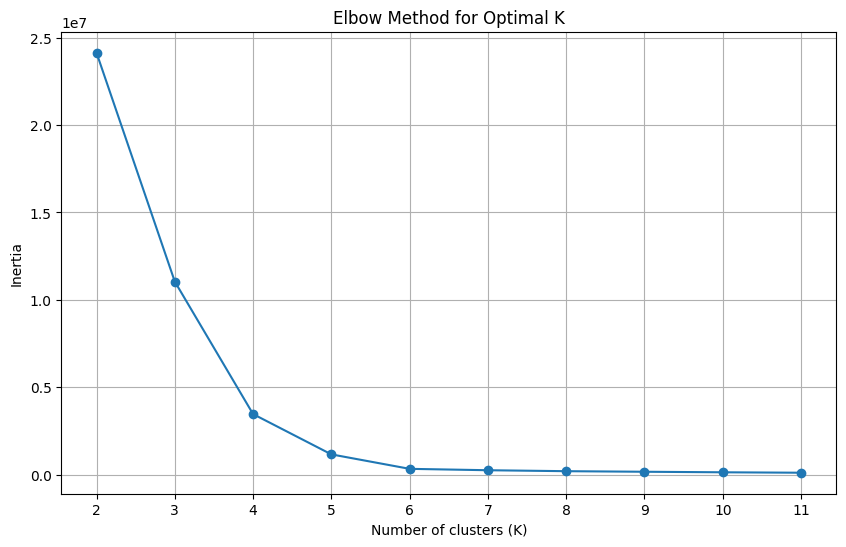

./elbow_test_export/SS-K_csv_10_83686_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1          1           1         3         1            1000   
1        3          2           1         1         3            1000   
2        3        100           3         2         6              10   
3        3          2           2         2         1            1000   
4        1       1000           2         3         3             100   
..     ...        ...         ...       ...       ...             ...   
75       1         10           1         1         1             100   
76       1          2          10         2        12            1000   
77       3         10          10         1         1              10   
78       1          1          10         2         6              10   
79       1        100           2         1         6              10   

    Throughput+  Latency-  cluster  
0       2780.9

<Figure size 640x480 with 0 Axes>

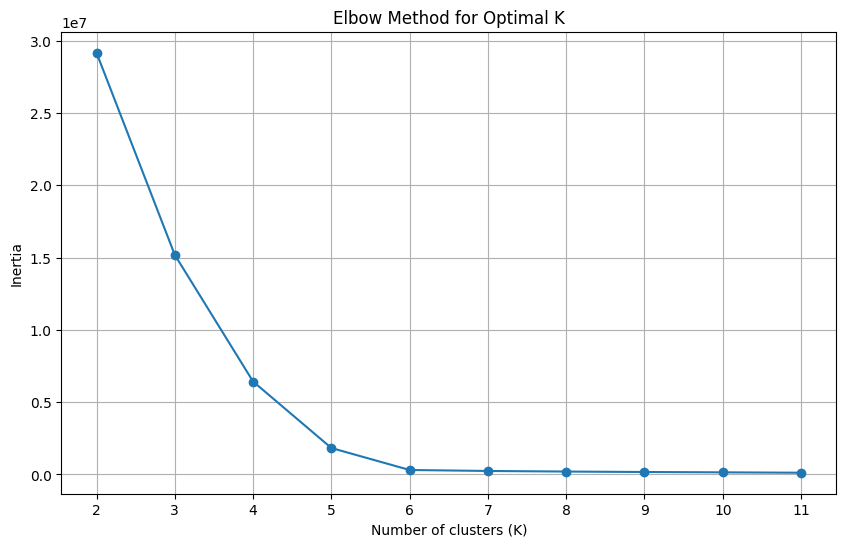

./elbow_test_export/SS-K_csv_10_84967_elbow_test.png
Optimal k value: 5
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        1      10000           2         2        12             100   
1        1        100          10         2         1            1000   
2        1          1          10         3         6            1000   
3        1      10000         100         6         1             100   
4        3          1           2         1         6              10   
..     ...        ...         ...       ...       ...             ...   
75       3          2         100         2         6             100   
76       1        100           1         3         3            1000   
77       1      10000           3         6         3              10   
78       3        100           3         1         1            1000   
79       1         10         100         3         1              10   

    Throughput+    Latency-  cluster  
0      32175

<Figure size 640x480 with 0 Axes>

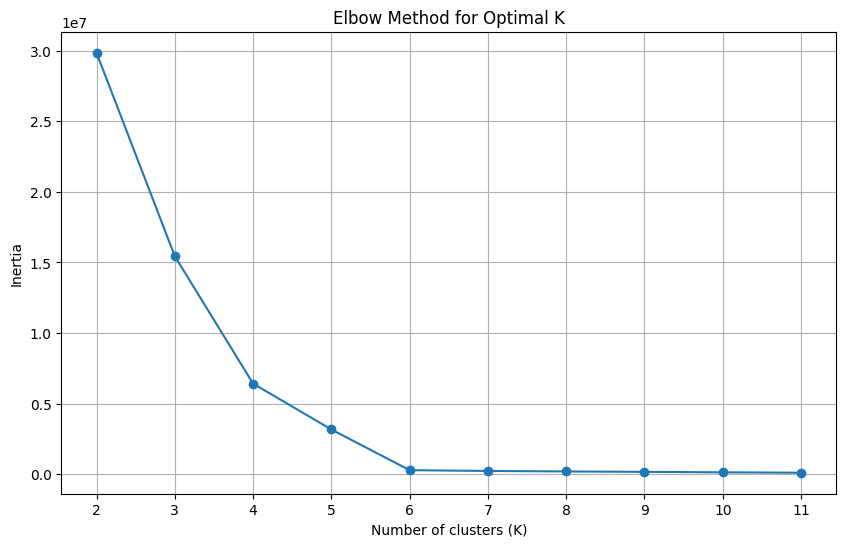

./elbow_test_export/SS-K_csv_10_86331_elbow_test.png
Optimal k value: 4
    Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0        3       1000           1         2         3            1000   
1        1         10          10         2         3            1000   
2        3       1000           2         1         1            1000   
3        3         10          10         1        12            1000   
4        3         10           1         2        12            1000   
..     ...        ...         ...       ...       ...             ...   
75       1        100         100         3         1              10   
76       3          1         100         2         6            1000   
77       1          1         100         6         1              10   
78       1        100           1         3         6              10   
79       3         10          10         2         1             100   

    Throughput+  Latency-  cluster  
0     12534.00

<Figure size 640x480 with 0 Axes>

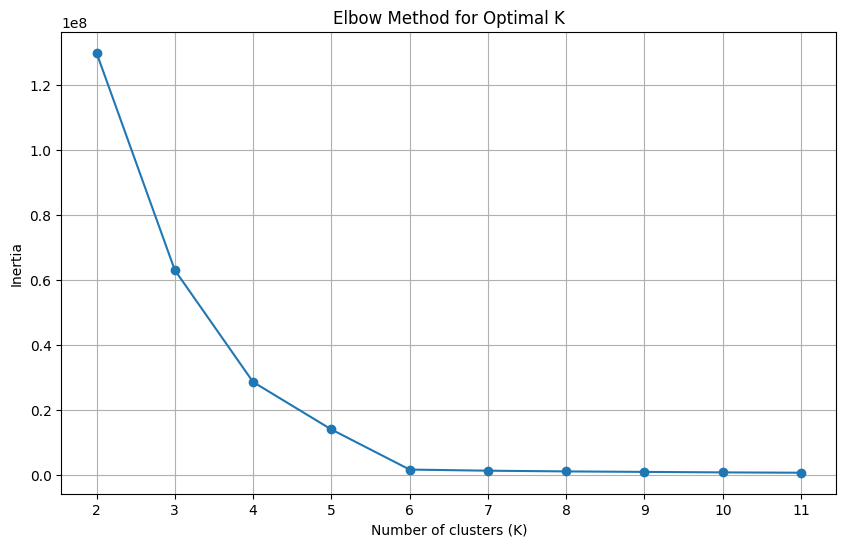

./elbow_test_export/SS-K_csv_50_11514_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3         10          10         3        12              10   
1         1        100           2         2         3              10   
2         3        100         100         2        12             100   
3         3       1000          10         6         1            1000   
4         3      10000           2         2         1              10   
..      ...        ...         ...       ...       ...             ...   
395       1        100           1         1         6             100   
396       3       1000           2         1         1              10   
397       3         10           1         1         3             100   
398       3          1           3         3         3            1000   
399       1          2          10         1         1            1000   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

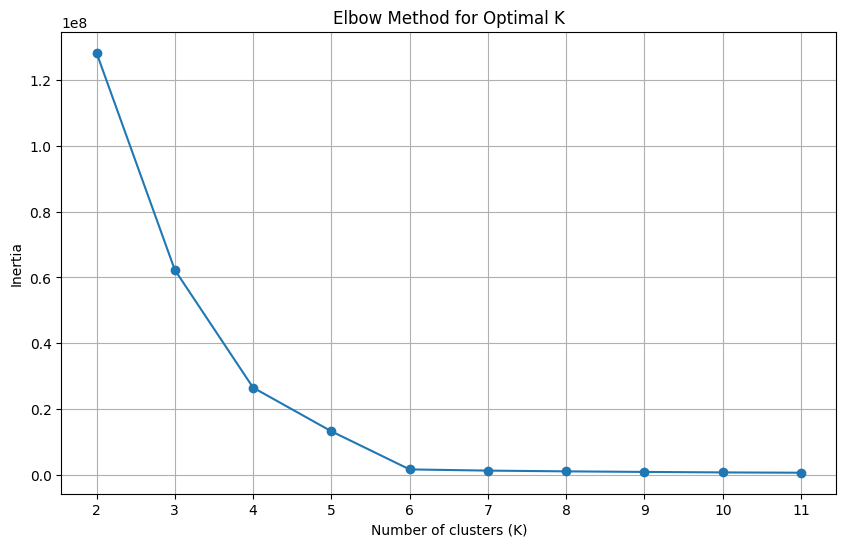

./elbow_test_export/SS-K_csv_50_19953_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000         100         3         3             100   
1         1        100         100         1         1              10   
2         3          1          10         6         3            1000   
3         3          1           2         6         6              10   
4         1          2           1         1         6            1000   
..      ...        ...         ...       ...       ...             ...   
395       3       1000           2         6         1              10   
396       1        100         100         2         3              10   
397       1         10           1         3        12              10   
398       3          2           3         3        12              10   
399       1       1000           2         1         6             100   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

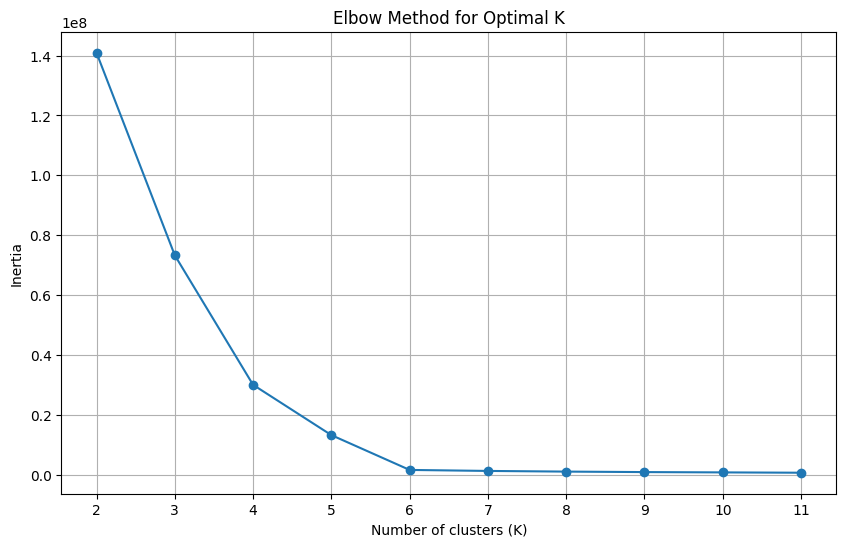

./elbow_test_export/SS-K_csv_50_3545_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1          2           1         6         6             100   
1         1      10000           3         3         6             100   
2         3      10000          10         1         1            1000   
3         3          2           2         1         3              10   
4         1        100           1         6         6             100   
..      ...        ...         ...       ...       ...             ...   
395       3         10           2         2         3             100   
396       3        100           2         1        12              10   
397       1          1           2         3        12            1000   
398       1          1           1         6         1              10   
399       3          1           1         6         3            1000   

     Throughput+    Latency-  cluster  


<Figure size 640x480 with 0 Axes>

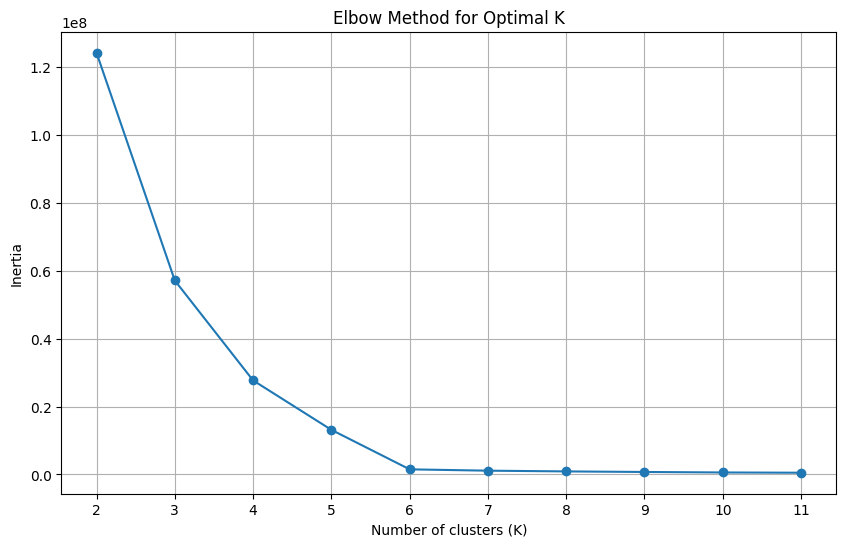

./elbow_test_export/SS-K_csv_50_39658_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1          2         100         6        12            1000   
1         1        100           3         1         6             100   
2         3          2           2         3         3             100   
3         1        100          10         3         6              10   
4         3       1000           1         3         6            1000   
..      ...        ...         ...       ...       ...             ...   
395       3          1         100         2        12            1000   
396       1        100         100         2         3              10   
397       1         10           3         6         3            1000   
398       3        100          10         1         6            1000   
399       1       1000          10         3         3              10   

     Throughput+   Latency-  cluster  


<Figure size 640x480 with 0 Axes>

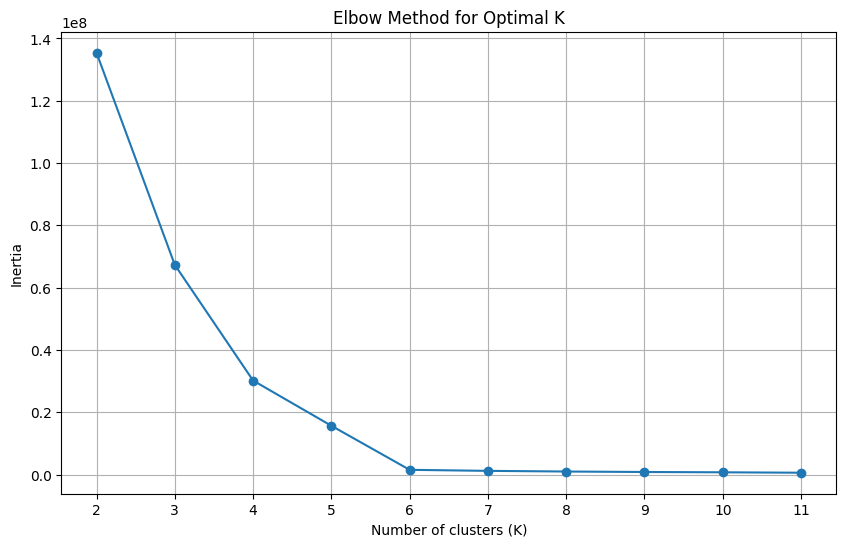

./elbow_test_export/SS-K_csv_50_40749_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3          2          10         2         3             100   
1         3          1           3         2         6             100   
2         1       1000           1         2        12             100   
3         3        100         100         3         6              10   
4         3          1          10         2         3            1000   
..      ...        ...         ...       ...       ...             ...   
395       3         10          10         6         6             100   
396       1          1         100         1        12            1000   
397       1         10           3         3        12              10   
398       3          1          10         6         6             100   
399       3          2         100         6         1              10   

     Throughput+  Latency-  cluster  
0

<Figure size 640x480 with 0 Axes>

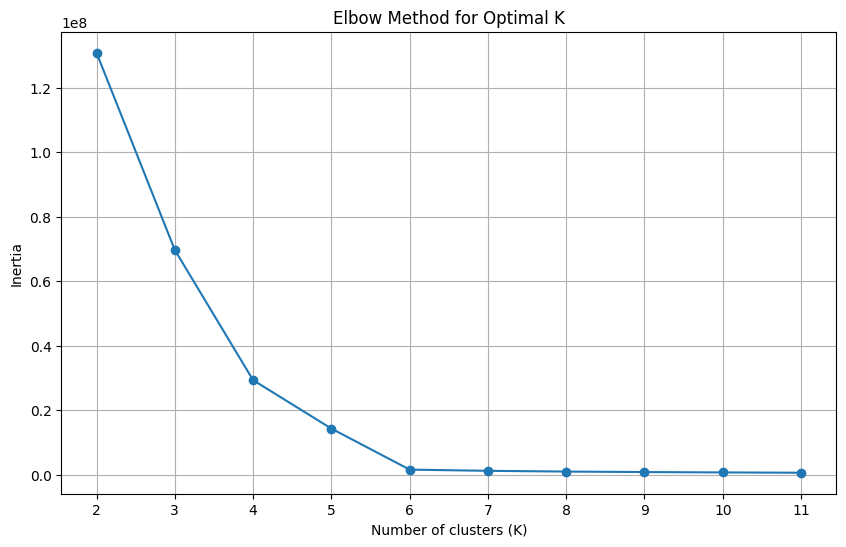

./elbow_test_export/SS-K_csv_50_44845_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000           1         2        12             100   
1         1       1000          10         6         3             100   
2         1        100           2         1         6            1000   
3         3        100           2         1        12            1000   
4         1          1           3         2         3             100   
..      ...        ...         ...       ...       ...             ...   
395       1         10          10         6         3              10   
396       3          1           3         3         6              10   
397       3          2         100         6         6              10   
398       3          2           2         2         3              10   
399       1      10000          10         1         1            1000   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

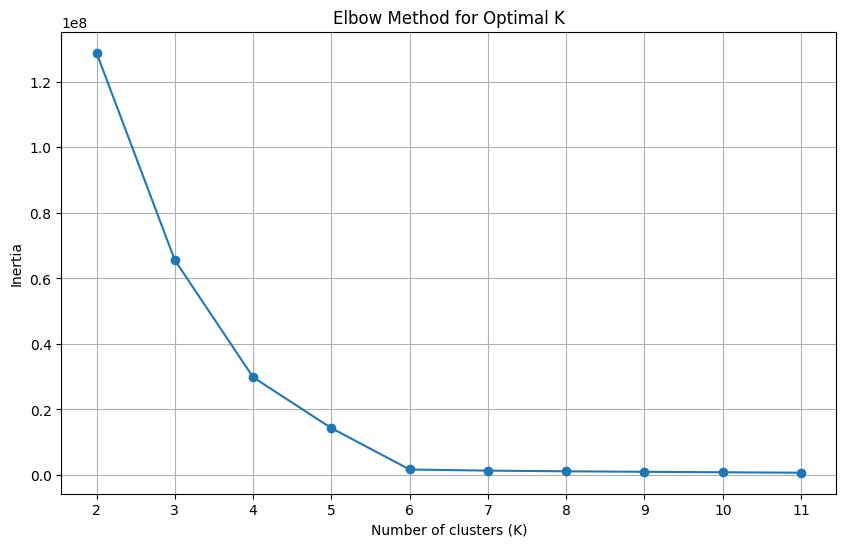

./elbow_test_export/SS-K_csv_50_51176_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000         100         6         3             100   
1         3         10           1         3         6            1000   
2         1          2          10         1         1              10   
3         3         10           2         3         6             100   
4         3      10000           3         3        12             100   
..      ...        ...         ...       ...       ...             ...   
395       1          2         100         1         3             100   
396       3        100         100         6         3              10   
397       3         10           1         2         3              10   
398       1       1000          10         1        12            1000   
399       1        100           2         1        12             100   

     Throughput+   Latency-  cluster  


<Figure size 640x480 with 0 Axes>

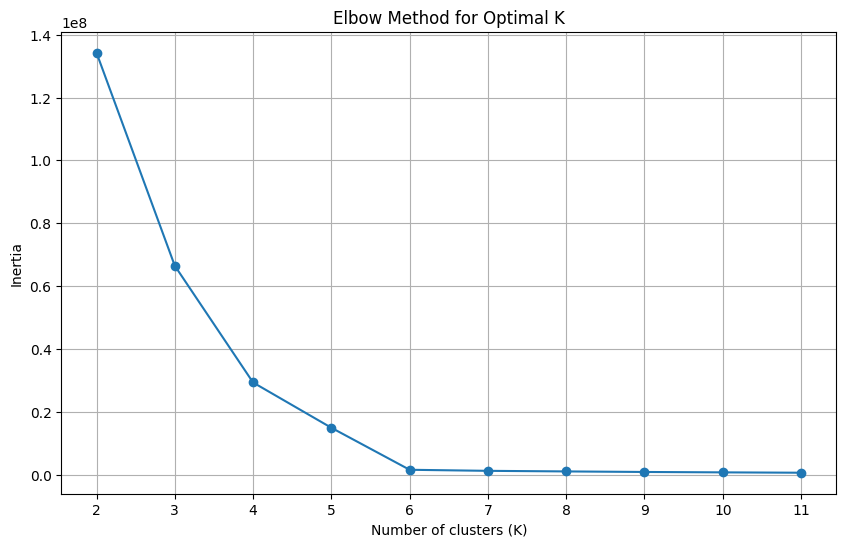

./elbow_test_export/SS-K_csv_50_58612_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1        100           1         6         1            1000   
1         3       1000           2         6         1              10   
2         1          1          10         2        12              10   
3         1        100           2         1         3              10   
4         1          1         100         6         1             100   
..      ...        ...         ...       ...       ...             ...   
395       1          2         100         1         6             100   
396       1          2         100         3         1             100   
397       1       1000           3         1         1            1000   
398       3          1           1         6        12              10   
399       3         10           2         6         3              10   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

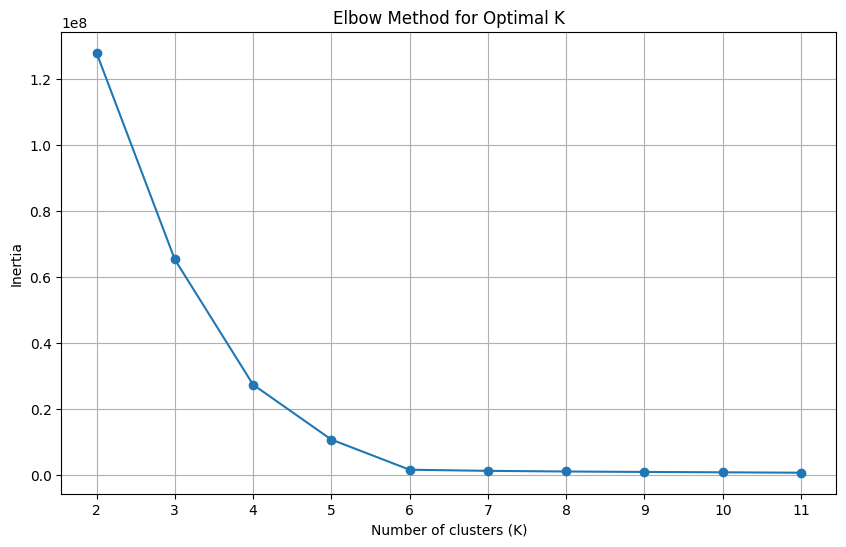

./elbow_test_export/SS-K_csv_50_61367_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000         100         6         3            1000   
1         3          2           2         3         6            1000   
2         1      10000           1         6        12            1000   
3         1         10           3         1         3            1000   
4         3      10000         100         3        12              10   
..      ...        ...         ...       ...       ...             ...   
395       1          2           1         2         6            1000   
396       1          1           2         6        12            1000   
397       3          2           1         6        12             100   
398       3         10           2         2        12            1000   
399       1       1000           3         6         6             100   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

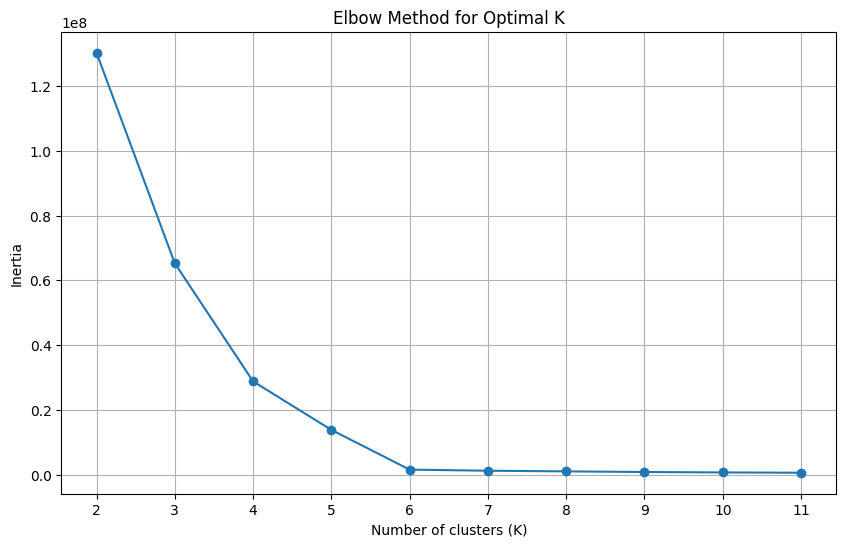

./elbow_test_export/SS-K_csv_50_65388_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1          2          10         2         3            1000   
1         3       1000           2         1         6              10   
2         1       1000           2         3         3            1000   
3         3      10000          10         2         1            1000   
4         3       1000           3         3        12            1000   
..      ...        ...         ...       ...       ...             ...   
395       1        100          10         3        12              10   
396       3      10000          10         2         1              10   
397       1      10000           1         3         6             100   
398       1        100           1         1         1            1000   
399       3          1           2         2         3             100   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

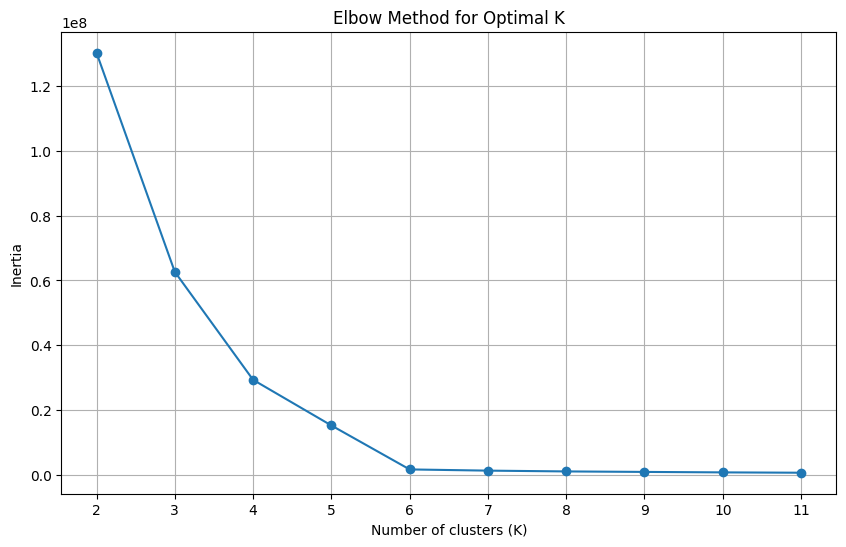

./elbow_test_export/SS-K_csv_50_65444_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3          1         100         1         1            1000   
1         3      10000         100         2         1             100   
2         3      10000           1         6        12             100   
3         3      10000         100         2         6             100   
4         3         10           1         3         1             100   
..      ...        ...         ...       ...       ...             ...   
395       1       1000         100         6         6            1000   
396       1       1000          10         6        12            1000   
397       1      10000           2         1         3            1000   
398       3        100         100         1         6             100   
399       3       1000           3         6         6              10   

     Throughput+   Latency-  cluster  


<Figure size 640x480 with 0 Axes>

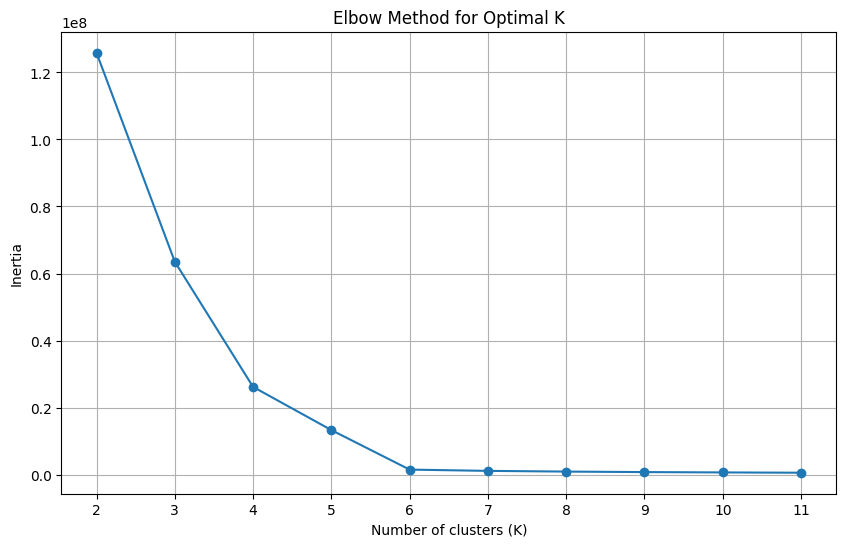

./elbow_test_export/SS-K_csv_50_66946_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3      10000         100         1        12              10   
1         1          2           3         1         3            1000   
2         1          1          10         3         1            1000   
3         1          2           3         6         3            1000   
4         1      10000          10         2         3             100   
..      ...        ...         ...       ...       ...             ...   
395       3       1000           3         3         3              10   
396       3          2           1         3         6             100   
397       3      10000           2         2        12             100   
398       1          1          10         1         6              10   
399       3        100           2         1         6             100   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

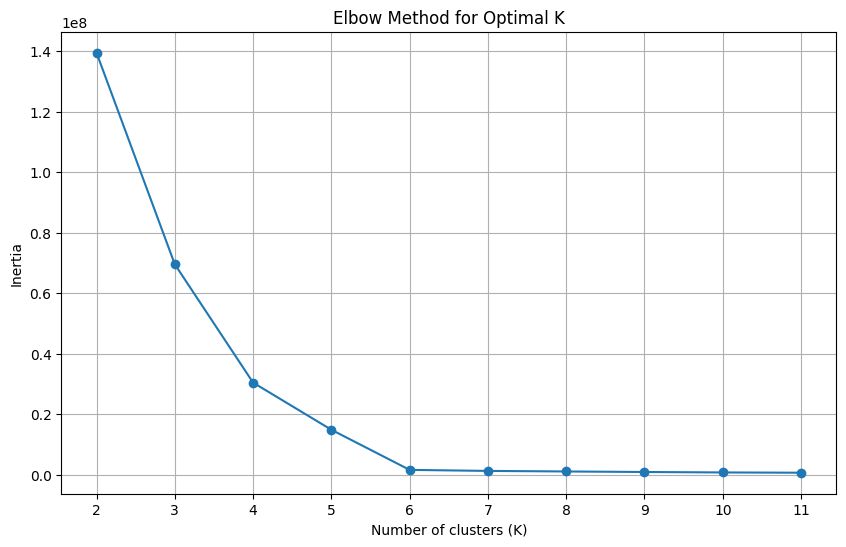

./elbow_test_export/SS-K_csv_50_69024_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000          10         3        12            1000   
1         1      10000           2         3         6              10   
2         1         10          10         6         3            1000   
3         1          2         100         1         6             100   
4         1       1000          10         6         1              10   
..      ...        ...         ...       ...       ...             ...   
395       1        100           2         6         3            1000   
396       3        100         100         3         1             100   
397       3          1          10         3         6              10   
398       3       1000         100         1         6             100   
399       1      10000          10         6         1             100   

     Throughput+   Latency-  cluster  


<Figure size 640x480 with 0 Axes>

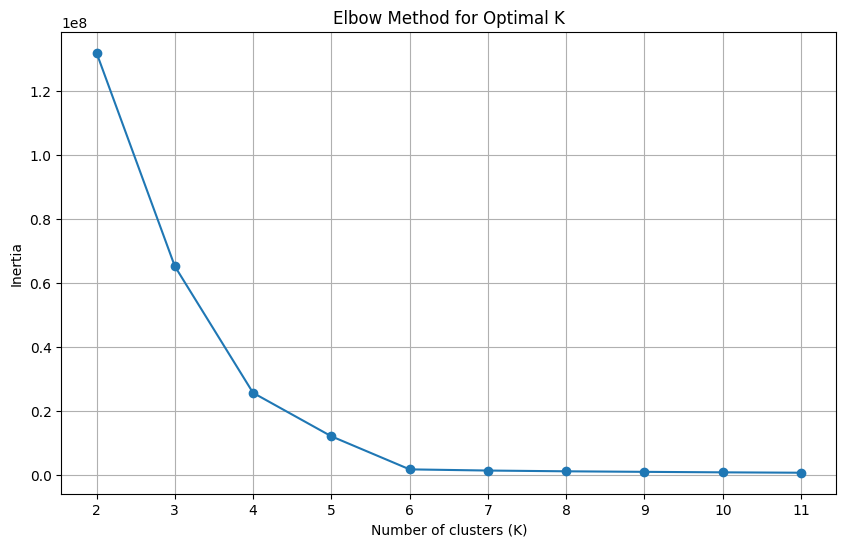

./elbow_test_export/SS-K_csv_50_70006_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3          1           3         2         3              10   
1         1         10           2         2         3            1000   
2         1        100         100         6         6             100   
3         1          2         100         2        12             100   
4         3      10000           3         1        12            1000   
..      ...        ...         ...       ...       ...             ...   
395       1          2           1         6         6             100   
396       1          2           2         6         1             100   
397       3      10000           3         1         3              10   
398       1         10           3         6         6              10   
399       1        100           2         3         6              10   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

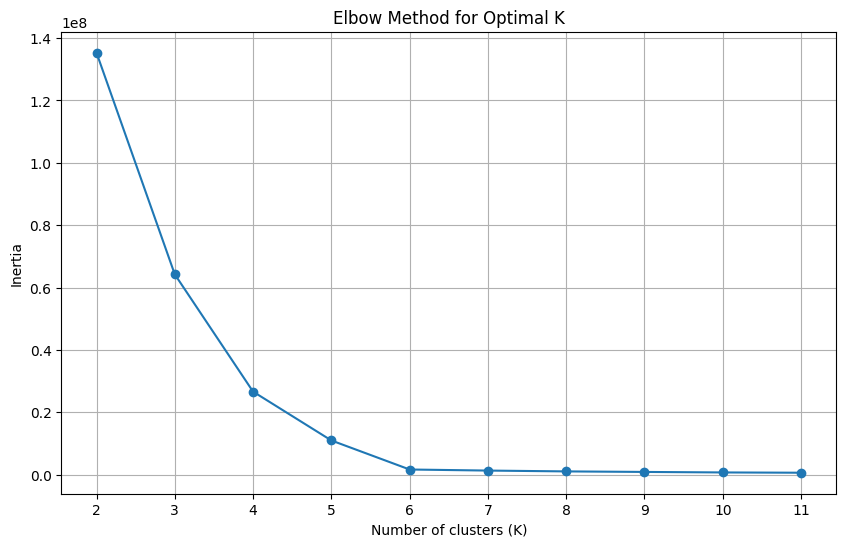

./elbow_test_export/SS-K_csv_50_70292_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3      10000          10         3         6             100   
1         1          1           2         6         3             100   
2         1       1000           2         2         6            1000   
3         1          2           2         1        12              10   
4         1          1           2         3         6              10   
..      ...        ...         ...       ...       ...             ...   
395       1          1          10         6         6            1000   
396       3        100           1         2         6            1000   
397       3          1           1         3         3              10   
398       3       1000          10         1         3              10   
399       3          1         100         1        12            1000   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

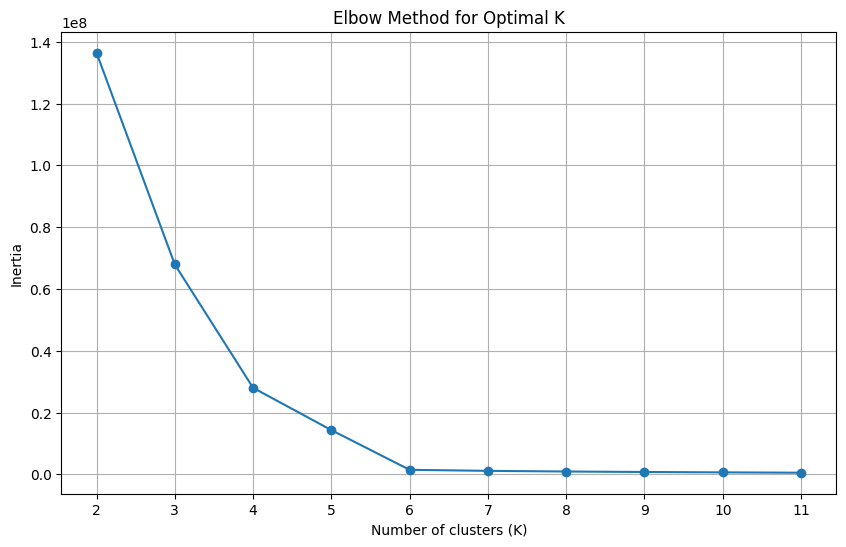

./elbow_test_export/SS-K_csv_50_77340_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3         10           1         1         1            1000   
1         3         10          10         1        12              10   
2         3      10000           1         3        12            1000   
3         3         10           2         2         3            1000   
4         3       1000         100         1         1              10   
..      ...        ...         ...       ...       ...             ...   
395       3          2           1         6         1            1000   
396       3      10000           2         1         6            1000   
397       3          2           1         6         3             100   
398       1          2           1         1        12             100   
399       1          2           1         6         6            1000   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

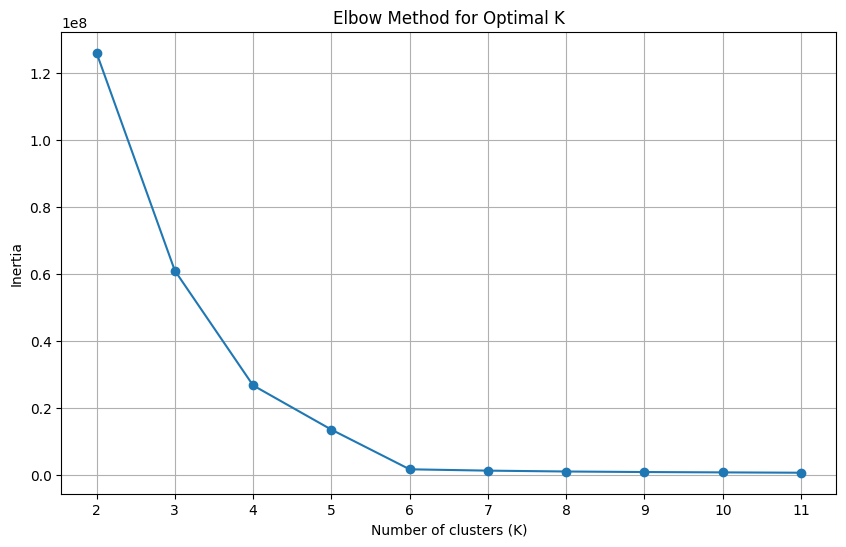

./elbow_test_export/SS-K_csv_50_77845_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1       1000           2         1         3             100   
1         3      10000           2         1         6             100   
2         3         10          10         6         1             100   
3         3         10           1         2         1              10   
4         1        100          10         1         1              10   
..      ...        ...         ...       ...       ...             ...   
395       1          2         100         2         6             100   
396       1          1           3         6         3              10   
397       1          1           1         6        12            1000   
398       3          2           3         6         3            1000   
399       3          2           2         3         6             100   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

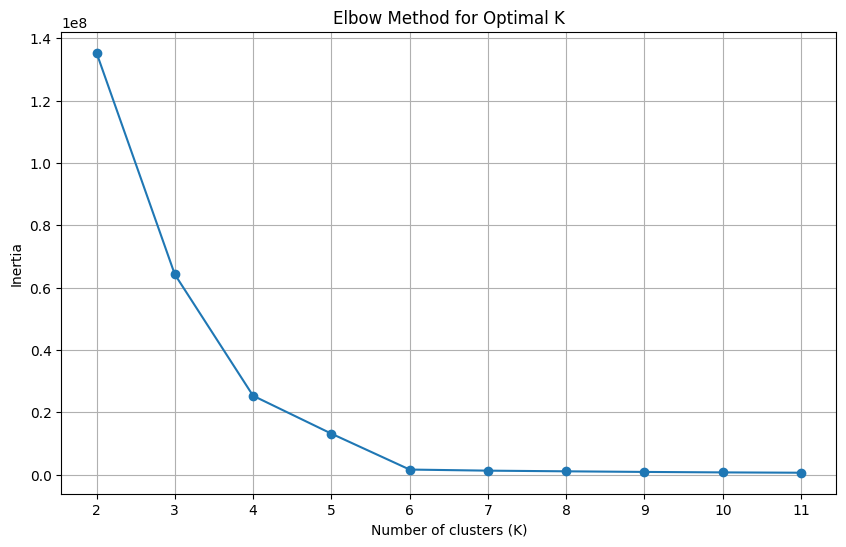

./elbow_test_export/SS-K_csv_50_83686_elbow_test.png
Optimal k value: 4
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1          1           1         3         1            1000   
1         3          2           1         1         3            1000   
2         3        100           3         2         6              10   
3         3          2           2         2         1            1000   
4         1       1000           2         3         3             100   
..      ...        ...         ...       ...       ...             ...   
395       1          2         100         3         3            1000   
396       3          1           2         3         3             100   
397       3          2           1         1         3             100   
398       3        100           3         1         1            1000   
399       1      10000           1         6        12             100   

     Throughput+   Latency-  cluster  


<Figure size 640x480 with 0 Axes>

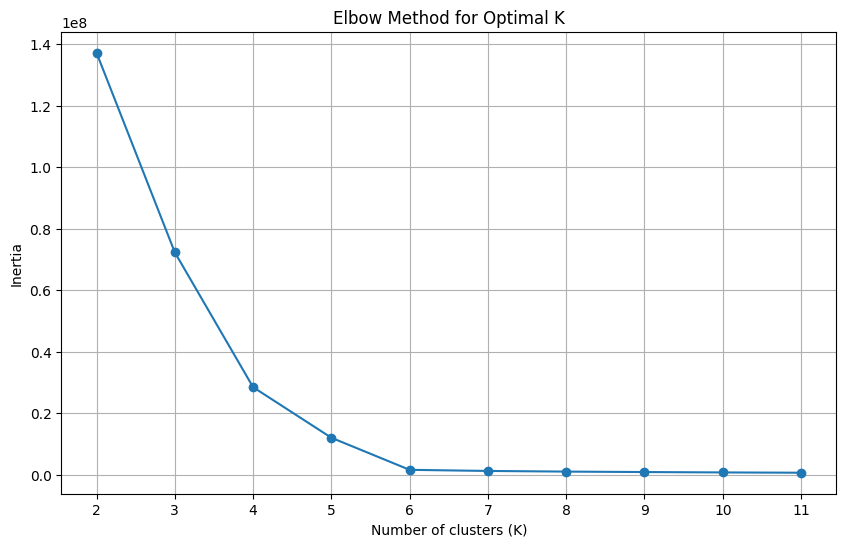

./elbow_test_export/SS-K_csv_50_84967_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         1      10000           2         2        12             100   
1         1        100          10         2         1            1000   
2         1          1          10         3         6            1000   
3         1      10000         100         6         1             100   
4         3          1           2         1         6              10   
..      ...        ...         ...       ...       ...             ...   
395       3        100           2         2         1            1000   
396       3       1000           3         6         3             100   
397       1       1000          10         3         6              10   
398       1      10000           1         3        12             100   
399       1          2         100         3         6            1000   

     Throughput+    Latency-  cluster  

<Figure size 640x480 with 0 Axes>

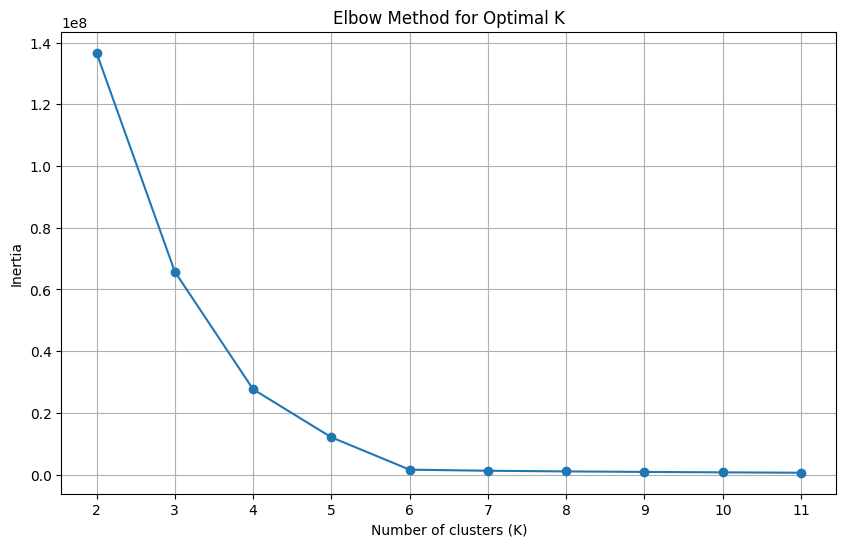

./elbow_test_export/SS-K_csv_50_86331_elbow_test.png
Optimal k value: 5
     Spouts  Max_spout  Spout_wait  Spliters  Counters  Netty_min_wait  \
0         3       1000           1         2         3            1000   
1         1         10          10         2         3            1000   
2         3       1000           2         1         1            1000   
3         3         10          10         1        12            1000   
4         3         10           1         2        12            1000   
..      ...        ...         ...       ...       ...             ...   
395       1        100           1         3         6             100   
396       3       1000          10         2         6              10   
397       3          2         100         1         6            1000   
398       1         10           1         6         1              10   
399       1        100           3         3         6              10   

     Throughput+  Latency-  cluster  
0

<Figure size 640x480 with 0 Axes>

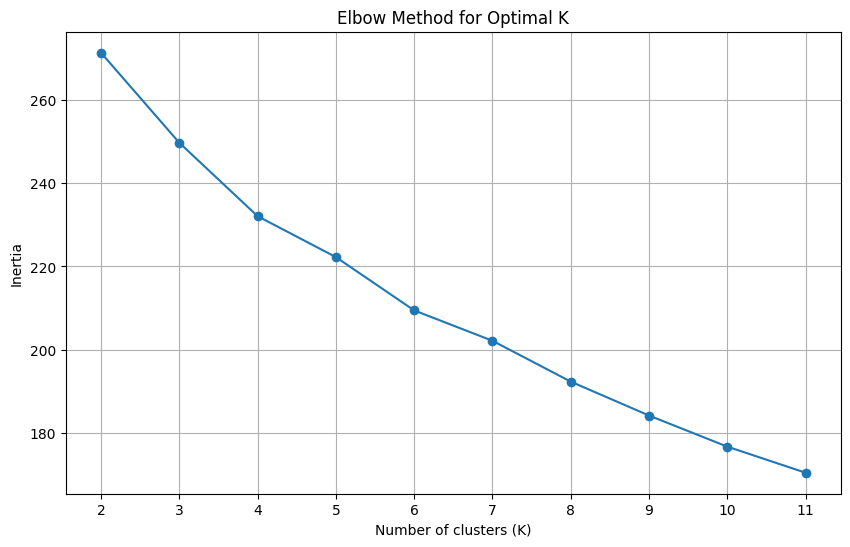

./elbow_test_export/SS-L_csv_10_11514_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  0  1  1  0  1  1  255.64  15        4
1    1  0  1  1  1  0  0  0  0  0  1  218.43  26        1
2    1  0  0  1  0  0  1  0  1  0  0  217.90  29        3
3    1  1  1  1  1  1  0  0  1  0  1  236.17  28        2
4    1  0  1  0  1  0  1  1  0  0  1  261.84  12        5
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  1  1  1  1  1  1  1  0  0  1  267.43  12        2
126  1  1  1  1  1  0  1  0  1  0  1  237.36  28        4
127  1  1  0  0  0  1  0  1  0  0  0  211.74  15        0
128  1  0  0  0  1  0  0  0  0  0  0  200.66  27        1
129  1  1  0  0  1  1  1  1  1  0  0  231.33  18        5

[130 rows x 14 columns]
[0.5041070805770178, 0.6529631834770443, 0.5920996949783771, 0.6985024961339767, 0.653268312694512, 0.5107066964329907, nan]
[0.5041070805770178, 0.6529631834770443, 0.5920996949783771, 0.6985024961339767, 0

<Figure size 640x480 with 0 Axes>

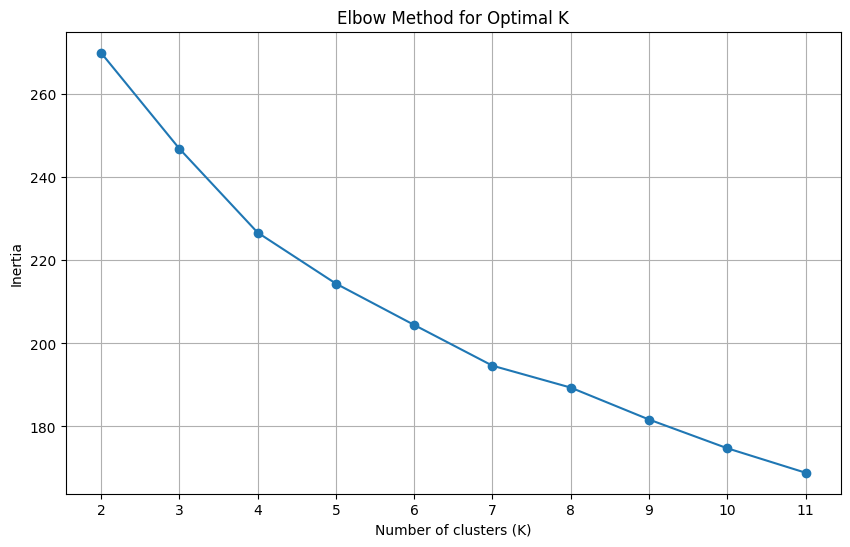

./elbow_test_export/SS-L_csv_10_19953_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  0  1  0  1  0  0  1  1  0  239.37  28        2
1    1  0  1  1  1  1  1  0  1  0  0  221.86  29        0
2    1  1  1  0  1  1  0  1  0  1  0  242.55  15        3
3    1  1  1  1  1  1  1  0  1  1  0  248.02  28        0
4    1  1  1  1  1  1  1  0  0  0  0  208.92  29        0
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  1  0  0  1  0  1  0  1  1  1  253.49  28        1
126  1  1  1  0  1  1  0  1  1  1  0  256.45  20        3
127  1  1  1  1  1  0  0  0  0  1  0  229.17  28        3
128  1  0  0  1  0  0  0  0  1  1  1  246.81  28        2
129  1  0  0  1  0  0  1  0  0  1  0  222.56  29        2

[130 rows x 14 columns]
[0.7162380211280175, 0.5925791180534813, 0.5114771954600441, 0.5660235301761537, 0.6404615306753829, nan]
[0.7162380211280175, 0.5925791180534813, 0.5114771954600441, 0.5660235301761537, 0.6404615306753829]


<Figure size 640x480 with 0 Axes>

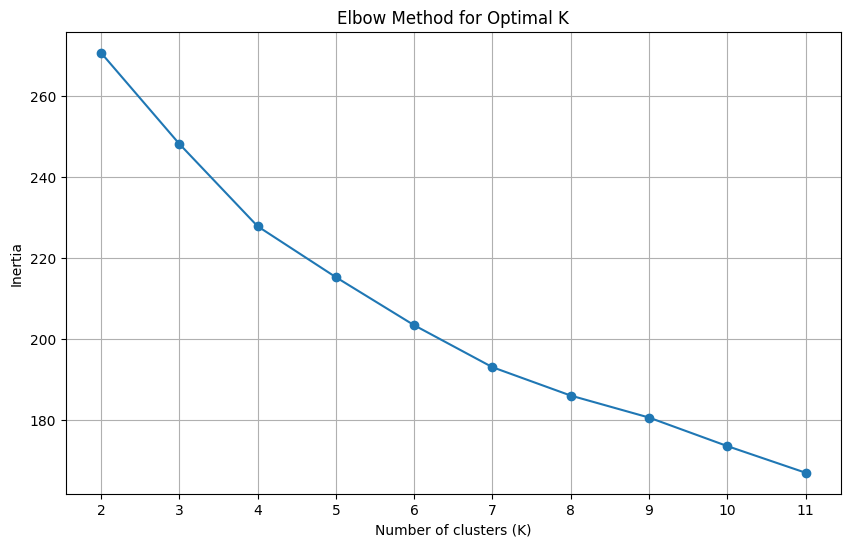

./elbow_test_export/SS-L_csv_10_3545_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  0  0  1  0  0  0  214.72  13        0
1    1  0  1  0  1  0  0  0  1  1  0  241.02  28        0
2    1  0  1  1  1  0  0  0  1  0  1  233.66  28        4
3    1  1  0  1  1  0  0  1  0  1  1  250.57  16        3
4    1  1  0  0  1  0  0  1  1  1  0  253.64  19        0
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  1  0  0  0  1  0  1  0  0  1  258.16  12        3
126  1  0  0  1  1  0  1  0  0  0  1  215.96  28        1
127  1  0  1  1  1  0  0  1  0  1  1  250.04  15        1
128  1  1  0  1  0  0  0  1  1  1  1  262.74  19        3
129  1  0  0  1  1  0  0  1  1  1  0  247.72  19        0

[130 rows x 14 columns]
[0.5534487444927085, 0.713929075240691, 0.6846639137860739, 0.6133925724035246, 0.5764393901954378, 0.5969565595562422, nan]
[0.5534487444927085, 0.713929075240691, 0.6846639137860739, 0.6133925724035246, 0.5

<Figure size 640x480 with 0 Axes>

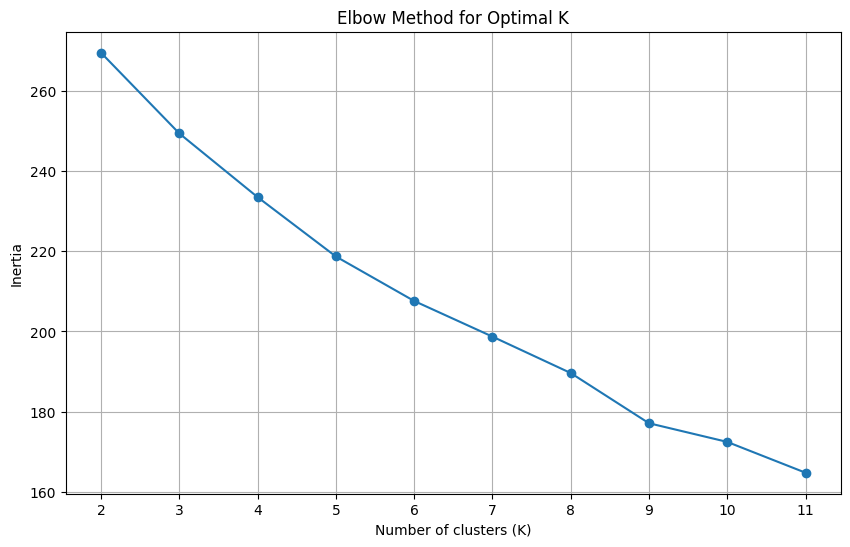

./elbow_test_export/SS-L_csv_10_39658_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  0  1  1  1  0  1  0  0  0  213.00  15        0
1    1  1  1  0  1  0  1  0  1  0  0  223.42  29        1
2    1  0  0  1  1  0  0  1  1  1  0  247.72  19        4
3    1  0  0  0  0  1  1  0  1  0  0  218.12  29        4
4    1  1  0  0  0  1  0  1  0  0  1  258.16  12        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  0  1  0  0  0  1  0  1  0  231.04  15        3
126  1  0  1  1  1  1  1  1  0  1  0  240.54  15        2
127  1  0  1  1  1  0  0  0  0  0  0  203.18  26        0
128  1  0  1  1  1  1  0  0  1  0  1  235.07  28        0
129  1  0  1  0  1  1  1  1  0  1  0  236.95  15        2

[130 rows x 14 columns]
[0.5079613976668361, 0.500501509142446, 0.6528686317653475, 0.5750160085775299, 0.5899583182253285, nan]
[0.5079613976668361, 0.500501509142446, 0.6528686317653475, 0.5750160085775299, 0.5899583182253285]
  

<Figure size 640x480 with 0 Axes>

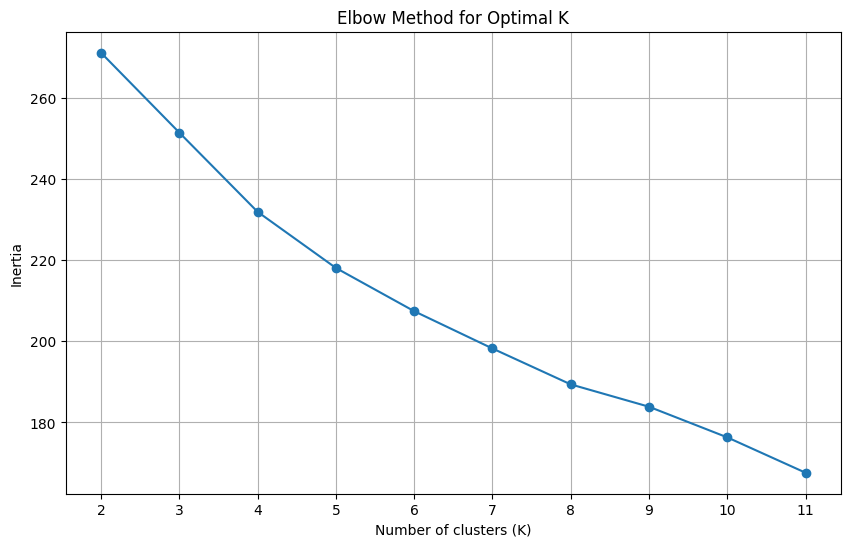

./elbow_test_export/SS-L_csv_10_40749_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  1  1  1  0  1  1  0  1  0  239.06  15        2
1    1  0  1  1  1  0  0  1  0  1  0  235.17  15        2
2    1  0  1  0  1  0  1  1  0  1  1  249.68  15        2
3    1  1  0  0  1  1  1  1  1  0  0  231.33  18        1
4    1  0  0  0  1  0  1  1  0  0  1  257.71  12        2
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  0  0  0  1  0  1  0  1  1  245.79  16        0
126  1  1  0  0  0  1  0  0  1  1  1  251.93  28        0
127  1  1  1  0  1  0  1  1  0  1  0  242.50  15        2
128  1  1  1  1  1  1  0  1  1  0  1  251.15  18        1
129  1  1  0  0  1  1  1  1  1  0  1  251.79  17        1

[130 rows x 14 columns]
[0.6372973034888458, 0.47103412590665117, 0.5105368415110044, 0.7409287081030471, 0.6531592538641252, nan]
[0.6372973034888458, 0.47103412590665117, 0.5105368415110044, 0.7409287081030471, 0.6531592538641252

<Figure size 640x480 with 0 Axes>

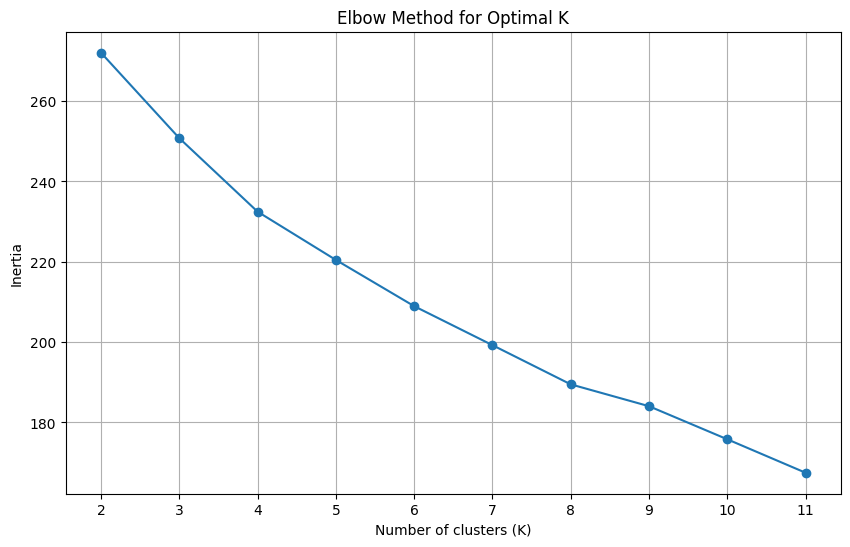

./elbow_test_export/SS-L_csv_10_44845_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  1  0  1  0  1  0  0  1  0  226.13  29        2
1    1  1  1  0  1  0  0  0  1  1  1  252.18  28        4
2    1  1  1  1  1  1  0  0  0  1  0  232.20  28        3
3    1  1  1  0  1  0  1  0  1  0  0  221.78  29        3
4    1  1  0  1  0  1  1  0  0  0  1  216.30  28        0
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  1  1  1  0  0  1  0  1  1  250.04  15        2
126  1  1  1  1  1  1  0  0  1  0  0  224.95  29        3
127  1  0  1  1  1  1  0  0  0  0  1  217.65  28        2
128  1  0  1  1  1  0  0  1  0  0  0  215.85  14        4
129  1  1  0  0  1  0  0  0  1  1  1  251.74  28        4

[130 rows x 14 columns]
[0.5612187542997509, 0.5790241879868953, 0.6809111803782025, 0.6959310359189436, 0.5374455713465529, nan]
[0.5612187542997509, 0.5790241879868953, 0.6809111803782025, 0.6959310359189436, 0.5374455713465529]


<Figure size 640x480 with 0 Axes>

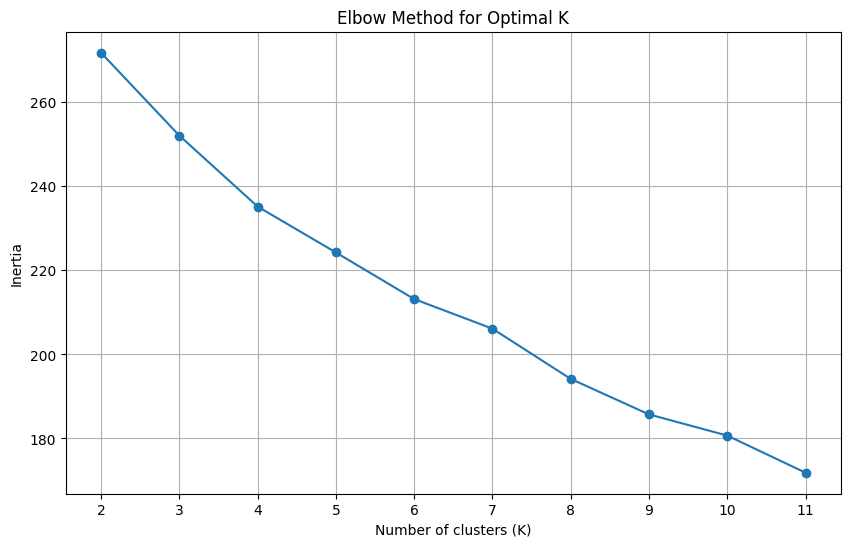

./elbow_test_export/SS-L_csv_10_51176_elbow_test.png
Optimal k value: 4
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  1  0  0  1  1  0  245.76  28        2
1    1  1  0  0  0  1  1  1  1  1  0  254.89  19        1
2    1  1  0  0  0  1  0  1  0  0  0  211.74  15        1
3    1  0  0  0  1  1  1  1  1  1  0  250.73  20        1
4    1  0  1  0  1  1  0  1  0  1  1  250.44  15        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  1  0  0  1  0  1  1  0  1  0  240.62  16        2
126  1  1  1  0  1  0  0  0  0  1  0  229.79  29        2
127  1  1  1  0  1  1  0  0  1  0  1  234.42  28        3
128  1  0  0  0  1  1  1  1  1  1  1  263.59  19        1
129  1  0  0  1  1  0  0  1  1  0  1  247.43  17        0

[130 rows x 14 columns]
[0.5643104721128493, 0.5696358182523177, 0.6247999125466139, 0.49419268737265204, nan]
[0.5643104721128493, 0.5696358182523177, 0.6247999125466139, 0.49419268737265204]
   A  B  C  D  E  F  G  H  I  J  K    

<Figure size 640x480 with 0 Axes>

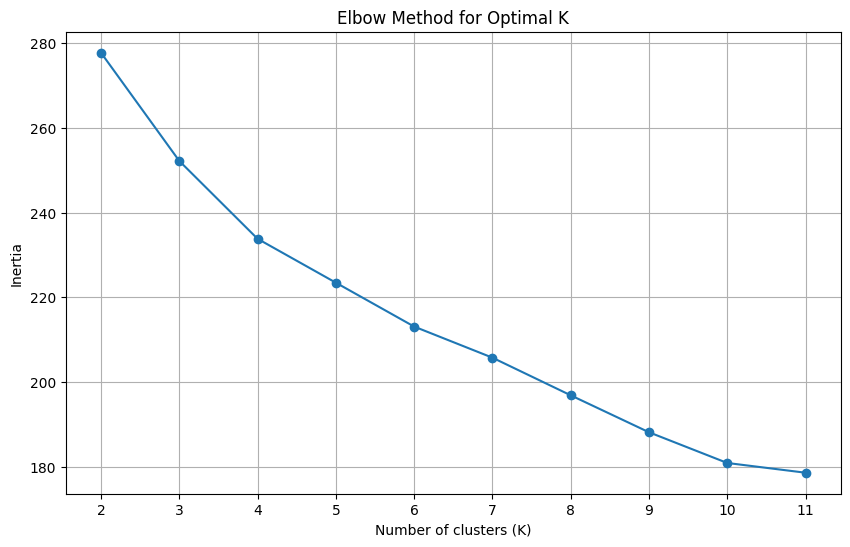

./elbow_test_export/SS-L_csv_10_58612_elbow_test.png
Optimal k value: 4
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  0  0  1  1  0  0  232.52  18        2
1    1  1  1  0  1  1  1  1  0  0  1  264.04  12        2
2    1  0  0  1  0  1  1  0  0  0  0  201.97  29        0
3    1  1  0  0  0  0  1  0  1  0  0  219.40  29        0
4    1  0  0  1  1  1  1  0  0  0  0  203.86  29        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  0  1  0  0  1  0  1  0  1  231.76  29        0
126  1  0  1  1  1  0  0  0  0  1  1  233.33  28        1
127  1  0  1  1  1  0  0  0  1  1  0  239.66  28        1
128  1  0  1  0  1  1  0  0  0  0  0  205.36  29        1
129  1  1  1  1  1  1  0  0  0  0  1  218.59  28        2

[130 rows x 14 columns]
[0.5599193811027973, 0.6971200913820671, 0.5098716288739412, 0.6553913914451194, nan]
[0.5599193811027973, 0.6971200913820671, 0.5098716288739412, 0.6553913914451194]
   A  B  C  D  E  F  G  H  I  J  K      

<Figure size 640x480 with 0 Axes>

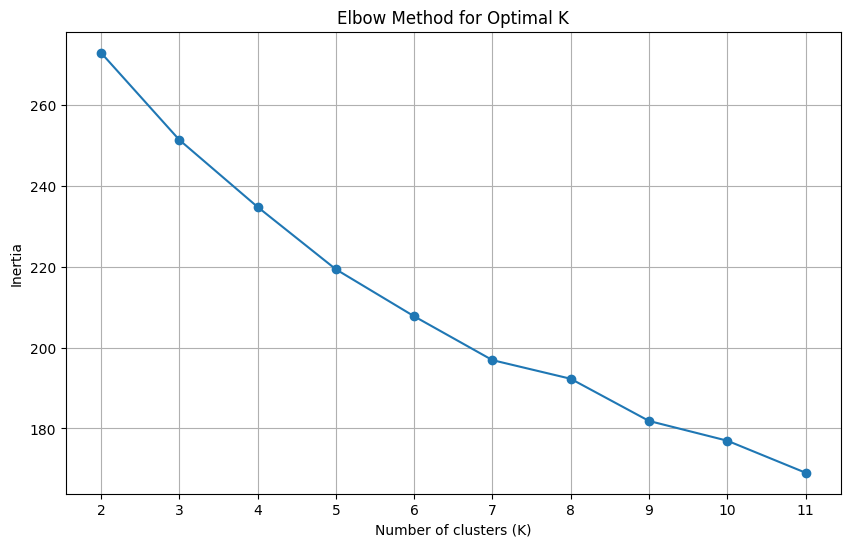

./elbow_test_export/SS-L_csv_10_61367_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  0  1  0  1  0  1  1  0  1  246.65  18        0
1    1  1  1  1  1  1  0  0  1  1  0  245.76  28        4
2    1  1  0  1  1  0  0  1  1  1  0  252.68  19        4
3    1  0  0  1  1  0  1  0  0  1  0  224.30  28        1
4    1  0  1  0  1  1  0  0  1  0  0  220.39  29        4
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  1  0  1  0  1  1  0  0  0  215.31  14        2
126  1  1  1  1  1  1  1  0  0  1  1  241.23  28        1
127  1  0  1  0  1  0  0  0  0  0  1  215.61  26        2
128  1  1  0  1  1  1  0  1  1  0  0  230.69  18        0
129  1  1  0  0  0  0  1  1  0  1  0  237.50  16        3

[130 rows x 14 columns]
[0.6501114070573274, 0.7484629133444138, 0.4154533580976396, 0.43698579093164136, 0.6858313265288156, 0.6243352396784942, nan]
[0.6501114070573274, 0.7484629133444138, 0.4154533580976396, 0.43698579093164136

<Figure size 640x480 with 0 Axes>

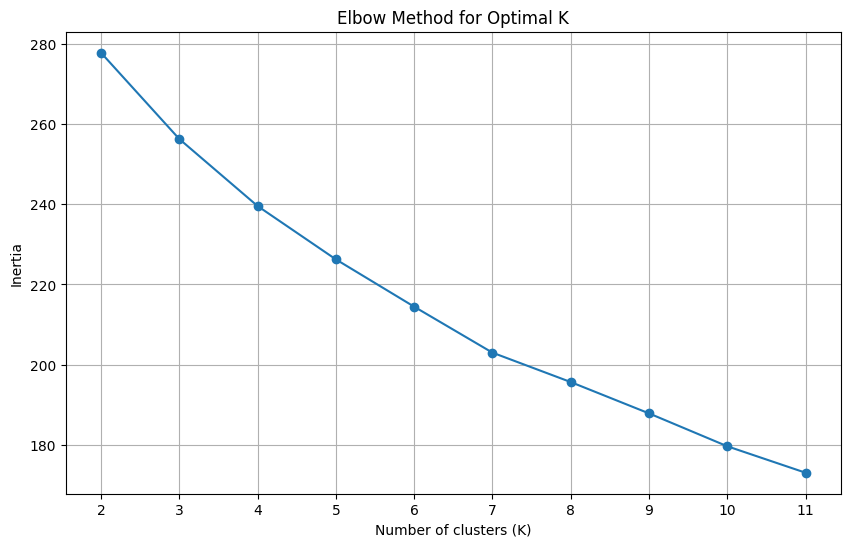

./elbow_test_export/SS-L_csv_10_65388_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  1  1  1  1  0  1  0  0  0  215.01  14        3
1    1  1  0  1  0  1  0  1  0  0  1  260.41  12        1
2    1  0  0  1  0  0  0  0  0  1  0  221.33  29        0
3    1  0  1  1  1  0  0  1  0  1  1  250.04  15        2
4    1  1  0  1  1  1  0  1  0  0  1  263.04  12        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  1  1  1  0  0  1  1  1  0  251.00  19        2
126  1  1  1  0  1  0  1  1  0  0  1  264.74  12        3
127  1  1  0  0  0  0  0  0  1  1  1  249.99  28        0
128  1  0  0  1  1  0  0  0  1  1  0  239.27  29        0
129  1  0  0  0  1  1  1  1  1  1  0  250.73  20        4

[130 rows x 14 columns]
[0.7335619267914184, 0.45736184594499063, 0.5932095790939645, 0.4718624564650041, 0.6657126864018601, 0.6202575559942921, nan]
[0.7335619267914184, 0.45736184594499063, 0.5932095790939645, 0.4718624564650041

<Figure size 640x480 with 0 Axes>

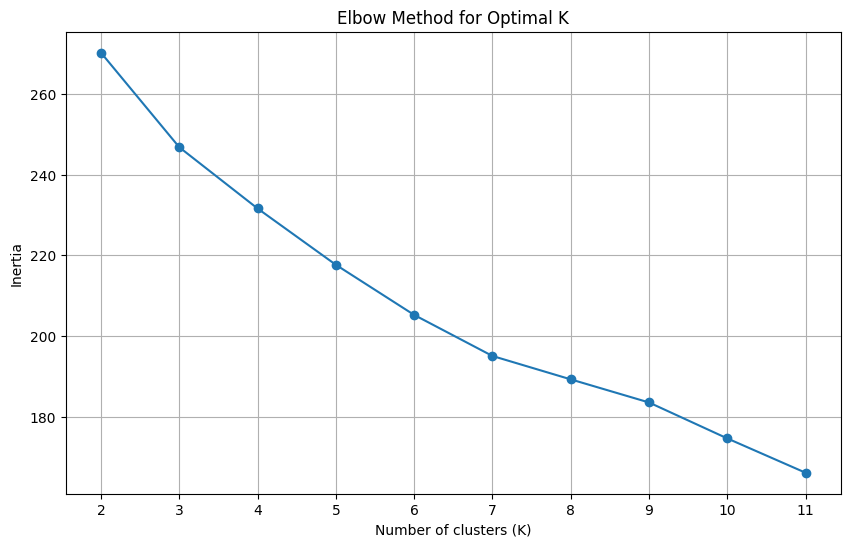

./elbow_test_export/SS-L_csv_10_65444_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  1  0  1  0  1  0  1  0  237.69  15        5
1    1  0  0  0  1  0  1  0  0  1  1  232.49  28        1
2    1  0  0  0  0  0  0  1  0  1  1  243.93  16        2
3    1  1  0  0  1  0  1  0  0  1  1  237.06  28        1
4    1  1  1  1  1  1  1  1  0  1  0  243.28  15        0
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  1  1  1  1  1  0  0  0  0  1  218.59  28        3
126  1  0  0  0  1  1  0  1  1  0  0  228.27  18        0
127  1  0  1  0  1  0  0  1  1  0  0  229.64  19        4
128  1  0  1  0  1  1  0  0  0  0  0  203.53  29        4
129  1  0  1  1  1  1  0  1  0  0  1  263.75  12        3

[130 rows x 14 columns]
[0.4879255758212118, 0.6677432935092162, 0.4305869938131094, 0.6606289679176712, 0.6330061263574125, 0.6452726914429449, nan]
[0.4879255758212118, 0.6677432935092162, 0.4305869938131094, 0.6606289679176712, 

<Figure size 640x480 with 0 Axes>

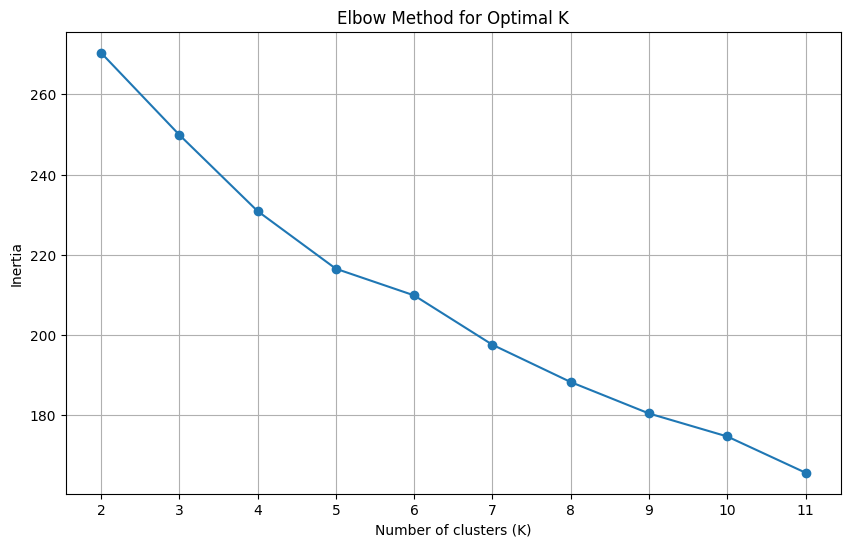

./elbow_test_export/SS-L_csv_10_66946_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  1  1  1  1  1  0  1  1  253.47  15        0
1    1  1  1  1  1  0  1  0  0  1  1  238.20  28        4
2    1  1  0  0  1  0  1  1  0  0  0  213.85  15        4
3    1  1  0  1  0  1  1  0  0  0  0  203.93  29        1
4    1  1  0  0  0  0  0  0  1  1  1  249.99  28        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  1  0  0  0  1  0  1  0  0  0  211.74  15        1
126  1  1  1  0  1  1  0  1  1  0  0  232.76  18        3
127  1  1  0  1  0  1  1  0  1  1  0  243.96  28        1
128  1  0  1  0  1  1  1  1  0  1  0  236.95  15        2
129  1  0  0  0  1  1  1  1  1  0  1  249.34  18        0

[130 rows x 14 columns]
[0.5522247004773534, 0.6305427486183335, 0.6614032840290989, 0.5409690856854011, 0.6044348132169257, nan]
[0.5522247004773534, 0.6305427486183335, 0.6614032840290989, 0.5409690856854011, 0.6044348132169257]


<Figure size 640x480 with 0 Axes>

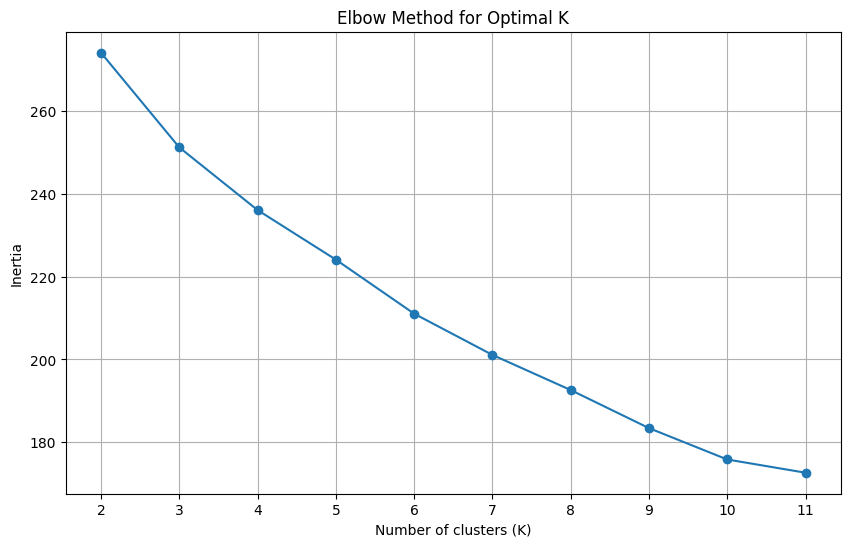

./elbow_test_export/SS-L_csv_10_69024_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  1  0  0  1  0  1  1  0  242.56  28        4
1    1  0  0  0  0  0  0  0  1  1  0  234.87  29        4
2    1  1  1  1  1  0  0  1  1  0  0  230.54  18        0
3    1  1  0  0  1  0  1  0  1  1  1  253.49  28        5
4    1  1  1  0  1  1  1  1  0  0  0  215.95  14        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  1  1  0  1  1  1  0  1  0  1  237.41  28        5
126  1  0  1  0  1  1  1  0  0  1  0  226.09  28        5
127  1  0  1  0  1  1  0  1  1  0  0  229.07  19        0
128  1  0  1  0  1  1  0  0  0  1  1  235.70  28        5
129  1  0  0  1  0  1  1  0  1  0  1  233.15  29        2

[130 rows x 14 columns]
[0.546998946783824, 0.586205535457843, 0.6746502172192846, 0.4811784544368884, 0.5932782364936994, 0.8020961768723557, nan]
[0.546998946783824, 0.586205535457843, 0.6746502172192846, 0.4811784544368884, 0.59

<Figure size 640x480 with 0 Axes>

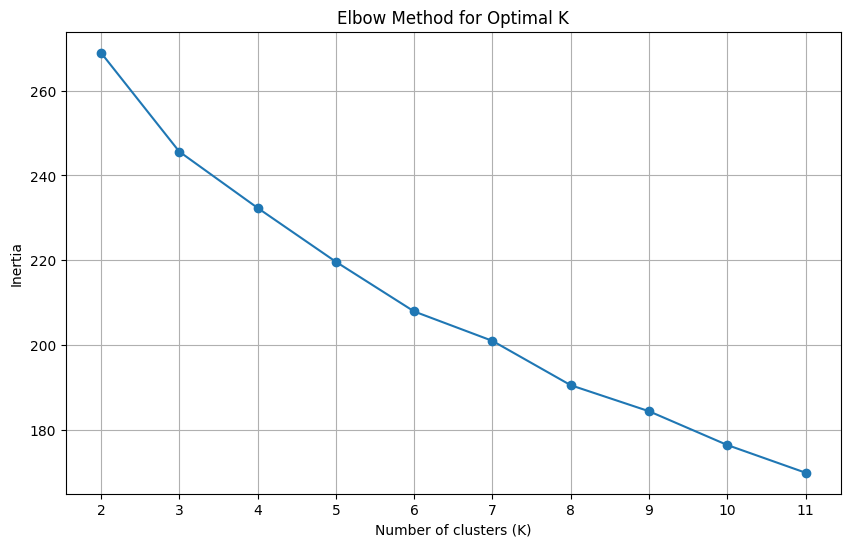

./elbow_test_export/SS-L_csv_10_70006_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  0  1  0  0  0  1  0  1  0  231.04  15        4
1    1  1  1  0  1  1  1  0  0  1  1  238.74  28        3
2    1  1  0  1  1  0  0  1  1  1  1  264.93  19        1
3    1  1  0  0  1  0  0  0  1  0  0  220.42  29        0
4    1  0  1  1  1  0  1  1  1  1  1  264.60  19        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  1  1  1  1  1  1  1  0  1  1  257.33  15        2
126  1  1  1  1  1  0  1  0  1  0  1  237.36  28        1
127  1  1  0  1  1  1  1  1  0  0  1  263.57  12        0
128  1  1  0  0  0  1  0  0  0  1  0  227.39  29        4
129  1  1  1  0  1  1  0  0  1  0  0  224.18  29        5

[130 rows x 14 columns]
[0.5908088593548598, 0.7523208458017584, 0.5584979292948642, 0.6738023476133684, 0.5363202447251492, 0.49227482363677594, nan]
[0.5908088593548598, 0.7523208458017584, 0.5584979292948642, 0.6738023476133684,

<Figure size 640x480 with 0 Axes>

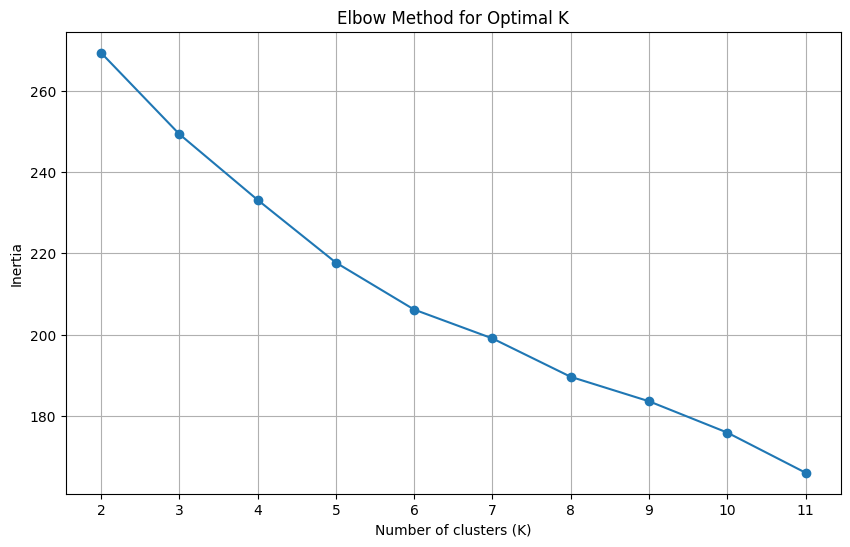

./elbow_test_export/SS-L_csv_10_70292_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  1  1  1  1  0  1  253.67  18        4
1    1  0  0  0  0  0  1  0  0  1  1  230.79  29        0
2    1  1  1  0  1  1  0  0  0  0  0  207.12  29        3
3    1  0  1  0  1  0  0  0  0  1  0  223.68  29        1
4    1  1  0  1  1  0  0  1  0  0  0  212.94  14        5
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  1  0  1  0  0  0  0  0  1  215.61  26        2
126  1  1  1  0  1  1  0  1  1  0  1  250.24  18        3
127  1  0  1  1  1  0  0  1  0  0  0  215.85  14        5
128  1  0  1  0  1  1  0  0  1  1  1  251.16  28        3
129  1  1  0  0  1  1  1  0  0  0  0  204.96  29        3

[130 rows x 14 columns]
[0.581390936973502, 0.7054130203039028, 0.5925119028007222, 0.6000480275616925, 0.6981097555573377, 0.41942920252883525, nan]
[0.581390936973502, 0.7054130203039028, 0.5925119028007222, 0.6000480275616925, 0

<Figure size 640x480 with 0 Axes>

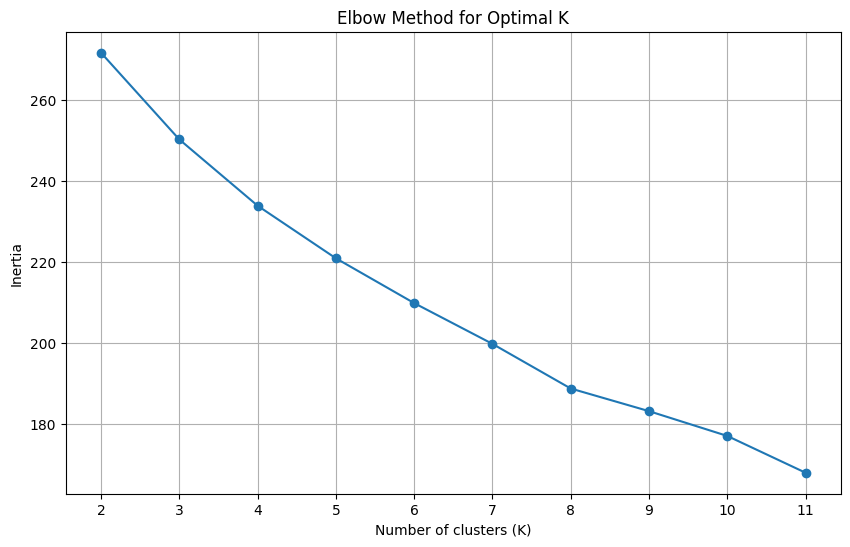

./elbow_test_export/SS-L_csv_10_77340_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  0  0  1  1  1  0  1  0  240.07  16        0
1    1  1  1  1  1  0  0  0  0  0  1  217.40  26        3
2    1  0  1  1  1  1  0  0  0  1  1  236.59  28        3
3    1  1  0  0  1  1  1  1  0  1  0  242.46  16        2
4    1  1  0  0  1  0  0  0  0  1  1  234.70  28        2
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  1  1  0  1  0  1  0  0  1  1  237.33  28        2
126  1  0  1  1  1  0  1  0  0  0  0  205.71  29        3
127  1  1  1  1  1  0  0  1  0  1  1  252.21  15        2
128  1  1  0  1  0  1  0  1  1  0  0  228.47  18        0
129  1  0  0  1  1  1  1  1  1  0  1  249.36  18        4

[130 rows x 14 columns]
[0.5385576040252151, 0.6588208170066341, 0.6005485070481055, 0.5662102591861222, 0.6661558741810896, nan]
[0.5385576040252151, 0.6588208170066341, 0.6005485070481055, 0.5662102591861222, 0.6661558741810896]


<Figure size 640x480 with 0 Axes>

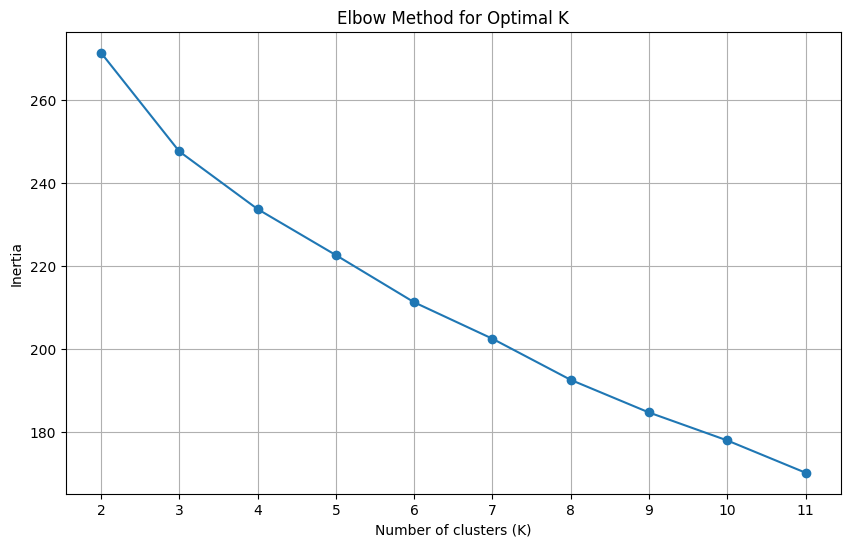

./elbow_test_export/SS-L_csv_10_77845_elbow_test.png
Optimal k value: 4
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  0  1  0  1  1  1  1  1  268.41  18        3
1    1  1  1  1  1  1  1  0  1  0  0  225.16  29        2
2    1  1  1  0  1  1  0  1  1  1  1  268.58  19        0
3    1  0  0  1  0  1  1  1  1  0  1  247.31  18        1
4    1  0  1  0  1  0  0  1  0  1  1  246.39  15        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  0  0  0  0  1  1  1  1  1  260.17  18        1
126  1  0  0  1  0  1  0  0  0  0  0  201.47  29        1
127  1  1  1  1  1  1  1  1  1  0  0  232.66  19        0
128  1  0  1  1  1  1  0  0  1  1  0  241.70  28        2
129  1  1  1  1  1  1  1  1  1  0  1  251.80  18        0

[130 rows x 14 columns]
[0.5067249955957039, 0.48299481730143196, 0.687349679557246, 0.6756391176362624, nan]
[0.5067249955957039, 0.48299481730143196, 0.687349679557246, 0.6756391176362624]
   A  B  C  D  E  F  G  H  I  J  K      

<Figure size 640x480 with 0 Axes>

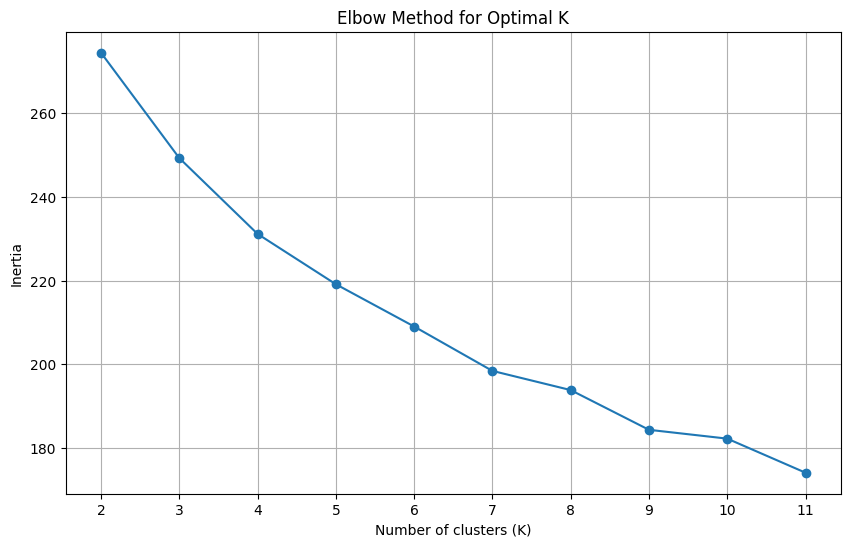

./elbow_test_export/SS-L_csv_10_83686_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  1  0  0  1  0  1  236.17  28        1
1    1  1  0  1  0  0  0  0  0  0  0  201.52  26        2
2    1  1  0  1  0  0  0  1  1  1  0  250.62  19        2
3    1  0  0  0  1  1  1  0  1  0  1  234.56  28        3
4    1  1  0  0  1  1  0  0  1  0  1  234.22  28        4
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  1  1  1  0  1  1  0  1  0  239.06  15        0
126  1  1  1  0  1  1  1  0  1  0  1  235.96  28        1
127  1  0  0  0  0  1  0  0  0  1  1  231.22  29        3
128  1  1  0  0  1  1  1  1  1  0  1  251.79  17        1
129  1  1  1  0  1  1  0  0  1  1  0  246.50  28        1

[130 rows x 14 columns]
[0.4859984920472743, 0.66175373237043, 0.41482098332775785, 0.7229106063066387, 0.5753575925359551, nan]
[0.4859984920472743, 0.66175373237043, 0.41482098332775785, 0.7229106063066387, 0.5753575925359551]
  

<Figure size 640x480 with 0 Axes>

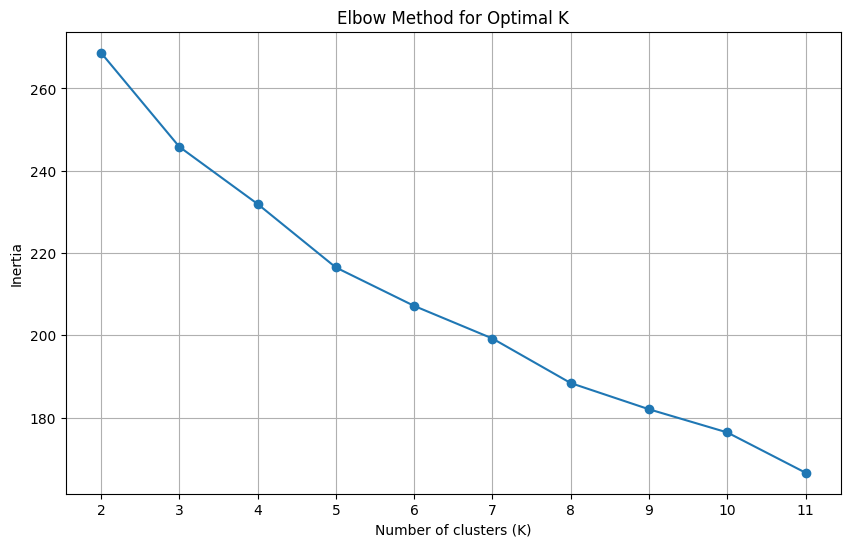

./elbow_test_export/SS-L_csv_10_84967_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  0  1  0  0  1  0  231.31  28        4
1    1  0  1  1  1  0  1  1  1  0  0  229.56  18        4
2    1  0  1  1  1  1  1  0  0  0  0  205.47  29        4
3    1  1  0  1  0  1  0  0  1  1  0  243.12  28        0
4    1  0  1  1  1  1  0  0  1  1  1  250.34  28        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  0  0  1  0  1  1  1  1  0  248.89  20        0
126  1  1  1  1  1  0  1  1  0  1  0  243.78  15        4
127  1  1  1  1  1  1  0  0  1  0  1  237.70  28        4
128  1  0  1  0  1  1  1  1  0  0  1  266.12  12        3
129  1  0  1  0  1  0  1  0  0  0  1  215.99  27        3

[130 rows x 14 columns]
[0.7257861203000995, 0.7562959877235943, 0.45938210542974967, 0.5471464910475179, 0.5702953668442178, nan]
[0.7257861203000995, 0.7562959877235943, 0.45938210542974967, 0.5471464910475179, 0.5702953668442178

<Figure size 640x480 with 0 Axes>

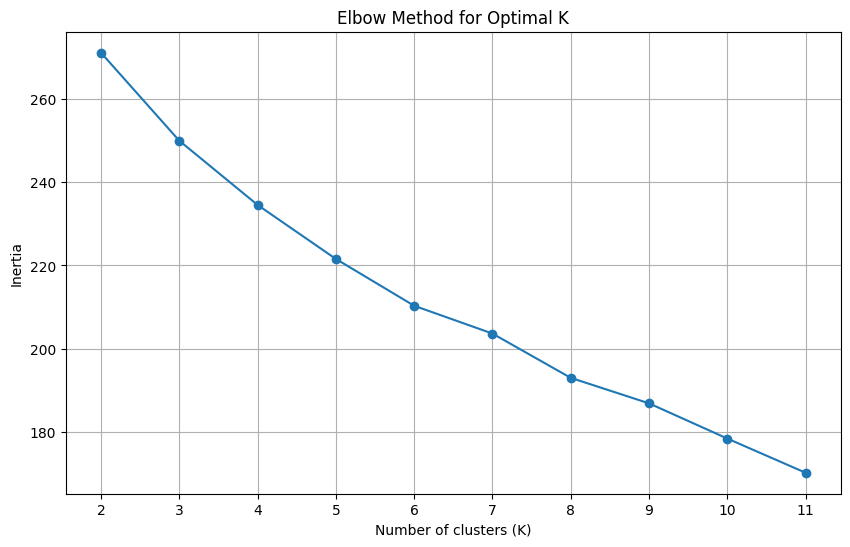

./elbow_test_export/SS-L_csv_10_86331_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  1  1  1  0  1  1  0  0  1  265.65  12        0
1    1  1  1  1  1  0  1  1  1  0  1  252.50  18        2
2    1  1  0  0  0  0  0  1  1  0  0  227.01  18        5
3    1  0  1  1  1  1  0  1  0  0  1  263.75  12        1
4    1  0  0  0  1  1  0  1  1  0  1  248.71  18        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
125  1  0  0  0  0  1  0  0  1  1  0  238.73  28        4
126  1  0  0  1  1  1  0  1  0  0  0  213.00  15        0
127  1  0  1  1  1  0  0  0  0  1  1  235.12  28        3
128  1  1  1  0  1  0  0  1  0  0  0  215.88  14        0
129  1  1  1  0  1  0  1  0  0  1  1  237.33  28        2

[130 rows x 14 columns]
[0.3954054141297836, 0.5968481730777122, 0.6628432882166293, 0.5814956734008557, 0.7252830991844165, 0.5467488139383344, nan]
[0.3954054141297836, 0.5968481730777122, 0.6628432882166293, 0.5814956734008557, 

<Figure size 640x480 with 0 Axes>

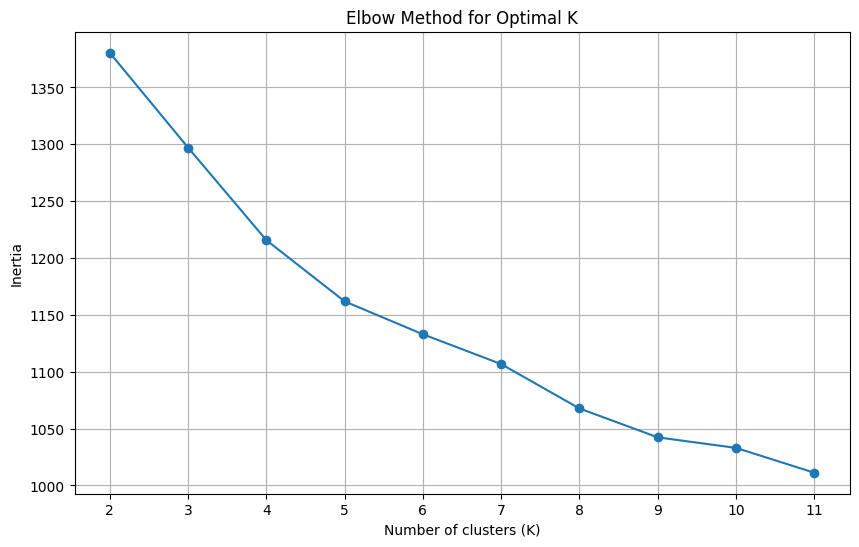

./elbow_test_export/SS-L_csv_50_11514_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  0  1  1  0  1  1  255.64  15        1
1    1  0  1  1  1  0  0  0  0  0  1  218.43  26        3
2    1  0  0  1  0  0  1  0  1  0  0  217.90  29        0
3    1  1  1  1  1  1  0  0  1  0  1  236.17  28        2
4    1  0  1  0  1  0  1  1  0  0  1  261.84  12        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  1  1  1  1  0  1  1  0  1  0  240.83  15        1
646  1  0  1  0  1  1  1  0  0  1  0  226.09  28        3
647  1  0  0  1  1  0  1  1  0  1  0  235.03  15        1
648  1  0  1  1  1  1  1  1  0  0  1  263.78  12        1
649  1  1  1  0  1  0  0  1  0  1  1  253.39  15        4

[650 rows x 14 columns]
[0.5770150533491011, 0.5227254908252414, 0.7478364188332525, 0.73870412260805, 0.5162454351152682, nan]
[0.5770150533491011, 0.5227254908252414, 0.7478364188332525, 0.73870412260805, 0.5162454351152682]
   A

<Figure size 640x480 with 0 Axes>

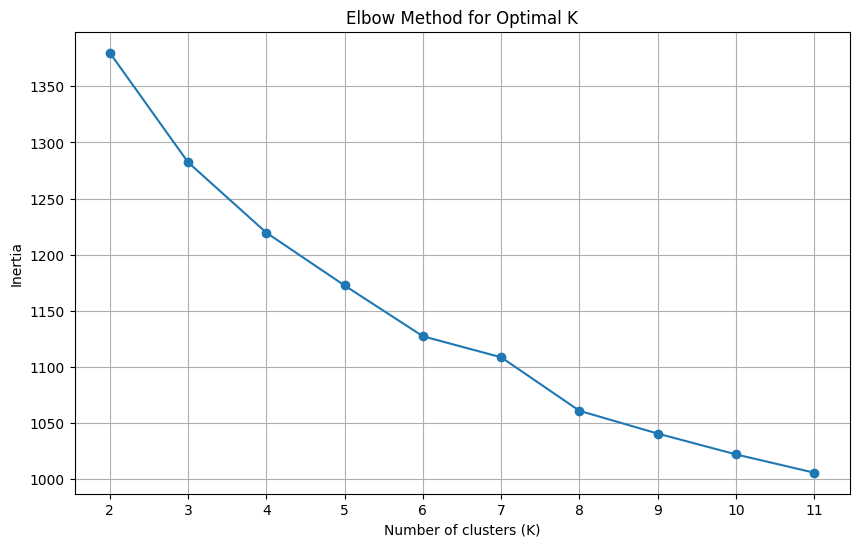

./elbow_test_export/SS-L_csv_50_19953_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  0  1  0  1  0  0  1  1  0  239.37  28        5
1    1  0  1  1  1  1  1  0  1  0  0  221.86  29        2
2    1  1  1  0  1  1  0  1  0  1  0  242.55  15        1
3    1  1  1  1  1  1  1  0  1  1  0  248.02  28        2
4    1  1  1  1  1  1  1  0  0  0  0  208.92  29        0
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  1  1  0  1  0  0  0  0  1  0  227.85  29        1
646  1  1  1  1  1  0  0  1  0  0  1  248.20  14        0
647  1  1  0  0  0  0  1  1  0  0  0  211.27  15        5
648  1  1  1  1  1  0  1  1  1  0  1  250.60  18        2
649  1  0  0  0  1  1  1  1  0  1  1  249.62  16        3

[650 rows x 14 columns]
[0.5090289669283945, 0.5432084855364622, 0.6470683785185616, 0.6436326663107585, 0.6361340669956972, 0.534850482263883, nan]
[0.5090289669283945, 0.5432084855364622, 0.6470683785185616, 0.6436326663107585, 0

<Figure size 640x480 with 0 Axes>

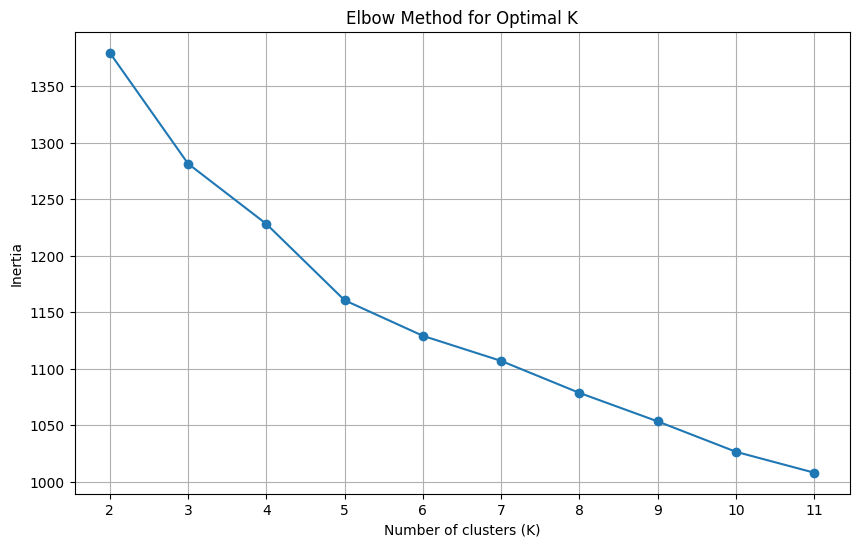

./elbow_test_export/SS-L_csv_50_3545_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  0  0  1  0  0  0  214.72  13        1
1    1  0  1  0  1  0  0  0  1  1  0  241.02  28        4
2    1  0  1  1  1  0  0  0  1  0  1  233.66  28        3
3    1  1  0  1  1  0  0  1  0  1  1  250.57  16        1
4    1  1  0  0  1  0  0  1  1  1  0  253.64  19        0
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  1  0  1  1  1  0  0  1  1  0  244.61  28        3
646  1  0  1  1  1  0  0  1  1  1  0  251.00  19        1
647  1  0  0  1  0  1  0  0  0  0  1  214.65  28        2
648  1  1  0  0  0  1  1  1  1  0  0  229.30  18        2
649  1  1  0  0  1  0  0  1  0  1  0  238.78  16        0

[650 rows x 14 columns]
[0.5117924362332362, 0.516037740365459, 0.5848281323735782, 0.7448588799818096, 0.7436836210667342, nan]
[0.5117924362332362, 0.516037740365459, 0.5848281323735782, 0.7448588799818096, 0.7436836210667342]
   

<Figure size 640x480 with 0 Axes>

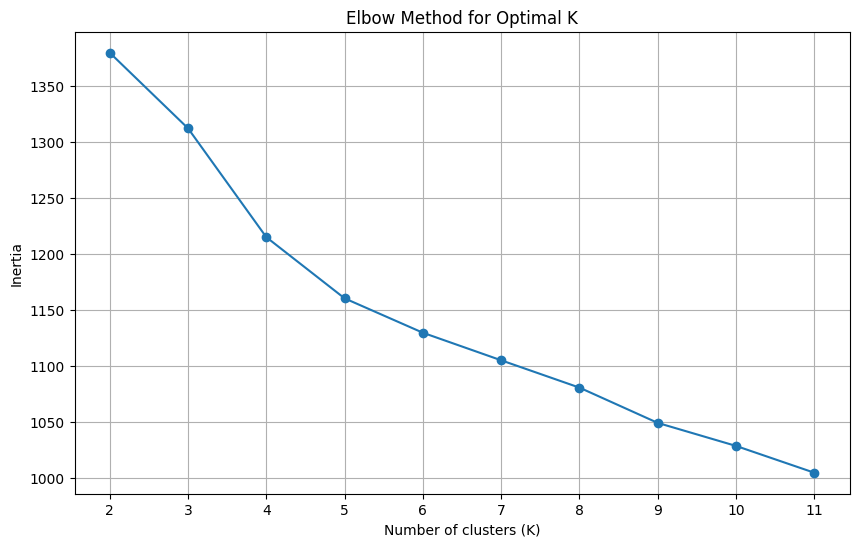

./elbow_test_export/SS-L_csv_50_39658_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  0  1  1  1  0  1  0  0  0  213.00  15        3
1    1  1  1  0  1  0  1  0  1  0  0  223.42  29        1
2    1  0  0  1  1  0  0  1  1  1  0  247.72  19        3
3    1  0  0  0  0  1  1  0  1  0  0  218.12  29        0
4    1  1  0  0  0  1  0  1  0  0  1  258.16  12        0
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  0  1  1  0  0  1  0  1  0  233.43  15        3
646  1  1  0  1  0  0  1  1  0  1  0  236.84  15        0
647  1  1  0  0  0  1  0  0  1  1  1  251.93  28        0
648  1  0  1  0  1  1  0  1  1  0  1  249.01  18        2
649  1  0  1  1  1  1  1  1  0  0  1  267.07  12        3

[650 rows x 14 columns]
[0.5799561392797993, 0.5829089992348736, 0.5692504982226031, 0.5681929701181878, 0.6036525275927027, nan]
[0.5799561392797993, 0.5829089992348736, 0.5692504982226031, 0.5681929701181878, 0.6036525275927027]


<Figure size 640x480 with 0 Axes>

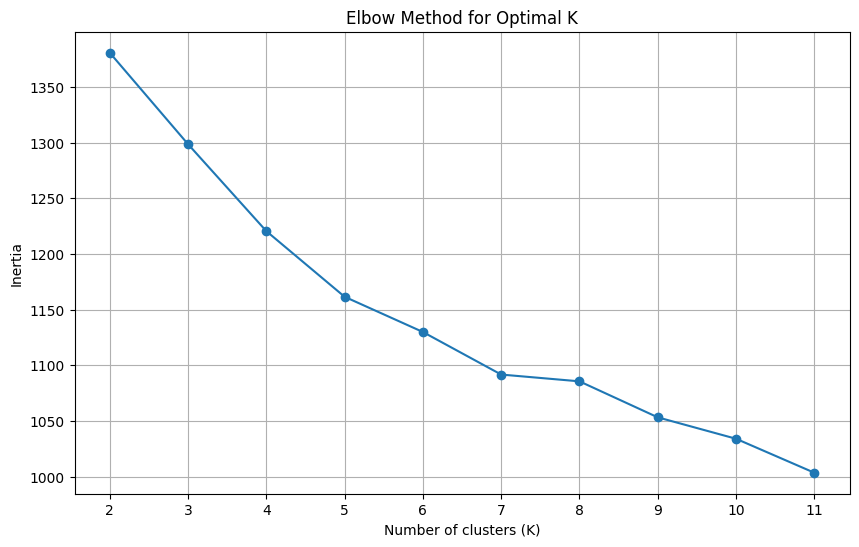

./elbow_test_export/SS-L_csv_50_40749_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  1  1  1  0  1  1  0  1  0  239.06  15        0
1    1  0  1  1  1  0  0  1  0  1  0  235.17  15        0
2    1  0  1  0  1  0  1  1  0  1  1  249.68  15        3
3    1  1  0  0  1  1  1  1  1  0  0  231.33  18        4
4    1  0  0  0  1  0  1  1  0  0  1  257.71  12        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  0  1  0  0  0  1  0  0  1  243.08  14        2
646  1  1  0  1  0  1  1  0  1  0  1  234.13  28        2
647  1  0  0  0  0  0  1  1  0  1  0  231.33  16        2
648  1  1  0  0  1  1  0  0  1  0  1  234.22  28        4
649  1  0  0  0  1  1  0  1  1  0  1  248.71  18        4

[650 rows x 14 columns]
[0.5542824680986905, 0.6480841155773059, 0.5584799203783443, 0.622720318007472, 0.5356304085009944, nan]
[0.5542824680986905, 0.6480841155773059, 0.5584799203783443, 0.622720318007472, 0.5356304085009944]
  

<Figure size 640x480 with 0 Axes>

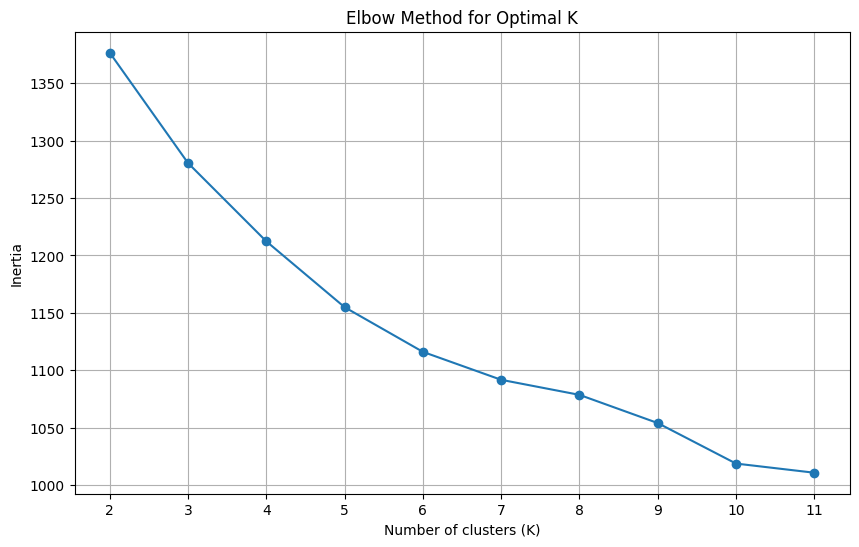

./elbow_test_export/SS-L_csv_50_44845_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  1  0  1  0  1  0  0  1  0  226.13  29        3
1    1  1  1  0  1  0  0  0  1  1  1  252.18  28        1
2    1  1  1  1  1  1  0  0  0  1  0  232.20  28        4
3    1  1  1  0  1  0  1  0  1  0  0  221.78  29        0
4    1  1  0  1  0  1  1  0  0  0  1  216.30  28        2
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  1  0  0  0  0  1  0  0  1  0  226.70  29        2
646  1  1  0  0  1  0  1  0  1  1  0  244.59  28        1
647  1  0  0  1  0  1  1  0  0  0  1  215.18  28        2
648  1  0  1  1  1  1  0  1  0  1  0  237.04  15        3
649  1  1  1  1  1  0  1  0  1  1  1  254.42  28        1

[650 rows x 14 columns]
[0.5962029925010017, 0.7364273320987003, 0.5827742557876008, 0.4972856150476825, 0.517359914094029, nan]
[0.5962029925010017, 0.7364273320987003, 0.5827742557876008, 0.4972856150476825, 0.517359914094029]
  

<Figure size 640x480 with 0 Axes>

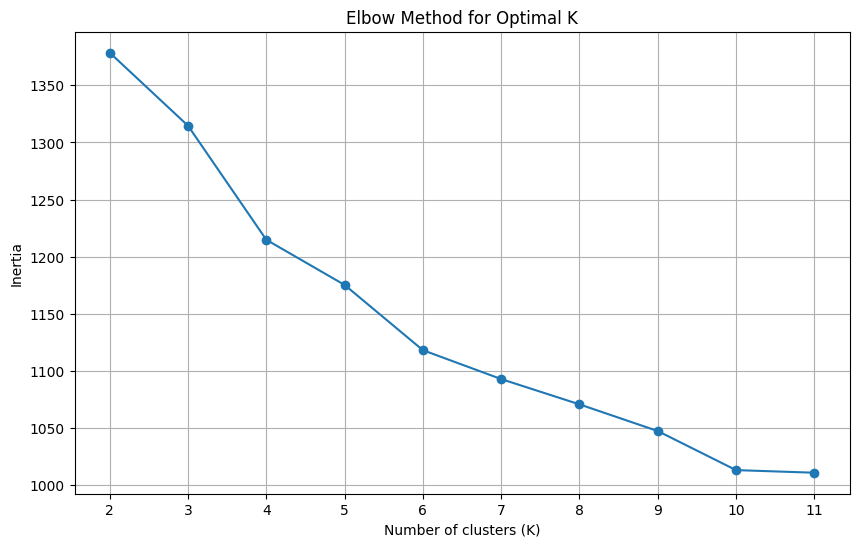

./elbow_test_export/SS-L_csv_50_51176_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  1  0  0  1  1  0  245.76  28        4
1    1  1  0  0  0  1  1  1  1  1  0  254.89  19        0
2    1  1  0  0  0  1  0  1  0  0  0  211.74  15        0
3    1  0  0  0  1  1  1  1  1  1  0  250.73  20        2
4    1  0  1  0  1  1  0  1  0  1  1  250.44  15        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  1  1  1  1  0  0  1  0  1  0  242.16  15        3
646  1  1  0  1  0  1  1  0  0  1  1  236.58  28        0
647  1  1  0  1  0  1  1  1  0  0  1  261.43  12        0
648  1  0  1  1  1  0  1  0  0  0  1  219.05  29        3
649  1  1  1  0  1  1  1  0  0  0  1  219.83  28        1

[650 rows x 14 columns]
[0.5846389972379168, 0.5080597883898051, 0.6513344929756826, 0.5209027894768198, 0.668291341895536, 0.5583183399046016, nan]
[0.5846389972379168, 0.5080597883898051, 0.6513344929756826, 0.5209027894768198, 0

<Figure size 640x480 with 0 Axes>

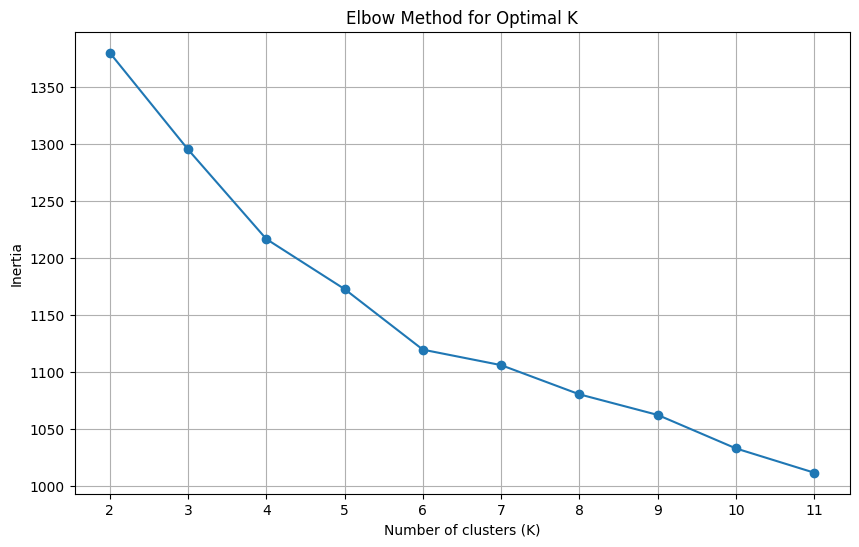

./elbow_test_export/SS-L_csv_50_58612_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  0  0  1  1  0  0  232.52  18        3
1    1  1  1  0  1  1  1  1  0  0  1  264.04  12        4
2    1  0  0  1  0  1  1  0  0  0  0  201.97  29        5
3    1  1  0  0  0  0  1  0  1  0  0  219.40  29        1
4    1  0  0  1  1  1  1  0  0  0  0  203.86  29        2
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  1  1  1  0  0  1  0  1  0  237.44  15        3
646  1  1  0  0  0  0  1  0  1  0  1  232.47  28        1
647  1  1  0  1  1  1  0  0  1  1  1  252.87  28        2
648  1  0  1  1  1  1  1  0  0  0  0  207.10  29        2
649  1  1  0  0  0  1  1  0  0  1  0  227.94  28        1

[650 rows x 14 columns]
[0.5758122302817635, 0.5646169241657818, 0.7390352478674599, 0.5111794328207866, 0.5977444135902312, 0.5651341549672947, nan]
[0.5758122302817635, 0.5646169241657818, 0.7390352478674599, 0.5111794328207866, 

<Figure size 640x480 with 0 Axes>

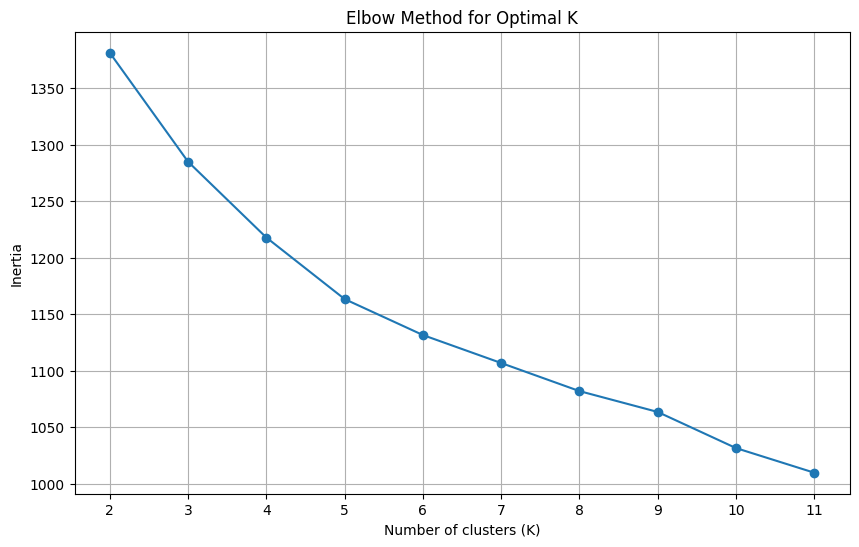

./elbow_test_export/SS-L_csv_50_61367_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  0  1  0  1  0  1  1  0  1  246.65  18        0
1    1  1  1  1  1  1  0  0  1  1  0  245.76  28        4
2    1  1  0  1  1  0  0  1  1  1  0  252.68  19        2
3    1  0  0  1  1  0  1  0  0  1  0  224.30  28        1
4    1  0  1  0  1  1  0  0  1  0  0  220.39  29        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  1  1  1  1  1  1  0  1  0  1  236.74  28        4
646  1  0  0  1  0  1  1  0  1  0  0  219.08  29        0
647  1  0  0  1  1  0  1  1  0  1  0  235.03  15        1
648  1  0  0  1  0  1  1  1  1  0  0  227.29  18        0
649  1  0  0  1  0  0  1  1  0  0  0  209.84  14        0

[650 rows x 14 columns]
[0.5802833050826391, 0.5819537293891357, 0.5236732688343868, 0.5829271092952758, 0.7384104996192545, nan]
[0.5802833050826391, 0.5819537293891357, 0.5236732688343868, 0.5829271092952758, 0.7384104996192545]


<Figure size 640x480 with 0 Axes>

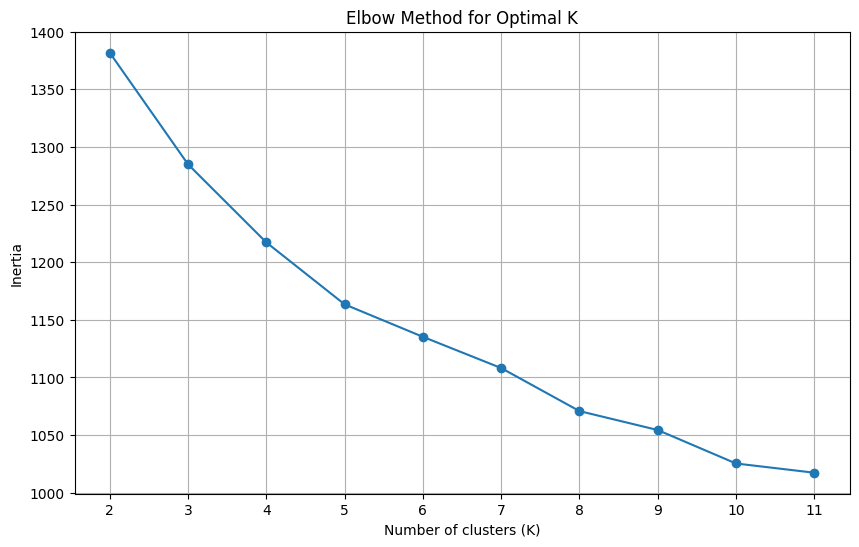

./elbow_test_export/SS-L_csv_50_65388_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  1  1  1  1  0  1  0  0  0  215.01  14        0
1    1  1  0  1  0  1  0  1  0  0  1  260.41  12        3
2    1  0  0  1  0  0  0  0  0  1  0  221.33  29        3
3    1  0  1  1  1  0  0  1  0  1  1  250.04  15        4
4    1  1  0  1  1  1  0  1  0  0  1  263.04  12        0
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  1  0  1  1  1  0  1  1  0  241.83  28        2
646  1  1  0  1  0  0  1  1  0  1  1  249.56  15        3
647  1  1  0  0  1  1  1  0  0  1  1  238.56  28        2
648  1  0  1  1  1  0  1  1  0  1  0  235.97  15        2
649  1  1  1  0  1  0  0  1  0  1  1  253.39  15        4

[650 rows x 14 columns]
[0.5897680635454191, 0.5301624881756153, 0.6467595343564452, 0.5730297460979776, 0.5649573382939514, nan]
[0.5897680635454191, 0.5301624881756153, 0.6467595343564452, 0.5730297460979776, 0.5649573382939514]


<Figure size 640x480 with 0 Axes>

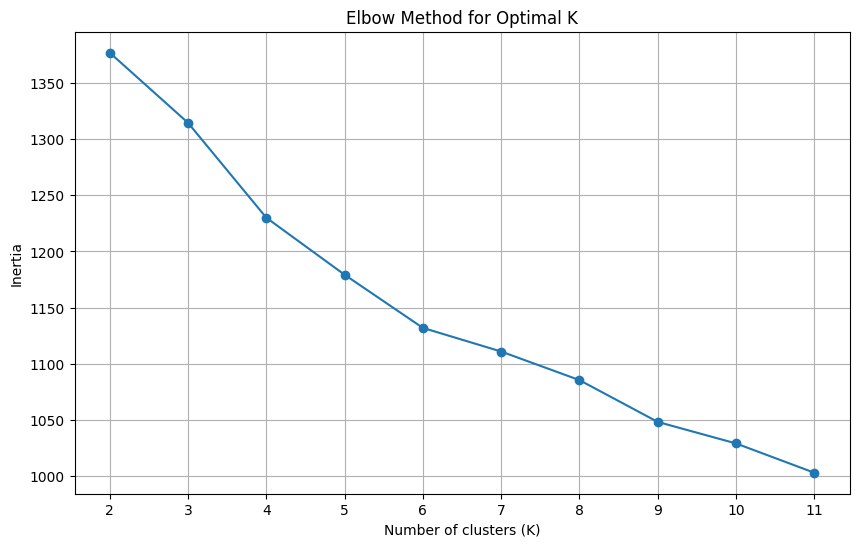

./elbow_test_export/SS-L_csv_50_65444_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  1  0  1  0  1  0  1  0  237.69  15        2
1    1  0  0  0  1  0  1  0  0  1  1  232.49  28        3
2    1  0  0  0  0  0  0  1  0  1  1  243.93  16        4
3    1  1  0  0  1  0  1  0  0  1  1  237.06  28        5
4    1  1  1  1  1  1  1  1  0  1  0  243.28  15        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  1  0  1  1  1  0  0  1  1  234.77  27        3
646  1  0  1  1  1  0  0  1  0  0  1  265.38  11        0
647  1  0  1  0  1  0  0  1  0  1  1  248.78  15        3
648  1  0  0  1  0  0  0  1  1  1  0  245.32  19        2
649  1  0  1  0  1  1  1  1  0  1  1  251.31  15        3

[650 rows x 14 columns]
[0.5911229421105971, 0.6004823954860901, 0.5628696744119343, 0.5646162403563709, 0.5630233987973061, 0.5760148741386664, nan]
[0.5911229421105971, 0.6004823954860901, 0.5628696744119343, 0.5646162403563709, 

<Figure size 640x480 with 0 Axes>

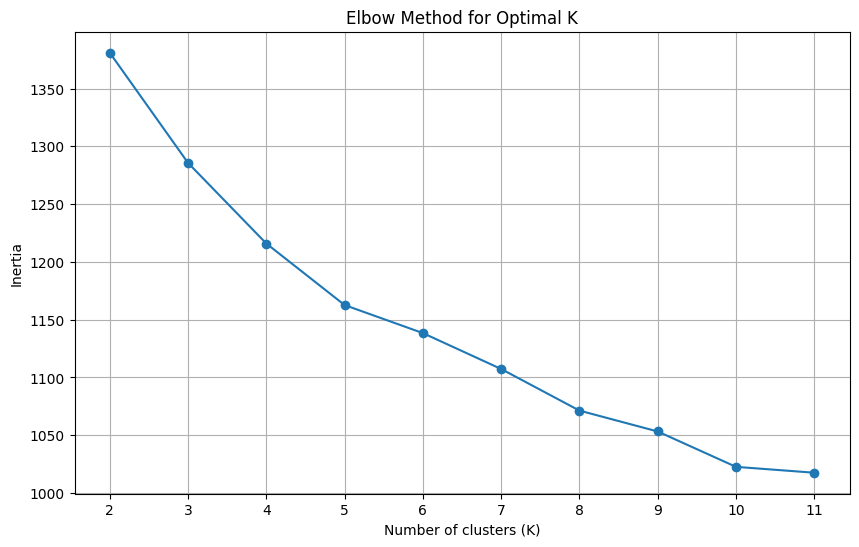

./elbow_test_export/SS-L_csv_50_66946_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  1  1  1  1  1  0  1  1  253.47  15        1
1    1  1  1  1  1  0  1  0  0  1  1  238.20  28        4
2    1  1  0  0  1  0  1  1  0  0  0  213.85  15        3
3    1  1  0  1  0  1  1  0  0  0  0  203.93  29        0
4    1  1  0  0  0  0  0  0  1  1  1  249.99  28        0
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  1  0  1  1  0  0  1  1  0  0  229.12  19        3
646  1  0  0  1  1  1  0  1  0  1  1  248.06  15        1
647  1  1  1  1  1  1  1  1  1  1  1  270.40  19        1
648  1  1  1  0  1  0  0  1  1  1  1  267.28  19        1
649  1  0  0  1  1  1  0  1  1  0  0  228.86  19        3

[650 rows x 14 columns]
[0.5736061528243203, 0.6121393016851703, 0.6117216936400489, 0.49350897584049286, 0.7532598378660303, nan]
[0.5736061528243203, 0.6121393016851703, 0.6117216936400489, 0.49350897584049286, 0.7532598378660303

<Figure size 640x480 with 0 Axes>

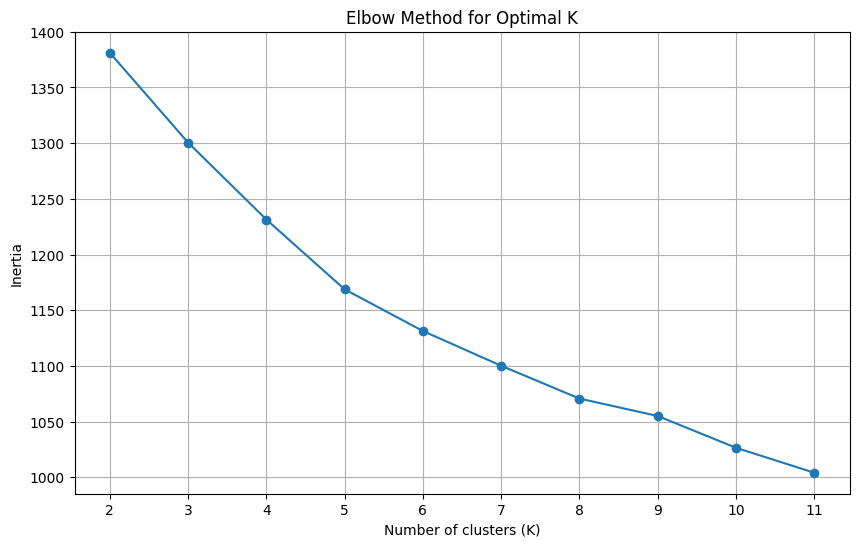

./elbow_test_export/SS-L_csv_50_69024_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  1  0  0  1  0  1  1  0  242.56  28        3
1    1  0  0  0  0  0  0  0  1  1  0  234.87  29        2
2    1  1  1  1  1  0  0  1  1  0  0  230.54  18        1
3    1  1  0  0  1  0  1  0  1  1  1  253.49  28        4
4    1  1  1  0  1  1  1  1  0  0  0  215.95  14        1
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  1  1  1  0  0  0  1  1  1  250.87  28        0
646  1  1  1  1  1  0  0  1  1  1  1  266.10  19        4
647  1  0  0  1  0  0  0  1  0  1  0  231.04  15        2
648  1  1  1  0  1  1  1  0  1  1  0  245.70  28        1
649  1  0  0  1  0  1  0  0  1  1  0  239.37  28        2

[650 rows x 14 columns]
[0.5753957154982144, 0.5536322341500454, 0.5706917522624033, 0.5666824109275335, 0.6556567797268854, nan]
[0.5753957154982144, 0.5536322341500454, 0.5706917522624033, 0.5666824109275335, 0.6556567797268854]


<Figure size 640x480 with 0 Axes>

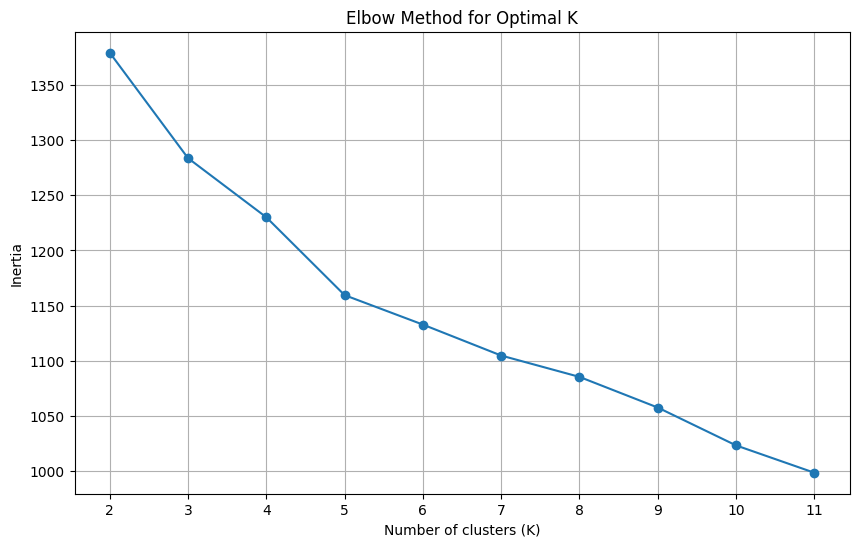

./elbow_test_export/SS-L_csv_50_70006_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  0  1  0  0  0  1  0  1  0  231.04  15        0
1    1  1  1  0  1  1  1  0  0  1  1  238.74  28        2
2    1  1  0  1  1  0  0  1  1  1  1  264.93  19        3
3    1  1  0  0  1  0  0  0  1  0  0  220.42  29        4
4    1  0  1  1  1  0  1  1  1  1  1  264.60  19        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  1  1  1  1  0  1  1  0  0  0  218.15  14        1
646  1  0  0  0  0  0  0  1  1  0  0  224.49  18        0
647  1  1  0  0  0  1  0  0  1  1  0  243.52  28        0
648  1  1  1  1  1  1  0  1  0  0  0  216.37  14        1
649  1  0  1  1  1  1  0  1  1  0  0  232.29  19        3

[650 rows x 14 columns]
[0.5596926373915602, 0.44470455564470807, 0.5893948725298054, 0.6762874536875919, 0.659827641341058, nan]
[0.5596926373915602, 0.44470455564470807, 0.5893948725298054, 0.6762874536875919, 0.659827641341058]


<Figure size 640x480 with 0 Axes>

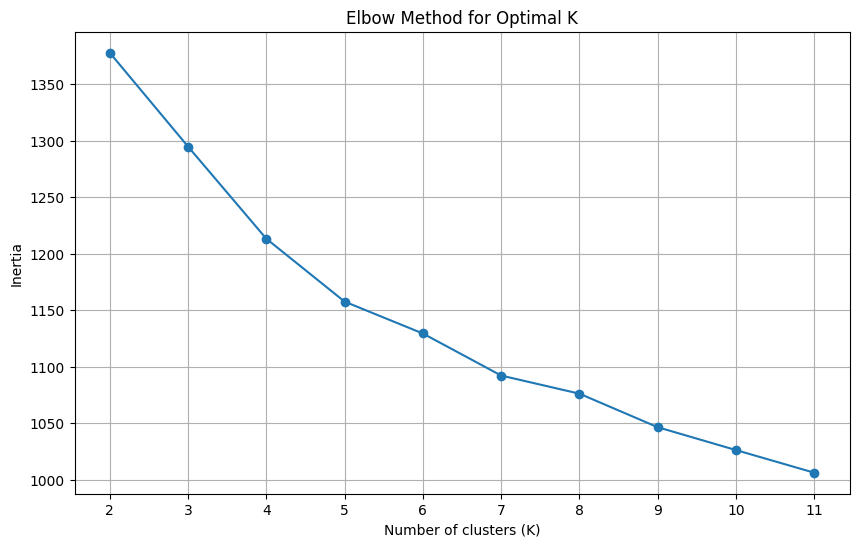

./elbow_test_export/SS-L_csv_50_70292_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  1  1  1  1  0  1  253.67  18        1
1    1  0  0  0  0  0  1  0  0  1  1  230.79  29        2
2    1  1  1  0  1  1  0  0  0  0  0  207.12  29        4
3    1  0  1  0  1  0  0  0  0  1  0  223.68  29        0
4    1  1  0  1  1  0  0  1  0  0  0  212.94  14        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  0  0  1  0  0  0  0  1  1  230.47  29        0
646  1  0  1  1  1  1  1  1  1  1  1  265.82  19        1
647  1  1  0  1  1  1  1  1  1  1  1  267.17  19        1
648  1  1  1  0  1  1  1  1  1  0  0  233.28  19        1
649  1  0  1  0  1  0  0  1  0  1  0  235.97  15        0

[650 rows x 14 columns]
[0.5790232371064828, 0.6713085990346597, 0.5680709818819403, 0.5661250714224398, 0.5110620284016462, nan]
[0.5790232371064828, 0.6713085990346597, 0.5680709818819403, 0.5661250714224398, 0.5110620284016462]


<Figure size 640x480 with 0 Axes>

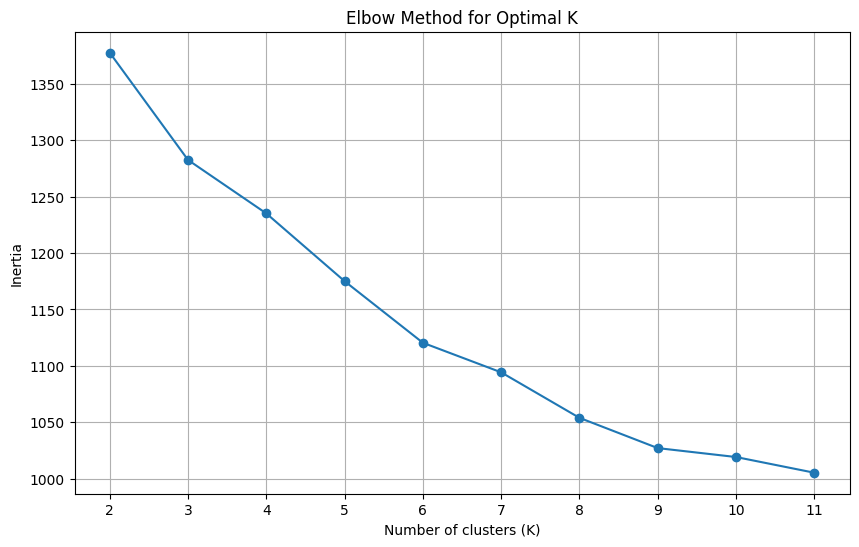

./elbow_test_export/SS-L_csv_50_77340_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  0  0  1  1  1  0  1  0  240.07  16        4
1    1  1  1  1  1  0  0  0  0  0  1  217.40  26        2
2    1  0  1  1  1  1  0  0  0  1  1  236.59  28        1
3    1  1  0  0  1  1  1  1  0  1  0  242.46  16        1
4    1  1  0  0  1  0  0  0  0  1  1  234.70  28        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  0  1  1  0  1  0  0  1  1  233.12  28        2
646  1  1  0  0  0  1  0  1  0  1  0  238.25  16        4
647  1  0  1  0  1  0  1  1  0  1  1  249.68  15        2
648  1  0  0  0  0  0  0  1  1  1  1  258.56  18        3
649  1  0  0  0  0  1  0  1  1  1  0  246.94  20        4

[650 rows x 14 columns]
[0.6654128297579219, 0.5345065743355467, 0.49730143944477473, 0.5740191051635523, 0.5698951715311957, 0.6709258070804632, nan]
[0.6654128297579219, 0.5345065743355467, 0.49730143944477473, 0.5740191051635523

<Figure size 640x480 with 0 Axes>

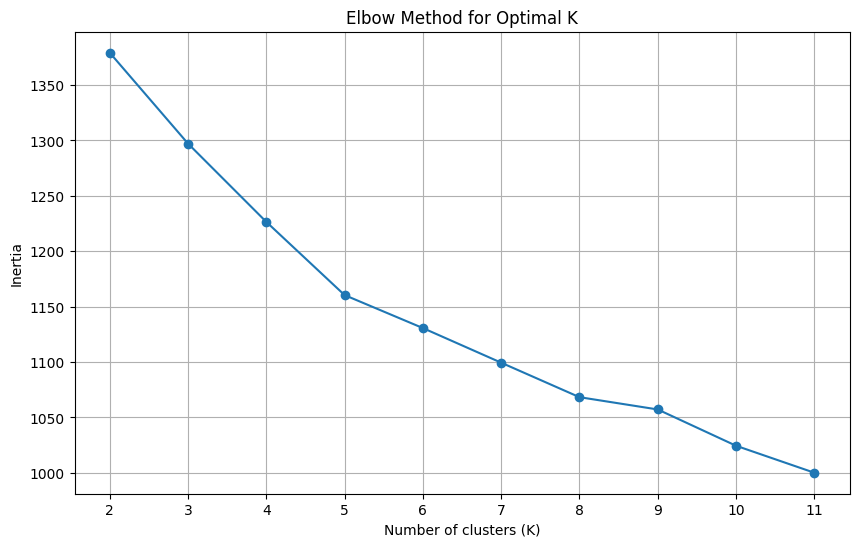

./elbow_test_export/SS-L_csv_50_77845_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  0  0  1  0  1  1  1  1  1  268.41  18        2
1    1  1  1  1  1  1  1  0  1  0  0  225.16  29        1
2    1  1  1  0  1  1  0  1  1  1  1  268.58  19        2
3    1  0  0  1  0  1  1  1  1  0  1  247.31  18        0
4    1  0  1  0  1  0  0  1  0  1  1  246.39  15        2
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  1  0  1  1  0  0  1  0  0  220.39  29        3
646  1  1  0  0  1  1  0  0  1  1  1  253.74  28        3
647  1  0  0  0  0  1  1  1  0  1  1  246.94  16        0
648  1  1  0  0  0  1  0  0  1  1  0  243.52  28        0
649  1  0  0  1  0  1  1  0  0  0  0  201.97  29        0

[650 rows x 14 columns]
[0.5642763159886316, 0.74639873162683, 0.504194130664869, 0.7327973228268331, 0.5246739038027816, nan]
[0.5642763159886316, 0.74639873162683, 0.504194130664869, 0.7327973228268331, 0.5246739038027816]
   A  

<Figure size 640x480 with 0 Axes>

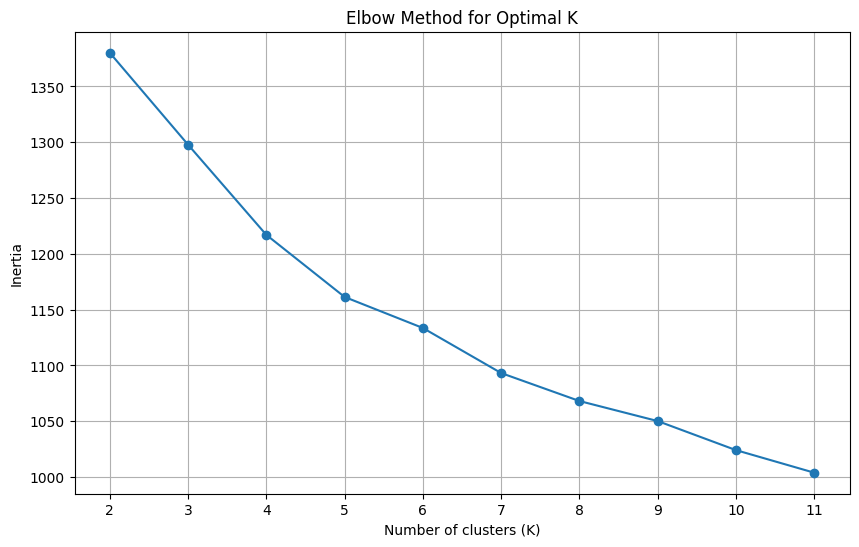

./elbow_test_export/SS-L_csv_50_83686_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  1  0  0  1  0  1  236.17  28        4
1    1  1  0  1  0  0  0  0  0  0  0  201.52  26        1
2    1  1  0  1  0  0  0  1  1  1  0  250.62  19        1
3    1  0  0  0  1  1  1  0  1  0  1  234.56  28        0
4    1  1  0  0  1  1  0  0  1  0  1  234.22  28        4
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  0  1  1  1  0  1  0  0  0  213.00  15        2
646  1  1  0  1  0  0  0  0  1  1  1  250.24  28        1
647  1  0  1  1  1  0  1  1  0  0  1  262.48  12        0
648  1  1  1  0  1  0  1  0  0  1  0  230.59  28        3
649  1  0  0  0  1  0  1  1  1  0  0  227.73  18        2

[650 rows x 14 columns]
[0.6287560671995335, 0.5664319352443085, 0.5148129840486583, 0.590950856969504, 0.5751113519353631, nan]
[0.6287560671995335, 0.5664319352443085, 0.5148129840486583, 0.590950856969504, 0.5751113519353631]
  

<Figure size 640x480 with 0 Axes>

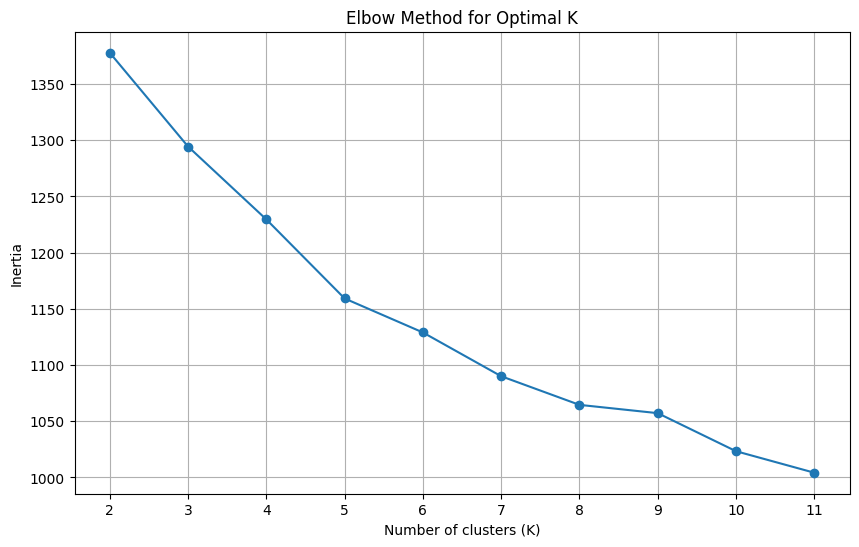

./elbow_test_export/SS-L_csv_50_84967_elbow_test.png
Optimal k value: 5
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  1  1  1  1  0  1  0  0  1  0  231.31  28        1
1    1  0  1  1  1  0  1  1  1  0  0  229.56  18        2
2    1  0  1  1  1  1  1  0  0  0  0  205.47  29        2
3    1  1  0  1  0  1  0  0  1  1  0  243.12  28        4
4    1  0  1  1  1  1  0  0  1  1  1  250.34  28        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  1  0  0  1  0  0  1  0  0  0  212.52  15        2
646  1  0  0  0  1  0  0  1  1  0  0  226.88  18        2
647  1  1  1  1  1  1  0  1  0  1  0  244.03  15        1
648  1  0  1  1  1  0  0  0  1  0  0  222.09  29        2
649  1  1  0  0  1  0  1  0  0  1  0  228.28  28        1

[650 rows x 14 columns]
[0.6130088111957445, 0.6277933171419592, 0.49235272758260845, 0.7600192040580259, 0.5535464660940759, nan]
[0.6130088111957445, 0.6277933171419592, 0.49235272758260845, 0.7600192040580259, 0.5535464660940759

<Figure size 640x480 with 0 Axes>

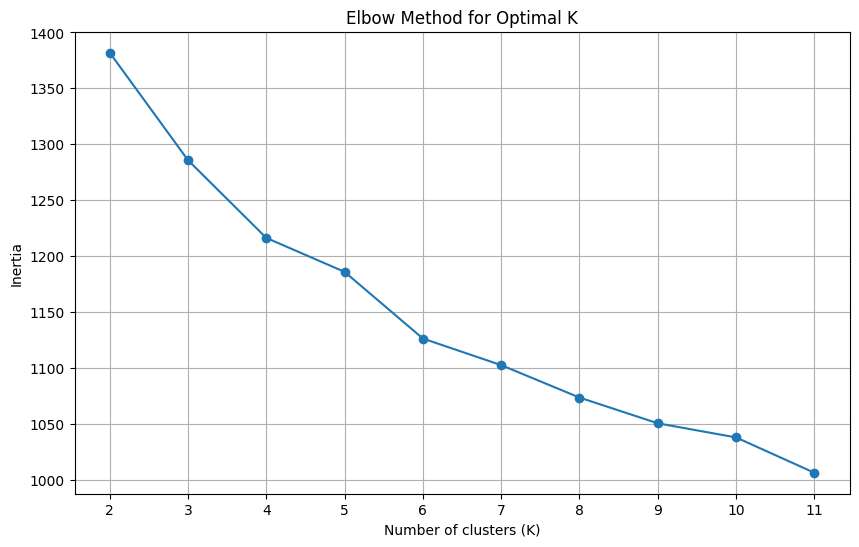

./elbow_test_export/SS-L_csv_50_86331_elbow_test.png
Optimal k value: 6
     A  B  C  D  E  F  G  H  I  J  K      A-  B-  cluster
0    1  0  1  1  1  0  1  1  0  0  1  265.65  12        5
1    1  1  1  1  1  0  1  1  1  0  1  252.50  18        5
2    1  1  0  0  0  0  0  1  1  0  0  227.01  18        0
3    1  0  1  1  1  1  0  1  0  0  1  263.75  12        2
4    1  0  0  0  1  1  0  1  1  0  1  248.71  18        3
..  .. .. .. .. .. .. .. .. .. .. ..     ...  ..      ...
645  1  0  1  1  1  0  0  1  1  1  1  261.44  19        5
646  1  0  0  1  0  1  0  1  0  1  0  232.96  15        1
647  1  0  0  0  0  1  1  0  0  0  0  200.92  29        1
648  1  0  1  0  1  0  0  0  1  1  1  250.05  28        5
649  1  1  1  0  1  1  1  0  1  1  0  245.70  28        3

[650 rows x 14 columns]
[0.628581487942491, 0.5668621224666658, 0.50517998247199, 0.6670272316386545, 0.49440497099722935, 0.5769653722193988, nan]
[0.628581487942491, 0.5668621224666658, 0.50517998247199, 0.6670272316386545, 0.494

<Figure size 640x480 with 0 Axes>

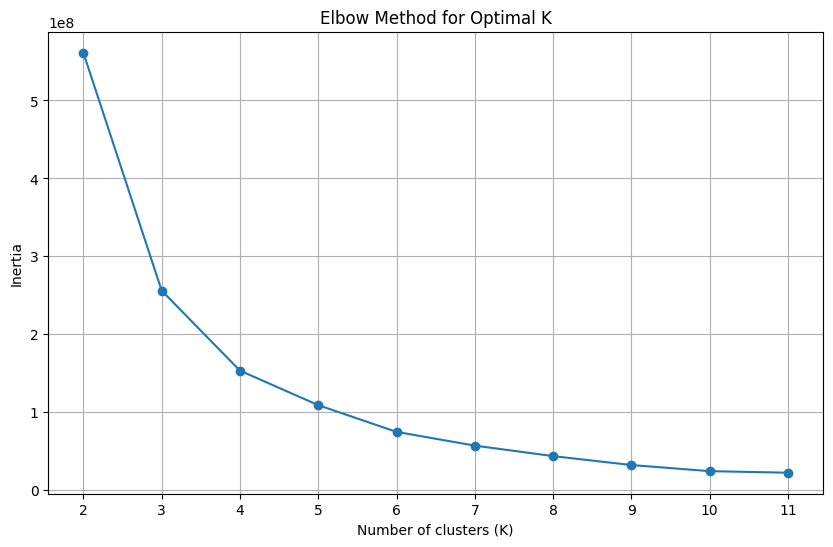

./elbow_test_export/SS-M_csv_100_11514_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     0         1        0               0  1       0     1          0      1   
1     1         1        0               0  0       0     0          1      1   
2     1         1        0               1  0       0     0          1      1   
3     0         1        0               1  1       0     0          1      1   
4     0         1        0               0  1       0     1          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  0         1        0               1  1       0     0          1      1   
1496  0         1        0               0  1       0     1          0      1   
1497  0         1        0               0  1       0     1          0      1   
1498  1         1        0               1  0       0     0          1      1   
1499  0         1        0          

<Figure size 640x480 with 0 Axes>

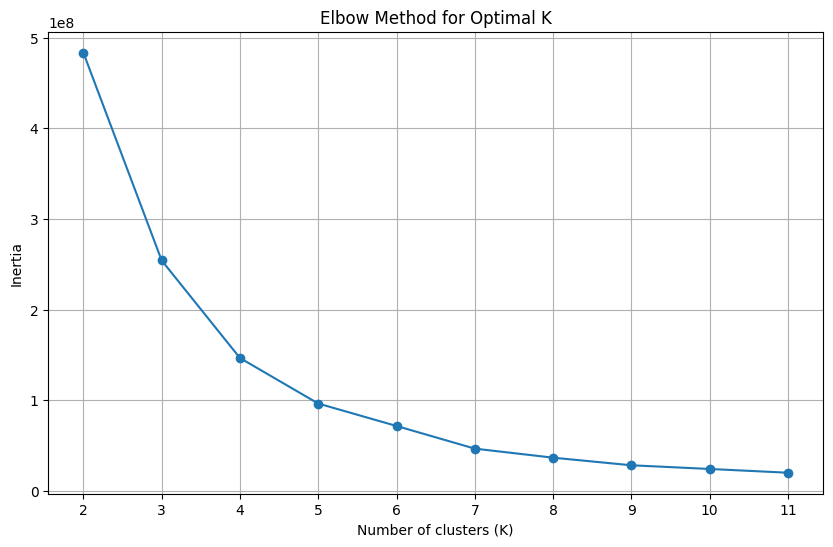

./elbow_test_export/SS-M_csv_100_19953_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               0  0       0     1          0      1   
1     0         1        0               0  1       1     0          0      1   
2     0         1        0               0  1       0     1          0      1   
3     1         1        0               0  0       0     1          0      1   
4     0         1        0               1  1       0     0          1      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  0         1        0               0  1       1     0          0      1   
1496  0         1        0               1  1       0     1          0      1   
1497  0         1        0               1  1       0     1          0      1   
1498  1         1        0               1  0       0     1          0      1   
1499  1         1        1          

<Figure size 640x480 with 0 Axes>

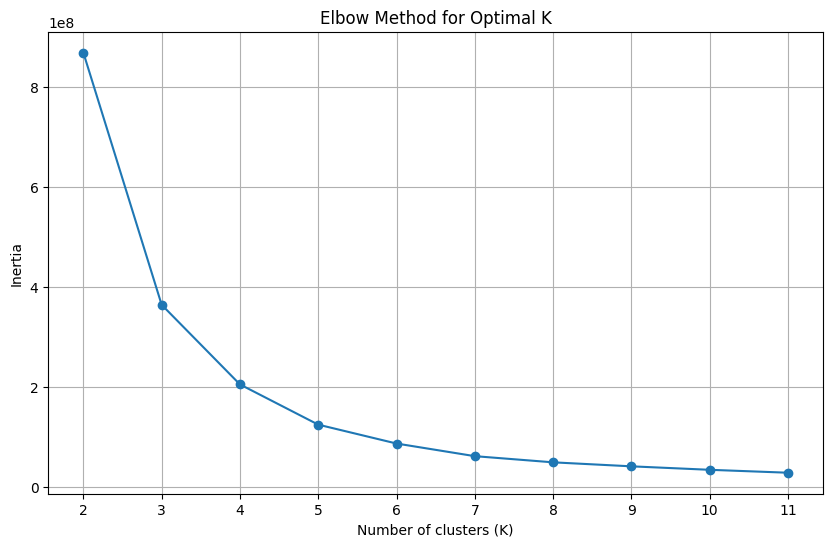

./elbow_test_export/SS-M_csv_100_3545_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               0  0       0     0          1      1   
1     0         1        0               1  1       1     0          0      1   
2     0         1        0               0  1       1     0          0      1   
3     0         1        0               1  1       1     0          0      1   
4     0         1        1               0  1       0     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        0               1  0       0     0          1      1   
1496  1         1        0               0  0       0     1          0      1   
1497  1         1        0               1  0       1     0          0      1   
1498  1         1        0               0  0       0     0          1      1   
1499  1         1        1           

<Figure size 640x480 with 0 Axes>

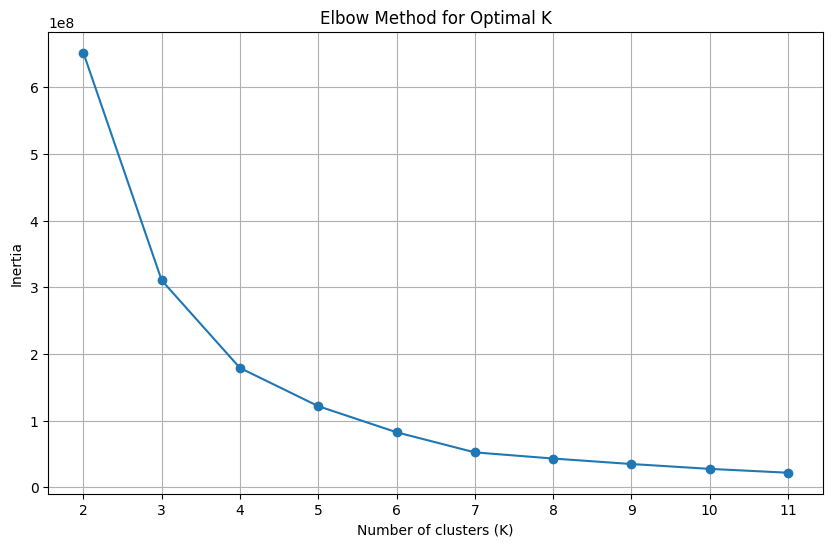

./elbow_test_export/SS-M_csv_100_39658_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               1  0       0     1          0      1   
1     0         1        0               0  1       0     0          1      1   
2     1         1        0               1  0       0     0          1      1   
3     1         1        0               1  0       0     0          1      1   
4     1         1        0               0  0       0     1          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  0         1        0               0  1       1     0          0      1   
1496  1         1        1               1  0       0     0          0      1   
1497  0         1        0               1  1       1     0          0      1   
1498  1         1        0               0  0       0     0          1      1   
1499  0         1        0          

<Figure size 640x480 with 0 Axes>

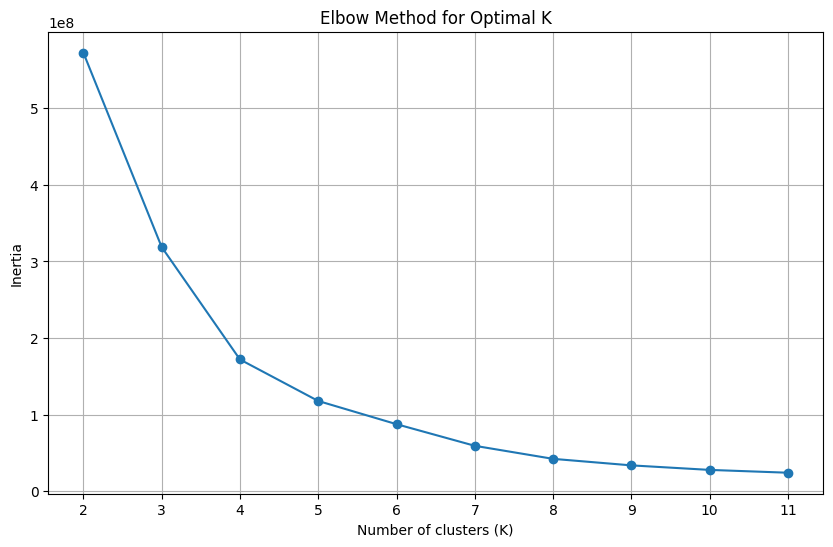

./elbow_test_export/SS-M_csv_100_40749_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     0         1        0               1  1       0     1          0      1   
1     0         1        1               1  1       0     0          0      1   
2     0         1        0               1  1       0     0          1      1   
3     0         1        0               1  1       1     0          0      1   
4     1         1        1               1  0       0     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        0               0  0       0     1          0      1   
1496  1         1        1               1  0       0     0          0      1   
1497  0         1        1               1  1       0     0          0      1   
1498  0         1        0               1  1       1     0          0      1   
1499  0         1        0          

<Figure size 640x480 with 0 Axes>

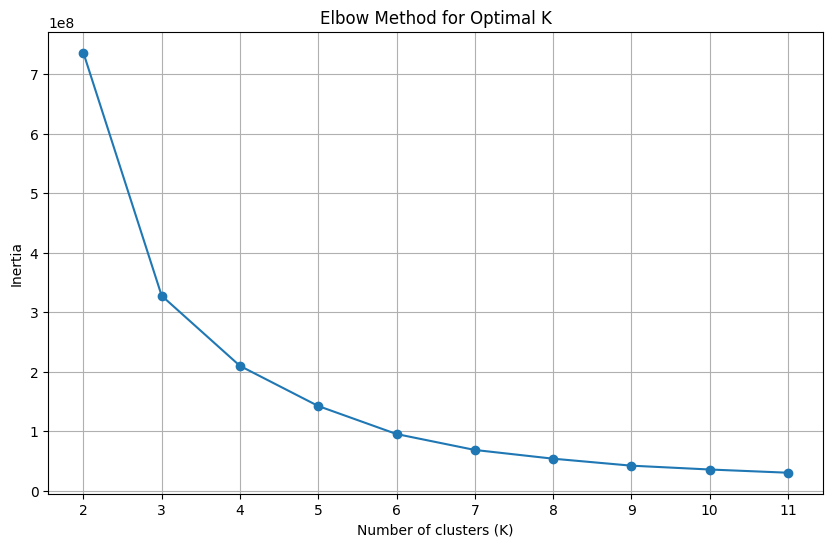

./elbow_test_export/SS-M_csv_100_44845_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     0         1        0               0  1       1     0          0      1   
1     1         1        0               1  0       0     1          0      1   
2     0         1        0               1  1       0     0          1      1   
3     0         1        1               0  1       0     0          0      1   
4     1         1        1               1  0       0     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        0               0  0       0     0          1      1   
1496  0         1        0               0  1       1     0          0      1   
1497  1         1        0               1  0       0     0          1      1   
1498  1         1        1               1  0       0     0          0      1   
1499  1         1        0          

<Figure size 640x480 with 0 Axes>

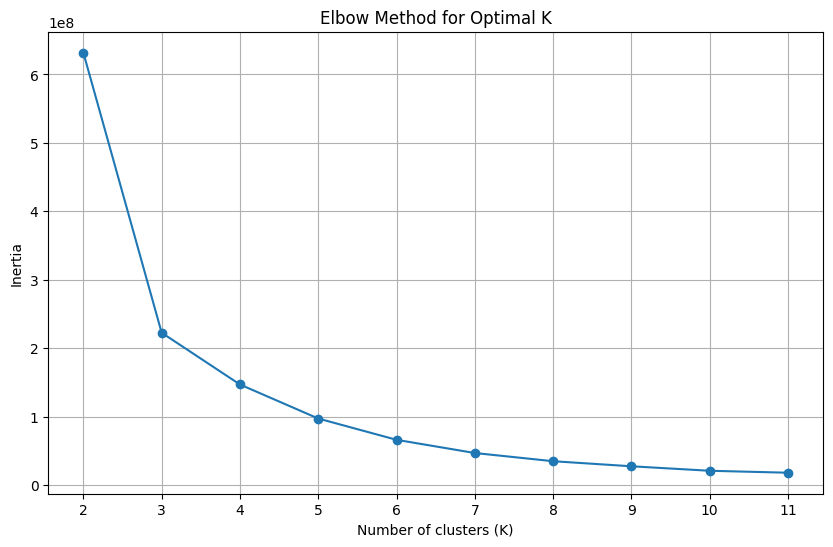

./elbow_test_export/SS-M_csv_100_51176_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     0         1        0               0  1       1     0          0      1   
1     0         1        0               0  1       1     0          0      1   
2     1         1        0               1  0       0     1          0      1   
3     1         1        0               1  0       0     1          0      1   
4     1         1        0               0  0       0     0          1      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  0         1        0               1  1       0     0          1      1   
1496  1         1        0               0  0       1     0          0      1   
1497  0         1        0               0  1       0     0          1      1   
1498  1         1        0               0  0       1     0          0      1   
1499  0         1        0          

<Figure size 640x480 with 0 Axes>

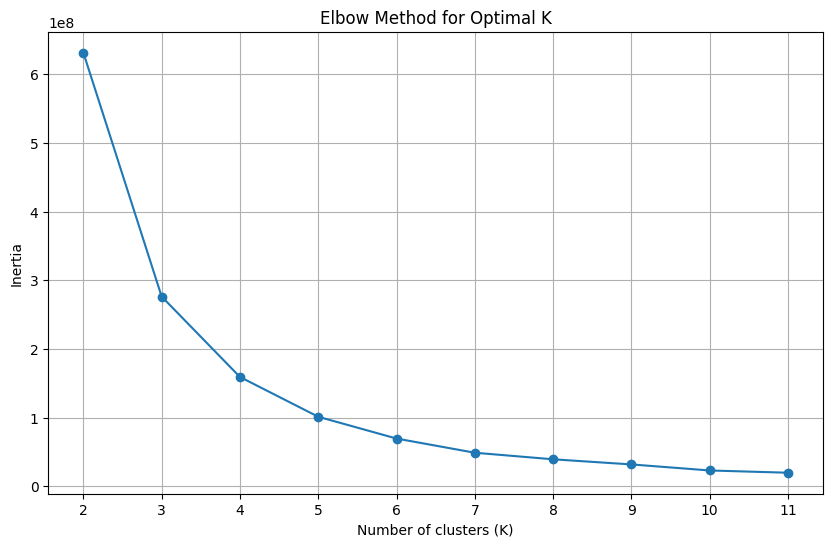

./elbow_test_export/SS-M_csv_100_58612_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               1  0       0     1          0      1   
1     0         1        0               1  1       1     0          0      1   
2     0         1        0               1  1       0     0          1      1   
3     1         1        0               0  0       1     0          0      1   
4     0         1        1               0  1       0     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  0         1        0               1  1       1     0          0      1   
1496  1         1        0               1  0       0     1          0      1   
1497  0         1        1               1  1       0     0          0      1   
1498  0         1        0               1  1       0     0          1      1   
1499  1         1        0          

<Figure size 640x480 with 0 Axes>

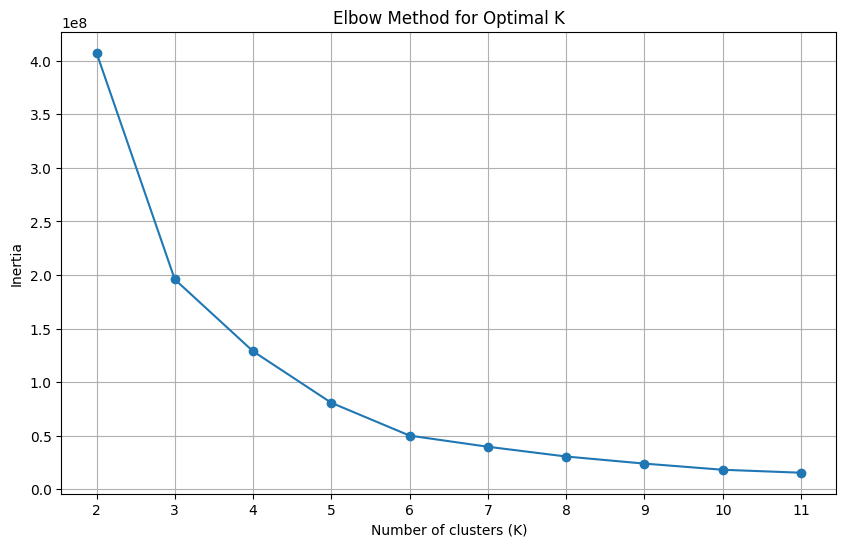

./elbow_test_export/SS-M_csv_100_61367_elbow_test.png
Optimal k value: 5
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               1  0       0     0          1      1   
1     1         1        0               0  0       1     0          0      1   
2     1         1        1               1  0       0     0          0      1   
3     0         1        0               1  1       1     0          0      1   
4     0         1        1               0  1       0     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        0               0  0       0     1          0      1   
1496  0         1        0               1  1       1     0          0      1   
1497  0         1        0               1  1       0     0          1      1   
1498  0         1        0               1  1       0     0          1      1   
1499  1         1        0          

<Figure size 640x480 with 0 Axes>

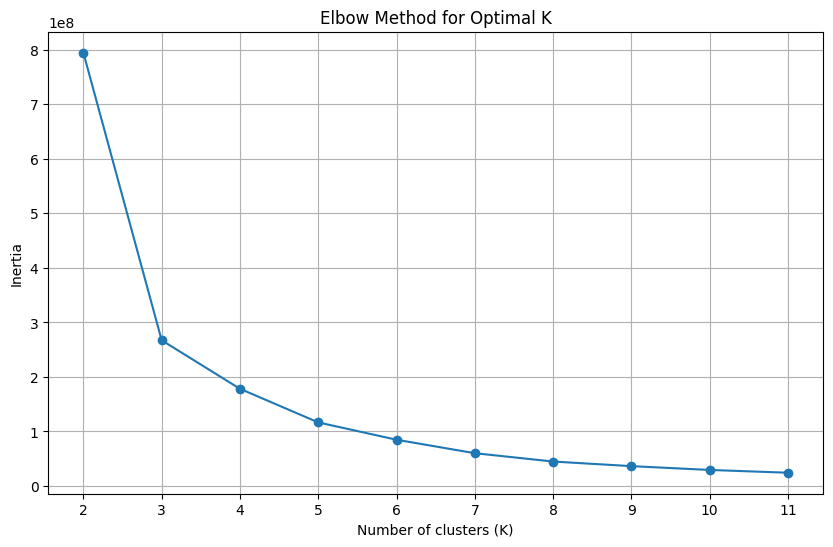

./elbow_test_export/SS-M_csv_100_65388_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               1  0       0     0          1      1   
1     0         1        0               0  1       0     0          1      1   
2     1         1        0               1  0       1     0          0      1   
3     1         1        0               0  0       1     0          0      1   
4     0         1        0               0  1       0     0          1      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        1               1  0       0     0          0      1   
1496  0         1        0               0  1       0     0          1      1   
1497  0         1        1               1  1       0     0          0      1   
1498  1         1        1               1  0       0     0          0      1   
1499  0         1        0          

<Figure size 640x480 with 0 Axes>

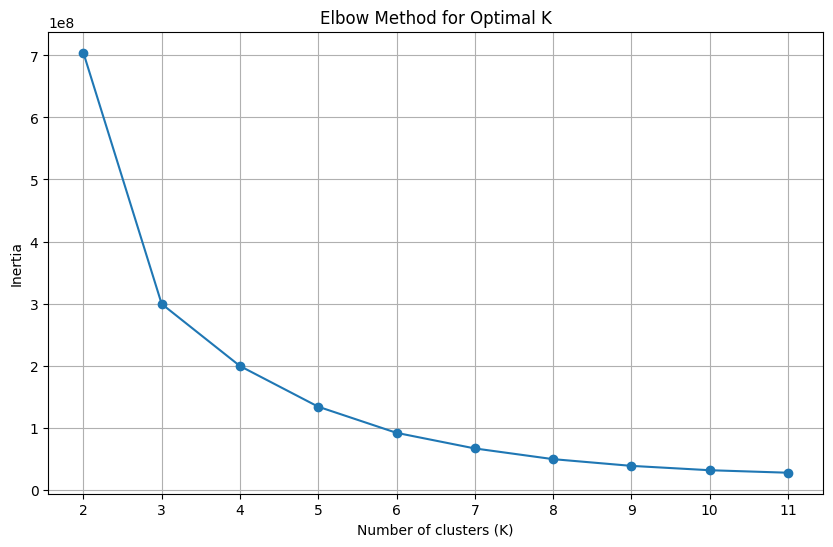

./elbow_test_export/SS-M_csv_100_65444_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               0  0       0     0          1      1   
1     1         1        1               0  0       0     0          0      1   
2     0         1        0               0  1       0     1          0      1   
3     0         1        1               0  1       0     0          0      1   
4     1         1        0               1  0       1     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        0               1  0       0     0          1      1   
1496  1         1        0               0  0       0     0          1      1   
1497  0         1        0               1  1       1     0          0      1   
1498  0         1        1               1  1       0     0          0      1   
1499  0         1        0          

<Figure size 640x480 with 0 Axes>

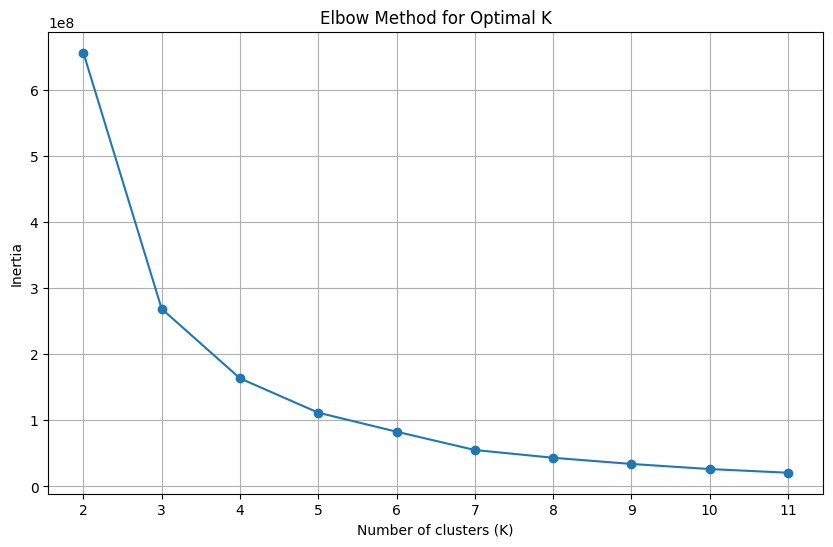

./elbow_test_export/SS-M_csv_100_66946_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               0  0       1     0          0      1   
1     0         1        0               0  1       0     0          1      1   
2     1         1        0               1  0       1     0          0      1   
3     0         1        0               1  1       1     0          0      1   
4     1         1        0               0  0       1     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        0               0  0       0     0          1      1   
1496  0         1        0               0  1       0     0          1      1   
1497  1         1        0               1  0       1     0          0      1   
1498  1         1        0               0  0       0     0          1      1   
1499  1         1        0          

<Figure size 640x480 with 0 Axes>

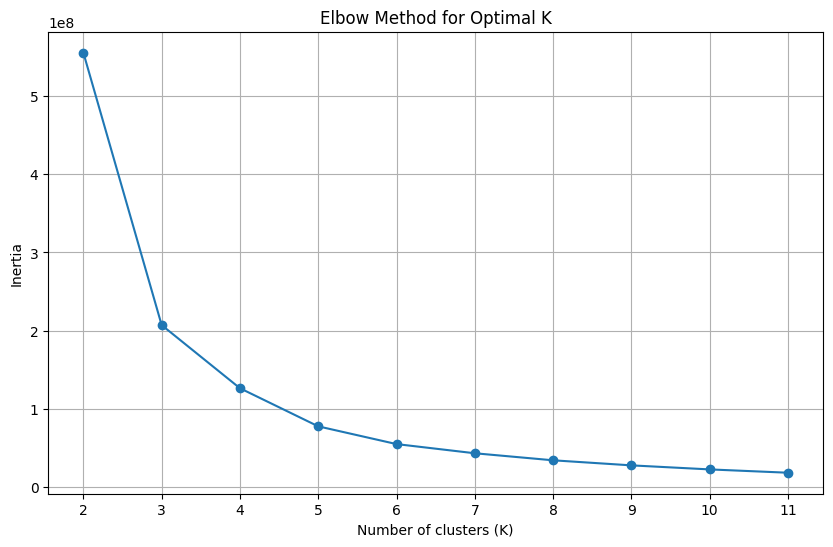

./elbow_test_export/SS-M_csv_100_69024_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               0  0       0     0          1      1   
1     1         1        1               0  0       0     0          0      1   
2     1         1        1               0  0       0     0          0      1   
3     1         1        0               0  0       0     0          1      1   
4     1         1        0               1  0       1     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        1               1  0       0     0          0      1   
1496  1         1        0               1  0       0     1          0      1   
1497  1         1        1               0  0       0     0          0      1   
1498  1         1        0               0  0       0     0          1      1   
1499  0         1        0          

<Figure size 640x480 with 0 Axes>

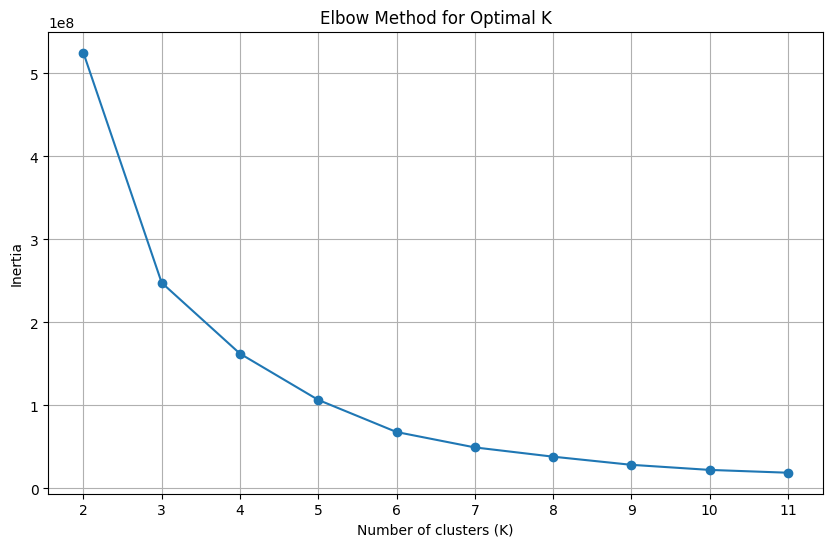

./elbow_test_export/SS-M_csv_100_70006_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     0         1        0               1  1       0     0          1      1   
1     0         1        0               1  1       1     0          0      1   
2     1         1        1               0  0       0     0          0      1   
3     0         1        0               0  1       1     0          0      1   
4     1         1        1               1  0       0     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        0               1  0       1     0          0      1   
1496  0         1        1               0  1       0     0          0      1   
1497  0         1        0               0  1       0     1          0      1   
1498  0         1        0               0  1       0     0          1      1   
1499  1         1        1          

<Figure size 640x480 with 0 Axes>

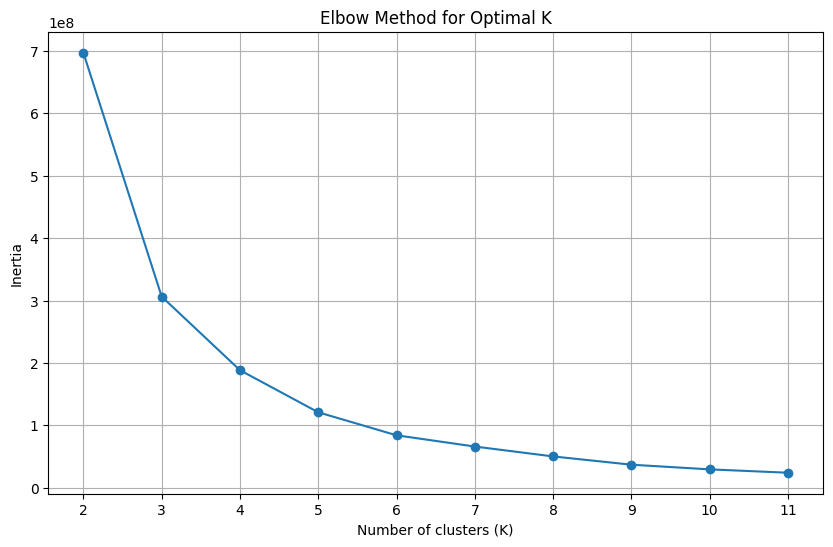

./elbow_test_export/SS-M_csv_100_70292_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        1               1  0       0     0          0      1   
1     1         1        1               0  0       0     0          0      1   
2     1         1        0               1  0       0     1          0      1   
3     0         1        0               0  1       0     1          0      1   
4     0         1        0               1  1       0     1          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        0               1  0       0     1          0      1   
1496  1         1        0               1  0       1     0          0      1   
1497  0         1        0               0  1       0     1          0      1   
1498  1         1        0               0  0       1     0          0      1   
1499  0         1        0          

<Figure size 640x480 with 0 Axes>

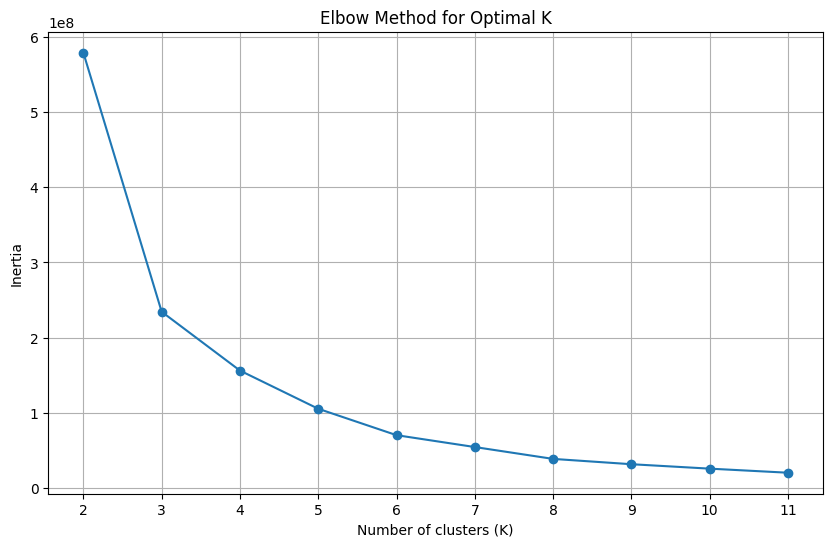

./elbow_test_export/SS-M_csv_100_77340_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     0         1        0               1  1       0     1          0      1   
1     1         1        0               0  0       0     0          1      1   
2     1         1        0               0  0       0     0          1      1   
3     0         1        1               0  1       0     0          0      1   
4     0         1        0               1  1       0     0          1      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  0         1        0               1  1       1     0          0      1   
1496  1         1        0               1  0       0     0          1      1   
1497  1         1        1               1  0       0     0          0      1   
1498  1         1        0               0  0       0     1          0      1   
1499  1         1        0          

<Figure size 640x480 with 0 Axes>

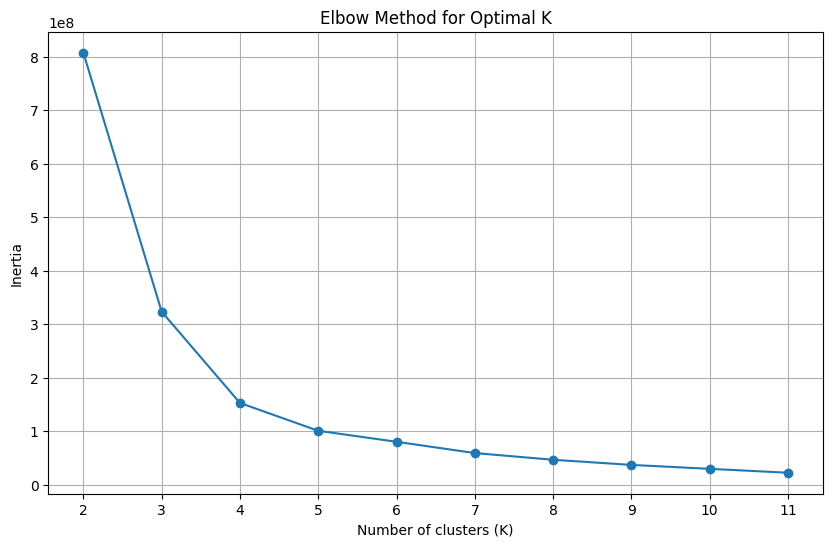

./elbow_test_export/SS-M_csv_100_77845_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               0  0       0     0          1      1   
1     0         1        0               1  1       0     1          0      1   
2     1         1        0               1  0       1     0          0      1   
3     1         1        1               0  0       0     0          0      1   
4     1         1        0               0  0       1     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  0         1        1               1  1       0     0          0      1   
1496  0         1        1               0  1       0     0          0      1   
1497  1         1        0               0  0       1     0          0      1   
1498  0         1        0               1  1       0     0          1      1   
1499  0         1        1          

<Figure size 640x480 with 0 Axes>

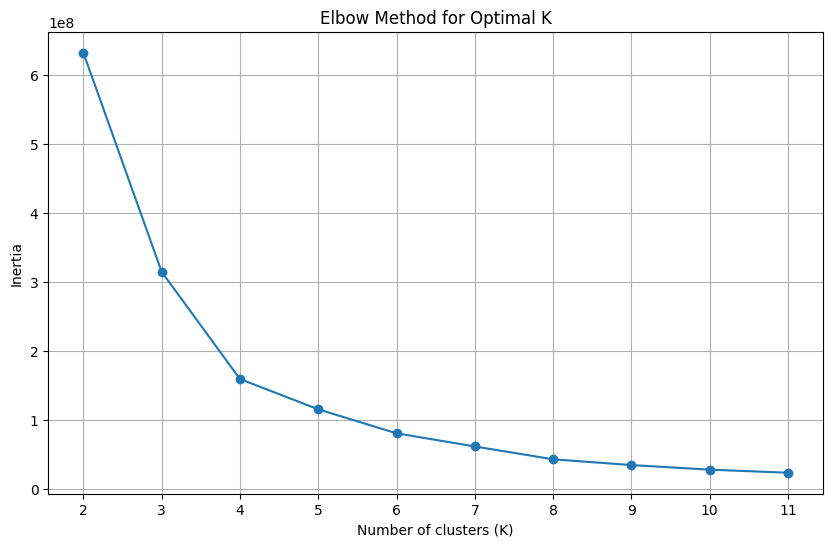

./elbow_test_export/SS-M_csv_100_83686_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               1  0       1     0          0      1   
1     1         1        0               1  0       0     1          0      1   
2     0         1        0               1  1       0     1          0      1   
3     0         1        0               0  1       0     0          1      1   
4     1         1        0               1  0       1     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        0               1  0       1     0          0      1   
1496  1         1        0               0  0       0     1          0      1   
1497  1         1        0               1  0       0     1          0      1   
1498  0         1        0               0  1       1     0          0      1   
1499  1         1        0          

<Figure size 640x480 with 0 Axes>

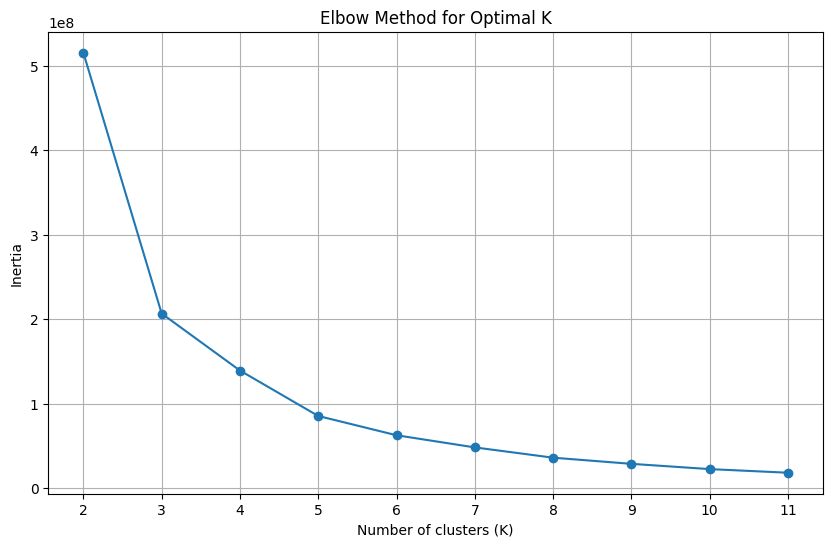

./elbow_test_export/SS-M_csv_100_84967_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     0         1        0               0  1       0     1          0      1   
1     1         1        0               0  0       0     0          1      1   
2     1         1        0               0  0       0     1          0      1   
3     1         1        1               1  0       0     0          0      1   
4     1         1        1               0  0       0     0          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  0         1        0               1  1       1     0          0      1   
1496  0         1        0               1  1       1     0          0      1   
1497  0         1        0               1  1       0     1          0      1   
1498  1         1        0               0  0       0     0          1      1   
1499  0         1        0          

<Figure size 640x480 with 0 Axes>

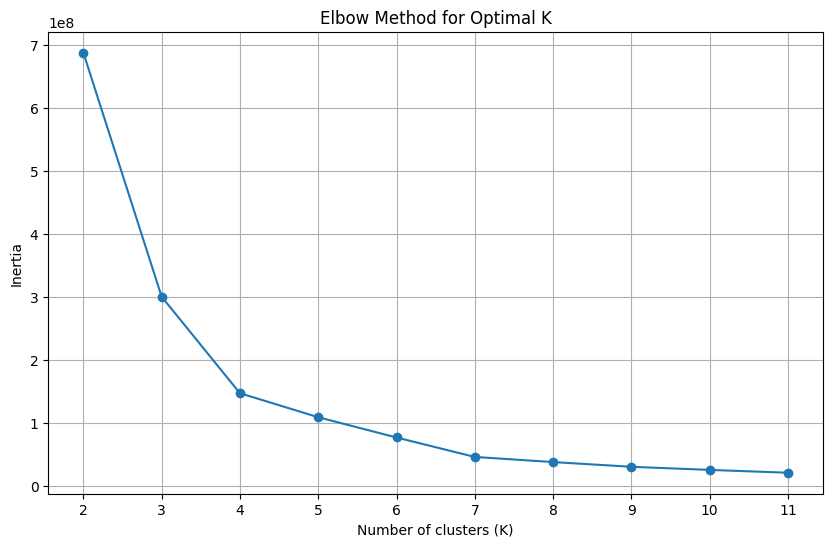

./elbow_test_export/SS-M_csv_100_86331_elbow_test.png
Optimal k value: 4
      F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0     1         1        0               0  0       0     0          1      1   
1     0         1        0               1  1       1     0          0      1   
2     1         1        0               1  0       0     1          0      1   
3     1         1        1               0  0       0     0          0      1   
4     1         1        0               0  0       0     1          0      1   
...  ..       ...      ...             ... ..     ...   ...        ...    ...   
1495  1         1        1               0  0       0     0          0      1   
1496  1         1        0               1  0       1     0          0      1   
1497  1         1        1               1  0       0     0          0      1   
1498  1         1        0               0  0       0     1          0      1   
1499  1         1        1          

<Figure size 640x480 with 0 Axes>

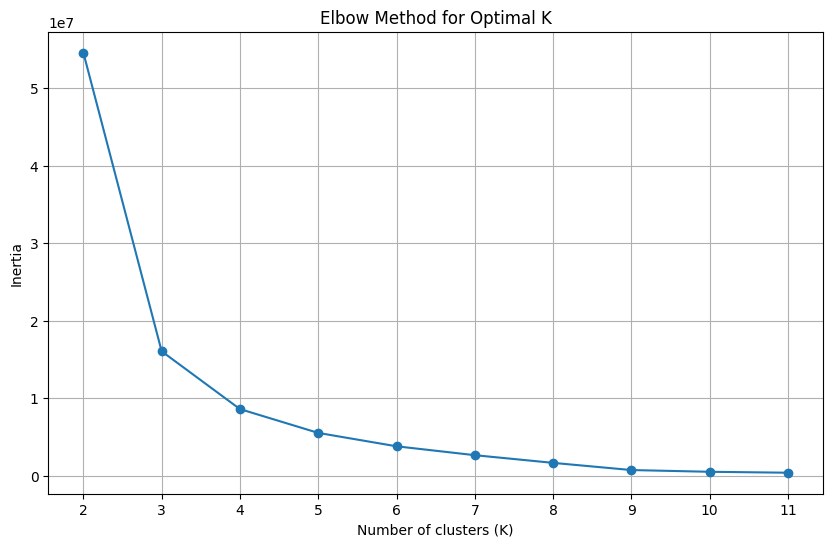

./elbow_test_export/SS-M_csv_10_11514_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               0  1       0     1          0      1   
1    1         1        0               0  0       0     0          1      1   
2    1         1        0               1  0       0     0          1      1   
3    0         1        0               1  1       0     0          1      1   
4    0         1        0               0  1       0     1          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        0               0  1       1     0          0      1   
146  0         1        0               0  1       1     0          0      1   
147  1         1        1               0  0       0     0          0      1   
148  1         1        0               0  0       0     1          0      1   
149  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

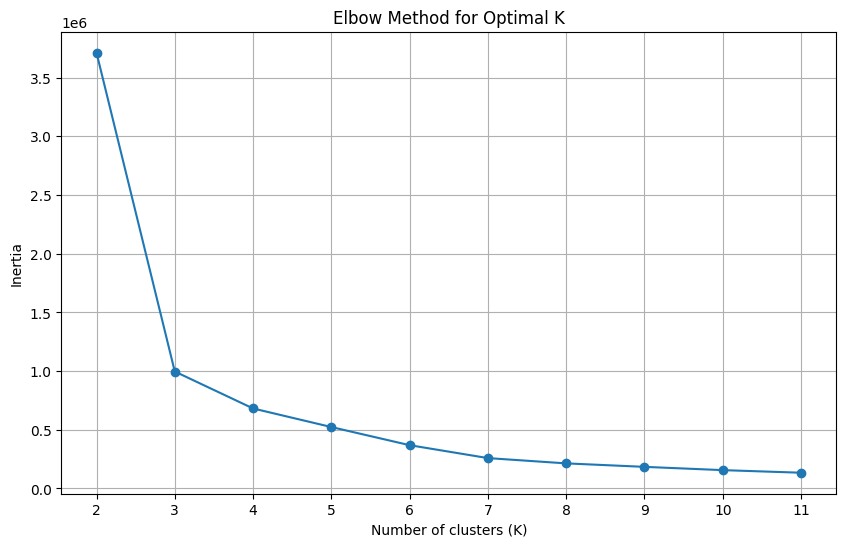

./elbow_test_export/SS-M_csv_10_19953_elbow_test.png
Optimal k value: 3
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     1          0      1   
1    0         1        0               0  1       1     0          0      1   
2    0         1        0               0  1       0     1          0      1   
3    1         1        0               0  0       0     1          0      1   
4    0         1        0               1  1       0     0          1      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        0               1  1       1     0          0      1   
146  0         1        0               1  1       0     0          1      1   
147  0         1        0               0  1       1     0          0      1   
148  1         1        0               0  0       0     0          1      1   
149  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

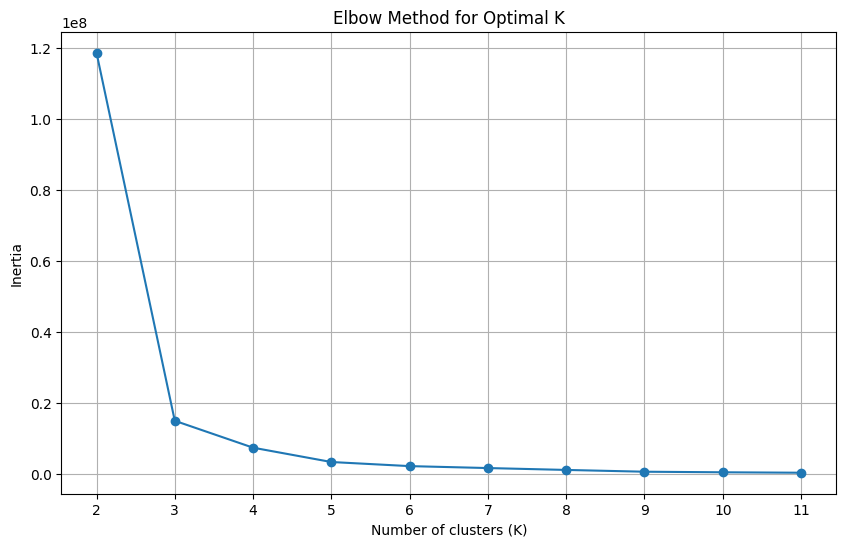

./elbow_test_export/SS-M_csv_10_3545_elbow_test.png
Optimal k value: 3
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    0         1        0               1  1       1     0          0      1   
2    0         1        0               0  1       1     0          0      1   
3    0         1        0               1  1       1     0          0      1   
4    0         1        1               0  1       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        1               0  0       0     0          0      1   
146  0         1        1               0  1       0     0          0      1   
147  1         1        0               0  0       1     0          0      1   
148  0         1        1               1  1       0     0          0      1   
149  1         1        0               0  0     

<Figure size 640x480 with 0 Axes>

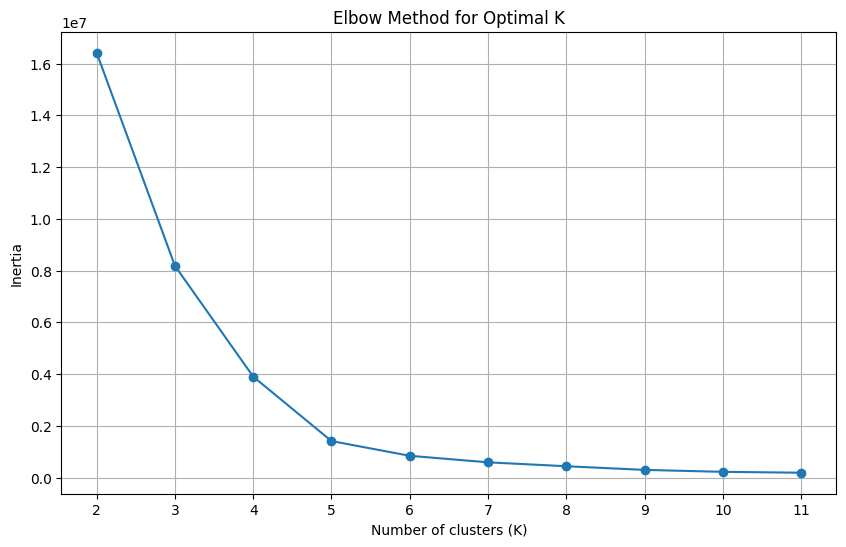

./elbow_test_export/SS-M_csv_10_39658_elbow_test.png
Optimal k value: 5
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       0     1          0      1   
1    0         1        0               0  1       0     0          1      1   
2    1         1        0               1  0       0     0          1      1   
3    1         1        0               1  0       0     0          1      1   
4    1         1        0               0  0       0     1          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        0               1  0       0     0          1      1   
146  1         1        1               1  0       0     0          0      1   
147  1         1        0               1  0       0     0          1      1   
148  0         1        1               1  1       0     0          0      1   
149  1         1        1               1  0    

<Figure size 640x480 with 0 Axes>

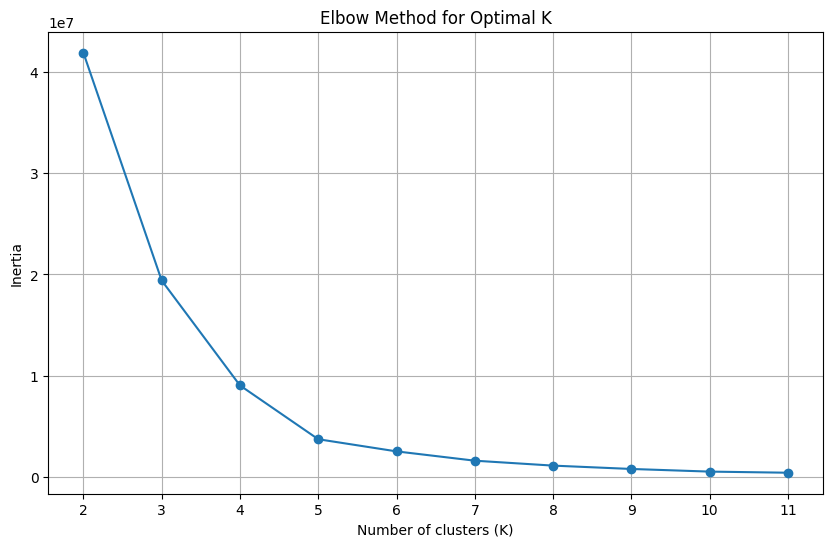

./elbow_test_export/SS-M_csv_10_40749_elbow_test.png
Optimal k value: 5
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               1  1       0     1          0      1   
1    0         1        1               1  1       0     0          0      1   
2    0         1        0               1  1       0     0          1      1   
3    0         1        0               1  1       1     0          0      1   
4    1         1        1               1  0       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        1               1  1       0     0          0      1   
146  1         1        0               0  0       0     0          1      1   
147  0         1        0               0  1       0     0          1      1   
148  1         1        0               1  0       0     1          0      1   
149  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

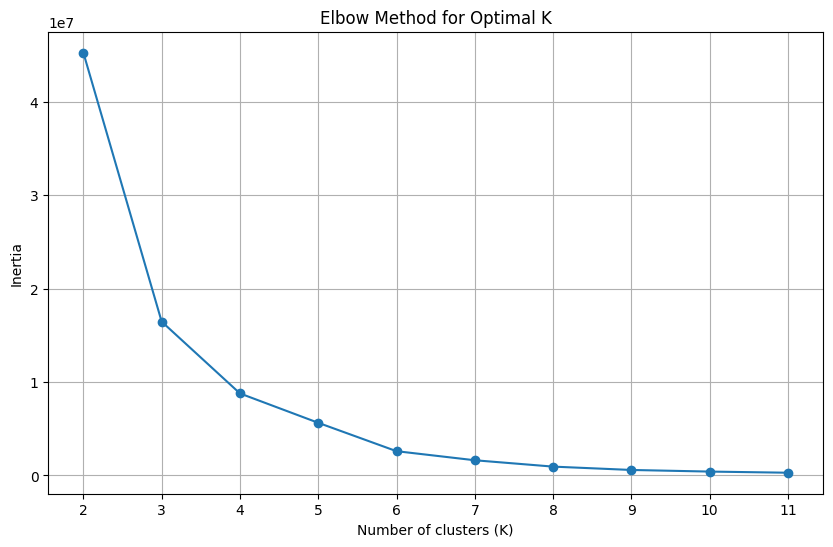

./elbow_test_export/SS-M_csv_10_44845_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               0  1       1     0          0      1   
1    1         1        0               1  0       0     1          0      1   
2    0         1        0               1  1       0     0          1      1   
3    0         1        1               0  1       0     0          0      1   
4    1         1        1               1  0       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        0               0  0       0     1          0      1   
146  1         1        0               1  0       0     0          1      1   
147  1         1        1               1  0       0     0          0      1   
148  1         1        1               1  0       0     0          0      1   
149  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

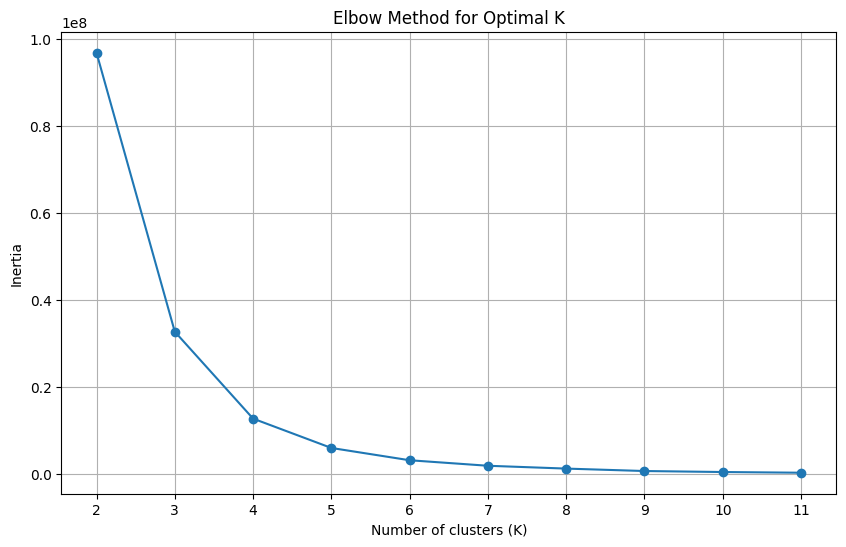

./elbow_test_export/SS-M_csv_10_51176_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               0  1       1     0          0      1   
1    0         1        0               0  1       1     0          0      1   
2    1         1        0               1  0       0     1          0      1   
3    1         1        0               1  0       0     1          0      1   
4    1         1        0               0  0       0     0          1      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        0               1  1       1     0          0      1   
146  1         1        0               0  0       1     0          0      1   
147  1         1        1               0  0       0     0          0      1   
148  0         1        0               0  1       0     1          0      1   
149  1         1        1               0  0    

<Figure size 640x480 with 0 Axes>

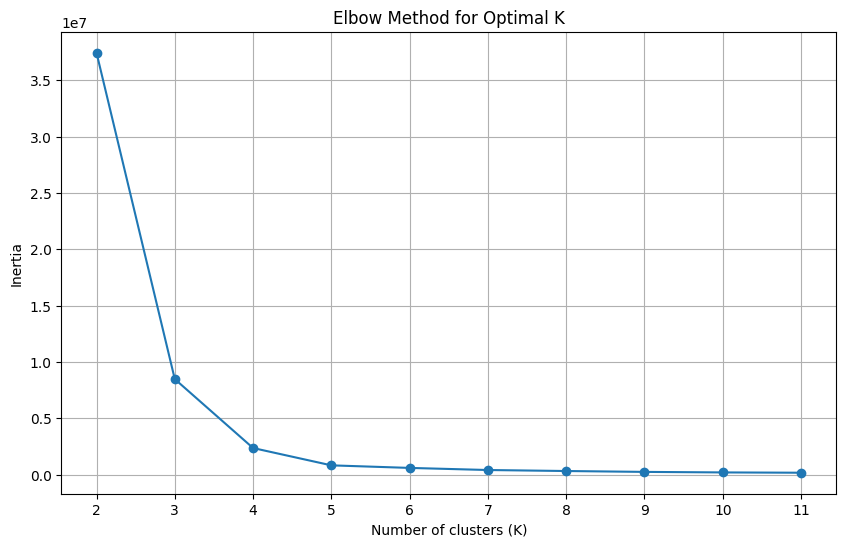

./elbow_test_export/SS-M_csv_10_58612_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       0     1          0      1   
1    0         1        0               1  1       1     0          0      1   
2    0         1        0               1  1       0     0          1      1   
3    1         1        0               0  0       1     0          0      1   
4    0         1        1               0  1       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        1               1  0       0     0          0      1   
146  1         1        0               1  0       0     0          1      1   
147  0         1        0               1  1       0     1          0      1   
148  0         1        1               1  1       0     0          0      1   
149  1         1        0               0  0    

<Figure size 640x480 with 0 Axes>

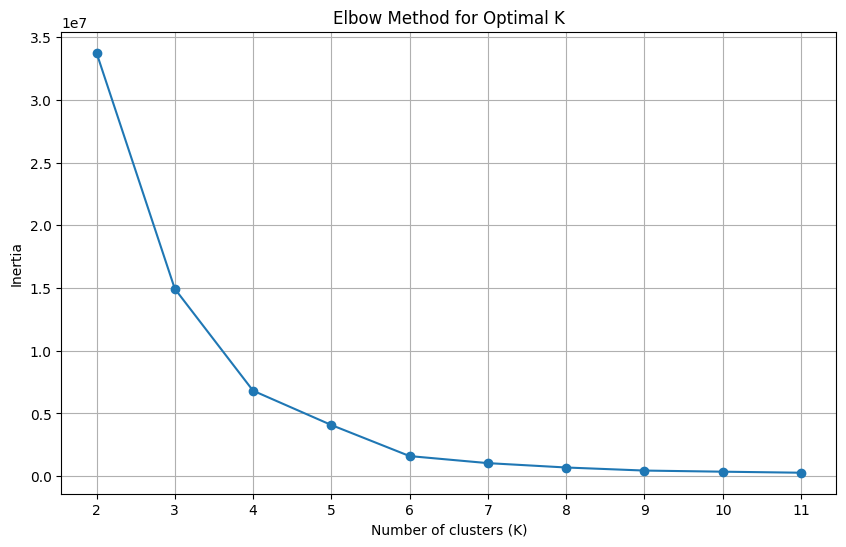

./elbow_test_export/SS-M_csv_10_61367_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       0     0          1      1   
1    1         1        0               0  0       1     0          0      1   
2    1         1        1               1  0       0     0          0      1   
3    0         1        0               1  1       1     0          0      1   
4    0         1        1               0  1       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        1               1  0       0     0          0      1   
146  0         1        0               1  1       0     0          1      1   
147  1         1        1               0  0       0     0          0      1   
148  0         1        1               0  1       0     0          0      1   
149  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

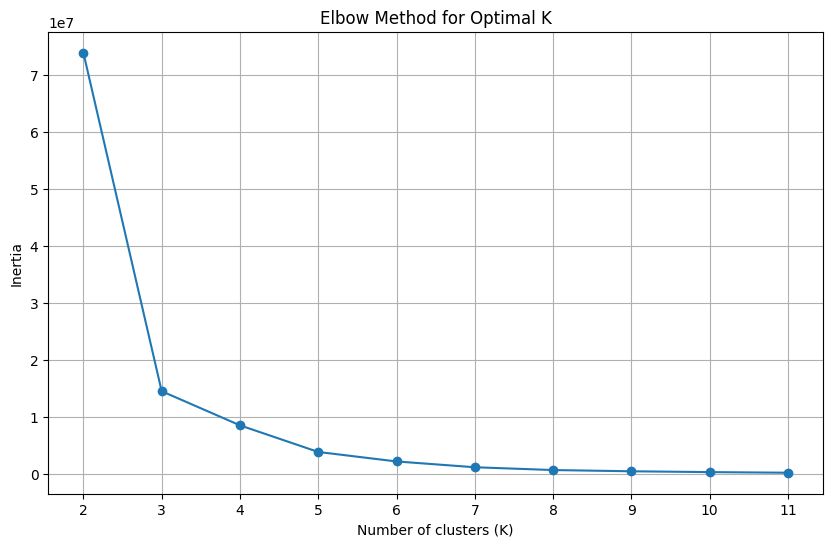

./elbow_test_export/SS-M_csv_10_65388_elbow_test.png
Optimal k value: 3
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       0     0          1      1   
1    0         1        0               0  1       0     0          1      1   
2    1         1        0               1  0       1     0          0      1   
3    1         1        0               0  0       1     0          0      1   
4    0         1        0               0  1       0     0          1      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        0               0  0       0     0          1      1   
146  0         1        1               0  1       0     0          0      1   
147  0         1        0               1  1       1     0          0      1   
148  1         1        0               0  0       0     1          0      1   
149  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

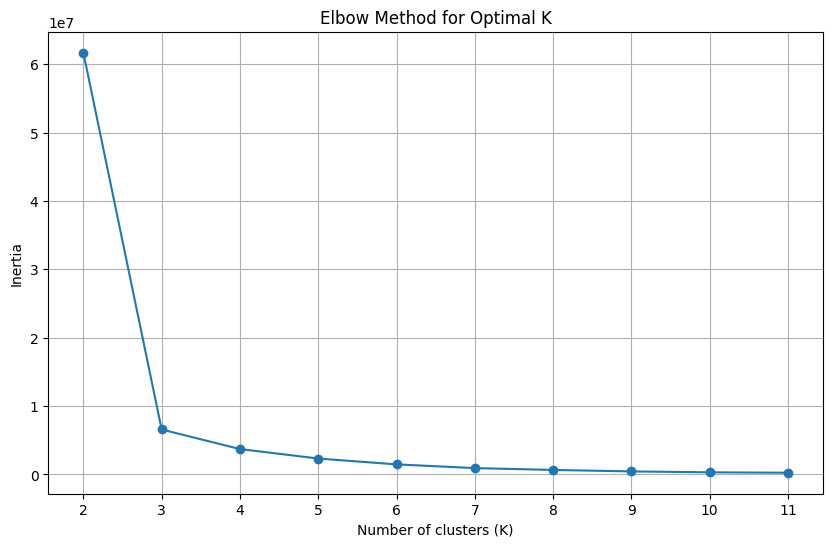

./elbow_test_export/SS-M_csv_10_65444_elbow_test.png
Optimal k value: 3
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    1         1        1               0  0       0     0          0      1   
2    0         1        0               0  1       0     1          0      1   
3    0         1        1               0  1       0     0          0      1   
4    1         1        0               1  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        1               1  1       0     0          0      1   
146  0         1        1               1  1       0     0          0      1   
147  0         1        0               0  1       0     0          1      1   
148  1         1        0               0  0       0     1          0      1   
149  1         1        0               1  0    

<Figure size 640x480 with 0 Axes>

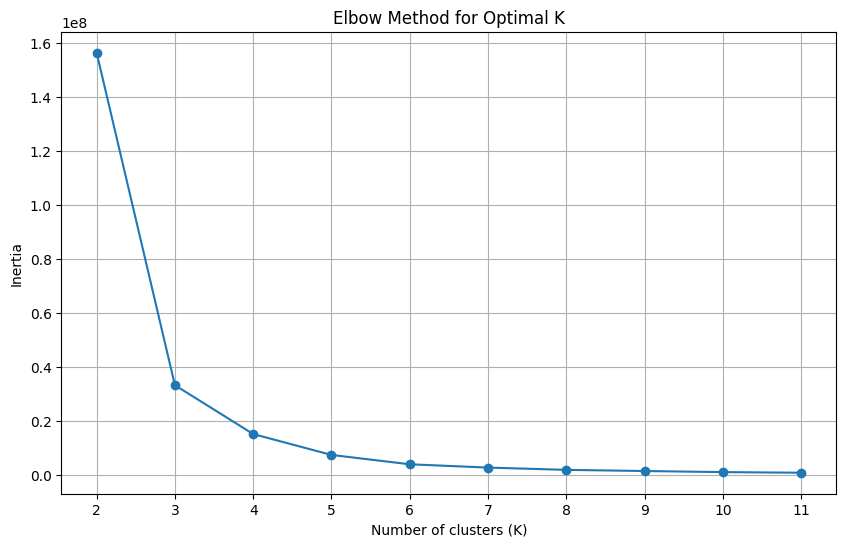

./elbow_test_export/SS-M_csv_10_66946_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       1     0          0      1   
1    0         1        0               0  1       0     0          1      1   
2    1         1        0               1  0       1     0          0      1   
3    0         1        0               1  1       1     0          0      1   
4    1         1        0               0  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        0               0  1       0     1          0      1   
146  0         1        0               0  1       0     0          1      1   
147  0         1        0               0  1       0     1          0      1   
148  0         1        0               1  1       0     0          1      1   
149  1         1        1               1  0    

<Figure size 640x480 with 0 Axes>

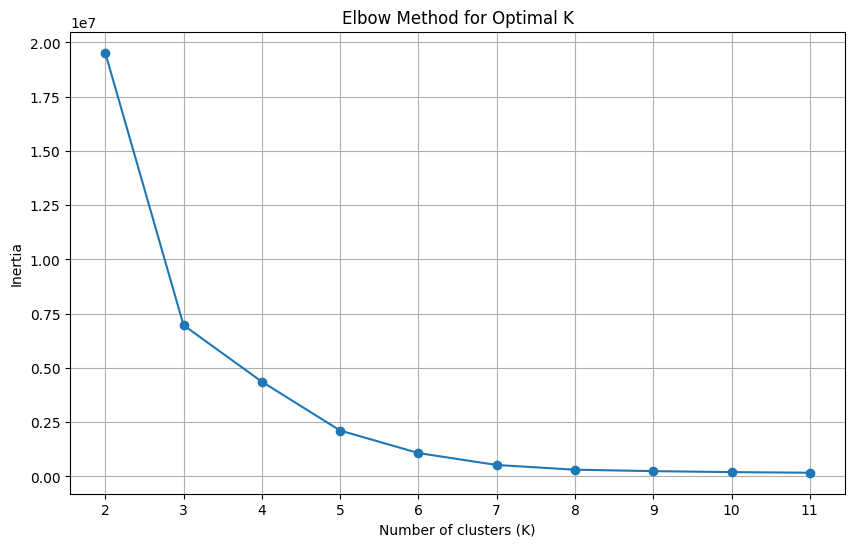

./elbow_test_export/SS-M_csv_10_69024_elbow_test.png
Optimal k value: 5
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    1         1        1               0  0       0     0          0      1   
2    1         1        1               0  0       0     0          0      1   
3    1         1        0               0  0       0     0          1      1   
4    1         1        0               1  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        1               1  0       0     0          0      1   
146  1         1        1               1  0       0     0          0      1   
147  1         1        1               1  0       0     0          0      1   
148  1         1        1               1  0       0     0          0      1   
149  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

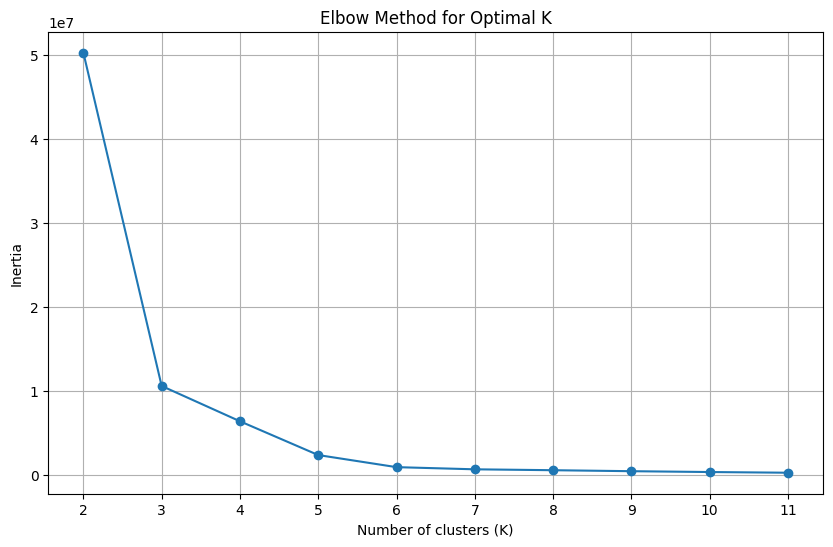

./elbow_test_export/SS-M_csv_10_70006_elbow_test.png
Optimal k value: 3
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               1  1       0     0          1      1   
1    0         1        0               1  1       1     0          0      1   
2    1         1        1               0  0       0     0          0      1   
3    0         1        0               0  1       1     0          0      1   
4    1         1        1               1  0       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        0               1  1       0     1          0      1   
146  1         1        0               0  0       0     0          1      1   
147  1         1        0               1  0       1     0          0      1   
148  0         1        0               0  1       0     1          0      1   
149  0         1        1               1  1    

<Figure size 640x480 with 0 Axes>

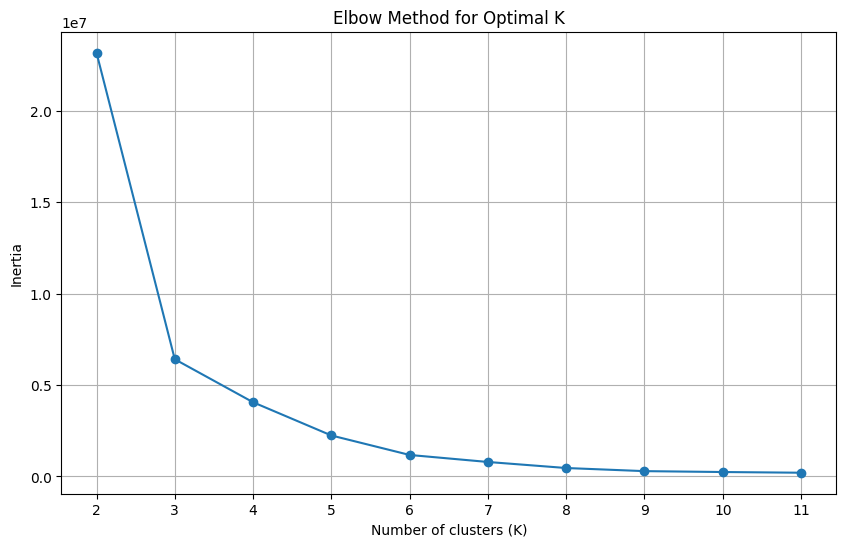

./elbow_test_export/SS-M_csv_10_70292_elbow_test.png
Optimal k value: 3
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        1               1  0       0     0          0      1   
1    1         1        1               0  0       0     0          0      1   
2    1         1        0               1  0       0     1          0      1   
3    0         1        0               0  1       0     1          0      1   
4    0         1        0               1  1       0     1          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        1               0  1       0     0          0      1   
146  0         1        1               1  1       0     0          0      1   
147  0         1        1               0  1       0     0          0      1   
148  0         1        0               1  1       0     1          0      1   
149  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

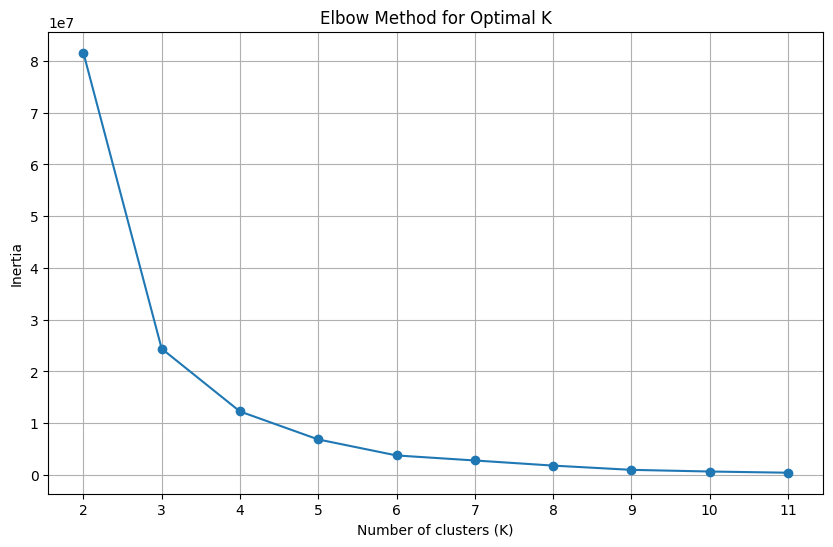

./elbow_test_export/SS-M_csv_10_77340_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               1  1       0     1          0      1   
1    1         1        0               0  0       0     0          1      1   
2    1         1        0               0  0       0     0          1      1   
3    0         1        1               0  1       0     0          0      1   
4    0         1        0               1  1       0     0          1      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        0               1  0       0     1          0      1   
146  0         1        1               1  1       0     0          0      1   
147  1         1        0               1  0       0     1          0      1   
148  0         1        1               0  1       0     0          0      1   
149  1         1        0               1  0    

<Figure size 640x480 with 0 Axes>

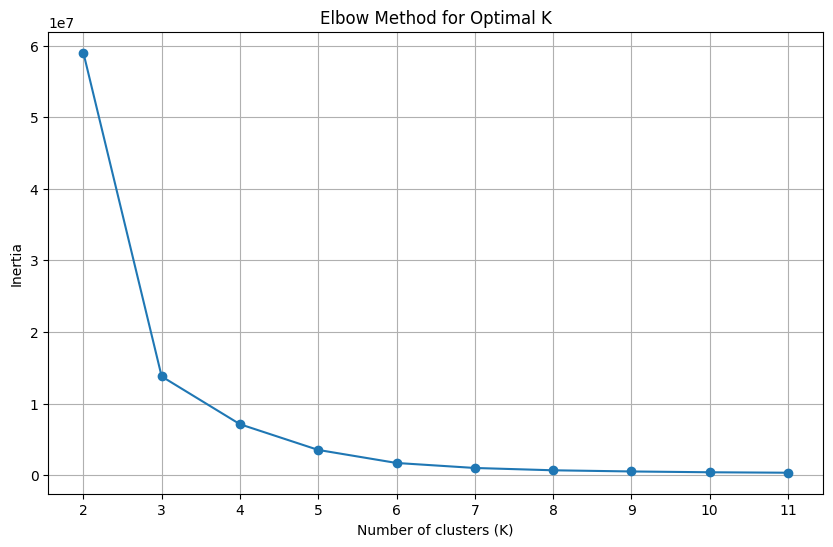

./elbow_test_export/SS-M_csv_10_77845_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    0         1        0               1  1       0     1          0      1   
2    1         1        0               1  0       1     0          0      1   
3    1         1        1               0  0       0     0          0      1   
4    1         1        0               0  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        0               1  1       0     0          1      1   
146  1         1        1               0  0       0     0          0      1   
147  0         1        0               0  1       1     0          0      1   
148  1         1        0               0  0       1     0          0      1   
149  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

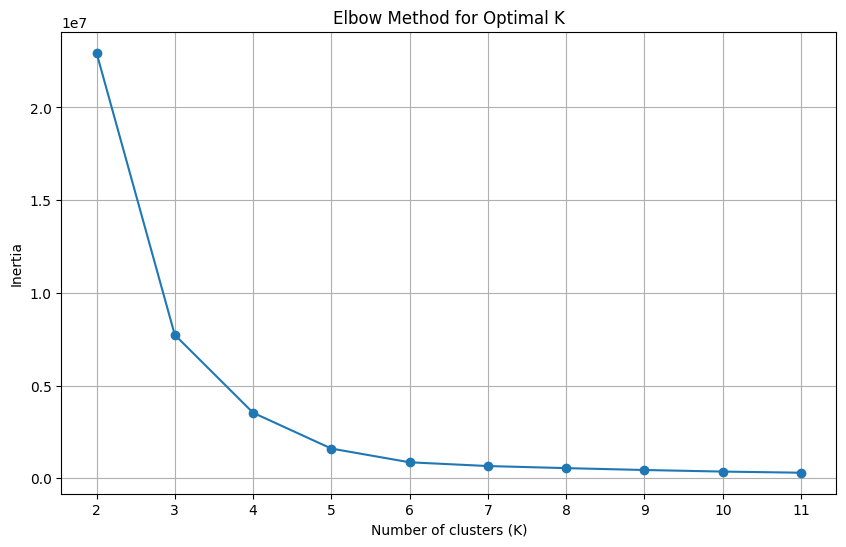

./elbow_test_export/SS-M_csv_10_83686_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       1     0          0      1   
1    1         1        0               1  0       0     1          0      1   
2    0         1        0               1  1       0     1          0      1   
3    0         1        0               0  1       0     0          1      1   
4    1         1        0               1  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  0         1        0               0  1       0     0          1      1   
146  1         1        1               1  0       0     0          0      1   
147  1         1        0               1  0       0     1          0      1   
148  1         1        0               1  0       1     0          0      1   
149  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

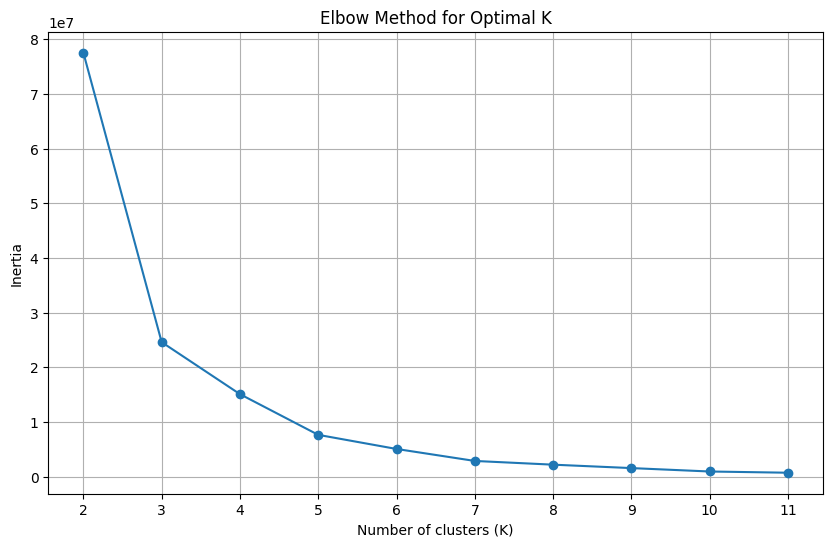

./elbow_test_export/SS-M_csv_10_84967_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               0  1       0     1          0      1   
1    1         1        0               0  0       0     0          1      1   
2    1         1        0               0  0       0     1          0      1   
3    1         1        1               1  0       0     0          0      1   
4    1         1        1               0  0       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        0               0  0       1     0          0      1   
146  0         1        0               1  1       0     1          0      1   
147  0         1        0               0  1       1     0          0      1   
148  1         1        0               1  0       1     0          0      1   
149  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

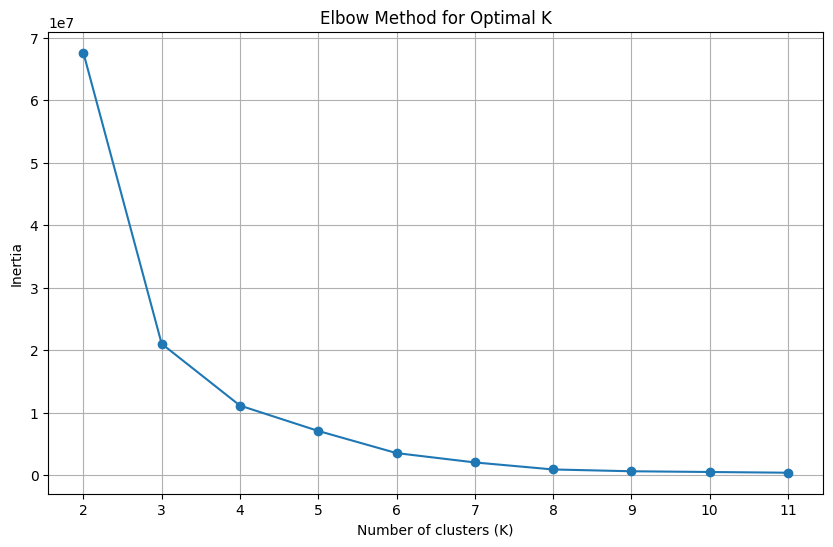

./elbow_test_export/SS-M_csv_10_86331_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    0         1        0               1  1       1     0          0      1   
2    1         1        0               1  0       0     1          0      1   
3    1         1        1               0  0       0     0          0      1   
4    1         1        0               0  0       0     1          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
145  1         1        1               1  0       0     0          0      1   
146  0         1        1               1  1       0     0          0      1   
147  1         1        1               0  0       0     0          0      1   
148  0         1        1               1  1       0     0          0      1   
149  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

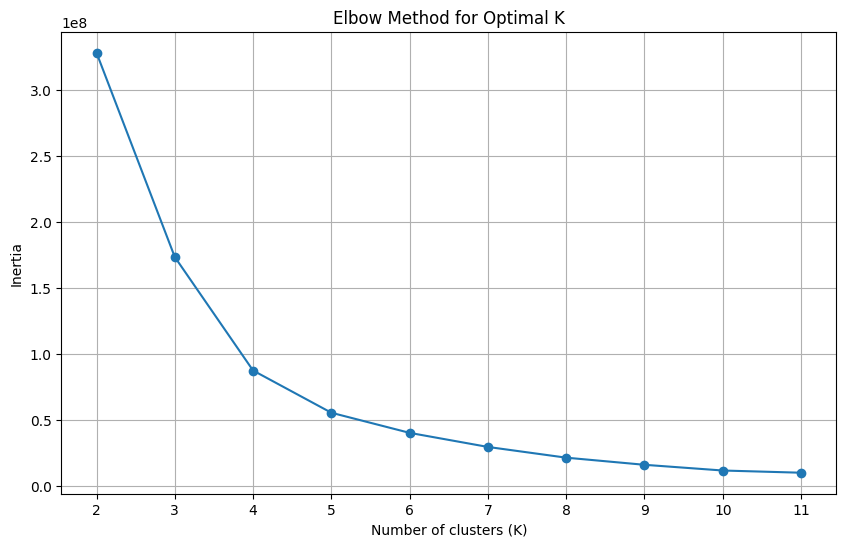

./elbow_test_export/SS-M_csv_50_11514_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               0  1       0     1          0      1   
1    1         1        0               0  0       0     0          1      1   
2    1         1        0               1  0       0     0          1      1   
3    0         1        0               1  1       0     0          1      1   
4    0         1        0               0  1       0     1          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        1               1  1       0     0          0      1   
746  0         1        0               1  1       0     0          1      1   
747  1         1        1               0  0       0     0          0      1   
748  1         1        0               0  0       1     0          0      1   
749  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

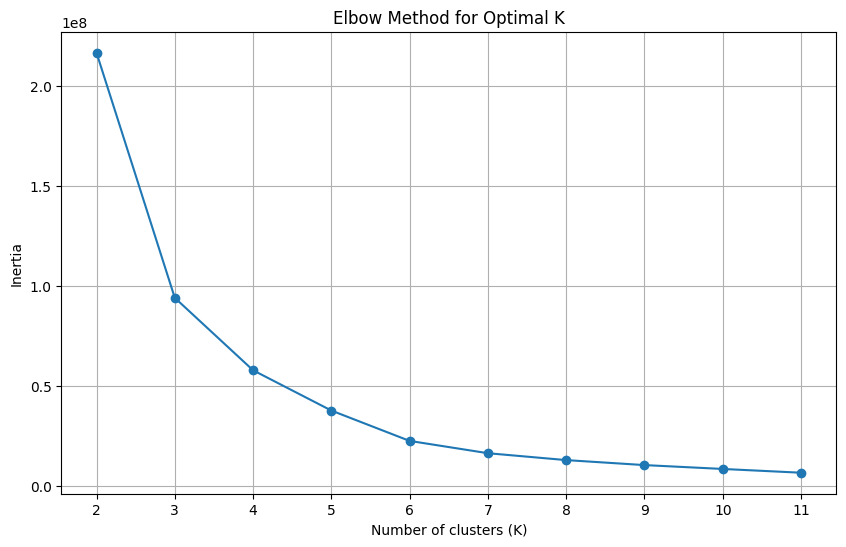

./elbow_test_export/SS-M_csv_50_19953_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     1          0      1   
1    0         1        0               0  1       1     0          0      1   
2    0         1        0               0  1       0     1          0      1   
3    1         1        0               0  0       0     1          0      1   
4    0         1        0               1  1       0     0          1      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        0               0  1       0     1          0      1   
746  0         1        0               1  1       0     1          0      1   
747  0         1        0               1  1       0     0          1      1   
748  0         1        0               1  1       0     1          0      1   
749  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

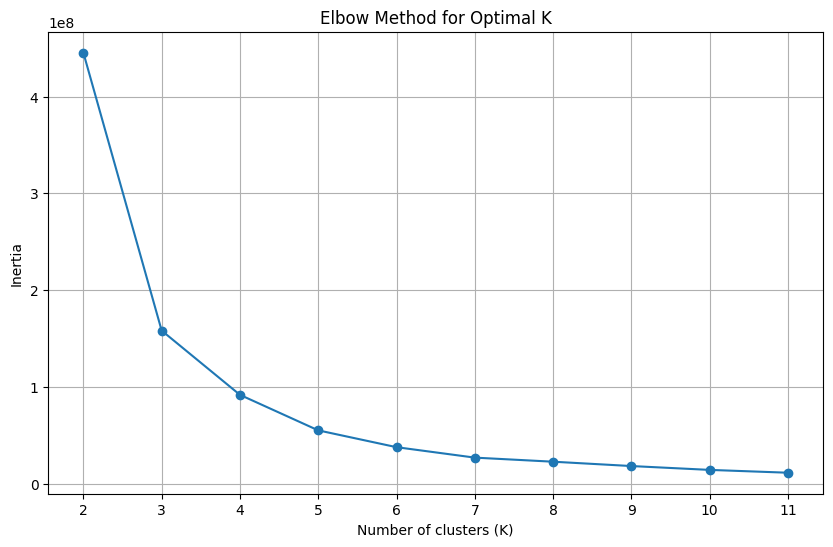

./elbow_test_export/SS-M_csv_50_3545_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    0         1        0               1  1       1     0          0      1   
2    0         1        0               0  1       1     0          0      1   
3    0         1        0               1  1       1     0          0      1   
4    0         1        1               0  1       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  1         1        0               1  0       1     0          0      1   
746  1         1        0               1  0       0     1          0      1   
747  1         1        0               1  0       1     0          0      1   
748  0         1        0               1  1       0     1          0      1   
749  1         1        1               1  0     

<Figure size 640x480 with 0 Axes>

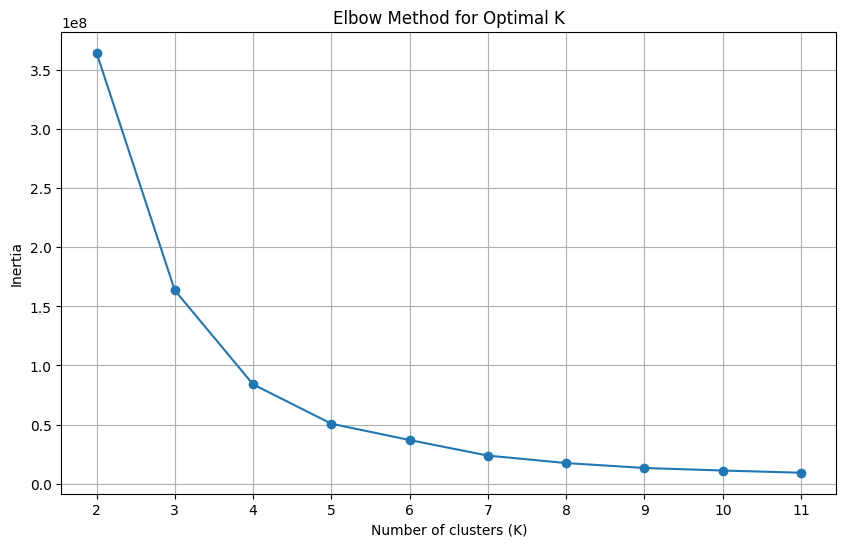

./elbow_test_export/SS-M_csv_50_39658_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       0     1          0      1   
1    0         1        0               0  1       0     0          1      1   
2    1         1        0               1  0       0     0          1      1   
3    1         1        0               1  0       0     0          1      1   
4    1         1        0               0  0       0     1          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        1               1  1       0     0          0      1   
746  1         1        0               1  0       0     1          0      1   
747  1         1        1               1  0       0     0          0      1   
748  0         1        0               1  1       1     0          0      1   
749  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

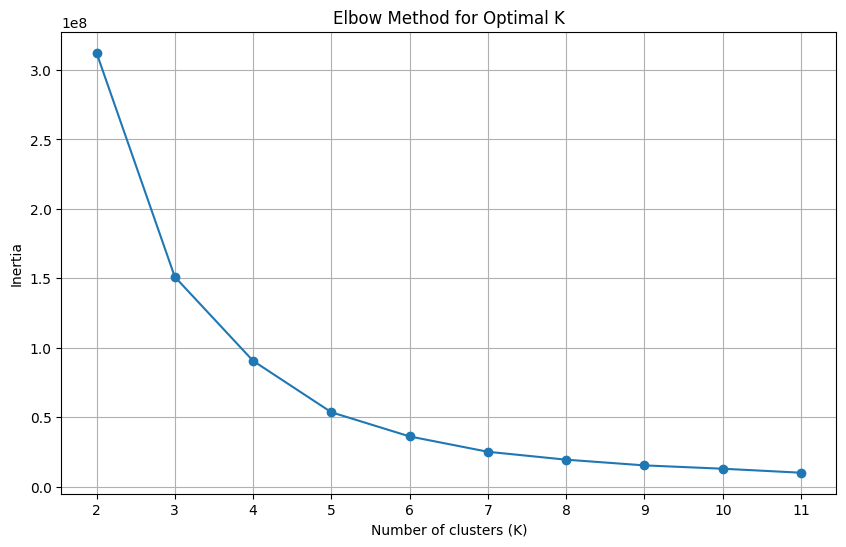

./elbow_test_export/SS-M_csv_50_40749_elbow_test.png
Optimal k value: 5
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               1  1       0     1          0      1   
1    0         1        1               1  1       0     0          0      1   
2    0         1        0               1  1       0     0          1      1   
3    0         1        0               1  1       1     0          0      1   
4    1         1        1               1  0       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        1               0  1       0     0          0      1   
746  1         1        0               1  0       0     1          0      1   
747  0         1        0               0  1       0     0          1      1   
748  1         1        0               0  0       1     0          0      1   
749  0         1        1               0  1    

<Figure size 640x480 with 0 Axes>

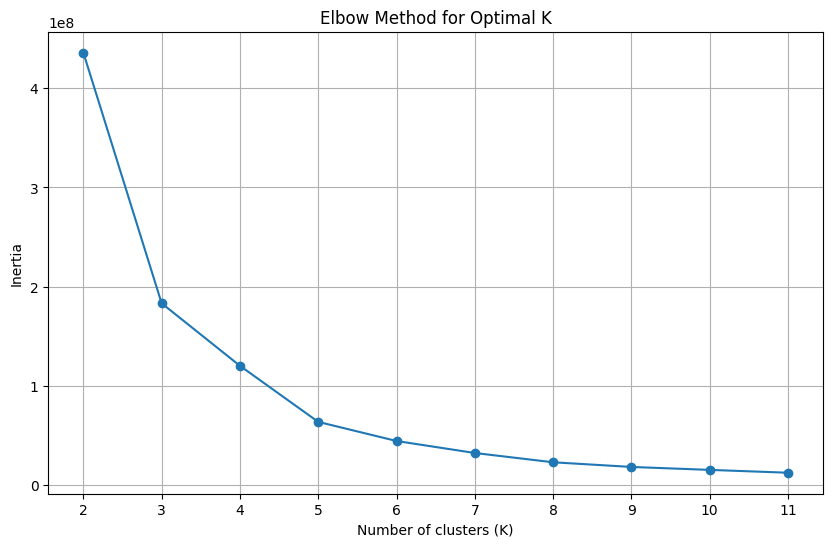

./elbow_test_export/SS-M_csv_50_44845_elbow_test.png
Optimal k value: 5
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               0  1       1     0          0      1   
1    1         1        0               1  0       0     1          0      1   
2    0         1        0               1  1       0     0          1      1   
3    0         1        1               0  1       0     0          0      1   
4    1         1        1               1  0       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  1         1        0               1  0       0     1          0      1   
746  1         1        0               0  0       0     1          0      1   
747  0         1        0               1  1       0     1          0      1   
748  0         1        1               1  1       0     0          0      1   
749  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

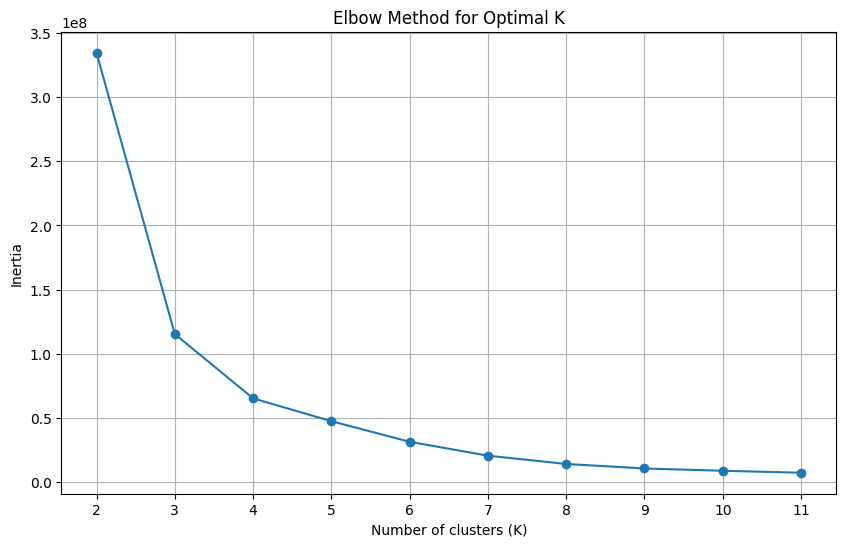

./elbow_test_export/SS-M_csv_50_51176_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               0  1       1     0          0      1   
1    0         1        0               0  1       1     0          0      1   
2    1         1        0               1  0       0     1          0      1   
3    1         1        0               1  0       0     1          0      1   
4    1         1        0               0  0       0     0          1      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  1         1        1               1  0       0     0          0      1   
746  0         1        0               0  1       0     0          1      1   
747  0         1        0               0  1       0     0          1      1   
748  0         1        0               0  1       0     1          0      1   
749  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

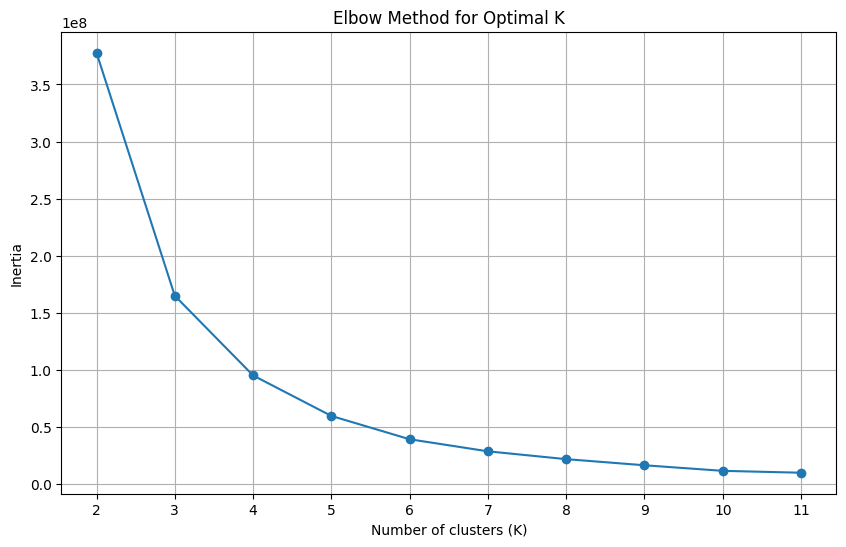

./elbow_test_export/SS-M_csv_50_58612_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       0     1          0      1   
1    0         1        0               1  1       1     0          0      1   
2    0         1        0               1  1       0     0          1      1   
3    1         1        0               0  0       1     0          0      1   
4    0         1        1               0  1       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        0               0  1       1     0          0      1   
746  0         1        0               1  1       0     0          1      1   
747  0         1        0               1  1       0     0          1      1   
748  0         1        0               1  1       1     0          0      1   
749  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

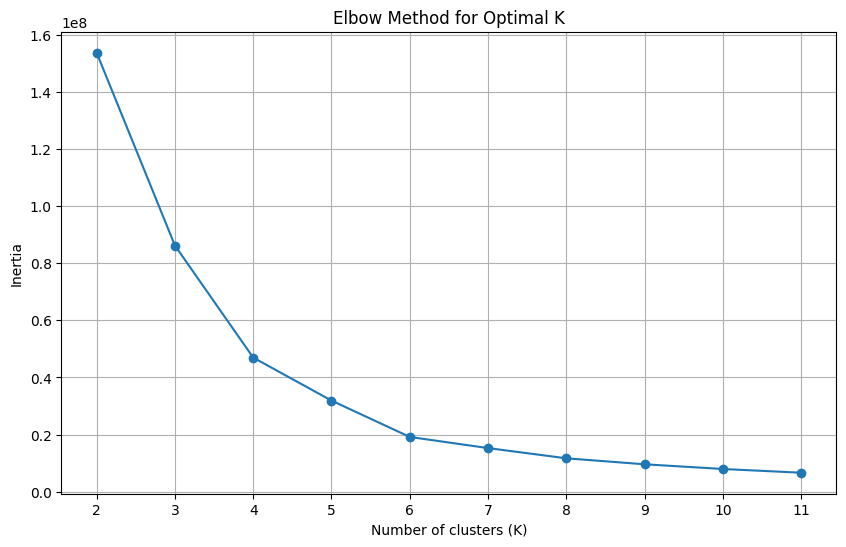

./elbow_test_export/SS-M_csv_50_61367_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       0     0          1      1   
1    1         1        0               0  0       1     0          0      1   
2    1         1        1               1  0       0     0          0      1   
3    0         1        0               1  1       1     0          0      1   
4    0         1        1               0  1       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  1         1        0               1  0       1     0          0      1   
746  0         1        0               1  1       1     0          0      1   
747  1         1        0               1  0       0     1          0      1   
748  1         1        1               0  0       0     0          0      1   
749  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

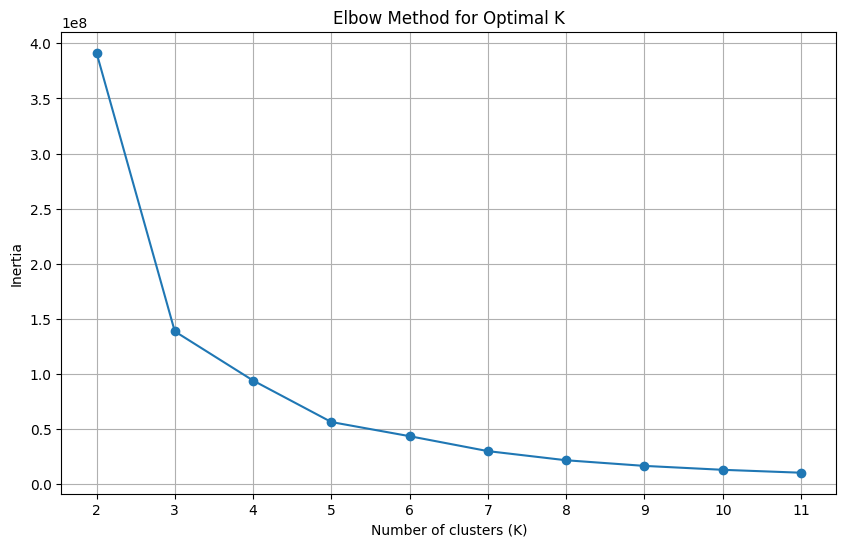

./elbow_test_export/SS-M_csv_50_65388_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       0     0          1      1   
1    0         1        0               0  1       0     0          1      1   
2    1         1        0               1  0       1     0          0      1   
3    1         1        0               0  0       1     0          0      1   
4    0         1        0               0  1       0     0          1      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        0               1  1       0     1          0      1   
746  1         1        0               0  0       1     0          0      1   
747  1         1        0               1  0       1     0          0      1   
748  0         1        1               1  1       0     0          0      1   
749  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

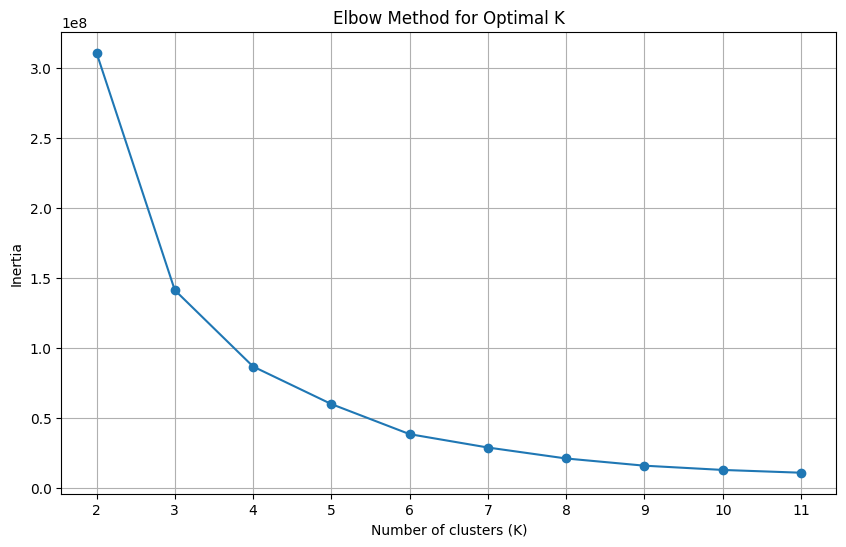

./elbow_test_export/SS-M_csv_50_65444_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    1         1        1               0  0       0     0          0      1   
2    0         1        0               0  1       0     1          0      1   
3    0         1        1               0  1       0     0          0      1   
4    1         1        0               1  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  1         1        1               1  0       0     0          0      1   
746  1         1        0               0  0       0     0          1      1   
747  1         1        1               1  0       0     0          0      1   
748  0         1        1               1  1       0     0          0      1   
749  1         1        0               1  0    

<Figure size 640x480 with 0 Axes>

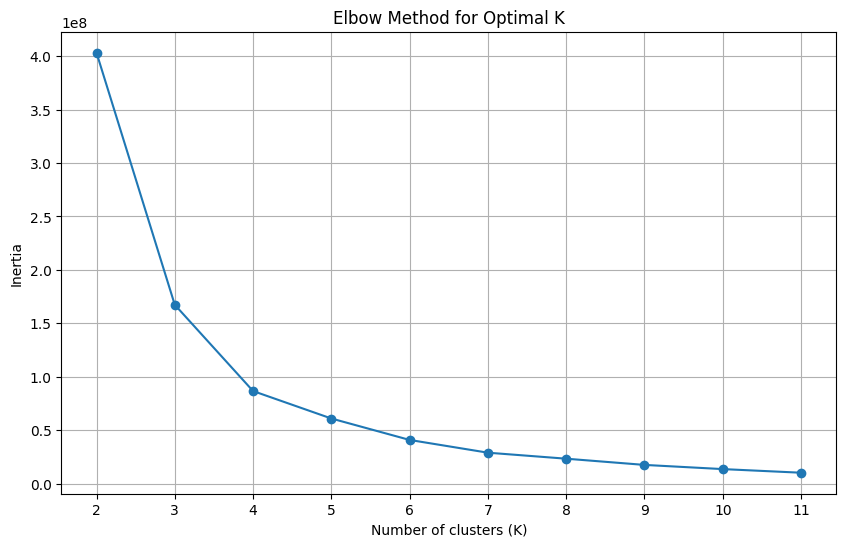

./elbow_test_export/SS-M_csv_50_66946_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       1     0          0      1   
1    0         1        0               0  1       0     0          1      1   
2    1         1        0               1  0       1     0          0      1   
3    0         1        0               1  1       1     0          0      1   
4    1         1        0               0  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        0               0  1       0     1          0      1   
746  0         1        0               1  1       0     1          0      1   
747  1         1        0               0  0       0     0          1      1   
748  0         1        0               1  1       1     0          0      1   
749  1         1        0               0  0    

<Figure size 640x480 with 0 Axes>

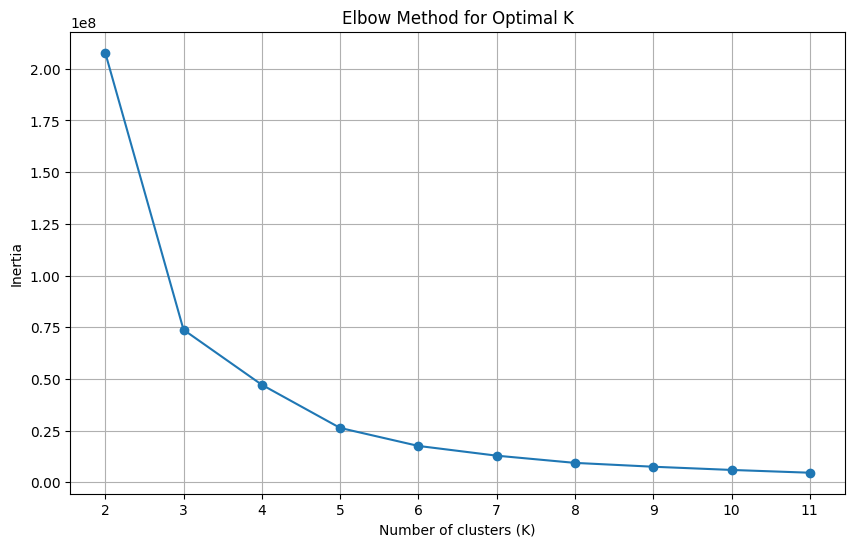

./elbow_test_export/SS-M_csv_50_69024_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    1         1        1               0  0       0     0          0      1   
2    1         1        1               0  0       0     0          0      1   
3    1         1        0               0  0       0     0          1      1   
4    1         1        0               1  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  1         1        0               0  0       0     1          0      1   
746  0         1        1               1  1       0     0          0      1   
747  0         1        1               1  1       0     0          0      1   
748  1         1        1               0  0       0     0          0      1   
749  1         1        0               1  0    

<Figure size 640x480 with 0 Axes>

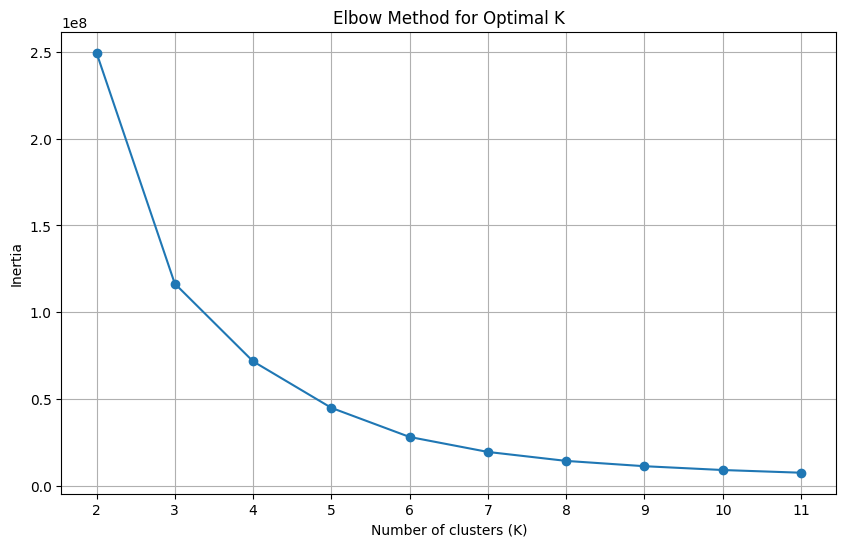

./elbow_test_export/SS-M_csv_50_70006_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               1  1       0     0          1      1   
1    0         1        0               1  1       1     0          0      1   
2    1         1        1               0  0       0     0          0      1   
3    0         1        0               0  1       1     0          0      1   
4    1         1        1               1  0       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        0               0  1       0     1          0      1   
746  0         1        1               1  1       0     0          0      1   
747  0         1        0               0  1       0     1          0      1   
748  1         1        1               0  0       0     0          0      1   
749  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

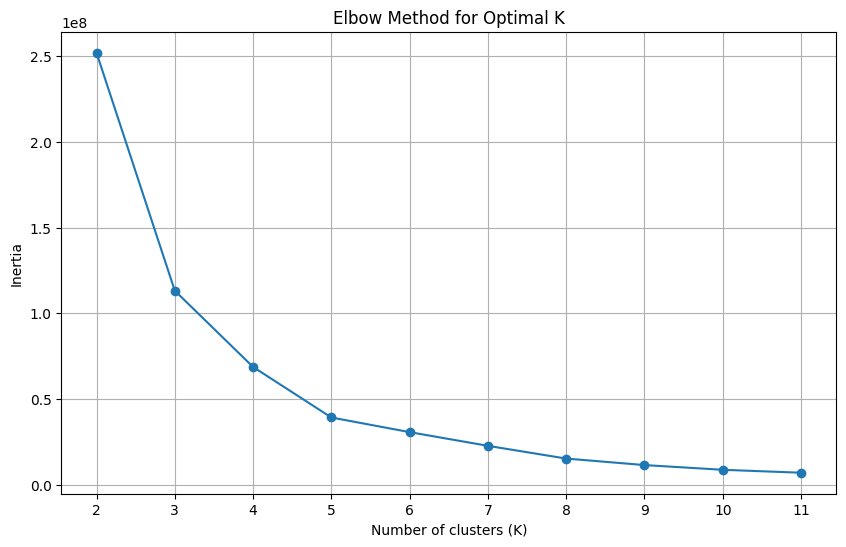

./elbow_test_export/SS-M_csv_50_70292_elbow_test.png
Optimal k value: 5
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        1               1  0       0     0          0      1   
1    1         1        1               0  0       0     0          0      1   
2    1         1        0               1  0       0     1          0      1   
3    0         1        0               0  1       0     1          0      1   
4    0         1        0               1  1       0     1          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  1         1        0               1  0       0     1          0      1   
746  0         1        0               1  1       1     0          0      1   
747  0         1        0               1  1       1     0          0      1   
748  1         1        0               0  0       0     1          0      1   
749  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

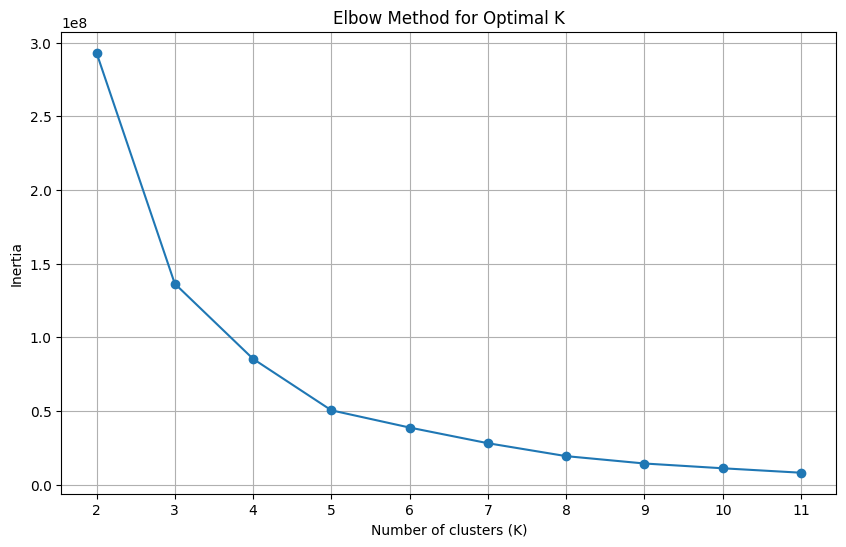

./elbow_test_export/SS-M_csv_50_77340_elbow_test.png
Optimal k value: 5
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               1  1       0     1          0      1   
1    1         1        0               0  0       0     0          1      1   
2    1         1        0               0  0       0     0          1      1   
3    0         1        1               0  1       0     0          0      1   
4    0         1        0               1  1       0     0          1      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        0               1  1       1     0          0      1   
746  1         1        0               0  0       1     0          0      1   
747  1         1        0               0  0       0     1          0      1   
748  1         1        1               1  0       0     0          0      1   
749  0         1        0               0  1    

<Figure size 640x480 with 0 Axes>

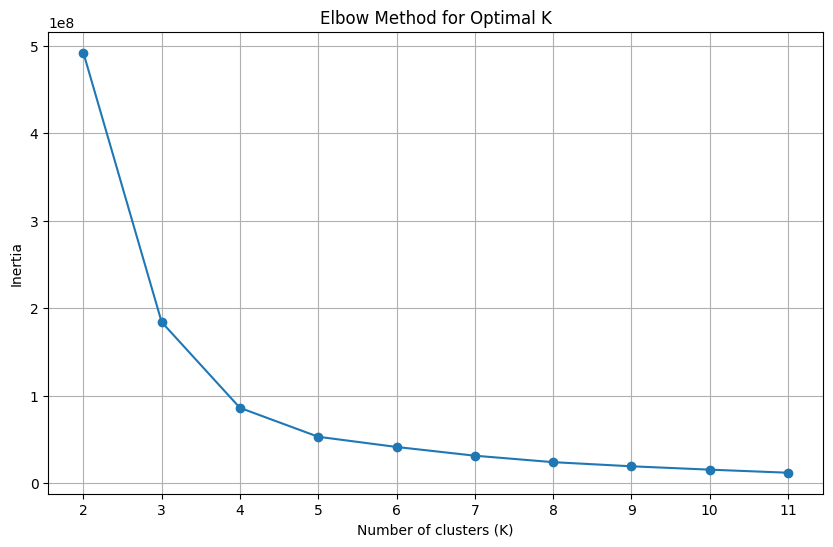

./elbow_test_export/SS-M_csv_50_77845_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    0         1        0               1  1       0     1          0      1   
2    1         1        0               1  0       1     0          0      1   
3    1         1        1               0  0       0     0          0      1   
4    1         1        0               0  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  1         1        0               1  0       1     0          0      1   
746  0         1        0               0  1       0     1          0      1   
747  1         1        0               0  0       1     0          0      1   
748  0         1        1               1  1       0     0          0      1   
749  1         1        0               0  0    

<Figure size 640x480 with 0 Axes>

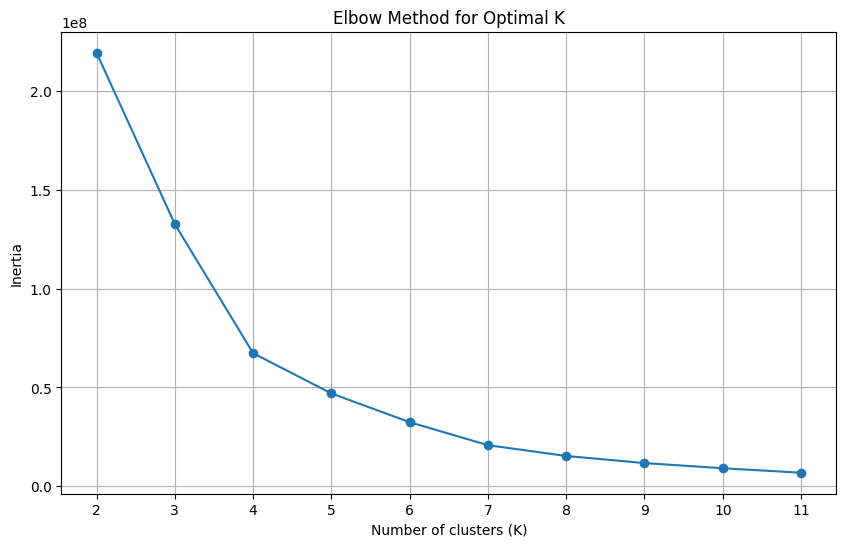

./elbow_test_export/SS-M_csv_50_83686_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               1  0       1     0          0      1   
1    1         1        0               1  0       0     1          0      1   
2    0         1        0               1  1       0     1          0      1   
3    0         1        0               0  1       0     0          1      1   
4    1         1        0               1  0       1     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        0               0  1       0     0          1      1   
746  0         1        0               0  1       0     0          1      1   
747  0         1        1               0  1       0     0          0      1   
748  0         1        1               0  1       0     0          0      1   
749  0         1        0               1  1    

<Figure size 640x480 with 0 Axes>

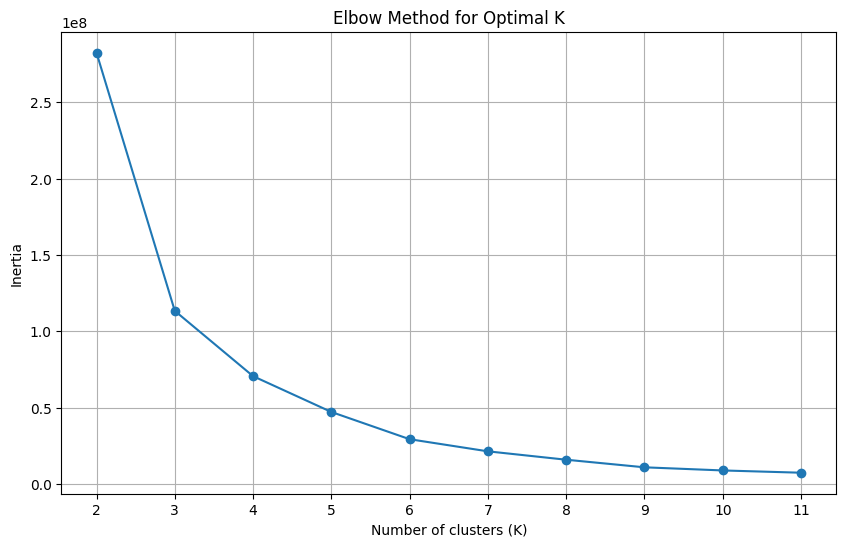

./elbow_test_export/SS-M_csv_50_84967_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    0         1        0               0  1       0     1          0      1   
1    1         1        0               0  0       0     0          1      1   
2    1         1        0               0  0       0     1          0      1   
3    1         1        1               1  0       0     0          0      1   
4    1         1        1               0  0       0     0          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  1         1        0               0  0       0     1          0      1   
746  0         1        0               0  1       1     0          0      1   
747  1         1        0               0  0       0     1          0      1   
748  1         1        0               1  0       1     0          0      1   
749  0         1        1               1  1    

<Figure size 640x480 with 0 Axes>

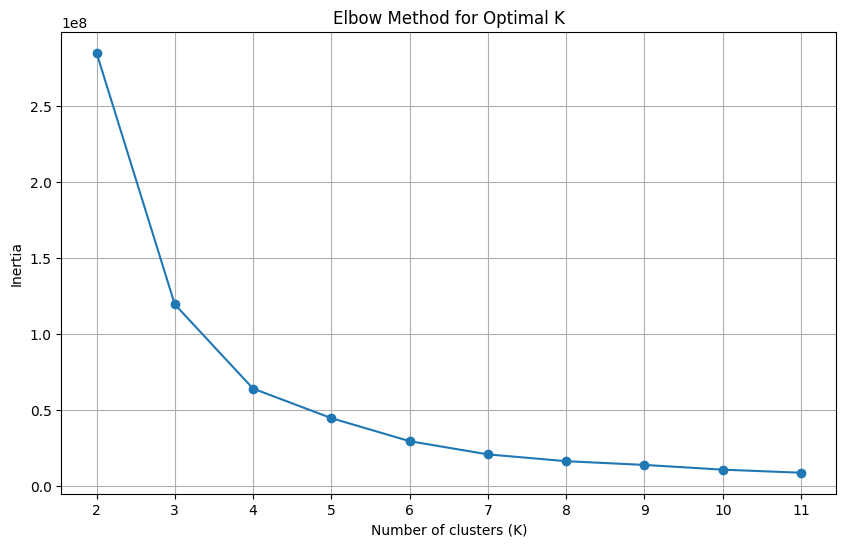

./elbow_test_export/SS-M_csv_50_86331_elbow_test.png
Optimal k value: 4
     F  Smoother  ColorGS  RelaxParameter  V  Jacobi  Line  ZebraLine  Cycle  \
0    1         1        0               0  0       0     0          1      1   
1    0         1        0               1  1       1     0          0      1   
2    1         1        0               1  0       0     1          0      1   
3    1         1        1               0  0       0     0          0      1   
4    1         1        0               0  0       0     1          0      1   
..  ..       ...      ...             ... ..     ...   ...        ...    ...   
745  0         1        0               0  1       0     0          1      1   
746  0         1        0               0  1       0     1          0      1   
747  0         1        0               0  1       0     1          0      1   
748  1         1        1               1  0       0     0          0      1   
749  1         1        1               1  0    

<Figure size 640x480 with 0 Axes>

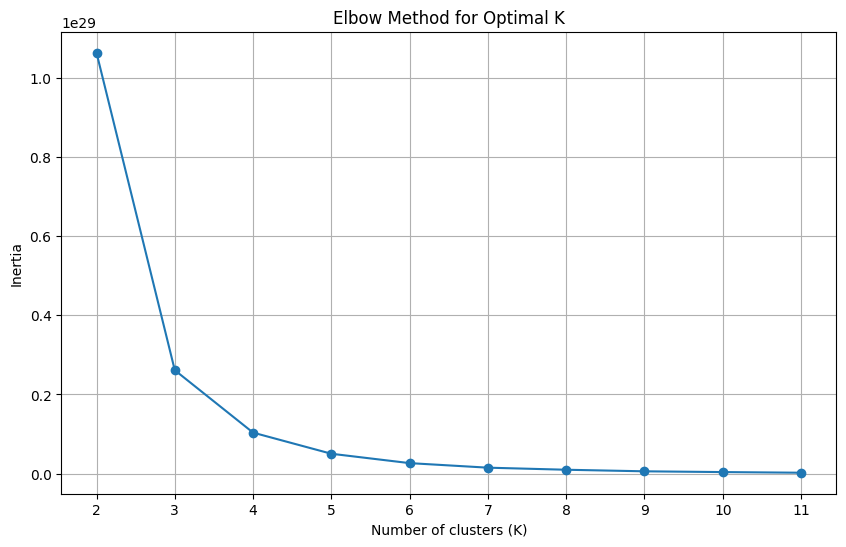

./elbow_test_export/SS-N_csv_100_11514_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         0            1          2.0        1    0.0   
1             0       0         0            0          1.4       17    0.4   
2             0       0         0            1          0.7        9    0.4   
3             0       0         0            1          1.0       13    0.6   
4             1       0         0            0          1.4        9    0.4   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            0          1.4       17    0.4   
1896          1       0         0            0          1.4       17    0.4   
1897          0       0         0            1          0.7        9    0.8   
1898          0       1         0            0          1.4       17    0.4   
1899          0       1         0            1          1.

<Figure size 640x480 with 0 Axes>

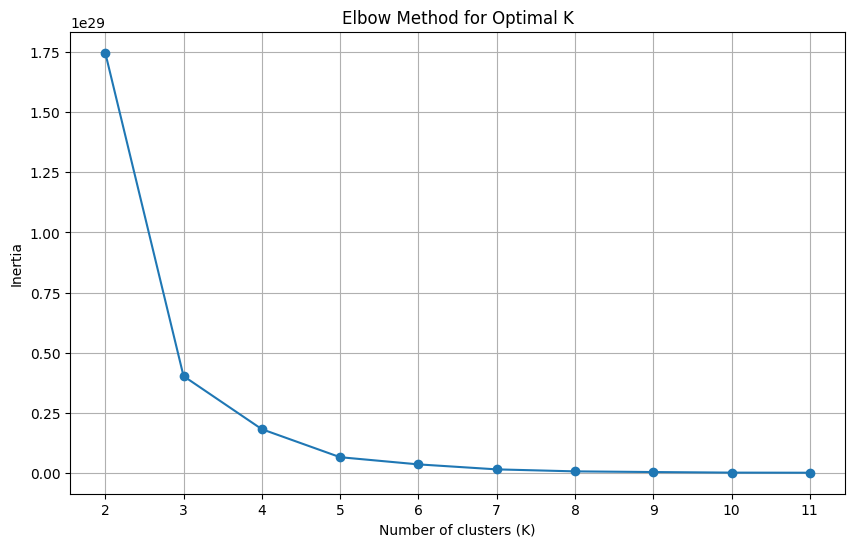

./elbow_test_export/SS-N_csv_100_19953_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         1            0          0.7        9    0.8   
1             0       0         0            1          0.7       17    0.8   
2             0       0         1            0          1.4        9    0.4   
3             0       0         1            0          0.7        9    0.4   
4             0       1         0            0          0.7        9    0.4   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            1          1.4        9    0.4   
1896          1       0         1            0          1.0        3    0.6   
1897          0       0         0            1          1.4        9    0.4   
1898          0       0         0            1          1.4       17    0.4   
1899          1       0         1            0          1.

<Figure size 640x480 with 0 Axes>

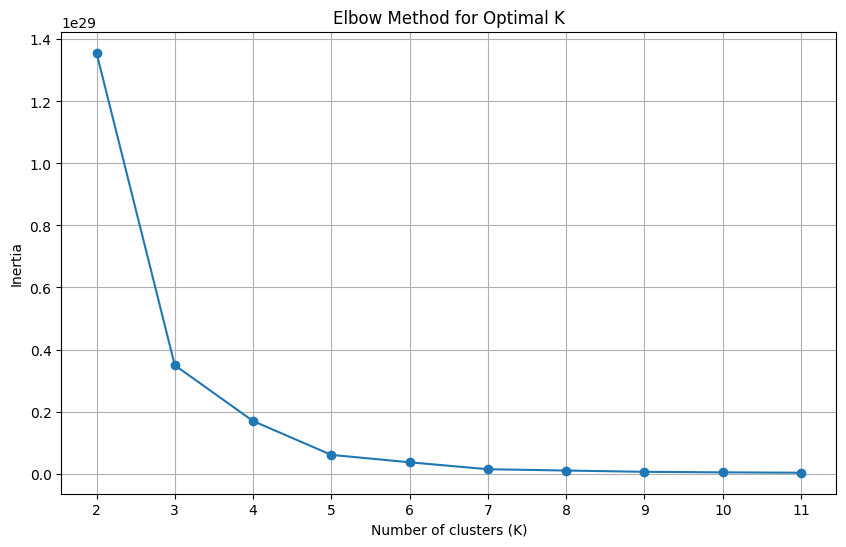

./elbow_test_export/SS-N_csv_100_3545_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       1         0            0          0.7        9    0.4   
1             0       0         1            0          1.4       17    0.4   
2             0       1         1            1          0.0        1    0.0   
3             0       1         0            0          1.0        3    0.6   
4             0       0         1            0          1.4        9    0.8   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            1          1.4       17    0.8   
1896          0       1         1            1          2.0       25    0.2   
1897          0       0         0            1          0.7       17    0.4   
1898          0       1         0            1          3.0       21    2.0   
1899          1       0         0            0          0.7

<Figure size 640x480 with 0 Axes>

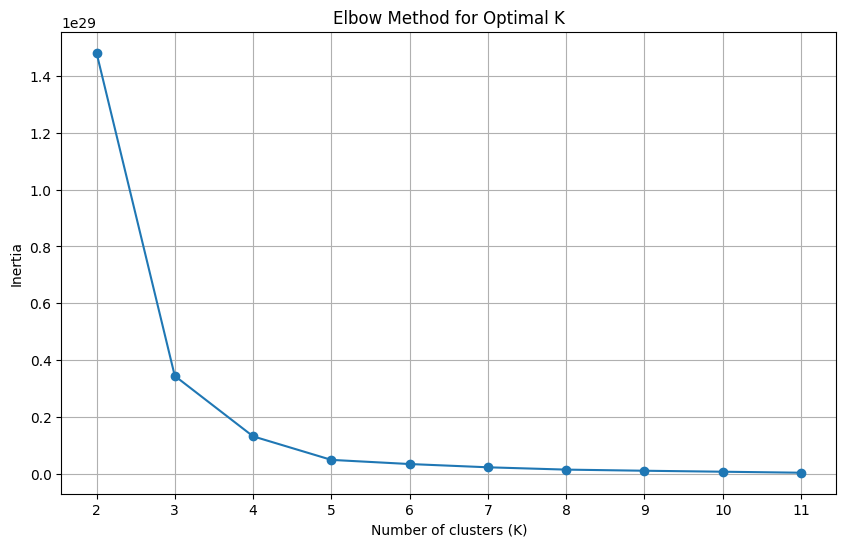

./elbow_test_export/SS-N_csv_100_39658_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       1         0            0          1.4        9    0.8   
1             0       0         0            1          1.4       17    0.4   
2             0       0         1            0          1.4        9    0.8   
3             0       0         0            1          0.7       17    0.8   
4             1       0         0            0          0.7        9    0.8   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       1         0            0          1.4       17    0.8   
1896          1       0         0            0          0.7       17    0.8   
1897          1       0         0            0          1.4        9    0.8   
1898          0       0         0            0          1.4       17    0.8   
1899          0       0         0            0          0.

<Figure size 640x480 with 0 Axes>

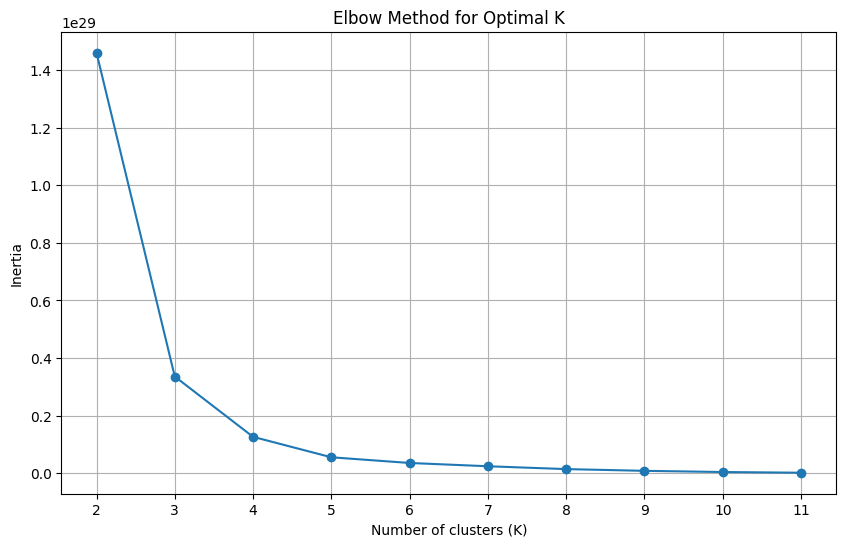

./elbow_test_export/SS-N_csv_100_40749_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         0            0          1.4       17    0.4   
1             0       0         1            0          0.7        9    0.4   
2             0       0         1            0          1.3        4    0.5   
3             0       0         0            1          1.4        9    0.8   
4             1       0         0            0          1.4       17    0.4   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            1          1.4        9    0.4   
1896          0       0         1            0          1.4        9    0.4   
1897          0       0         0            0          0.7        9    0.8   
1898          0       1         0            0          0.7        9    0.8   
1899          0       0         0            1          1.

<Figure size 640x480 with 0 Axes>

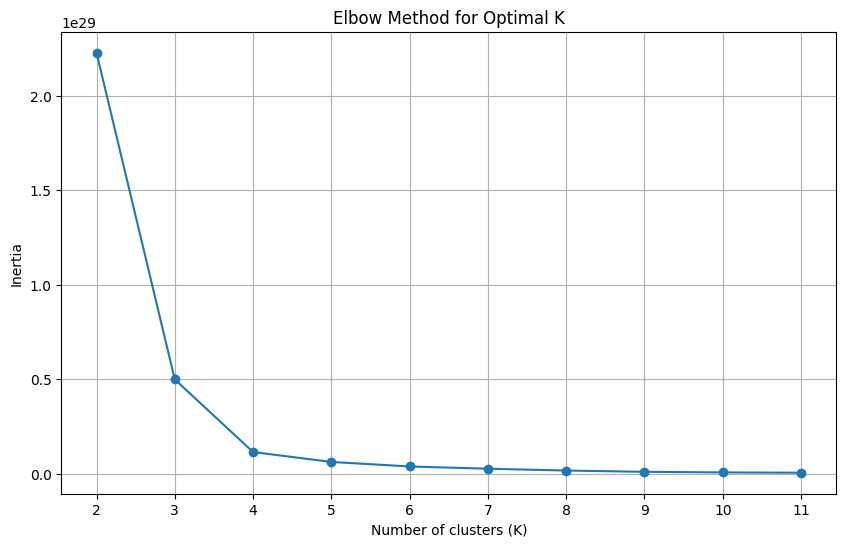

./elbow_test_export/SS-N_csv_100_44845_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         0            1          1.4        9    0.8   
1             1       1         0            0          2.0        1    0.4   
2             0       0         0            1          0.7       17    0.8   
3             0       0         0            1          0.7       17    0.4   
4             0       0         0            0          1.4       17    0.8   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         1            0          0.7        9    0.4   
1896          0       0         0            0          1.0        3    0.0   
1897          1       0         1            0          1.0        3    0.6   
1898          0       0         1            0          1.4        9    0.8   
1899          0       1         0            0          1.

<Figure size 640x480 with 0 Axes>

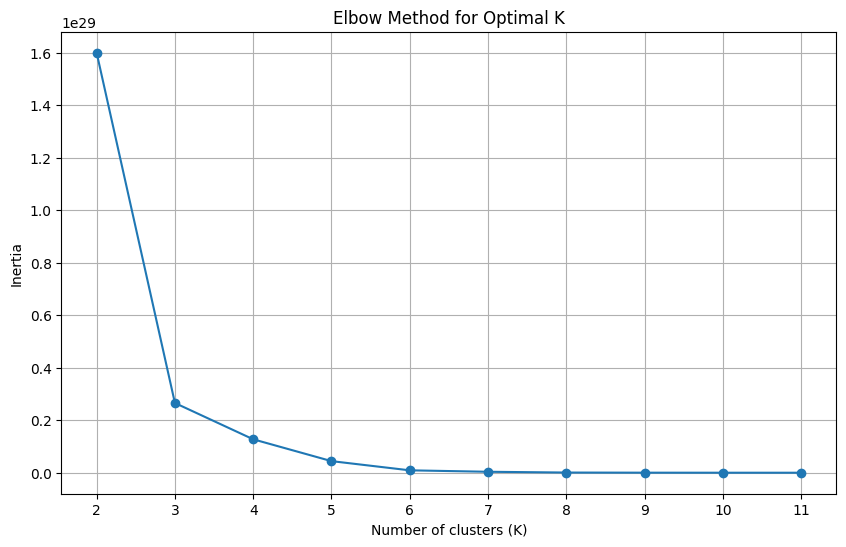

./elbow_test_export/SS-N_csv_100_51176_elbow_test.png
Optimal k value: 3
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         1            0          0.7       17    0.8   
1             0       0         0            0          1.4        9    0.8   
2             0       1         0            0          0.7        9    0.8   
3             0       0         0            0          1.4       17    0.8   
4             1       0         0            0          1.4       17    0.8   
...         ...     ...       ...          ...          ...      ...    ...   
1895          1       0         0            0          1.4        9    0.8   
1896          0       0         0            1          1.4       17    0.4   
1897          0       0         1            0          1.4        9    0.4   
1898          0       0         1            0          0.7       17    0.8   
1899          0       0         0            1          1.

<Figure size 640x480 with 0 Axes>

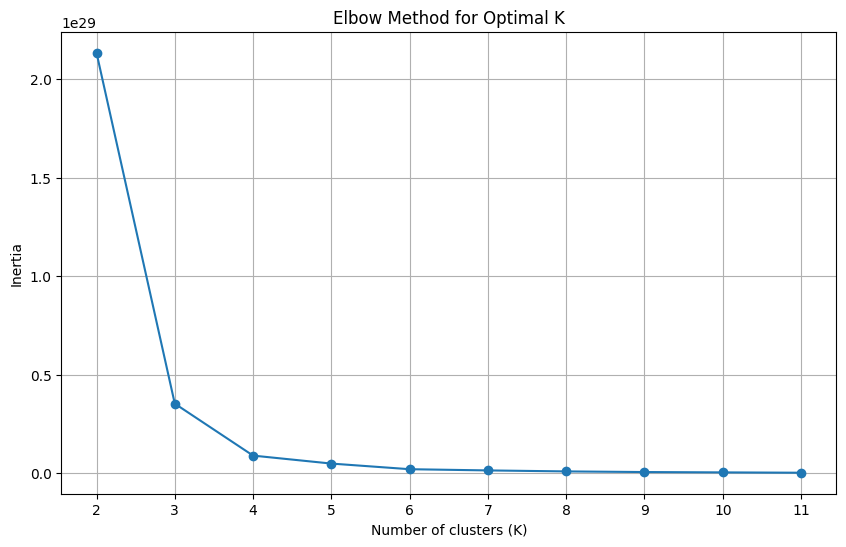

./elbow_test_export/SS-N_csv_100_58612_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         0            1          0.7        9    0.4   
1             1       0         0            0          1.4        9    0.8   
2             0       1         0            0          1.6        6    0.7   
3             0       0         0            1          0.7       17    0.4   
4             0       1         0            0          0.6       12    0.4   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            1          0.7        9    0.8   
1896          1       0         0            0          1.4       17    0.4   
1897          0       1         0            0          1.4       17    0.4   
1898          0       0         0            1          1.0        3    0.0   
1899          1       0         0            0          1.

<Figure size 640x480 with 0 Axes>

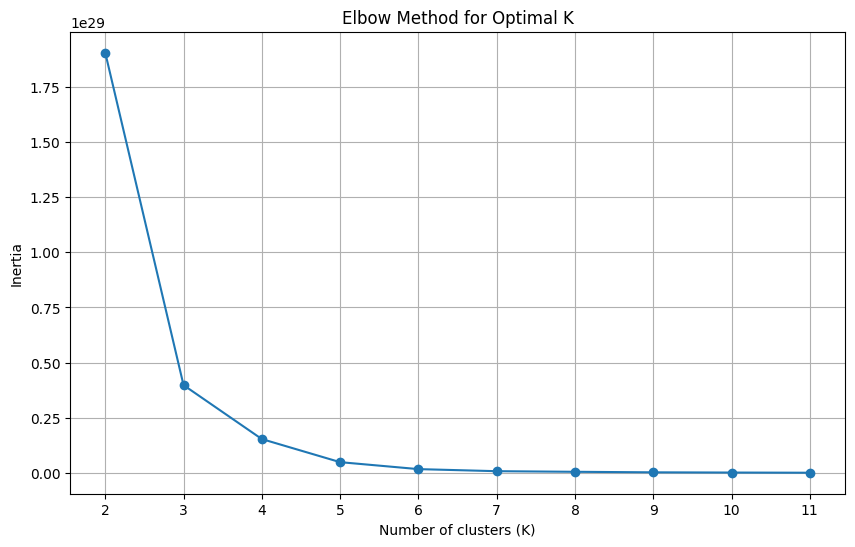

./elbow_test_export/SS-N_csv_100_61367_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         1            0          0.7        9    0.8   
1             0       0         1            0          1.4        9    0.8   
2             0       0         0            1          1.4        9    0.8   
3             0       1         0            0          1.4        9    0.4   
4             1       0         0            0          1.0        3    0.6   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            0          1.4       17    0.4   
1896          1       0         0            0          0.7       17    0.4   
1897          0       0         0            1          1.4       17    0.8   
1898          0       0         0            1          1.6        3    0.5   
1899          0       0         0            1          0.

<Figure size 640x480 with 0 Axes>

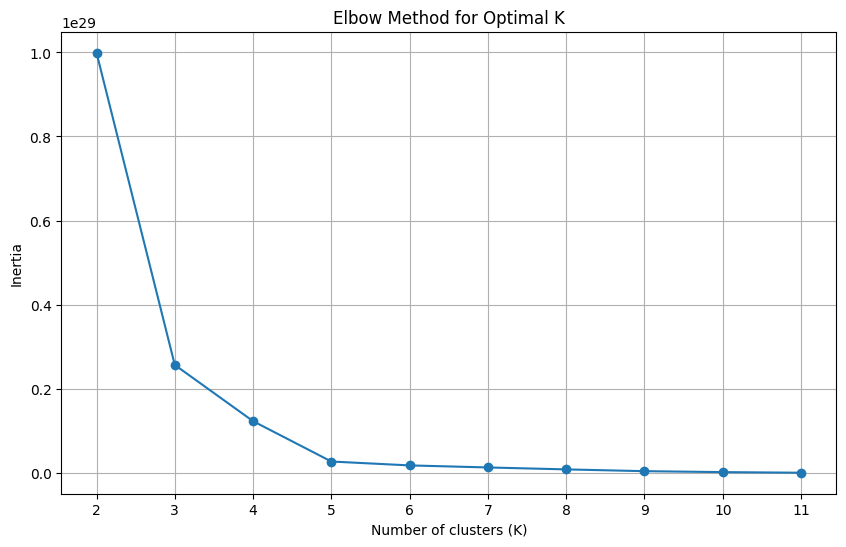

./elbow_test_export/SS-N_csv_100_65388_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       1         0            0          0.7       17    0.8   
1             1       0         0            0          0.7       17    0.8   
2             0       0         0            1          0.7       17    0.4   
3             0       1         0            0          1.0        3    0.6   
4             1       0         0            0          0.7       17    0.4   
...         ...     ...       ...          ...          ...      ...    ...   
1895          1       0         1            1          1.2        1    1.0   
1896          1       0         1            0          2.0       13    1.0   
1897          0       1         0            0          0.7        9    0.4   
1898          1       0         0            0          0.7        9    0.8   
1899          0       0         0            1          1.

<Figure size 640x480 with 0 Axes>

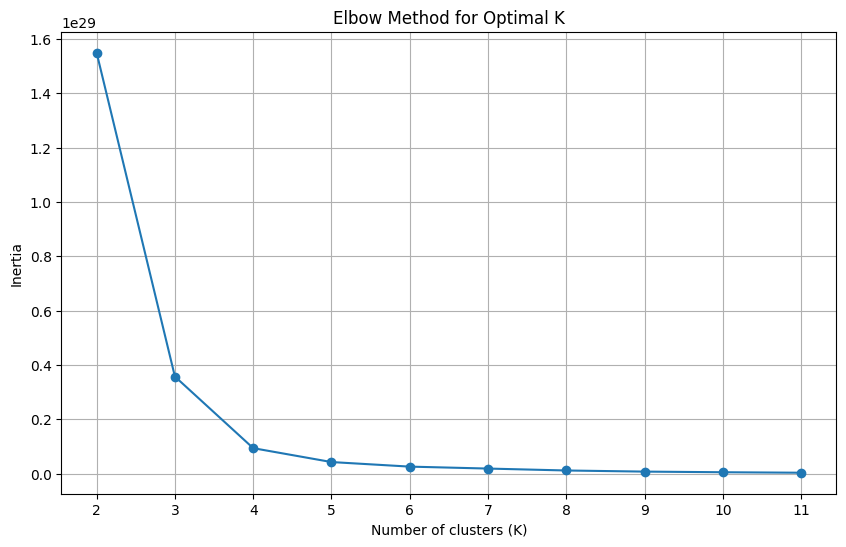

./elbow_test_export/SS-N_csv_100_65444_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         1            0          0.7        9    0.8   
1             0       0         0            0          1.0        3    0.6   
2             1       0         0            0          0.7       17    0.8   
3             0       0         0            0          1.0        3    0.6   
4             0       0         0            0          0.7       17    0.8   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            0          1.4       17    0.8   
1896          0       0         0            0          1.4        9    0.4   
1897          0       0         1            0          0.7        9    0.4   
1898          0       0         1            0          1.4       17    0.8   
1899          0       0         0            0          1.

<Figure size 640x480 with 0 Axes>

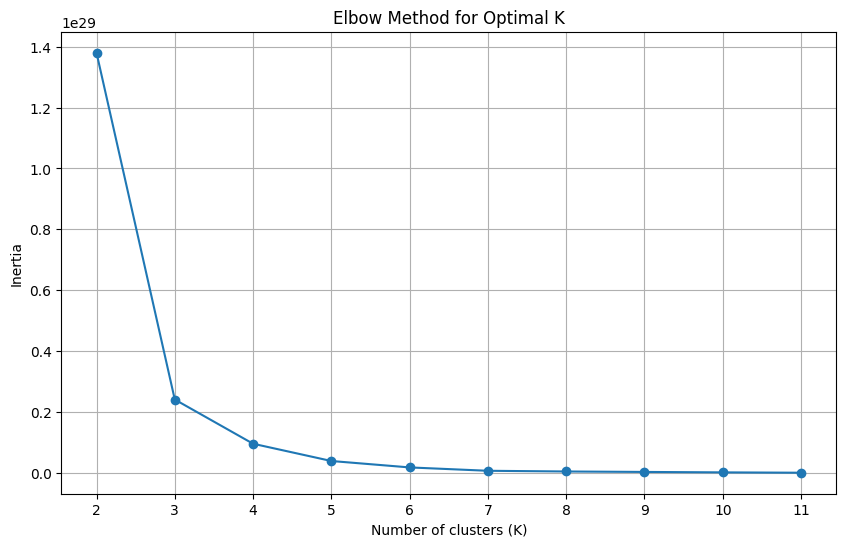

./elbow_test_export/SS-N_csv_100_66946_elbow_test.png
Optimal k value: 3
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         0            0          1.0       22    0.9   
1             0       0         0            0          1.0        3    0.6   
2             0       1         0            0          1.4        9    0.4   
3             0       0         1            0          2.0        5    1.0   
4             0       0         1            0          0.3        1    1.0   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            0          1.4        9    0.8   
1896          0       1         0            0          0.0       19    1.0   
1897          0       0         0            1          1.4       17    0.4   
1898          1       0         0            0          1.4       17    0.8   
1899          0       1         0            0          1.

<Figure size 640x480 with 0 Axes>

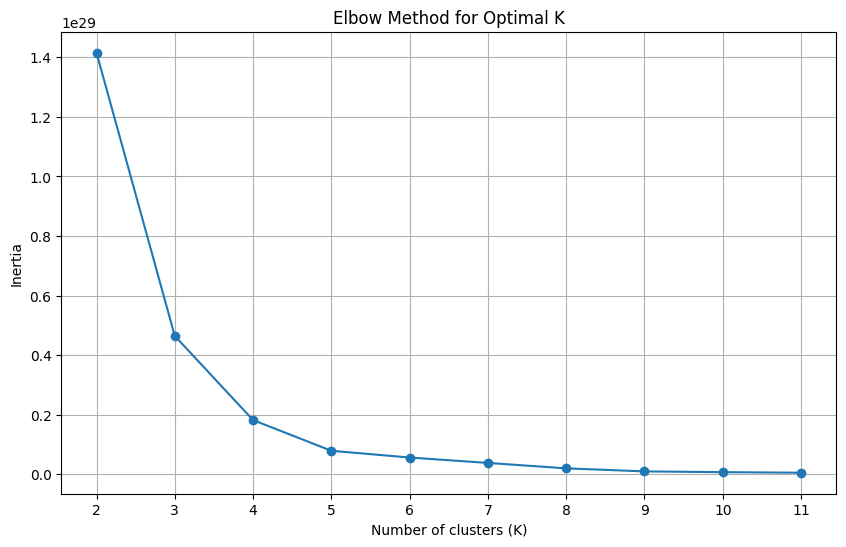

./elbow_test_export/SS-N_csv_100_69024_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         1            0          1.4       17    0.4   
1             0       0         1            0          0.7        9    0.4   
2             0       1         0            0          0.7        9    0.8   
3             0       1         0            0          1.4        9    0.8   
4             0       0         0            1          0.7        9    0.8   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            0          1.4       17    0.4   
1896          0       1         0            0          1.4       17    0.4   
1897          1       0         0            0          0.7        9    0.8   
1898          0       0         0            0          1.4        9    0.4   
1899          1       0         0            0          0.

<Figure size 640x480 with 0 Axes>

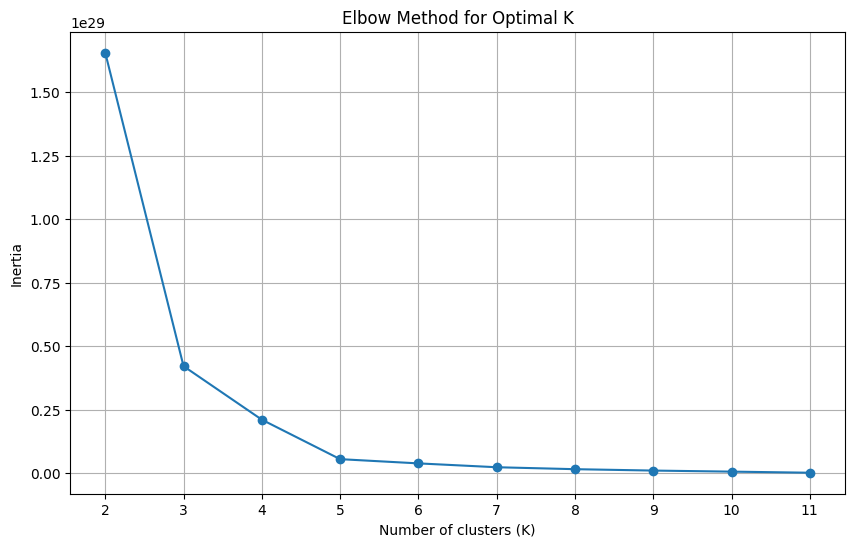

./elbow_test_export/SS-N_csv_100_70006_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         1            0          0.7        9    0.4   
1             0       0         1            1         15.0       21    0.0   
2             0       1         0            0          0.7       17    0.4   
3             0       0         0            1          1.4       17    0.8   
4             0       1         0            0          1.4        9    0.8   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            1          1.0        1    0.6   
1896          1       0         0            0          0.7       17    0.8   
1897          0       0         0            0          0.7        9    0.4   
1898          1       0         0            0          0.7       17    0.8   
1899          0       0         0            0         12.

<Figure size 640x480 with 0 Axes>

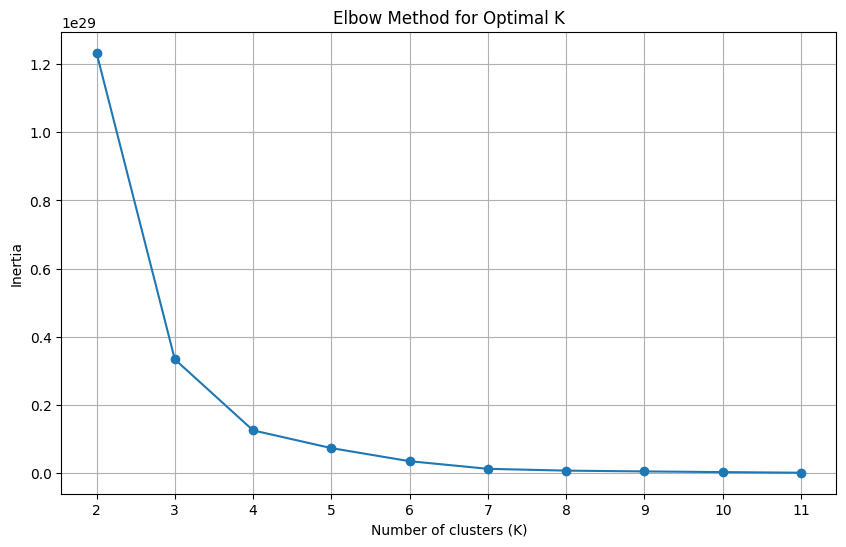

./elbow_test_export/SS-N_csv_100_70292_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         0            1          1.0        3    0.6   
1             0       1         1            0          1.0        3    0.6   
2             0       0         0            1          0.7        9    0.4   
3             0       1         0            0          1.4        9    0.4   
4             0       1         0            1          1.0        3    0.6   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       1         1            1          0.8       23    0.4   
1896          0       0         1            0          1.4        9    0.8   
1897          0       1         0            1          1.0        3    0.6   
1898          0       0         0            0          0.7       17    0.4   
1899          0       0         0            1          1.

<Figure size 640x480 with 0 Axes>

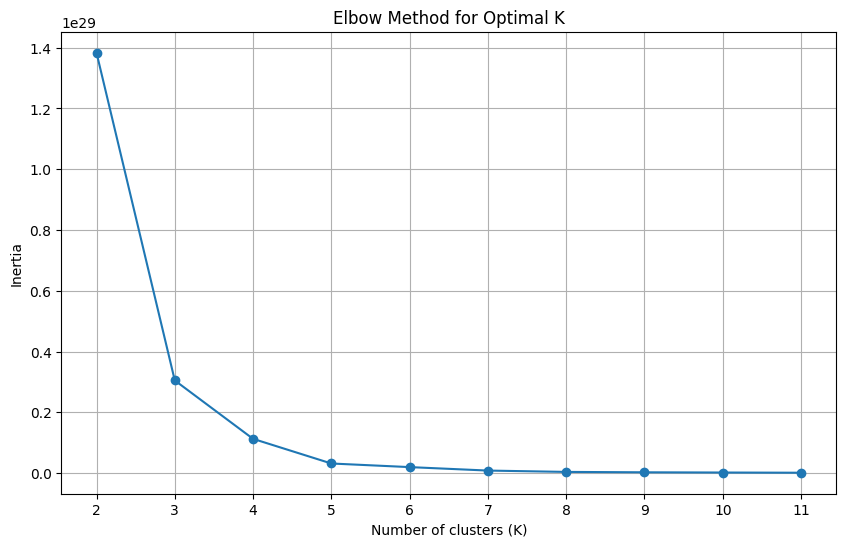

./elbow_test_export/SS-N_csv_100_77340_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         0            0          0.7        9    0.8   
1             0       0         0            0          0.7        9    0.4   
2             1       0         0            0          0.7        9    0.8   
3             0       0         0            0          1.4       17    0.8   
4             1       0         0            0          0.7        9    0.4   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            1          1.4       17    0.4   
1896          0       0         1            0          1.4        9    0.4   
1897          0       0         0            1          0.7       17    0.8   
1898          0       0         0            0          0.7       17    0.4   
1899          0       1         0            0          1.

<Figure size 640x480 with 0 Axes>

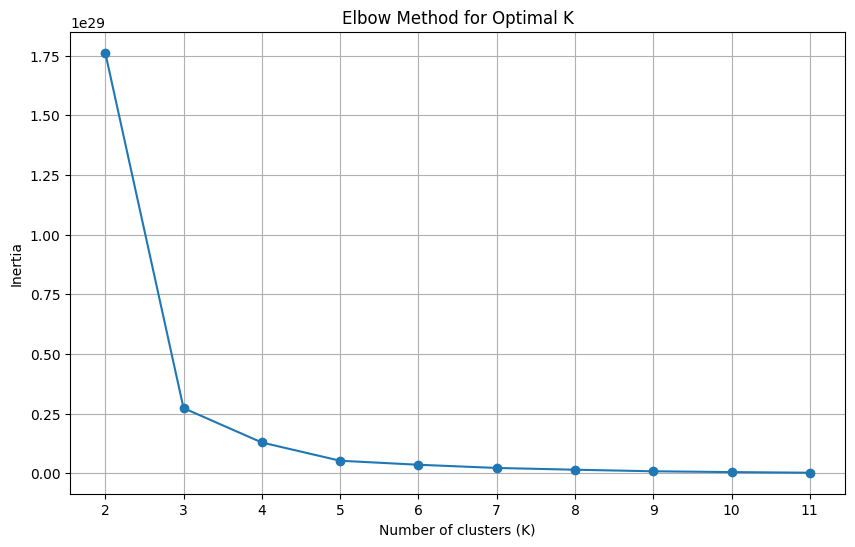

./elbow_test_export/SS-N_csv_100_77845_elbow_test.png
Optimal k value: 3
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         0            1          0.7        9    0.4   
1             1       0         0            0          0.7        9    0.8   
2             0       0         0            0          1.4       17    0.4   
3             0       0         0            0          0.7       17    0.8   
4             0       0         0            1          1.4        9    0.4   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       0         0            1          2.0        3    0.6   
1896          0       0         0            0          2.0       22    2.0   
1897          1       0         1            1          1.2       20    0.6   
1898          0       0         0            0          1.4       19    0.5   
1899          0       0         0            1          0.

<Figure size 640x480 with 0 Axes>

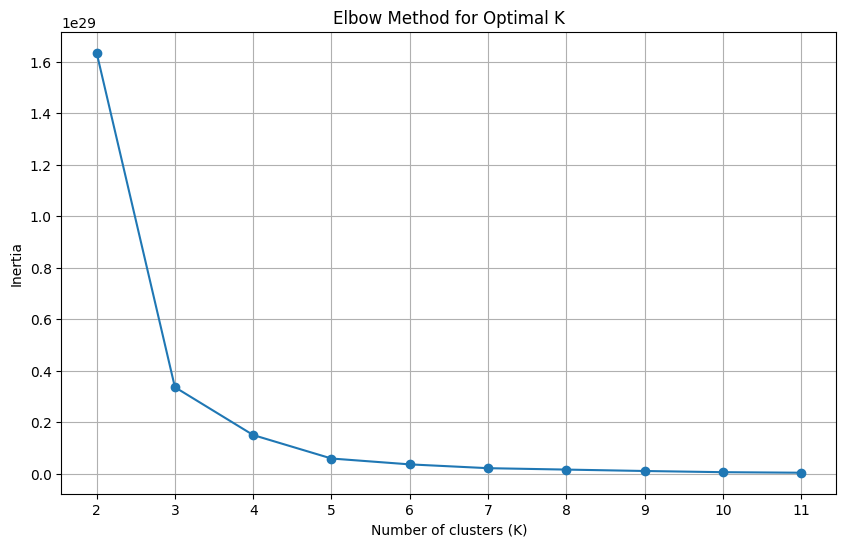

./elbow_test_export/SS-N_csv_100_83686_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         0            0          0.0       13    0.4   
1             0       0         1            0          1.0        3    0.6   
2             0       0         1            0          0.7       17    0.8   
3             0       0         0            1          1.7       20    0.0   
4             0       1         1            1          1.2       12    0.9   
...         ...     ...       ...          ...          ...      ...    ...   
1895          1       1         0            1          1.4       21    0.9   
1896          0       1         0            0          0.7       17    0.4   
1897          0       1         0            0          0.7        9    0.8   
1898          0       0         0            1          1.4        9    0.4   
1899          1       0         0            0          0.

<Figure size 640x480 with 0 Axes>

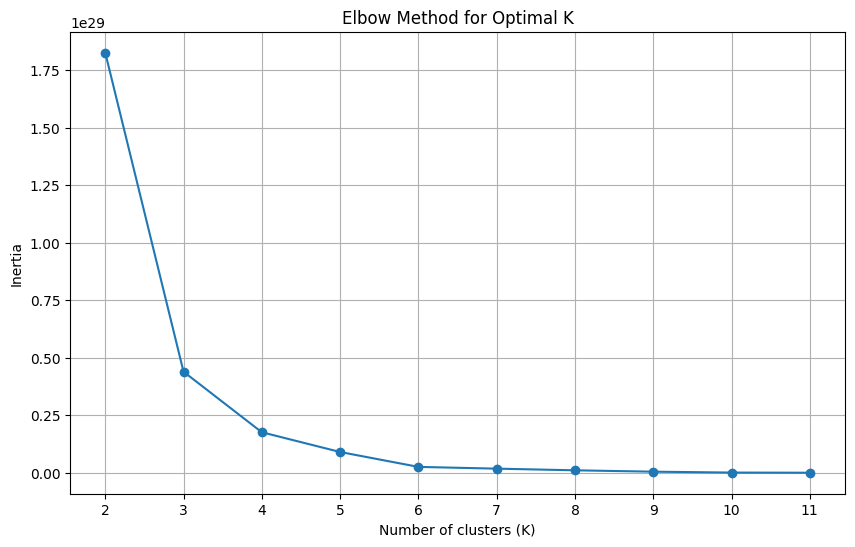

./elbow_test_export/SS-N_csv_100_84967_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             0       0         1            0          0.7        9    0.4   
1             0       0         0            1          0.7        9    0.8   
2             0       0         1            0          0.7        6    1.1   
3             0       0         1            0          0.7        9    0.8   
4             0       0         1            0          1.4       17    0.8   
...         ...     ...       ...          ...          ...      ...    ...   
1895          1       1         0            0          0.3       23    0.9   
1896          0       0         0            0         13.0        2   11.0   
1897          0       1         0            0          0.7        9    0.4   
1898          0       0         0            0          1.4       17    0.8   
1899          0       0         0            0          0.

<Figure size 640x480 with 0 Axes>

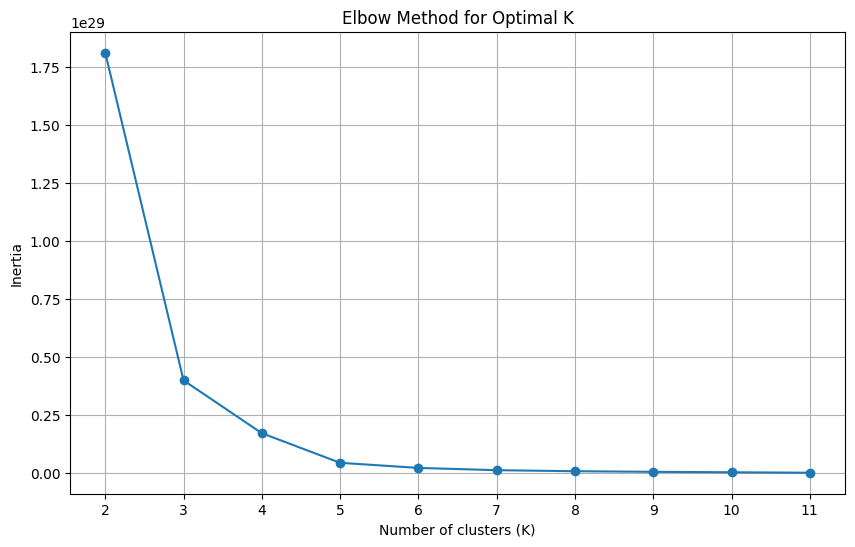

./elbow_test_export/SS-N_csv_100_86331_elbow_test.png
Optimal k value: 4
      No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0             1       0         0            0          0.7       17    0.8   
1             0       1         0            0          0.7       17    0.8   
2             1       0         0            0          0.7        9    0.8   
3             0       1         0            0          0.5       13    0.3   
4             0       0         0            0          0.7        9    0.4   
...         ...     ...       ...          ...          ...      ...    ...   
1895          0       1         0            0          0.7        9    0.4   
1896          1       0         1            0          1.4       18    1.0   
1897          0       0         1            0          1.4       17    0.4   
1898          1       0         0            0          1.4        9    0.4   
1899          1       0         0            0          1.

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_11514_elbow_test.png


<Figure size 640x480 with 0 Axes>

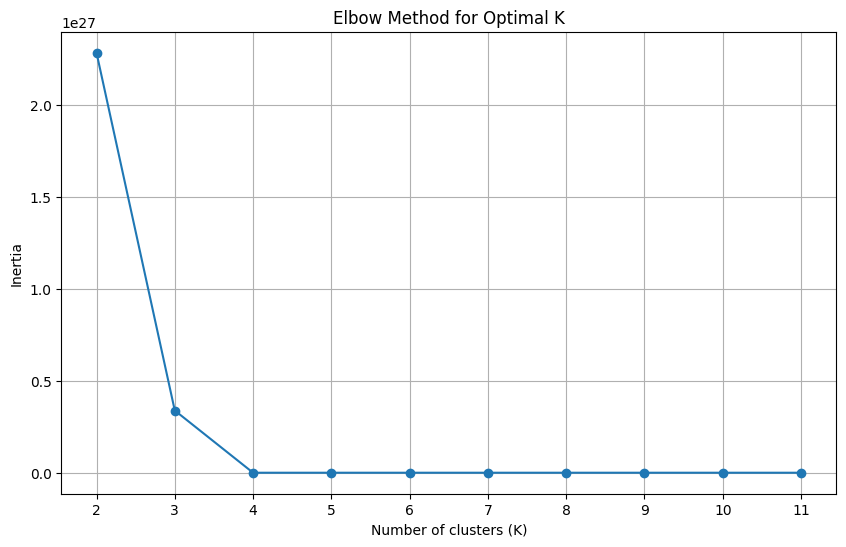

./elbow_test_export/SS-N_csv_10_11514_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          2.0        1    0.0   
1            0       0         0            0          1.4       17    0.4   
2            0       0         0            1          0.7        9    0.4   
3            0       0         0            1          1.0       13    0.6   
4            1       0         0            0          1.4        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         1            0          1.4        9    0.4   
186          0       0         0            0          0.7       17    0.4   
187          0       1         0            0          0.7       17    0.8   
188          1       0         0            0          2.0        3    0.6   
189          0       0         0            0          1.4        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_19953_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

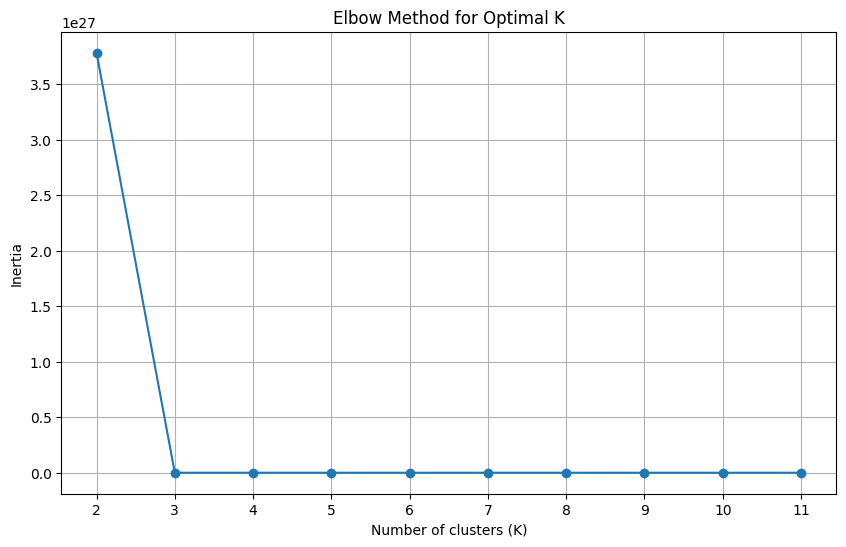

./elbow_test_export/SS-N_csv_10_19953_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.8   
1            0       0         0            1          0.7       17    0.8   
2            0       0         1            0          1.4        9    0.4   
3            0       0         1            0          0.7        9    0.4   
4            0       1         0            0          0.7        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            0          1.4        9    0.4   
186          1       0         0            0          1.4        9    0.4   
187          0       0         0            0          1.4       17    0.4   
188          1       0         0            0          0.7        9    0.8   
189          0       0         1            0          1.4        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of 

SS-N_csv_10_3545_elbow_test.png


<Figure size 640x480 with 0 Axes>

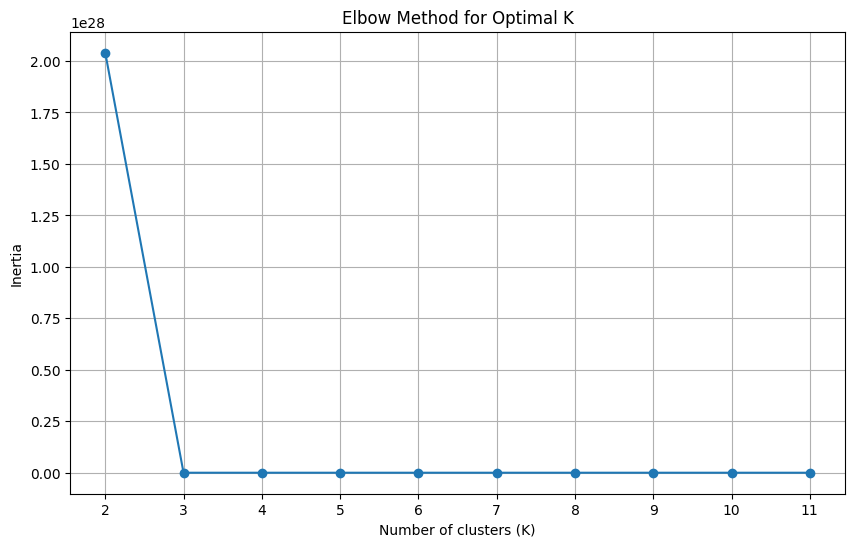

./elbow_test_export/SS-N_csv_10_3545_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       1         0            0          0.7        9    0.4   
1            0       0         1            0          1.4       17    0.4   
2            0       1         1            1          0.0        1    0.0   
3            0       1         0            0          1.0        3    0.6   
4            0       0         1            0          1.4        9    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       1         0            0          0.7       17    0.8   
186          1       0         0            0          1.4       17    0.4   
187          0       0         1            0          1.0        3    0.6   
188          1       0         0            0          1.4       17    0.8   
189          1       0         0            0          0.7        9    

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_39658_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

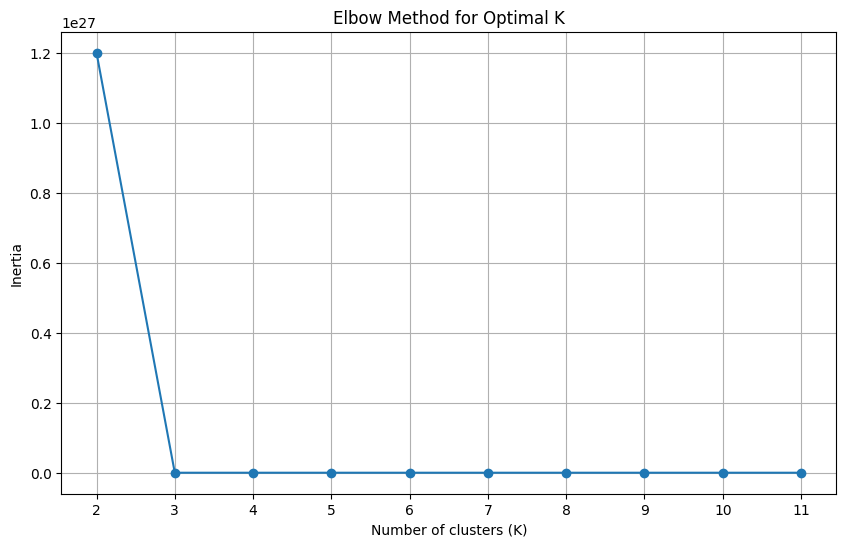

./elbow_test_export/SS-N_csv_10_39658_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       1         0            0          1.4        9    0.8   
1            0       0         0            1          1.4       17    0.4   
2            0       0         1            0          1.4        9    0.8   
3            0       0         0            1          0.7       17    0.8   
4            1       0         0            0          0.7        9    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
185          1       0         0            0          1.4       17    0.8   
186          0       1         0            0          1.4        9    0.4   
187          0       0         0            0          1.4       17    0.8   
188          0       0         0            1          0.7        9    0.8   
189          0       0         0            1          1.4       17   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_40749_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

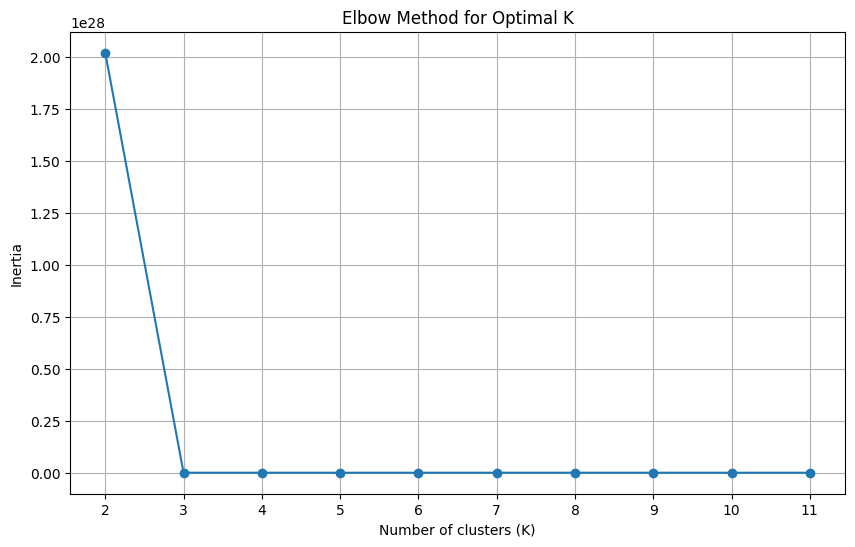

./elbow_test_export/SS-N_csv_10_40749_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            0          1.4       17    0.4   
1            0       0         1            0          0.7        9    0.4   
2            0       0         1            0          1.3        4    0.5   
3            0       0         0            1          1.4        9    0.8   
4            1       0         0            0          1.4       17    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         1            0          0.7       17    0.8   
186          0       0         0            0          2.0        3    0.0   
187          0       0         0            0          1.4        9    0.8   
188          1       0         0            0          1.4       17    0.4   
189          1       0         0            0          0.7        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (3). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_44845_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

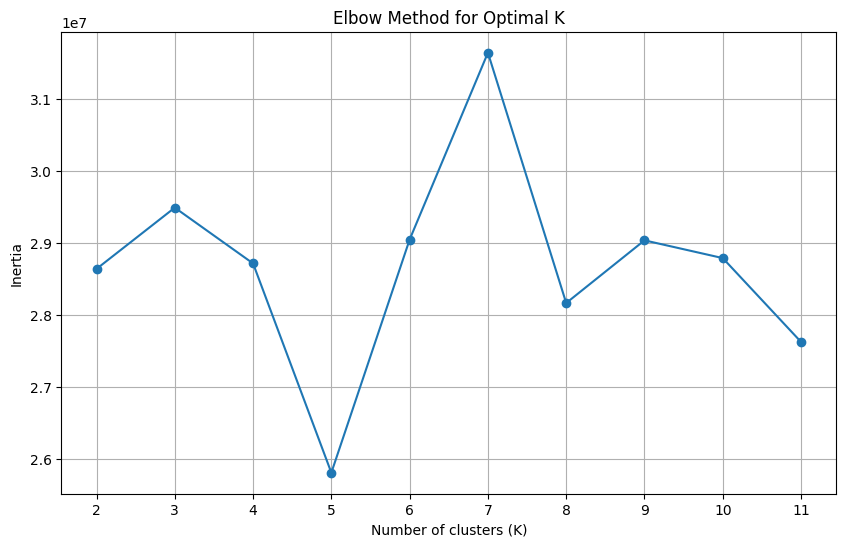

./elbow_test_export/SS-N_csv_10_44845_elbow_test.png
Optimal k value: 7


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1033: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  return self.fit(X, sample_weight=sample_weight).labels_


     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          1.4        9    0.8   
1            1       1         0            0          2.0        1    0.4   
2            0       0         0            1          0.7       17    0.8   
3            0       0         0            1          0.7       17    0.4   
4            0       0         0            0          1.4       17    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            0          0.7       17    0.8   
186          1       0         0            0          0.7       17    0.8   
187          0       0         1            0          0.7       17    0.4   
188          0       0         0            1          0.7       17    0.8   
189          0       0         1            0          0.7       17    0.8   

     Qp  Ref  Rc_lookahead  B_bias  Threads  Keyint   Crf  Scen

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


SS-N_csv_10_51176_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

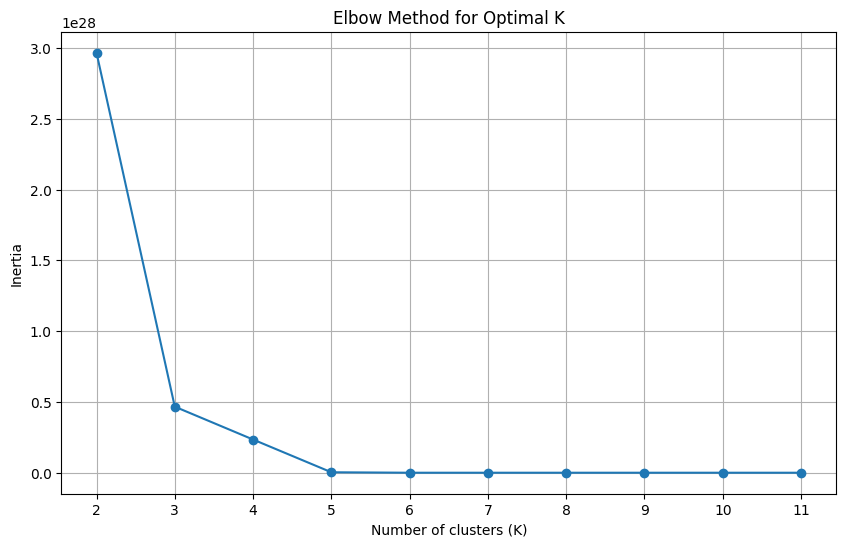

./elbow_test_export/SS-N_csv_10_51176_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7       17    0.8   
1            0       0         0            0          1.4        9    0.8   
2            0       1         0            0          0.7        9    0.8   
3            0       0         0            0          1.4       17    0.8   
4            1       0         0            0          1.4       17    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            1          0.7        9    0.8   
186          1       0         0            0          1.4        9    0.4   
187          0       0         0            1          1.4       17    0.4   
188          1       1         1            1          1.0       13    0.6   
189          1       0         0            0          1.4        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_58612_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

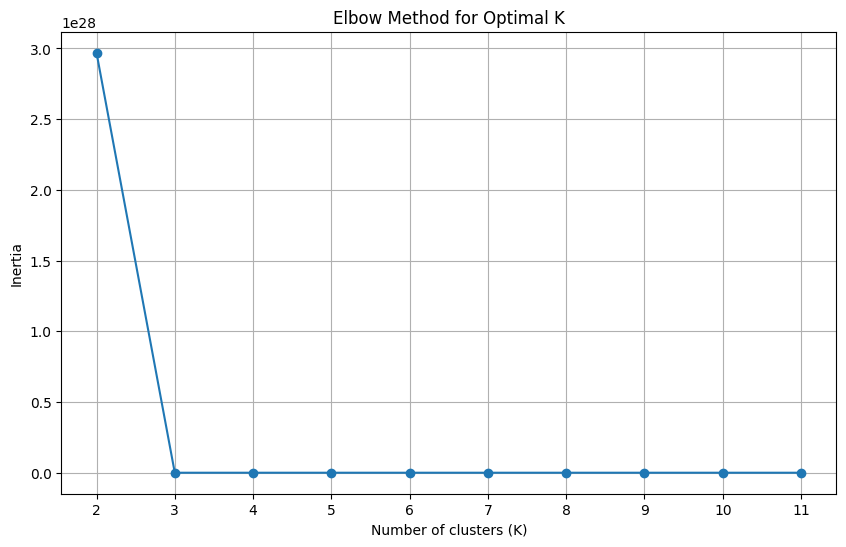

./elbow_test_export/SS-N_csv_10_58612_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          0.7        9    0.4   
1            1       0         0            0          1.4        9    0.8   
2            0       1         0            0          1.6        6    0.7   
3            0       0         0            1          0.7       17    0.4   
4            0       1         0            0          0.6       12    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            0          1.4        9    0.8   
186          1       1         0            0          0.0        7    0.2   
187          0       1         0            0          0.7        9    0.8   
188          0       0         1            0          1.4       17    0.4   
189          0       0         0            0          0.7        9   

<Figure size 640x480 with 0 Axes>

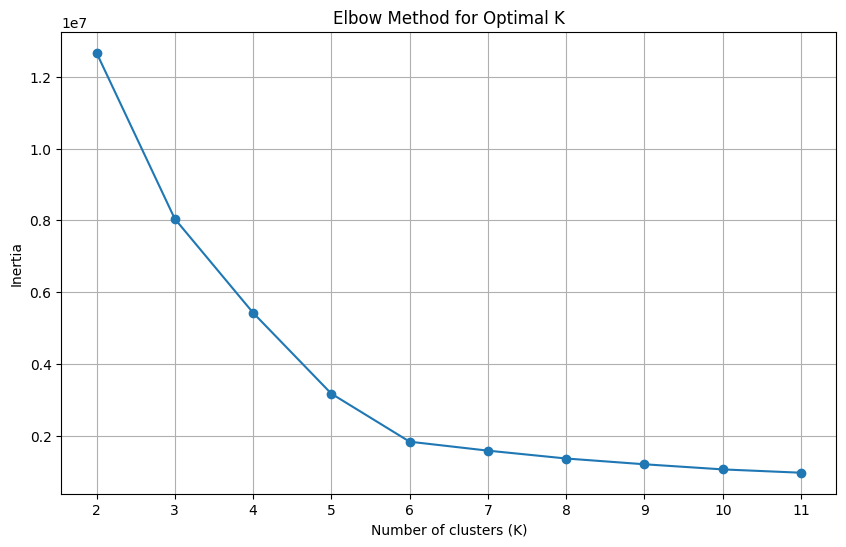

./elbow_test_export/SS-N_csv_10_61367_elbow_test.png
Optimal k value: 6
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.8   
1            0       0         1            0          1.4        9    0.8   
2            0       0         0            1          1.4        9    0.8   
3            0       1         0            0          1.4        9    0.4   
4            1       0         0            0          1.0        3    0.6   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            1          1.4        9    0.8   
186          1       0         0            0          0.7        9    0.4   
187          0       0         0            0          1.4       17    0.8   
188          0       0         0            0          1.4        1    0.9   
189          0       1         0            0          1.4        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_65388_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

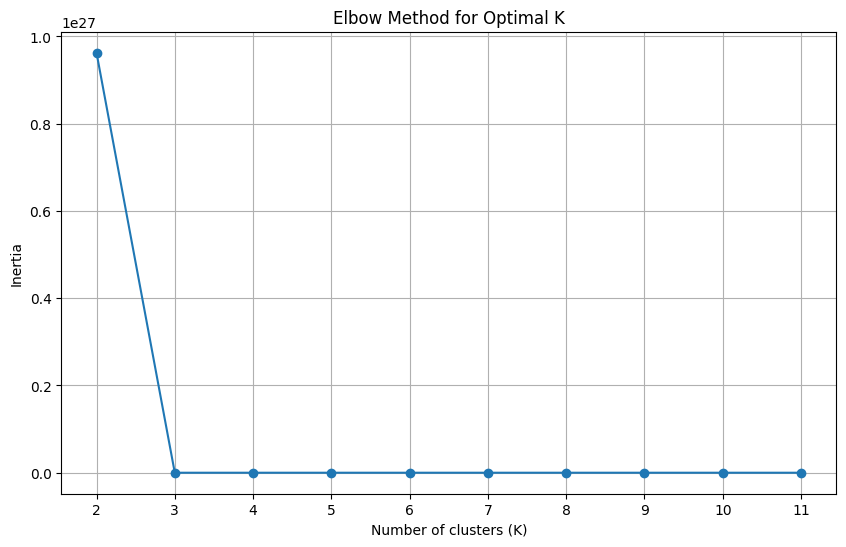

./elbow_test_export/SS-N_csv_10_65388_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       1         0            0          0.7       17    0.8   
1            1       0         0            0          0.7       17    0.8   
2            0       0         0            1          0.7       17    0.4   
3            0       1         0            0          1.0        3    0.6   
4            1       0         0            0          0.7       17    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            0          1.4       17    0.4   
186          1       0         0            0          1.4        9    0.4   
187          1       0         0            0          0.7       17    0.8   
188          0       1         0            0          1.4       17    0.4   
189          1       0         0            0          1.4       17   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


SS-N_csv_10_65444_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

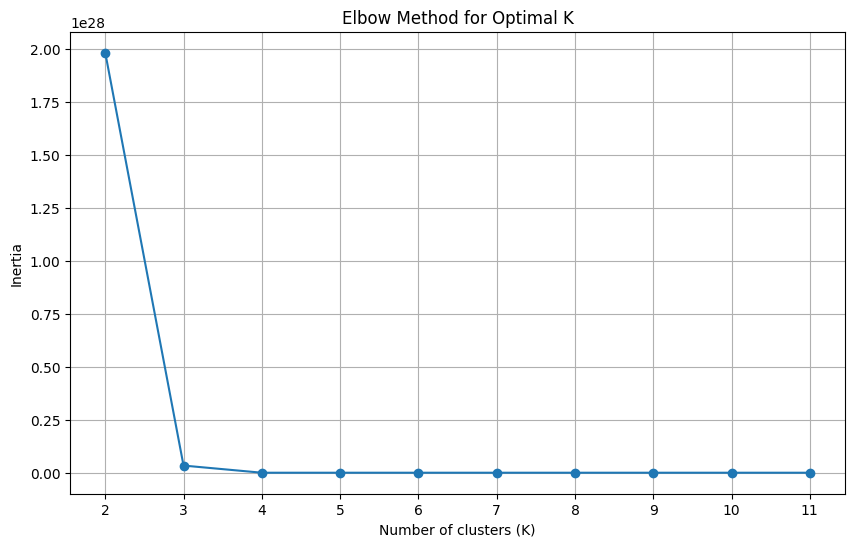

./elbow_test_export/SS-N_csv_10_65444_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.8   
1            0       0         0            0          1.0        3    0.6   
2            1       0         0            0          0.7       17    0.8   
3            0       0         0            0          1.0        3    0.6   
4            0       0         0            0          0.7       17    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            1          1.4       17    0.8   
186          0       1         0            0          0.7        9    0.8   
187          0       1         1            0          0.4       15    0.0   
188          0       0         1            0          0.7       17    0.4   
189          0       0         1            0          0.7       17   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_66946_elbow_test.png


<Figure size 640x480 with 0 Axes>

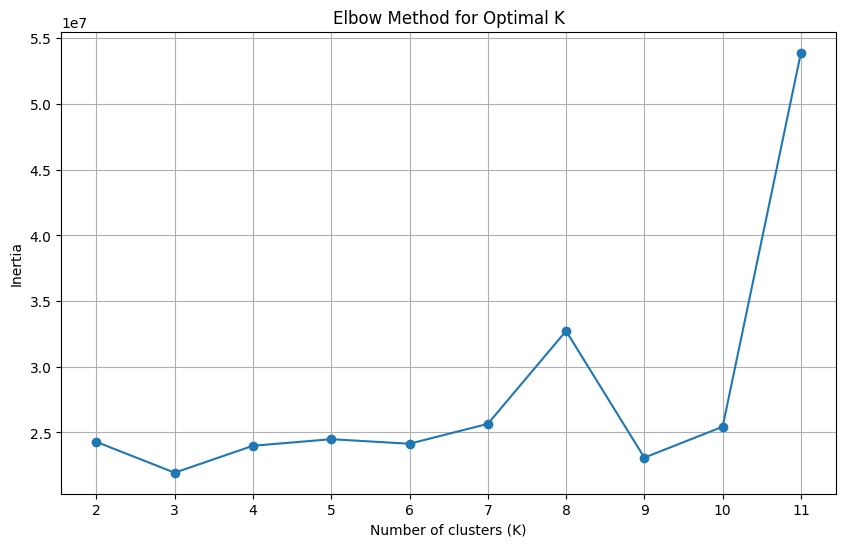

./elbow_test_export/SS-N_csv_10_66946_elbow_test.png
Optimal k value: 10
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            0          1.0       22    0.9   
1            0       0         0            0          1.0        3    0.6   
2            0       1         0            0          1.4        9    0.4   
3            0       0         1            0          2.0        5    1.0   
4            0       0         1            0          0.3        1    1.0   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         1            0          0.7       17    0.4   
186          0       1         0            0          1.0        3    0.6   
187          0       1         0            0          0.7        9    0.4   
188          0       0         1            0          0.7        9    0.8   
189          0       0         1            0          1.4       17  

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1033: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  return self.fit(X, sample_weight=sample_weight).labels_


   No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  Qp  \
0          0       0         1            0          1.4       17    0.4  34   
1          0       0         1            0          0.7        9    0.4  34   
2          0       1         0            0          0.7        9    0.8  34   
3          0       1         0            0          1.4        9    0.8  17   
4          0       0         0            1          0.7        9    0.8  17   

   Ref  Rc_lookahead  B_bias  Threads  Keyint   Crf  Scenecut  Seek  Ipratio  \
0    6            84      34       86     667  36.6        34   418      1.4   
1    6            84      34       86     667  23.3        34   836      0.7   
2    3           167     -33       43     667  36.6        34   418      1.4   
3    6            84      34       86     667  36.6        67   418      0.7   
4    6           167     -33       43     334  23.3        67   836      0.7   

    PSNR-      Energy-  
0  37.678  11

<Figure size 640x480 with 0 Axes>

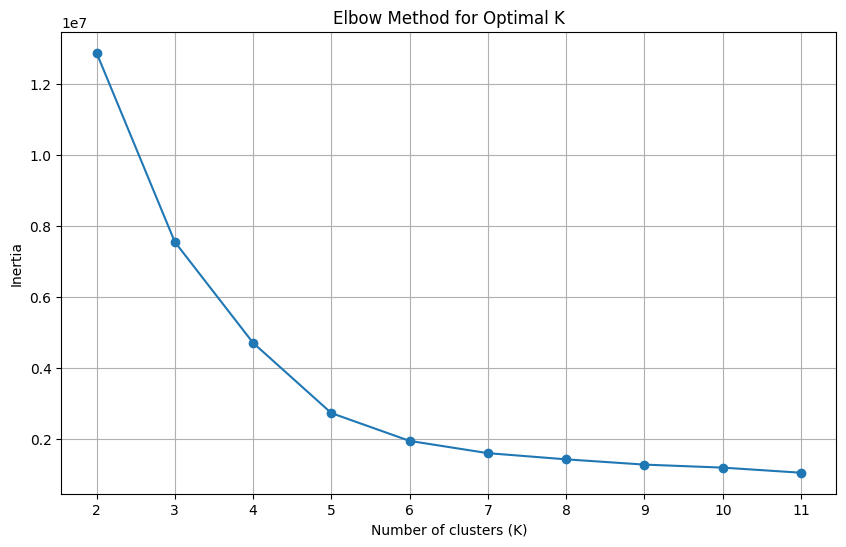

./elbow_test_export/SS-N_csv_10_69024_elbow_test.png
Optimal k value: 5
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          1.4       17    0.4   
1            0       0         1            0          0.7        9    0.4   
2            0       1         0            0          0.7        9    0.8   
3            0       1         0            0          1.4        9    0.8   
4            0       0         0            1          0.7        9    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       1         0            0          0.7        9    0.4   
186          1       0         0            0          0.7       17    0.4   
187          0       0         0            0          0.7        9    0.8   
188          0       0         0            1          1.4       17    0.8   
189          0       0         1            0          0.7        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


SS-N_csv_10_70006_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

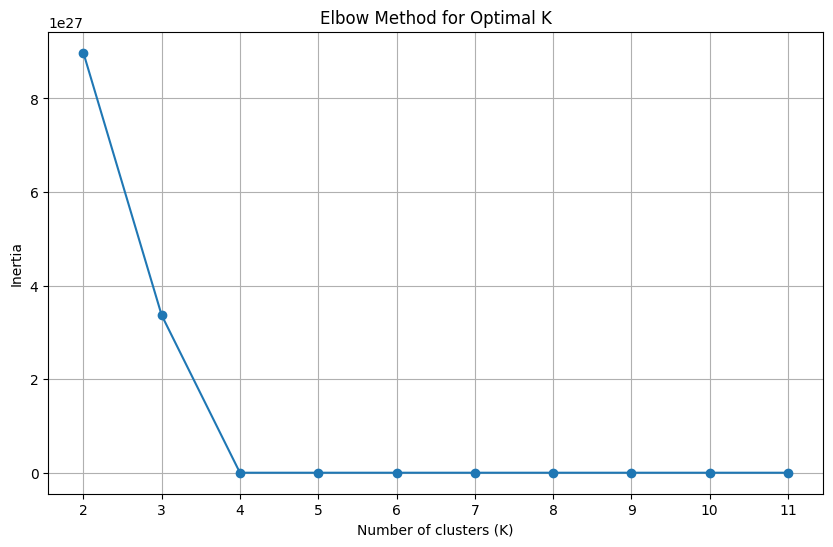

./elbow_test_export/SS-N_csv_10_70006_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.4   
1            0       0         1            1         15.0       21    0.0   
2            0       1         0            0          0.7       17    0.4   
3            0       0         0            1          1.4       17    0.8   
4            0       1         0            0          1.4        9    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            1          1.4       17    0.4   
186          0       1         0            0          1.4       17    0.8   
187          1       0         0            0          0.7       17    0.4   
188          0       1         0            1          1.0        1    0.6   
189          0       0         0            0          0.7        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (3). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_70292_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

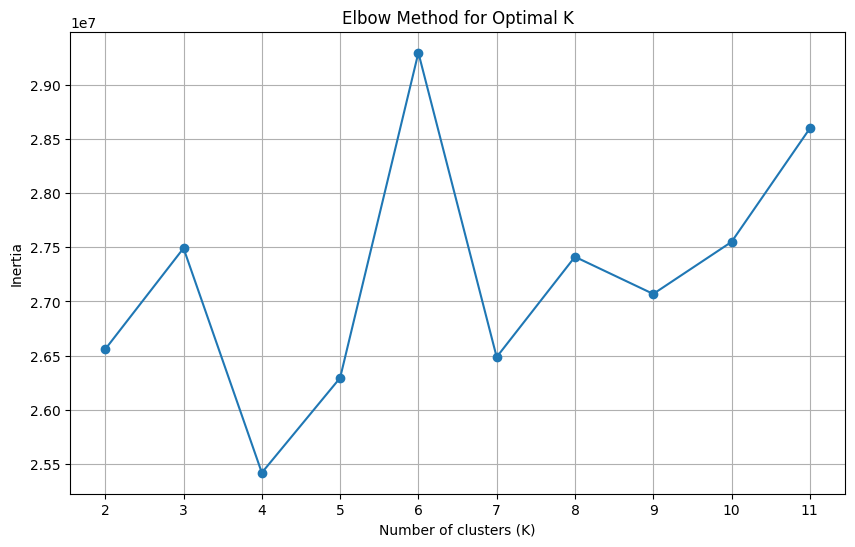

./elbow_test_export/SS-N_csv_10_70292_elbow_test.png
Optimal k value: 6
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          1.0        3    0.6   
1            0       1         1            0          1.0        3    0.6   
2            0       0         0            1          0.7        9    0.4   
3            0       1         0            0          1.4        9    0.4   
4            0       1         0            1          1.0        3    0.6   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         1            0          1.4        9    0.4   
186          0       1         0            0          0.7       17    0.4   
187          0       1         0            0          0.7       17    0.8   
188          0       0         0            1          1.4       17    0.4   
189          1       1         1            0          1.0       13   

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1033: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  return self.fit(X, sample_weight=sample_weight).labels_


   No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  Qp  \
0          0       0         0            0          0.7        9    0.8  17   
1          0       0         0            0          0.7        9    0.4  34   
2          1       0         0            0          0.7        9    0.8  34   
3          0       0         0            0          1.4       17    0.8  34   
4          1       0         0            0          0.7        9    0.4  34   

   Ref  Rc_lookahead  B_bias  Threads  Keyint   Crf  Scenecut  Seek  Ipratio  \
0    3            84     -33       86     667  36.6        34   418      1.4   
1    6           167      34       43     667  23.3        67   418      1.4   
2    3           167     -33       43     334  36.6        67   836      0.7   
3    6            84      34       43     334  23.3        34   836      0.7   
4    6           167      34       86     334  23.3        34   418      1.4   

    PSNR-      Energy-  
0  38.792  11

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_77340_elbow_test.png


<Figure size 640x480 with 0 Axes>

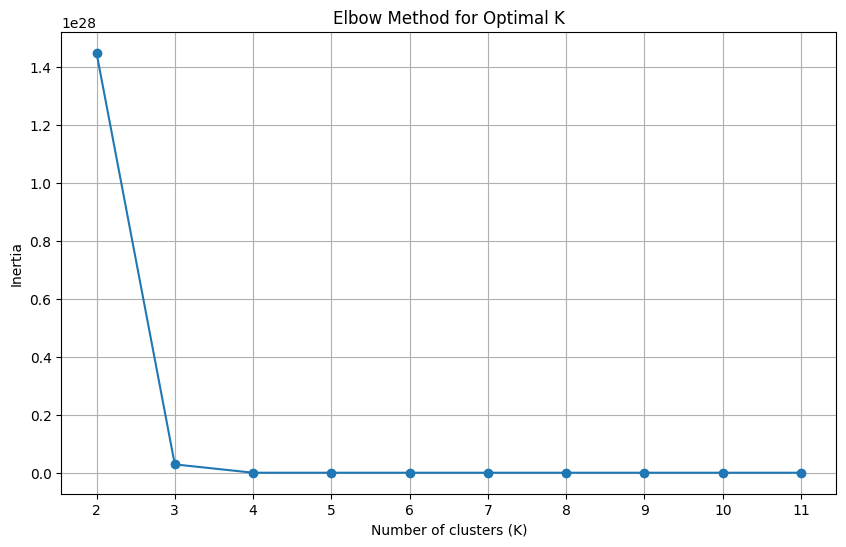

./elbow_test_export/SS-N_csv_10_77340_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            0          0.7        9    0.8   
1            0       0         0            0          0.7        9    0.4   
2            1       0         0            0          0.7        9    0.8   
3            0       0         0            0          1.4       17    0.8   
4            1       0         0            0          0.7        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            0         13.0       21    1.0   
186          0       0         1            0          0.7        9    0.8   
187          1       0         0            0          0.7       17    0.8   
188          1       0         0            0          1.0        3    0.6   
189          0       1         0            0          1.4       17   

<Figure size 640x480 with 0 Axes>

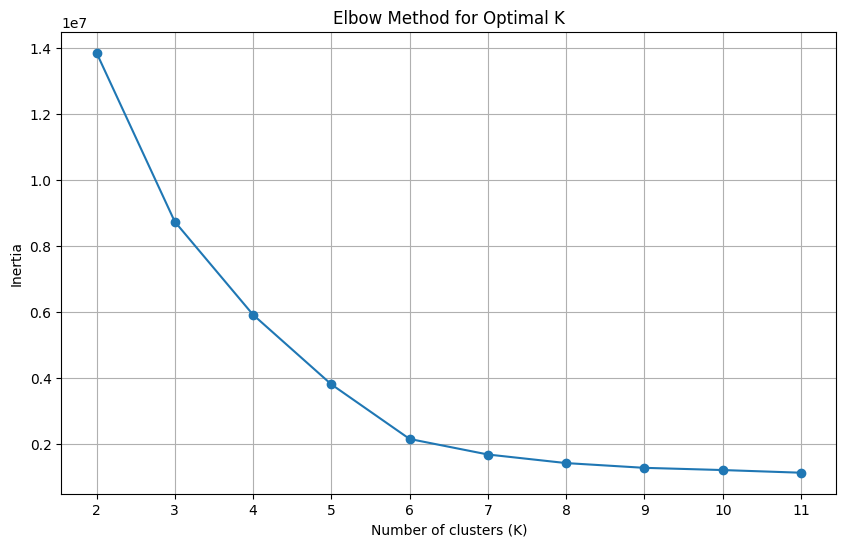

./elbow_test_export/SS-N_csv_10_77845_elbow_test.png
Optimal k value: 6
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          0.7        9    0.4   
1            1       0         0            0          0.7        9    0.8   
2            0       0         0            0          1.4       17    0.4   
3            0       0         0            0          0.7       17    0.8   
4            0       0         0            1          1.4        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         1            0          0.6       11    0.6   
186          0       0         0            1          0.7       17    0.8   
187          0       0         1            0          1.4       17    0.4   
188          0       1         0            0          0.7       17    0.4   
189          0       1         0            0          1.8       25   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


SS-N_csv_10_83686_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (6) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

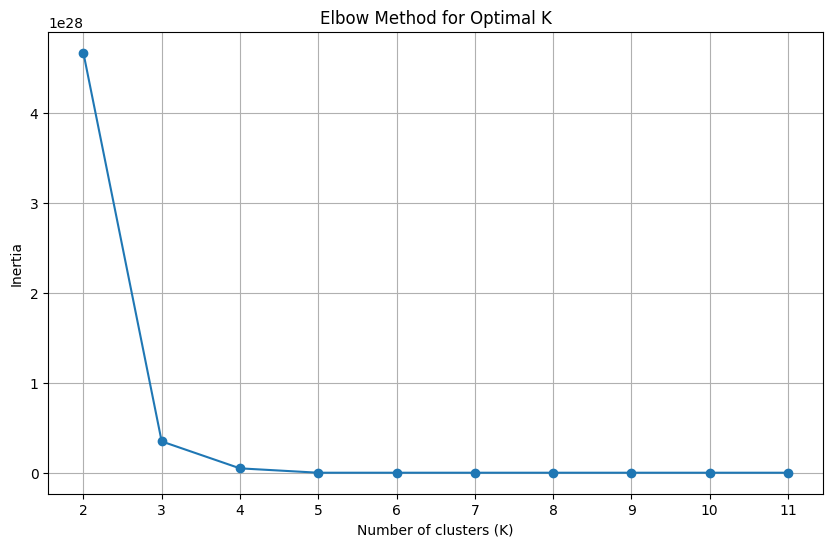

./elbow_test_export/SS-N_csv_10_83686_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            0          0.0       13    0.4   
1            0       0         1            0          1.0        3    0.6   
2            0       0         1            0          0.7       17    0.8   
3            0       0         0            1          1.7       20    0.0   
4            0       1         1            1          1.2       12    0.9   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         1            0          1.4        9    0.8   
186          0       0         0            1          0.7        9    0.4   
187          0       0         1            0          1.4        9    0.4   
188          0       0         0            1          0.7        9    0.8   
189          0       0         0            0          1.0        3   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (3). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_84967_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (2) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

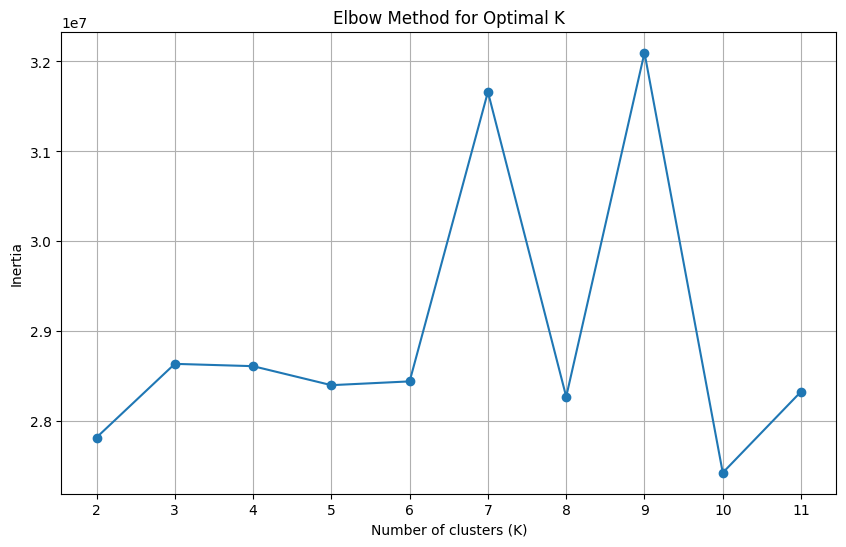

./elbow_test_export/SS-N_csv_10_84967_elbow_test.png
Optimal k value: 9
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.4   
1            0       0         0            1          0.7        9    0.8   
2            0       0         1            0          0.7        6    1.1   
3            0       0         1            0          0.7        9    0.8   
4            0       0         1            0          1.4       17    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
185          1       0         0            0          1.5       12    0.1   
186          0       0         0            1          1.4        9    0.8   
187          0       0         0            0          1.4        9    0.8   
188          0       0         0            0          0.7        9    0.4   
189          0       1         0            0          0.7       17   

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1033: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (9). Possibly due to duplicate points in X.
  return self.fit(X, sample_weight=sample_weight).labels_


   No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  Qp  \
0          1       0         0            0          0.7       17    0.8  17   
1          0       1         0            0          0.7       17    0.8  34   
2          1       0         0            0          0.7        9    0.8  34   
3          0       1         0            0          0.5       13    0.3  13   
4          0       0         0            0          0.7        9    0.4  34   

   Ref  Rc_lookahead  B_bias  Threads  Keyint   Crf  Scenecut  Seek  Ipratio  \
0    6            84      34       43     667  23.3        67   418      0.7   
1    3           167      34       86     334  36.6        34   836      0.7   
2    3            84      34       86     334  36.6        34   836      1.4   
3    0           250      50        0    1000  30.0        51   313      1.0   
4    6           167     -33       43     334  36.6        34   418      1.4   

    PSNR-      Energy-  
0  47.313  18

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (3) found smaller than n_clusters (4). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (5). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (6). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (7). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (5) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of d

SS-N_csv_10_86331_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (4) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

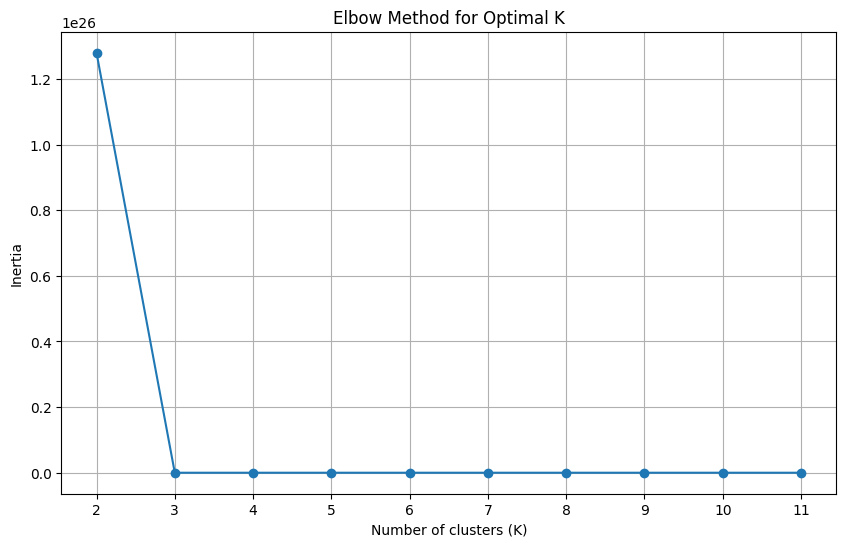

./elbow_test_export/SS-N_csv_10_86331_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            1       0         0            0          0.7       17    0.8   
1            0       1         0            0          0.7       17    0.8   
2            1       0         0            0          0.7        9    0.8   
3            0       1         0            0          0.5       13    0.3   
4            0       0         0            0          0.7        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
185          0       0         0            0          0.7       17    0.4   
186          0       0         1            0          1.4        9    0.8   
187          1       1         0            0          0.3       15    0.7   
188          0       0         0            0          0.7        9    0.4   
189          1       0         0            0          6.0        1   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


SS-N_csv_50_11514_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

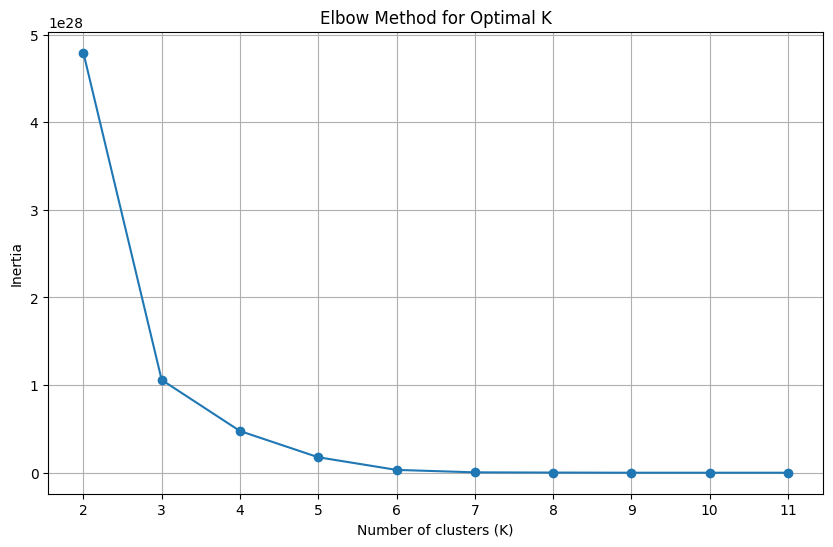

./elbow_test_export/SS-N_csv_50_11514_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          2.0        1    0.0   
1            0       0         0            0          1.4       17    0.4   
2            0       0         0            1          0.7        9    0.4   
3            0       0         0            1          1.0       13    0.6   
4            1       0         0            0          1.4        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       1         0            0          0.7       17    0.8   
946          1       1         1            1          1.2       17    0.0   
947          0       0         0            1          0.7       17    0.4   
948          0       0         1            0          1.0        3    0.6   
949          1       0         0            0          1.4        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


SS-N_csv_50_19953_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

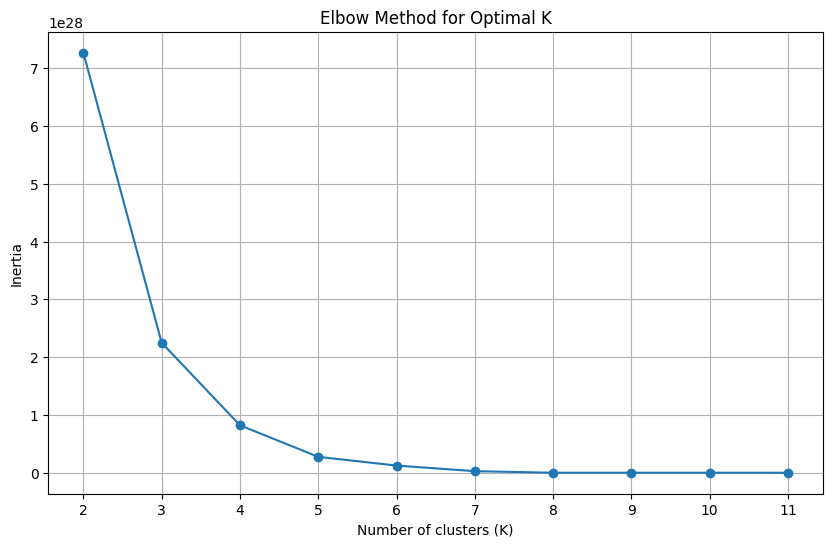

./elbow_test_export/SS-N_csv_50_19953_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.8   
1            0       0         0            1          0.7       17    0.8   
2            0       0         1            0          1.4        9    0.4   
3            0       0         1            0          0.7        9    0.4   
4            0       1         0            0          0.7        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         0            0          1.3        4    0.5   
946          0       0         0            0          1.4        9    0.8   
947          1       1         0            1          0.6        9    0.0   
948          0       0         1            1          1.0        3    0.0   
949          0       0         0            0          1.0        3   

<Figure size 640x480 with 0 Axes>

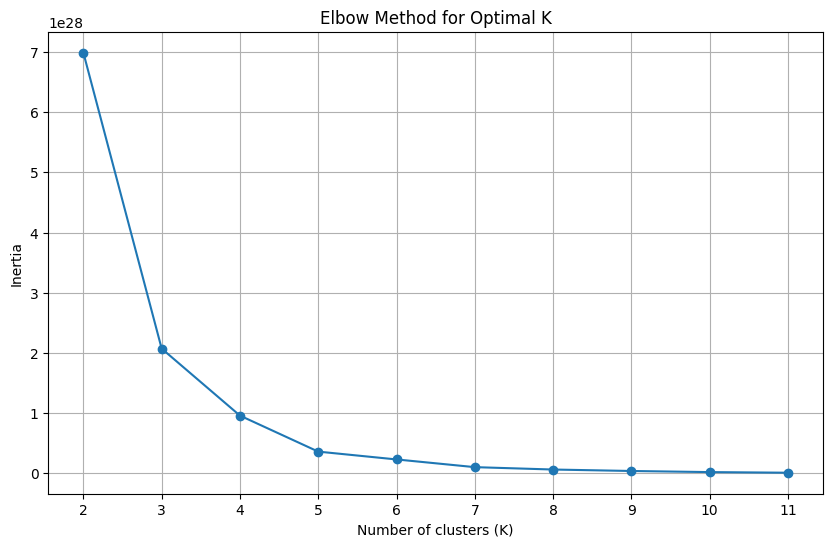

./elbow_test_export/SS-N_csv_50_3545_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       1         0            0          0.7        9    0.4   
1            0       0         1            0          1.4       17    0.4   
2            0       1         1            1          0.0        1    0.0   
3            0       1         0            0          1.0        3    0.6   
4            0       0         1            0          1.4        9    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
945          1       0         0            0          0.7       17    0.4   
946          0       0         1            0          1.4        9    0.4   
947          1       0         0            0          1.4        9    0.4   
948          1       0         0            0          0.7        9    0.4   
949          0       0         1            0          0.7       17    

<Figure size 640x480 with 0 Axes>

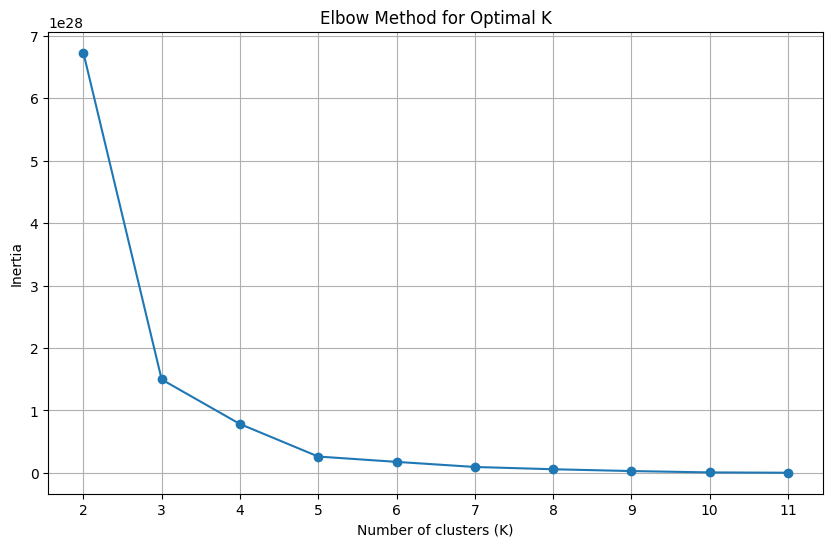

./elbow_test_export/SS-N_csv_50_39658_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       1         0            0          1.4        9    0.8   
1            0       0         0            1          1.4       17    0.4   
2            0       0         1            0          1.4        9    0.8   
3            0       0         0            1          0.7       17    0.8   
4            1       0         0            0          0.7        9    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       1         0            0          0.7        9    0.4   
946          0       1         0            0          1.4       17    0.8   
947          0       0         0            0          1.4       17    0.8   
948          0       0         1            0          0.7        9    0.8   
949          0       0         0            1          0.7        9   

<Figure size 640x480 with 0 Axes>

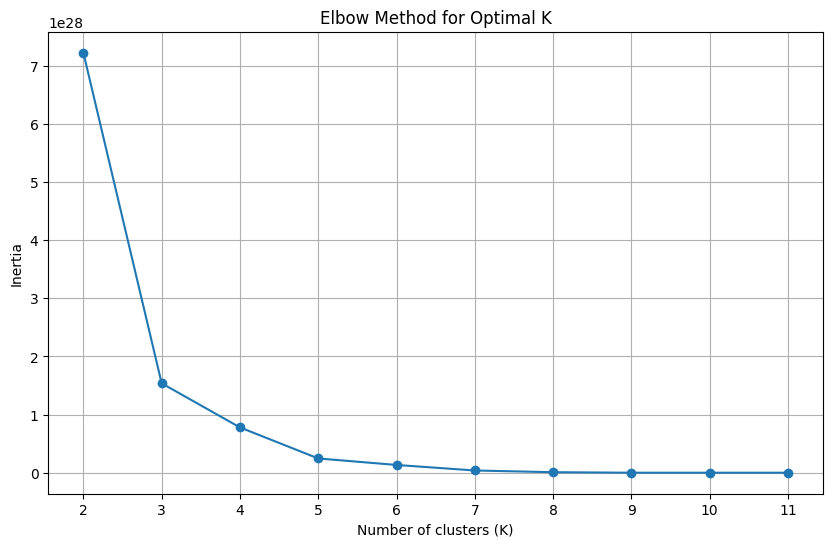

./elbow_test_export/SS-N_csv_50_40749_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            0          1.4       17    0.4   
1            0       0         1            0          0.7        9    0.4   
2            0       0         1            0          1.3        4    0.5   
3            0       0         0            1          1.4        9    0.8   
4            1       0         0            0          1.4       17    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         0            0          0.7       17    0.8   
946          0       0         1            0          1.4        9    0.4   
947          0       0         0            0          1.0        3    0.6   
948          0       1         0            0          1.0        3    0.6   
949          1       1         0            1          1.0       19   

<Figure size 640x480 with 0 Axes>

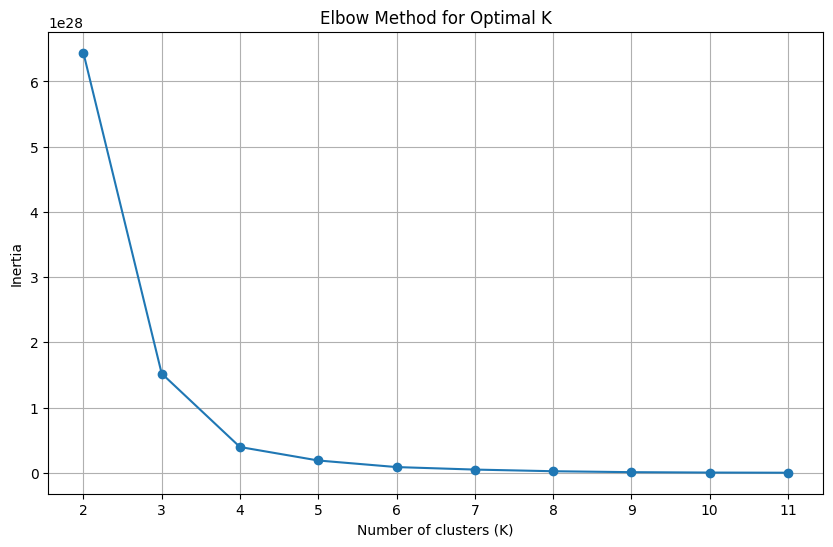

./elbow_test_export/SS-N_csv_50_44845_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          1.4        9    0.8   
1            1       1         0            0          2.0        1    0.4   
2            0       0         0            1          0.7       17    0.8   
3            0       0         0            1          0.7       17    0.4   
4            0       0         0            0          1.4       17    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         0            1          1.4       17    0.8   
946          0       1         0            0          1.4        9    0.4   
947          0       0         0            0          0.7        9    0.8   
948          0       0         0            1          1.4       17    0.8   
949          0       1         0            0          1.4        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

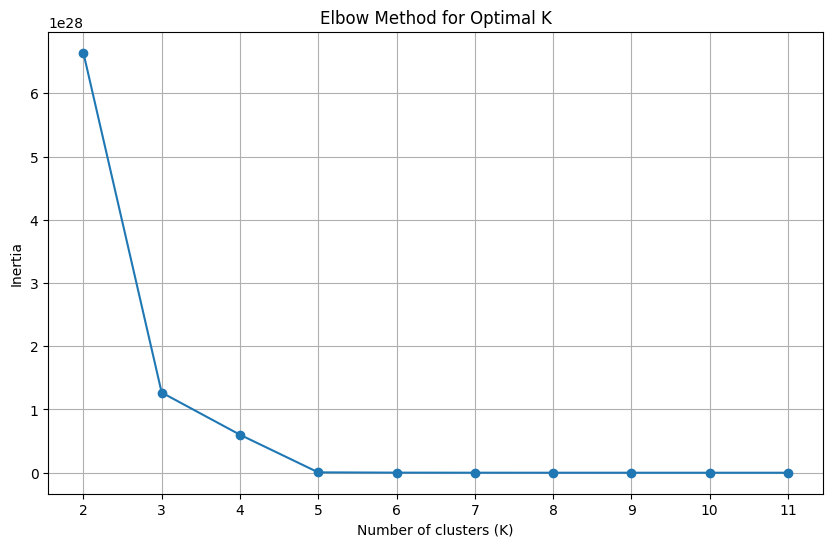

./elbow_test_export/SS-N_csv_50_51176_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7       17    0.8   
1            0       0         0            0          1.4        9    0.8   
2            0       1         0            0          0.7        9    0.8   
3            0       0         0            0          1.4       17    0.8   
4            1       0         0            0          1.4       17    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
945          1       0         0            0          0.7        9    0.8   
946          0       1         0            0          0.7        9    0.4   
947          0       1         0            0          1.4       17    0.4   
948          1       0         0            0          1.0        3    0.6   
949          0       0         1            0          0.7        9   

<Figure size 640x480 with 0 Axes>

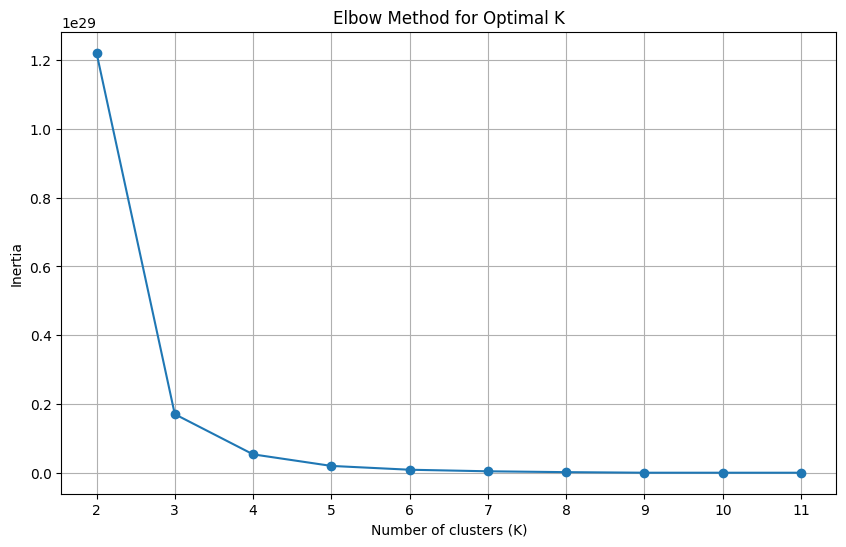

./elbow_test_export/SS-N_csv_50_58612_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          0.7        9    0.4   
1            1       0         0            0          1.4        9    0.8   
2            0       1         0            0          1.6        6    0.7   
3            0       0         0            1          0.7       17    0.4   
4            0       1         0            0          0.6       12    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         0            1          1.4       17    0.4   
946          1       0         0            0          1.4       17    0.4   
947          0       0         0            1          0.0        3    0.6   
948          1       0         0            0          1.4        9    0.8   
949          1       0         0            0          1.4       17   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


SS-N_csv_50_61367_elbow_test.png


<Figure size 640x480 with 0 Axes>

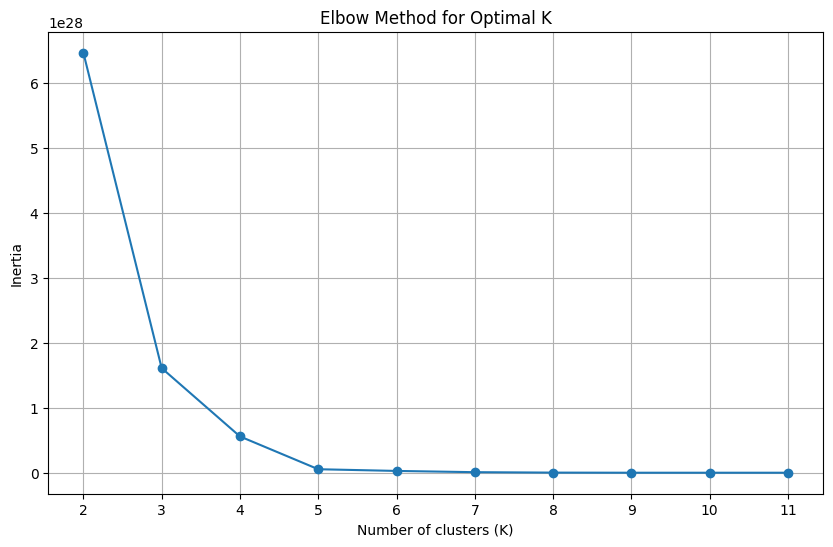

./elbow_test_export/SS-N_csv_50_61367_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.8   
1            0       0         1            0          1.4        9    0.8   
2            0       0         0            1          1.4        9    0.8   
3            0       1         0            0          1.4        9    0.4   
4            1       0         0            0          1.0        3    0.6   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         1            0          0.7        9    0.4   
946          0       0         0            0          1.4        9    0.8   
947          1       0         0            0          1.4        9    0.8   
948          0       0         0            0          0.7        9    0.8   
949          0       0         1            0          0.7        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

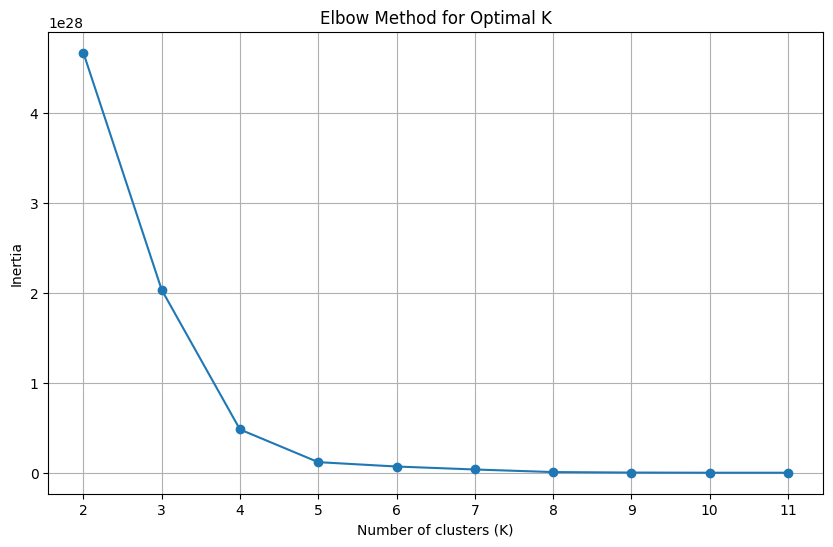

./elbow_test_export/SS-N_csv_50_65388_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       1         0            0          0.7       17    0.8   
1            1       0         0            0          0.7       17    0.8   
2            0       0         0            1          0.7       17    0.4   
3            0       1         0            0          1.0        3    0.6   
4            1       0         0            0          0.7       17    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         0            0          1.4       17    0.8   
946          1       0         0            0          0.7       17    0.4   
947          1       0         0            0          1.0        3    0.6   
948          1       1         0            0          1.5       25    0.6   
949          0       1         0            1          0.0        3   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

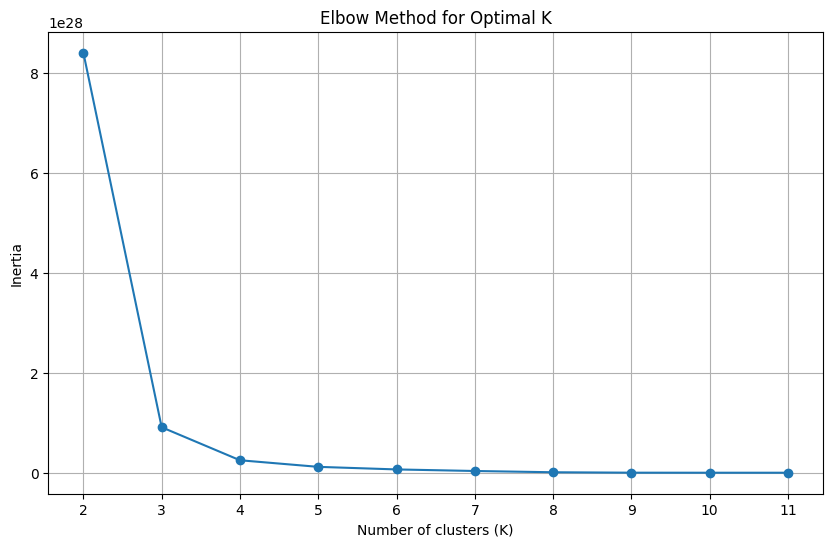

./elbow_test_export/SS-N_csv_50_65444_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.8   
1            0       0         0            0          1.0        3    0.6   
2            1       0         0            0          0.7       17    0.8   
3            0       0         0            0          1.0        3    0.6   
4            0       0         0            0          0.7       17    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         1            0          0.7       17    0.4   
946          0       1         0            0          0.7        9    0.4   
947          0       0         0            0         18.0       17    1.0   
948          1       0         0            0          0.7       17    0.4   
949          0       0         0            1          1.4        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (7) found smaller than n_clusters (8). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


SS-N_csv_50_66946_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

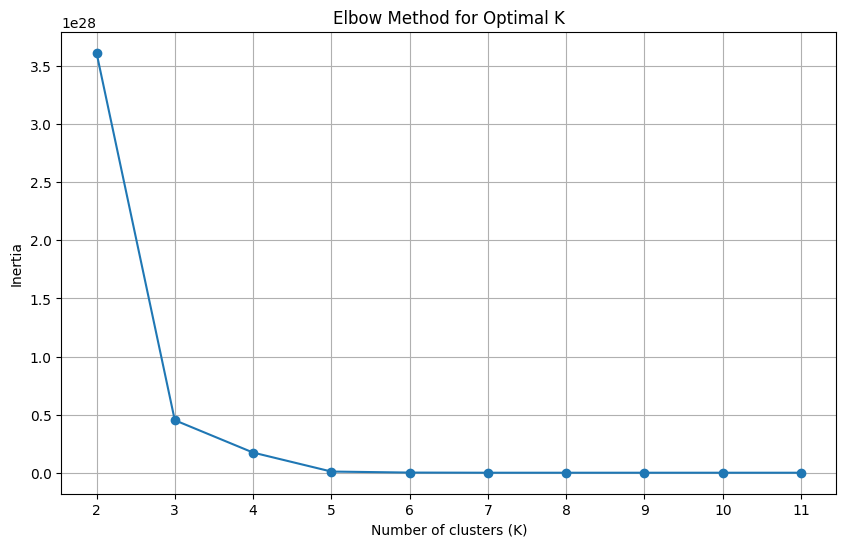

./elbow_test_export/SS-N_csv_50_66946_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            0          1.0       22    0.9   
1            0       0         0            0          1.0        3    0.6   
2            0       1         0            0          1.4        9    0.4   
3            0       0         1            0          2.0        5    1.0   
4            0       0         1            0          0.3        1    1.0   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       1         0            1          0.0       25    1.0   
946          1       0         0            0          1.4        9    0.4   
947          0       0         1            0          0.7        9    0.4   
948          1       0         0            1          1.0        3    0.6   
949          1       0         0            0          0.7       17   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


SS-N_csv_50_69024_elbow_test.png


<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

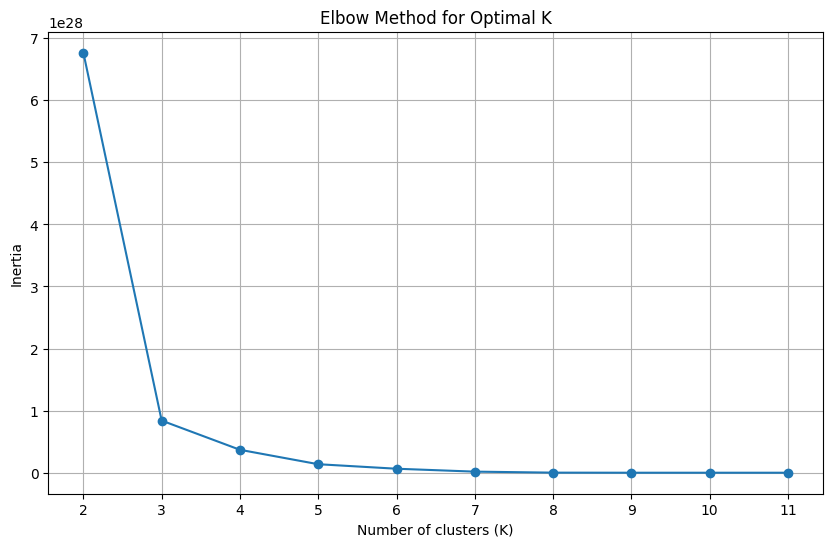

./elbow_test_export/SS-N_csv_50_69024_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          1.4       17    0.4   
1            0       0         1            0          0.7        9    0.4   
2            0       1         0            0          0.7        9    0.8   
3            0       1         0            0          1.4        9    0.8   
4            0       0         0            1          0.7        9    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         0            0          1.4        9    0.8   
946          0       0         1            0          0.7        9    0.8   
947          0       0         0            0          0.7        9    0.4   
948          0       0         0            1          0.7        9    0.8   
949          0       0         0            1          0.7        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

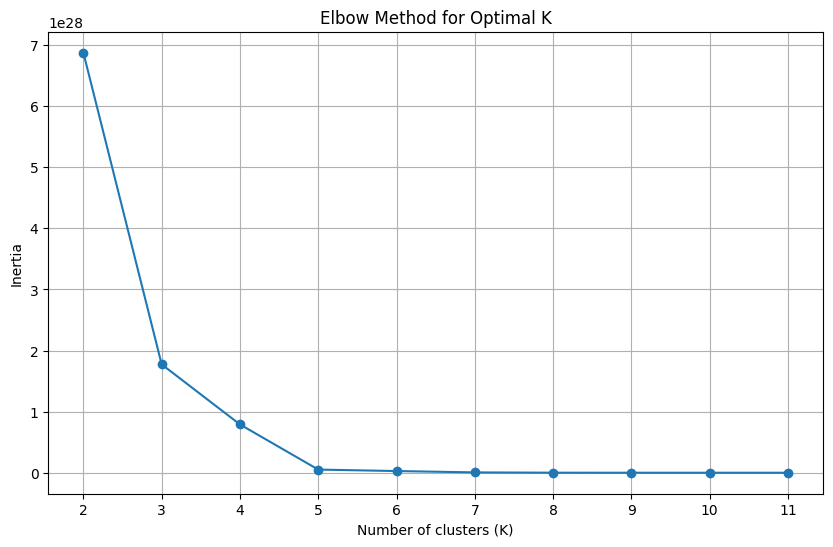

./elbow_test_export/SS-N_csv_50_70006_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.4   
1            0       0         1            1         15.0       21    0.0   
2            0       1         0            0          0.7       17    0.4   
3            0       0         0            1          1.4       17    0.8   
4            0       1         0            0          1.4        9    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         0            0          1.4        9    0.8   
946          0       0         0            0          1.4        9    0.4   
947          0       0         0            1          0.7       17    0.4   
948          0       0         0            0          1.4       17    0.4   
949          0       1         0            0          0.7       17   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

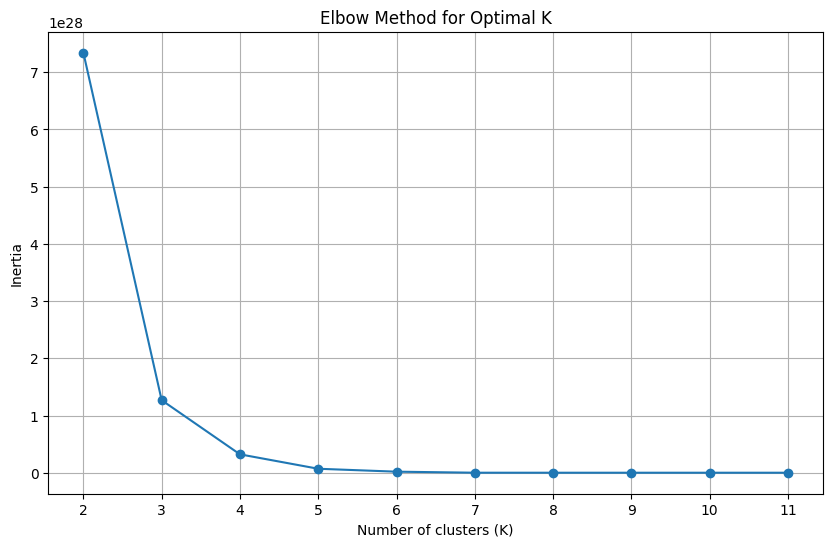

./elbow_test_export/SS-N_csv_50_70292_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          1.0        3    0.6   
1            0       1         1            0          1.0        3    0.6   
2            0       0         0            1          0.7        9    0.4   
3            0       1         0            0          1.4        9    0.4   
4            0       1         0            1          1.0        3    0.6   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         0            1          0.7       17    0.4   
946          0       1         0            0          1.4        9    0.8   
947          0       1         0            0          1.4       17    0.8   
948          0       0         0            0          0.8        4    0.5   
949          0       0         1            0          1.4       17   

<Figure size 640x480 with 0 Axes>

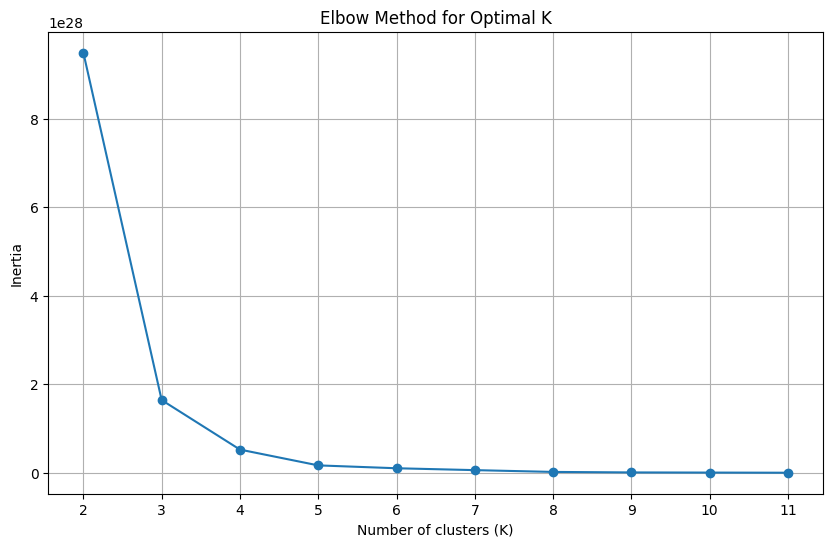

./elbow_test_export/SS-N_csv_50_77340_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            0          0.7        9    0.8   
1            0       0         0            0          0.7        9    0.4   
2            1       0         0            0          0.7        9    0.8   
3            0       0         0            0          1.4       17    0.8   
4            1       0         0            0          0.7        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
945          1       0         0            0          1.4       17    0.8   
946          0       0         0            0          1.4       17    0.4   
947          1       0         0            1          2.0       25    0.0   
948          0       0         0            1          0.7        9    0.4   
949          1       0         0            0          0.7        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

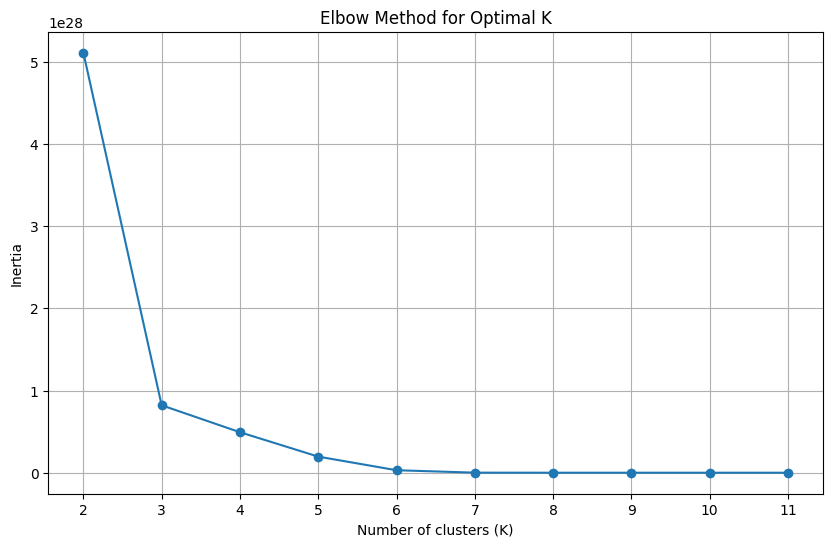

./elbow_test_export/SS-N_csv_50_77845_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            1          0.7        9    0.4   
1            1       0         0            0          0.7        9    0.8   
2            0       0         0            0          1.4       17    0.4   
3            0       0         0            0          0.7       17    0.8   
4            0       0         0            1          1.4        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
945          1       0         0            0          1.2        8    0.8   
946          0       1         1            1          0.8       23    0.4   
947          1       0         0            0          0.7       17    0.4   
948          0       0         0            0          0.7        9    0.8   
949          0       0         1            0          0.7        9   

<Figure size 640x480 with 0 Axes>

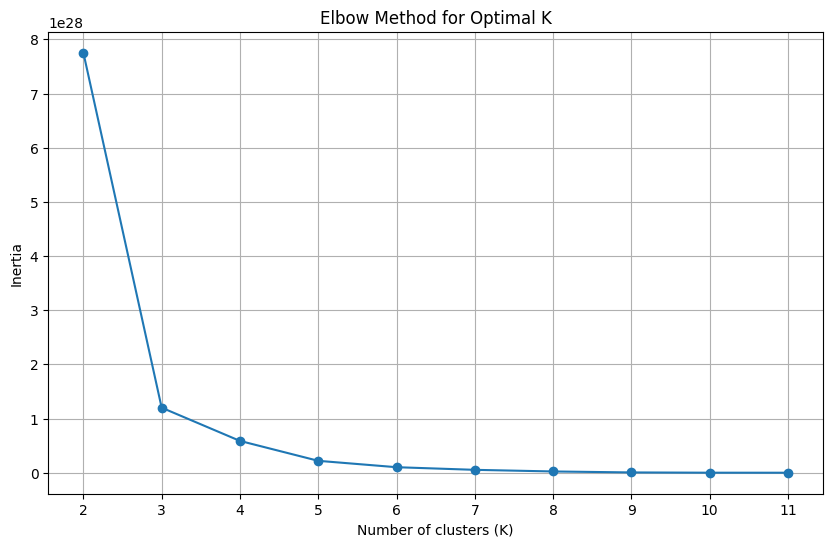

./elbow_test_export/SS-N_csv_50_83686_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         0            0          0.0       13    0.4   
1            0       0         1            0          1.0        3    0.6   
2            0       0         1            0          0.7       17    0.8   
3            0       0         0            1          1.7       20    0.0   
4            0       1         1            1          1.2       12    0.9   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       0         1            1          1.0        3    0.6   
946          0       0         0            1          0.7       17    0.8   
947          0       0         1            0          1.4       17    0.4   
948          1       0         0            0          0.7       17    0.4   
949          0       1         0            0          0.7        9   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (10) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

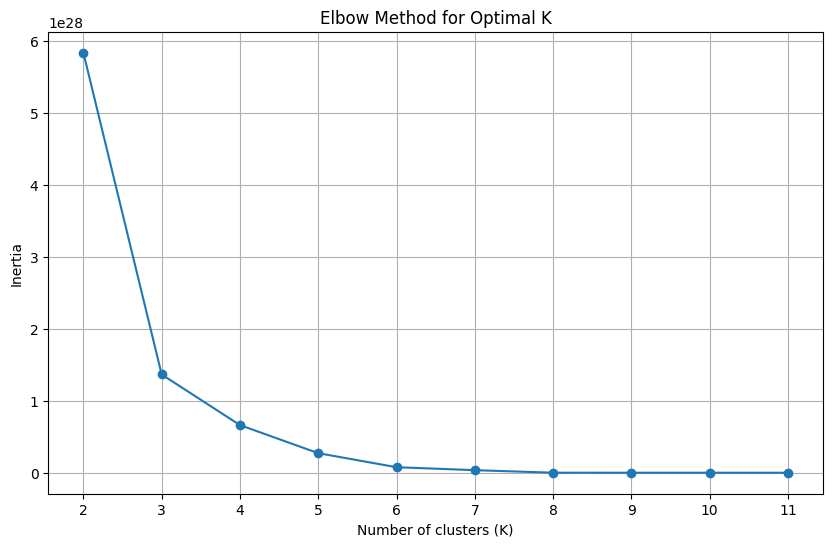

./elbow_test_export/SS-N_csv_50_84967_elbow_test.png
Optimal k value: 4
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            0       0         1            0          0.7        9    0.4   
1            0       0         0            1          0.7        9    0.8   
2            0       0         1            0          0.7        6    1.1   
3            0       0         1            0          0.7        9    0.8   
4            0       0         1            0          1.4       17    0.8   
..         ...     ...       ...          ...          ...      ...    ...   
945          1       0         0            0          0.7        9    0.4   
946          0       0         0            0          0.6       12    0.4   
947          0       0         1            0          1.4        9    0.4   
948          0       0         1            0          1.0        3    0.6   
949          0       0         1            0          0.7       17   

<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (8) found smaller than n_clusters (10). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])
<ipython-input-6-d113c8b26f53>:7: ConvergenceWarning: Number of distinct clusters (9) found smaller than n_clusters (11). Possibly due to duplicate points in X.
  kmeans.fit(df[xColumns])


<Figure size 640x480 with 0 Axes>

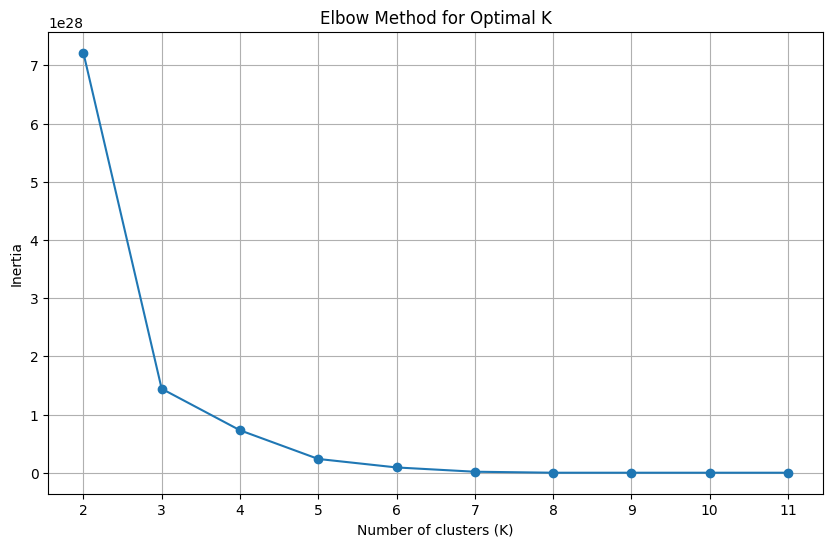

./elbow_test_export/SS-N_csv_50_86331_elbow_test.png
Optimal k value: 3
     No_mbtree  No_asm  No_cabac  No_scenecut  Aq_strength  Bframes  Qcomp  \
0            1       0         0            0          0.7       17    0.8   
1            0       1         0            0          0.7       17    0.8   
2            1       0         0            0          0.7        9    0.8   
3            0       1         0            0          0.5       13    0.3   
4            0       0         0            0          0.7        9    0.4   
..         ...     ...       ...          ...          ...      ...    ...   
945          0       1         0            0          1.0        3    0.6   
946          0       0         1            0          0.7       17    0.4   
947          0       1         0            0          0.7       17    0.4   
948          1       0         0            0          1.4        9    0.4   
949          0       0         0            0          1.4        9   

<Figure size 640x480 with 0 Axes>

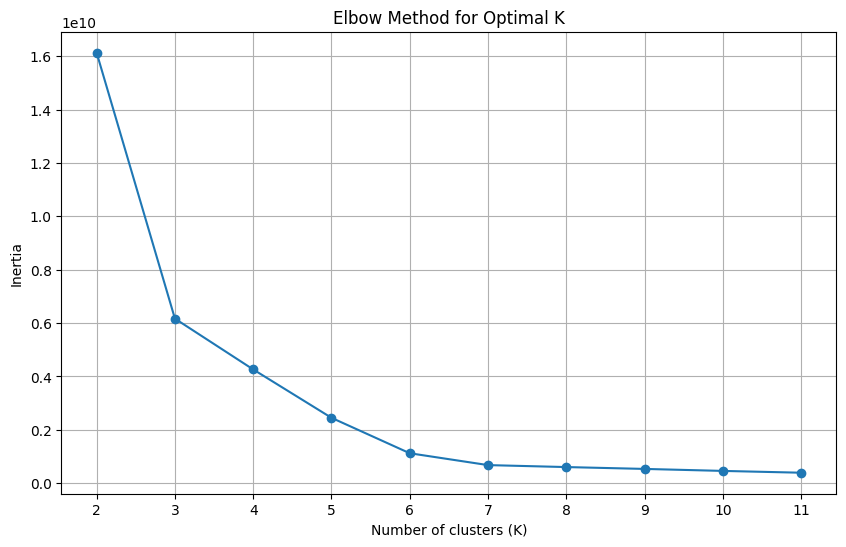

./elbow_test_export/SS-O_csv_100_11514_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        1                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        1                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

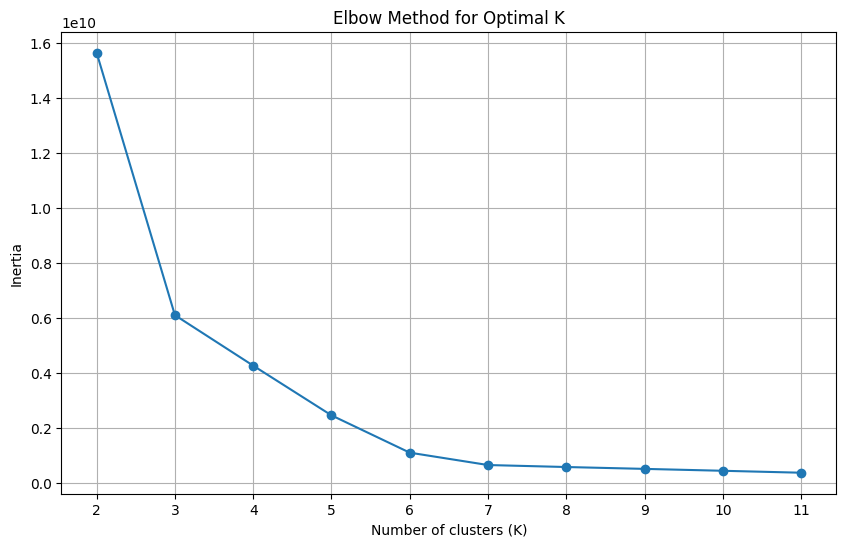

./elbow_test_export/SS-O_csv_100_19953_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   1    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

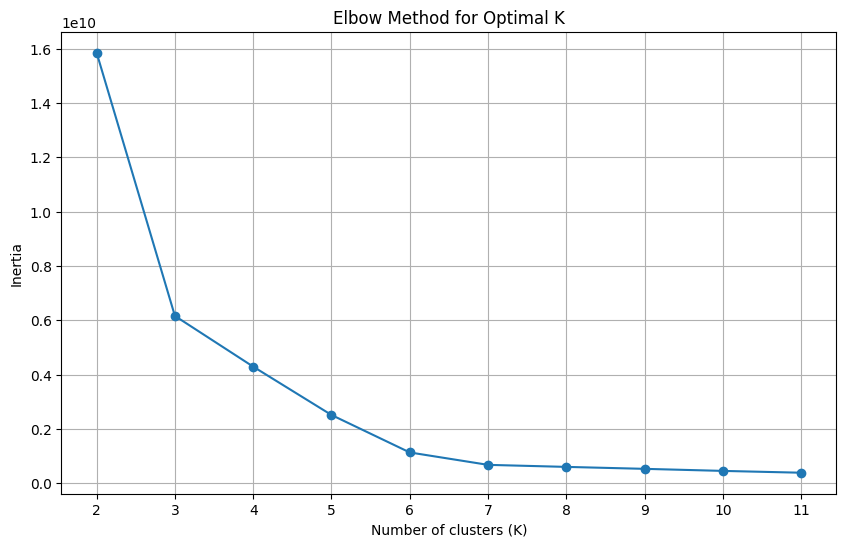

./elbow_test_export/SS-O_csv_100_3545_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        1                     1                      1   1    1   1    1   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1             

<Figure size 640x480 with 0 Axes>

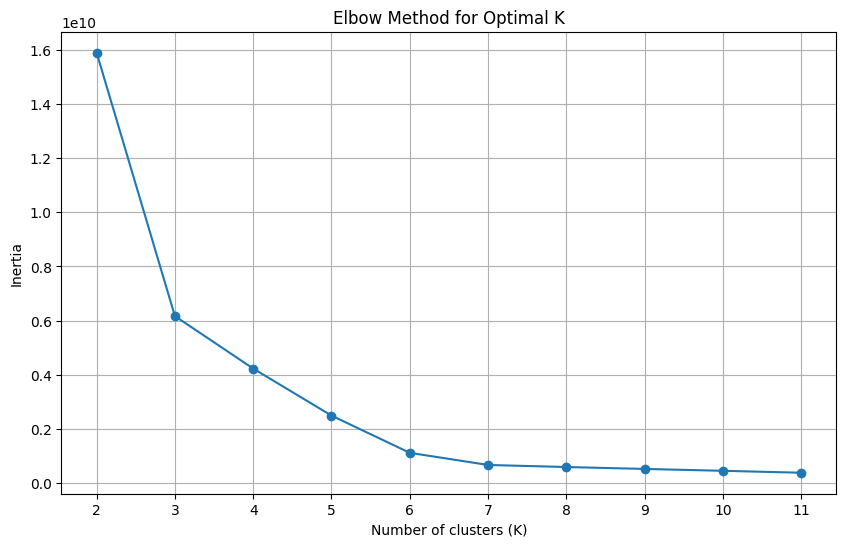

./elbow_test_export/SS-O_csv_100_39658_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    1   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

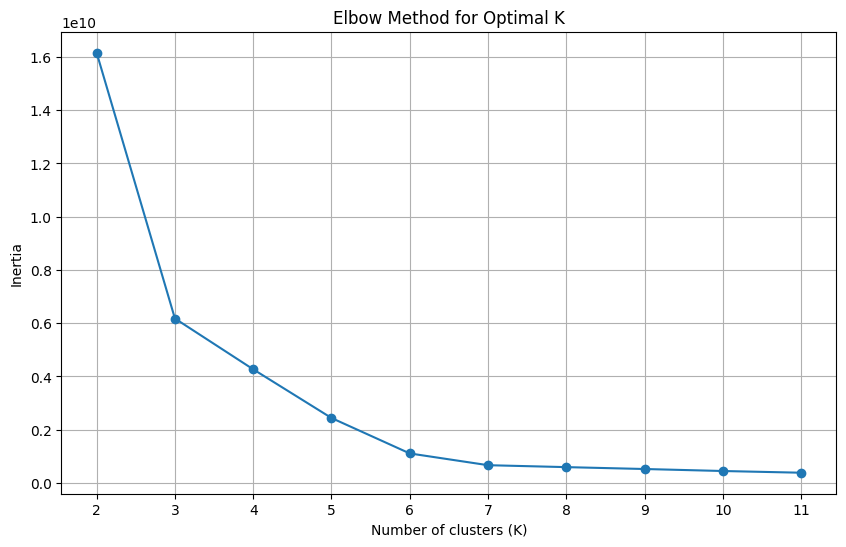

./elbow_test_export/SS-O_csv_100_40749_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           1                     1                      1   1    1   1    1   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   1    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   1    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

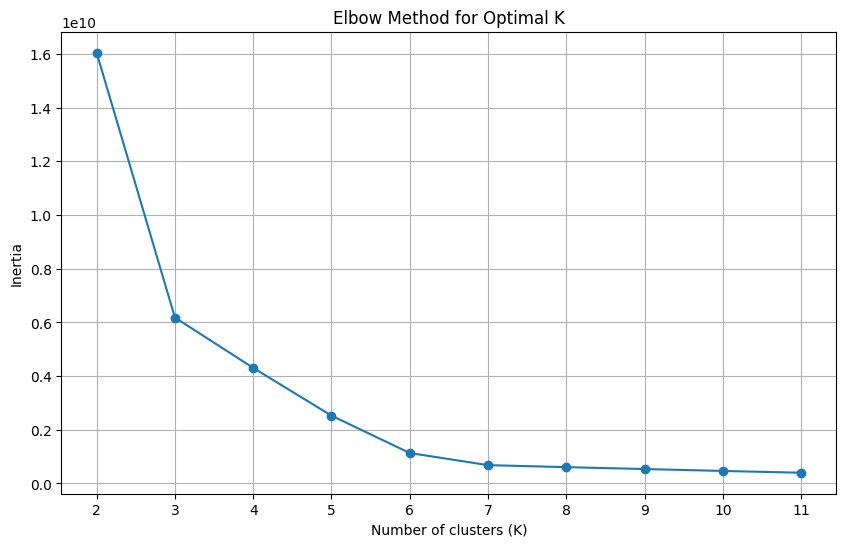

./elbow_test_export/SS-O_csv_100_44845_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        1                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

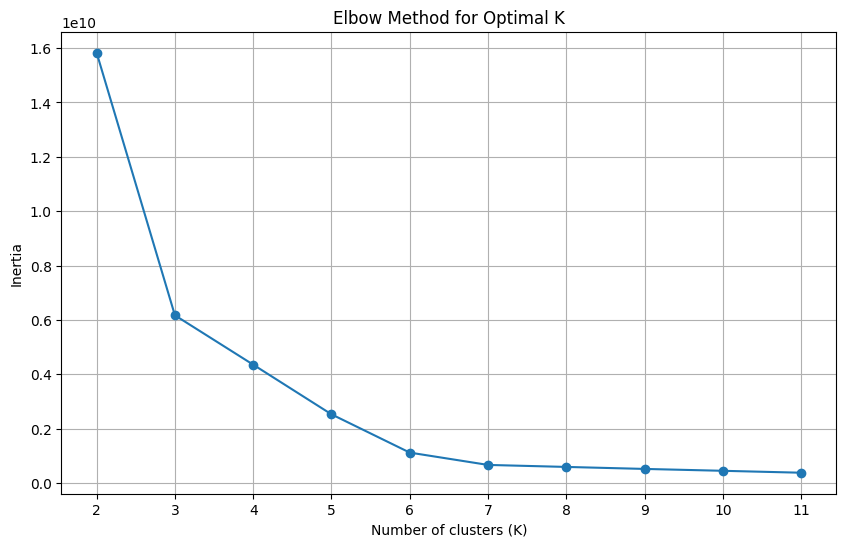

./elbow_test_export/SS-O_csv_100_51176_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    1   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        1                     1            

<Figure size 640x480 with 0 Axes>

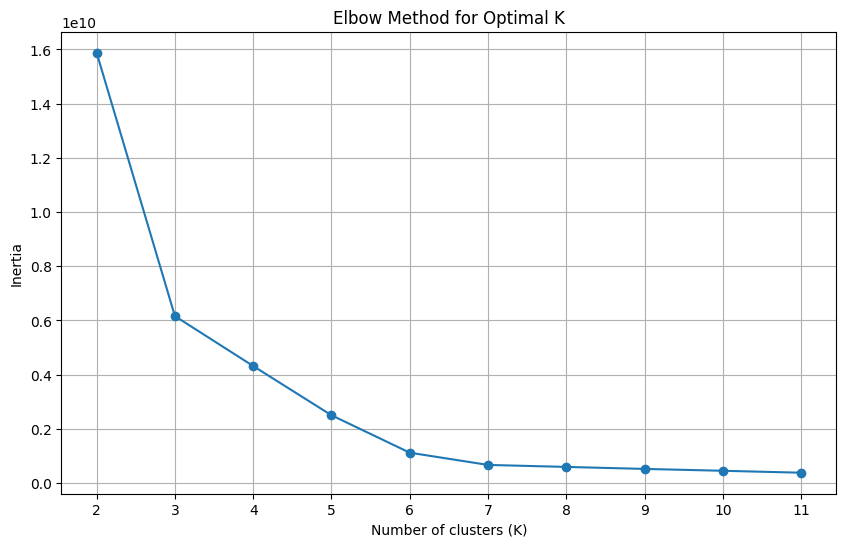

./elbow_test_export/SS-O_csv_100_58612_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   1    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    1   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

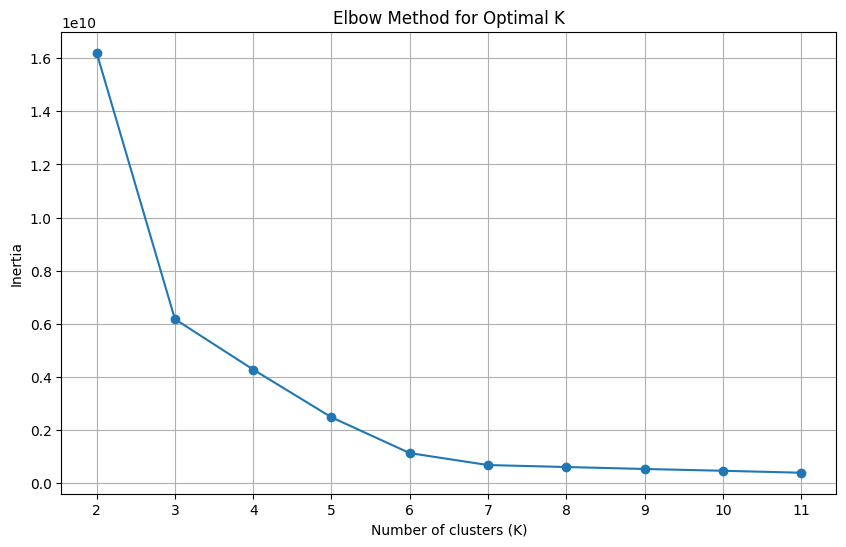

./elbow_test_export/SS-O_csv_100_61367_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           1                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        1                     1                      1   0    0   0    0   
6098        1                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

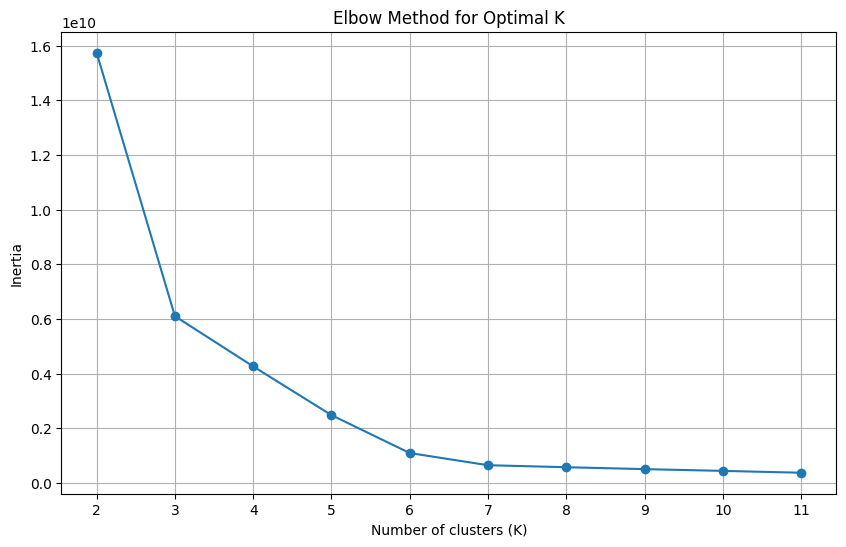

./elbow_test_export/SS-O_csv_100_65388_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   1    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

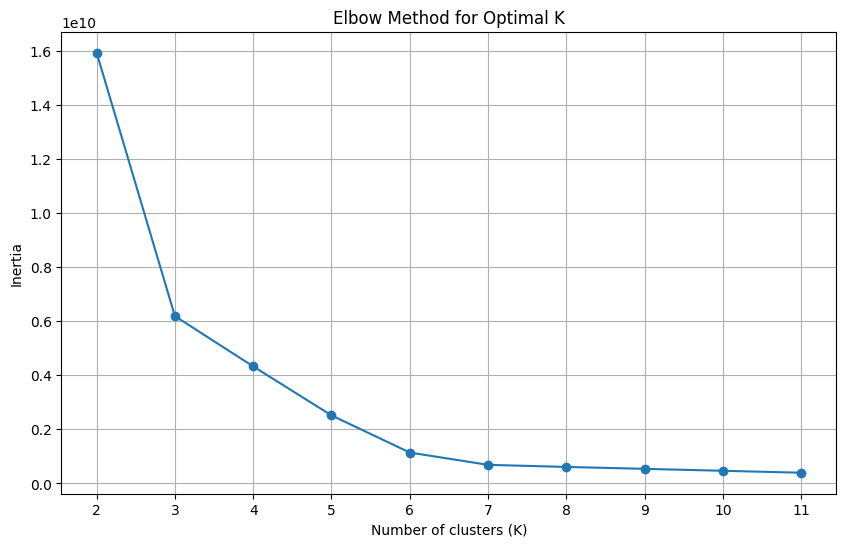

./elbow_test_export/SS-O_csv_100_65444_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        1                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    1   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

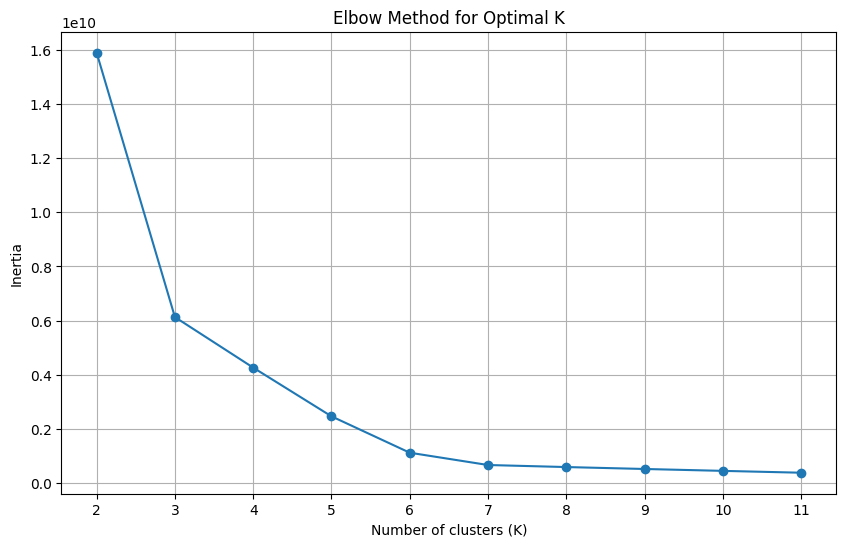

./elbow_test_export/SS-O_csv_100_66946_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    1   0    0   
3           1                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    1   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

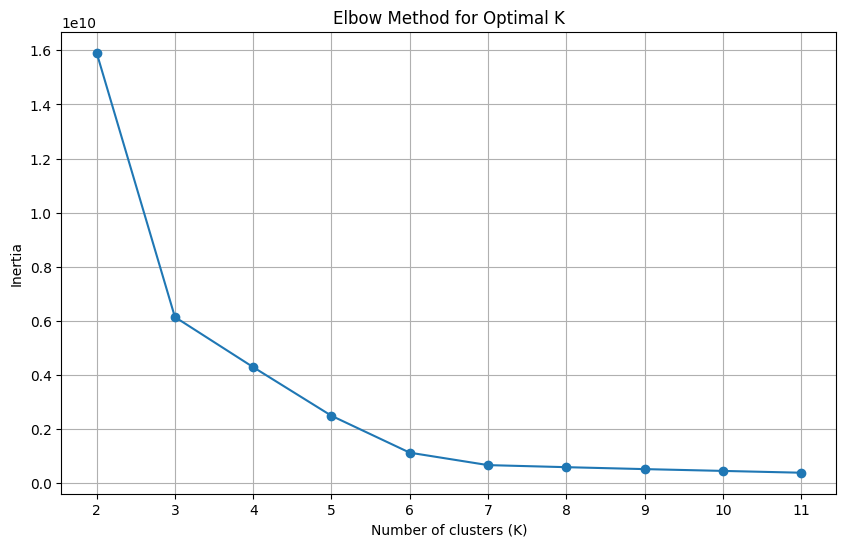

./elbow_test_export/SS-O_csv_100_69024_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    1   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

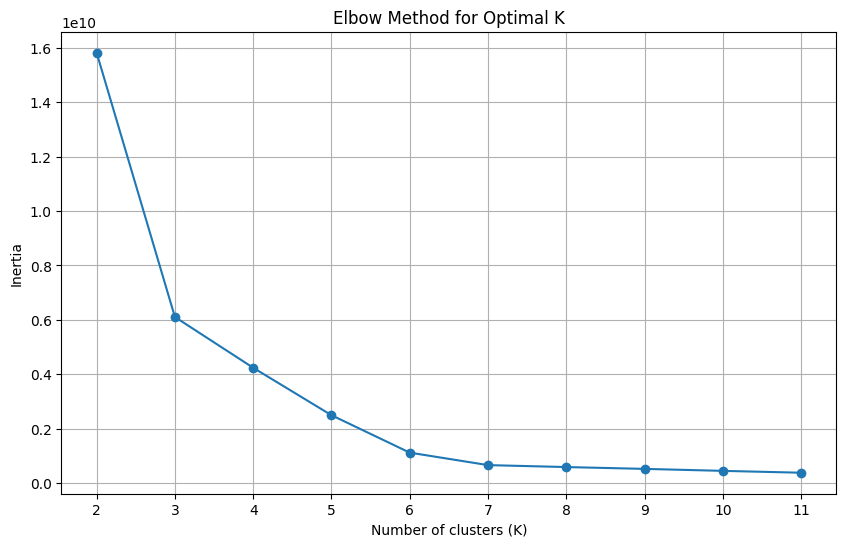

./elbow_test_export/SS-O_csv_100_70006_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           1                     1                      1   1    1   1    1   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    1   0    0   
6096        0                     1                      1   0    0   0    0   
6097        1                     1                      1   0    0   0    0   
6098        1                     1                      1   1    1   1    1   
6099        1                     1            

<Figure size 640x480 with 0 Axes>

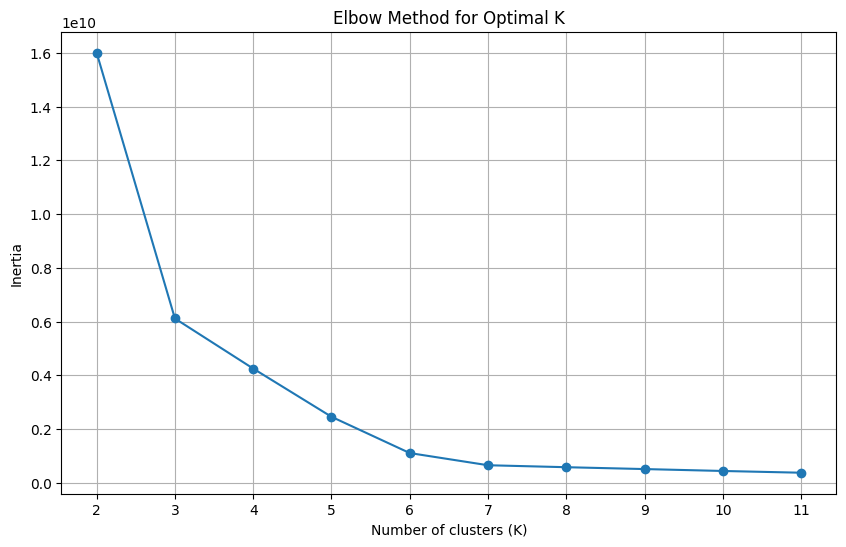

./elbow_test_export/SS-O_csv_100_70292_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     0                      0   0    0   0    0   
1           0                     1                      1   1    0   0    0   
2           1                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

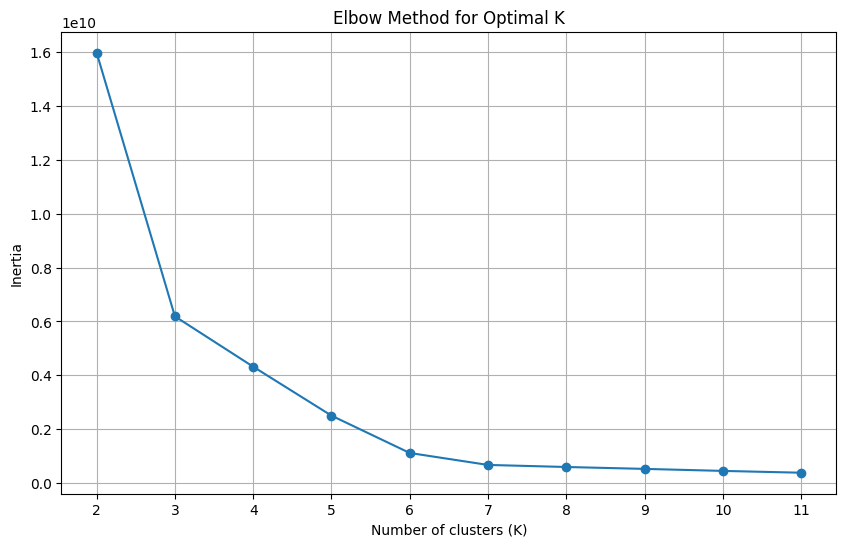

./elbow_test_export/SS-O_csv_100_77340_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           1                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           1                     1                      1   1    1   1    1   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        1                     1                      1   1    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

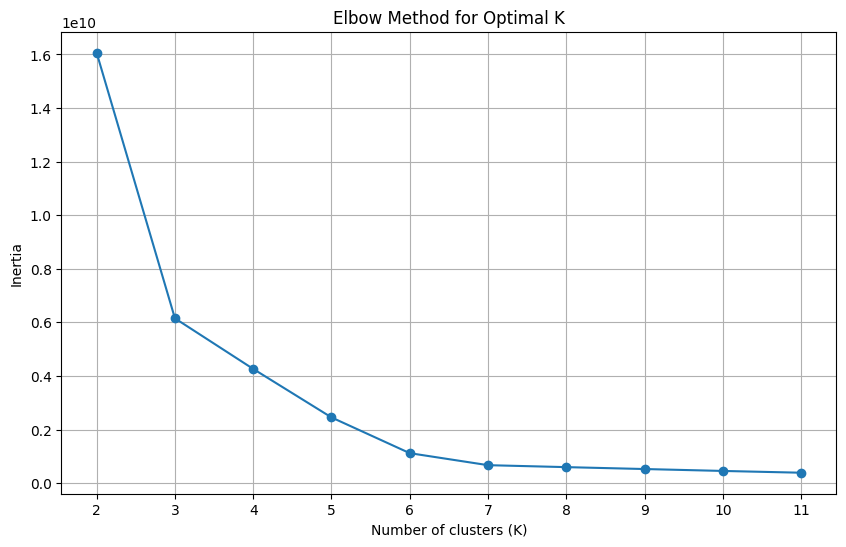

./elbow_test_export/SS-O_csv_100_77845_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   1    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

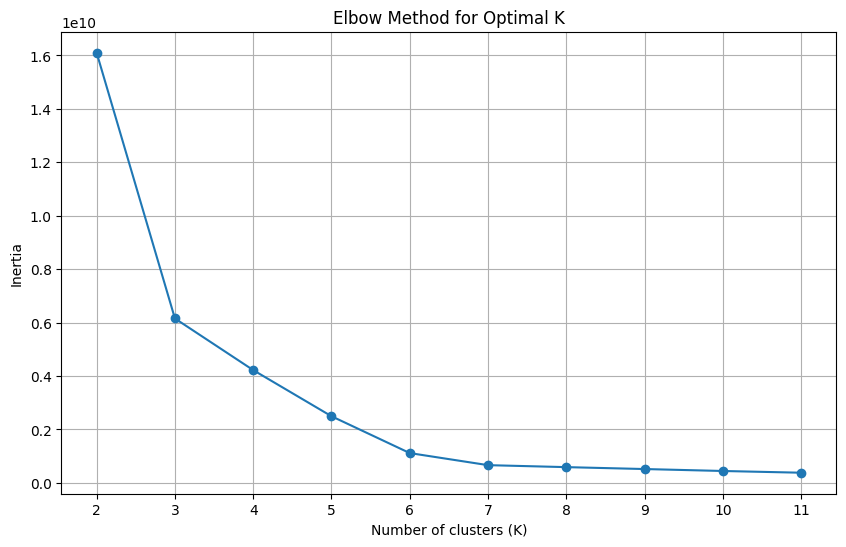

./elbow_test_export/SS-O_csv_100_83686_elbow_test.png
Optimal k value: 4
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    1   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    1   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

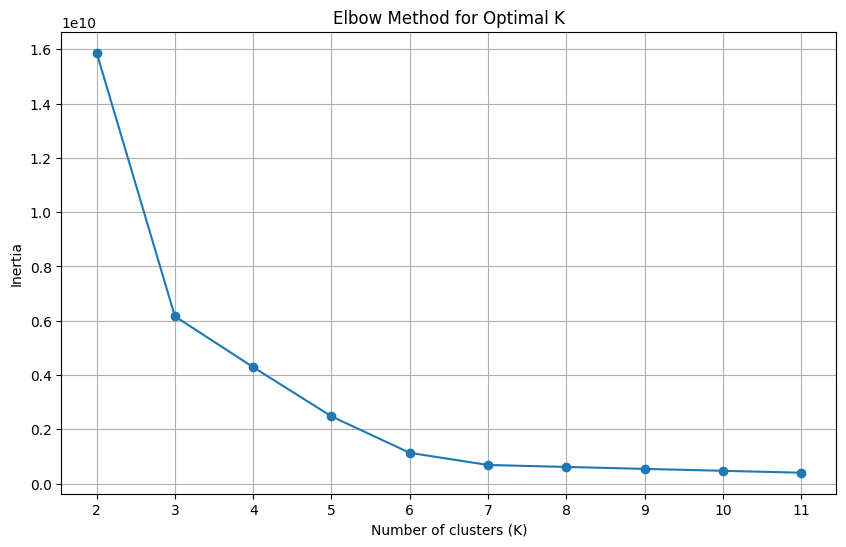

./elbow_test_export/SS-O_csv_100_84967_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    1   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    0   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   1    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

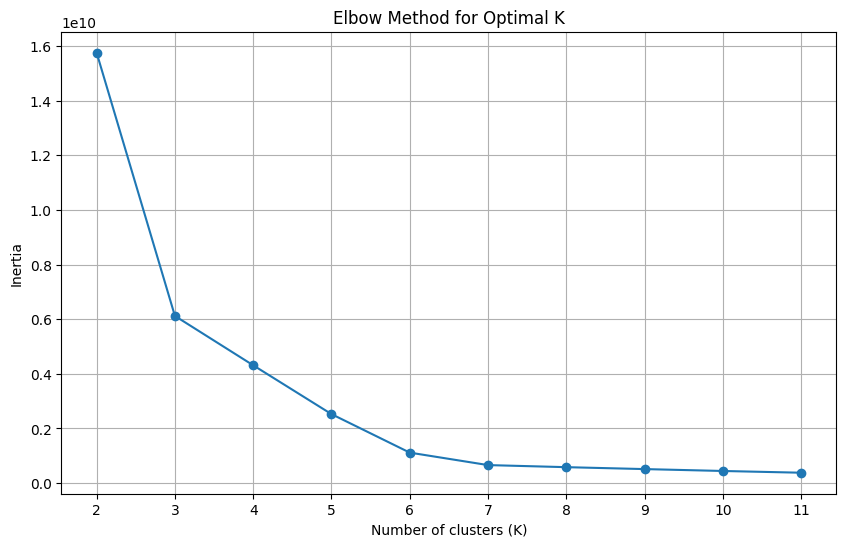

./elbow_test_export/SS-O_csv_100_86331_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    1   
1           1                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
6095        0                     1                      1   0    0   0    1   
6096        0                     1                      1   0    0   0    0   
6097        0                     1                      1   0    0   0    0   
6098        0                     1                      1   0    0   0    0   
6099        0                     1            

<Figure size 640x480 with 0 Axes>

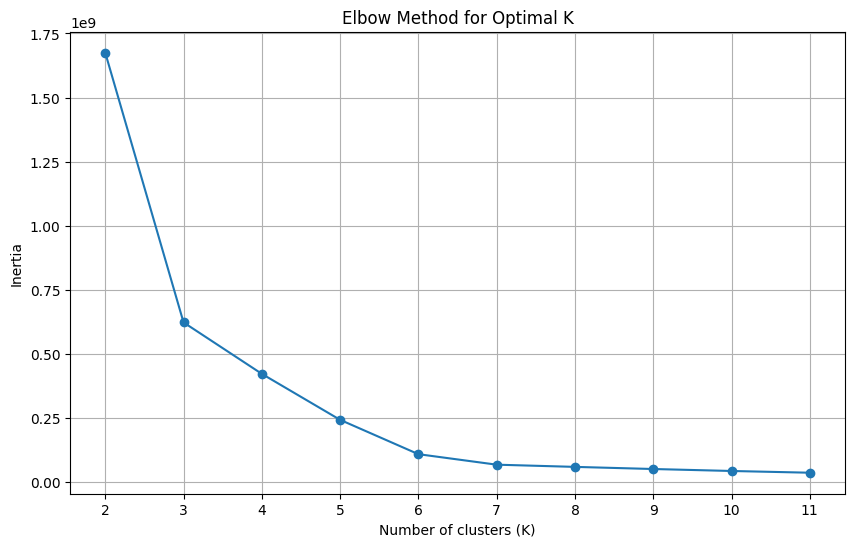

./elbow_test_export/SS-O_csv_10_11514_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

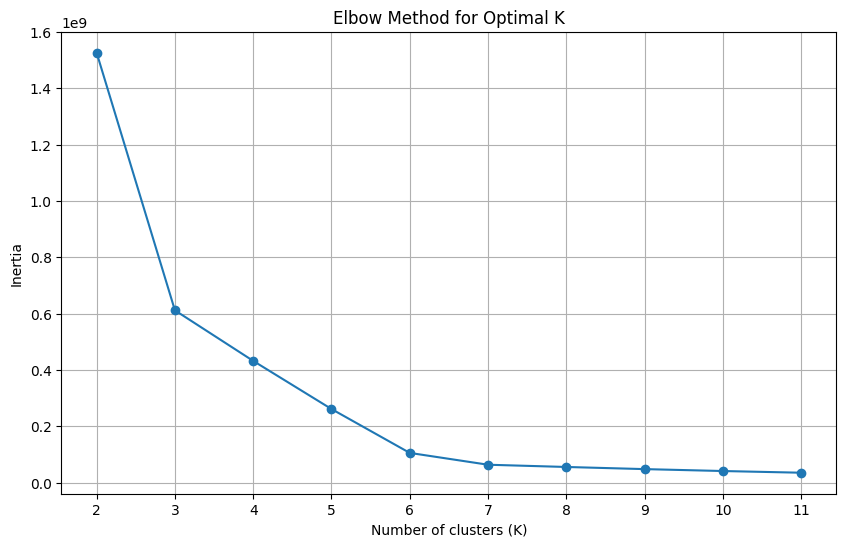

./elbow_test_export/SS-O_csv_10_19953_elbow_test.png
Optimal k value: 5
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   1    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    1   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

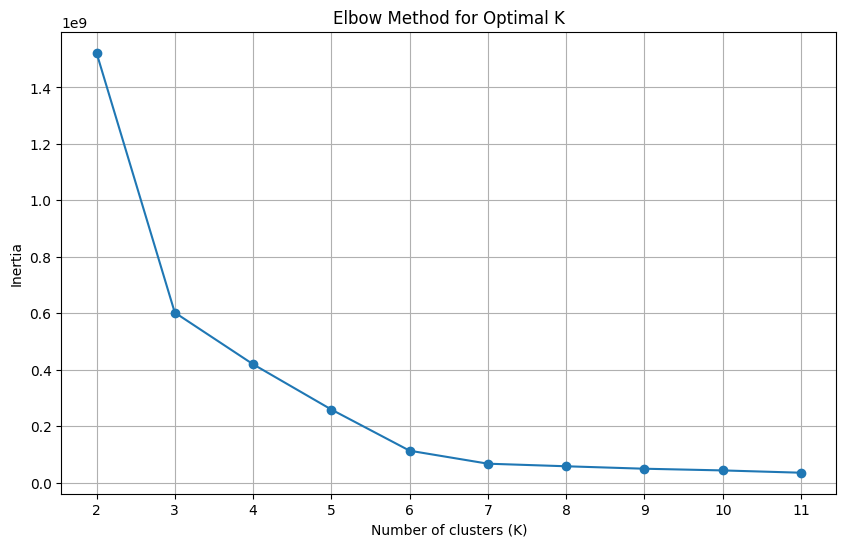

./elbow_test_export/SS-O_csv_10_3545_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1   

<Figure size 640x480 with 0 Axes>

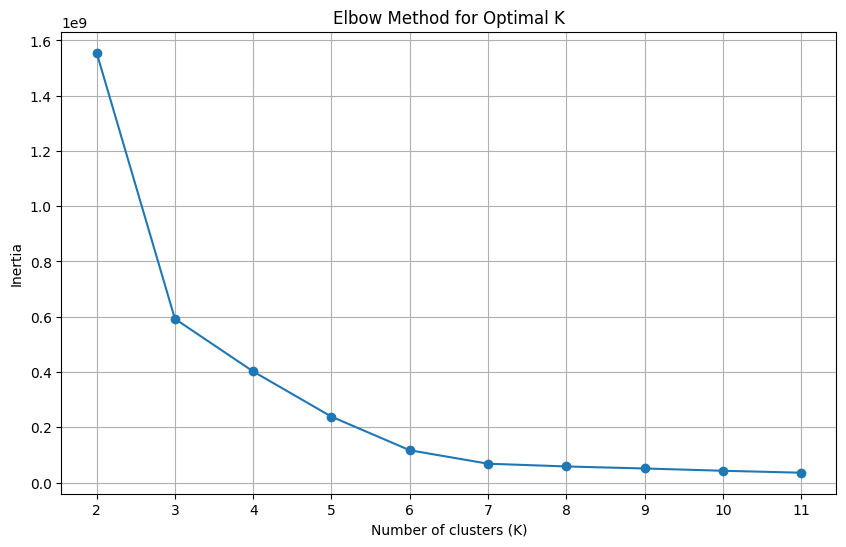

./elbow_test_export/SS-O_csv_10_39658_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    1   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   1    0   
606        0                     1                      1   0    0   0    0   
607        1                     1                      1   1    1   1    1   
608        0                     1                      1   0    0   0    1   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

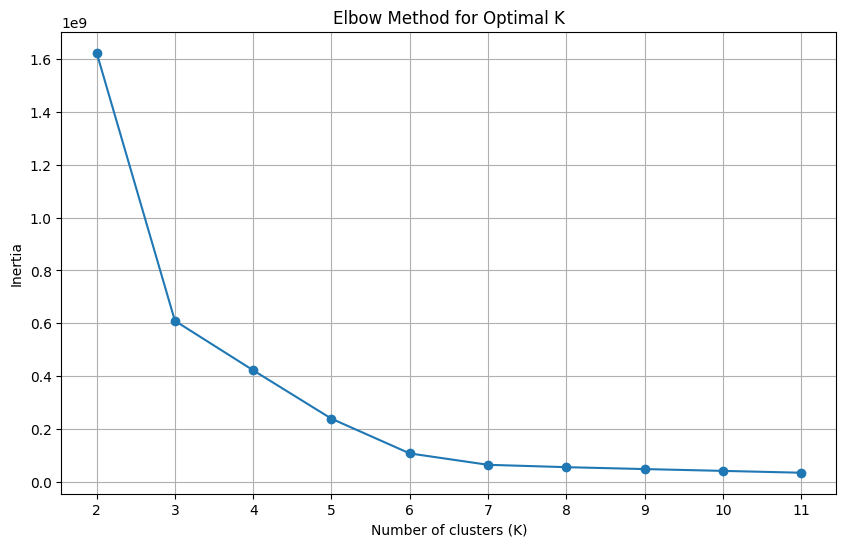

./elbow_test_export/SS-O_csv_10_40749_elbow_test.png
Optimal k value: 5
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          1                     1                      1   1    1   1    1   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

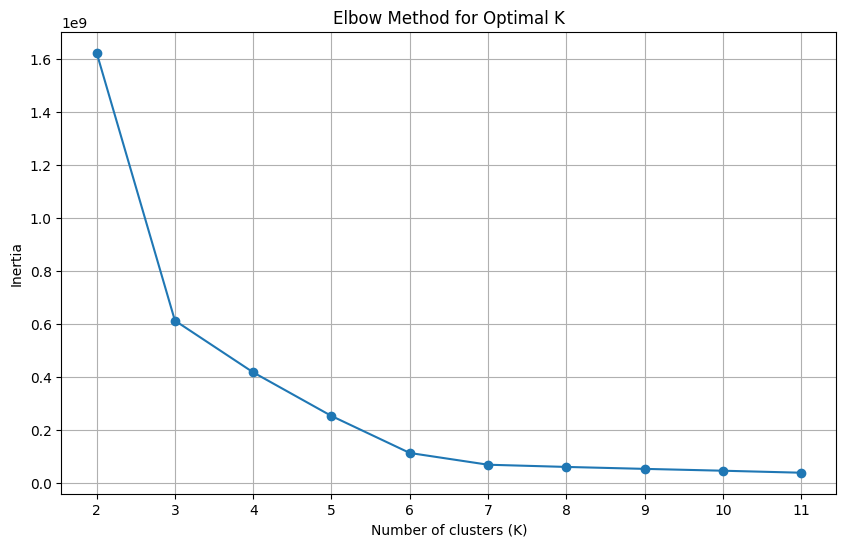

./elbow_test_export/SS-O_csv_10_44845_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     0                      0   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

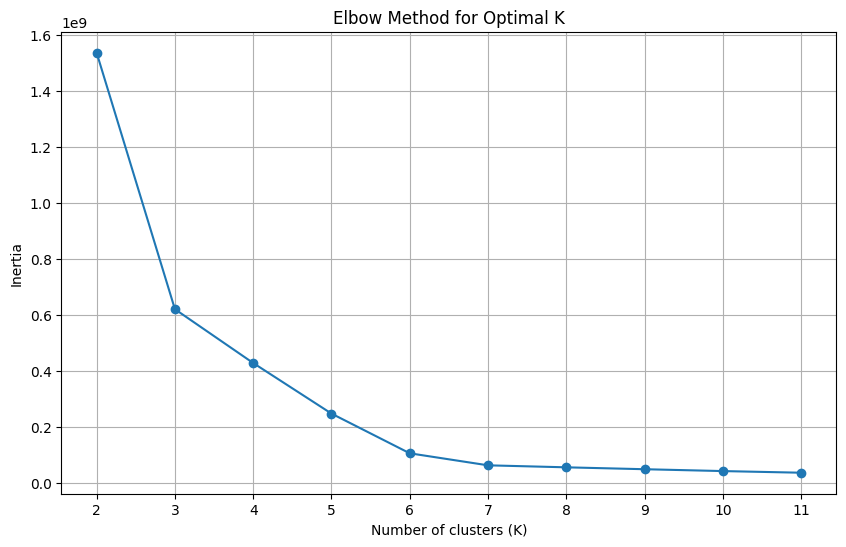

./elbow_test_export/SS-O_csv_10_51176_elbow_test.png
Optimal k value: 5
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    1   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   1    1   
608        0                     1                      1   0    0   0    0   
609        1                     1                      1  

<Figure size 640x480 with 0 Axes>

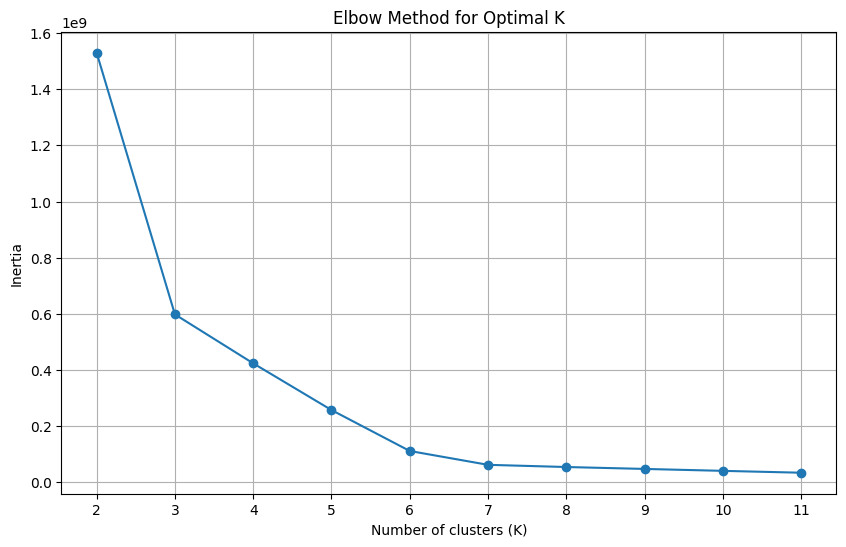

./elbow_test_export/SS-O_csv_10_58612_elbow_test.png
Optimal k value: 5
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   1    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    1   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    1   0    0   
606        1                     1                      1   1    1   1    1   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

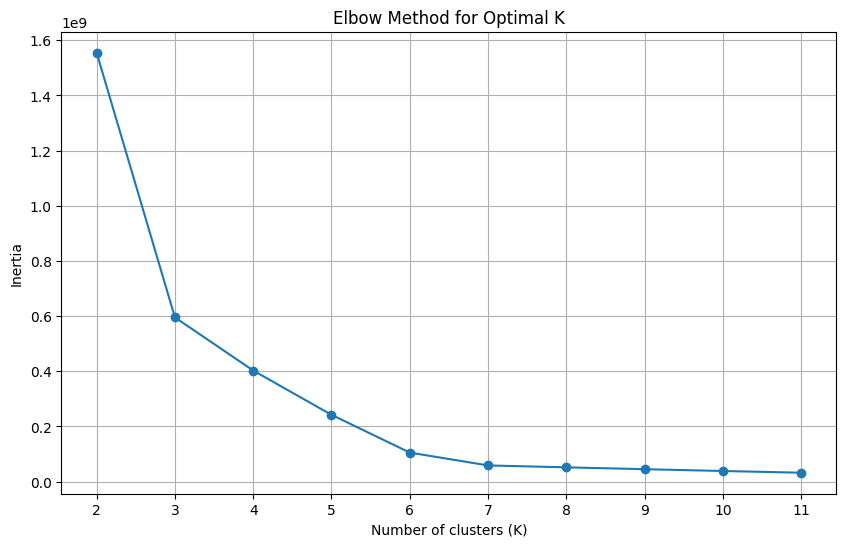

./elbow_test_export/SS-O_csv_10_61367_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          1                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        1                     1                      1   1    1   1    1   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

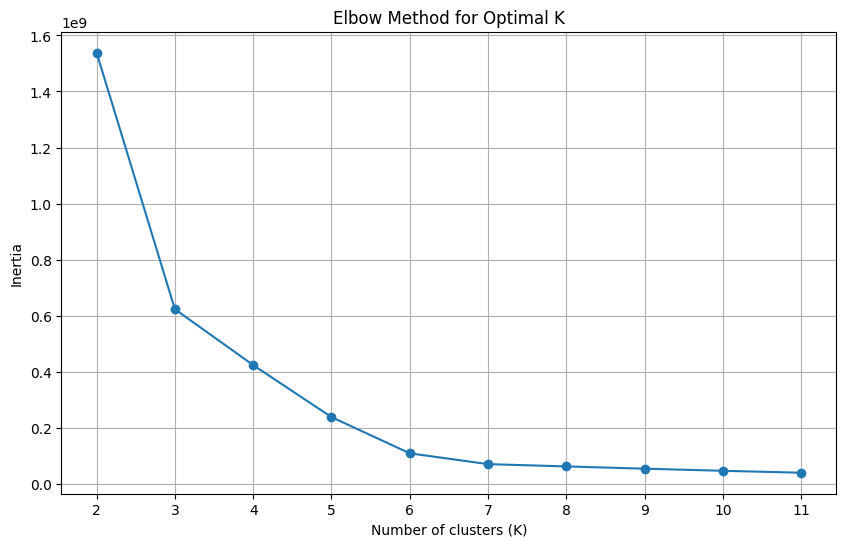

./elbow_test_export/SS-O_csv_10_65388_elbow_test.png
Optimal k value: 5
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   1    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

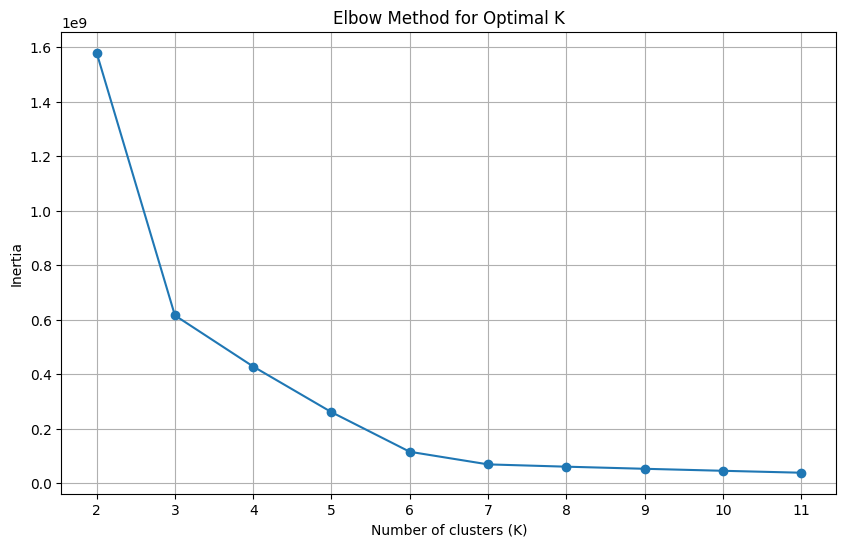

./elbow_test_export/SS-O_csv_10_65444_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   1    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    1   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

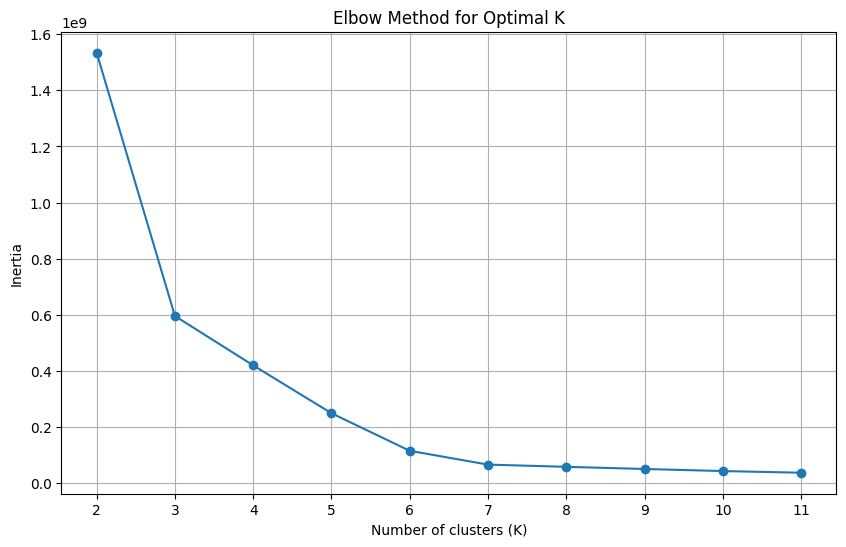

./elbow_test_export/SS-O_csv_10_66946_elbow_test.png
Optimal k value: 5
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    1   0    0   
3          1                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    1   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

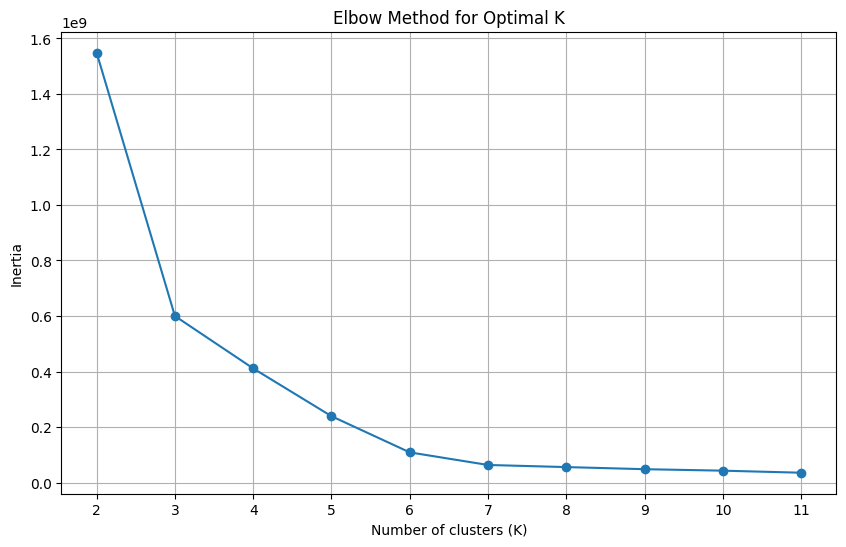

./elbow_test_export/SS-O_csv_10_69024_elbow_test.png
Optimal k value: 5
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    1   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   1    0   
607        1                     1                      1   1    1   1    1   
608        1                     1                      1   1    1   1    1   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

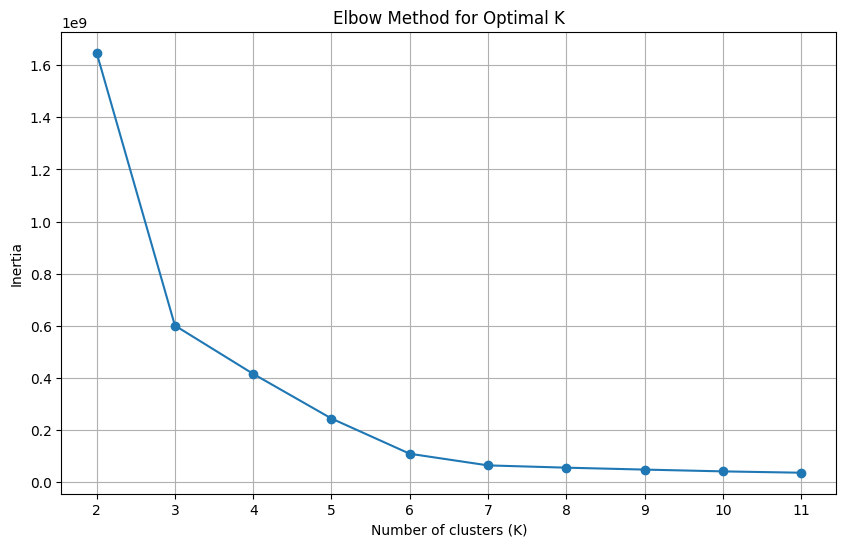

./elbow_test_export/SS-O_csv_10_70006_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          1                     1                      1   1    1   1    1   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    1   
608        1                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

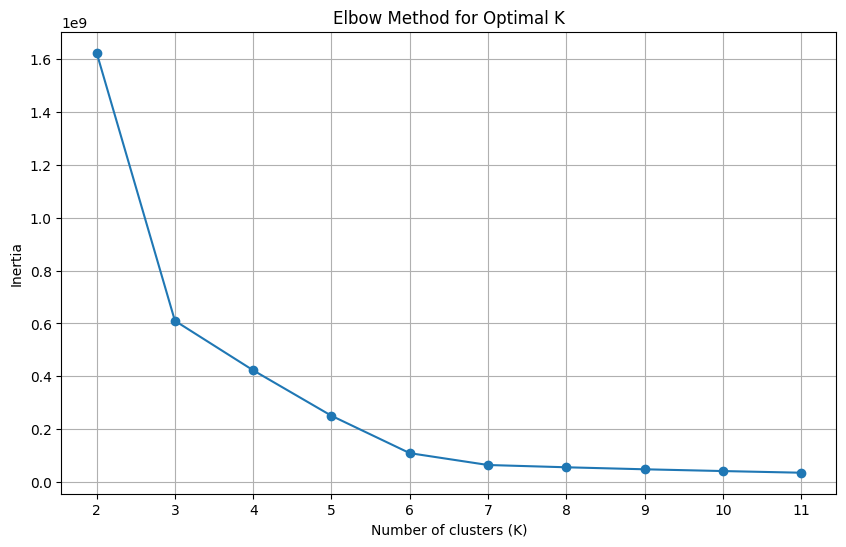

./elbow_test_export/SS-O_csv_10_70292_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     0                      0   0    0   0    0   
1          0                     1                      1   1    0   0    0   
2          1                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   1    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

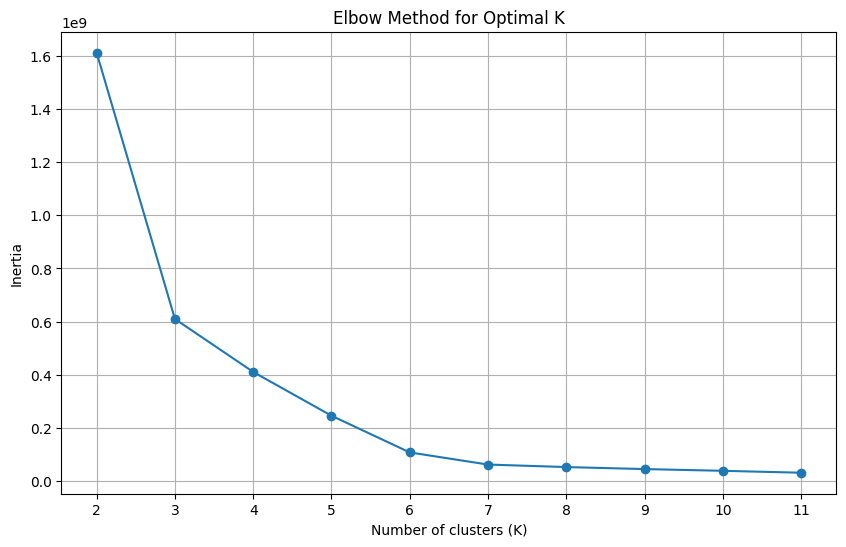

./elbow_test_export/SS-O_csv_10_77340_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          1                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          1                     1                      1   1    1   1    1   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        1                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        1                     1                      1  

<Figure size 640x480 with 0 Axes>

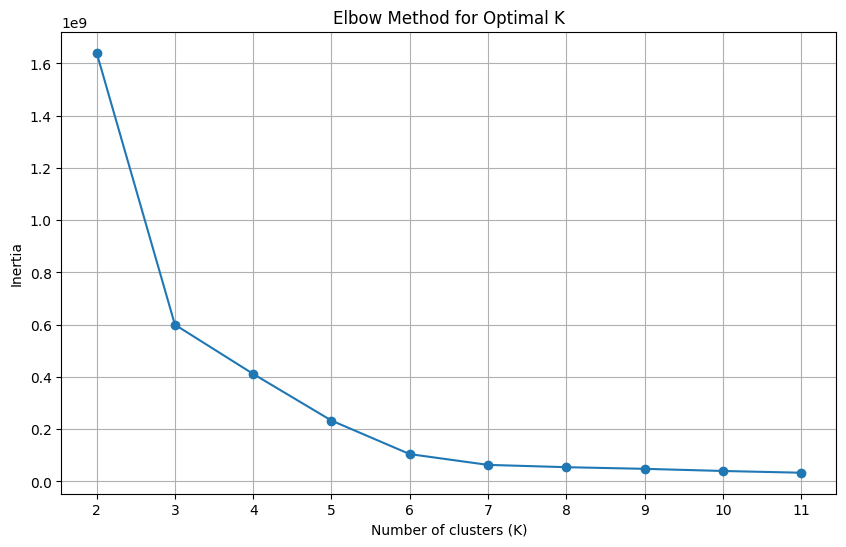

./elbow_test_export/SS-O_csv_10_77845_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   1    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

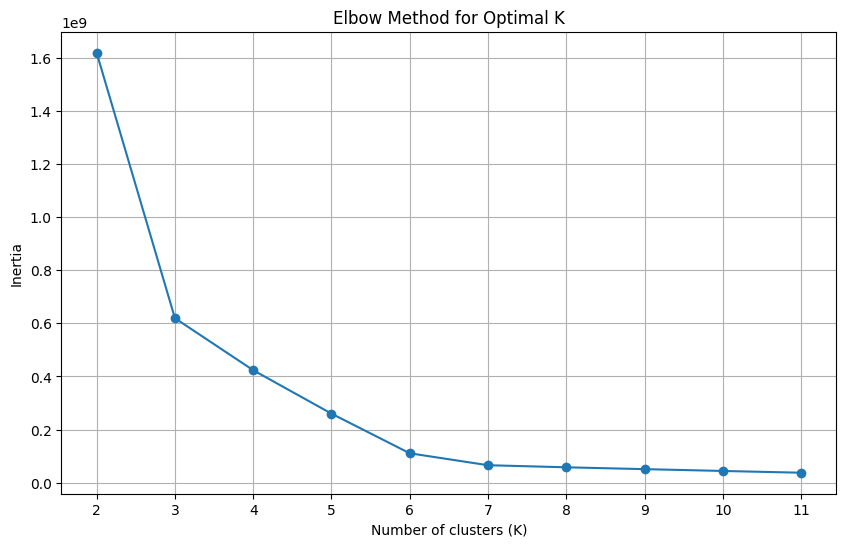

./elbow_test_export/SS-O_csv_10_83686_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    1   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   1    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

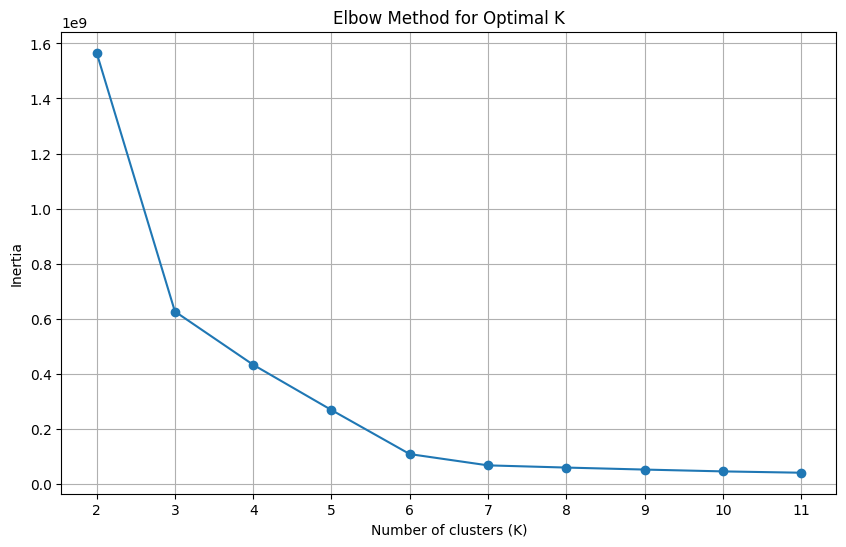

./elbow_test_export/SS-O_csv_10_84967_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    0   
1          0                     1                      1   0    0   0    0   
2          0                     1                      1   0    1   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        0                     1                      1   0    0   0    0   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    0   0    0   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

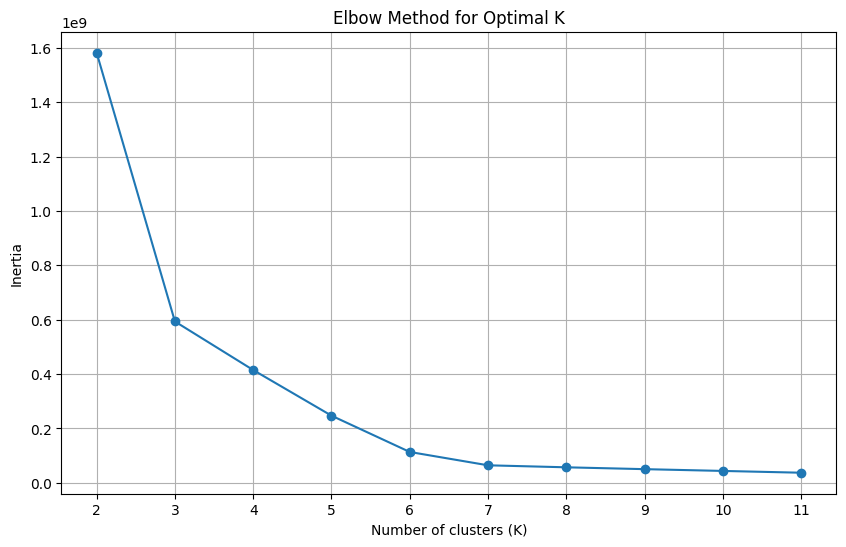

./elbow_test_export/SS-O_csv_10_86331_elbow_test.png
Optimal k value: 4
     Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0          0                     1                      1   0    0   0    1   
1          1                     1                      1   0    0   0    0   
2          0                     1                      1   0    0   0    0   
3          0                     1                      1   0    0   0    0   
4          0                     1                      1   0    0   0    0   
..       ...                   ...                    ...  ..  ...  ..  ...   
605        1                     1                      1   1    1   1    1   
606        0                     1                      1   0    0   0    0   
607        0                     1                      1   0    1   0    1   
608        0                     1                      1   0    0   0    0   
609        0                     1                      1  

<Figure size 640x480 with 0 Axes>

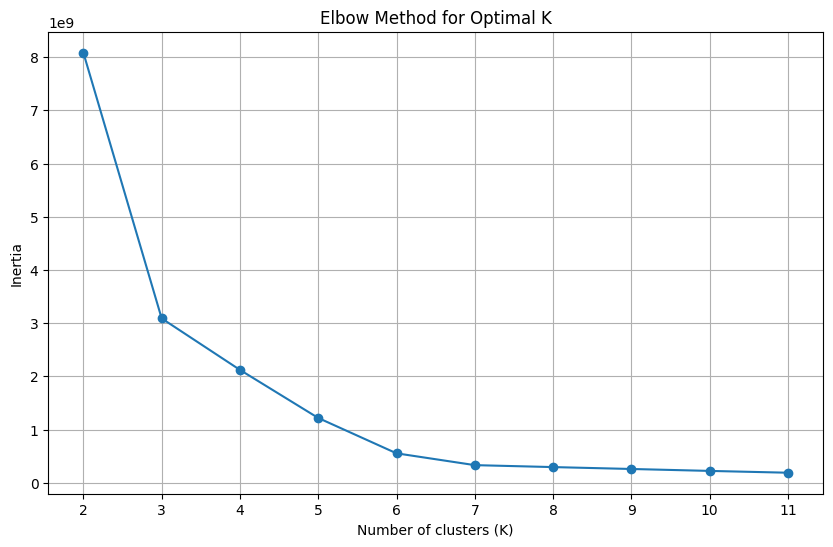

./elbow_test_export/SS-O_csv_50_11514_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        1                     1                      1   0    0   0    0   
3047        1                     1                      1   1    1   1    1   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

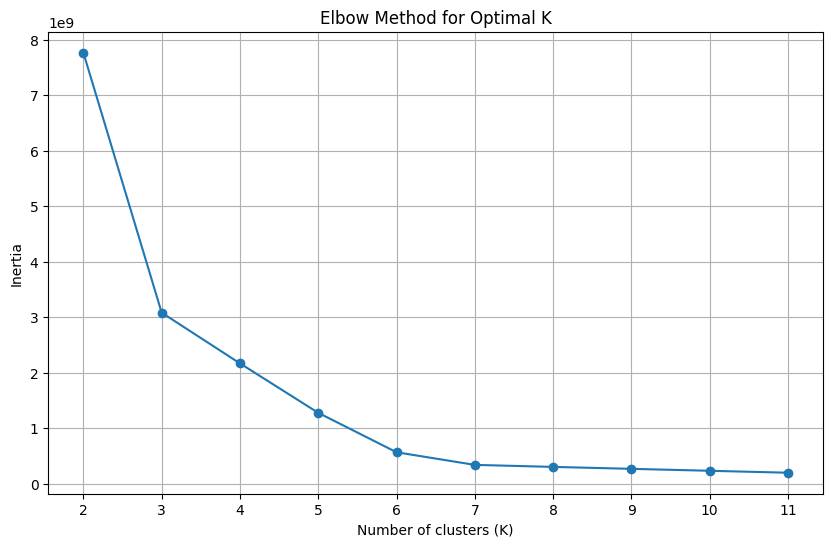

./elbow_test_export/SS-O_csv_50_19953_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   1    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   1    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

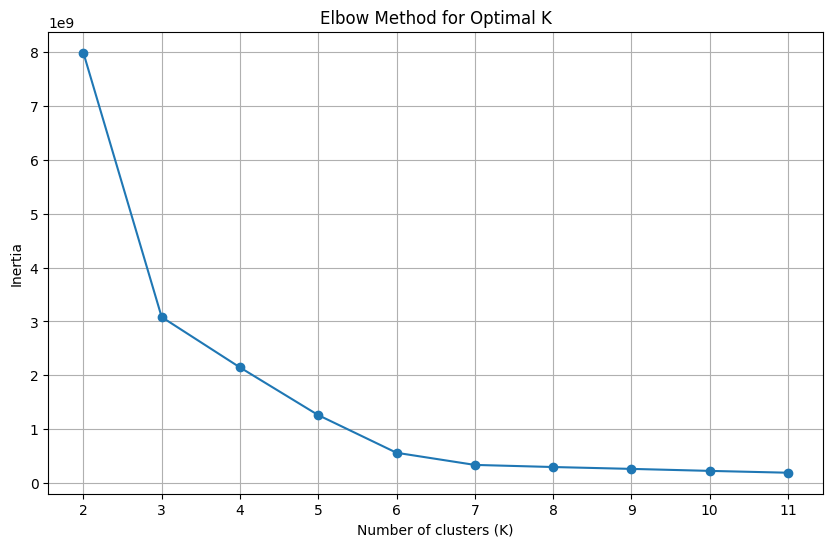

./elbow_test_export/SS-O_csv_50_3545_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   1    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        1                     1                      1   1    1   1    1   
3049        0                     1              

<Figure size 640x480 with 0 Axes>

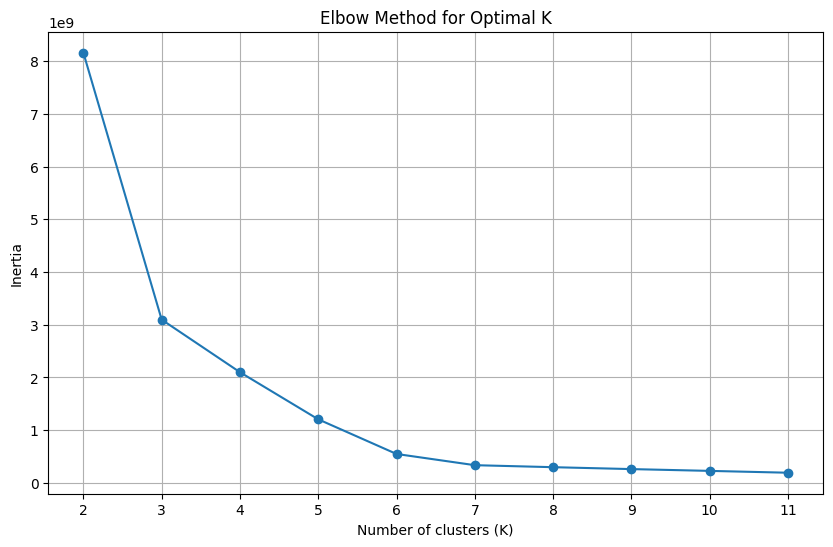

./elbow_test_export/SS-O_csv_50_39658_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    1   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

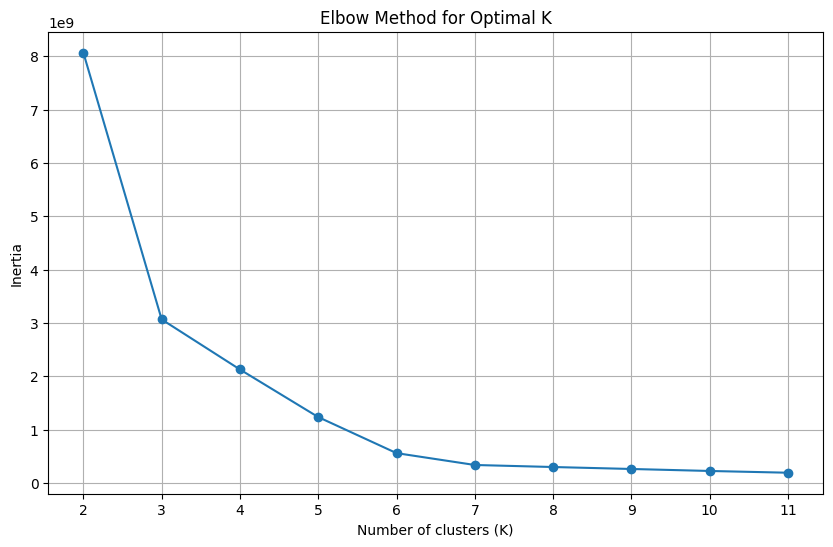

./elbow_test_export/SS-O_csv_50_40749_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           1                     1                      1   1    1   1    1   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   1    1   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

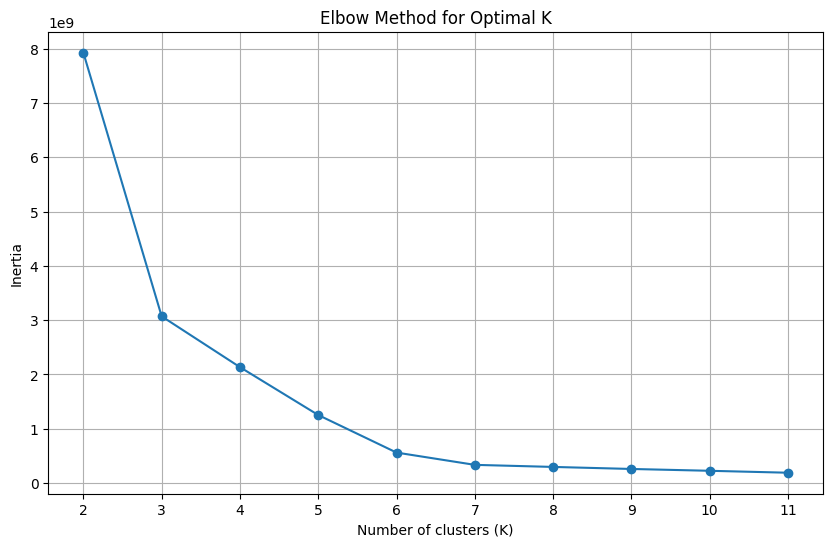

./elbow_test_export/SS-O_csv_50_44845_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    1   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

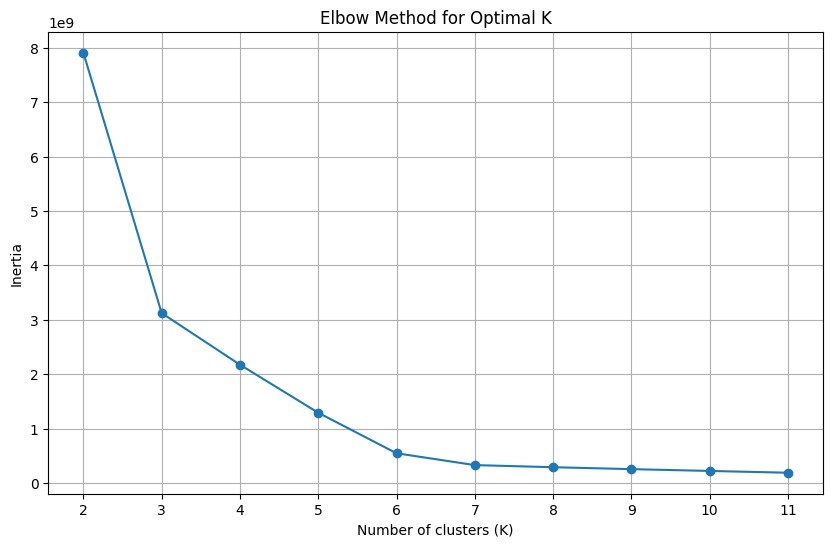

./elbow_test_export/SS-O_csv_50_51176_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    1   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        1                     1             

<Figure size 640x480 with 0 Axes>

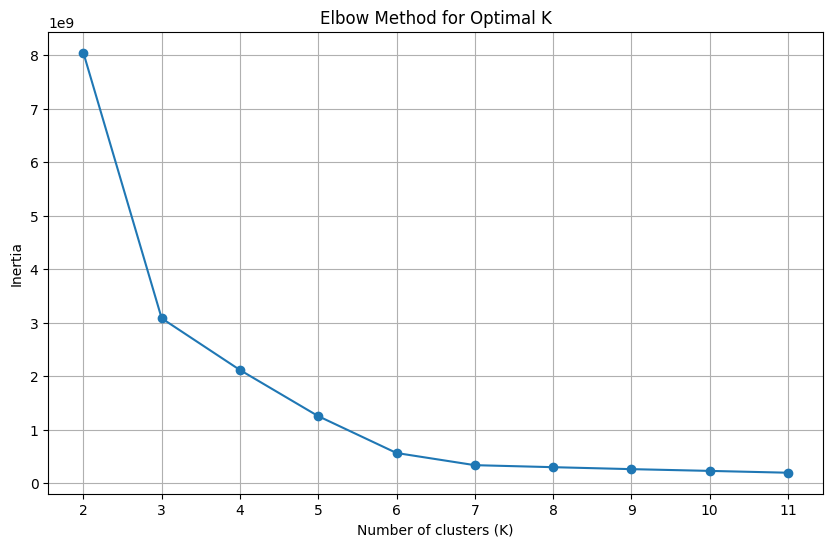

./elbow_test_export/SS-O_csv_50_58612_elbow_test.png
Optimal k value: 4
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   1    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    1   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

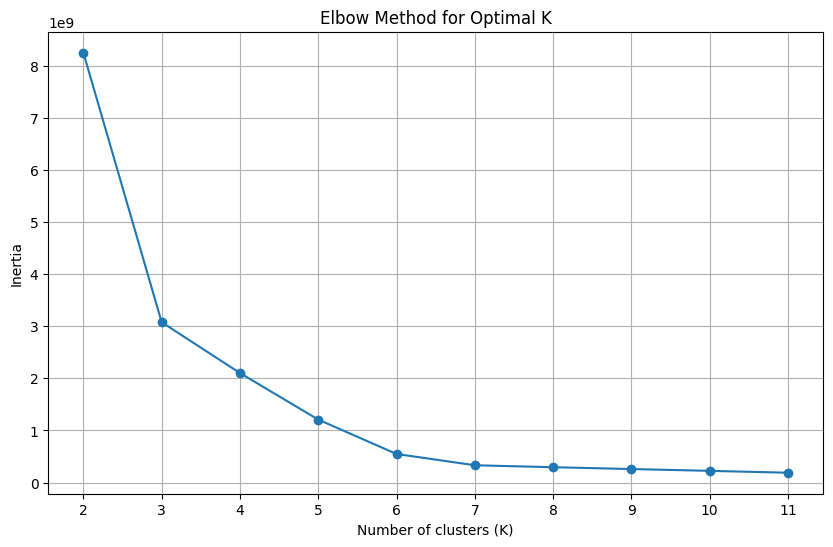

./elbow_test_export/SS-O_csv_50_61367_elbow_test.png
Optimal k value: 4
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           1                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        1                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

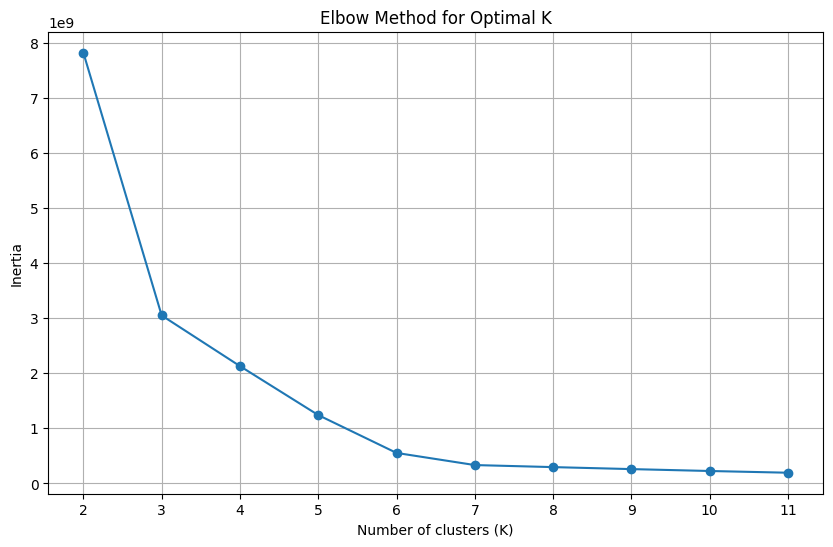

./elbow_test_export/SS-O_csv_50_65388_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

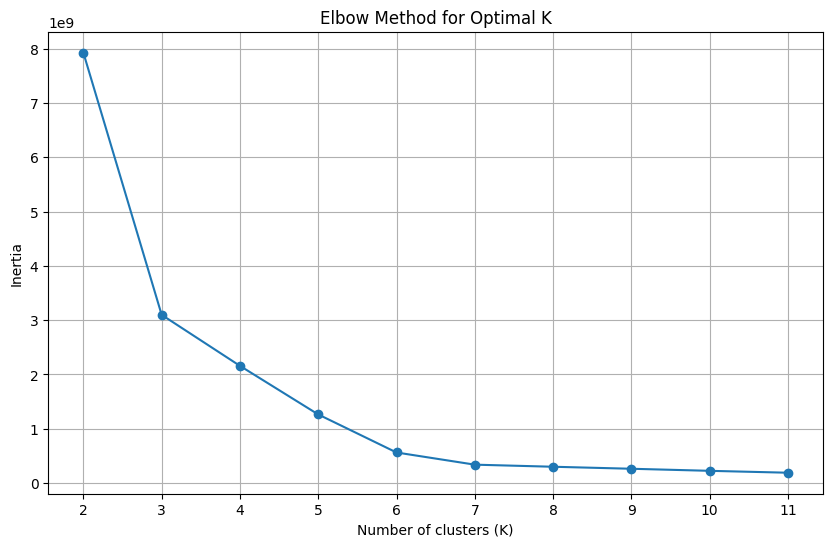

./elbow_test_export/SS-O_csv_50_65444_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   1    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   1    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

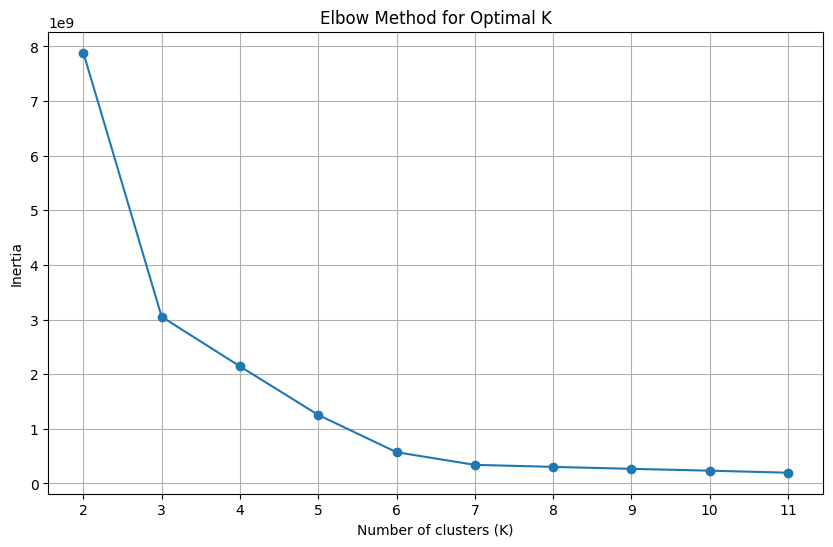

./elbow_test_export/SS-O_csv_50_66946_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    1   0    0   
3           1                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    1   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    1   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        1                     1             

<Figure size 640x480 with 0 Axes>

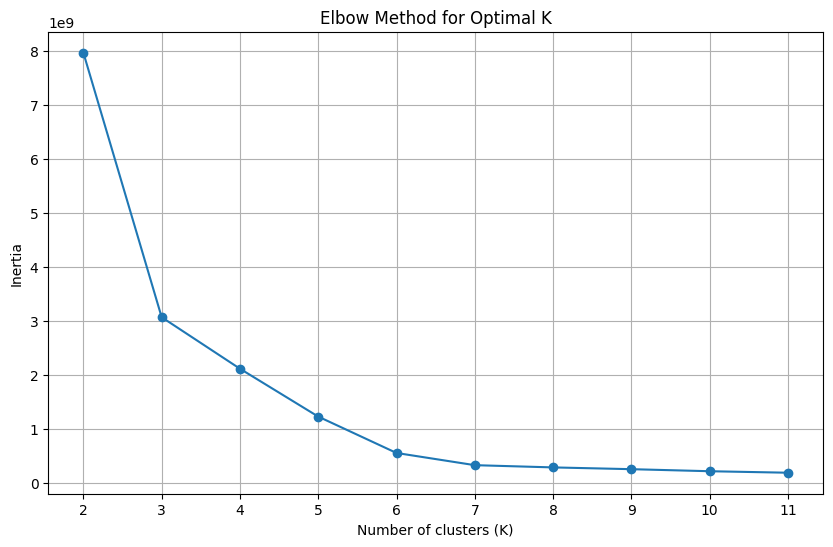

./elbow_test_export/SS-O_csv_50_69024_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    1   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        1                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

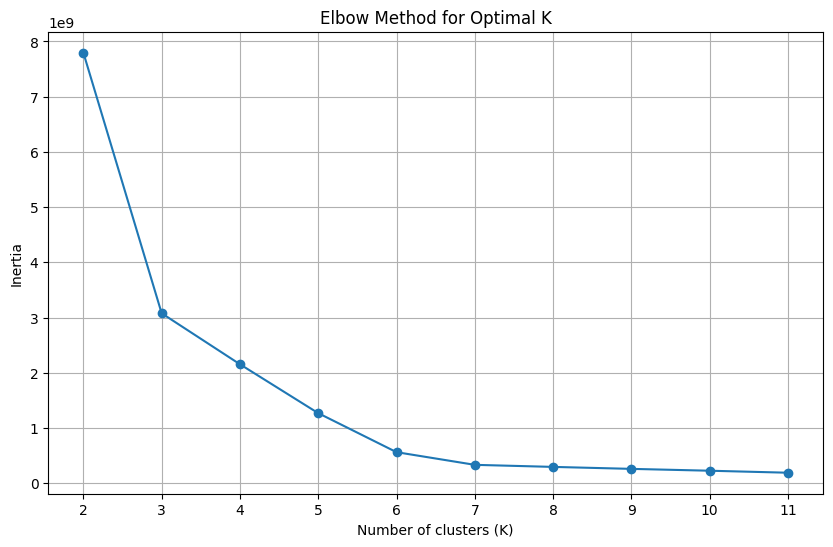

./elbow_test_export/SS-O_csv_50_70006_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           1                     1                      1   1    1   1    1   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   1    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

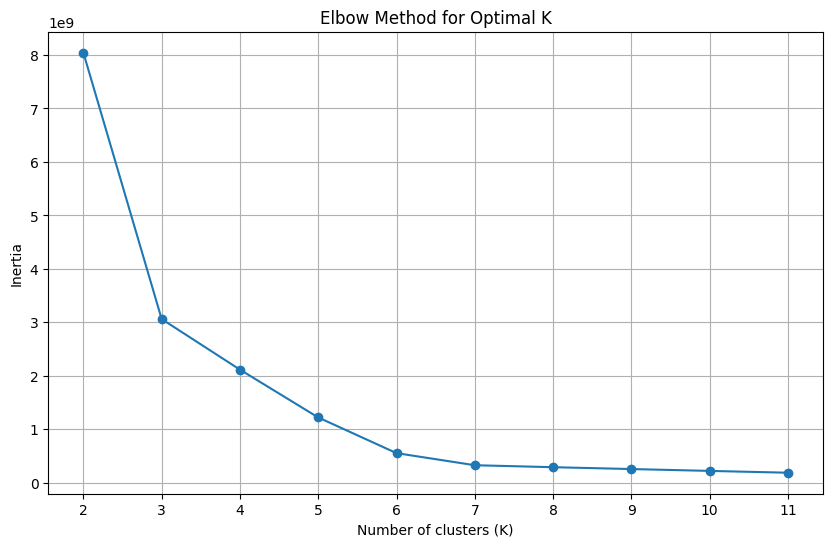

./elbow_test_export/SS-O_csv_50_70292_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     0                      0   0    0   0    0   
1           0                     1                      1   1    0   0    0   
2           1                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    1   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

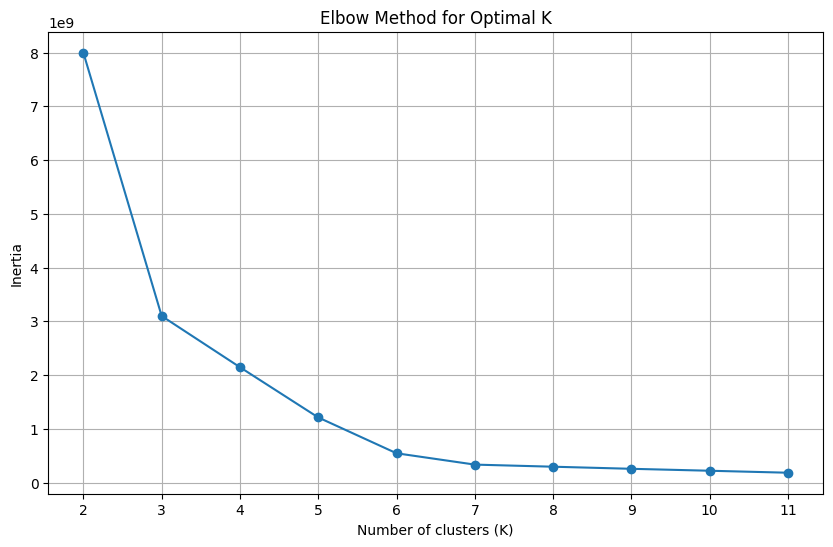

./elbow_test_export/SS-O_csv_50_77340_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           1                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           1                     1                      1   1    1   1    1   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   1    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

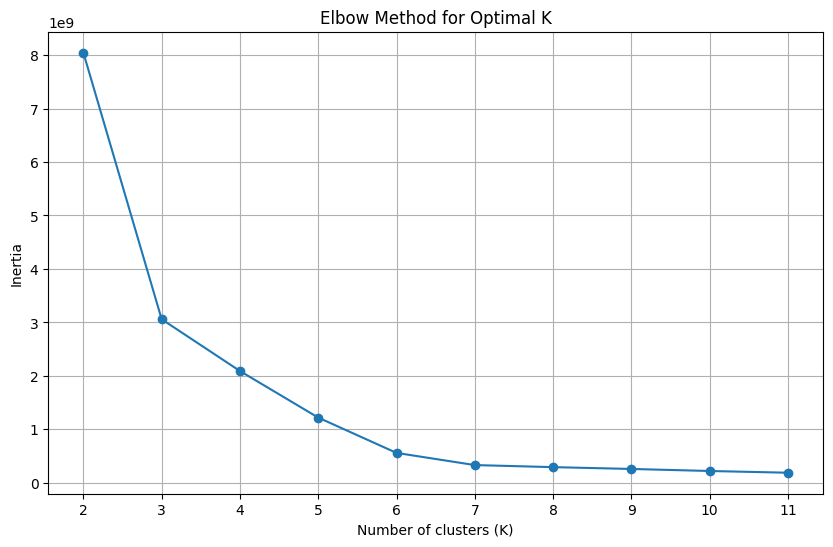

./elbow_test_export/SS-O_csv_50_77845_elbow_test.png
Optimal k value: 4
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   1    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

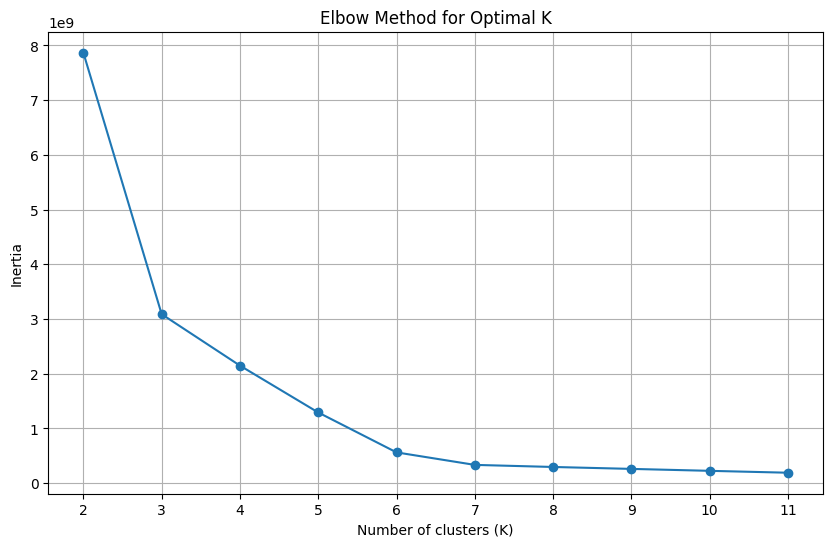

./elbow_test_export/SS-O_csv_50_83686_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    1   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

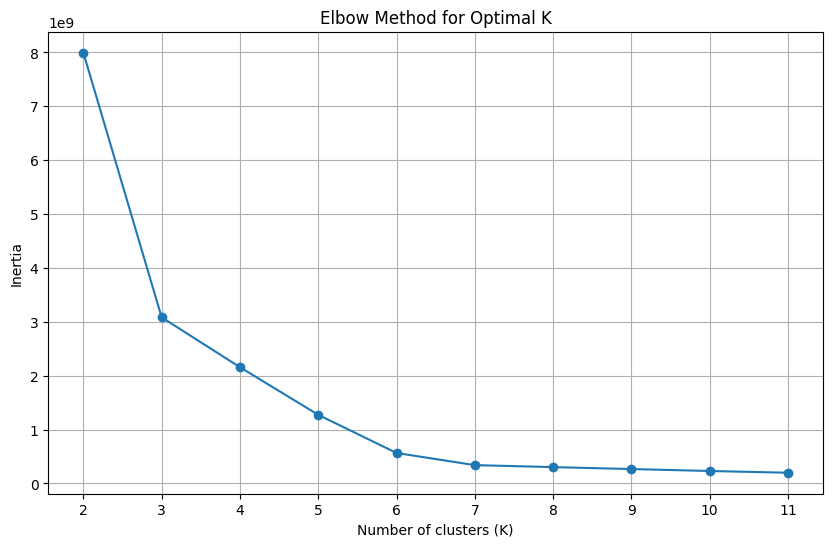

./elbow_test_export/SS-O_csv_50_84967_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    0   
1           0                     1                      1   0    0   0    0   
2           0                     1                      1   0    1   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   1    0   0    0   
3048        0                     1                      1   0    0   0    0   
3049        0                     1             

<Figure size 640x480 with 0 Axes>

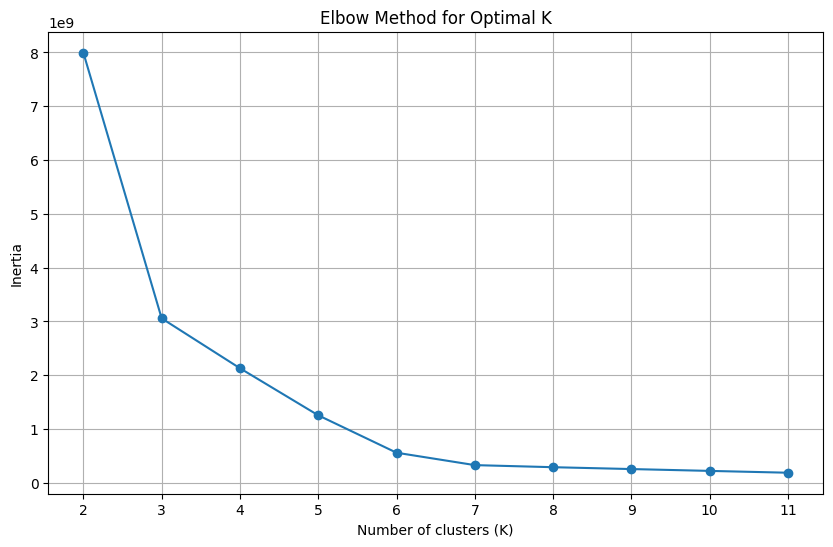

./elbow_test_export/SS-O_csv_50_86331_elbow_test.png
Optimal k value: 5
      Extrema  EnabledOptimizations  DisabledOptimizations  Ls  Dcr  Cf  Lir  \
0           0                     1                      1   0    0   0    1   
1           1                     1                      1   0    0   0    0   
2           0                     1                      1   0    0   0    0   
3           0                     1                      1   0    0   0    0   
4           0                     1                      1   0    0   0    0   
...       ...                   ...                    ...  ..  ...  ..  ...   
3045        0                     1                      1   0    0   0    0   
3046        0                     1                      1   0    0   0    0   
3047        0                     1                      1   0    0   0    0   
3048        1                     1                      1   1    1   1    0   
3049        0                     1             

defaultdict(list,
            {'SS-A.csv_100': [{'seed': '11514',
               'best_d2h': 0.8745978416128234},
              {'seed': '19953', 'best_d2h': 0.8773967084105334},
              {'seed': '3545', 'best_d2h': 0.8863188856801065},
              {'seed': '39658', 'best_d2h': 0.8657605539613576},
              {'seed': '40749', 'best_d2h': 0.8904884088554335},
              {'seed': '44845', 'best_d2h': 0.8898362211482974},
              {'seed': '51176', 'best_d2h': 0.8698982875841915},
              {'seed': '58612', 'best_d2h': 0.8562242324511474},
              {'seed': '61367', 'best_d2h': 0.8652906840282026},
              {'seed': '65388', 'best_d2h': 0.8767172215592053},
              {'seed': '65444', 'best_d2h': 0.8912584869462449},
              {'seed': '66946', 'best_d2h': 0.8880868591872692},
              {'seed': '69024', 'best_d2h': 0.8618808000986785},
              {'seed': '70006', 'best_d2h': 0.8817853783110721},
              {'seed': '70292', 'best_d2h'

<Figure size 640x480 with 0 Axes>

In [40]:
resFiles = collections.defaultdict(list)
for name in totalDatasets:
  names = name.split('_')
  seed = names[2].split('.')[0]
  image_names = name.split('.')
  image_name = image_names[0]+'_'+image_names[1]
  filename = names[0]+ '_' +names[1]
  global df
  global features
  global xColumns
  global inertia_values
  global optimal_k
  global cluster_centroids
  df = pd.DataFrame
  features = []
  xColumns = []
  inertia_values = []
  optimal_k = 0
  cluster_centroids = []
  try:
      load_dataset(datasetPath+name)
  except Exception as error:
    print("exception Occured here ! ", name, )
    continue
  clean_undefined_values()
  fit_kmeans_for_range_of_k()
  image_file_name =image_name +'_elbow_test.png'
  print(image_file_name)
  plot_and_find_optimal_k(image_file_name)
  perform_optimal_kmeans(optimal_k)
  get_mean_of_clusters_export_to_csv(image_name+'_mean_cluster_export.csv')
  resultant_d2h = calculate_d2h_for_each_cluster_centroid()
  # resultant_d2h[:len(resultant_d2h)-1]
  resultant_d2h.pop()
  print(resultant_d2h)
  resultant_d2h.sort()
  resultant_d2h = resultant_d2h[::-1]
  resFiles[filename].append({'seed': seed, 'best_d2h': resultant_d2h[0] })
resFiles

In [41]:
import json

# Define the file path
file_path = 'data.json'

# Store the dictionary as JSON data to a file
with open(file_path, 'w') as f:
    json.dump(resFiles, f)

In [44]:
!tar -cvf elbow_test.tar /content/means_export_kmeans/

tar: Removing leading `/' from member names
/content/means_export_kmeans/
/content/means_export_kmeans/SS-N_csv_100_83686_mean_cluster_export.csv
/content/means_export_kmeans/SS-I_csv_100_83686_mean_cluster_export.csv
/content/means_export_kmeans/SS-I_csv_50_65388_mean_cluster_export.csv
/content/means_export_kmeans/SS-C_csv_10_61367_mean_cluster_export.csv
/content/means_export_kmeans/SS-F_csv_10_70006_mean_cluster_export.csv
/content/means_export_kmeans/SS-M_csv_100_69024_mean_cluster_export.csv
/content/means_export_kmeans/SS-A_csv_10_51176_mean_cluster_export.csv
/content/means_export_kmeans/SS-M_csv_10_40749_mean_cluster_export.csv
/content/means_export_kmeans/SS-M_csv_100_39658_mean_cluster_export.csv
/content/means_export_kmeans/SS-A_csv_100_69024_mean_cluster_export.csv
/content/means_export_kmeans/SS-C_csv_10_83686_mean_cluster_export.csv
/content/means_export_kmeans/SS-H_csv_10_19953_mean_cluster_export.csv
/content/means_export_kmeans/SS-H_csv_10_70006_mean_cluster_export.cs

In [37]:
name

'SS-B.csv_100_11514.csv'

In [ ]:
features

['Lbs-', 'Acc+', 'Mpg+']

In [ ]:
clean_undefined_values()

In [ ]:
fit_kmeans_for_range_of_)

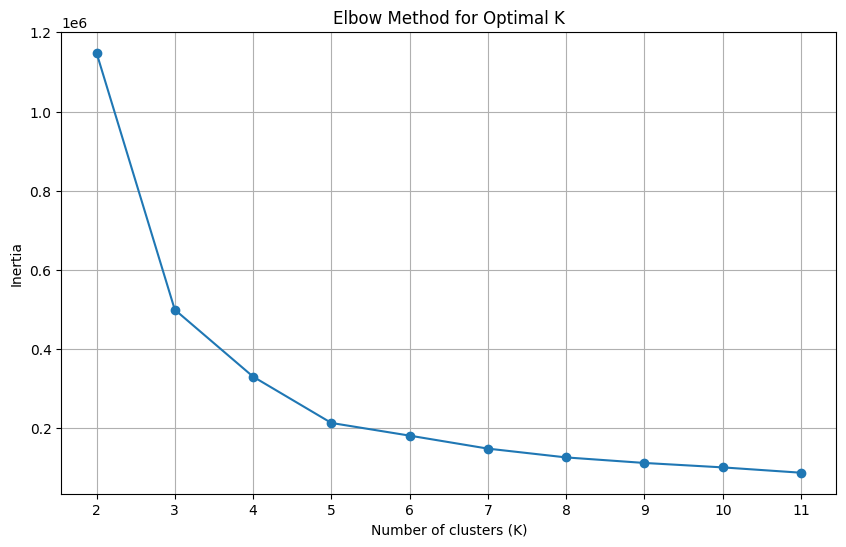

Optimal k value: 4


In [ ]:
plot_and_find_optimal_k()

In [ ]:
perform_optimal_kmeans(optimal_k)

     Clndrs  Volume    HpX  Model  origin  Lbs-  Acc+  Mpg+  cluster
0         8   304.0  193.0     70       1  4732  18.5    10        3
1         8   360.0  215.0     70       1  4615  14.0    10        2
2         8   307.0  200.0     70       1  4376  15.0    10        3
3         8   318.0  210.0     70       1  4382  13.5    10        3
4         8   429.0  208.0     72       1  4633  11.0    10        2
..      ...     ...    ...    ...     ...   ...   ...   ...      ...
393       4    90.0   48.0     80       2  2335  23.7    40        1
394       4    97.0   52.0     82       2  2130  24.6    40        1
395       4    90.0   48.0     80       2  2085  21.7    40        1
396       4    91.0   67.0     80       3  1850  13.8    40        1
397       4    86.0   65.0     80       3  2110  17.9    50        1

[392 rows x 9 columns]


In [ ]:
get_mean_of_clusters_export_to_csv()

In [ ]:
calculate_d2h_for_each_cluster_centroid()

[0.5747660385178374, 0.4310905674525984, 0.8490258006363165, 0.7506314452570144, nan]


In [ ]:
centroid = pd.DataFrame({
    'Clndrs' :[6],
    'Volume': [225],
    'HpX': [95],
    'Model':[75],
    'origin': [1],
    'Lbs-': [3264],
    'Acc+': [16],
    'Mpg+' : [20]
})
maxValues = df.max()
minValues = df.min()
d = 0
d2h = []
for column in features:
  print(column, centroid[column])
  if column.endswith("+"):
    d += (abs(1 - normalize_values(minValues[column], maxValues[column], centroid[column])))**2
  else:
    d += (abs(0 - normalize_values(minValues[column], maxValues[column], centroid[column])))**2
d2h.append((d/len(features))**(1/2))
print(d2h)

Lbs- 0    3264
Name: Lbs-, dtype: int64
Acc+ 0    16
Name: Acc+, dtype: int64
Mpg+ 0    20
Name: Mpg+, dtype: int64
[0    0.593295
Name: Lbs-, dtype: float64]


In [ ]:
d2h

[0    0.593295
 Name: Lbs-, dtype: float64]